In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


In [2]:
df = pd.read_csv('train.csv')

In [3]:
pd.set_option('display.max_column',None)

In [4]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [5]:
df.shape

(1460, 81)

# Understanding Data

In [6]:
def summery(df):
    data = pd.DataFrame(index=df.columns)
    data['dtypes'] = df.dtypes
    data['counts'] = df.count()
    data['#missing'] = df.isna().sum()
    data['%missing'] = df.isna().sum()/len(df)*100
    data  = pd.concat([data,df.describe().T.drop('count',axis=1)], axis=1)
    return data

In [7]:
summery(df).style.background_gradient(cmap='PuBuGn_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1201,259,17.739726,70.049958,24.284752,21.000000,59.000000,69.000000,80.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [8]:
def count(plot):
    plt.figure(figsize=(10,5))
    sns.barplot(x=plot,y=df['SalePrice'],data = df)
    plt.xticks(rotation='vertical')
    plt.show()
    return count

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, Cat

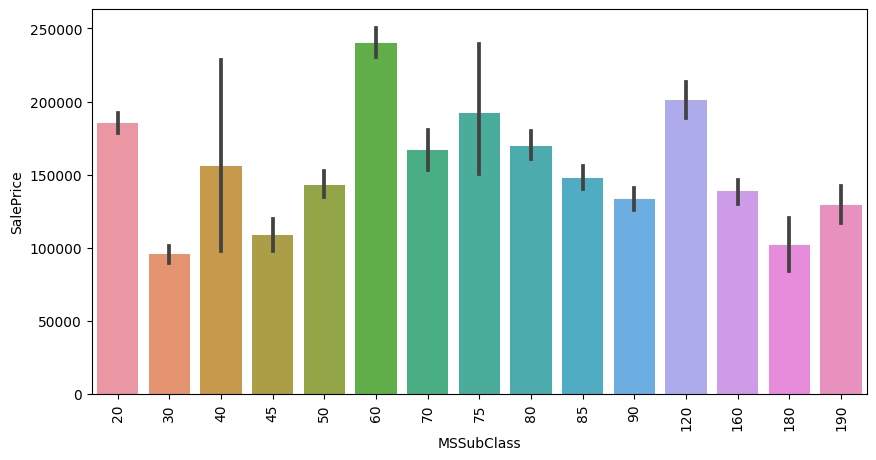

<function __main__.count(plot)>

In [9]:
count(df['MSSubClass'])

<Axes: xlabel='MSSubClass'>

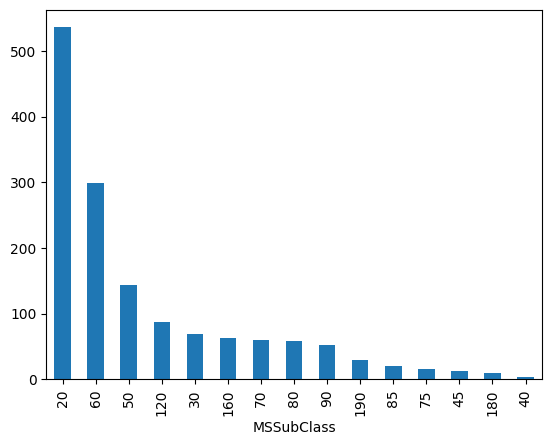

In [10]:
df['MSSubClass'].value_counts().plot(kind='bar')

In [11]:
import plotly.express as px

def pie(df, column_names):
    for column_name in column_names:
        label_status = df[column_name].value_counts()
        transaction = label_status.index.tolist()  # Convert the index to a list
        quantity = label_status.values

        figure = px.pie(df, values=quantity, names=transaction, hole=0.6, title=f"Pie Chart for {column_name}")
        figure.show()

# Example usage:
# Assuming df is your DataFrame and 'MSSubClass' is the name of the column you want to create a pie chart for
# pie(df, ['MSSubClass'])


In [12]:
pie(df,['MSSubClass'])

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



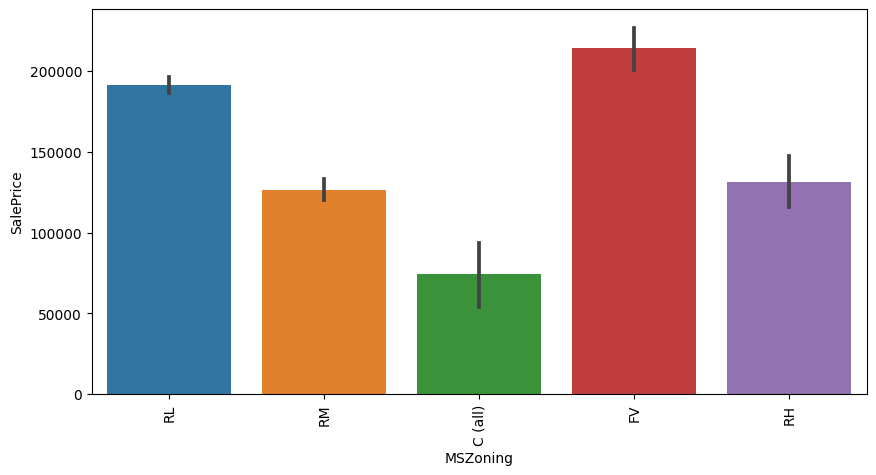

<function __main__.count(plot)>

In [13]:
count(df['MSZoning'])

<Axes: xlabel='MSZoning'>

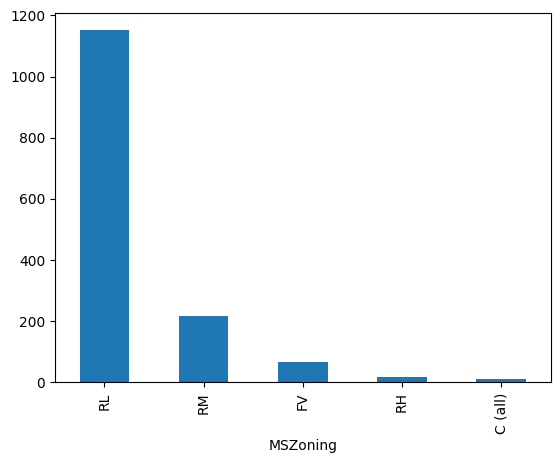

In [14]:
df['MSZoning'].value_counts().plot(kind = 'bar')

In [15]:
pie(df,['MSZoning'])

In [16]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



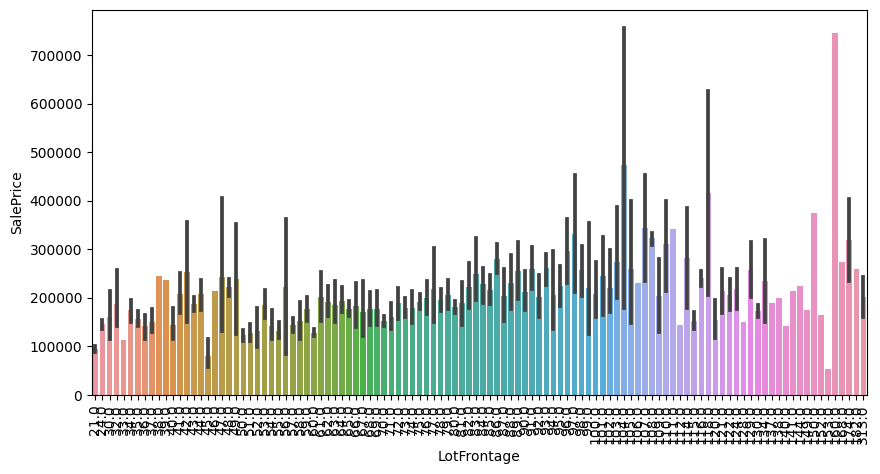

<function __main__.count(plot)>

In [17]:
count(df['LotFrontage'])

In [18]:
pie(df,['Street'])

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



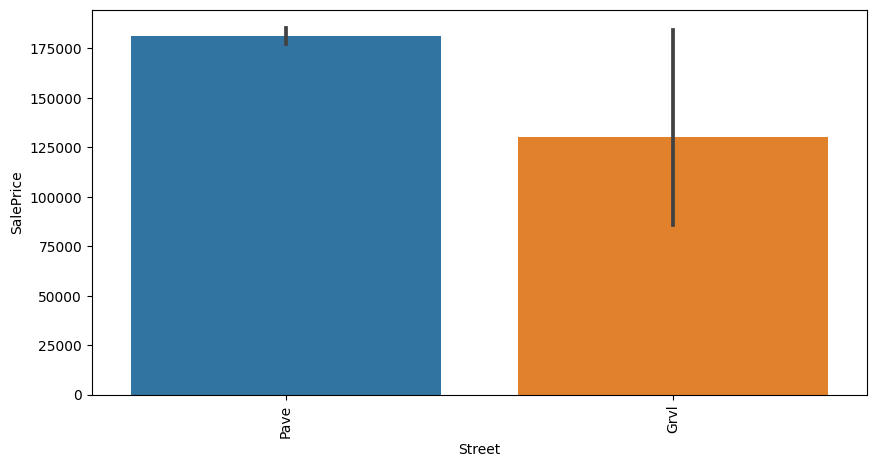

<function __main__.count(plot)>

In [19]:
count(df['Street'])

In [20]:
pie(df,['LotShape'])

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



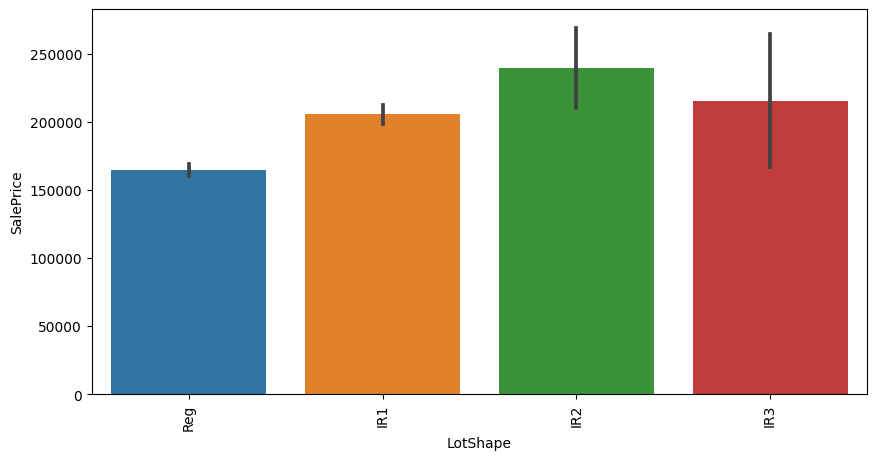

<function __main__.count(plot)>

In [21]:
count(df['LotShape'])

In [22]:
pie(df,['LandContour'])

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



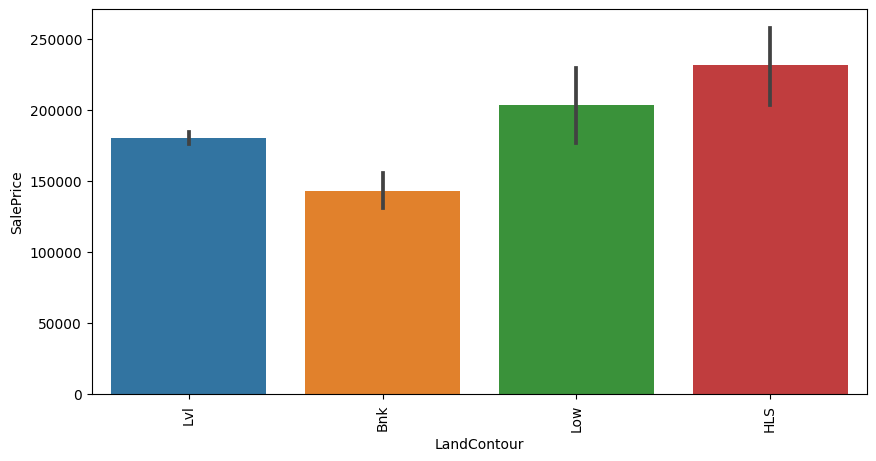

<function __main__.count(plot)>

In [23]:
count(df['LandContour'])

In [24]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



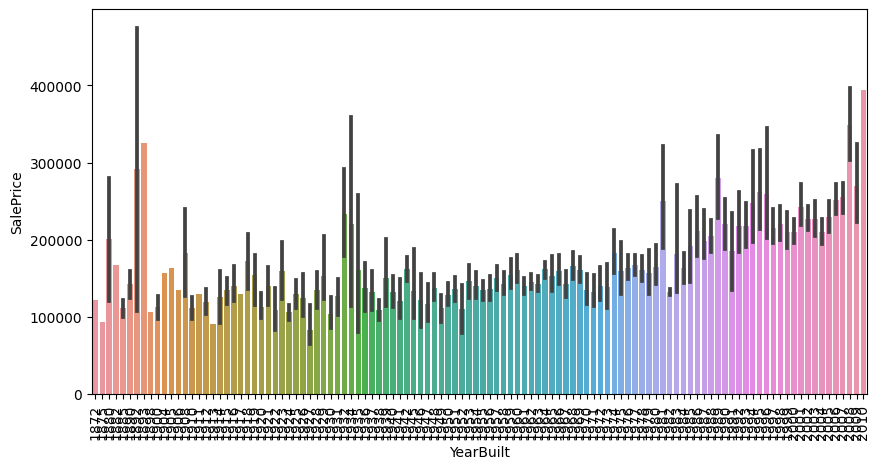

<function __main__.count(plot)>

In [25]:
count(df['YearBuilt'])

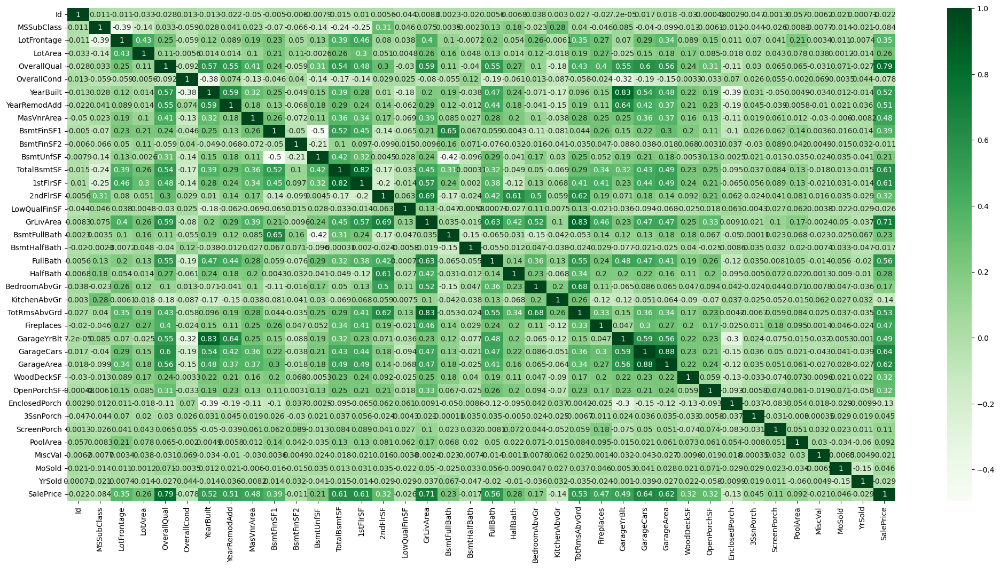

In [26]:
num_ = df.select_dtypes(include='number')
coraa = num_.corr()
plt.figure(figsize=(25,12))
sns.heatmap(coraa,cmap="Greens",annot=True)
plt.xticks(rotation='vertical')
plt.show()

In [27]:
num_.corr(),['SalPrice']

(                     Id  MSSubClass  LotFrontage   LotArea  OverallQual  \
 Id             1.000000    0.011156    -0.010601 -0.033226    -0.028365   
 MSSubClass     0.011156    1.000000    -0.386347 -0.139781     0.032628   
 LotFrontage   -0.010601   -0.386347     1.000000  0.426095     0.251646   
 LotArea       -0.033226   -0.139781     0.426095  1.000000     0.105806   
 OverallQual   -0.028365    0.032628     0.251646  0.105806     1.000000   
 OverallCond    0.012609   -0.059316    -0.059213 -0.005636    -0.091932   
 YearBuilt     -0.012713    0.027850     0.123349  0.014228     0.572323   
 YearRemodAdd  -0.021998    0.040581     0.088866  0.013788     0.550684   
 MasVnrArea    -0.050298    0.022936     0.193458  0.104160     0.411876   
 BsmtFinSF1    -0.005024   -0.069836     0.233633  0.214103     0.239666   
 BsmtFinSF2    -0.005968   -0.065649     0.049900  0.111170    -0.059119   
 BsmtUnfSF     -0.007940   -0.140759     0.132644 -0.002618     0.308159   
 TotalBsmtSF

In [28]:
df.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage      259
LotArea            0
                ... 
MoSold             0
YrSold             0
SaleType           0
SaleCondition      0
SalePrice          0
Length: 81, dtype: int64

In [29]:
df['LotFrontage'].value_counts()

LotFrontage
60.0     143
70.0      70
80.0      69
50.0      57
75.0      53
        ... 
137.0      1
141.0      1
38.0       1
140.0      1
46.0       1
Name: count, Length: 110, dtype: int64

In [30]:
df['LotFrontage'].median()

69.0

In [31]:
df['LotFrontage'].mean()

70.04995836802665

In [32]:
df['LotFrontage'] = df['LotFrontage'].fillna(df['LotFrontage'].median())

In [33]:
summery(df).style.background_gradient(cmap='PuBuGn_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [34]:
df['MasVnrType'].value_counts()

MasVnrType
BrkFace    445
Stone      128
BrkCmn      15
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



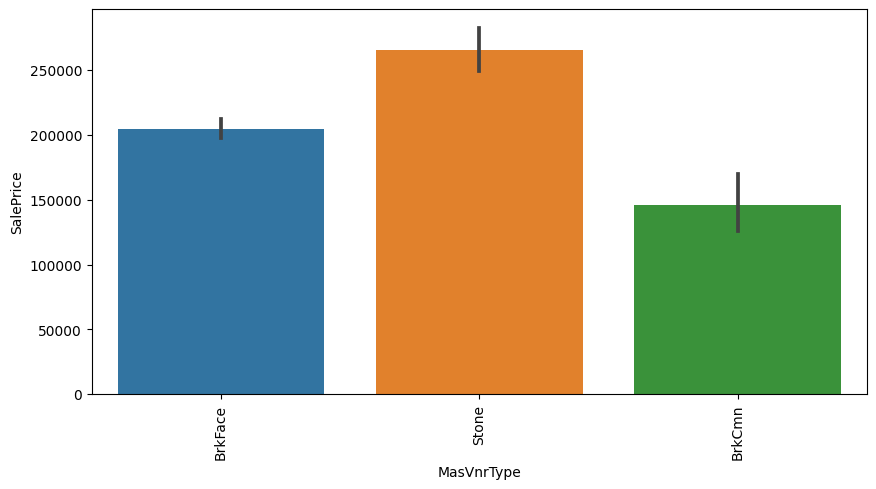

<function __main__.count(plot)>

In [35]:
count(df['MasVnrType'])

In [36]:
df['MasVnrType']  = df['MasVnrType'].replace(np.nan,'Stone')

In [37]:
summery(df).style.background_gradient(cmap='PuBuGn_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [38]:
df['MasVnrType'].value_counts()

MasVnrType
Stone      1000
BrkFace     445
BrkCmn       15
Name: count, dtype: int64

In [39]:
df['BsmtQual'].value_counts()

BsmtQual
TA    649
Gd    618
Ex    121
Fa     35
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



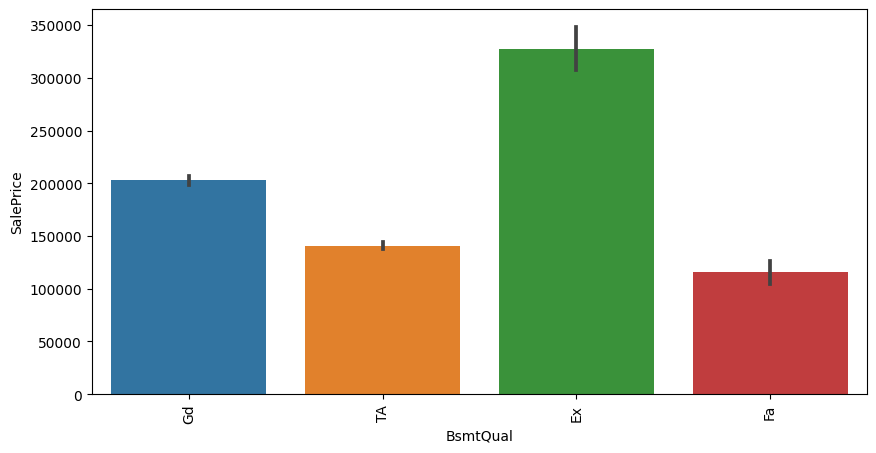

<function __main__.count(plot)>

In [40]:
count(df['BsmtQual'])

In [41]:
df['BsmtQual'] = df['BsmtQual'].replace(np.nan,'Ex')

In [42]:
summery(df).style.background_gradient(cmap='PuBuGn_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [43]:
df['BsmtCond'].value_counts()

BsmtCond
TA    1311
Gd      65
Fa      45
Po       2
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



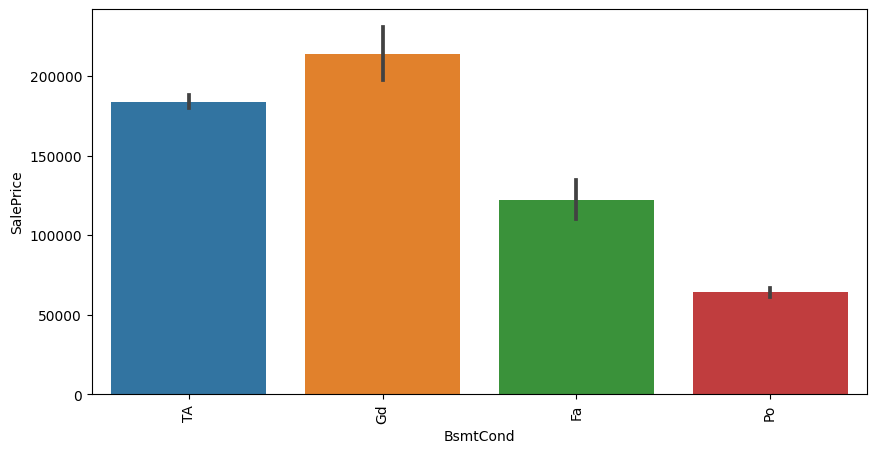

<function __main__.count(plot)>

In [44]:
count(df['BsmtCond'])

In [45]:
df['BsmtCond'] = df['BsmtCond'].replace(np.nan,'Gd')

In [46]:
df.shape

(1460, 81)

In [47]:
df['BsmtExposure'].value_counts()

BsmtExposure
No    953
Av    221
Gd    134
Mn    114
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



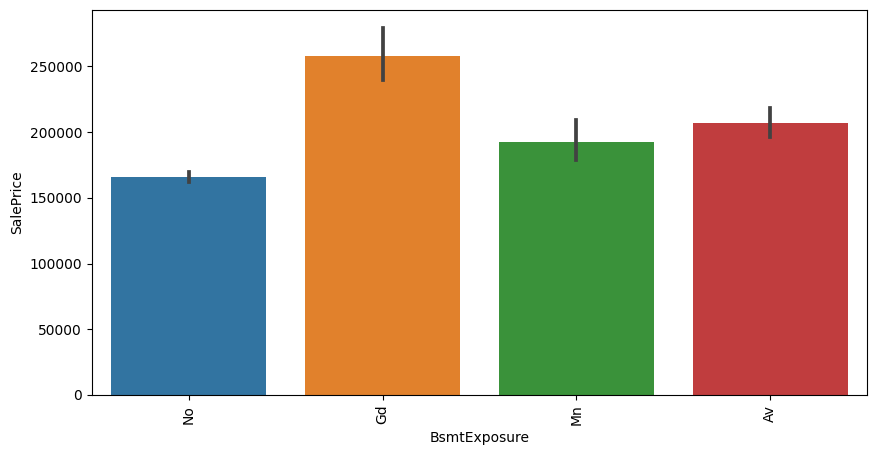

<function __main__.count(plot)>

In [48]:
count(df['BsmtExposure'])

In [49]:
df['BsmtExposure'] = df['BsmtExposure'].replace(np.nan,'Gd')

In [50]:
df['BsmtFinType1'].value_counts()

BsmtFinType1
Unf    430
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ     74
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



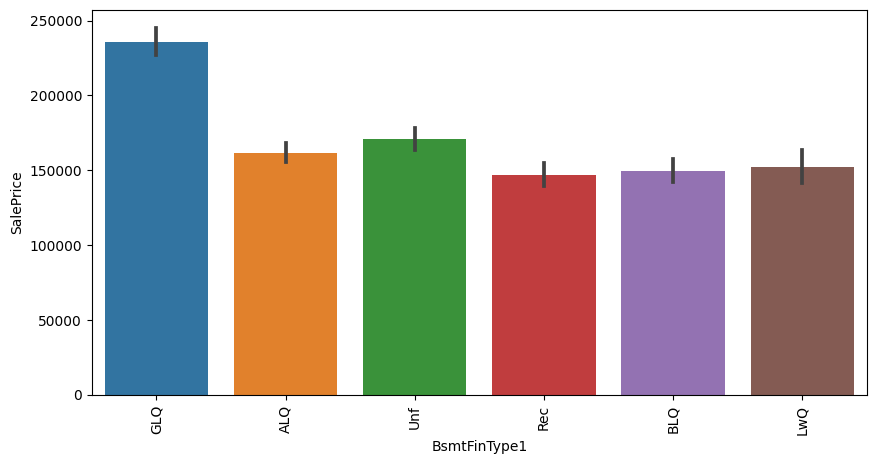

<function __main__.count(plot)>

In [51]:
count(df['BsmtFinType1'])

In [52]:
df['BsmtFinType1'] = df['BsmtFinType1'].replace(np.nan,'LwQ')

In [53]:
df['BsmtFinType1'].value_counts()

BsmtFinType1
Unf    430
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ    111
Name: count, dtype: int64

In [54]:
df['BsmtFinType2'].value_counts()

BsmtFinType2
Unf    1256
Rec      54
LwQ      46
BLQ      33
ALQ      19
GLQ      14
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



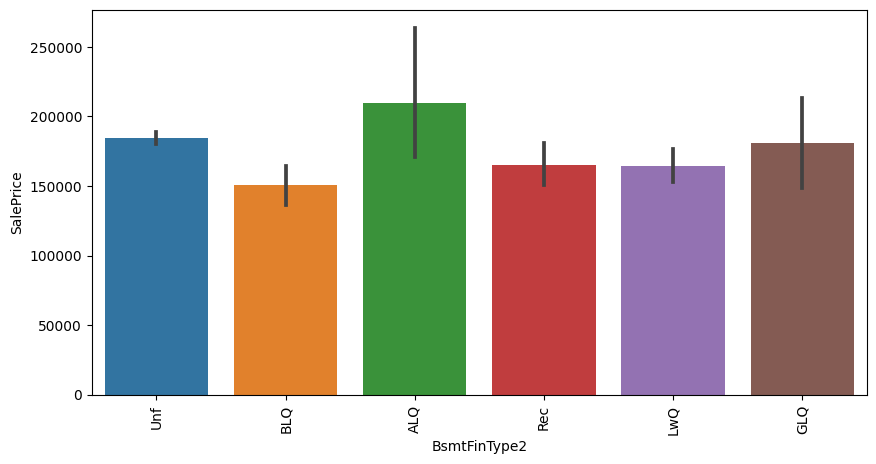

<function __main__.count(plot)>

In [55]:
count(df['BsmtFinType2'])

In [56]:
df['BsmtFinType2'] = df['BsmtFinType2'].replace(np.nan,'BLQ')

In [57]:
summery(df).style.background_gradient(cmap='cool_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [58]:
df['FireplaceQu'].value_counts()

FireplaceQu
Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



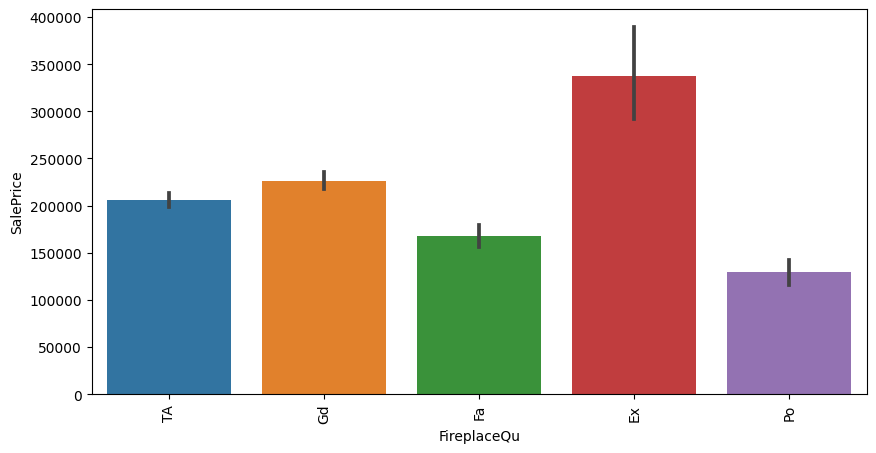

<function __main__.count(plot)>

In [59]:
count(df['FireplaceQu'])

In [60]:
import numpy as np

# Assuming df is your DataFrame
total_na = df['FireplaceQu'].isna().sum()
half_na = total_na // 2  # Calculate half of the NaN values

# Fill 50% of NaN values with 'Fa' and 50% with 'Ex'
df.loc[df['FireplaceQu'].isna(), 'FireplaceQu'] = np.concatenate([['Fa'] * half_na, ['Ex'] * (total_na - half_na)])

# Verify the changes
print(df['FireplaceQu'].value_counts())


FireplaceQu
Gd    380
Fa    378
Ex    369
TA    313
Po     20
Name: count, dtype: int64


In [61]:
summery(df).style.background_gradient(cmap='cool_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [62]:
df['GarageType'].value_counts()

GarageType
Attchd     870
Detchd     387
BuiltIn     88
Basment     19
CarPort      9
2Types       6
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



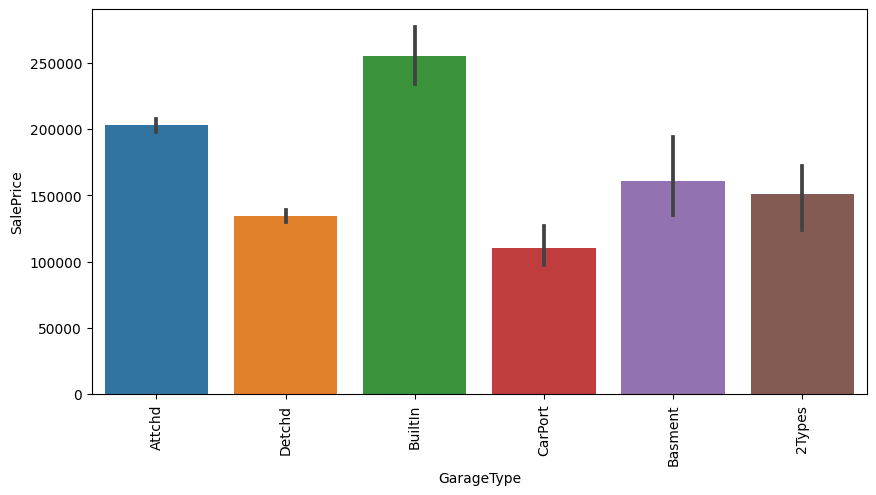

<function __main__.count(plot)>

In [63]:
count(df['GarageType'])

In [64]:
df['GarageType'] =df['GarageType'].fillna('BuiltIn')

In [65]:
summery(df).style.background_gradient(cmap='winter_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [66]:
df['GarageYrBlt'].value_counts()

GarageYrBlt
2005.0    65
2006.0    59
2004.0    53
2003.0    50
2007.0    49
          ..
1927.0     1
1900.0     1
1906.0     1
1908.0     1
1933.0     1
Name: count, Length: 97, dtype: int64

In [67]:
df['GarageYrBlt'] = df['GarageYrBlt'].fillna(df['GarageYrBlt'].median())

In [68]:
df['GarageFinish'].value_counts()

GarageFinish
Unf    605
RFn    422
Fin    352
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



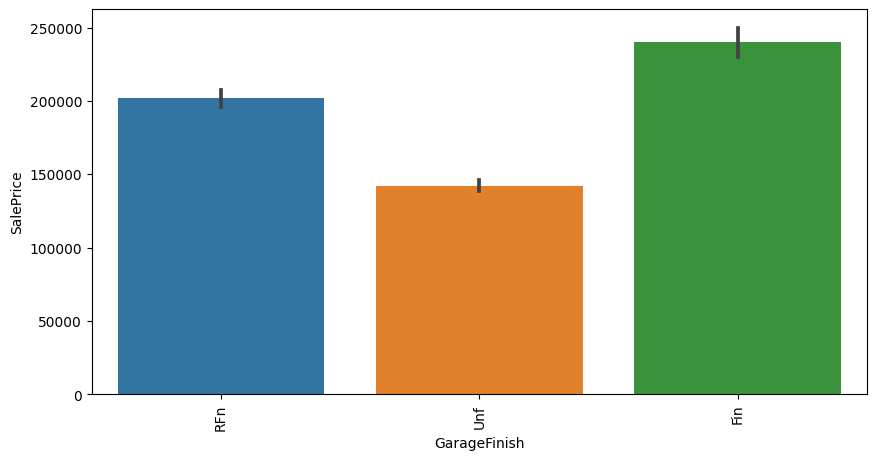

<function __main__.count(plot)>

In [69]:
count(df['GarageFinish'])

In [70]:
df['GarageFinish'] = df['GarageFinish'].fillna('Unf')

In [71]:
summery(df).style.background_gradient(cmap='gist_gray')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [72]:
df['GarageQual'].value_counts()

GarageQual
TA    1311
Fa      48
Gd      14
Ex       3
Po       3
Name: count, dtype: int64

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



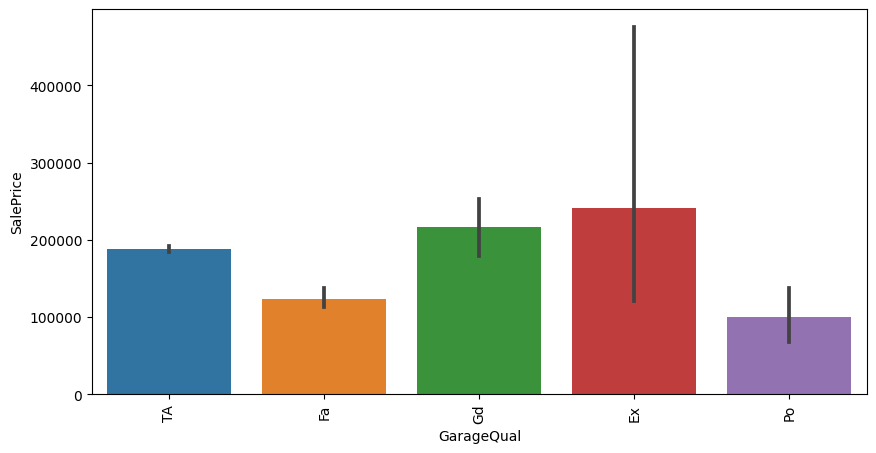

<function __main__.count(plot)>

In [73]:
count(df['GarageQual'])

In [74]:
import numpy as np

# Assuming df is your DataFrame
total_na = df['GarageQual'].isna().sum()
half_na = total_na // 2  # Calculate half of the NaN values

# Fill 50% of NaN values with 'Fa' and 50% with 'Ex'
df.loc[df['GarageQual'].isna(), 'GarageQual'] = np.concatenate([['Po'] * half_na, ['Ex'] * (total_na - half_na)])

# Verify the changes
print(df['GarageQual'].value_counts())


GarageQual
TA    1311
Fa      48
Ex      44
Po      43
Gd      14
Name: count, dtype: int64


In [75]:
df['GarageCond'].value_counts()

GarageCond
TA    1326
Fa      35
Gd       9
Po       7
Ex       2
Name: count, dtype: int64

In [76]:
total_na = df['GarageCond'].isna().sum()
half_na = total_na // 2
df.loc[df['GarageCond'].isna(),'GarageCond']= np.concatenate([['Gd'] * half_na,['Po'] * (total_na - half_na)])
print(df['GarageCond'].value_counts())

GarageCond
TA    1326
Gd      49
Po      48
Fa      35
Ex       2
Name: count, dtype: int64


In [77]:
summery(df).style.background_gradient(cmap='cool_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1460,0,0.000000,730.500000,421.610009,1.000000,365.750000,730.500000,1095.250000,1460.000000
MSSubClass,int64,1460,0,0.000000,56.897260,42.300571,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1460,0,0.000000,69.863699,22.027677,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1460,0,0.000000,10516.828082,9981.264932,1300.000000,7553.500000,9478.500000,11601.500000,215245.000000
Street,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Alley,object,91,1369,93.767123,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1460,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [78]:
df['Fence'].value_counts()

Fence
MnPrv    157
GdPrv     59
GdWo      54
MnWw      11
Name: count, dtype: int64

In [79]:
df.drop(['Alley','PoolQC','Fence','MiscFeature'],axis=1,inplace=True)

In [80]:
df = df.dropna()

In [81]:
df.isnull().sum()

Id               0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
                ..
MoSold           0
YrSold           0
SaleType         0
SaleCondition    0
SalePrice        0
Length: 77, dtype: int64

In [82]:
summery(df).style.background_gradient(cmap='cool_r')

,dtypes,counts,#missing,%missing,mean,std,min,25%,50%,75%,max
Id,int64,1451,0,0.000000,729.374225,421.737858,1.000000,364.500000,729.000000,1094.500000,1460.000000
MSSubClass,int64,1451,0,0.000000,56.933150,42.350366,20.000000,20.000000,50.000000,70.000000,190.000000
MSZoning,object,1451,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotFrontage,float64,1451,0,0.000000,69.845624,22.044429,21.000000,60.000000,69.000000,79.000000,313.000000
LotArea,int64,1451,0,0.000000,10507.808408,9992.987081,1300.000000,7537.500000,9477.000000,11600.000000,215245.000000
Street,object,1451,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotShape,object,1451,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LandContour,object,1451,0,0.000000,nan,nan,nan,nan,nan,nan,nan
Utilities,object,1451,0,0.000000,nan,nan,nan,nan,nan,nan,nan
LotConfig,object,1451,0,0.000000,nan,nan,nan,nan,nan,nan,nan


In [83]:
df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.00000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000,1451.000000
mean,729.374225,56.933150,69.845624,10507.808408,6.093728,5.579600,1971.092350,1984.760165,103.75672,442.274983,46.838043,567.197105,1056.310131,1161.551344,346.742247,5.880772,1514.174363,0.423846,0.057891,1.562371,0.381116,2.866988,1.046175,6.516885,0.612681,1978.445210,1.764990,472.525155,94.412819,46.422467,21.952447,3.430737,15.154376,2.776017,43.758787,6.319090,2007.815300,180624.101999
std,421.737858,42.350366,22.044429,9992.987081,1.381467,1.113415,30.190266,20.651334,181.10815,455.369276,161.777324,442.209192,437.914609,385.002532,436.453277,48.771560,525.799521,0.518842,0.239449,0.550301,0.502574,0.815086,0.219571,1.626576,0.643443,23.989371,0.748728,214.171752,125.436852,66.060150,61.108223,29.406940,55.917522,40.301212,497.648467,2.700353,1.329376,79312.128273
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.00000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,364.500000,20.000000,60.000000,7537.500000,5.000000,5.000000,1954.000000,1966.000000,0.00000,0.000000,0.000000,222.000000,795.000000,882.000000,0.000000,0.000000,1128.000000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1962.000000,1.000000,327.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129900.000000
50%,729.000000,50.000000,69.000000,9477.000000,6.000000,5.000000,1972.000000,1993.000000,0.00000,381.000000,0.000000,479.000000,991.000000,1086.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,478.000000,0.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,162500.000000
75%,1094.500000,70.000000,79.000000,11600.000000,7.000000,6.000000,2000.000000,2004.000000,166.00000,707.000000,0.000000,808.000000,1297.500000,1391.000000,728.000000,0.000000,1776.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2001.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.00000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



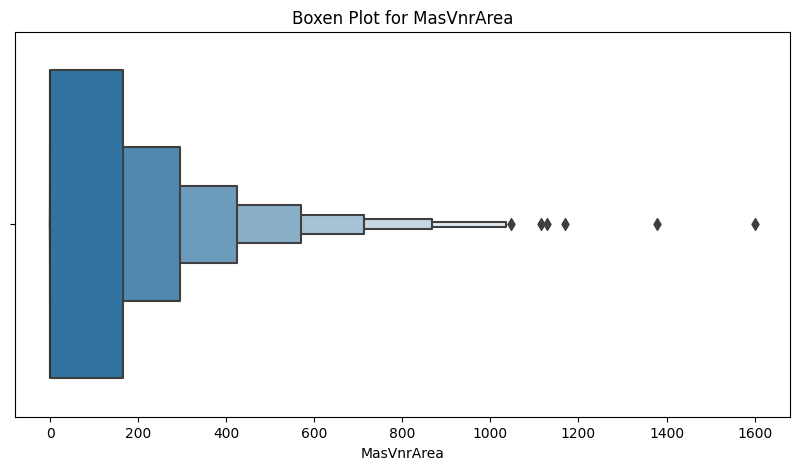

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



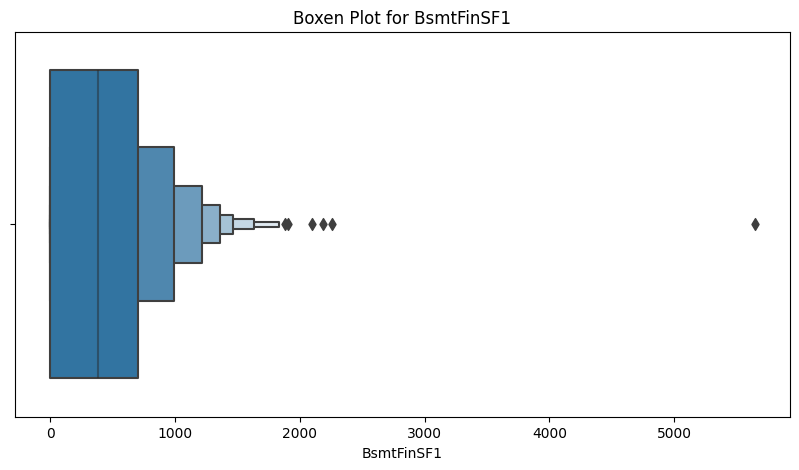

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



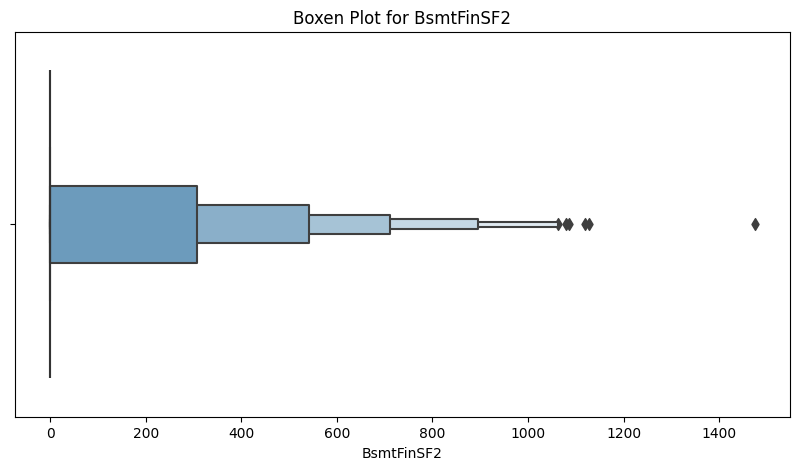

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



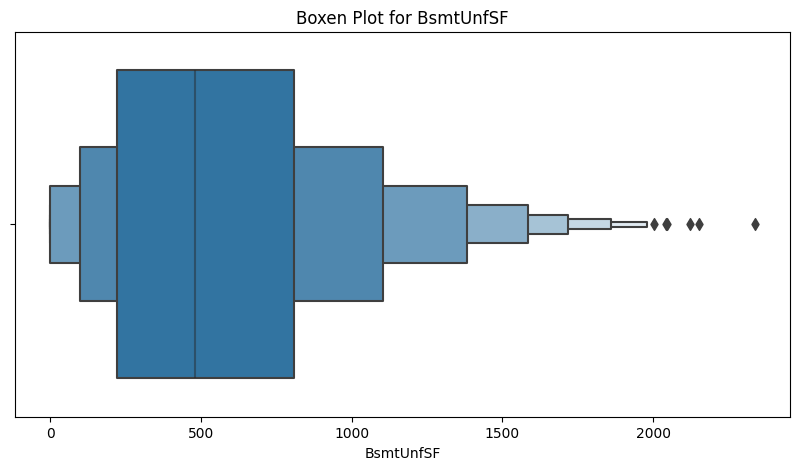

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



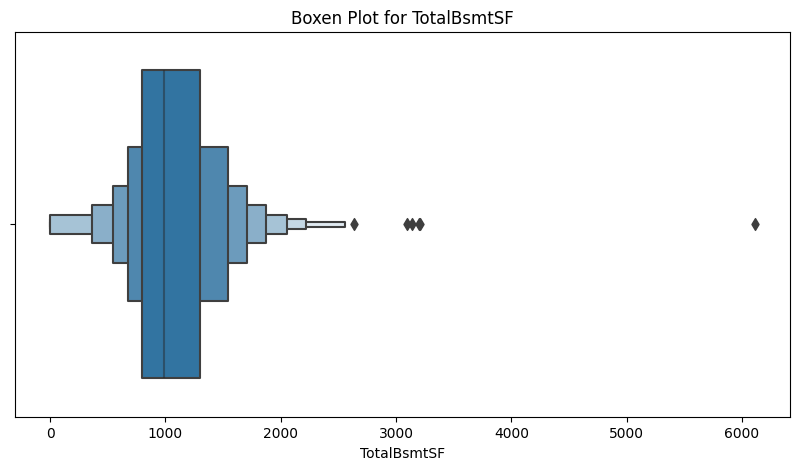

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



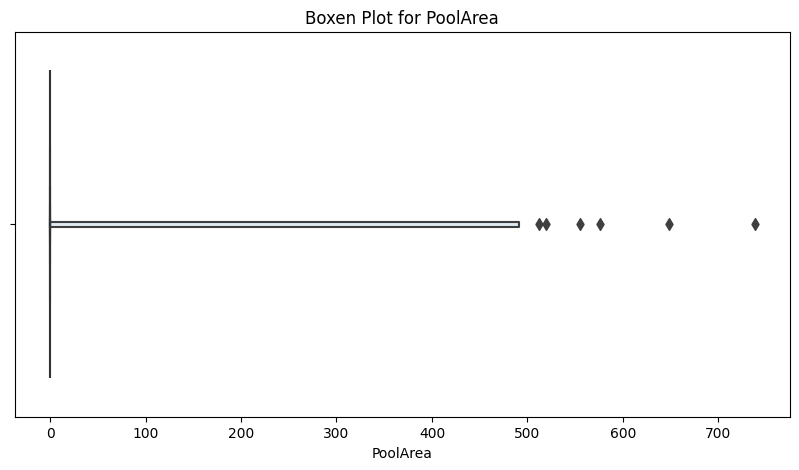

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\categorical.py:1794: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



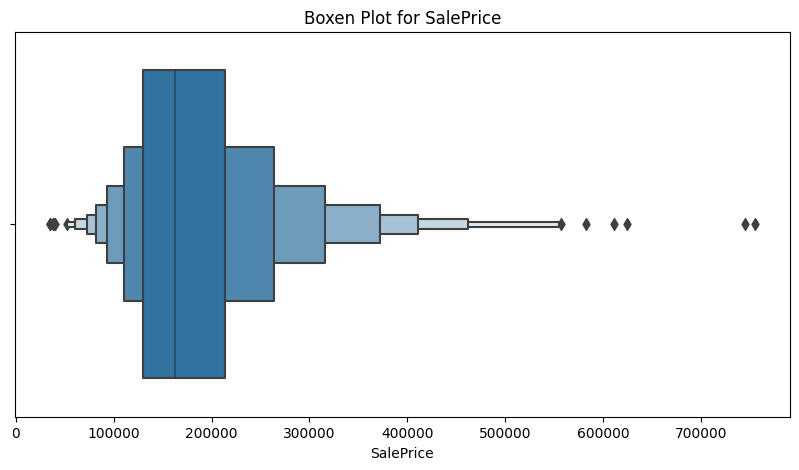

In [84]:
import seaborn as sns
import matplotlib.pyplot as plt

num_columns = ['MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'PoolArea', 'SalePrice']

# Assuming df is your DataFrame
for column in num_columns:
    plt.figure(figsize=(10,5))
    sns.boxenplot(x=df[column])
    plt.title(f'Boxen Plot for {column}')
    plt.show()


In [85]:
df['MasVnrArea'].dtypes

dtype('float64')

In [86]:
def detect_outliers(df, column_name):
    mean = df[column_name].mean()
    std = df[column_name].std()
    
    # Define the upper and lower bounds for outliers
    upper_bound = mean + 3 * std
    lower_bound = mean - 3 * std
    
    # Use boolean indexing to filter out the outliers
    outliers = df[(df[column_name] > upper_bound) | (df[column_name] < lower_bound)]
    
    return outliers

# Example usage:
# Assuming df is your DataFrame and 'SomeColumn' is the column you want to check for outliers



In [87]:
filter_df = detect_outliers(df,['MasVnrArea'])

In [88]:
filter_df = detect_outliers(df,['SalePrice'])

In [89]:
print(df.shape)
print(filter_df.shape)

(1451, 77)
(1451, 77)


In [90]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
for column in df.columns:
    if df[column].dtypes=='object':
        df[column] = LabelEncoder().fit_transform(df[column])

In [91]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,3,65.0,8450,1,3,3,0,4,0,5,2,2,0,5,7,5,2003,2003,1,1,12,13,1,196.0,2,4,2,2,3,3,2,706,5,0,150,856,1,0,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,1,2003.0,1,2,548,4,4,2,0,61,0,0,0,0,0,2,2008,8,4,208500
1,2,20,3,80.0,9600,1,3,3,0,2,0,24,1,2,0,2,6,8,1976,1976,1,1,8,8,2,0.0,3,4,1,2,3,1,0,978,5,0,284,1262,1,0,1,4,1262,0,0,1262,0,1,2,0,3,1,3,6,6,1,4,1,1976.0,1,2,460,4,4,2,298,0,0,0,0,0,0,5,2007,8,4,181500
2,3,60,3,68.0,11250,1,0,3,0,4,0,5,2,2,0,5,7,5,2001,2002,1,1,12,13,1,162.0,2,4,2,2,3,2,2,486,5,0,434,920,1,0,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,4,1,2001.0,1,2,608,4,4,2,0,42,0,0,0,0,0,9,2008,8,4,223500
3,4,70,3,60.0,9550,1,0,3,0,0,0,6,2,2,0,5,7,5,1915,1970,1,1,13,15,2,0.0,3,4,0,3,1,3,0,216,5,0,540,756,1,2,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,2,5,1998.0,2,3,642,4,4,2,0,35,272,0,0,0,0,2,2006,8,0,140000
4,5,60,3,84.0,14260,1,0,3,0,2,0,15,2,2,0,5,8,5,2000,2000,1,1,12,13,1,350.0,2,4,2,2,3,0,2,655,5,0,490,1145,1,0,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,4,1,2000.0,1,3,836,4,4,2,192,84,0,0,0,0,0,12,2008,8,4,250000


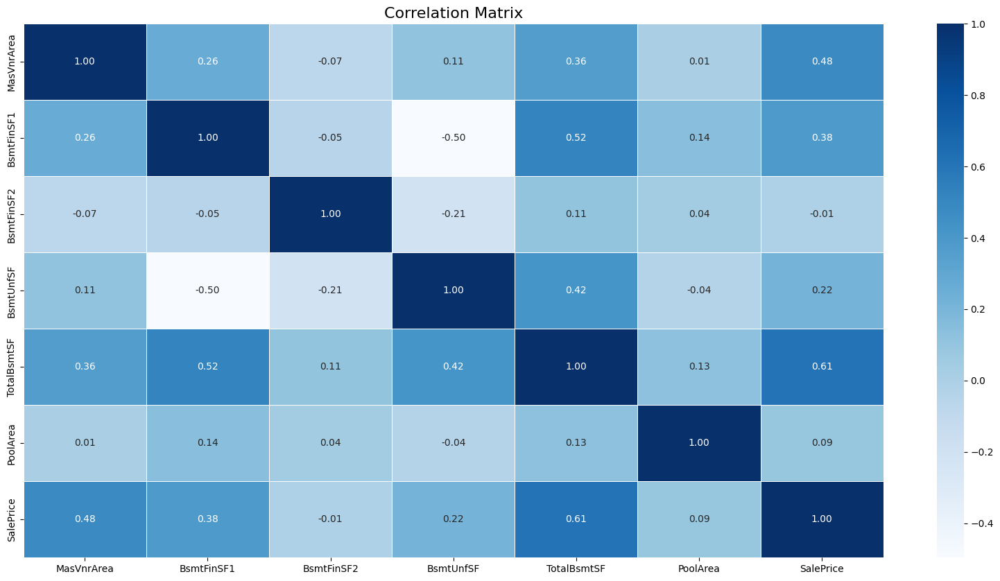

In [92]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df is your DataFrame
 # Replace with your numerical column names
subset_df = df[num_columns]  # Select numerical columns from the original DataFrame

# Compute the correlation matrix for the selected numerical columns
correlation_matrix = subset_df.corr()

# Set up the matplotlib figure with a larger size
plt.figure(figsize=(20, 10))

# Create a heatmap of the correlation matrix
sns.heatmap(correlation_matrix, annot=True, cmap='Blues', fmt=".2f", linewidths=.5)

plt.title('Correlation Matrix', fontsize=16)
plt.show()


In [93]:
df.shape

(1451, 77)

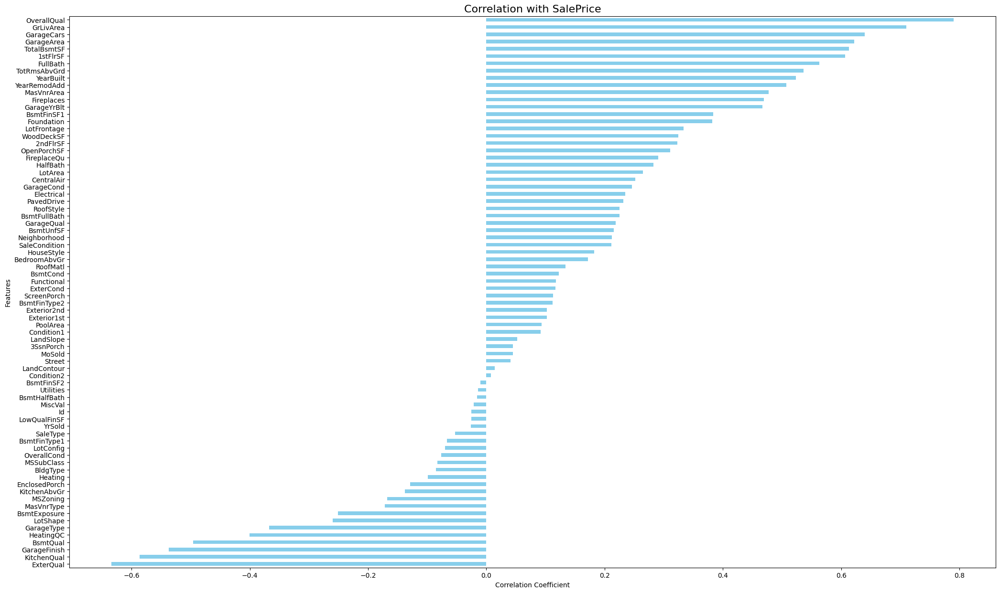

In [94]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df is your DataFrame
correlation_with_saleprice = df.corr()['SalePrice']

# Set up the matplotlib figure with a larger size
plt.figure(figsize=(25, 15))

# Create a bar plot for the correlation with SalePrice
correlation_with_saleprice.drop('SalePrice').sort_values().plot(kind='barh', color='skyblue')

plt.title('Correlation with SalePrice', fontsize=16)
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')
plt.show()


In [95]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,3,65.0,8450,1,3,3,0,4,0,5,2,2,0,5,7,5,2003,2003,1,1,12,13,1,196.0,2,4,2,2,3,3,2,706,5,0,150,856,1,0,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,1,2003.0,1,2,548,4,4,2,0,61,0,0,0,0,0,2,2008,8,4,208500
1,2,20,3,80.0,9600,1,3,3,0,2,0,24,1,2,0,2,6,8,1976,1976,1,1,8,8,2,0.0,3,4,1,2,3,1,0,978,5,0,284,1262,1,0,1,4,1262,0,0,1262,0,1,2,0,3,1,3,6,6,1,4,1,1976.0,1,2,460,4,4,2,298,0,0,0,0,0,0,5,2007,8,4,181500
2,3,60,3,68.0,11250,1,0,3,0,4,0,5,2,2,0,5,7,5,2001,2002,1,1,12,13,1,162.0,2,4,2,2,3,2,2,486,5,0,434,920,1,0,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,4,1,2001.0,1,2,608,4,4,2,0,42,0,0,0,0,0,9,2008,8,4,223500
3,4,70,3,60.0,9550,1,0,3,0,0,0,6,2,2,0,5,7,5,1915,1970,1,1,13,15,2,0.0,3,4,0,3,1,3,0,216,5,0,540,756,1,2,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,2,5,1998.0,2,3,642,4,4,2,0,35,272,0,0,0,0,2,2006,8,0,140000
4,5,60,3,84.0,14260,1,0,3,0,2,0,15,2,2,0,5,8,5,2000,2000,1,1,12,13,1,350.0,2,4,2,2,3,0,2,655,5,0,490,1145,1,0,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,4,1,2000.0,1,3,836,4,4,2,192,84,0,0,0,0,0,12,2008,8,4,250000


C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



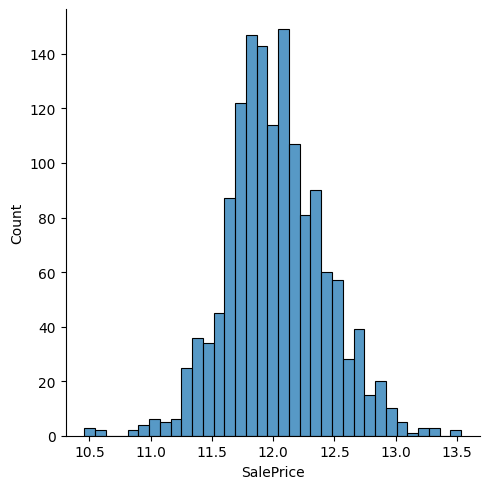

In [96]:
sns.displot(np.log(df['SalePrice']))

In [97]:
x = df.drop(['Id','SalePrice'],axis=1)
y = np.log(df['SalePrice'])

In [110]:
from sklearn.model_selection import train_test_split
xtrian,xtest,ytrain,ytest = train_test_split(x,y,test_size=.2,random_state=0)

In [99]:
from sklearn.linear_model import Ridge,Lasso
from sklearn.ensemble import AdaBoostRegressor,GradientBoostingRegressor,RandomForestRegressor,BaggingRegressor
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.metrics import r2_score,mean_absolute_error

In [111]:
cat = CatBoostRegressor()
cat.fit(xtrian,ytrain)
y_pred = cat.predict(xtest)
print('r2 score',r2_score(ytest,y_pred))
print('mean error',mean_absolute_error(ytest,y_pred))

Learning rate set to 0.041914
0:	learn: 0.3943524	total: 10.9ms	remaining: 10.9s
1:	learn: 0.3844107	total: 18.9ms	remaining: 9.45s
2:	learn: 0.3747861	total: 25.5ms	remaining: 8.47s
3:	learn: 0.3649514	total: 32.9ms	remaining: 8.18s
4:	learn: 0.3558110	total: 39.6ms	remaining: 7.88s
5:	learn: 0.3477141	total: 46.5ms	remaining: 7.7s
6:	learn: 0.3393646	total: 53.7ms	remaining: 7.62s
7:	learn: 0.3310166	total: 60.3ms	remaining: 7.47s
8:	learn: 0.3231221	total: 68.2ms	remaining: 7.5s
9:	learn: 0.3153825	total: 75.3ms	remaining: 7.45s
10:	learn: 0.3080036	total: 83ms	remaining: 7.46s
11:	learn: 0.3009947	total: 90ms	remaining: 7.41s
12:	learn: 0.2942284	total: 97.3ms	remaining: 7.39s
13:	learn: 0.2881592	total: 104ms	remaining: 7.32s
14:	learn: 0.2824548	total: 111ms	remaining: 7.29s
15:	learn: 0.2760730	total: 118ms	remaining: 7.25s
16:	learn: 0.2702092	total: 125ms	remaining: 7.22s
17:	learn: 0.2649132	total: 133ms	remaining: 7.24s
18:	learn: 0.2593090	total: 140ms	remaining: 7.21s
19:	

178:	learn: 0.0990758	total: 1.65s	remaining: 7.58s
179:	learn: 0.0988091	total: 1.66s	remaining: 7.58s
180:	learn: 0.0986578	total: 1.67s	remaining: 7.57s
181:	learn: 0.0984491	total: 1.68s	remaining: 7.56s
182:	learn: 0.0981952	total: 1.69s	remaining: 7.55s
183:	learn: 0.0979711	total: 1.7s	remaining: 7.55s
184:	learn: 0.0978297	total: 1.71s	remaining: 7.55s
185:	learn: 0.0976360	total: 1.72s	remaining: 7.54s
186:	learn: 0.0974515	total: 1.73s	remaining: 7.53s
187:	learn: 0.0972837	total: 1.74s	remaining: 7.53s
188:	learn: 0.0971657	total: 1.75s	remaining: 7.52s
189:	learn: 0.0969433	total: 1.76s	remaining: 7.52s
190:	learn: 0.0968056	total: 1.78s	remaining: 7.52s
191:	learn: 0.0965321	total: 1.79s	remaining: 7.52s
192:	learn: 0.0961928	total: 1.8s	remaining: 7.53s
193:	learn: 0.0959086	total: 1.81s	remaining: 7.52s
194:	learn: 0.0957745	total: 1.82s	remaining: 7.51s
195:	learn: 0.0955442	total: 1.83s	remaining: 7.5s
196:	learn: 0.0953412	total: 1.84s	remaining: 7.5s
197:	learn: 0.09

356:	learn: 0.0726232	total: 3.32s	remaining: 5.97s
357:	learn: 0.0725318	total: 3.33s	remaining: 5.97s
358:	learn: 0.0723565	total: 3.34s	remaining: 5.97s
359:	learn: 0.0722004	total: 3.35s	remaining: 5.96s
360:	learn: 0.0721758	total: 3.36s	remaining: 5.95s
361:	learn: 0.0720192	total: 3.37s	remaining: 5.94s
362:	learn: 0.0719815	total: 3.38s	remaining: 5.93s
363:	learn: 0.0718696	total: 3.39s	remaining: 5.92s
364:	learn: 0.0718429	total: 3.4s	remaining: 5.91s
365:	learn: 0.0716592	total: 3.41s	remaining: 5.9s
366:	learn: 0.0715627	total: 3.42s	remaining: 5.89s
367:	learn: 0.0713847	total: 3.43s	remaining: 5.88s
368:	learn: 0.0712738	total: 3.44s	remaining: 5.88s
369:	learn: 0.0712535	total: 3.44s	remaining: 5.86s
370:	learn: 0.0710683	total: 3.45s	remaining: 5.86s
371:	learn: 0.0709777	total: 3.46s	remaining: 5.84s
372:	learn: 0.0708723	total: 3.47s	remaining: 5.83s
373:	learn: 0.0708067	total: 3.48s	remaining: 5.82s
374:	learn: 0.0706104	total: 3.49s	remaining: 5.82s
375:	learn: 0.

521:	learn: 0.0568518	total: 4.77s	remaining: 4.37s
522:	learn: 0.0567861	total: 4.78s	remaining: 4.36s
523:	learn: 0.0567217	total: 4.79s	remaining: 4.35s
524:	learn: 0.0566613	total: 4.8s	remaining: 4.35s
525:	learn: 0.0565557	total: 4.81s	remaining: 4.34s
526:	learn: 0.0564972	total: 4.82s	remaining: 4.33s
527:	learn: 0.0563977	total: 4.83s	remaining: 4.32s
528:	learn: 0.0563315	total: 4.84s	remaining: 4.31s
529:	learn: 0.0562175	total: 4.85s	remaining: 4.3s
530:	learn: 0.0562099	total: 4.86s	remaining: 4.29s
531:	learn: 0.0561314	total: 4.87s	remaining: 4.28s
532:	learn: 0.0560342	total: 4.87s	remaining: 4.27s
533:	learn: 0.0559433	total: 4.88s	remaining: 4.26s
534:	learn: 0.0558981	total: 4.89s	remaining: 4.25s
535:	learn: 0.0558233	total: 4.89s	remaining: 4.24s
536:	learn: 0.0558160	total: 4.9s	remaining: 4.23s
537:	learn: 0.0558064	total: 4.91s	remaining: 4.22s
538:	learn: 0.0557586	total: 4.92s	remaining: 4.21s
539:	learn: 0.0556647	total: 4.94s	remaining: 4.21s
540:	learn: 0.0

688:	learn: 0.0461275	total: 6.41s	remaining: 2.89s
689:	learn: 0.0460794	total: 6.42s	remaining: 2.88s
690:	learn: 0.0460387	total: 6.43s	remaining: 2.88s
691:	learn: 0.0460032	total: 6.45s	remaining: 2.87s
692:	learn: 0.0459580	total: 6.46s	remaining: 2.86s
693:	learn: 0.0459042	total: 6.46s	remaining: 2.85s
694:	learn: 0.0458529	total: 6.47s	remaining: 2.84s
695:	learn: 0.0458367	total: 6.49s	remaining: 2.83s
696:	learn: 0.0457792	total: 6.5s	remaining: 2.83s
697:	learn: 0.0456930	total: 6.51s	remaining: 2.82s
698:	learn: 0.0456194	total: 6.52s	remaining: 2.81s
699:	learn: 0.0456087	total: 6.53s	remaining: 2.8s
700:	learn: 0.0455031	total: 6.54s	remaining: 2.79s
701:	learn: 0.0454466	total: 6.55s	remaining: 2.78s
702:	learn: 0.0454242	total: 6.59s	remaining: 2.79s
703:	learn: 0.0454057	total: 6.62s	remaining: 2.79s
704:	learn: 0.0453256	total: 6.64s	remaining: 2.78s
705:	learn: 0.0452892	total: 6.65s	remaining: 2.77s
706:	learn: 0.0451995	total: 6.66s	remaining: 2.76s
707:	learn: 0.

856:	learn: 0.0372927	total: 8.07s	remaining: 1.35s
857:	learn: 0.0372586	total: 8.09s	remaining: 1.34s
858:	learn: 0.0371957	total: 8.11s	remaining: 1.33s
859:	learn: 0.0371570	total: 8.14s	remaining: 1.32s
860:	learn: 0.0371288	total: 8.15s	remaining: 1.31s
861:	learn: 0.0371082	total: 8.16s	remaining: 1.3s
862:	learn: 0.0371049	total: 8.17s	remaining: 1.3s
863:	learn: 0.0370618	total: 8.17s	remaining: 1.29s
864:	learn: 0.0370352	total: 8.19s	remaining: 1.28s
865:	learn: 0.0370027	total: 8.19s	remaining: 1.27s
866:	learn: 0.0369446	total: 8.2s	remaining: 1.26s
867:	learn: 0.0368989	total: 8.21s	remaining: 1.25s
868:	learn: 0.0368787	total: 8.22s	remaining: 1.24s
869:	learn: 0.0368364	total: 8.23s	remaining: 1.23s
870:	learn: 0.0367972	total: 8.24s	remaining: 1.22s
871:	learn: 0.0367360	total: 8.25s	remaining: 1.21s
872:	learn: 0.0366658	total: 8.26s	remaining: 1.2s
873:	learn: 0.0366414	total: 8.27s	remaining: 1.19s
874:	learn: 0.0366088	total: 8.29s	remaining: 1.18s
875:	learn: 0.03

In [112]:
from sklearn.pipeline import Pipeline
step1 = CatBoostRegressor()
catpipe = Pipeline([
    ('step1',step1)
])
catpipe.fit(xtrian,ytrain)
Y_pred = catpipe.predict(xtest)
print('r2 score',r2_score(ytest,Y_pred))
print('Mean Error',mean_absolute_error(ytest,Y_pred))

Learning rate set to 0.041914
0:	learn: 0.3943524	total: 16.3ms	remaining: 16.3s
1:	learn: 0.3844107	total: 24.7ms	remaining: 12.3s
2:	learn: 0.3747861	total: 33.3ms	remaining: 11.1s
3:	learn: 0.3649514	total: 42.7ms	remaining: 10.6s
4:	learn: 0.3558110	total: 50.6ms	remaining: 10.1s
5:	learn: 0.3477141	total: 59.2ms	remaining: 9.81s
6:	learn: 0.3393646	total: 67.5ms	remaining: 9.58s
7:	learn: 0.3310166	total: 76.2ms	remaining: 9.45s
8:	learn: 0.3231221	total: 84.3ms	remaining: 9.29s
9:	learn: 0.3153825	total: 93.2ms	remaining: 9.23s
10:	learn: 0.3080036	total: 103ms	remaining: 9.22s
11:	learn: 0.3009947	total: 111ms	remaining: 9.13s
12:	learn: 0.2942284	total: 119ms	remaining: 9.05s
13:	learn: 0.2881592	total: 128ms	remaining: 9.02s
14:	learn: 0.2824548	total: 138ms	remaining: 9.07s
15:	learn: 0.2760730	total: 148ms	remaining: 9.12s
16:	learn: 0.2702092	total: 158ms	remaining: 9.15s
17:	learn: 0.2649132	total: 167ms	remaining: 9.1s
18:	learn: 0.2593090	total: 176ms	remaining: 9.1s
19:

170:	learn: 0.1008585	total: 1.65s	remaining: 7.99s
171:	learn: 0.1006448	total: 1.66s	remaining: 7.98s
172:	learn: 0.1004223	total: 1.67s	remaining: 7.97s
173:	learn: 0.1002007	total: 1.68s	remaining: 7.98s
174:	learn: 0.0999763	total: 1.69s	remaining: 7.97s
175:	learn: 0.0996394	total: 1.7s	remaining: 7.96s
176:	learn: 0.0994021	total: 1.71s	remaining: 7.95s
177:	learn: 0.0992376	total: 1.72s	remaining: 7.95s
178:	learn: 0.0990758	total: 1.74s	remaining: 7.98s
179:	learn: 0.0988091	total: 1.76s	remaining: 8.03s
180:	learn: 0.0986578	total: 1.77s	remaining: 8.03s
181:	learn: 0.0984491	total: 1.78s	remaining: 8.01s
182:	learn: 0.0981952	total: 1.79s	remaining: 8.01s
183:	learn: 0.0979711	total: 1.8s	remaining: 8s
184:	learn: 0.0978297	total: 1.81s	remaining: 7.99s
185:	learn: 0.0976360	total: 1.82s	remaining: 7.97s
186:	learn: 0.0974515	total: 1.83s	remaining: 7.95s
187:	learn: 0.0972837	total: 1.84s	remaining: 7.93s
188:	learn: 0.0971657	total: 1.84s	remaining: 7.91s
189:	learn: 0.096

335:	learn: 0.0753104	total: 3.29s	remaining: 6.51s
336:	learn: 0.0750949	total: 3.31s	remaining: 6.51s
337:	learn: 0.0749880	total: 3.32s	remaining: 6.51s
338:	learn: 0.0749023	total: 3.34s	remaining: 6.51s
339:	learn: 0.0747937	total: 3.35s	remaining: 6.5s
340:	learn: 0.0746006	total: 3.35s	remaining: 6.48s
341:	learn: 0.0744878	total: 3.36s	remaining: 6.47s
342:	learn: 0.0743007	total: 3.37s	remaining: 6.46s
343:	learn: 0.0741688	total: 3.39s	remaining: 6.46s
344:	learn: 0.0740669	total: 3.4s	remaining: 6.45s
345:	learn: 0.0739146	total: 3.41s	remaining: 6.44s
346:	learn: 0.0738020	total: 3.42s	remaining: 6.43s
347:	learn: 0.0736910	total: 3.42s	remaining: 6.41s
348:	learn: 0.0736743	total: 3.43s	remaining: 6.4s
349:	learn: 0.0735602	total: 3.44s	remaining: 6.39s
350:	learn: 0.0734952	total: 3.45s	remaining: 6.38s
351:	learn: 0.0733100	total: 3.46s	remaining: 6.37s
352:	learn: 0.0731674	total: 3.48s	remaining: 6.37s
353:	learn: 0.0729906	total: 3.48s	remaining: 6.36s
354:	learn: 0.0

494:	learn: 0.0592015	total: 5.18s	remaining: 5.28s
495:	learn: 0.0590928	total: 5.19s	remaining: 5.27s
496:	learn: 0.0589637	total: 5.2s	remaining: 5.26s
497:	learn: 0.0588258	total: 5.21s	remaining: 5.25s
498:	learn: 0.0588173	total: 5.22s	remaining: 5.24s
499:	learn: 0.0588008	total: 5.23s	remaining: 5.23s
500:	learn: 0.0587231	total: 5.24s	remaining: 5.22s
501:	learn: 0.0586093	total: 5.25s	remaining: 5.21s
502:	learn: 0.0585141	total: 5.26s	remaining: 5.2s
503:	learn: 0.0584188	total: 5.27s	remaining: 5.19s
504:	learn: 0.0583513	total: 5.29s	remaining: 5.18s
505:	learn: 0.0583410	total: 5.3s	remaining: 5.17s
506:	learn: 0.0582480	total: 5.31s	remaining: 5.17s
507:	learn: 0.0581573	total: 5.33s	remaining: 5.16s
508:	learn: 0.0580517	total: 5.34s	remaining: 5.15s
509:	learn: 0.0579988	total: 5.35s	remaining: 5.14s
510:	learn: 0.0579074	total: 5.36s	remaining: 5.12s
511:	learn: 0.0578034	total: 5.36s	remaining: 5.11s
512:	learn: 0.0576847	total: 5.37s	remaining: 5.1s
513:	learn: 0.05

667:	learn: 0.0472274	total: 6.83s	remaining: 3.4s
668:	learn: 0.0471809	total: 6.84s	remaining: 3.38s
669:	learn: 0.0471547	total: 6.85s	remaining: 3.37s
670:	learn: 0.0470777	total: 6.86s	remaining: 3.36s
671:	learn: 0.0470319	total: 6.87s	remaining: 3.35s
672:	learn: 0.0469770	total: 6.88s	remaining: 3.34s
673:	learn: 0.0469551	total: 6.89s	remaining: 3.33s
674:	learn: 0.0468984	total: 6.9s	remaining: 3.32s
675:	learn: 0.0468363	total: 6.91s	remaining: 3.31s
676:	learn: 0.0467568	total: 6.92s	remaining: 3.3s
677:	learn: 0.0466888	total: 6.93s	remaining: 3.29s
678:	learn: 0.0466130	total: 6.94s	remaining: 3.28s
679:	learn: 0.0465666	total: 6.96s	remaining: 3.27s
680:	learn: 0.0465146	total: 6.97s	remaining: 3.26s
681:	learn: 0.0464399	total: 6.98s	remaining: 3.25s
682:	learn: 0.0463851	total: 6.99s	remaining: 3.24s
683:	learn: 0.0463151	total: 7s	remaining: 3.23s
684:	learn: 0.0463075	total: 7.01s	remaining: 3.22s
685:	learn: 0.0462878	total: 7.02s	remaining: 3.21s
686:	learn: 0.0462

843:	learn: 0.0379703	total: 8.49s	remaining: 1.57s
844:	learn: 0.0378876	total: 8.5s	remaining: 1.56s
845:	learn: 0.0378438	total: 8.51s	remaining: 1.55s
846:	learn: 0.0378125	total: 8.52s	remaining: 1.54s
847:	learn: 0.0377486	total: 8.53s	remaining: 1.53s
848:	learn: 0.0377347	total: 8.54s	remaining: 1.52s
849:	learn: 0.0376694	total: 8.54s	remaining: 1.51s
850:	learn: 0.0376045	total: 8.55s	remaining: 1.5s
851:	learn: 0.0375308	total: 8.56s	remaining: 1.49s
852:	learn: 0.0375038	total: 8.57s	remaining: 1.48s
853:	learn: 0.0374679	total: 8.59s	remaining: 1.47s
854:	learn: 0.0373900	total: 8.6s	remaining: 1.46s
855:	learn: 0.0373254	total: 8.62s	remaining: 1.45s
856:	learn: 0.0372927	total: 8.63s	remaining: 1.44s
857:	learn: 0.0372586	total: 8.64s	remaining: 1.43s
858:	learn: 0.0371957	total: 8.65s	remaining: 1.42s
859:	learn: 0.0371570	total: 8.66s	remaining: 1.41s
860:	learn: 0.0371288	total: 8.67s	remaining: 1.4s
861:	learn: 0.0371082	total: 8.68s	remaining: 1.39s
862:	learn: 0.03

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from catboost import CatBoostRegressor
from sklearn.metrics import r2_score, mean_absolute_error

# Assuming xtrain, ytrain, xtest, ytest are your training and testing datasets
step1 = CatBoostRegressor()

# Create a pipeline
pipe = Pipeline([
    ('step1', step1)
])

# Define the hyperparameter grid
param_grid = {
    'step1__learning_rate': [0.01, 0.1, 0.2],
    'step1__depth': [6, 8, 10],
    'step1__n_estimators': [50, 100, 200]
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipe, param_grid, cv=5, scoring='r2')
grid_search.fit(xtrian, ytrain)

# Get the best model and predict on the test set
best_model = grid_search.best_estimator_
Y_pred = best_model.predict(xtest)

# Print the best parameters and evaluation metrics
print('Best Parameters:', grid_search.best_params_)
print('r2 score:', r2_score(ytest, Y_pred))
print('Mean Absolute Error:', mean_absolute_error(ytest, Y_pred))


In [113]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor  # Import XGBRegressor
from sklearn.metrics import r2_score, mean_absolute_error

# Assuming xtrain, ytrain, xtest, ytest are your training and testing datasets
step1 = XGBRegressor()

# Create a pipeline
pipe1 = Pipeline([
    ('step1', step1)
])

# Define the hyperparameter grid
param_grid = {
    'step1__learning_rate': [0.01, 0.1, 0.2,0.5],
    'step1__max_depth': [6, 8, 10,15],
    'step1__n_estimators': [50, 100, 200,300]
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipe1, param_grid, cv=5, scoring='r2')
grid_search.fit(xtrian, ytrain)

# Get the best model and predict on the test set
best_model = grid_search.best_estimator_
Y_pred = best_model.predict(xtest)

# Print the best parameters and evaluation metrics
print('Best Parameters:', grid_search.best_params_)
print('r2 score:', r2_score(ytest, Y_pred))
print('Mean Absolute Error:', mean_absolute_error(ytest, Y_pred))


C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

Best Parameters: {'step1__learning_rate': 0.1, 'step1__max_depth': 6, 'step1__n_estimators': 300}
r2 score: 0.910184487257924
Mean Absolute Error: 0.0822068999360746


C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\Ghost Codm\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra

In [121]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge
from sklearn.metrics import r2_score, mean_absolute_error

# Assuming xtrain, ytrain, xtest, ytest are your training and testing datasets
step1 = Ridge()

# Create a pipeline
pipe = Pipeline([
    ('step1', step1)
])

# Define the hyperparameter grid
param_grid = {
    'step1__alpha': [0.1, 1.0, 10.0, 100.0]  # Adjust alpha values as needed
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipe, param_grid, cv=5, scoring='r2')
grid_search.fit(X_train, Y_train)

# Get the best model and predict on the test set
best_model = grid_search.best_estimator_
Y_pred = best_model.predict(X_test)

# Print the best parameters and evaluation metrics
print('Best Parameters:', grid_search.best_params_)
print('r2 score:', r2_score(Y_test, Y_pred))
print('Mean Absolute Error:', mean_absolute_error(Y_test, Y_pred))


Best Parameters: {'step1__alpha': 100.0}
r2 score: 0.9052334422008832
Mean Absolute Error: 0.08853782297338465


In [122]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso  # Correct import
from sklearn.metrics import r2_score, mean_absolute_error

# Assuming xtrain, ytrain, xtest, ytest are your training and testing datasets
step1 = Lasso()  # Correct instantiation

# Create a pipeline
pipe = Pipeline([
    ('step1', step1)
])

# Define the hyperparameter grid
param_grid = {
    'step1__alpha': [0.1, 1.0, 10.0, 100.0]  # Adjust alpha values as needed
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipe, param_grid, cv=5, scoring='r2')
grid_search.fit(xtrian, ytrain)

# Get the best model and predict on the test set
best_model = grid_search.best_estimator_
Y_pred = best_model.predict(xtest)

# Print the best parameters and evaluation metrics
print('Best Parameters:', grid_search.best_params_)
print('r2 score:', r2_score(ytest, Y_pred))
print('Mean Absolute Error:', mean_absolute_error(ytest, Y_pred))


Best Parameters: {'step1__alpha': 0.1}
r2 score: 0.8448895239940315
Mean Absolute Error: 0.11031072840900503


In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor  # Import DecisionTreeRegressor
from sklearn.metrics import r2_score, mean_absolute_error

# Assuming xtrain, ytrain, xtest, ytest are your training and testing datasets
base_estimator = DecisionTreeRegressor(max_depth=None)  # Specify the base estimator

step1 = AdaBoostRegressor(base_estimator=base_estimator)

# Create a pipeline
pipe = Pipeline([
    ('step1', step1)
])

# Define the hyperparameter grid
param_grid = {
    'step1__n_estimators': [50, 100, 200],
    'step1__learning_rate': [0.01, 0.1, 0.2],
    'step1__base_estimator__max_depth': [3, 4, 5]  # Add max_depth values as needed
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipe, param_grid, cv=5, scoring='r2')
grid_search.fit(xtrian, ytrain)

# Get the best model and predict on the test set
best_model = grid_search.best_estimator_
Y_pred = best_model.predict(xtest)

# Print the best parameters and evaluation metrics
print('Best Parameters:', grid_search.best_params_)
print('r2 score:', r2_score(ytest, Y_pred))
print('Mean Absolute Error:', mean_absolute_error(ytest, Y_pred))


In [101]:
from sklearn.pipeline import Pipeline
step1 = DecisionTreeRegressor()
pipe = Pipeline([
    ('step1',step1)
])
pipe.fit(xtrian,ytrain)
Y_pred = pipe.predict(xtest)
print('r2 score',r2_score(ytest,Y_pred))
print('Mean Error',mean_absolute_error(ytest,Y_pred))

r2 score 0.7744448016368806
Mean Error 0.13538596641281708


In [102]:
from sklearn.pipeline import Pipeline
step1 = RandomForestRegressor()
pipe = Pipeline([
    ('step1',step1)
])
pipe.fit(xtrian,ytrain)
Y_pred = pipe.predict(xtest)
print('r2 score',r2_score(ytest,Y_pred))
print('Mean Error',mean_absolute_error(ytest,Y_pred))

r2 score 0.8894338251207854
Mean Error 0.0847766271701071


In [104]:
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
step1 = SVR()
pipe = Pipeline([
    ('step1',step1)
])
pipe.fit(xtrian,ytrain)
Y_pred = pipe.predict(xtest)
print('r2 score',r2_score(ytest,Y_pred))
print('Mean Error',mean_absolute_error(ytest,Y_pred))

r2 score 0.7279154576584812
Mean Error 0.1388319310262924


In [108]:
scores = []
for i in range(5):
    Xtrain,Xtest,Ytrain,Ytest = train_test_split(x,y,test_size=.2,random_state=i)
    catpipe.fit(Xtrain,Ytrain)
    cat_pred = catpipe.predict(Xtest)
    print(scores.append(r2_score(Ytest,cat_pred)))
    

Learning rate set to 0.041914
0:	learn: 0.3943524	total: 13.6ms	remaining: 13.6s
1:	learn: 0.3844107	total: 21.9ms	remaining: 10.9s
2:	learn: 0.3747861	total: 33.9ms	remaining: 11.3s
3:	learn: 0.3649514	total: 48.2ms	remaining: 12s
4:	learn: 0.3558110	total: 57ms	remaining: 11.3s
5:	learn: 0.3477141	total: 66.3ms	remaining: 11s
6:	learn: 0.3393646	total: 75.5ms	remaining: 10.7s
7:	learn: 0.3310166	total: 83.8ms	remaining: 10.4s
8:	learn: 0.3231221	total: 93.6ms	remaining: 10.3s
9:	learn: 0.3153825	total: 102ms	remaining: 10.1s
10:	learn: 0.3080036	total: 111ms	remaining: 9.94s
11:	learn: 0.3009947	total: 119ms	remaining: 9.83s
12:	learn: 0.2942284	total: 128ms	remaining: 9.68s
13:	learn: 0.2881592	total: 136ms	remaining: 9.56s
14:	learn: 0.2824548	total: 144ms	remaining: 9.44s
15:	learn: 0.2760730	total: 152ms	remaining: 9.35s
16:	learn: 0.2702092	total: 160ms	remaining: 9.27s
17:	learn: 0.2649132	total: 168ms	remaining: 9.19s
18:	learn: 0.2593090	total: 177ms	remaining: 9.12s
19:	lear

170:	learn: 0.1008585	total: 1.68s	remaining: 8.13s
171:	learn: 0.1006448	total: 1.7s	remaining: 8.17s
172:	learn: 0.1004223	total: 1.71s	remaining: 8.18s
173:	learn: 0.1002007	total: 1.73s	remaining: 8.19s
174:	learn: 0.0999763	total: 1.74s	remaining: 8.21s
175:	learn: 0.0996394	total: 1.75s	remaining: 8.21s
176:	learn: 0.0994021	total: 1.76s	remaining: 8.21s
177:	learn: 0.0992376	total: 1.78s	remaining: 8.22s
178:	learn: 0.0990758	total: 1.79s	remaining: 8.23s
179:	learn: 0.0988091	total: 1.8s	remaining: 8.22s
180:	learn: 0.0986578	total: 1.82s	remaining: 8.22s
181:	learn: 0.0984491	total: 1.83s	remaining: 8.24s
182:	learn: 0.0981952	total: 1.84s	remaining: 8.24s
183:	learn: 0.0979711	total: 1.86s	remaining: 8.24s
184:	learn: 0.0978297	total: 1.87s	remaining: 8.24s
185:	learn: 0.0976360	total: 1.88s	remaining: 8.23s
186:	learn: 0.0974515	total: 1.89s	remaining: 8.23s
187:	learn: 0.0972837	total: 1.91s	remaining: 8.24s
188:	learn: 0.0971657	total: 1.92s	remaining: 8.23s
189:	learn: 0.

342:	learn: 0.0743007	total: 3.54s	remaining: 6.78s
343:	learn: 0.0741688	total: 3.55s	remaining: 6.77s
344:	learn: 0.0740669	total: 3.57s	remaining: 6.77s
345:	learn: 0.0739146	total: 3.58s	remaining: 6.77s
346:	learn: 0.0738020	total: 3.59s	remaining: 6.76s
347:	learn: 0.0736910	total: 3.6s	remaining: 6.75s
348:	learn: 0.0736743	total: 3.61s	remaining: 6.74s
349:	learn: 0.0735602	total: 3.62s	remaining: 6.72s
350:	learn: 0.0734952	total: 3.63s	remaining: 6.72s
351:	learn: 0.0733100	total: 3.64s	remaining: 6.71s
352:	learn: 0.0731674	total: 3.65s	remaining: 6.7s
353:	learn: 0.0729906	total: 3.67s	remaining: 6.69s
354:	learn: 0.0728795	total: 3.68s	remaining: 6.68s
355:	learn: 0.0727477	total: 3.69s	remaining: 6.67s
356:	learn: 0.0726232	total: 3.7s	remaining: 6.66s
357:	learn: 0.0725318	total: 3.71s	remaining: 6.65s
358:	learn: 0.0723565	total: 3.72s	remaining: 6.64s
359:	learn: 0.0722004	total: 3.73s	remaining: 6.63s
360:	learn: 0.0721758	total: 3.74s	remaining: 6.62s
361:	learn: 0.0

514:	learn: 0.0574486	total: 5.18s	remaining: 4.88s
515:	learn: 0.0573611	total: 5.19s	remaining: 4.87s
516:	learn: 0.0573255	total: 5.2s	remaining: 4.86s
517:	learn: 0.0572236	total: 5.21s	remaining: 4.85s
518:	learn: 0.0571288	total: 5.22s	remaining: 4.84s
519:	learn: 0.0570254	total: 5.23s	remaining: 4.83s
520:	learn: 0.0569320	total: 5.24s	remaining: 4.82s
521:	learn: 0.0568518	total: 5.25s	remaining: 4.8s
522:	learn: 0.0567861	total: 5.25s	remaining: 4.79s
523:	learn: 0.0567217	total: 5.27s	remaining: 4.78s
524:	learn: 0.0566613	total: 5.28s	remaining: 4.78s
525:	learn: 0.0565557	total: 5.29s	remaining: 4.77s
526:	learn: 0.0564972	total: 5.3s	remaining: 4.76s
527:	learn: 0.0563977	total: 5.31s	remaining: 4.75s
528:	learn: 0.0563315	total: 5.32s	remaining: 4.74s
529:	learn: 0.0562175	total: 5.33s	remaining: 4.72s
530:	learn: 0.0562099	total: 5.34s	remaining: 4.71s
531:	learn: 0.0561314	total: 5.34s	remaining: 4.7s
532:	learn: 0.0560342	total: 5.36s	remaining: 4.69s
533:	learn: 0.05

674:	learn: 0.0468984	total: 7.91s	remaining: 3.81s
675:	learn: 0.0468363	total: 7.92s	remaining: 3.8s
676:	learn: 0.0467568	total: 7.93s	remaining: 3.78s
677:	learn: 0.0466888	total: 7.94s	remaining: 3.77s
678:	learn: 0.0466130	total: 7.95s	remaining: 3.76s
679:	learn: 0.0465666	total: 7.96s	remaining: 3.75s
680:	learn: 0.0465146	total: 7.97s	remaining: 3.73s
681:	learn: 0.0464399	total: 7.98s	remaining: 3.72s
682:	learn: 0.0463851	total: 7.99s	remaining: 3.71s
683:	learn: 0.0463151	total: 8.02s	remaining: 3.71s
684:	learn: 0.0463075	total: 8.04s	remaining: 3.69s
685:	learn: 0.0462878	total: 8.04s	remaining: 3.68s
686:	learn: 0.0462684	total: 8.05s	remaining: 3.67s
687:	learn: 0.0461900	total: 8.06s	remaining: 3.66s
688:	learn: 0.0461275	total: 8.07s	remaining: 3.64s
689:	learn: 0.0460794	total: 8.08s	remaining: 3.63s
690:	learn: 0.0460387	total: 8.09s	remaining: 3.62s
691:	learn: 0.0460032	total: 8.1s	remaining: 3.6s
692:	learn: 0.0459580	total: 8.11s	remaining: 3.59s
693:	learn: 0.0

844:	learn: 0.0378876	total: 9.57s	remaining: 1.75s
845:	learn: 0.0378438	total: 9.58s	remaining: 1.74s
846:	learn: 0.0378125	total: 9.59s	remaining: 1.73s
847:	learn: 0.0377486	total: 9.6s	remaining: 1.72s
848:	learn: 0.0377347	total: 9.6s	remaining: 1.71s
849:	learn: 0.0376694	total: 9.62s	remaining: 1.7s
850:	learn: 0.0376045	total: 9.63s	remaining: 1.69s
851:	learn: 0.0375308	total: 9.63s	remaining: 1.67s
852:	learn: 0.0375038	total: 9.65s	remaining: 1.66s
853:	learn: 0.0374679	total: 9.66s	remaining: 1.65s
854:	learn: 0.0373900	total: 9.67s	remaining: 1.64s
855:	learn: 0.0373254	total: 9.69s	remaining: 1.63s
856:	learn: 0.0372927	total: 9.7s	remaining: 1.62s
857:	learn: 0.0372586	total: 9.71s	remaining: 1.61s
858:	learn: 0.0371957	total: 9.72s	remaining: 1.59s
859:	learn: 0.0371570	total: 9.73s	remaining: 1.58s
860:	learn: 0.0371288	total: 9.73s	remaining: 1.57s
861:	learn: 0.0371082	total: 9.74s	remaining: 1.56s
862:	learn: 0.0371049	total: 9.76s	remaining: 1.55s
863:	learn: 0.03

15:	learn: 0.2672937	total: 140ms	remaining: 8.63s
16:	learn: 0.2617040	total: 147ms	remaining: 8.51s
17:	learn: 0.2568252	total: 156ms	remaining: 8.53s
18:	learn: 0.2516264	total: 167ms	remaining: 8.6s
19:	learn: 0.2466444	total: 175ms	remaining: 8.56s
20:	learn: 0.2417488	total: 187ms	remaining: 8.74s
21:	learn: 0.2372174	total: 196ms	remaining: 8.72s
22:	learn: 0.2325634	total: 205ms	remaining: 8.72s
23:	learn: 0.2285430	total: 216ms	remaining: 8.77s
24:	learn: 0.2243470	total: 225ms	remaining: 8.76s
25:	learn: 0.2201761	total: 301ms	remaining: 11.3s
26:	learn: 0.2164483	total: 344ms	remaining: 12.4s
27:	learn: 0.2127581	total: 365ms	remaining: 12.7s
28:	learn: 0.2092166	total: 380ms	remaining: 12.7s
29:	learn: 0.2059473	total: 393ms	remaining: 12.7s
30:	learn: 0.2024979	total: 407ms	remaining: 12.7s
31:	learn: 0.1990967	total: 419ms	remaining: 12.7s
32:	learn: 0.1962382	total: 431ms	remaining: 12.6s
33:	learn: 0.1930567	total: 440ms	remaining: 12.5s
34:	learn: 0.1903398	total: 450m

180:	learn: 0.0946410	total: 1.83s	remaining: 8.29s
181:	learn: 0.0944869	total: 1.84s	remaining: 8.28s
182:	learn: 0.0943273	total: 1.85s	remaining: 8.26s
183:	learn: 0.0941611	total: 1.86s	remaining: 8.23s
184:	learn: 0.0939741	total: 1.87s	remaining: 8.22s
185:	learn: 0.0937997	total: 1.88s	remaining: 8.21s
186:	learn: 0.0936230	total: 1.89s	remaining: 8.21s
187:	learn: 0.0935121	total: 1.9s	remaining: 8.19s
188:	learn: 0.0933736	total: 1.9s	remaining: 8.17s
189:	learn: 0.0931528	total: 1.91s	remaining: 8.16s
190:	learn: 0.0929939	total: 1.93s	remaining: 8.16s
191:	learn: 0.0928502	total: 1.95s	remaining: 8.19s
192:	learn: 0.0926947	total: 1.96s	remaining: 8.18s
193:	learn: 0.0924935	total: 1.97s	remaining: 8.17s
194:	learn: 0.0922924	total: 1.98s	remaining: 8.16s
195:	learn: 0.0920269	total: 1.99s	remaining: 8.15s
196:	learn: 0.0919010	total: 2s	remaining: 8.14s
197:	learn: 0.0916889	total: 2.01s	remaining: 8.13s
198:	learn: 0.0915806	total: 2.02s	remaining: 8.12s
199:	learn: 0.091

354:	learn: 0.0696449	total: 3.5s	remaining: 6.36s
355:	learn: 0.0694871	total: 3.5s	remaining: 6.34s
356:	learn: 0.0694616	total: 3.51s	remaining: 6.33s
357:	learn: 0.0693668	total: 3.52s	remaining: 6.32s
358:	learn: 0.0693315	total: 3.53s	remaining: 6.31s
359:	learn: 0.0692450	total: 3.54s	remaining: 6.3s
360:	learn: 0.0691707	total: 3.56s	remaining: 6.29s
361:	learn: 0.0690385	total: 3.56s	remaining: 6.28s
362:	learn: 0.0689312	total: 3.57s	remaining: 6.27s
363:	learn: 0.0687811	total: 3.58s	remaining: 6.26s
364:	learn: 0.0686543	total: 3.6s	remaining: 6.26s
365:	learn: 0.0685281	total: 3.61s	remaining: 6.25s
366:	learn: 0.0683835	total: 3.62s	remaining: 6.24s
367:	learn: 0.0682897	total: 3.63s	remaining: 6.23s
368:	learn: 0.0682447	total: 3.64s	remaining: 6.22s
369:	learn: 0.0681124	total: 3.65s	remaining: 6.21s
370:	learn: 0.0679903	total: 3.65s	remaining: 6.2s
371:	learn: 0.0679084	total: 3.66s	remaining: 6.19s
372:	learn: 0.0678257	total: 3.68s	remaining: 6.18s
373:	learn: 0.067

529:	learn: 0.0546412	total: 5.16s	remaining: 4.57s
530:	learn: 0.0545515	total: 5.17s	remaining: 4.56s
531:	learn: 0.0544809	total: 5.17s	remaining: 4.55s
532:	learn: 0.0544724	total: 5.18s	remaining: 4.54s
533:	learn: 0.0543792	total: 5.19s	remaining: 4.53s
534:	learn: 0.0542978	total: 5.21s	remaining: 4.53s
535:	learn: 0.0542582	total: 5.22s	remaining: 4.52s
536:	learn: 0.0541779	total: 5.22s	remaining: 4.5s
537:	learn: 0.0541677	total: 5.23s	remaining: 4.5s
538:	learn: 0.0540700	total: 5.24s	remaining: 4.48s
539:	learn: 0.0539744	total: 5.25s	remaining: 4.48s
540:	learn: 0.0539511	total: 5.27s	remaining: 4.47s
541:	learn: 0.0538649	total: 5.28s	remaining: 4.46s
542:	learn: 0.0538486	total: 5.29s	remaining: 4.45s
543:	learn: 0.0537671	total: 5.3s	remaining: 4.44s
544:	learn: 0.0537303	total: 5.31s	remaining: 4.43s
545:	learn: 0.0536256	total: 5.32s	remaining: 4.42s
546:	learn: 0.0535188	total: 5.33s	remaining: 4.41s
547:	learn: 0.0534258	total: 5.34s	remaining: 4.4s
548:	learn: 0.05

701:	learn: 0.0440566	total: 6.8s	remaining: 2.89s
702:	learn: 0.0440061	total: 6.8s	remaining: 2.88s
703:	learn: 0.0439567	total: 6.81s	remaining: 2.87s
704:	learn: 0.0438537	total: 6.83s	remaining: 2.85s
705:	learn: 0.0438059	total: 6.83s	remaining: 2.85s
706:	learn: 0.0437649	total: 6.84s	remaining: 2.84s
707:	learn: 0.0436966	total: 6.85s	remaining: 2.83s
708:	learn: 0.0436518	total: 6.87s	remaining: 2.82s
709:	learn: 0.0435801	total: 6.88s	remaining: 2.81s
710:	learn: 0.0435050	total: 6.88s	remaining: 2.8s
711:	learn: 0.0434685	total: 6.9s	remaining: 2.79s
712:	learn: 0.0434418	total: 6.91s	remaining: 2.78s
713:	learn: 0.0434003	total: 6.92s	remaining: 2.77s
714:	learn: 0.0433375	total: 6.93s	remaining: 2.76s
715:	learn: 0.0432826	total: 6.94s	remaining: 2.75s
716:	learn: 0.0432207	total: 6.95s	remaining: 2.74s
717:	learn: 0.0431844	total: 6.96s	remaining: 2.73s
718:	learn: 0.0431471	total: 6.97s	remaining: 2.72s
719:	learn: 0.0431104	total: 6.98s	remaining: 2.71s
720:	learn: 0.04

871:	learn: 0.0357051	total: 8.45s	remaining: 1.24s
872:	learn: 0.0356912	total: 8.46s	remaining: 1.23s
873:	learn: 0.0356652	total: 8.47s	remaining: 1.22s
874:	learn: 0.0356411	total: 8.48s	remaining: 1.21s
875:	learn: 0.0356059	total: 8.49s	remaining: 1.2s
876:	learn: 0.0355613	total: 8.5s	remaining: 1.19s
877:	learn: 0.0355058	total: 8.51s	remaining: 1.18s
878:	learn: 0.0354422	total: 8.52s	remaining: 1.17s
879:	learn: 0.0354213	total: 8.53s	remaining: 1.16s
880:	learn: 0.0353749	total: 8.54s	remaining: 1.15s
881:	learn: 0.0353625	total: 8.56s	remaining: 1.14s
882:	learn: 0.0353133	total: 8.56s	remaining: 1.13s
883:	learn: 0.0352687	total: 8.57s	remaining: 1.13s
884:	learn: 0.0352362	total: 8.58s	remaining: 1.11s
885:	learn: 0.0351953	total: 8.6s	remaining: 1.11s
886:	learn: 0.0351254	total: 8.61s	remaining: 1.1s
887:	learn: 0.0351133	total: 8.62s	remaining: 1.09s
888:	learn: 0.0350474	total: 8.63s	remaining: 1.08s
889:	learn: 0.0350131	total: 8.64s	remaining: 1.07s
890:	learn: 0.03

42:	learn: 0.1735204	total: 357ms	remaining: 7.95s
43:	learn: 0.1713554	total: 363ms	remaining: 7.9s
44:	learn: 0.1695863	total: 374ms	remaining: 7.94s
45:	learn: 0.1678759	total: 383ms	remaining: 7.95s
46:	learn: 0.1661602	total: 392ms	remaining: 7.95s
47:	learn: 0.1641564	total: 404ms	remaining: 8.02s
48:	learn: 0.1625692	total: 413ms	remaining: 8.02s
49:	learn: 0.1610684	total: 422ms	remaining: 8.02s
50:	learn: 0.1593553	total: 432ms	remaining: 8.04s
51:	learn: 0.1577343	total: 441ms	remaining: 8.03s
52:	learn: 0.1563171	total: 453ms	remaining: 8.1s
53:	learn: 0.1549605	total: 468ms	remaining: 8.2s
54:	learn: 0.1534793	total: 483ms	remaining: 8.3s
55:	learn: 0.1521136	total: 492ms	remaining: 8.29s
56:	learn: 0.1509228	total: 501ms	remaining: 8.3s
57:	learn: 0.1494591	total: 510ms	remaining: 8.28s
58:	learn: 0.1481505	total: 519ms	remaining: 8.28s
59:	learn: 0.1468857	total: 531ms	remaining: 8.32s
60:	learn: 0.1455875	total: 540ms	remaining: 8.32s
61:	learn: 0.1445265	total: 549ms	re

219:	learn: 0.0882513	total: 2.02s	remaining: 7.15s
220:	learn: 0.0881229	total: 2.02s	remaining: 7.13s
221:	learn: 0.0878858	total: 2.03s	remaining: 7.12s
222:	learn: 0.0876258	total: 2.04s	remaining: 7.11s
223:	learn: 0.0874456	total: 2.05s	remaining: 7.09s
224:	learn: 0.0872405	total: 2.06s	remaining: 7.08s
225:	learn: 0.0870674	total: 2.07s	remaining: 7.08s
226:	learn: 0.0868900	total: 2.08s	remaining: 7.07s
227:	learn: 0.0867919	total: 2.08s	remaining: 7.06s
228:	learn: 0.0867367	total: 2.09s	remaining: 7.05s
229:	learn: 0.0865365	total: 2.1s	remaining: 7.04s
230:	learn: 0.0863567	total: 2.11s	remaining: 7.04s
231:	learn: 0.0862230	total: 2.13s	remaining: 7.04s
232:	learn: 0.0860926	total: 2.14s	remaining: 7.04s
233:	learn: 0.0860438	total: 2.15s	remaining: 7.03s
234:	learn: 0.0858233	total: 2.16s	remaining: 7.03s
235:	learn: 0.0856763	total: 2.17s	remaining: 7.02s
236:	learn: 0.0854478	total: 2.18s	remaining: 7.01s
237:	learn: 0.0853707	total: 2.19s	remaining: 7s
238:	learn: 0.08

395:	learn: 0.0657438	total: 3.67s	remaining: 5.6s
396:	learn: 0.0656613	total: 3.68s	remaining: 5.59s
397:	learn: 0.0656387	total: 3.69s	remaining: 5.58s
398:	learn: 0.0655062	total: 3.7s	remaining: 5.57s
399:	learn: 0.0653817	total: 3.71s	remaining: 5.56s
400:	learn: 0.0652604	total: 3.72s	remaining: 5.55s
401:	learn: 0.0651622	total: 3.73s	remaining: 5.54s
402:	learn: 0.0651428	total: 3.73s	remaining: 5.53s
403:	learn: 0.0650184	total: 3.74s	remaining: 5.52s
404:	learn: 0.0649505	total: 3.75s	remaining: 5.51s
405:	learn: 0.0647960	total: 3.76s	remaining: 5.5s
406:	learn: 0.0647121	total: 3.77s	remaining: 5.5s
407:	learn: 0.0645811	total: 3.78s	remaining: 5.49s
408:	learn: 0.0644210	total: 3.79s	remaining: 5.48s
409:	learn: 0.0643162	total: 3.8s	remaining: 5.47s
410:	learn: 0.0642544	total: 3.81s	remaining: 5.46s
411:	learn: 0.0641437	total: 3.82s	remaining: 5.45s
412:	learn: 0.0640360	total: 3.83s	remaining: 5.44s
413:	learn: 0.0639322	total: 3.83s	remaining: 5.43s
414:	learn: 0.063

572:	learn: 0.0517276	total: 5.33s	remaining: 3.97s
573:	learn: 0.0517014	total: 5.33s	remaining: 3.96s
574:	learn: 0.0516305	total: 5.34s	remaining: 3.95s
575:	learn: 0.0515452	total: 5.35s	remaining: 3.94s
576:	learn: 0.0515141	total: 5.36s	remaining: 3.93s
577:	learn: 0.0514365	total: 5.37s	remaining: 3.92s
578:	learn: 0.0513650	total: 5.38s	remaining: 3.91s
579:	learn: 0.0513467	total: 5.39s	remaining: 3.9s
580:	learn: 0.0513066	total: 5.4s	remaining: 3.89s
581:	learn: 0.0512432	total: 5.41s	remaining: 3.88s
582:	learn: 0.0511751	total: 5.42s	remaining: 3.88s
583:	learn: 0.0511009	total: 5.43s	remaining: 3.87s
584:	learn: 0.0510460	total: 5.44s	remaining: 3.86s
585:	learn: 0.0509498	total: 5.45s	remaining: 3.85s
586:	learn: 0.0508850	total: 5.46s	remaining: 3.84s
587:	learn: 0.0508341	total: 5.47s	remaining: 3.83s
588:	learn: 0.0508243	total: 5.48s	remaining: 3.82s
589:	learn: 0.0507440	total: 5.49s	remaining: 3.81s
590:	learn: 0.0506487	total: 5.5s	remaining: 3.8s
591:	learn: 0.05

731:	learn: 0.0430310	total: 6.79s	remaining: 2.49s
732:	learn: 0.0430042	total: 6.8s	remaining: 2.48s
733:	learn: 0.0429425	total: 6.81s	remaining: 2.47s
734:	learn: 0.0429378	total: 6.82s	remaining: 2.46s
735:	learn: 0.0428677	total: 6.83s	remaining: 2.45s
736:	learn: 0.0428224	total: 6.83s	remaining: 2.44s
737:	learn: 0.0427875	total: 6.85s	remaining: 2.43s
738:	learn: 0.0427231	total: 6.86s	remaining: 2.42s
739:	learn: 0.0426691	total: 6.86s	remaining: 2.41s
740:	learn: 0.0426507	total: 6.87s	remaining: 2.4s
741:	learn: 0.0425762	total: 6.88s	remaining: 2.39s
742:	learn: 0.0425236	total: 6.91s	remaining: 2.39s
743:	learn: 0.0424723	total: 6.92s	remaining: 2.38s
744:	learn: 0.0424686	total: 6.93s	remaining: 2.37s
745:	learn: 0.0424272	total: 6.94s	remaining: 2.36s
746:	learn: 0.0423992	total: 6.95s	remaining: 2.35s
747:	learn: 0.0423173	total: 6.96s	remaining: 2.34s
748:	learn: 0.0422309	total: 6.97s	remaining: 2.33s
749:	learn: 0.0421884	total: 6.98s	remaining: 2.33s
750:	learn: 0.

907:	learn: 0.0361737	total: 8.46s	remaining: 857ms
908:	learn: 0.0361307	total: 8.46s	remaining: 847ms
909:	learn: 0.0361131	total: 8.47s	remaining: 838ms
910:	learn: 0.0360833	total: 8.48s	remaining: 828ms
911:	learn: 0.0360658	total: 8.49s	remaining: 819ms
912:	learn: 0.0360291	total: 8.5s	remaining: 810ms
913:	learn: 0.0359798	total: 8.51s	remaining: 801ms
914:	learn: 0.0359121	total: 8.52s	remaining: 791ms
915:	learn: 0.0358806	total: 8.53s	remaining: 782ms
916:	learn: 0.0358350	total: 8.54s	remaining: 773ms
917:	learn: 0.0357977	total: 8.55s	remaining: 764ms
918:	learn: 0.0357572	total: 8.56s	remaining: 754ms
919:	learn: 0.0357291	total: 8.58s	remaining: 746ms
920:	learn: 0.0357153	total: 8.59s	remaining: 737ms
921:	learn: 0.0356772	total: 8.6s	remaining: 728ms
922:	learn: 0.0356381	total: 8.61s	remaining: 718ms
923:	learn: 0.0355977	total: 8.62s	remaining: 709ms
924:	learn: 0.0355827	total: 8.63s	remaining: 700ms
925:	learn: 0.0355639	total: 8.64s	remaining: 690ms
926:	learn: 0.

86:	learn: 0.1242037	total: 818ms	remaining: 8.58s
87:	learn: 0.1236514	total: 825ms	remaining: 8.54s
88:	learn: 0.1230652	total: 833ms	remaining: 8.53s
89:	learn: 0.1223071	total: 842ms	remaining: 8.51s
90:	learn: 0.1217524	total: 850ms	remaining: 8.49s
91:	learn: 0.1211726	total: 860ms	remaining: 8.48s
92:	learn: 0.1207415	total: 871ms	remaining: 8.49s
93:	learn: 0.1203214	total: 880ms	remaining: 8.48s
94:	learn: 0.1197354	total: 888ms	remaining: 8.46s
95:	learn: 0.1193078	total: 898ms	remaining: 8.46s
96:	learn: 0.1187728	total: 907ms	remaining: 8.45s
97:	learn: 0.1182901	total: 918ms	remaining: 8.45s
98:	learn: 0.1178287	total: 931ms	remaining: 8.47s
99:	learn: 0.1174341	total: 941ms	remaining: 8.47s
100:	learn: 0.1170477	total: 949ms	remaining: 8.45s
101:	learn: 0.1167298	total: 961ms	remaining: 8.46s
102:	learn: 0.1161670	total: 969ms	remaining: 8.44s
103:	learn: 0.1157627	total: 978ms	remaining: 8.42s
104:	learn: 0.1154307	total: 987ms	remaining: 8.41s
105:	learn: 0.1149746	tota

267:	learn: 0.0817599	total: 2.48s	remaining: 6.78s
268:	learn: 0.0817252	total: 2.49s	remaining: 6.77s
269:	learn: 0.0816480	total: 2.5s	remaining: 6.75s
270:	learn: 0.0814671	total: 2.51s	remaining: 6.75s
271:	learn: 0.0813494	total: 2.52s	remaining: 6.73s
272:	learn: 0.0812911	total: 2.53s	remaining: 6.73s
273:	learn: 0.0811267	total: 2.54s	remaining: 6.72s
274:	learn: 0.0809132	total: 2.54s	remaining: 6.71s
275:	learn: 0.0807357	total: 2.56s	remaining: 6.7s
276:	learn: 0.0806933	total: 2.56s	remaining: 6.69s
277:	learn: 0.0806618	total: 2.57s	remaining: 6.68s
278:	learn: 0.0805577	total: 2.59s	remaining: 6.69s
279:	learn: 0.0804275	total: 2.6s	remaining: 6.7s
280:	learn: 0.0803346	total: 2.61s	remaining: 6.69s
281:	learn: 0.0801339	total: 2.62s	remaining: 6.68s
282:	learn: 0.0799674	total: 2.63s	remaining: 6.67s
283:	learn: 0.0799380	total: 2.64s	remaining: 6.66s
284:	learn: 0.0797596	total: 2.65s	remaining: 6.65s
285:	learn: 0.0796336	total: 2.66s	remaining: 6.64s
286:	learn: 0.07

445:	learn: 0.0618723	total: 4.16s	remaining: 5.16s
446:	learn: 0.0617632	total: 4.16s	remaining: 5.15s
447:	learn: 0.0616414	total: 4.17s	remaining: 5.14s
448:	learn: 0.0615520	total: 4.18s	remaining: 5.13s
449:	learn: 0.0614012	total: 4.19s	remaining: 5.12s
450:	learn: 0.0613132	total: 4.2s	remaining: 5.11s
451:	learn: 0.0611946	total: 4.21s	remaining: 5.1s
452:	learn: 0.0610796	total: 4.22s	remaining: 5.09s
453:	learn: 0.0609809	total: 4.23s	remaining: 5.08s
454:	learn: 0.0608532	total: 4.24s	remaining: 5.07s
455:	learn: 0.0607943	total: 4.25s	remaining: 5.07s
456:	learn: 0.0606902	total: 4.26s	remaining: 5.06s
457:	learn: 0.0606344	total: 4.27s	remaining: 5.05s
458:	learn: 0.0606255	total: 4.28s	remaining: 5.05s
459:	learn: 0.0605049	total: 4.29s	remaining: 5.04s
460:	learn: 0.0603780	total: 4.3s	remaining: 5.03s
461:	learn: 0.0602515	total: 4.31s	remaining: 5.02s
462:	learn: 0.0601631	total: 4.32s	remaining: 5.01s
463:	learn: 0.0600862	total: 4.33s	remaining: 5s
464:	learn: 0.0599

608:	learn: 0.0496219	total: 5.82s	remaining: 3.74s
609:	learn: 0.0495772	total: 5.84s	remaining: 3.73s
610:	learn: 0.0494898	total: 5.85s	remaining: 3.73s
611:	learn: 0.0494130	total: 5.87s	remaining: 3.72s
612:	learn: 0.0494087	total: 5.88s	remaining: 3.71s
613:	learn: 0.0493091	total: 5.88s	remaining: 3.7s
614:	learn: 0.0492279	total: 5.89s	remaining: 3.69s
615:	learn: 0.0491631	total: 5.9s	remaining: 3.68s
616:	learn: 0.0490678	total: 5.91s	remaining: 3.67s
617:	learn: 0.0489840	total: 5.92s	remaining: 3.66s
618:	learn: 0.0489791	total: 5.94s	remaining: 3.66s
619:	learn: 0.0489060	total: 5.95s	remaining: 3.65s
620:	learn: 0.0488275	total: 5.96s	remaining: 3.64s
621:	learn: 0.0487436	total: 5.97s	remaining: 3.63s
622:	learn: 0.0487389	total: 5.98s	remaining: 3.62s
623:	learn: 0.0486495	total: 5.99s	remaining: 3.61s
624:	learn: 0.0485918	total: 6s	remaining: 3.6s
625:	learn: 0.0485349	total: 6.01s	remaining: 3.59s
626:	learn: 0.0484740	total: 6.02s	remaining: 3.58s
627:	learn: 0.0484

780:	learn: 0.0405064	total: 7.48s	remaining: 2.1s
781:	learn: 0.0404302	total: 7.49s	remaining: 2.09s
782:	learn: 0.0403914	total: 7.5s	remaining: 2.08s
783:	learn: 0.0403105	total: 7.5s	remaining: 2.07s
784:	learn: 0.0402325	total: 7.51s	remaining: 2.06s
785:	learn: 0.0401584	total: 7.53s	remaining: 2.05s
786:	learn: 0.0401444	total: 7.53s	remaining: 2.04s
787:	learn: 0.0400906	total: 7.54s	remaining: 2.03s
788:	learn: 0.0400394	total: 7.55s	remaining: 2.02s
789:	learn: 0.0399701	total: 7.56s	remaining: 2.01s
790:	learn: 0.0399113	total: 7.57s	remaining: 2s
791:	learn: 0.0398885	total: 7.59s	remaining: 1.99s
792:	learn: 0.0398450	total: 7.59s	remaining: 1.98s
793:	learn: 0.0397845	total: 7.61s	remaining: 1.97s
794:	learn: 0.0397737	total: 7.61s	remaining: 1.96s
795:	learn: 0.0397587	total: 7.62s	remaining: 1.95s
796:	learn: 0.0396944	total: 7.63s	remaining: 1.94s
797:	learn: 0.0396720	total: 7.64s	remaining: 1.93s
798:	learn: 0.0396344	total: 7.65s	remaining: 1.92s
799:	learn: 0.0395

939:	learn: 0.0336144	total: 8.96s	remaining: 572ms
940:	learn: 0.0335822	total: 8.97s	remaining: 562ms
941:	learn: 0.0335491	total: 8.98s	remaining: 553ms
942:	learn: 0.0335110	total: 8.99s	remaining: 543ms
943:	learn: 0.0334428	total: 9s	remaining: 534ms
944:	learn: 0.0333806	total: 9.01s	remaining: 524ms
945:	learn: 0.0333314	total: 9.02s	remaining: 515ms
946:	learn: 0.0332987	total: 9.03s	remaining: 505ms
947:	learn: 0.0332696	total: 9.03s	remaining: 496ms
948:	learn: 0.0332206	total: 9.04s	remaining: 486ms
949:	learn: 0.0331796	total: 9.06s	remaining: 477ms
950:	learn: 0.0331773	total: 9.08s	remaining: 468ms
951:	learn: 0.0331066	total: 9.09s	remaining: 458ms
952:	learn: 0.0330978	total: 9.1s	remaining: 449ms
953:	learn: 0.0330485	total: 9.11s	remaining: 439ms
954:	learn: 0.0330233	total: 9.12s	remaining: 430ms
955:	learn: 0.0329805	total: 9.13s	remaining: 420ms
956:	learn: 0.0329624	total: 9.14s	remaining: 411ms
957:	learn: 0.0329430	total: 9.15s	remaining: 401ms
958:	learn: 0.03

100:	learn: 0.1185991	total: 1s	remaining: 8.91s
101:	learn: 0.1182471	total: 1.02s	remaining: 8.96s
102:	learn: 0.1177970	total: 1.03s	remaining: 8.98s
103:	learn: 0.1173457	total: 1.05s	remaining: 9.02s
104:	learn: 0.1169242	total: 1.06s	remaining: 9.05s
105:	learn: 0.1165166	total: 1.08s	remaining: 9.14s
106:	learn: 0.1161189	total: 1.11s	remaining: 9.26s
107:	learn: 0.1157259	total: 1.12s	remaining: 9.26s
108:	learn: 0.1151947	total: 1.13s	remaining: 9.25s
109:	learn: 0.1148084	total: 1.14s	remaining: 9.26s
110:	learn: 0.1145004	total: 1.15s	remaining: 9.25s
111:	learn: 0.1141015	total: 1.16s	remaining: 9.24s
112:	learn: 0.1136499	total: 1.18s	remaining: 9.24s
113:	learn: 0.1133392	total: 1.19s	remaining: 9.23s
114:	learn: 0.1129482	total: 1.2s	remaining: 9.21s
115:	learn: 0.1125829	total: 1.21s	remaining: 9.22s
116:	learn: 0.1122130	total: 1.22s	remaining: 9.21s
117:	learn: 0.1118972	total: 1.23s	remaining: 9.21s
118:	learn: 0.1113966	total: 1.24s	remaining: 9.2s
119:	learn: 0.111

260:	learn: 0.0841879	total: 2.68s	remaining: 7.59s
261:	learn: 0.0840249	total: 2.69s	remaining: 7.57s
262:	learn: 0.0839215	total: 2.7s	remaining: 7.56s
263:	learn: 0.0837535	total: 2.71s	remaining: 7.55s
264:	learn: 0.0835899	total: 2.71s	remaining: 7.53s
265:	learn: 0.0835630	total: 2.73s	remaining: 7.53s
266:	learn: 0.0833564	total: 2.74s	remaining: 7.51s
267:	learn: 0.0832239	total: 2.75s	remaining: 7.5s
268:	learn: 0.0830747	total: 2.76s	remaining: 7.49s
269:	learn: 0.0828904	total: 2.77s	remaining: 7.47s
270:	learn: 0.0827878	total: 2.78s	remaining: 7.47s
271:	learn: 0.0827445	total: 2.79s	remaining: 7.47s
272:	learn: 0.0827001	total: 2.8s	remaining: 7.45s
273:	learn: 0.0825969	total: 2.81s	remaining: 7.44s
274:	learn: 0.0825418	total: 2.82s	remaining: 7.42s
275:	learn: 0.0824707	total: 2.83s	remaining: 7.42s
276:	learn: 0.0823093	total: 2.84s	remaining: 7.41s
277:	learn: 0.0822672	total: 2.85s	remaining: 7.42s
278:	learn: 0.0821016	total: 2.87s	remaining: 7.41s
279:	learn: 0.0

431:	learn: 0.0661419	total: 4.34s	remaining: 5.71s
432:	learn: 0.0660190	total: 4.35s	remaining: 5.69s
433:	learn: 0.0659340	total: 4.36s	remaining: 5.68s
434:	learn: 0.0658502	total: 4.36s	remaining: 5.67s
435:	learn: 0.0657237	total: 4.38s	remaining: 5.66s
436:	learn: 0.0656335	total: 4.38s	remaining: 5.65s
437:	learn: 0.0656243	total: 4.4s	remaining: 5.65s
438:	learn: 0.0655185	total: 4.41s	remaining: 5.64s
439:	learn: 0.0654086	total: 4.42s	remaining: 5.63s
440:	learn: 0.0653379	total: 4.43s	remaining: 5.61s
441:	learn: 0.0653277	total: 4.44s	remaining: 5.6s
442:	learn: 0.0651740	total: 4.45s	remaining: 5.59s
443:	learn: 0.0650964	total: 4.46s	remaining: 5.59s
444:	learn: 0.0650181	total: 4.48s	remaining: 5.58s
445:	learn: 0.0649052	total: 4.49s	remaining: 5.58s
446:	learn: 0.0648441	total: 4.5s	remaining: 5.56s
447:	learn: 0.0647685	total: 4.51s	remaining: 5.55s
448:	learn: 0.0646735	total: 4.52s	remaining: 5.54s
449:	learn: 0.0646162	total: 4.53s	remaining: 5.53s
450:	learn: 0.0

606:	learn: 0.0523757	total: 6.02s	remaining: 3.9s
607:	learn: 0.0522960	total: 6.03s	remaining: 3.89s
608:	learn: 0.0522426	total: 6.04s	remaining: 3.88s
609:	learn: 0.0521595	total: 6.05s	remaining: 3.87s
610:	learn: 0.0521074	total: 6.06s	remaining: 3.86s
611:	learn: 0.0520455	total: 6.07s	remaining: 3.85s
612:	learn: 0.0519689	total: 6.08s	remaining: 3.84s
613:	learn: 0.0519299	total: 6.09s	remaining: 3.83s
614:	learn: 0.0518364	total: 6.09s	remaining: 3.81s
615:	learn: 0.0517304	total: 6.11s	remaining: 3.81s
616:	learn: 0.0516516	total: 6.11s	remaining: 3.79s
617:	learn: 0.0515537	total: 6.13s	remaining: 3.79s
618:	learn: 0.0514747	total: 6.14s	remaining: 3.78s
619:	learn: 0.0514003	total: 6.15s	remaining: 3.77s
620:	learn: 0.0513550	total: 6.17s	remaining: 3.76s
621:	learn: 0.0512492	total: 6.17s	remaining: 3.75s
622:	learn: 0.0511975	total: 6.18s	remaining: 3.74s
623:	learn: 0.0511448	total: 6.19s	remaining: 3.73s
624:	learn: 0.0511392	total: 6.2s	remaining: 3.72s
625:	learn: 0.

781:	learn: 0.0426381	total: 7.7s	remaining: 2.15s
782:	learn: 0.0426147	total: 7.71s	remaining: 2.13s
783:	learn: 0.0425652	total: 7.71s	remaining: 2.13s
784:	learn: 0.0425462	total: 7.72s	remaining: 2.11s
785:	learn: 0.0425124	total: 7.73s	remaining: 2.1s
786:	learn: 0.0424721	total: 7.74s	remaining: 2.09s
787:	learn: 0.0424207	total: 7.75s	remaining: 2.08s
788:	learn: 0.0423770	total: 7.76s	remaining: 2.08s
789:	learn: 0.0423221	total: 7.77s	remaining: 2.06s
790:	learn: 0.0423178	total: 7.78s	remaining: 2.06s
791:	learn: 0.0423139	total: 7.79s	remaining: 2.04s
792:	learn: 0.0422848	total: 7.8s	remaining: 2.04s
793:	learn: 0.0422588	total: 7.81s	remaining: 2.02s
794:	learn: 0.0422323	total: 7.82s	remaining: 2.02s
795:	learn: 0.0421941	total: 7.83s	remaining: 2.01s
796:	learn: 0.0421900	total: 7.84s	remaining: 2s
797:	learn: 0.0421296	total: 7.85s	remaining: 1.99s
798:	learn: 0.0421263	total: 7.86s	remaining: 1.98s
799:	learn: 0.0420439	total: 7.87s	remaining: 1.97s
800:	learn: 0.0420

956:	learn: 0.0359462	total: 9.37s	remaining: 421ms
957:	learn: 0.0358925	total: 9.38s	remaining: 411ms
958:	learn: 0.0358593	total: 9.39s	remaining: 401ms
959:	learn: 0.0358190	total: 9.4s	remaining: 392ms
960:	learn: 0.0357749	total: 9.41s	remaining: 382ms
961:	learn: 0.0357466	total: 9.42s	remaining: 372ms
962:	learn: 0.0357054	total: 9.43s	remaining: 362ms
963:	learn: 0.0356807	total: 9.44s	remaining: 353ms
964:	learn: 0.0356354	total: 9.45s	remaining: 343ms
965:	learn: 0.0355876	total: 9.46s	remaining: 333ms
966:	learn: 0.0355671	total: 9.47s	remaining: 323ms
967:	learn: 0.0355340	total: 9.48s	remaining: 313ms
968:	learn: 0.0354921	total: 9.49s	remaining: 304ms
969:	learn: 0.0354700	total: 9.5s	remaining: 294ms
970:	learn: 0.0354081	total: 9.51s	remaining: 284ms
971:	learn: 0.0353536	total: 9.52s	remaining: 274ms
972:	learn: 0.0353135	total: 9.53s	remaining: 264ms
973:	learn: 0.0352837	total: 9.54s	remaining: 255ms
974:	learn: 0.0352780	total: 9.55s	remaining: 245ms
975:	learn: 0.

In [109]:
np.argmax(scores)

0

In [116]:
X = df.drop(['SalePrice'],axis=1)
Y = np.log(df['SalePrice'])

In [117]:
from sklearn.preprocessing import StandardScaler
scaler1 = StandardScaler()
X_ = scaler1.fit_transform(X)

In [118]:
X_train,X_test,Y_train,Y_test = train_test_split(X_,y,test_size=.2,random_state=0)

In [119]:
from sklearn.pipeline import Pipeline
step1 = CatBoostRegressor()
catpipe = Pipeline([
    ('step1',step1)
])
catpipe.fit(X_train,Y_train)
Y_pred = catpipe.predict(X_test)
print('r2 score',r2_score(Y_test,Y_pred))
print('Mean Error',mean_absolute_error(Y_test,Y_pred))

Learning rate set to 0.041914
0:	learn: 0.3937060	total: 45.8ms	remaining: 45.7s
1:	learn: 0.3827295	total: 57.1ms	remaining: 28.5s
2:	learn: 0.3734725	total: 64.5ms	remaining: 21.4s
3:	learn: 0.3634862	total: 73ms	remaining: 18.2s
4:	learn: 0.3546853	total: 83.1ms	remaining: 16.5s
5:	learn: 0.3458427	total: 90.5ms	remaining: 15s
6:	learn: 0.3373168	total: 98ms	remaining: 13.9s
7:	learn: 0.3290565	total: 106ms	remaining: 13.2s
8:	learn: 0.3215760	total: 116ms	remaining: 12.8s
9:	learn: 0.3144249	total: 127ms	remaining: 12.6s
10:	learn: 0.3070445	total: 148ms	remaining: 13.3s
11:	learn: 0.3000935	total: 157ms	remaining: 13s
12:	learn: 0.2931922	total: 166ms	remaining: 12.6s
13:	learn: 0.2865682	total: 173ms	remaining: 12.2s
14:	learn: 0.2812399	total: 180ms	remaining: 11.8s
15:	learn: 0.2759219	total: 188ms	remaining: 11.5s
16:	learn: 0.2701931	total: 195ms	remaining: 11.3s
17:	learn: 0.2651567	total: 203ms	remaining: 11.1s
18:	learn: 0.2604489	total: 210ms	remaining: 10.8s
19:	learn: 0

163:	learn: 0.1018668	total: 1.79s	remaining: 9.12s
164:	learn: 0.1015066	total: 1.8s	remaining: 9.12s
165:	learn: 0.1013412	total: 1.81s	remaining: 9.1s
166:	learn: 0.1012845	total: 1.82s	remaining: 9.08s
167:	learn: 0.1010796	total: 1.83s	remaining: 9.08s
168:	learn: 0.1008920	total: 1.84s	remaining: 9.06s
169:	learn: 0.1006732	total: 1.85s	remaining: 9.04s
170:	learn: 0.1003367	total: 1.86s	remaining: 9.02s
171:	learn: 0.1001220	total: 1.87s	remaining: 9.01s
172:	learn: 0.0998234	total: 1.88s	remaining: 9s
173:	learn: 0.0996576	total: 1.89s	remaining: 8.98s
174:	learn: 0.0994662	total: 1.9s	remaining: 8.97s
175:	learn: 0.0991916	total: 1.92s	remaining: 8.97s
176:	learn: 0.0989485	total: 1.93s	remaining: 8.97s
177:	learn: 0.0987569	total: 1.94s	remaining: 8.95s
178:	learn: 0.0985117	total: 1.95s	remaining: 8.94s
179:	learn: 0.0983445	total: 1.96s	remaining: 8.91s
180:	learn: 0.0981168	total: 1.97s	remaining: 8.9s
181:	learn: 0.0979377	total: 1.99s	remaining: 8.95s
182:	learn: 0.09776

331:	learn: 0.0762401	total: 3.64s	remaining: 7.32s
332:	learn: 0.0761416	total: 3.65s	remaining: 7.3s
333:	learn: 0.0760684	total: 3.65s	remaining: 7.29s
334:	learn: 0.0759573	total: 3.66s	remaining: 7.27s
335:	learn: 0.0757720	total: 3.67s	remaining: 7.26s
336:	learn: 0.0756820	total: 3.68s	remaining: 7.24s
337:	learn: 0.0756623	total: 3.69s	remaining: 7.24s
338:	learn: 0.0755033	total: 3.7s	remaining: 7.22s
339:	learn: 0.0753616	total: 3.72s	remaining: 7.21s
340:	learn: 0.0753459	total: 3.73s	remaining: 7.2s
341:	learn: 0.0753294	total: 3.74s	remaining: 7.2s
342:	learn: 0.0752994	total: 3.75s	remaining: 7.19s
343:	learn: 0.0751396	total: 3.76s	remaining: 7.18s
344:	learn: 0.0750364	total: 3.77s	remaining: 7.16s
345:	learn: 0.0749486	total: 3.78s	remaining: 7.15s
346:	learn: 0.0749328	total: 3.79s	remaining: 7.13s
347:	learn: 0.0748642	total: 3.8s	remaining: 7.12s
348:	learn: 0.0747215	total: 3.81s	remaining: 7.11s
349:	learn: 0.0746209	total: 3.82s	remaining: 7.09s
350:	learn: 0.074

492:	learn: 0.0600993	total: 5.32s	remaining: 5.47s
493:	learn: 0.0600255	total: 5.33s	remaining: 5.46s
494:	learn: 0.0599115	total: 5.34s	remaining: 5.45s
495:	learn: 0.0598668	total: 5.35s	remaining: 5.43s
496:	learn: 0.0597485	total: 5.36s	remaining: 5.42s
497:	learn: 0.0596781	total: 5.37s	remaining: 5.41s
498:	learn: 0.0596637	total: 5.38s	remaining: 5.4s
499:	learn: 0.0595602	total: 5.39s	remaining: 5.39s
500:	learn: 0.0594727	total: 5.4s	remaining: 5.38s
501:	learn: 0.0593980	total: 5.41s	remaining: 5.36s
502:	learn: 0.0593256	total: 5.42s	remaining: 5.36s
503:	learn: 0.0592105	total: 5.43s	remaining: 5.35s
504:	learn: 0.0591069	total: 5.44s	remaining: 5.34s
505:	learn: 0.0590092	total: 5.46s	remaining: 5.33s
506:	learn: 0.0589624	total: 5.46s	remaining: 5.31s
507:	learn: 0.0588733	total: 5.47s	remaining: 5.3s
508:	learn: 0.0587965	total: 5.48s	remaining: 5.29s
509:	learn: 0.0587133	total: 5.49s	remaining: 5.28s
510:	learn: 0.0586319	total: 5.5s	remaining: 5.26s
511:	learn: 0.05

669:	learn: 0.0478445	total: 7s	remaining: 3.45s
670:	learn: 0.0477689	total: 7s	remaining: 3.43s
671:	learn: 0.0477206	total: 7.01s	remaining: 3.42s
672:	learn: 0.0476497	total: 7.03s	remaining: 3.41s
673:	learn: 0.0475784	total: 7.03s	remaining: 3.4s
674:	learn: 0.0475104	total: 7.04s	remaining: 3.39s
675:	learn: 0.0474294	total: 7.05s	remaining: 3.38s
676:	learn: 0.0473883	total: 7.06s	remaining: 3.37s
677:	learn: 0.0473534	total: 7.07s	remaining: 3.36s
678:	learn: 0.0472753	total: 7.08s	remaining: 3.35s
679:	learn: 0.0472401	total: 7.09s	remaining: 3.34s
680:	learn: 0.0471967	total: 7.11s	remaining: 3.33s
681:	learn: 0.0471703	total: 7.12s	remaining: 3.32s
682:	learn: 0.0471217	total: 7.13s	remaining: 3.31s
683:	learn: 0.0470368	total: 7.13s	remaining: 3.3s
684:	learn: 0.0469133	total: 7.14s	remaining: 3.29s
685:	learn: 0.0468668	total: 7.16s	remaining: 3.27s
686:	learn: 0.0468146	total: 7.16s	remaining: 3.26s
687:	learn: 0.0467384	total: 7.17s	remaining: 3.25s
688:	learn: 0.046728

836:	learn: 0.0395502	total: 8.66s	remaining: 1.69s
837:	learn: 0.0394855	total: 8.67s	remaining: 1.68s
838:	learn: 0.0394018	total: 8.69s	remaining: 1.67s
839:	learn: 0.0393654	total: 8.7s	remaining: 1.66s
840:	learn: 0.0393055	total: 8.71s	remaining: 1.65s
841:	learn: 0.0392363	total: 8.72s	remaining: 1.64s
842:	learn: 0.0391916	total: 8.73s	remaining: 1.63s
843:	learn: 0.0391487	total: 8.74s	remaining: 1.61s
844:	learn: 0.0391264	total: 8.75s	remaining: 1.6s
845:	learn: 0.0390622	total: 8.77s	remaining: 1.6s
846:	learn: 0.0390050	total: 8.78s	remaining: 1.59s
847:	learn: 0.0389265	total: 8.79s	remaining: 1.57s
848:	learn: 0.0388476	total: 8.8s	remaining: 1.56s
849:	learn: 0.0388409	total: 8.81s	remaining: 1.55s
850:	learn: 0.0387533	total: 8.82s	remaining: 1.54s
851:	learn: 0.0387164	total: 8.84s	remaining: 1.53s
852:	learn: 0.0386869	total: 8.85s	remaining: 1.52s
853:	learn: 0.0386272	total: 8.86s	remaining: 1.51s
854:	learn: 0.0386077	total: 8.87s	remaining: 1.5s
855:	learn: 0.038

r2 score 0.9277966075091605
Mean Error 0.07443203225198092


In [124]:
# from sklearn.pipeline import Pipeline
# from sklearn.model_selection import GridSearchCV
# from catboost import CatBoostRegressor
# from sklearn.metrics import r2_score, mean_absolute_error

# # Assuming xtrain, ytrain, xtest, ytest are your training and testing datasets
# step1 = CatBoostRegressor()

# # Create a pipeline
# final_pipe = Pipeline([
#     ('step1', step1)
# ])

# # Define the hyperparameter grid
# param_grid = {
#     'step1__learning_rate': [0.01, 0.1, 0.2],
#     'step1__depth': [6, 8, 10],
#     'step1__n_estimators': [50, 100, 200],
#     'step1__subsample': [0.8, 0.9, 1.0],
#     'step1__colsample_bylevel': [0.8, 0.9, 1.0],
#     'step1__reg_lambda': [0.1, 1.0, 10.0],
#     'step1__random_strength': [0.1, 1.0, 10.0],
#     'step1__bootstrap_type': ['Bayesian', 'Bernoulli', 'MVS'],
#     # Add more parameters as needed
# }

# # Perform GridSearchCV
# grid_search = GridSearchCV(final_pipe, param_grid, cv=5, scoring='r2')
# grid_search.fit(xtrian, ytrain)

# # Get the best model and predict on the test set
# best_model = grid_search.best_estimator_
# Y_pred = best_model.predict(xtest)

# # Print the best parameters and evaluation metrics
# print('Best Parameters:', grid_search.best_params_)
# print('r2 score:', r2_score(ytest, Y_pred))
# print('Mean Absolute Error:', mean_absolute_error(ytest, Y_pred))

0:	learn: 0.4017455	total: 19.7ms	remaining: 967ms
1:	learn: 0.3987178	total: 36.7ms	remaining: 880ms
2:	learn: 0.3957671	total: 45.7ms	remaining: 716ms
3:	learn: 0.3928689	total: 55.4ms	remaining: 637ms
4:	learn: 0.3899319	total: 64.1ms	remaining: 577ms
5:	learn: 0.3870621	total: 72.8ms	remaining: 534ms
6:	learn: 0.3843057	total: 81.1ms	remaining: 498ms
7:	learn: 0.3814998	total: 89.8ms	remaining: 471ms
8:	learn: 0.3787656	total: 97.5ms	remaining: 444ms
9:	learn: 0.3759817	total: 106ms	remaining: 423ms
10:	learn: 0.3732570	total: 114ms	remaining: 404ms
11:	learn: 0.3706065	total: 123ms	remaining: 388ms
12:	learn: 0.3679100	total: 131ms	remaining: 371ms
13:	learn: 0.3652858	total: 139ms	remaining: 358ms
14:	learn: 0.3626767	total: 148ms	remaining: 344ms
15:	learn: 0.3601157	total: 156ms	remaining: 332ms
16:	learn: 0.3575514	total: 164ms	remaining: 319ms
17:	learn: 0.3550458	total: 172ms	remaining: 307ms
18:	learn: 0.3525276	total: 180ms	remaining: 294ms
19:	learn: 0.3500658	total: 189m

18:	learn: 0.3515694	total: 212ms	remaining: 346ms
19:	learn: 0.3490858	total: 220ms	remaining: 330ms
20:	learn: 0.3466147	total: 230ms	remaining: 318ms
21:	learn: 0.3441791	total: 241ms	remaining: 307ms
22:	learn: 0.3417964	total: 254ms	remaining: 298ms
23:	learn: 0.3394348	total: 263ms	remaining: 285ms
24:	learn: 0.3371420	total: 273ms	remaining: 273ms
25:	learn: 0.3348839	total: 281ms	remaining: 260ms
26:	learn: 0.3325912	total: 291ms	remaining: 248ms
27:	learn: 0.3303250	total: 299ms	remaining: 235ms
28:	learn: 0.3280614	total: 309ms	remaining: 224ms
29:	learn: 0.3258229	total: 318ms	remaining: 212ms
30:	learn: 0.3235905	total: 327ms	remaining: 201ms
31:	learn: 0.3213466	total: 336ms	remaining: 189ms
32:	learn: 0.3191791	total: 347ms	remaining: 179ms
33:	learn: 0.3171225	total: 358ms	remaining: 168ms
34:	learn: 0.3150792	total: 370ms	remaining: 158ms
35:	learn: 0.3130286	total: 381ms	remaining: 148ms
36:	learn: 0.3109649	total: 393ms	remaining: 138ms
37:	learn: 0.3090082	total: 404

38:	learn: 0.3063755	total: 451ms	remaining: 127ms
39:	learn: 0.3043544	total: 466ms	remaining: 117ms
40:	learn: 0.3024148	total: 475ms	remaining: 104ms
41:	learn: 0.3004859	total: 484ms	remaining: 92.2ms
42:	learn: 0.2984770	total: 493ms	remaining: 80.3ms
43:	learn: 0.2966311	total: 503ms	remaining: 68.5ms
44:	learn: 0.2947175	total: 528ms	remaining: 58.6ms
45:	learn: 0.2928672	total: 540ms	remaining: 47ms
46:	learn: 0.2910039	total: 555ms	remaining: 35.4ms
47:	learn: 0.2892109	total: 567ms	remaining: 23.6ms
48:	learn: 0.2873831	total: 586ms	remaining: 12ms
49:	learn: 0.2855861	total: 597ms	remaining: 0us
0:	learn: 0.4014213	total: 7.37ms	remaining: 361ms
1:	learn: 0.3984258	total: 17.3ms	remaining: 414ms
2:	learn: 0.3954387	total: 26.3ms	remaining: 412ms
3:	learn: 0.3924618	total: 35.5ms	remaining: 408ms
4:	learn: 0.3895004	total: 44ms	remaining: 396ms
5:	learn: 0.3865677	total: 52.4ms	remaining: 384ms
6:	learn: 0.3837322	total: 61.7ms	remaining: 379ms
7:	learn: 0.3809209	total: 70.4

0:	learn: 0.4016816	total: 8ms	remaining: 392ms
1:	learn: 0.3986741	total: 16.7ms	remaining: 401ms
2:	learn: 0.3956898	total: 26.4ms	remaining: 414ms
3:	learn: 0.3927455	total: 34.8ms	remaining: 401ms
4:	learn: 0.3898380	total: 43.1ms	remaining: 388ms
5:	learn: 0.3869633	total: 52.6ms	remaining: 386ms
6:	learn: 0.3841394	total: 61.4ms	remaining: 377ms
7:	learn: 0.3813912	total: 71.4ms	remaining: 375ms
8:	learn: 0.3786094	total: 81.3ms	remaining: 370ms
9:	learn: 0.3758345	total: 92.2ms	remaining: 369ms
10:	learn: 0.3730993	total: 103ms	remaining: 366ms
11:	learn: 0.3704436	total: 116ms	remaining: 367ms
12:	learn: 0.3677441	total: 136ms	remaining: 386ms
13:	learn: 0.3650615	total: 146ms	remaining: 377ms
14:	learn: 0.3624778	total: 159ms	remaining: 370ms
15:	learn: 0.3599196	total: 169ms	remaining: 360ms
16:	learn: 0.3574066	total: 180ms	remaining: 349ms
17:	learn: 0.3548949	total: 191ms	remaining: 340ms
18:	learn: 0.3523599	total: 205ms	remaining: 334ms
19:	learn: 0.3498846	total: 213ms	

19:	learn: 0.3487313	total: 216ms	remaining: 324ms
20:	learn: 0.3462885	total: 224ms	remaining: 310ms
21:	learn: 0.3438736	total: 235ms	remaining: 299ms
22:	learn: 0.3414932	total: 247ms	remaining: 290ms
23:	learn: 0.3391579	total: 257ms	remaining: 278ms
24:	learn: 0.3368239	total: 266ms	remaining: 266ms
25:	learn: 0.3344895	total: 274ms	remaining: 253ms
26:	learn: 0.3321707	total: 283ms	remaining: 241ms
27:	learn: 0.3299021	total: 292ms	remaining: 229ms
28:	learn: 0.3276260	total: 302ms	remaining: 219ms
29:	learn: 0.3253990	total: 313ms	remaining: 209ms
30:	learn: 0.3232199	total: 325ms	remaining: 199ms
31:	learn: 0.3210700	total: 336ms	remaining: 189ms
32:	learn: 0.3189042	total: 349ms	remaining: 180ms
33:	learn: 0.3167521	total: 361ms	remaining: 170ms
34:	learn: 0.3146934	total: 371ms	remaining: 159ms
35:	learn: 0.3125425	total: 382ms	remaining: 149ms
36:	learn: 0.3104781	total: 396ms	remaining: 139ms
37:	learn: 0.3084528	total: 408ms	remaining: 129ms
38:	learn: 0.3063953	total: 432

38:	learn: 0.3089981	total: 416ms	remaining: 117ms
39:	learn: 0.3070557	total: 424ms	remaining: 106ms
40:	learn: 0.3051332	total: 432ms	remaining: 94.9ms
41:	learn: 0.3032475	total: 443ms	remaining: 84.4ms
42:	learn: 0.3013163	total: 454ms	remaining: 73.9ms
43:	learn: 0.2994750	total: 464ms	remaining: 63.2ms
44:	learn: 0.2975715	total: 473ms	remaining: 52.5ms
45:	learn: 0.2957687	total: 482ms	remaining: 41.9ms
46:	learn: 0.2939430	total: 490ms	remaining: 31.3ms
47:	learn: 0.2920989	total: 499ms	remaining: 20.8ms
48:	learn: 0.2902953	total: 508ms	remaining: 10.4ms
49:	learn: 0.2885538	total: 517ms	remaining: 0us
0:	learn: 0.4015122	total: 7.46ms	remaining: 366ms
1:	learn: 0.3986072	total: 16.5ms	remaining: 396ms
2:	learn: 0.3957411	total: 26.5ms	remaining: 415ms
3:	learn: 0.3929844	total: 37.7ms	remaining: 434ms
4:	learn: 0.3901456	total: 48.5ms	remaining: 437ms
5:	learn: 0.3873627	total: 58ms	remaining: 425ms
6:	learn: 0.3846032	total: 66.6ms	remaining: 409ms
7:	learn: 0.3818881	total:

49:	learn: 0.2916963	total: 635ms	remaining: 0us
0:	learn: 0.4017359	total: 33.3ms	remaining: 1.63s
1:	learn: 0.3987924	total: 63.1ms	remaining: 1.51s
2:	learn: 0.3959207	total: 78ms	remaining: 1.22s
3:	learn: 0.3930888	total: 93.6ms	remaining: 1.07s
4:	learn: 0.3902496	total: 108ms	remaining: 968ms
5:	learn: 0.3874778	total: 122ms	remaining: 891ms
6:	learn: 0.3847605	total: 131ms	remaining: 805ms
7:	learn: 0.3820453	total: 156ms	remaining: 819ms
8:	learn: 0.3793807	total: 166ms	remaining: 756ms
9:	learn: 0.3767423	total: 179ms	remaining: 715ms
10:	learn: 0.3741067	total: 192ms	remaining: 682ms
11:	learn: 0.3715482	total: 218ms	remaining: 692ms
12:	learn: 0.3689516	total: 232ms	remaining: 659ms
13:	learn: 0.3663796	total: 247ms	remaining: 636ms
14:	learn: 0.3638579	total: 267ms	remaining: 623ms
15:	learn: 0.3613181	total: 287ms	remaining: 611ms
16:	learn: 0.3588237	total: 309ms	remaining: 600ms
17:	learn: 0.3564406	total: 323ms	remaining: 574ms
18:	learn: 0.3540052	total: 341ms	remaini

15:	learn: 0.3599898	total: 230ms	remaining: 488ms
16:	learn: 0.3575022	total: 244ms	remaining: 473ms
17:	learn: 0.3550583	total: 257ms	remaining: 457ms
18:	learn: 0.3526549	total: 269ms	remaining: 439ms
19:	learn: 0.3502160	total: 282ms	remaining: 423ms
20:	learn: 0.3478817	total: 295ms	remaining: 407ms
21:	learn: 0.3455238	total: 306ms	remaining: 390ms
22:	learn: 0.3432263	total: 316ms	remaining: 371ms
23:	learn: 0.3409481	total: 329ms	remaining: 357ms
24:	learn: 0.3386940	total: 346ms	remaining: 346ms
25:	learn: 0.3364399	total: 373ms	remaining: 344ms
26:	learn: 0.3341991	total: 388ms	remaining: 331ms
27:	learn: 0.3319794	total: 403ms	remaining: 316ms
28:	learn: 0.3297470	total: 418ms	remaining: 303ms
29:	learn: 0.3276081	total: 434ms	remaining: 289ms
30:	learn: 0.3253984	total: 445ms	remaining: 273ms
31:	learn: 0.3232470	total: 457ms	remaining: 257ms
32:	learn: 0.3211434	total: 470ms	remaining: 242ms
33:	learn: 0.3191036	total: 491ms	remaining: 231ms
34:	learn: 0.3170366	total: 516

34:	learn: 0.3167050	total: 438ms	remaining: 188ms
35:	learn: 0.3146959	total: 449ms	remaining: 175ms
36:	learn: 0.3126632	total: 459ms	remaining: 161ms
37:	learn: 0.3106300	total: 471ms	remaining: 149ms
38:	learn: 0.3086392	total: 487ms	remaining: 137ms
39:	learn: 0.3067117	total: 497ms	remaining: 124ms
40:	learn: 0.3047667	total: 508ms	remaining: 111ms
41:	learn: 0.3028756	total: 518ms	remaining: 98.7ms
42:	learn: 0.3009673	total: 533ms	remaining: 86.7ms
43:	learn: 0.2991261	total: 548ms	remaining: 74.8ms
44:	learn: 0.2972437	total: 561ms	remaining: 62.3ms
45:	learn: 0.2954240	total: 571ms	remaining: 49.6ms
46:	learn: 0.2936211	total: 598ms	remaining: 38.2ms
47:	learn: 0.2918629	total: 612ms	remaining: 25.5ms
48:	learn: 0.2900373	total: 622ms	remaining: 12.7ms
49:	learn: 0.2882871	total: 649ms	remaining: 0us
0:	learn: 0.4014697	total: 9.83ms	remaining: 482ms
1:	learn: 0.3985358	total: 20.8ms	remaining: 500ms
2:	learn: 0.3955909	total: 29.5ms	remaining: 462ms
3:	learn: 0.3927116	total

0:	learn: 0.4021816	total: 10.3ms	remaining: 506ms
1:	learn: 0.3996568	total: 25ms	remaining: 600ms
2:	learn: 0.3972805	total: 35.8ms	remaining: 561ms
3:	learn: 0.3949265	total: 47.4ms	remaining: 545ms
4:	learn: 0.3924605	total: 57.8ms	remaining: 520ms
5:	learn: 0.3901273	total: 66.3ms	remaining: 486ms
6:	learn: 0.3878162	total: 76.6ms	remaining: 471ms
7:	learn: 0.3854640	total: 84.8ms	remaining: 445ms
8:	learn: 0.3831505	total: 93.8ms	remaining: 427ms
9:	learn: 0.3808437	total: 102ms	remaining: 409ms
10:	learn: 0.3785106	total: 111ms	remaining: 392ms
11:	learn: 0.3763077	total: 120ms	remaining: 381ms
12:	learn: 0.3740077	total: 141ms	remaining: 402ms
13:	learn: 0.3718003	total: 149ms	remaining: 384ms
14:	learn: 0.3696386	total: 160ms	remaining: 373ms
15:	learn: 0.3674015	total: 170ms	remaining: 362ms
16:	learn: 0.3653255	total: 189ms	remaining: 367ms
17:	learn: 0.3632763	total: 197ms	remaining: 351ms
18:	learn: 0.3611409	total: 207ms	remaining: 338ms
19:	learn: 0.3589870	total: 216ms	

21:	learn: 0.3536715	total: 230ms	remaining: 292ms
22:	learn: 0.3516699	total: 242ms	remaining: 284ms
23:	learn: 0.3496975	total: 253ms	remaining: 275ms
24:	learn: 0.3477017	total: 264ms	remaining: 264ms
25:	learn: 0.3457566	total: 279ms	remaining: 257ms
26:	learn: 0.3438031	total: 290ms	remaining: 247ms
27:	learn: 0.3418024	total: 313ms	remaining: 246ms
28:	learn: 0.3398630	total: 333ms	remaining: 241ms
29:	learn: 0.3379409	total: 348ms	remaining: 232ms
30:	learn: 0.3360030	total: 360ms	remaining: 221ms
31:	learn: 0.3341686	total: 370ms	remaining: 208ms
32:	learn: 0.3324163	total: 381ms	remaining: 196ms
33:	learn: 0.3305830	total: 406ms	remaining: 191ms
34:	learn: 0.3288183	total: 417ms	remaining: 179ms
35:	learn: 0.3269992	total: 427ms	remaining: 166ms
36:	learn: 0.3251837	total: 438ms	remaining: 154ms
37:	learn: 0.3234101	total: 448ms	remaining: 141ms
38:	learn: 0.3217199	total: 459ms	remaining: 130ms
39:	learn: 0.3200398	total: 473ms	remaining: 118ms
40:	learn: 0.3182662	total: 487

38:	learn: 0.3209385	total: 417ms	remaining: 118ms
39:	learn: 0.3192473	total: 426ms	remaining: 106ms
40:	learn: 0.3175201	total: 437ms	remaining: 95.8ms
41:	learn: 0.3158276	total: 448ms	remaining: 85.4ms
42:	learn: 0.3141195	total: 459ms	remaining: 74.7ms
43:	learn: 0.3124374	total: 474ms	remaining: 64.6ms
44:	learn: 0.3108263	total: 486ms	remaining: 54ms
45:	learn: 0.3091423	total: 498ms	remaining: 43.3ms
46:	learn: 0.3075153	total: 510ms	remaining: 32.5ms
47:	learn: 0.3059157	total: 528ms	remaining: 22ms
48:	learn: 0.3042935	total: 539ms	remaining: 11ms
49:	learn: 0.3027177	total: 551ms	remaining: 0us
0:	learn: 0.4018797	total: 9.05ms	remaining: 444ms
1:	learn: 0.3994215	total: 19ms	remaining: 457ms
2:	learn: 0.3970098	total: 38.1ms	remaining: 597ms
3:	learn: 0.3945306	total: 46.5ms	remaining: 535ms
4:	learn: 0.3921257	total: 56.3ms	remaining: 506ms
5:	learn: 0.3897107	total: 64.6ms	remaining: 474ms
6:	learn: 0.3873238	total: 74.6ms	remaining: 458ms
7:	learn: 0.3848703	total: 83.7m

0:	learn: 0.4021945	total: 10.5ms	remaining: 515ms
1:	learn: 0.3997069	total: 24.5ms	remaining: 588ms
2:	learn: 0.3972388	total: 35.5ms	remaining: 555ms
3:	learn: 0.3947576	total: 43.9ms	remaining: 505ms
4:	learn: 0.3923254	total: 53.4ms	remaining: 481ms
5:	learn: 0.3898544	total: 62ms	remaining: 455ms
6:	learn: 0.3875459	total: 72.2ms	remaining: 443ms
7:	learn: 0.3852881	total: 82.4ms	remaining: 433ms
8:	learn: 0.3829225	total: 90.5ms	remaining: 412ms
9:	learn: 0.3806156	total: 101ms	remaining: 402ms
10:	learn: 0.3783179	total: 109ms	remaining: 385ms
11:	learn: 0.3761730	total: 120ms	remaining: 379ms
12:	learn: 0.3740009	total: 130ms	remaining: 369ms
13:	learn: 0.3718203	total: 139ms	remaining: 356ms
14:	learn: 0.3695250	total: 149ms	remaining: 347ms
15:	learn: 0.3672792	total: 157ms	remaining: 334ms
16:	learn: 0.3650565	total: 167ms	remaining: 324ms
17:	learn: 0.3629138	total: 175ms	remaining: 311ms
18:	learn: 0.3608100	total: 185ms	remaining: 301ms
19:	learn: 0.3586307	total: 194ms	

20:	learn: 0.3557971	total: 218ms	remaining: 302ms
21:	learn: 0.3537734	total: 227ms	remaining: 289ms
22:	learn: 0.3517195	total: 238ms	remaining: 279ms
23:	learn: 0.3497271	total: 252ms	remaining: 273ms
24:	learn: 0.3476786	total: 266ms	remaining: 266ms
25:	learn: 0.3456948	total: 277ms	remaining: 255ms
26:	learn: 0.3437991	total: 288ms	remaining: 246ms
27:	learn: 0.3419033	total: 302ms	remaining: 237ms
28:	learn: 0.3400002	total: 316ms	remaining: 229ms
29:	learn: 0.3381256	total: 331ms	remaining: 221ms
30:	learn: 0.3362327	total: 343ms	remaining: 210ms
31:	learn: 0.3343268	total: 354ms	remaining: 199ms
32:	learn: 0.3324044	total: 369ms	remaining: 190ms
33:	learn: 0.3306314	total: 381ms	remaining: 179ms
34:	learn: 0.3287762	total: 394ms	remaining: 169ms
35:	learn: 0.3269485	total: 406ms	remaining: 158ms
36:	learn: 0.3251661	total: 423ms	remaining: 149ms
37:	learn: 0.3233540	total: 435ms	remaining: 137ms
38:	learn: 0.3215828	total: 448ms	remaining: 126ms
39:	learn: 0.3198636	total: 462

40:	learn: 0.3127757	total: 419ms	remaining: 92ms
41:	learn: 0.3107733	total: 430ms	remaining: 81.9ms
42:	learn: 0.3087726	total: 442ms	remaining: 71.9ms
43:	learn: 0.3069322	total: 452ms	remaining: 61.6ms
44:	learn: 0.3053406	total: 465ms	remaining: 51.7ms
45:	learn: 0.3036166	total: 478ms	remaining: 41.6ms
46:	learn: 0.3019234	total: 488ms	remaining: 31.1ms
47:	learn: 0.3004419	total: 500ms	remaining: 20.8ms
48:	learn: 0.2986423	total: 511ms	remaining: 10.4ms
49:	learn: 0.2970673	total: 527ms	remaining: 0us
0:	learn: 0.4019657	total: 7.57ms	remaining: 371ms
1:	learn: 0.3995594	total: 17ms	remaining: 407ms
2:	learn: 0.3968397	total: 42.6ms	remaining: 667ms
3:	learn: 0.3942326	total: 51ms	remaining: 587ms
4:	learn: 0.3917494	total: 60.9ms	remaining: 548ms
5:	learn: 0.3891766	total: 69ms	remaining: 506ms
6:	learn: 0.3866320	total: 78.7ms	remaining: 483ms
7:	learn: 0.3841554	total: 87.7ms	remaining: 460ms
8:	learn: 0.3816516	total: 98.8ms	remaining: 450ms
9:	learn: 0.3791256	total: 111ms

1:	learn: 0.3994708	total: 31.6ms	remaining: 760ms
2:	learn: 0.3969167	total: 42.4ms	remaining: 664ms
3:	learn: 0.3945853	total: 53.1ms	remaining: 610ms
4:	learn: 0.3918404	total: 64.7ms	remaining: 583ms
5:	learn: 0.3891482	total: 75.4ms	remaining: 553ms
6:	learn: 0.3866121	total: 86.4ms	remaining: 531ms
7:	learn: 0.3839782	total: 98ms	remaining: 515ms
8:	learn: 0.3813244	total: 107ms	remaining: 489ms
9:	learn: 0.3789019	total: 118ms	remaining: 474ms
10:	learn: 0.3763279	total: 130ms	remaining: 461ms
11:	learn: 0.3738386	total: 141ms	remaining: 446ms
12:	learn: 0.3713399	total: 152ms	remaining: 432ms
13:	learn: 0.3689456	total: 164ms	remaining: 423ms
14:	learn: 0.3665286	total: 175ms	remaining: 409ms
15:	learn: 0.3641257	total: 187ms	remaining: 396ms
16:	learn: 0.3617608	total: 200ms	remaining: 388ms
17:	learn: 0.3596573	total: 212ms	remaining: 377ms
18:	learn: 0.3573497	total: 222ms	remaining: 362ms
19:	learn: 0.3550059	total: 233ms	remaining: 350ms
20:	learn: 0.3526448	total: 246ms	r

20:	learn: 0.3522116	total: 236ms	remaining: 325ms
21:	learn: 0.3498393	total: 246ms	remaining: 313ms
22:	learn: 0.3478534	total: 256ms	remaining: 301ms
23:	learn: 0.3456782	total: 266ms	remaining: 289ms
24:	learn: 0.3436841	total: 276ms	remaining: 276ms
25:	learn: 0.3416529	total: 287ms	remaining: 265ms
26:	learn: 0.3396230	total: 297ms	remaining: 253ms
27:	learn: 0.3374577	total: 308ms	remaining: 242ms
28:	learn: 0.3353586	total: 319ms	remaining: 231ms
29:	learn: 0.3333927	total: 330ms	remaining: 220ms
30:	learn: 0.3314056	total: 341ms	remaining: 209ms
31:	learn: 0.3295054	total: 350ms	remaining: 197ms
32:	learn: 0.3275274	total: 361ms	remaining: 186ms
33:	learn: 0.3255972	total: 372ms	remaining: 175ms
34:	learn: 0.3237021	total: 383ms	remaining: 164ms
35:	learn: 0.3217166	total: 394ms	remaining: 153ms
36:	learn: 0.3198399	total: 405ms	remaining: 142ms
37:	learn: 0.3179834	total: 414ms	remaining: 131ms
38:	learn: 0.3161020	total: 426ms	remaining: 120ms
39:	learn: 0.3141491	total: 437

35:	learn: 0.3207468	total: 419ms	remaining: 163ms
36:	learn: 0.3187570	total: 431ms	remaining: 151ms
37:	learn: 0.3168491	total: 441ms	remaining: 139ms
38:	learn: 0.3150440	total: 452ms	remaining: 128ms
39:	learn: 0.3131427	total: 462ms	remaining: 116ms
40:	learn: 0.3112751	total: 473ms	remaining: 104ms
41:	learn: 0.3093518	total: 483ms	remaining: 91.9ms
42:	learn: 0.3074874	total: 493ms	remaining: 80.2ms
43:	learn: 0.3056804	total: 504ms	remaining: 68.7ms
44:	learn: 0.3038750	total: 515ms	remaining: 57.2ms
45:	learn: 0.3020662	total: 527ms	remaining: 45.9ms
46:	learn: 0.3001827	total: 542ms	remaining: 34.6ms
47:	learn: 0.2983235	total: 555ms	remaining: 23.1ms
48:	learn: 0.2964008	total: 566ms	remaining: 11.6ms
49:	learn: 0.2947947	total: 576ms	remaining: 0us
0:	learn: 0.4017747	total: 9.7ms	remaining: 475ms
1:	learn: 0.3991174	total: 20.6ms	remaining: 494ms
2:	learn: 0.3963340	total: 31ms	remaining: 485ms
3:	learn: 0.3936482	total: 42.4ms	remaining: 488ms
4:	learn: 0.3908683	total: 5

46:	learn: 0.3024354	total: 656ms	remaining: 41.9ms
47:	learn: 0.3007797	total: 668ms	remaining: 27.8ms
48:	learn: 0.2989981	total: 682ms	remaining: 13.9ms
49:	learn: 0.2972704	total: 697ms	remaining: 0us
0:	learn: 0.4020939	total: 12.8ms	remaining: 629ms
1:	learn: 0.3995897	total: 55.5ms	remaining: 1.33s
2:	learn: 0.3971075	total: 117ms	remaining: 1.84s
3:	learn: 0.3947632	total: 159ms	remaining: 1.83s
4:	learn: 0.3921441	total: 207ms	remaining: 1.86s
5:	learn: 0.3895937	total: 259ms	remaining: 1.9s
6:	learn: 0.3870510	total: 304ms	remaining: 1.86s
7:	learn: 0.3844294	total: 352ms	remaining: 1.85s
8:	learn: 0.3819635	total: 384ms	remaining: 1.75s
9:	learn: 0.3796326	total: 415ms	remaining: 1.66s
10:	learn: 0.3771470	total: 445ms	remaining: 1.58s
11:	learn: 0.3749062	total: 546ms	remaining: 1.73s
12:	learn: 0.3724172	total: 568ms	remaining: 1.62s
13:	learn: 0.3701684	total: 593ms	remaining: 1.52s
14:	learn: 0.3678228	total: 607ms	remaining: 1.42s
15:	learn: 0.3655565	total: 621ms	remai

16:	learn: 0.3631037	total: 228ms	remaining: 443ms
17:	learn: 0.3607952	total: 241ms	remaining: 429ms
18:	learn: 0.3585447	total: 256ms	remaining: 417ms
19:	learn: 0.3564913	total: 269ms	remaining: 403ms
20:	learn: 0.3543104	total: 282ms	remaining: 390ms
21:	learn: 0.3520955	total: 295ms	remaining: 376ms
22:	learn: 0.3502569	total: 309ms	remaining: 362ms
23:	learn: 0.3482441	total: 322ms	remaining: 349ms
24:	learn: 0.3462401	total: 335ms	remaining: 335ms
25:	learn: 0.3442689	total: 350ms	remaining: 323ms
26:	learn: 0.3423153	total: 363ms	remaining: 309ms
27:	learn: 0.3402476	total: 377ms	remaining: 296ms
28:	learn: 0.3382225	total: 392ms	remaining: 284ms
29:	learn: 0.3363188	total: 406ms	remaining: 270ms
30:	learn: 0.3342188	total: 419ms	remaining: 257ms
31:	learn: 0.3323912	total: 433ms	remaining: 244ms
32:	learn: 0.3305218	total: 448ms	remaining: 231ms
33:	learn: 0.3287014	total: 461ms	remaining: 217ms
34:	learn: 0.3269134	total: 476ms	remaining: 204ms
35:	learn: 0.3249647	total: 488

28:	learn: 0.3371765	total: 507ms	remaining: 367ms
29:	learn: 0.3353499	total: 522ms	remaining: 348ms
30:	learn: 0.3333888	total: 535ms	remaining: 328ms
31:	learn: 0.3314668	total: 550ms	remaining: 309ms
32:	learn: 0.3294497	total: 562ms	remaining: 290ms
33:	learn: 0.3276999	total: 577ms	remaining: 271ms
34:	learn: 0.3260162	total: 590ms	remaining: 253ms
35:	learn: 0.3241634	total: 604ms	remaining: 235ms
36:	learn: 0.3223237	total: 618ms	remaining: 217ms
37:	learn: 0.3203860	total: 632ms	remaining: 199ms
38:	learn: 0.3186052	total: 644ms	remaining: 182ms
39:	learn: 0.3166268	total: 657ms	remaining: 164ms
40:	learn: 0.3147882	total: 671ms	remaining: 147ms
41:	learn: 0.3128495	total: 686ms	remaining: 131ms
42:	learn: 0.3108858	total: 701ms	remaining: 114ms
43:	learn: 0.3091310	total: 716ms	remaining: 97.6ms
44:	learn: 0.3076993	total: 730ms	remaining: 81.1ms
45:	learn: 0.3059673	total: 744ms	remaining: 64.7ms
46:	learn: 0.3043211	total: 758ms	remaining: 48.4ms
47:	learn: 0.3026668	total:

0:	learn: 0.4020970	total: 9.04ms	remaining: 443ms
1:	learn: 0.3996457	total: 19.9ms	remaining: 477ms
2:	learn: 0.3969321	total: 29.9ms	remaining: 469ms
3:	learn: 0.3942408	total: 40.4ms	remaining: 465ms
4:	learn: 0.3916794	total: 50.1ms	remaining: 451ms
5:	learn: 0.3889651	total: 76.4ms	remaining: 560ms
6:	learn: 0.3863907	total: 86.4ms	remaining: 531ms
7:	learn: 0.3839091	total: 106ms	remaining: 555ms
8:	learn: 0.3813543	total: 116ms	remaining: 527ms
9:	learn: 0.3788953	total: 125ms	remaining: 501ms
10:	learn: 0.3765870	total: 135ms	remaining: 478ms
11:	learn: 0.3742611	total: 145ms	remaining: 460ms
12:	learn: 0.3720612	total: 156ms	remaining: 445ms
13:	learn: 0.3698319	total: 167ms	remaining: 428ms
14:	learn: 0.3673345	total: 178ms	remaining: 415ms
15:	learn: 0.3649127	total: 187ms	remaining: 398ms
16:	learn: 0.3626170	total: 197ms	remaining: 383ms
17:	learn: 0.3604189	total: 208ms	remaining: 371ms
18:	learn: 0.3580501	total: 219ms	remaining: 357ms
19:	learn: 0.3557533	total: 234ms	

16:	learn: 0.3624833	total: 221ms	remaining: 429ms
17:	learn: 0.3603181	total: 231ms	remaining: 411ms
18:	learn: 0.3581355	total: 242ms	remaining: 394ms
19:	learn: 0.3558973	total: 251ms	remaining: 376ms
20:	learn: 0.3537946	total: 262ms	remaining: 361ms
21:	learn: 0.3517119	total: 272ms	remaining: 346ms
22:	learn: 0.3494571	total: 282ms	remaining: 331ms
23:	learn: 0.3474422	total: 293ms	remaining: 317ms
24:	learn: 0.3452115	total: 304ms	remaining: 304ms
25:	learn: 0.3432231	total: 314ms	remaining: 290ms
26:	learn: 0.3412607	total: 324ms	remaining: 276ms
27:	learn: 0.3392350	total: 334ms	remaining: 262ms
28:	learn: 0.3372010	total: 345ms	remaining: 250ms
29:	learn: 0.3352006	total: 356ms	remaining: 237ms
30:	learn: 0.3332336	total: 366ms	remaining: 225ms
31:	learn: 0.3313828	total: 377ms	remaining: 212ms
32:	learn: 0.3294452	total: 388ms	remaining: 200ms
33:	learn: 0.3276759	total: 399ms	remaining: 188ms
34:	learn: 0.3259246	total: 409ms	remaining: 175ms
35:	learn: 0.3239507	total: 420

37:	learn: 0.3308851	total: 415ms	remaining: 131ms
38:	learn: 0.3294665	total: 426ms	remaining: 120ms
39:	learn: 0.3279251	total: 435ms	remaining: 109ms
40:	learn: 0.3263455	total: 445ms	remaining: 97.7ms
41:	learn: 0.3247111	total: 455ms	remaining: 86.7ms
42:	learn: 0.3229894	total: 465ms	remaining: 75.7ms
43:	learn: 0.3215001	total: 475ms	remaining: 64.8ms
44:	learn: 0.3201974	total: 485ms	remaining: 53.9ms
45:	learn: 0.3186163	total: 496ms	remaining: 43.1ms
46:	learn: 0.3170867	total: 507ms	remaining: 32.3ms
47:	learn: 0.3155501	total: 517ms	remaining: 21.6ms
48:	learn: 0.3139466	total: 527ms	remaining: 10.8ms
49:	learn: 0.3124879	total: 541ms	remaining: 0us
0:	learn: 0.4024448	total: 8.62ms	remaining: 422ms
1:	learn: 0.4002966	total: 19ms	remaining: 456ms
2:	learn: 0.3978934	total: 29.9ms	remaining: 468ms
3:	learn: 0.3958661	total: 44.3ms	remaining: 509ms
4:	learn: 0.3937564	total: 54.7ms	remaining: 492ms
5:	learn: 0.3918403	total: 64.7ms	remaining: 474ms
6:	learn: 0.3896275	total:

0:	learn: 0.4024366	total: 11.2ms	remaining: 550ms
1:	learn: 0.4002248	total: 27.1ms	remaining: 651ms
2:	learn: 0.3981568	total: 41ms	remaining: 642ms
3:	learn: 0.3959926	total: 54.1ms	remaining: 622ms
4:	learn: 0.3939066	total: 67.1ms	remaining: 604ms
5:	learn: 0.3918064	total: 79.8ms	remaining: 585ms
6:	learn: 0.3898524	total: 92.9ms	remaining: 571ms
7:	learn: 0.3876669	total: 105ms	remaining: 552ms
8:	learn: 0.3853190	total: 116ms	remaining: 529ms
9:	learn: 0.3834250	total: 129ms	remaining: 517ms
10:	learn: 0.3813081	total: 142ms	remaining: 505ms
11:	learn: 0.3793990	total: 155ms	remaining: 491ms
12:	learn: 0.3773693	total: 161ms	remaining: 459ms
13:	learn: 0.3754053	total: 174ms	remaining: 447ms
14:	learn: 0.3735655	total: 187ms	remaining: 435ms
15:	learn: 0.3717533	total: 197ms	remaining: 418ms
16:	learn: 0.3698667	total: 209ms	remaining: 406ms
17:	learn: 0.3679472	total: 222ms	remaining: 395ms
18:	learn: 0.3661282	total: 233ms	remaining: 381ms
19:	learn: 0.3640654	total: 247ms	re

15:	learn: 0.3697233	total: 217ms	remaining: 461ms
16:	learn: 0.3681371	total: 232ms	remaining: 450ms
17:	learn: 0.3663442	total: 245ms	remaining: 436ms
18:	learn: 0.3644189	total: 259ms	remaining: 423ms
19:	learn: 0.3625159	total: 273ms	remaining: 409ms
20:	learn: 0.3608004	total: 286ms	remaining: 395ms
21:	learn: 0.3589439	total: 300ms	remaining: 382ms
22:	learn: 0.3572068	total: 314ms	remaining: 369ms
23:	learn: 0.3553806	total: 328ms	remaining: 355ms
24:	learn: 0.3537142	total: 342ms	remaining: 342ms
25:	learn: 0.3519665	total: 357ms	remaining: 329ms
26:	learn: 0.3502576	total: 370ms	remaining: 315ms
27:	learn: 0.3484018	total: 384ms	remaining: 302ms
28:	learn: 0.3466709	total: 399ms	remaining: 289ms
29:	learn: 0.3449799	total: 413ms	remaining: 275ms
30:	learn: 0.3430981	total: 426ms	remaining: 261ms
31:	learn: 0.3416473	total: 474ms	remaining: 267ms
32:	learn: 0.3399348	total: 490ms	remaining: 252ms
33:	learn: 0.3384599	total: 503ms	remaining: 237ms
34:	learn: 0.3369309	total: 517

30:	learn: 0.3429792	total: 452ms	remaining: 277ms
31:	learn: 0.3414800	total: 471ms	remaining: 265ms
32:	learn: 0.3398173	total: 486ms	remaining: 250ms
33:	learn: 0.3380175	total: 502ms	remaining: 236ms
34:	learn: 0.3363998	total: 516ms	remaining: 221ms
35:	learn: 0.3345428	total: 530ms	remaining: 206ms
36:	learn: 0.3330148	total: 544ms	remaining: 191ms
37:	learn: 0.3313276	total: 566ms	remaining: 179ms
38:	learn: 0.3296637	total: 580ms	remaining: 164ms
39:	learn: 0.3281510	total: 594ms	remaining: 148ms
40:	learn: 0.3265200	total: 608ms	remaining: 133ms
41:	learn: 0.3248915	total: 623ms	remaining: 119ms
42:	learn: 0.3233836	total: 636ms	remaining: 104ms
43:	learn: 0.3220333	total: 650ms	remaining: 88.7ms
44:	learn: 0.3206384	total: 665ms	remaining: 73.9ms
45:	learn: 0.3190643	total: 682ms	remaining: 59.3ms
46:	learn: 0.3174384	total: 696ms	remaining: 44.5ms
47:	learn: 0.3158029	total: 710ms	remaining: 29.6ms
48:	learn: 0.3141935	total: 724ms	remaining: 14.8ms
49:	learn: 0.3128811	tota

0:	learn: 0.4026973	total: 8.53ms	remaining: 418ms
1:	learn: 0.4004413	total: 19.7ms	remaining: 474ms
2:	learn: 0.3981438	total: 30.5ms	remaining: 478ms
3:	learn: 0.3964635	total: 39.9ms	remaining: 459ms
4:	learn: 0.3944529	total: 50.7ms	remaining: 457ms
5:	learn: 0.3926779	total: 61.5ms	remaining: 451ms
6:	learn: 0.3905005	total: 71ms	remaining: 436ms
7:	learn: 0.3883339	total: 81.3ms	remaining: 427ms
8:	learn: 0.3862367	total: 90.7ms	remaining: 413ms
9:	learn: 0.3843751	total: 101ms	remaining: 402ms
10:	learn: 0.3823056	total: 111ms	remaining: 393ms
11:	learn: 0.3811053	total: 121ms	remaining: 383ms
12:	learn: 0.3791136	total: 140ms	remaining: 400ms
13:	learn: 0.3773527	total: 151ms	remaining: 388ms
14:	learn: 0.3760611	total: 161ms	remaining: 376ms
15:	learn: 0.3740639	total: 172ms	remaining: 365ms
16:	learn: 0.3722388	total: 183ms	remaining: 356ms
17:	learn: 0.3703854	total: 194ms	remaining: 346ms
18:	learn: 0.3686803	total: 204ms	remaining: 333ms
19:	learn: 0.3669917	total: 216ms	

14:	learn: 0.3756311	total: 218ms	remaining: 509ms
15:	learn: 0.3741089	total: 234ms	remaining: 498ms
16:	learn: 0.3723618	total: 250ms	remaining: 485ms
17:	learn: 0.3706342	total: 264ms	remaining: 469ms
18:	learn: 0.3684688	total: 280ms	remaining: 457ms
19:	learn: 0.3670565	total: 296ms	remaining: 443ms
20:	learn: 0.3654433	total: 310ms	remaining: 428ms
21:	learn: 0.3638196	total: 325ms	remaining: 413ms
22:	learn: 0.3622294	total: 340ms	remaining: 399ms
23:	learn: 0.3608343	total: 355ms	remaining: 384ms
24:	learn: 0.3591380	total: 369ms	remaining: 369ms
25:	learn: 0.3574587	total: 385ms	remaining: 356ms
26:	learn: 0.3562328	total: 401ms	remaining: 341ms
27:	learn: 0.3543058	total: 416ms	remaining: 327ms
28:	learn: 0.3526622	total: 434ms	remaining: 315ms
29:	learn: 0.3511624	total: 450ms	remaining: 300ms
30:	learn: 0.3493197	total: 465ms	remaining: 285ms
31:	learn: 0.3480619	total: 478ms	remaining: 269ms
32:	learn: 0.3463705	total: 489ms	remaining: 252ms
33:	learn: 0.3451484	total: 499

36:	learn: 0.3380522	total: 421ms	remaining: 148ms
37:	learn: 0.3367465	total: 431ms	remaining: 136ms
38:	learn: 0.3352724	total: 441ms	remaining: 124ms
39:	learn: 0.3345364	total: 450ms	remaining: 113ms
40:	learn: 0.3328514	total: 460ms	remaining: 101ms
41:	learn: 0.3314969	total: 482ms	remaining: 91.9ms
42:	learn: 0.3301826	total: 493ms	remaining: 80.2ms
43:	learn: 0.3286482	total: 503ms	remaining: 68.6ms
44:	learn: 0.3278270	total: 513ms	remaining: 57ms
45:	learn: 0.3261534	total: 524ms	remaining: 45.6ms
46:	learn: 0.3246640	total: 534ms	remaining: 34.1ms
47:	learn: 0.3235010	total: 545ms	remaining: 22.7ms
48:	learn: 0.3217870	total: 555ms	remaining: 11.3ms
49:	learn: 0.3206502	total: 565ms	remaining: 0us
0:	learn: 0.4029205	total: 8.85ms	remaining: 434ms
1:	learn: 0.4012869	total: 19.2ms	remaining: 460ms
2:	learn: 0.3990985	total: 30.1ms	remaining: 471ms
3:	learn: 0.3974468	total: 40.1ms	remaining: 461ms
4:	learn: 0.3954361	total: 49.6ms	remaining: 447ms
5:	learn: 0.3930225	total: 

0:	learn: 0.4025582	total: 9.71ms	remaining: 476ms
1:	learn: 0.4003380	total: 20ms	remaining: 480ms
2:	learn: 0.3986945	total: 30.2ms	remaining: 474ms
3:	learn: 0.3964289	total: 40.8ms	remaining: 469ms
4:	learn: 0.3952234	total: 50ms	remaining: 450ms
5:	learn: 0.3933290	total: 60.9ms	remaining: 447ms
6:	learn: 0.3914206	total: 70.6ms	remaining: 434ms
7:	learn: 0.3893410	total: 81.1ms	remaining: 426ms
8:	learn: 0.3872150	total: 91.6ms	remaining: 417ms
9:	learn: 0.3854987	total: 102ms	remaining: 409ms
10:	learn: 0.3837862	total: 112ms	remaining: 396ms
11:	learn: 0.3818109	total: 122ms	remaining: 387ms
12:	learn: 0.3801431	total: 133ms	remaining: 379ms
13:	learn: 0.3782624	total: 143ms	remaining: 368ms
14:	learn: 0.3759673	total: 154ms	remaining: 360ms
15:	learn: 0.3739420	total: 164ms	remaining: 349ms
16:	learn: 0.3721030	total: 174ms	remaining: 338ms
17:	learn: 0.3701732	total: 185ms	remaining: 328ms
18:	learn: 0.3681209	total: 195ms	remaining: 319ms
19:	learn: 0.3662393	total: 206ms	re

17:	learn: 0.3673917	total: 225ms	remaining: 401ms
18:	learn: 0.3660493	total: 237ms	remaining: 387ms
19:	learn: 0.3639286	total: 249ms	remaining: 373ms
20:	learn: 0.3621269	total: 265ms	remaining: 365ms
21:	learn: 0.3603839	total: 276ms	remaining: 351ms
22:	learn: 0.3586936	total: 291ms	remaining: 341ms
23:	learn: 0.3573711	total: 305ms	remaining: 330ms
24:	learn: 0.3556153	total: 321ms	remaining: 321ms
25:	learn: 0.3539971	total: 331ms	remaining: 305ms
26:	learn: 0.3524322	total: 353ms	remaining: 300ms
27:	learn: 0.3506763	total: 368ms	remaining: 289ms
28:	learn: 0.3492484	total: 378ms	remaining: 274ms
29:	learn: 0.3473584	total: 389ms	remaining: 259ms
30:	learn: 0.3459208	total: 400ms	remaining: 245ms
31:	learn: 0.3446326	total: 411ms	remaining: 231ms
32:	learn: 0.3428807	total: 421ms	remaining: 217ms
33:	learn: 0.3415007	total: 431ms	remaining: 203ms
34:	learn: 0.3401021	total: 444ms	remaining: 190ms
35:	learn: 0.3384834	total: 459ms	remaining: 178ms
36:	learn: 0.3369545	total: 470

38:	learn: 0.3380139	total: 417ms	remaining: 118ms
39:	learn: 0.3373090	total: 427ms	remaining: 107ms
40:	learn: 0.3356498	total: 440ms	remaining: 96.6ms
41:	learn: 0.3343050	total: 455ms	remaining: 86.6ms
42:	learn: 0.3330649	total: 466ms	remaining: 75.8ms
43:	learn: 0.3315828	total: 476ms	remaining: 64.9ms
44:	learn: 0.3308029	total: 491ms	remaining: 54.6ms
45:	learn: 0.3291931	total: 502ms	remaining: 43.7ms
46:	learn: 0.3277421	total: 513ms	remaining: 32.7ms
47:	learn: 0.3266274	total: 538ms	remaining: 22.4ms
48:	learn: 0.3255427	total: 548ms	remaining: 11.2ms
49:	learn: 0.3244825	total: 558ms	remaining: 0us
0:	learn: 0.4029521	total: 11ms	remaining: 540ms
1:	learn: 0.4013404	total: 21.4ms	remaining: 515ms
2:	learn: 0.3991810	total: 32.3ms	remaining: 506ms
3:	learn: 0.3977081	total: 42.2ms	remaining: 485ms
4:	learn: 0.3957592	total: 51.7ms	remaining: 465ms
5:	learn: 0.3934447	total: 61.6ms	remaining: 452ms
6:	learn: 0.3917236	total: 72.1ms	remaining: 443ms
7:	learn: 0.3898501	total:

0:	learn: 0.4027852	total: 9.37ms	remaining: 459ms
1:	learn: 0.4006107	total: 20.5ms	remaining: 491ms
2:	learn: 0.3984359	total: 30.3ms	remaining: 474ms
3:	learn: 0.3968137	total: 57.1ms	remaining: 657ms
4:	learn: 0.3948793	total: 68.2ms	remaining: 614ms
5:	learn: 0.3930709	total: 78.4ms	remaining: 575ms
6:	learn: 0.3909302	total: 89ms	remaining: 547ms
7:	learn: 0.3888209	total: 99.8ms	remaining: 524ms
8:	learn: 0.3867003	total: 110ms	remaining: 501ms
9:	learn: 0.3849084	total: 120ms	remaining: 481ms
10:	learn: 0.3829067	total: 130ms	remaining: 462ms
11:	learn: 0.3817722	total: 142ms	remaining: 448ms
12:	learn: 0.3798163	total: 152ms	remaining: 432ms
13:	learn: 0.3781977	total: 163ms	remaining: 419ms
14:	learn: 0.3769485	total: 174ms	remaining: 405ms
15:	learn: 0.3749862	total: 185ms	remaining: 392ms
16:	learn: 0.3731972	total: 195ms	remaining: 378ms
17:	learn: 0.3713914	total: 206ms	remaining: 366ms
18:	learn: 0.3697263	total: 218ms	remaining: 356ms
19:	learn: 0.3676903	total: 229ms	r

24:	learn: 0.3608377	total: 223ms	remaining: 223ms
25:	learn: 0.3592179	total: 232ms	remaining: 214ms
26:	learn: 0.3580104	total: 256ms	remaining: 218ms
27:	learn: 0.3561411	total: 265ms	remaining: 208ms
28:	learn: 0.3545809	total: 276ms	remaining: 200ms
29:	learn: 0.3531691	total: 287ms	remaining: 191ms
30:	learn: 0.3513558	total: 298ms	remaining: 183ms
31:	learn: 0.3501500	total: 308ms	remaining: 173ms
32:	learn: 0.3484980	total: 320ms	remaining: 165ms
33:	learn: 0.3473485	total: 344ms	remaining: 162ms
34:	learn: 0.3456674	total: 355ms	remaining: 152ms
35:	learn: 0.3436070	total: 366ms	remaining: 143ms
36:	learn: 0.3422653	total: 378ms	remaining: 133ms
37:	learn: 0.3405730	total: 404ms	remaining: 127ms
38:	learn: 0.3391165	total: 415ms	remaining: 117ms
39:	learn: 0.3375124	total: 426ms	remaining: 106ms
40:	learn: 0.3362172	total: 438ms	remaining: 96ms
41:	learn: 0.3346324	total: 460ms	remaining: 87.5ms
42:	learn: 0.3330287	total: 468ms	remaining: 76.2ms
43:	learn: 0.3318041	total: 47

36:	learn: 0.3395168	total: 418ms	remaining: 147ms
37:	learn: 0.3385930	total: 428ms	remaining: 135ms
38:	learn: 0.3369567	total: 438ms	remaining: 124ms
39:	learn: 0.3355494	total: 449ms	remaining: 112ms
40:	learn: 0.3342263	total: 459ms	remaining: 101ms
41:	learn: 0.3331594	total: 468ms	remaining: 89.2ms
42:	learn: 0.3316392	total: 478ms	remaining: 77.8ms
43:	learn: 0.3303424	total: 487ms	remaining: 66.4ms
44:	learn: 0.3289939	total: 497ms	remaining: 55.2ms
45:	learn: 0.3273481	total: 507ms	remaining: 44ms
46:	learn: 0.3262252	total: 515ms	remaining: 32.9ms
47:	learn: 0.3244854	total: 525ms	remaining: 21.9ms
48:	learn: 0.3235359	total: 535ms	remaining: 10.9ms
49:	learn: 0.3220881	total: 545ms	remaining: 0us
0:	learn: 0.4025001	total: 9.75ms	remaining: 478ms
1:	learn: 0.4002569	total: 21.4ms	remaining: 513ms
2:	learn: 0.3981483	total: 30.1ms	remaining: 471ms
3:	learn: 0.3960136	total: 39ms	remaining: 449ms
4:	learn: 0.3940550	total: 48ms	remaining: 432ms
5:	learn: 0.3918893	total: 56.4

0:	learn: 0.4032042	total: 21.8ms	remaining: 1.07s
1:	learn: 0.4013767	total: 30.7ms	remaining: 736ms
2:	learn: 0.3996485	total: 39.6ms	remaining: 620ms
3:	learn: 0.3983124	total: 48.8ms	remaining: 562ms
4:	learn: 0.3967087	total: 57.6ms	remaining: 519ms
5:	learn: 0.3953104	total: 67ms	remaining: 492ms
6:	learn: 0.3934257	total: 75.4ms	remaining: 463ms
7:	learn: 0.3915953	total: 84.4ms	remaining: 443ms
8:	learn: 0.3897500	total: 99.2ms	remaining: 452ms
9:	learn: 0.3881759	total: 107ms	remaining: 430ms
10:	learn: 0.3864752	total: 117ms	remaining: 414ms
11:	learn: 0.3855922	total: 127ms	remaining: 402ms
12:	learn: 0.3838607	total: 137ms	remaining: 389ms
13:	learn: 0.3826894	total: 148ms	remaining: 381ms
14:	learn: 0.3815882	total: 159ms	remaining: 372ms
15:	learn: 0.3797841	total: 171ms	remaining: 363ms
16:	learn: 0.3780967	total: 181ms	remaining: 352ms
17:	learn: 0.3765558	total: 192ms	remaining: 341ms
18:	learn: 0.3750601	total: 202ms	remaining: 329ms
19:	learn: 0.3737256	total: 213ms	

21:	learn: 0.3726347	total: 219ms	remaining: 279ms
22:	learn: 0.3714447	total: 230ms	remaining: 270ms
23:	learn: 0.3702838	total: 241ms	remaining: 261ms
24:	learn: 0.3689384	total: 251ms	remaining: 251ms
25:	learn: 0.3675783	total: 262ms	remaining: 242ms
26:	learn: 0.3664907	total: 272ms	remaining: 232ms
27:	learn: 0.3649066	total: 283ms	remaining: 223ms
28:	learn: 0.3637219	total: 296ms	remaining: 214ms
29:	learn: 0.3625650	total: 308ms	remaining: 205ms
30:	learn: 0.3608893	total: 318ms	remaining: 195ms
31:	learn: 0.3599329	total: 328ms	remaining: 184ms
32:	learn: 0.3584200	total: 339ms	remaining: 175ms
33:	learn: 0.3575564	total: 349ms	remaining: 164ms
34:	learn: 0.3560899	total: 361ms	remaining: 155ms
35:	learn: 0.3544012	total: 373ms	remaining: 145ms
36:	learn: 0.3532795	total: 384ms	remaining: 135ms
37:	learn: 0.3518221	total: 392ms	remaining: 124ms
38:	learn: 0.3505557	total: 402ms	remaining: 113ms
39:	learn: 0.3492139	total: 412ms	remaining: 103ms
40:	learn: 0.3480360	total: 422

40:	learn: 0.3459626	total: 416ms	remaining: 91.2ms
41:	learn: 0.3446529	total: 426ms	remaining: 81.2ms
42:	learn: 0.3436535	total: 437ms	remaining: 71.1ms
43:	learn: 0.3424322	total: 447ms	remaining: 60.9ms
44:	learn: 0.3418024	total: 457ms	remaining: 50.8ms
45:	learn: 0.3404627	total: 468ms	remaining: 40.7ms
46:	learn: 0.3391446	total: 478ms	remaining: 30.5ms
47:	learn: 0.3381853	total: 489ms	remaining: 20.4ms
48:	learn: 0.3367442	total: 500ms	remaining: 10.2ms
49:	learn: 0.3359235	total: 510ms	remaining: 0us
0:	learn: 0.4031020	total: 7.24ms	remaining: 355ms
1:	learn: 0.4016241	total: 15.9ms	remaining: 382ms
2:	learn: 0.3996691	total: 24.5ms	remaining: 383ms
3:	learn: 0.3983738	total: 32.6ms	remaining: 375ms
4:	learn: 0.3964955	total: 41.2ms	remaining: 371ms
5:	learn: 0.3946318	total: 49.4ms	remaining: 363ms
6:	learn: 0.3931383	total: 58.2ms	remaining: 357ms
7:	learn: 0.3914615	total: 66.6ms	remaining: 350ms
8:	learn: 0.3906382	total: 75.5ms	remaining: 344ms
9:	learn: 0.3888875	tota

19:	learn: 0.3743098	total: 224ms	remaining: 335ms
20:	learn: 0.3729918	total: 232ms	remaining: 321ms
21:	learn: 0.3716181	total: 243ms	remaining: 309ms
22:	learn: 0.3709869	total: 253ms	remaining: 296ms
23:	learn: 0.3693919	total: 263ms	remaining: 284ms
24:	learn: 0.3679376	total: 270ms	remaining: 270ms
25:	learn: 0.3662013	total: 279ms	remaining: 257ms
26:	learn: 0.3642973	total: 287ms	remaining: 245ms
27:	learn: 0.3632003	total: 296ms	remaining: 232ms
28:	learn: 0.3614888	total: 305ms	remaining: 221ms
29:	learn: 0.3600729	total: 313ms	remaining: 209ms
30:	learn: 0.3586610	total: 322ms	remaining: 197ms
31:	learn: 0.3573513	total: 330ms	remaining: 186ms
32:	learn: 0.3563133	total: 340ms	remaining: 175ms
33:	learn: 0.3552337	total: 356ms	remaining: 168ms
34:	learn: 0.3540144	total: 367ms	remaining: 157ms
35:	learn: 0.3528019	total: 378ms	remaining: 147ms
36:	learn: 0.3511338	total: 388ms	remaining: 136ms
37:	learn: 0.3499792	total: 399ms	remaining: 126ms
38:	learn: 0.3492375	total: 410

42:	learn: 0.3425718	total: 424ms	remaining: 69ms
43:	learn: 0.3412302	total: 437ms	remaining: 59.6ms
44:	learn: 0.3403688	total: 451ms	remaining: 50.1ms
45:	learn: 0.3390493	total: 463ms	remaining: 40.2ms
46:	learn: 0.3375703	total: 472ms	remaining: 30.1ms
47:	learn: 0.3361611	total: 480ms	remaining: 20ms
48:	learn: 0.3352466	total: 489ms	remaining: 9.98ms
49:	learn: 0.3340784	total: 498ms	remaining: 0us
0:	learn: 0.4063947	total: 9.42ms	remaining: 462ms
1:	learn: 0.4045876	total: 20.9ms	remaining: 502ms
2:	learn: 0.4029891	total: 29.8ms	remaining: 466ms
3:	learn: 0.4013852	total: 38ms	remaining: 437ms
4:	learn: 0.3994309	total: 46.7ms	remaining: 420ms
5:	learn: 0.3985127	total: 52.3ms	remaining: 384ms
6:	learn: 0.3968589	total: 60.8ms	remaining: 373ms
7:	learn: 0.3955844	total: 68.6ms	remaining: 360ms
8:	learn: 0.3938460	total: 82ms	remaining: 374ms
9:	learn: 0.3920421	total: 90.6ms	remaining: 362ms
10:	learn: 0.3901725	total: 98.8ms	remaining: 350ms
11:	learn: 0.3882197	total: 107ms

24:	learn: 0.3368100	total: 217ms	remaining: 652ms
25:	learn: 0.3344952	total: 225ms	remaining: 640ms
26:	learn: 0.3322258	total: 235ms	remaining: 636ms
27:	learn: 0.3299551	total: 246ms	remaining: 631ms
28:	learn: 0.3277060	total: 258ms	remaining: 633ms
29:	learn: 0.3255087	total: 268ms	remaining: 626ms
30:	learn: 0.3233368	total: 278ms	remaining: 620ms
31:	learn: 0.3211782	total: 288ms	remaining: 613ms
32:	learn: 0.3190372	total: 299ms	remaining: 606ms
33:	learn: 0.3169031	total: 310ms	remaining: 602ms
34:	learn: 0.3148308	total: 320ms	remaining: 594ms
35:	learn: 0.3128332	total: 330ms	remaining: 586ms
36:	learn: 0.3108246	total: 340ms	remaining: 579ms
37:	learn: 0.3087807	total: 350ms	remaining: 571ms
38:	learn: 0.3067909	total: 360ms	remaining: 563ms
39:	learn: 0.3047957	total: 369ms	remaining: 554ms
40:	learn: 0.3028193	total: 381ms	remaining: 548ms
41:	learn: 0.3008878	total: 392ms	remaining: 541ms
42:	learn: 0.2989408	total: 401ms	remaining: 531ms
43:	learn: 0.2970564	total: 409

0:	learn: 0.4004203	total: 7.38ms	remaining: 731ms
1:	learn: 0.3974441	total: 15.7ms	remaining: 772ms
2:	learn: 0.3945236	total: 23.8ms	remaining: 771ms
3:	learn: 0.3915809	total: 32.2ms	remaining: 773ms
4:	learn: 0.3886901	total: 41ms	remaining: 779ms
5:	learn: 0.3858223	total: 49.6ms	remaining: 777ms
6:	learn: 0.3829526	total: 58.3ms	remaining: 775ms
7:	learn: 0.3801489	total: 67.3ms	remaining: 774ms
8:	learn: 0.3773627	total: 75.4ms	remaining: 763ms
9:	learn: 0.3746961	total: 84.8ms	remaining: 763ms
10:	learn: 0.3720847	total: 92.1ms	remaining: 745ms
11:	learn: 0.3694271	total: 100ms	remaining: 734ms
12:	learn: 0.3667862	total: 108ms	remaining: 722ms
13:	learn: 0.3641595	total: 117ms	remaining: 716ms
14:	learn: 0.3615579	total: 125ms	remaining: 709ms
15:	learn: 0.3590255	total: 133ms	remaining: 699ms
16:	learn: 0.3564930	total: 142ms	remaining: 691ms
17:	learn: 0.3539987	total: 150ms	remaining: 683ms
18:	learn: 0.3515694	total: 158ms	remaining: 676ms
19:	learn: 0.3490858	total: 167m

74:	learn: 0.2485074	total: 839ms	remaining: 280ms
75:	learn: 0.2470964	total: 851ms	remaining: 269ms
76:	learn: 0.2456765	total: 866ms	remaining: 259ms
77:	learn: 0.2442765	total: 878ms	remaining: 248ms
78:	learn: 0.2429117	total: 891ms	remaining: 237ms
79:	learn: 0.2415043	total: 902ms	remaining: 225ms
80:	learn: 0.2401560	total: 913ms	remaining: 214ms
81:	learn: 0.2388485	total: 925ms	remaining: 203ms
82:	learn: 0.2374935	total: 937ms	remaining: 192ms
83:	learn: 0.2361022	total: 949ms	remaining: 181ms
84:	learn: 0.2348890	total: 960ms	remaining: 169ms
85:	learn: 0.2336608	total: 971ms	remaining: 158ms
86:	learn: 0.2323969	total: 984ms	remaining: 147ms
87:	learn: 0.2310301	total: 996ms	remaining: 136ms
88:	learn: 0.2297663	total: 1s	remaining: 124ms
89:	learn: 0.2284958	total: 1.02s	remaining: 113ms
90:	learn: 0.2272645	total: 1.03s	remaining: 102ms
91:	learn: 0.2260820	total: 1.04s	remaining: 90.6ms
92:	learn: 0.2248805	total: 1.05s	remaining: 79.3ms
93:	learn: 0.2236995	total: 1.07

37:	learn: 0.3083968	total: 435ms	remaining: 710ms
38:	learn: 0.3063755	total: 447ms	remaining: 699ms
39:	learn: 0.3043544	total: 457ms	remaining: 685ms
40:	learn: 0.3024148	total: 467ms	remaining: 672ms
41:	learn: 0.3004859	total: 478ms	remaining: 660ms
42:	learn: 0.2984770	total: 489ms	remaining: 649ms
43:	learn: 0.2966311	total: 501ms	remaining: 637ms
44:	learn: 0.2947175	total: 511ms	remaining: 624ms
45:	learn: 0.2928672	total: 522ms	remaining: 613ms
46:	learn: 0.2910039	total: 533ms	remaining: 601ms
47:	learn: 0.2892109	total: 543ms	remaining: 588ms
48:	learn: 0.2873831	total: 553ms	remaining: 576ms
49:	learn: 0.2855861	total: 564ms	remaining: 564ms
50:	learn: 0.2837704	total: 584ms	remaining: 561ms
51:	learn: 0.2820110	total: 592ms	remaining: 546ms
52:	learn: 0.2803259	total: 600ms	remaining: 532ms
53:	learn: 0.2786043	total: 609ms	remaining: 519ms
54:	learn: 0.2769179	total: 618ms	remaining: 505ms
55:	learn: 0.2752433	total: 626ms	remaining: 492ms
56:	learn: 0.2735503	total: 635

0:	learn: 0.4003930	total: 9.61ms	remaining: 951ms
1:	learn: 0.3973959	total: 19.9ms	remaining: 973ms
2:	learn: 0.3944665	total: 31.6ms	remaining: 1.02s
3:	learn: 0.3915332	total: 40.6ms	remaining: 973ms
4:	learn: 0.3886394	total: 48.4ms	remaining: 920ms
5:	learn: 0.3857767	total: 57.1ms	remaining: 895ms
6:	learn: 0.3829131	total: 66.1ms	remaining: 878ms
7:	learn: 0.3801158	total: 75.5ms	remaining: 868ms
8:	learn: 0.3773362	total: 84.3ms	remaining: 853ms
9:	learn: 0.3746714	total: 94.4ms	remaining: 850ms
10:	learn: 0.3719831	total: 102ms	remaining: 829ms
11:	learn: 0.3692742	total: 111ms	remaining: 811ms
12:	learn: 0.3666516	total: 120ms	remaining: 802ms
13:	learn: 0.3640482	total: 128ms	remaining: 787ms
14:	learn: 0.3614183	total: 137ms	remaining: 774ms
15:	learn: 0.3588888	total: 145ms	remaining: 760ms
16:	learn: 0.3563370	total: 154ms	remaining: 751ms
17:	learn: 0.3538202	total: 162ms	remaining: 738ms
18:	learn: 0.3513568	total: 171ms	remaining: 728ms
19:	learn: 0.3488635	total: 180

79:	learn: 0.2409928	total: 854ms	remaining: 214ms
80:	learn: 0.2396781	total: 867ms	remaining: 203ms
81:	learn: 0.2383014	total: 877ms	remaining: 193ms
82:	learn: 0.2369314	total: 888ms	remaining: 182ms
83:	learn: 0.2355461	total: 897ms	remaining: 171ms
84:	learn: 0.2342842	total: 905ms	remaining: 160ms
85:	learn: 0.2330628	total: 914ms	remaining: 149ms
86:	learn: 0.2318024	total: 924ms	remaining: 138ms
87:	learn: 0.2304713	total: 934ms	remaining: 127ms
88:	learn: 0.2291866	total: 944ms	remaining: 117ms
89:	learn: 0.2279264	total: 954ms	remaining: 106ms
90:	learn: 0.2267047	total: 967ms	remaining: 95.6ms
91:	learn: 0.2254876	total: 977ms	remaining: 85ms
92:	learn: 0.2242583	total: 988ms	remaining: 74.4ms
93:	learn: 0.2231128	total: 999ms	remaining: 63.7ms
94:	learn: 0.2219419	total: 1.01s	remaining: 53.1ms
95:	learn: 0.2207894	total: 1.02s	remaining: 42.5ms
96:	learn: 0.2196326	total: 1.03s	remaining: 31.9ms
97:	learn: 0.2184729	total: 1.04s	remaining: 21.3ms
98:	learn: 0.2173255	tota

42:	learn: 0.2982670	total: 439ms	remaining: 582ms
43:	learn: 0.2963418	total: 450ms	remaining: 572ms
44:	learn: 0.2944155	total: 468ms	remaining: 572ms
45:	learn: 0.2925341	total: 480ms	remaining: 564ms
46:	learn: 0.2907262	total: 491ms	remaining: 554ms
47:	learn: 0.2889258	total: 502ms	remaining: 544ms
48:	learn: 0.2870523	total: 514ms	remaining: 535ms
49:	learn: 0.2852647	total: 525ms	remaining: 525ms
50:	learn: 0.2834713	total: 535ms	remaining: 514ms
51:	learn: 0.2817323	total: 545ms	remaining: 503ms
52:	learn: 0.2799789	total: 555ms	remaining: 492ms
53:	learn: 0.2782943	total: 566ms	remaining: 482ms
54:	learn: 0.2766065	total: 577ms	remaining: 472ms
55:	learn: 0.2749001	total: 588ms	remaining: 462ms
56:	learn: 0.2732133	total: 601ms	remaining: 453ms
57:	learn: 0.2715538	total: 613ms	remaining: 444ms
58:	learn: 0.2698776	total: 621ms	remaining: 432ms
59:	learn: 0.2682406	total: 630ms	remaining: 420ms
60:	learn: 0.2666566	total: 641ms	remaining: 410ms
61:	learn: 0.2650542	total: 649

20:	learn: 0.3462885	total: 216ms	remaining: 814ms
21:	learn: 0.3438736	total: 225ms	remaining: 796ms
22:	learn: 0.3414932	total: 235ms	remaining: 785ms
23:	learn: 0.3391579	total: 245ms	remaining: 775ms
24:	learn: 0.3368239	total: 255ms	remaining: 765ms
25:	learn: 0.3344895	total: 263ms	remaining: 749ms
26:	learn: 0.3321707	total: 271ms	remaining: 734ms
27:	learn: 0.3299021	total: 280ms	remaining: 719ms
28:	learn: 0.3276260	total: 288ms	remaining: 705ms
29:	learn: 0.3253990	total: 297ms	remaining: 692ms
30:	learn: 0.3232199	total: 307ms	remaining: 684ms
31:	learn: 0.3210700	total: 317ms	remaining: 674ms
32:	learn: 0.3189042	total: 328ms	remaining: 665ms
33:	learn: 0.3167521	total: 338ms	remaining: 655ms
34:	learn: 0.3146934	total: 348ms	remaining: 646ms
35:	learn: 0.3125425	total: 358ms	remaining: 637ms
36:	learn: 0.3104781	total: 369ms	remaining: 628ms
37:	learn: 0.3084528	total: 380ms	remaining: 619ms
38:	learn: 0.3063953	total: 392ms	remaining: 614ms
39:	learn: 0.3043697	total: 403

83:	learn: 0.2354906	total: 841ms	remaining: 160ms
84:	learn: 0.2341405	total: 850ms	remaining: 150ms
85:	learn: 0.2328427	total: 859ms	remaining: 140ms
86:	learn: 0.2315548	total: 869ms	remaining: 130ms
87:	learn: 0.2302842	total: 879ms	remaining: 120ms
88:	learn: 0.2290176	total: 889ms	remaining: 110ms
89:	learn: 0.2277805	total: 901ms	remaining: 100ms
90:	learn: 0.2265032	total: 912ms	remaining: 90.2ms
91:	learn: 0.2253106	total: 924ms	remaining: 80.3ms
92:	learn: 0.2241201	total: 933ms	remaining: 70.2ms
93:	learn: 0.2229260	total: 944ms	remaining: 60.3ms
94:	learn: 0.2217129	total: 955ms	remaining: 50.3ms
95:	learn: 0.2204951	total: 966ms	remaining: 40.2ms
96:	learn: 0.2193573	total: 977ms	remaining: 30.2ms
97:	learn: 0.2182350	total: 988ms	remaining: 20.2ms
98:	learn: 0.2170543	total: 1000ms	remaining: 10.1ms
99:	learn: 0.2159153	total: 1.02s	remaining: 0us
0:	learn: 0.4018321	total: 12.2ms	remaining: 1.21s
1:	learn: 0.3988813	total: 23.6ms	remaining: 1.16s
2:	learn: 0.3959813	tot

60:	learn: 0.2702377	total: 634ms	remaining: 406ms
61:	learn: 0.2686685	total: 644ms	remaining: 395ms
62:	learn: 0.2670961	total: 660ms	remaining: 388ms
63:	learn: 0.2656368	total: 672ms	remaining: 378ms
64:	learn: 0.2641392	total: 683ms	remaining: 368ms
65:	learn: 0.2626203	total: 693ms	remaining: 357ms
66:	learn: 0.2611307	total: 704ms	remaining: 347ms
67:	learn: 0.2598125	total: 715ms	remaining: 337ms
68:	learn: 0.2583142	total: 726ms	remaining: 326ms
69:	learn: 0.2567948	total: 736ms	remaining: 315ms
70:	learn: 0.2553968	total: 746ms	remaining: 305ms
71:	learn: 0.2539921	total: 757ms	remaining: 294ms
72:	learn: 0.2525958	total: 768ms	remaining: 284ms
73:	learn: 0.2512980	total: 777ms	remaining: 273ms
74:	learn: 0.2498798	total: 789ms	remaining: 263ms
75:	learn: 0.2484638	total: 799ms	remaining: 252ms
76:	learn: 0.2471720	total: 809ms	remaining: 242ms
77:	learn: 0.2457977	total: 818ms	remaining: 231ms
78:	learn: 0.2444786	total: 826ms	remaining: 220ms
79:	learn: 0.2431043	total: 834

21:	learn: 0.3457577	total: 204ms	remaining: 724ms
22:	learn: 0.3434627	total: 215ms	remaining: 719ms
23:	learn: 0.3411970	total: 228ms	remaining: 721ms
24:	learn: 0.3389474	total: 240ms	remaining: 721ms
25:	learn: 0.3367427	total: 251ms	remaining: 715ms
26:	learn: 0.3345035	total: 262ms	remaining: 710ms
27:	learn: 0.3322752	total: 274ms	remaining: 704ms
28:	learn: 0.3300517	total: 286ms	remaining: 700ms
29:	learn: 0.3278745	total: 296ms	remaining: 690ms
30:	learn: 0.3256889	total: 305ms	remaining: 680ms
31:	learn: 0.3235340	total: 315ms	remaining: 670ms
32:	learn: 0.3214285	total: 326ms	remaining: 663ms
33:	learn: 0.3194446	total: 337ms	remaining: 655ms
34:	learn: 0.3174127	total: 348ms	remaining: 647ms
35:	learn: 0.3154026	total: 361ms	remaining: 641ms
36:	learn: 0.3134003	total: 371ms	remaining: 631ms
37:	learn: 0.3114969	total: 379ms	remaining: 618ms
38:	learn: 0.3095522	total: 387ms	remaining: 606ms
39:	learn: 0.3076229	total: 396ms	remaining: 594ms
40:	learn: 0.3056772	total: 405

93:	learn: 0.2286006	total: 1.57s	remaining: 100ms
94:	learn: 0.2274073	total: 1.6s	remaining: 84.3ms
95:	learn: 0.2263080	total: 1.62s	remaining: 67.4ms
96:	learn: 0.2251828	total: 1.63s	remaining: 50.4ms
97:	learn: 0.2240500	total: 1.65s	remaining: 33.6ms
98:	learn: 0.2229652	total: 1.66s	remaining: 16.8ms
99:	learn: 0.2219571	total: 1.68s	remaining: 0us
0:	learn: 0.4017359	total: 11.9ms	remaining: 1.18s
1:	learn: 0.3987924	total: 28.9ms	remaining: 1.42s
2:	learn: 0.3959207	total: 41.3ms	remaining: 1.33s
3:	learn: 0.3930888	total: 54.4ms	remaining: 1.3s
4:	learn: 0.3902496	total: 67.8ms	remaining: 1.29s
5:	learn: 0.3874778	total: 82ms	remaining: 1.28s
6:	learn: 0.3847605	total: 95.6ms	remaining: 1.27s
7:	learn: 0.3820453	total: 109ms	remaining: 1.25s
8:	learn: 0.3793807	total: 121ms	remaining: 1.22s
9:	learn: 0.3767423	total: 134ms	remaining: 1.21s
10:	learn: 0.3741067	total: 147ms	remaining: 1.19s
11:	learn: 0.3715482	total: 163ms	remaining: 1.2s
12:	learn: 0.3689516	total: 180ms	re

58:	learn: 0.2733369	total: 638ms	remaining: 443ms
59:	learn: 0.2717483	total: 651ms	remaining: 434ms
60:	learn: 0.2701740	total: 665ms	remaining: 425ms
61:	learn: 0.2686352	total: 680ms	remaining: 417ms
62:	learn: 0.2670790	total: 690ms	remaining: 405ms
63:	learn: 0.2654916	total: 701ms	remaining: 394ms
64:	learn: 0.2640068	total: 711ms	remaining: 383ms
65:	learn: 0.2624964	total: 721ms	remaining: 371ms
66:	learn: 0.2610248	total: 732ms	remaining: 361ms
67:	learn: 0.2595296	total: 743ms	remaining: 350ms
68:	learn: 0.2580170	total: 753ms	remaining: 338ms
69:	learn: 0.2565326	total: 778ms	remaining: 333ms
70:	learn: 0.2550953	total: 788ms	remaining: 322ms
71:	learn: 0.2536262	total: 798ms	remaining: 310ms
72:	learn: 0.2522350	total: 808ms	remaining: 299ms
73:	learn: 0.2508832	total: 823ms	remaining: 289ms
74:	learn: 0.2494819	total: 834ms	remaining: 278ms
75:	learn: 0.2481023	total: 854ms	remaining: 270ms
76:	learn: 0.2467467	total: 867ms	remaining: 259ms
77:	learn: 0.2453700	total: 877

20:	learn: 0.3478817	total: 225ms	remaining: 846ms
21:	learn: 0.3455238	total: 237ms	remaining: 839ms
22:	learn: 0.3432263	total: 248ms	remaining: 829ms
23:	learn: 0.3409481	total: 258ms	remaining: 817ms
24:	learn: 0.3386940	total: 273ms	remaining: 819ms
25:	learn: 0.3364399	total: 287ms	remaining: 817ms
26:	learn: 0.3341991	total: 304ms	remaining: 823ms
27:	learn: 0.3319794	total: 318ms	remaining: 818ms
28:	learn: 0.3297470	total: 332ms	remaining: 813ms
29:	learn: 0.3276081	total: 346ms	remaining: 807ms
30:	learn: 0.3253984	total: 360ms	remaining: 801ms
31:	learn: 0.3232470	total: 374ms	remaining: 794ms
32:	learn: 0.3211434	total: 387ms	remaining: 785ms
33:	learn: 0.3191036	total: 396ms	remaining: 768ms
34:	learn: 0.3170366	total: 405ms	remaining: 752ms
35:	learn: 0.3150481	total: 417ms	remaining: 741ms
36:	learn: 0.3130527	total: 428ms	remaining: 729ms
37:	learn: 0.3111106	total: 438ms	remaining: 715ms
38:	learn: 0.3091404	total: 449ms	remaining: 703ms
39:	learn: 0.3071912	total: 462

92:	learn: 0.2291636	total: 1.06s	remaining: 80ms
93:	learn: 0.2280113	total: 1.08s	remaining: 68.7ms
94:	learn: 0.2268269	total: 1.09s	remaining: 57.3ms
95:	learn: 0.2256963	total: 1.1s	remaining: 45.9ms
96:	learn: 0.2245926	total: 1.11s	remaining: 34.5ms
97:	learn: 0.2234581	total: 1.13s	remaining: 23ms
98:	learn: 0.2223795	total: 1.14s	remaining: 11.5ms
99:	learn: 0.2212807	total: 1.15s	remaining: 0us
0:	learn: 0.4017352	total: 7.63ms	remaining: 755ms
1:	learn: 0.3988027	total: 16.6ms	remaining: 811ms
2:	learn: 0.3959234	total: 27.4ms	remaining: 886ms
3:	learn: 0.3930875	total: 39.2ms	remaining: 941ms
4:	learn: 0.3902910	total: 48.9ms	remaining: 929ms
5:	learn: 0.3875102	total: 60.9ms	remaining: 954ms
6:	learn: 0.3847565	total: 70.8ms	remaining: 940ms
7:	learn: 0.3820323	total: 81.9ms	remaining: 942ms
8:	learn: 0.3793181	total: 92ms	remaining: 930ms
9:	learn: 0.3766375	total: 102ms	remaining: 918ms
10:	learn: 0.3739871	total: 113ms	remaining: 915ms
11:	learn: 0.3714043	total: 123ms	

61:	learn: 0.2684329	total: 646ms	remaining: 396ms
62:	learn: 0.2668264	total: 661ms	remaining: 388ms
63:	learn: 0.2653044	total: 676ms	remaining: 380ms
64:	learn: 0.2637413	total: 686ms	remaining: 370ms
65:	learn: 0.2622247	total: 695ms	remaining: 358ms
66:	learn: 0.2606823	total: 703ms	remaining: 346ms
67:	learn: 0.2591528	total: 712ms	remaining: 335ms
68:	learn: 0.2576552	total: 720ms	remaining: 324ms
69:	learn: 0.2562376	total: 729ms	remaining: 313ms
70:	learn: 0.2548346	total: 740ms	remaining: 302ms
71:	learn: 0.2534071	total: 751ms	remaining: 292ms
72:	learn: 0.2520113	total: 761ms	remaining: 282ms
73:	learn: 0.2506385	total: 780ms	remaining: 274ms
74:	learn: 0.2492514	total: 790ms	remaining: 263ms
75:	learn: 0.2478876	total: 801ms	remaining: 253ms
76:	learn: 0.2464748	total: 811ms	remaining: 242ms
77:	learn: 0.2451415	total: 821ms	remaining: 232ms
78:	learn: 0.2438470	total: 831ms	remaining: 221ms
79:	learn: 0.2425371	total: 842ms	remaining: 210ms
80:	learn: 0.2411876	total: 862

22:	learn: 0.3432660	total: 222ms	remaining: 743ms
23:	learn: 0.3409722	total: 230ms	remaining: 730ms
24:	learn: 0.3387108	total: 241ms	remaining: 722ms
25:	learn: 0.3364404	total: 251ms	remaining: 714ms
26:	learn: 0.3341928	total: 260ms	remaining: 704ms
27:	learn: 0.3319456	total: 269ms	remaining: 691ms
28:	learn: 0.3297467	total: 277ms	remaining: 679ms
29:	learn: 0.3275689	total: 286ms	remaining: 668ms
30:	learn: 0.3254411	total: 294ms	remaining: 655ms
31:	learn: 0.3233379	total: 303ms	remaining: 644ms
32:	learn: 0.3212202	total: 312ms	remaining: 633ms
33:	learn: 0.3191303	total: 320ms	remaining: 622ms
34:	learn: 0.3170717	total: 329ms	remaining: 610ms
35:	learn: 0.3149731	total: 338ms	remaining: 600ms
36:	learn: 0.3129807	total: 346ms	remaining: 590ms
37:	learn: 0.3110119	total: 357ms	remaining: 582ms
38:	learn: 0.3089964	total: 367ms	remaining: 575ms
39:	learn: 0.3070391	total: 378ms	remaining: 568ms
40:	learn: 0.3051425	total: 389ms	remaining: 560ms
41:	learn: 0.3032367	total: 400

93:	learn: 0.2276225	total: 1.13s	remaining: 72.4ms
94:	learn: 0.2264186	total: 1.14s	remaining: 60.2ms
95:	learn: 0.2252205	total: 1.15s	remaining: 48.1ms
96:	learn: 0.2241041	total: 1.16s	remaining: 36ms
97:	learn: 0.2230147	total: 1.17s	remaining: 23.9ms
98:	learn: 0.2218907	total: 1.18s	remaining: 11.9ms
99:	learn: 0.2207734	total: 1.2s	remaining: 0us
0:	learn: 0.4021816	total: 7.25ms	remaining: 718ms
1:	learn: 0.3996568	total: 16.4ms	remaining: 805ms
2:	learn: 0.3972805	total: 24.5ms	remaining: 792ms
3:	learn: 0.3949265	total: 33ms	remaining: 791ms
4:	learn: 0.3924605	total: 41.3ms	remaining: 784ms
5:	learn: 0.3901273	total: 50.1ms	remaining: 785ms
6:	learn: 0.3878162	total: 58.2ms	remaining: 774ms
7:	learn: 0.3854640	total: 66.8ms	remaining: 768ms
8:	learn: 0.3831505	total: 74.4ms	remaining: 753ms
9:	learn: 0.3808437	total: 83.2ms	remaining: 749ms
10:	learn: 0.3785106	total: 91.1ms	remaining: 737ms
11:	learn: 0.3763077	total: 100ms	remaining: 733ms
12:	learn: 0.3740077	total: 108

61:	learn: 0.2848072	total: 638ms	remaining: 391ms
62:	learn: 0.2834069	total: 648ms	remaining: 381ms
63:	learn: 0.2820120	total: 659ms	remaining: 371ms
64:	learn: 0.2806367	total: 670ms	remaining: 361ms
65:	learn: 0.2792934	total: 680ms	remaining: 350ms
66:	learn: 0.2780182	total: 690ms	remaining: 340ms
67:	learn: 0.2767325	total: 701ms	remaining: 330ms
68:	learn: 0.2753414	total: 711ms	remaining: 319ms
69:	learn: 0.2740518	total: 723ms	remaining: 310ms
70:	learn: 0.2726915	total: 733ms	remaining: 299ms
71:	learn: 0.2714073	total: 744ms	remaining: 289ms
72:	learn: 0.2701245	total: 754ms	remaining: 279ms
73:	learn: 0.2689212	total: 764ms	remaining: 268ms
74:	learn: 0.2676795	total: 774ms	remaining: 258ms
75:	learn: 0.2663997	total: 785ms	remaining: 248ms
76:	learn: 0.2651945	total: 796ms	remaining: 238ms
77:	learn: 0.2639800	total: 807ms	remaining: 228ms
78:	learn: 0.2628065	total: 816ms	remaining: 217ms
79:	learn: 0.2616699	total: 825ms	remaining: 206ms
80:	learn: 0.2604650	total: 833

39:	learn: 0.3200398	total: 440ms	remaining: 661ms
40:	learn: 0.3182662	total: 452ms	remaining: 650ms
41:	learn: 0.3165938	total: 465ms	remaining: 642ms
42:	learn: 0.3149103	total: 475ms	remaining: 630ms
43:	learn: 0.3132803	total: 486ms	remaining: 619ms
44:	learn: 0.3117672	total: 495ms	remaining: 605ms
45:	learn: 0.3101506	total: 504ms	remaining: 592ms
46:	learn: 0.3085502	total: 515ms	remaining: 581ms
47:	learn: 0.3069290	total: 526ms	remaining: 569ms
48:	learn: 0.3053911	total: 535ms	remaining: 557ms
49:	learn: 0.3038000	total: 546ms	remaining: 546ms
50:	learn: 0.3021740	total: 558ms	remaining: 536ms
51:	learn: 0.3006847	total: 568ms	remaining: 525ms
52:	learn: 0.2991653	total: 578ms	remaining: 513ms
53:	learn: 0.2977187	total: 589ms	remaining: 501ms
54:	learn: 0.2962433	total: 598ms	remaining: 489ms
55:	learn: 0.2947743	total: 609ms	remaining: 478ms
56:	learn: 0.2933290	total: 619ms	remaining: 467ms
57:	learn: 0.2918552	total: 631ms	remaining: 457ms
58:	learn: 0.2904136	total: 644

0:	learn: 0.4021278	total: 13.4ms	remaining: 1.33s
1:	learn: 0.3995407	total: 27.3ms	remaining: 1.33s
2:	learn: 0.3971388	total: 37.6ms	remaining: 1.22s
3:	learn: 0.3947984	total: 46.4ms	remaining: 1.11s
4:	learn: 0.3924176	total: 55.4ms	remaining: 1.05s
5:	learn: 0.3899915	total: 64.1ms	remaining: 1s
6:	learn: 0.3875509	total: 72.5ms	remaining: 963ms
7:	learn: 0.3851559	total: 81.3ms	remaining: 935ms
8:	learn: 0.3828064	total: 88.9ms	remaining: 899ms
9:	learn: 0.3805028	total: 99.4ms	remaining: 895ms
10:	learn: 0.3781277	total: 110ms	remaining: 886ms
11:	learn: 0.3759296	total: 120ms	remaining: 878ms
12:	learn: 0.3736375	total: 139ms	remaining: 932ms
13:	learn: 0.3714410	total: 150ms	remaining: 920ms
14:	learn: 0.3692836	total: 169ms	remaining: 958ms
15:	learn: 0.3671751	total: 180ms	remaining: 946ms
16:	learn: 0.3649957	total: 191ms	remaining: 932ms
17:	learn: 0.3628959	total: 203ms	remaining: 923ms
18:	learn: 0.3608770	total: 212ms	remaining: 905ms
19:	learn: 0.3587986	total: 221ms	

61:	learn: 0.2849163	total: 644ms	remaining: 395ms
62:	learn: 0.2834772	total: 652ms	remaining: 383ms
63:	learn: 0.2820088	total: 662ms	remaining: 372ms
64:	learn: 0.2806531	total: 673ms	remaining: 362ms
65:	learn: 0.2793321	total: 684ms	remaining: 352ms
66:	learn: 0.2779498	total: 692ms	remaining: 341ms
67:	learn: 0.2766073	total: 701ms	remaining: 330ms
68:	learn: 0.2752639	total: 709ms	remaining: 319ms
69:	learn: 0.2739196	total: 718ms	remaining: 308ms
70:	learn: 0.2726341	total: 726ms	remaining: 296ms
71:	learn: 0.2713132	total: 734ms	remaining: 286ms
72:	learn: 0.2700261	total: 743ms	remaining: 275ms
73:	learn: 0.2688517	total: 751ms	remaining: 264ms
74:	learn: 0.2676152	total: 759ms	remaining: 253ms
75:	learn: 0.2664178	total: 768ms	remaining: 243ms
76:	learn: 0.2651878	total: 776ms	remaining: 232ms
77:	learn: 0.2640227	total: 784ms	remaining: 221ms
78:	learn: 0.2627976	total: 795ms	remaining: 211ms
79:	learn: 0.2615467	total: 806ms	remaining: 201ms
80:	learn: 0.2604391	total: 816

40:	learn: 0.3181535	total: 428ms	remaining: 616ms
41:	learn: 0.3164477	total: 441ms	remaining: 610ms
42:	learn: 0.3148394	total: 456ms	remaining: 604ms
43:	learn: 0.3131889	total: 466ms	remaining: 593ms
44:	learn: 0.3115811	total: 476ms	remaining: 582ms
45:	learn: 0.3099112	total: 488ms	remaining: 572ms
46:	learn: 0.3083301	total: 499ms	remaining: 563ms
47:	learn: 0.3067206	total: 508ms	remaining: 551ms
48:	learn: 0.3051484	total: 516ms	remaining: 537ms
49:	learn: 0.3035955	total: 525ms	remaining: 525ms
50:	learn: 0.3020021	total: 533ms	remaining: 513ms
51:	learn: 0.3004660	total: 542ms	remaining: 500ms
52:	learn: 0.2989012	total: 560ms	remaining: 496ms
53:	learn: 0.2973824	total: 573ms	remaining: 488ms
54:	learn: 0.2959486	total: 586ms	remaining: 479ms
55:	learn: 0.2944464	total: 604ms	remaining: 474ms
56:	learn: 0.2929402	total: 618ms	remaining: 466ms
57:	learn: 0.2914725	total: 631ms	remaining: 457ms
58:	learn: 0.2900805	total: 643ms	remaining: 447ms
59:	learn: 0.2886211	total: 657

21:	learn: 0.3544145	total: 219ms	remaining: 778ms
22:	learn: 0.3523476	total: 228ms	remaining: 763ms
23:	learn: 0.3503272	total: 239ms	remaining: 757ms
24:	learn: 0.3482937	total: 250ms	remaining: 749ms
25:	learn: 0.3463986	total: 262ms	remaining: 744ms
26:	learn: 0.3443809	total: 272ms	remaining: 735ms
27:	learn: 0.3424620	total: 282ms	remaining: 726ms
28:	learn: 0.3405029	total: 291ms	remaining: 713ms
29:	learn: 0.3385265	total: 300ms	remaining: 700ms
30:	learn: 0.3366528	total: 308ms	remaining: 686ms
31:	learn: 0.3349020	total: 316ms	remaining: 672ms
32:	learn: 0.3331170	total: 324ms	remaining: 659ms
33:	learn: 0.3312012	total: 333ms	remaining: 647ms
34:	learn: 0.3293621	total: 343ms	remaining: 637ms
35:	learn: 0.3275541	total: 355ms	remaining: 631ms
36:	learn: 0.3257518	total: 366ms	remaining: 624ms
37:	learn: 0.3239780	total: 378ms	remaining: 617ms
38:	learn: 0.3222648	total: 390ms	remaining: 610ms
39:	learn: 0.3204871	total: 403ms	remaining: 605ms
40:	learn: 0.3187600	total: 415

91:	learn: 0.2479090	total: 1.07s	remaining: 93ms
92:	learn: 0.2468765	total: 1.08s	remaining: 81.6ms
93:	learn: 0.2457991	total: 1.1s	remaining: 70ms
94:	learn: 0.2447572	total: 1.11s	remaining: 58.2ms
95:	learn: 0.2436705	total: 1.11s	remaining: 46.5ms
96:	learn: 0.2426324	total: 1.12s	remaining: 34.8ms
97:	learn: 0.2416426	total: 1.13s	remaining: 23.1ms
98:	learn: 0.2405551	total: 1.14s	remaining: 11.6ms
99:	learn: 0.2395304	total: 1.16s	remaining: 0us
0:	learn: 0.4019099	total: 9.04ms	remaining: 895ms
1:	learn: 0.3994372	total: 19.9ms	remaining: 974ms
2:	learn: 0.3968651	total: 30ms	remaining: 971ms
3:	learn: 0.3944546	total: 40.8ms	remaining: 979ms
4:	learn: 0.3920387	total: 51.2ms	remaining: 974ms
5:	learn: 0.3895812	total: 61.4ms	remaining: 962ms
6:	learn: 0.3872754	total: 70.5ms	remaining: 936ms
7:	learn: 0.3848890	total: 80.6ms	remaining: 927ms
8:	learn: 0.3825654	total: 91.5ms	remaining: 925ms
9:	learn: 0.3801770	total: 101ms	remaining: 913ms
10:	learn: 0.3779423	total: 113ms

55:	learn: 0.2945302	total: 642ms	remaining: 504ms
56:	learn: 0.2930760	total: 653ms	remaining: 493ms
57:	learn: 0.2916150	total: 664ms	remaining: 481ms
58:	learn: 0.2902157	total: 674ms	remaining: 468ms
59:	learn: 0.2887700	total: 685ms	remaining: 457ms
60:	learn: 0.2873019	total: 694ms	remaining: 444ms
61:	learn: 0.2858734	total: 702ms	remaining: 431ms
62:	learn: 0.2845223	total: 711ms	remaining: 417ms
63:	learn: 0.2831229	total: 728ms	remaining: 409ms
64:	learn: 0.2817268	total: 765ms	remaining: 412ms
65:	learn: 0.2803638	total: 781ms	remaining: 402ms
66:	learn: 0.2789875	total: 798ms	remaining: 393ms
67:	learn: 0.2776348	total: 812ms	remaining: 382ms
68:	learn: 0.2762992	total: 822ms	remaining: 369ms
69:	learn: 0.2749459	total: 834ms	remaining: 357ms
70:	learn: 0.2736774	total: 848ms	remaining: 346ms
71:	learn: 0.2724441	total: 860ms	remaining: 335ms
72:	learn: 0.2711747	total: 871ms	remaining: 322ms
73:	learn: 0.2699068	total: 883ms	remaining: 310ms
74:	learn: 0.2687023	total: 896

17:	learn: 0.3600064	total: 223ms	remaining: 1.01s
18:	learn: 0.3576969	total: 233ms	remaining: 993ms
19:	learn: 0.3553471	total: 245ms	remaining: 978ms
20:	learn: 0.3529815	total: 258ms	remaining: 969ms
21:	learn: 0.3506843	total: 270ms	remaining: 957ms
22:	learn: 0.3485701	total: 279ms	remaining: 935ms
23:	learn: 0.3464223	total: 291ms	remaining: 923ms
24:	learn: 0.3445047	total: 302ms	remaining: 907ms
25:	learn: 0.3423222	total: 313ms	remaining: 890ms
26:	learn: 0.3403555	total: 329ms	remaining: 889ms
27:	learn: 0.3383483	total: 343ms	remaining: 882ms
28:	learn: 0.3362241	total: 354ms	remaining: 868ms
29:	learn: 0.3342221	total: 366ms	remaining: 854ms
30:	learn: 0.3321038	total: 376ms	remaining: 838ms
31:	learn: 0.3300268	total: 389ms	remaining: 826ms
32:	learn: 0.3280101	total: 400ms	remaining: 811ms
33:	learn: 0.3260818	total: 409ms	remaining: 794ms
34:	learn: 0.3240885	total: 421ms	remaining: 782ms
35:	learn: 0.3222604	total: 434ms	remaining: 772ms
36:	learn: 0.3204443	total: 449

85:	learn: 0.2464467	total: 1.06s	remaining: 173ms
86:	learn: 0.2452690	total: 1.07s	remaining: 160ms
87:	learn: 0.2440115	total: 1.08s	remaining: 148ms
88:	learn: 0.2427069	total: 1.11s	remaining: 137ms
89:	learn: 0.2416570	total: 1.12s	remaining: 125ms
90:	learn: 0.2404730	total: 1.13s	remaining: 112ms
91:	learn: 0.2393533	total: 1.14s	remaining: 99.4ms
92:	learn: 0.2383954	total: 1.15s	remaining: 86.8ms
93:	learn: 0.2373953	total: 1.16s	remaining: 74.4ms
94:	learn: 0.2362298	total: 1.18s	remaining: 61.9ms
95:	learn: 0.2351801	total: 1.19s	remaining: 49.4ms
96:	learn: 0.2341407	total: 1.2s	remaining: 37ms
97:	learn: 0.2330188	total: 1.21s	remaining: 24.7ms
98:	learn: 0.2320252	total: 1.22s	remaining: 12.3ms
99:	learn: 0.2308996	total: 1.23s	remaining: 0us
0:	learn: 0.4019657	total: 9.67ms	remaining: 958ms
1:	learn: 0.3995594	total: 21.5ms	remaining: 1.05s
2:	learn: 0.3968397	total: 31.6ms	remaining: 1.02s
3:	learn: 0.3942326	total: 42.5ms	remaining: 1.02s
4:	learn: 0.3917494	total: 5

47:	learn: 0.3008866	total: 615ms	remaining: 667ms
48:	learn: 0.2991992	total: 626ms	remaining: 652ms
49:	learn: 0.2973540	total: 638ms	remaining: 638ms
50:	learn: 0.2957517	total: 649ms	remaining: 623ms
51:	learn: 0.2941724	total: 659ms	remaining: 608ms
52:	learn: 0.2926256	total: 669ms	remaining: 593ms
53:	learn: 0.2910983	total: 680ms	remaining: 579ms
54:	learn: 0.2896212	total: 690ms	remaining: 564ms
55:	learn: 0.2880719	total: 701ms	remaining: 551ms
56:	learn: 0.2864610	total: 713ms	remaining: 538ms
57:	learn: 0.2848126	total: 726ms	remaining: 525ms
58:	learn: 0.2832676	total: 737ms	remaining: 512ms
59:	learn: 0.2818012	total: 748ms	remaining: 499ms
60:	learn: 0.2803017	total: 760ms	remaining: 486ms
61:	learn: 0.2788682	total: 773ms	remaining: 474ms
62:	learn: 0.2774894	total: 783ms	remaining: 460ms
63:	learn: 0.2760013	total: 794ms	remaining: 447ms
64:	learn: 0.2746869	total: 806ms	remaining: 434ms
65:	learn: 0.2733509	total: 817ms	remaining: 421ms
66:	learn: 0.2719313	total: 830

10:	learn: 0.3763279	total: 230ms	remaining: 1.86s
11:	learn: 0.3738386	total: 254ms	remaining: 1.86s
12:	learn: 0.3713399	total: 295ms	remaining: 1.98s
13:	learn: 0.3689456	total: 479ms	remaining: 2.94s
14:	learn: 0.3665286	total: 596ms	remaining: 3.38s
15:	learn: 0.3641257	total: 663ms	remaining: 3.48s
16:	learn: 0.3617608	total: 675ms	remaining: 3.29s
17:	learn: 0.3596573	total: 688ms	remaining: 3.13s
18:	learn: 0.3573497	total: 699ms	remaining: 2.98s
19:	learn: 0.3550059	total: 711ms	remaining: 2.84s
20:	learn: 0.3526448	total: 725ms	remaining: 2.73s
21:	learn: 0.3503537	total: 738ms	remaining: 2.61s
22:	learn: 0.3482607	total: 754ms	remaining: 2.52s
23:	learn: 0.3461100	total: 766ms	remaining: 2.42s
24:	learn: 0.3441858	total: 780ms	remaining: 2.34s
25:	learn: 0.3419341	total: 795ms	remaining: 2.26s
26:	learn: 0.3398001	total: 807ms	remaining: 2.18s
27:	learn: 0.3377944	total: 818ms	remaining: 2.1s
28:	learn: 0.3356720	total: 829ms	remaining: 2.03s
29:	learn: 0.3335535	total: 839m

75:	learn: 0.2578720	total: 1.06s	remaining: 336ms
76:	learn: 0.2564353	total: 1.07s	remaining: 321ms
77:	learn: 0.2550623	total: 1.09s	remaining: 307ms
78:	learn: 0.2538188	total: 1.1s	remaining: 293ms
79:	learn: 0.2525047	total: 1.11s	remaining: 278ms
80:	learn: 0.2512121	total: 1.12s	remaining: 264ms
81:	learn: 0.2500344	total: 1.14s	remaining: 250ms
82:	learn: 0.2487681	total: 1.15s	remaining: 235ms
83:	learn: 0.2475191	total: 1.16s	remaining: 221ms
84:	learn: 0.2462261	total: 1.17s	remaining: 207ms
85:	learn: 0.2449877	total: 1.19s	remaining: 193ms
86:	learn: 0.2438425	total: 1.2s	remaining: 179ms
87:	learn: 0.2426035	total: 1.21s	remaining: 165ms
88:	learn: 0.2413471	total: 1.22s	remaining: 151ms
89:	learn: 0.2403047	total: 1.23s	remaining: 137ms
90:	learn: 0.2391189	total: 1.25s	remaining: 123ms
91:	learn: 0.2380135	total: 1.26s	remaining: 110ms
92:	learn: 0.2369268	total: 1.27s	remaining: 95.9ms
93:	learn: 0.2359374	total: 1.29s	remaining: 82.2ms
94:	learn: 0.2347728	total: 1.3

48:	learn: 0.2986580	total: 644ms	remaining: 671ms
49:	learn: 0.2968204	total: 655ms	remaining: 655ms
50:	learn: 0.2951776	total: 666ms	remaining: 640ms
51:	learn: 0.2937146	total: 676ms	remaining: 624ms
52:	learn: 0.2921025	total: 686ms	remaining: 608ms
53:	learn: 0.2906218	total: 697ms	remaining: 594ms
54:	learn: 0.2891444	total: 707ms	remaining: 579ms
55:	learn: 0.2876063	total: 719ms	remaining: 565ms
56:	learn: 0.2860697	total: 730ms	remaining: 551ms
57:	learn: 0.2844086	total: 741ms	remaining: 537ms
58:	learn: 0.2828747	total: 756ms	remaining: 526ms
59:	learn: 0.2813403	total: 771ms	remaining: 514ms
60:	learn: 0.2798551	total: 785ms	remaining: 502ms
61:	learn: 0.2784055	total: 800ms	remaining: 490ms
62:	learn: 0.2769256	total: 815ms	remaining: 479ms
63:	learn: 0.2755597	total: 833ms	remaining: 469ms
64:	learn: 0.2741896	total: 853ms	remaining: 459ms
65:	learn: 0.2728708	total: 871ms	remaining: 449ms
66:	learn: 0.2713932	total: 889ms	remaining: 438ms
67:	learn: 0.2699399	total: 904

16:	learn: 0.3612112	total: 227ms	remaining: 1.11s
17:	learn: 0.3589688	total: 240ms	remaining: 1.09s
18:	learn: 0.3564993	total: 253ms	remaining: 1.08s
19:	learn: 0.3541471	total: 264ms	remaining: 1.06s
20:	learn: 0.3516838	total: 277ms	remaining: 1.04s
21:	learn: 0.3494815	total: 289ms	remaining: 1.02s
22:	learn: 0.3473258	total: 302ms	remaining: 1.01s
23:	learn: 0.3451570	total: 314ms	remaining: 995ms
24:	learn: 0.3430992	total: 326ms	remaining: 977ms
25:	learn: 0.3408674	total: 338ms	remaining: 962ms
26:	learn: 0.3386476	total: 350ms	remaining: 946ms
27:	learn: 0.3365385	total: 362ms	remaining: 930ms
28:	learn: 0.3343189	total: 375ms	remaining: 919ms
29:	learn: 0.3322087	total: 388ms	remaining: 904ms
30:	learn: 0.3303346	total: 399ms	remaining: 888ms
31:	learn: 0.3282674	total: 412ms	remaining: 875ms
32:	learn: 0.3263010	total: 424ms	remaining: 860ms
33:	learn: 0.3243148	total: 437ms	remaining: 849ms
34:	learn: 0.3223361	total: 450ms	remaining: 836ms
35:	learn: 0.3204131	total: 463

85:	learn: 0.2432822	total: 1.1s	remaining: 178ms
86:	learn: 0.2420775	total: 1.11s	remaining: 166ms
87:	learn: 0.2409074	total: 1.12s	remaining: 153ms
88:	learn: 0.2396513	total: 1.13s	remaining: 140ms
89:	learn: 0.2384972	total: 1.15s	remaining: 127ms
90:	learn: 0.2373796	total: 1.16s	remaining: 115ms
91:	learn: 0.2362535	total: 1.17s	remaining: 102ms
92:	learn: 0.2351328	total: 1.18s	remaining: 89.1ms
93:	learn: 0.2340959	total: 1.2s	remaining: 76.3ms
94:	learn: 0.2329817	total: 1.21s	remaining: 63.5ms
95:	learn: 0.2319325	total: 1.22s	remaining: 50.7ms
96:	learn: 0.2309340	total: 1.23s	remaining: 38ms
97:	learn: 0.2297384	total: 1.24s	remaining: 25.4ms
98:	learn: 0.2286428	total: 1.25s	remaining: 12.7ms
99:	learn: 0.2275996	total: 1.26s	remaining: 0us
0:	learn: 0.4017747	total: 24.6ms	remaining: 2.44s
1:	learn: 0.3991174	total: 44ms	remaining: 2.15s
2:	learn: 0.3963340	total: 69.4ms	remaining: 2.24s
3:	learn: 0.3936482	total: 90.9ms	remaining: 2.18s
4:	learn: 0.3908683	total: 132ms

50:	learn: 0.2942522	total: 638ms	remaining: 613ms
51:	learn: 0.2926009	total: 648ms	remaining: 599ms
52:	learn: 0.2910860	total: 663ms	remaining: 588ms
53:	learn: 0.2893182	total: 675ms	remaining: 575ms
54:	learn: 0.2877342	total: 690ms	remaining: 564ms
55:	learn: 0.2861547	total: 705ms	remaining: 554ms
56:	learn: 0.2846318	total: 718ms	remaining: 542ms
57:	learn: 0.2830065	total: 729ms	remaining: 528ms
58:	learn: 0.2814305	total: 740ms	remaining: 514ms
59:	learn: 0.2800090	total: 751ms	remaining: 501ms
60:	learn: 0.2785314	total: 762ms	remaining: 487ms
61:	learn: 0.2771959	total: 773ms	remaining: 474ms
62:	learn: 0.2757426	total: 784ms	remaining: 460ms
63:	learn: 0.2743951	total: 795ms	remaining: 447ms
64:	learn: 0.2729634	total: 807ms	remaining: 434ms
65:	learn: 0.2715487	total: 818ms	remaining: 421ms
66:	learn: 0.2701059	total: 828ms	remaining: 408ms
67:	learn: 0.2685406	total: 841ms	remaining: 396ms
68:	learn: 0.2671361	total: 854ms	remaining: 383ms
69:	learn: 0.2657569	total: 864

19:	learn: 0.3566895	total: 210ms	remaining: 839ms
20:	learn: 0.3543851	total: 222ms	remaining: 834ms
21:	learn: 0.3521683	total: 233ms	remaining: 825ms
22:	learn: 0.3501245	total: 242ms	remaining: 810ms
23:	learn: 0.3480559	total: 252ms	remaining: 799ms
24:	learn: 0.3461919	total: 276ms	remaining: 829ms
25:	learn: 0.3440787	total: 287ms	remaining: 816ms
26:	learn: 0.3419789	total: 297ms	remaining: 804ms
27:	learn: 0.3400362	total: 308ms	remaining: 793ms
28:	learn: 0.3379898	total: 318ms	remaining: 778ms
29:	learn: 0.3360544	total: 329ms	remaining: 768ms
30:	learn: 0.3340378	total: 340ms	remaining: 756ms
31:	learn: 0.3320325	total: 351ms	remaining: 746ms
32:	learn: 0.3300537	total: 361ms	remaining: 732ms
33:	learn: 0.3282294	total: 371ms	remaining: 720ms
34:	learn: 0.3262916	total: 382ms	remaining: 709ms
35:	learn: 0.3245426	total: 398ms	remaining: 708ms
36:	learn: 0.3228022	total: 413ms	remaining: 703ms
37:	learn: 0.3210366	total: 589ms	remaining: 961ms
38:	learn: 0.3191973	total: 602

90:	learn: 0.2449666	total: 1.26s	remaining: 125ms
91:	learn: 0.2438392	total: 1.28s	remaining: 111ms
92:	learn: 0.2428888	total: 1.29s	remaining: 97.1ms
93:	learn: 0.2419143	total: 1.3s	remaining: 83ms
94:	learn: 0.2407583	total: 1.31s	remaining: 69.1ms
95:	learn: 0.2397150	total: 1.32s	remaining: 55.2ms
96:	learn: 0.2386928	total: 1.34s	remaining: 41.4ms
97:	learn: 0.2376014	total: 1.35s	remaining: 27.5ms
98:	learn: 0.2366151	total: 1.36s	remaining: 13.7ms
99:	learn: 0.2354956	total: 1.37s	remaining: 0us
0:	learn: 0.4020417	total: 13.9ms	remaining: 1.38s
1:	learn: 0.3997446	total: 29.1ms	remaining: 1.43s
2:	learn: 0.3970643	total: 44.8ms	remaining: 1.45s
3:	learn: 0.3945635	total: 59.1ms	remaining: 1.42s
4:	learn: 0.3921407	total: 74.4ms	remaining: 1.41s
5:	learn: 0.3898311	total: 94.7ms	remaining: 1.48s
6:	learn: 0.3873647	total: 111ms	remaining: 1.47s
7:	learn: 0.3849514	total: 135ms	remaining: 1.55s
8:	learn: 0.3825162	total: 155ms	remaining: 1.56s
9:	learn: 0.3800410	total: 171ms

61:	learn: 0.2827858	total: 852ms	remaining: 522ms
62:	learn: 0.2814441	total: 863ms	remaining: 507ms
63:	learn: 0.2800189	total: 873ms	remaining: 491ms
64:	learn: 0.2786602	total: 884ms	remaining: 476ms
65:	learn: 0.2773681	total: 896ms	remaining: 462ms
66:	learn: 0.2759419	total: 906ms	remaining: 446ms
67:	learn: 0.2745113	total: 918ms	remaining: 432ms
68:	learn: 0.2730278	total: 929ms	remaining: 417ms
69:	learn: 0.2716745	total: 939ms	remaining: 402ms
70:	learn: 0.2703200	total: 950ms	remaining: 388ms
71:	learn: 0.2690302	total: 962ms	remaining: 374ms
72:	learn: 0.2677702	total: 973ms	remaining: 360ms
73:	learn: 0.2664334	total: 984ms	remaining: 346ms
74:	learn: 0.2652024	total: 996ms	remaining: 332ms
75:	learn: 0.2638496	total: 1.01s	remaining: 318ms
76:	learn: 0.2625807	total: 1.02s	remaining: 304ms
77:	learn: 0.2612594	total: 1.03s	remaining: 290ms
78:	learn: 0.2600536	total: 1.05s	remaining: 281ms
79:	learn: 0.2587550	total: 1.07s	remaining: 267ms
80:	learn: 0.2574417	total: 1.0

39:	learn: 0.3167295	total: 437ms	remaining: 655ms
40:	learn: 0.3149489	total: 448ms	remaining: 644ms
41:	learn: 0.3131298	total: 459ms	remaining: 633ms
42:	learn: 0.3112477	total: 469ms	remaining: 621ms
43:	learn: 0.3093951	total: 479ms	remaining: 610ms
44:	learn: 0.3076250	total: 493ms	remaining: 602ms
45:	learn: 0.3059092	total: 503ms	remaining: 590ms
46:	learn: 0.3043644	total: 513ms	remaining: 579ms
47:	learn: 0.3026542	total: 524ms	remaining: 568ms
48:	learn: 0.3010439	total: 534ms	remaining: 556ms
49:	learn: 0.2995192	total: 544ms	remaining: 544ms
50:	learn: 0.2978790	total: 556ms	remaining: 534ms
51:	learn: 0.2962630	total: 567ms	remaining: 523ms
52:	learn: 0.2947226	total: 578ms	remaining: 513ms
53:	learn: 0.2931561	total: 588ms	remaining: 501ms
54:	learn: 0.2916381	total: 599ms	remaining: 490ms
55:	learn: 0.2899956	total: 610ms	remaining: 479ms
56:	learn: 0.2885093	total: 621ms	remaining: 468ms
57:	learn: 0.2869972	total: 631ms	remaining: 457ms
58:	learn: 0.2855486	total: 644

0:	learn: 0.4020417	total: 8.72ms	remaining: 863ms
1:	learn: 0.3997446	total: 19.8ms	remaining: 970ms
2:	learn: 0.3970643	total: 31.7ms	remaining: 1.02s
3:	learn: 0.3945215	total: 41.9ms	remaining: 1s
4:	learn: 0.3920759	total: 52.5ms	remaining: 998ms
5:	learn: 0.3896047	total: 64.2ms	remaining: 1s
6:	learn: 0.3871984	total: 74.8ms	remaining: 994ms
7:	learn: 0.3847921	total: 85.1ms	remaining: 979ms
8:	learn: 0.3823618	total: 96.8ms	remaining: 979ms
9:	learn: 0.3798958	total: 107ms	remaining: 963ms
10:	learn: 0.3776167	total: 118ms	remaining: 951ms
11:	learn: 0.3752133	total: 128ms	remaining: 940ms
12:	learn: 0.3729346	total: 138ms	remaining: 923ms
13:	learn: 0.3705570	total: 149ms	remaining: 913ms
14:	learn: 0.3682788	total: 160ms	remaining: 907ms
15:	learn: 0.3659577	total: 170ms	remaining: 891ms
16:	learn: 0.3638752	total: 181ms	remaining: 884ms
17:	learn: 0.3615244	total: 193ms	remaining: 877ms
18:	learn: 0.3592723	total: 202ms	remaining: 863ms
19:	learn: 0.3571116	total: 216ms	rema

72:	learn: 0.2670089	total: 852ms	remaining: 315ms
73:	learn: 0.2656786	total: 864ms	remaining: 303ms
74:	learn: 0.2644439	total: 874ms	remaining: 291ms
75:	learn: 0.2631569	total: 885ms	remaining: 279ms
76:	learn: 0.2618382	total: 895ms	remaining: 267ms
77:	learn: 0.2605266	total: 905ms	remaining: 255ms
78:	learn: 0.2592205	total: 917ms	remaining: 244ms
79:	learn: 0.2579336	total: 928ms	remaining: 232ms
80:	learn: 0.2565594	total: 939ms	remaining: 220ms
81:	learn: 0.2554047	total: 950ms	remaining: 208ms
82:	learn: 0.2542073	total: 967ms	remaining: 198ms
83:	learn: 0.2529522	total: 978ms	remaining: 186ms
84:	learn: 0.2516957	total: 988ms	remaining: 174ms
85:	learn: 0.2505852	total: 999ms	remaining: 163ms
86:	learn: 0.2493750	total: 1.01s	remaining: 151ms
87:	learn: 0.2482261	total: 1.02s	remaining: 139ms
88:	learn: 0.2470904	total: 1.03s	remaining: 127ms
89:	learn: 0.2459256	total: 1.04s	remaining: 116ms
90:	learn: 0.2446570	total: 1.07s	remaining: 106ms
91:	learn: 0.2436500	total: 1.0

36:	learn: 0.3209339	total: 1.01s	remaining: 1.72s
37:	learn: 0.3193961	total: 1.02s	remaining: 1.67s
38:	learn: 0.3175767	total: 1.04s	remaining: 1.63s
39:	learn: 0.3158488	total: 1.05s	remaining: 1.58s
40:	learn: 0.3139105	total: 1.07s	remaining: 1.54s
41:	learn: 0.3121998	total: 1.08s	remaining: 1.5s
42:	learn: 0.3103581	total: 1.1s	remaining: 1.46s
43:	learn: 0.3086674	total: 1.11s	remaining: 1.42s
44:	learn: 0.3068334	total: 1.13s	remaining: 1.38s
45:	learn: 0.3051859	total: 1.14s	remaining: 1.34s
46:	learn: 0.3036440	total: 1.16s	remaining: 1.3s
47:	learn: 0.3019046	total: 1.17s	remaining: 1.27s
48:	learn: 0.3003346	total: 1.19s	remaining: 1.24s
49:	learn: 0.2986418	total: 1.2s	remaining: 1.2s
50:	learn: 0.2969978	total: 1.21s	remaining: 1.16s
51:	learn: 0.2953601	total: 1.22s	remaining: 1.13s
52:	learn: 0.2936040	total: 1.24s	remaining: 1.1s
53:	learn: 0.2919756	total: 1.26s	remaining: 1.07s
54:	learn: 0.2903280	total: 1.28s	remaining: 1.05s
55:	learn: 0.2888478	total: 1.3s	rema

0:	learn: 0.4018687	total: 10.3ms	remaining: 1.02s
1:	learn: 0.3993564	total: 23.4ms	remaining: 1.15s
2:	learn: 0.3966494	total: 35.2ms	remaining: 1.14s
3:	learn: 0.3940935	total: 48.7ms	remaining: 1.17s
4:	learn: 0.3913783	total: 59.9ms	remaining: 1.14s
5:	learn: 0.3887702	total: 74.2ms	remaining: 1.16s
6:	learn: 0.3862349	total: 86.9ms	remaining: 1.15s
7:	learn: 0.3838746	total: 98.9ms	remaining: 1.14s
8:	learn: 0.3813371	total: 112ms	remaining: 1.13s
9:	learn: 0.3790466	total: 124ms	remaining: 1.11s
10:	learn: 0.3767888	total: 136ms	remaining: 1.1s
11:	learn: 0.3745218	total: 147ms	remaining: 1.08s
12:	learn: 0.3722385	total: 159ms	remaining: 1.06s
13:	learn: 0.3696686	total: 170ms	remaining: 1.04s
14:	learn: 0.3671838	total: 184ms	remaining: 1.04s
15:	learn: 0.3648555	total: 195ms	remaining: 1.02s
16:	learn: 0.3625204	total: 206ms	remaining: 1.01s
17:	learn: 0.3602554	total: 221ms	remaining: 1.01s
18:	learn: 0.3578400	total: 235ms	remaining: 1s
19:	learn: 0.3555265	total: 249ms	rem

68:	learn: 0.2715119	total: 900ms	remaining: 404ms
69:	learn: 0.2702143	total: 913ms	remaining: 391ms
70:	learn: 0.2687836	total: 927ms	remaining: 379ms
71:	learn: 0.2673284	total: 941ms	remaining: 366ms
72:	learn: 0.2658525	total: 951ms	remaining: 352ms
73:	learn: 0.2645424	total: 961ms	remaining: 338ms
74:	learn: 0.2631516	total: 971ms	remaining: 324ms
75:	learn: 0.2618799	total: 992ms	remaining: 313ms
76:	learn: 0.2605410	total: 1s	remaining: 300ms
77:	learn: 0.2594705	total: 1.01s	remaining: 286ms
78:	learn: 0.2581079	total: 1.02s	remaining: 273ms
79:	learn: 0.2567446	total: 1.04s	remaining: 259ms
80:	learn: 0.2555027	total: 1.05s	remaining: 246ms
81:	learn: 0.2543124	total: 1.06s	remaining: 232ms
82:	learn: 0.2530272	total: 1.07s	remaining: 219ms
83:	learn: 0.2518105	total: 1.08s	remaining: 206ms
84:	learn: 0.2506102	total: 1.09s	remaining: 193ms
85:	learn: 0.2493388	total: 1.1s	remaining: 180ms
86:	learn: 0.2480327	total: 1.12s	remaining: 167ms
87:	learn: 0.2468867	total: 1.13s	r

29:	learn: 0.3457746	total: 455ms	remaining: 1.06s
30:	learn: 0.3441180	total: 497ms	remaining: 1.11s
31:	learn: 0.3424711	total: 516ms	remaining: 1.1s
32:	learn: 0.3407065	total: 528ms	remaining: 1.07s
33:	learn: 0.3391805	total: 539ms	remaining: 1.05s
34:	learn: 0.3374919	total: 551ms	remaining: 1.02s
35:	learn: 0.3360545	total: 564ms	remaining: 1s
36:	learn: 0.3343879	total: 576ms	remaining: 981ms
37:	learn: 0.3328865	total: 589ms	remaining: 961ms
38:	learn: 0.3314455	total: 601ms	remaining: 940ms
39:	learn: 0.3298785	total: 614ms	remaining: 921ms
40:	learn: 0.3284311	total: 628ms	remaining: 904ms
41:	learn: 0.3270179	total: 641ms	remaining: 886ms
42:	learn: 0.3254142	total: 653ms	remaining: 865ms
43:	learn: 0.3239043	total: 669ms	remaining: 852ms
44:	learn: 0.3224433	total: 690ms	remaining: 843ms
45:	learn: 0.3210263	total: 705ms	remaining: 827ms
46:	learn: 0.3197034	total: 716ms	remaining: 807ms
47:	learn: 0.3182472	total: 727ms	remaining: 788ms
48:	learn: 0.3168809	total: 737ms	r

0:	learn: 0.4024448	total: 8.56ms	remaining: 848ms
1:	learn: 0.4002966	total: 19.7ms	remaining: 966ms
2:	learn: 0.3978934	total: 41.6ms	remaining: 1.35s
3:	learn: 0.3958661	total: 51.9ms	remaining: 1.25s
4:	learn: 0.3937564	total: 62.7ms	remaining: 1.19s
5:	learn: 0.3918403	total: 72.9ms	remaining: 1.14s
6:	learn: 0.3896275	total: 84.5ms	remaining: 1.12s
7:	learn: 0.3875994	total: 94.3ms	remaining: 1.08s
8:	learn: 0.3855454	total: 104ms	remaining: 1.05s
9:	learn: 0.3833953	total: 118ms	remaining: 1.06s
10:	learn: 0.3813505	total: 131ms	remaining: 1.06s
11:	learn: 0.3793597	total: 140ms	remaining: 1.03s
12:	learn: 0.3774360	total: 151ms	remaining: 1.01s
13:	learn: 0.3753796	total: 161ms	remaining: 991ms
14:	learn: 0.3733070	total: 171ms	remaining: 970ms
15:	learn: 0.3712625	total: 182ms	remaining: 955ms
16:	learn: 0.3695012	total: 192ms	remaining: 937ms
17:	learn: 0.3674132	total: 202ms	remaining: 921ms
18:	learn: 0.3655111	total: 215ms	remaining: 917ms
19:	learn: 0.3637283	total: 228ms

71:	learn: 0.2861250	total: 829ms	remaining: 322ms
72:	learn: 0.2849975	total: 843ms	remaining: 312ms
73:	learn: 0.2838562	total: 858ms	remaining: 302ms
74:	learn: 0.2827286	total: 872ms	remaining: 291ms
75:	learn: 0.2815517	total: 883ms	remaining: 279ms
76:	learn: 0.2804390	total: 893ms	remaining: 267ms
77:	learn: 0.2791716	total: 905ms	remaining: 255ms
78:	learn: 0.2781940	total: 916ms	remaining: 243ms
79:	learn: 0.2770224	total: 927ms	remaining: 232ms
80:	learn: 0.2757860	total: 939ms	remaining: 220ms
81:	learn: 0.2746939	total: 949ms	remaining: 208ms
82:	learn: 0.2736158	total: 959ms	remaining: 196ms
83:	learn: 0.2725233	total: 971ms	remaining: 185ms
84:	learn: 0.2713096	total: 981ms	remaining: 173ms
85:	learn: 0.2703237	total: 992ms	remaining: 162ms
86:	learn: 0.2692107	total: 1s	remaining: 150ms
87:	learn: 0.2682660	total: 1.01s	remaining: 138ms
88:	learn: 0.2671692	total: 1.02s	remaining: 127ms
89:	learn: 0.2661295	total: 1.04s	remaining: 115ms
90:	learn: 0.2651486	total: 1.05s	

35:	learn: 0.3367802	total: 429ms	remaining: 763ms
36:	learn: 0.3352180	total: 443ms	remaining: 754ms
37:	learn: 0.3336937	total: 458ms	remaining: 746ms
38:	learn: 0.3323894	total: 471ms	remaining: 737ms
39:	learn: 0.3307861	total: 482ms	remaining: 723ms
40:	learn: 0.3292972	total: 493ms	remaining: 709ms
41:	learn: 0.3279997	total: 505ms	remaining: 697ms
42:	learn: 0.3265763	total: 517ms	remaining: 685ms
43:	learn: 0.3248845	total: 526ms	remaining: 670ms
44:	learn: 0.3234792	total: 537ms	remaining: 657ms
45:	learn: 0.3220564	total: 549ms	remaining: 644ms
46:	learn: 0.3205506	total: 558ms	remaining: 630ms
47:	learn: 0.3192875	total: 569ms	remaining: 616ms
48:	learn: 0.3179092	total: 580ms	remaining: 604ms
49:	learn: 0.3164093	total: 590ms	remaining: 590ms
50:	learn: 0.3149673	total: 601ms	remaining: 577ms
51:	learn: 0.3134776	total: 611ms	remaining: 564ms
52:	learn: 0.3120116	total: 622ms	remaining: 552ms
53:	learn: 0.3106187	total: 639ms	remaining: 544ms
54:	learn: 0.3090426	total: 650

0:	learn: 0.4024448	total: 8.74ms	remaining: 865ms
1:	learn: 0.4003804	total: 19.6ms	remaining: 959ms
2:	learn: 0.3979775	total: 30.4ms	remaining: 982ms
3:	learn: 0.3959099	total: 41.3ms	remaining: 991ms
4:	learn: 0.3937777	total: 51.6ms	remaining: 981ms
5:	learn: 0.3919305	total: 61.8ms	remaining: 968ms
6:	learn: 0.3898836	total: 72.4ms	remaining: 962ms
7:	learn: 0.3877967	total: 82.6ms	remaining: 950ms
8:	learn: 0.3857469	total: 94.2ms	remaining: 953ms
9:	learn: 0.3836022	total: 104ms	remaining: 940ms
10:	learn: 0.3815592	total: 114ms	remaining: 925ms
11:	learn: 0.3795604	total: 124ms	remaining: 912ms
12:	learn: 0.3776002	total: 135ms	remaining: 900ms
13:	learn: 0.3755614	total: 144ms	remaining: 884ms
14:	learn: 0.3734965	total: 154ms	remaining: 873ms
15:	learn: 0.3714543	total: 163ms	remaining: 854ms
16:	learn: 0.3697888	total: 171ms	remaining: 835ms
17:	learn: 0.3677030	total: 180ms	remaining: 822ms
18:	learn: 0.3658073	total: 190ms	remaining: 811ms
19:	learn: 0.3639971	total: 200m

78:	learn: 0.2777738	total: 849ms	remaining: 226ms
79:	learn: 0.2765930	total: 859ms	remaining: 215ms
80:	learn: 0.2753334	total: 869ms	remaining: 204ms
81:	learn: 0.2741519	total: 880ms	remaining: 193ms
82:	learn: 0.2730608	total: 898ms	remaining: 184ms
83:	learn: 0.2719304	total: 910ms	remaining: 173ms
84:	learn: 0.2708244	total: 922ms	remaining: 163ms
85:	learn: 0.2699189	total: 933ms	remaining: 152ms
86:	learn: 0.2687991	total: 949ms	remaining: 142ms
87:	learn: 0.2678531	total: 964ms	remaining: 131ms
88:	learn: 0.2668076	total: 976ms	remaining: 121ms
89:	learn: 0.2657678	total: 986ms	remaining: 110ms
90:	learn: 0.2647444	total: 998ms	remaining: 98.7ms
91:	learn: 0.2638398	total: 1.01s	remaining: 87.9ms
92:	learn: 0.2627699	total: 1.02s	remaining: 77ms
93:	learn: 0.2618286	total: 1.03s	remaining: 65.9ms
94:	learn: 0.2608381	total: 1.04s	remaining: 54.9ms
95:	learn: 0.2597748	total: 1.05s	remaining: 43.9ms
96:	learn: 0.2587316	total: 1.06s	remaining: 32.9ms
97:	learn: 0.2578502	total

47:	learn: 0.3174735	total: 652ms	remaining: 706ms
48:	learn: 0.3162109	total: 667ms	remaining: 695ms
49:	learn: 0.3146202	total: 678ms	remaining: 678ms
50:	learn: 0.3131465	total: 689ms	remaining: 662ms
51:	learn: 0.3116908	total: 704ms	remaining: 649ms
52:	learn: 0.3100733	total: 716ms	remaining: 635ms
53:	learn: 0.3085705	total: 725ms	remaining: 618ms
54:	learn: 0.3071402	total: 733ms	remaining: 600ms
55:	learn: 0.3059721	total: 743ms	remaining: 584ms
56:	learn: 0.3047191	total: 755ms	remaining: 570ms
57:	learn: 0.3034889	total: 766ms	remaining: 554ms
58:	learn: 0.3023095	total: 780ms	remaining: 542ms
59:	learn: 0.3010239	total: 793ms	remaining: 528ms
60:	learn: 0.2997741	total: 807ms	remaining: 516ms
61:	learn: 0.2984049	total: 818ms	remaining: 501ms
62:	learn: 0.2970095	total: 830ms	remaining: 488ms
63:	learn: 0.2956841	total: 842ms	remaining: 474ms
64:	learn: 0.2943870	total: 855ms	remaining: 460ms
65:	learn: 0.2929646	total: 866ms	remaining: 446ms
66:	learn: 0.2916798	total: 882

20:	learn: 0.3622640	total: 219ms	remaining: 823ms
21:	learn: 0.3604030	total: 230ms	remaining: 814ms
22:	learn: 0.3587434	total: 241ms	remaining: 808ms
23:	learn: 0.3568154	total: 250ms	remaining: 791ms
24:	learn: 0.3550324	total: 260ms	remaining: 779ms
25:	learn: 0.3532491	total: 271ms	remaining: 772ms
26:	learn: 0.3514796	total: 282ms	remaining: 762ms
27:	learn: 0.3498436	total: 292ms	remaining: 752ms
28:	learn: 0.3480370	total: 302ms	remaining: 739ms
29:	learn: 0.3465000	total: 310ms	remaining: 724ms
30:	learn: 0.3447837	total: 324ms	remaining: 721ms
31:	learn: 0.3429746	total: 333ms	remaining: 708ms
32:	learn: 0.3413293	total: 342ms	remaining: 694ms
33:	learn: 0.3393980	total: 353ms	remaining: 685ms
34:	learn: 0.3376155	total: 363ms	remaining: 675ms
35:	learn: 0.3360603	total: 373ms	remaining: 664ms
36:	learn: 0.3343043	total: 384ms	remaining: 654ms
37:	learn: 0.3327028	total: 396ms	remaining: 647ms
38:	learn: 0.3311111	total: 407ms	remaining: 637ms
39:	learn: 0.3294947	total: 419

92:	learn: 0.2631389	total: 1s	remaining: 75.3ms
93:	learn: 0.2621093	total: 1.01s	remaining: 64.5ms
94:	learn: 0.2610962	total: 1.02s	remaining: 53.7ms
95:	learn: 0.2600817	total: 1.04s	remaining: 43.3ms
96:	learn: 0.2590344	total: 1.05s	remaining: 32.5ms
97:	learn: 0.2579392	total: 1.06s	remaining: 21.6ms
98:	learn: 0.2569771	total: 1.07s	remaining: 10.8ms
99:	learn: 0.2561998	total: 1.08s	remaining: 0us
0:	learn: 0.4059034	total: 12ms	remaining: 1.19s
1:	learn: 0.4037435	total: 22.1ms	remaining: 1.08s
2:	learn: 0.4015681	total: 31.1ms	remaining: 1.01s
3:	learn: 0.3994422	total: 40.6ms	remaining: 975ms
4:	learn: 0.3971410	total: 49.8ms	remaining: 947ms
5:	learn: 0.3949185	total: 58ms	remaining: 909ms
6:	learn: 0.3928875	total: 67.2ms	remaining: 893ms
7:	learn: 0.3909089	total: 76ms	remaining: 874ms
8:	learn: 0.3887796	total: 92.7ms	remaining: 937ms
9:	learn: 0.3868101	total: 101ms	remaining: 910ms
10:	learn: 0.3845963	total: 110ms	remaining: 886ms
11:	learn: 0.3824523	total: 118ms	re

62:	learn: 0.3021013	total: 632ms	remaining: 371ms
63:	learn: 0.3008785	total: 641ms	remaining: 361ms
64:	learn: 0.2995989	total: 652ms	remaining: 351ms
65:	learn: 0.2985844	total: 664ms	remaining: 342ms
66:	learn: 0.2971788	total: 675ms	remaining: 333ms
67:	learn: 0.2959232	total: 687ms	remaining: 323ms
68:	learn: 0.2947218	total: 699ms	remaining: 314ms
69:	learn: 0.2938668	total: 711ms	remaining: 305ms
70:	learn: 0.2930990	total: 723ms	remaining: 295ms
71:	learn: 0.2917789	total: 734ms	remaining: 286ms
72:	learn: 0.2905568	total: 746ms	remaining: 276ms
73:	learn: 0.2891568	total: 756ms	remaining: 266ms
74:	learn: 0.2879127	total: 767ms	remaining: 256ms
75:	learn: 0.2870352	total: 776ms	remaining: 245ms
76:	learn: 0.2860478	total: 786ms	remaining: 235ms
77:	learn: 0.2847684	total: 797ms	remaining: 225ms
78:	learn: 0.2832845	total: 812ms	remaining: 216ms
79:	learn: 0.2822223	total: 821ms	remaining: 205ms
80:	learn: 0.2811296	total: 831ms	remaining: 195ms
81:	learn: 0.2798065	total: 840

38:	learn: 0.3384410	total: 435ms	remaining: 680ms
39:	learn: 0.3373740	total: 449ms	remaining: 673ms
40:	learn: 0.3359568	total: 461ms	remaining: 664ms
41:	learn: 0.3342344	total: 473ms	remaining: 653ms
42:	learn: 0.3324726	total: 483ms	remaining: 641ms
43:	learn: 0.3312206	total: 493ms	remaining: 628ms
44:	learn: 0.3297054	total: 504ms	remaining: 616ms
45:	learn: 0.3280921	total: 514ms	remaining: 604ms
46:	learn: 0.3268035	total: 531ms	remaining: 599ms
47:	learn: 0.3257079	total: 543ms	remaining: 588ms
48:	learn: 0.3241755	total: 563ms	remaining: 586ms
49:	learn: 0.3229508	total: 573ms	remaining: 573ms
50:	learn: 0.3212507	total: 597ms	remaining: 573ms
51:	learn: 0.3201933	total: 612ms	remaining: 565ms
52:	learn: 0.3190057	total: 623ms	remaining: 553ms
53:	learn: 0.3177470	total: 632ms	remaining: 538ms
54:	learn: 0.3165833	total: 643ms	remaining: 526ms
55:	learn: 0.3155093	total: 651ms	remaining: 512ms
56:	learn: 0.3143229	total: 661ms	remaining: 499ms
57:	learn: 0.3136484	total: 665

99:	learn: 0.2640190	total: 1.49s	remaining: 0us
0:	learn: 0.4071620	total: 14ms	remaining: 1.38s
1:	learn: 0.4050576	total: 28.6ms	remaining: 1.4s
2:	learn: 0.4024548	total: 41.8ms	remaining: 1.35s
3:	learn: 0.4010929	total: 58ms	remaining: 1.39s
4:	learn: 0.3990734	total: 76.8ms	remaining: 1.46s
5:	learn: 0.3970177	total: 92.1ms	remaining: 1.44s
6:	learn: 0.3950680	total: 107ms	remaining: 1.43s
7:	learn: 0.3929980	total: 121ms	remaining: 1.39s
8:	learn: 0.3913775	total: 135ms	remaining: 1.37s
9:	learn: 0.3891603	total: 149ms	remaining: 1.34s
10:	learn: 0.3871742	total: 160ms	remaining: 1.29s
11:	learn: 0.3857378	total: 174ms	remaining: 1.27s
12:	learn: 0.3837239	total: 190ms	remaining: 1.27s
13:	learn: 0.3815073	total: 206ms	remaining: 1.26s
14:	learn: 0.3796988	total: 223ms	remaining: 1.26s
15:	learn: 0.3774546	total: 238ms	remaining: 1.25s
16:	learn: 0.3758413	total: 255ms	remaining: 1.24s
17:	learn: 0.3740639	total: 272ms	remaining: 1.24s
18:	learn: 0.3722490	total: 295ms	remainin

63:	learn: 0.2998541	total: 1.1s	remaining: 619ms
64:	learn: 0.2985760	total: 1.12s	remaining: 604ms
65:	learn: 0.2975621	total: 1.14s	remaining: 585ms
66:	learn: 0.2961643	total: 1.15s	remaining: 565ms
67:	learn: 0.2949104	total: 1.16s	remaining: 546ms
68:	learn: 0.2937637	total: 1.17s	remaining: 527ms
69:	learn: 0.2929094	total: 1.19s	remaining: 508ms
70:	learn: 0.2919114	total: 1.2s	remaining: 489ms
71:	learn: 0.2905962	total: 1.21s	remaining: 472ms
72:	learn: 0.2893827	total: 1.24s	remaining: 457ms
73:	learn: 0.2879861	total: 1.26s	remaining: 441ms
74:	learn: 0.2867482	total: 1.27s	remaining: 424ms
75:	learn: 0.2858761	total: 1.28s	remaining: 406ms
76:	learn: 0.2849240	total: 1.29s	remaining: 387ms
77:	learn: 0.2836532	total: 1.31s	remaining: 369ms
78:	learn: 0.2821792	total: 1.32s	remaining: 352ms
79:	learn: 0.2811193	total: 1.34s	remaining: 334ms
80:	learn: 0.2800342	total: 1.35s	remaining: 317ms
81:	learn: 0.2787195	total: 1.36s	remaining: 299ms
82:	learn: 0.2777187	total: 1.38s

31:	learn: 0.3478707	total: 430ms	remaining: 913ms
32:	learn: 0.3464995	total: 444ms	remaining: 902ms
33:	learn: 0.3453880	total: 456ms	remaining: 884ms
34:	learn: 0.3439332	total: 465ms	remaining: 864ms
35:	learn: 0.3422692	total: 477ms	remaining: 849ms
36:	learn: 0.3407861	total: 491ms	remaining: 835ms
37:	learn: 0.3395830	total: 501ms	remaining: 817ms
38:	learn: 0.3377391	total: 512ms	remaining: 801ms
39:	learn: 0.3364082	total: 526ms	remaining: 789ms
40:	learn: 0.3349977	total: 554ms	remaining: 797ms
41:	learn: 0.3332801	total: 607ms	remaining: 838ms
42:	learn: 0.3315231	total: 625ms	remaining: 828ms
43:	learn: 0.3300039	total: 656ms	remaining: 835ms
44:	learn: 0.3284989	total: 680ms	remaining: 831ms
45:	learn: 0.3268928	total: 696ms	remaining: 817ms
46:	learn: 0.3256125	total: 727ms	remaining: 820ms
47:	learn: 0.3245271	total: 745ms	remaining: 807ms
48:	learn: 0.3230044	total: 758ms	remaining: 789ms
49:	learn: 0.3218052	total: 773ms	remaining: 773ms
50:	learn: 0.3201142	total: 786

0:	learn: 0.4071620	total: 20.4ms	remaining: 2.02s
1:	learn: 0.4050576	total: 33.6ms	remaining: 1.65s
2:	learn: 0.4024548	total: 45.2ms	remaining: 1.46s
3:	learn: 0.4004461	total: 58.4ms	remaining: 1.4s
4:	learn: 0.3984397	total: 71.8ms	remaining: 1.36s
5:	learn: 0.3963888	total: 91.6ms	remaining: 1.44s
6:	learn: 0.3944409	total: 105ms	remaining: 1.4s
7:	learn: 0.3923725	total: 118ms	remaining: 1.35s
8:	learn: 0.3907587	total: 127ms	remaining: 1.29s
9:	learn: 0.3885451	total: 142ms	remaining: 1.27s
10:	learn: 0.3865615	total: 155ms	remaining: 1.25s
11:	learn: 0.3851290	total: 169ms	remaining: 1.24s
12:	learn: 0.3831209	total: 188ms	remaining: 1.26s
13:	learn: 0.3809082	total: 202ms	remaining: 1.24s
14:	learn: 0.3790989	total: 214ms	remaining: 1.22s
15:	learn: 0.3768621	total: 225ms	remaining: 1.18s
16:	learn: 0.3752496	total: 240ms	remaining: 1.17s
17:	learn: 0.3734760	total: 254ms	remaining: 1.16s
18:	learn: 0.3716650	total: 271ms	remaining: 1.15s
19:	learn: 0.3696795	total: 286ms	rem

73:	learn: 0.2889388	total: 855ms	remaining: 301ms
74:	learn: 0.2874304	total: 868ms	remaining: 289ms
75:	learn: 0.2870221	total: 874ms	remaining: 276ms
76:	learn: 0.2859028	total: 887ms	remaining: 265ms
77:	learn: 0.2847508	total: 898ms	remaining: 253ms
78:	learn: 0.2835613	total: 912ms	remaining: 242ms
79:	learn: 0.2821001	total: 923ms	remaining: 231ms
80:	learn: 0.2810598	total: 934ms	remaining: 219ms
81:	learn: 0.2797867	total: 948ms	remaining: 208ms
82:	learn: 0.2785753	total: 976ms	remaining: 200ms
83:	learn: 0.2771713	total: 997ms	remaining: 190ms
84:	learn: 0.2758630	total: 1.01s	remaining: 178ms
85:	learn: 0.2746030	total: 1.02s	remaining: 166ms
86:	learn: 0.2739729	total: 1.04s	remaining: 156ms
87:	learn: 0.2729479	total: 1.06s	remaining: 145ms
88:	learn: 0.2716789	total: 1.07s	remaining: 133ms
89:	learn: 0.2704009	total: 1.09s	remaining: 121ms
90:	learn: 0.2690090	total: 1.1s	remaining: 109ms
91:	learn: 0.2685456	total: 1.1s	remaining: 95.8ms
92:	learn: 0.2671356	total: 1.11

36:	learn: 0.3387987	total: 424ms	remaining: 721ms
37:	learn: 0.3371617	total: 433ms	remaining: 706ms
38:	learn: 0.3360093	total: 444ms	remaining: 695ms
39:	learn: 0.3342993	total: 460ms	remaining: 690ms
40:	learn: 0.3327986	total: 472ms	remaining: 679ms
41:	learn: 0.3312484	total: 487ms	remaining: 672ms
42:	learn: 0.3295742	total: 499ms	remaining: 661ms
43:	learn: 0.3285609	total: 509ms	remaining: 648ms
44:	learn: 0.3267222	total: 521ms	remaining: 637ms
45:	learn: 0.3248034	total: 539ms	remaining: 633ms
46:	learn: 0.3229794	total: 553ms	remaining: 624ms
47:	learn: 0.3216845	total: 573ms	remaining: 620ms
48:	learn: 0.3201220	total: 584ms	remaining: 608ms
49:	learn: 0.3185700	total: 597ms	remaining: 597ms
50:	learn: 0.3166984	total: 609ms	remaining: 585ms
51:	learn: 0.3151572	total: 620ms	remaining: 572ms
52:	learn: 0.3136188	total: 629ms	remaining: 557ms
53:	learn: 0.3120604	total: 649ms	remaining: 553ms
54:	learn: 0.3104000	total: 659ms	remaining: 539ms
55:	learn: 0.3091512	total: 669

0:	learn: 0.4060412	total: 7.3ms	remaining: 723ms
1:	learn: 0.4035778	total: 17.6ms	remaining: 861ms
2:	learn: 0.4014906	total: 29.7ms	remaining: 959ms
3:	learn: 0.3993463	total: 41ms	remaining: 985ms
4:	learn: 0.3969638	total: 54.5ms	remaining: 1.03s
5:	learn: 0.3959545	total: 62.2ms	remaining: 975ms
6:	learn: 0.3938787	total: 74.9ms	remaining: 995ms
7:	learn: 0.3922851	total: 85.1ms	remaining: 979ms
8:	learn: 0.3901040	total: 99ms	remaining: 1s
9:	learn: 0.3877745	total: 113ms	remaining: 1.02s
10:	learn: 0.3855878	total: 129ms	remaining: 1.04s
11:	learn: 0.3831303	total: 142ms	remaining: 1.04s
12:	learn: 0.3818304	total: 152ms	remaining: 1.02s
13:	learn: 0.3795660	total: 163ms	remaining: 1000ms
14:	learn: 0.3782080	total: 175ms	remaining: 990ms
15:	learn: 0.3760890	total: 188ms	remaining: 987ms
16:	learn: 0.3744164	total: 199ms	remaining: 972ms
17:	learn: 0.3728067	total: 211ms	remaining: 961ms
18:	learn: 0.3707863	total: 221ms	remaining: 942ms
19:	learn: 0.3686443	total: 231ms	remai

73:	learn: 0.2928600	total: 842ms	remaining: 296ms
74:	learn: 0.2916785	total: 851ms	remaining: 284ms
75:	learn: 0.2908066	total: 858ms	remaining: 271ms
76:	learn: 0.2898402	total: 869ms	remaining: 260ms
77:	learn: 0.2886283	total: 879ms	remaining: 248ms
78:	learn: 0.2872045	total: 891ms	remaining: 237ms
79:	learn: 0.2861891	total: 905ms	remaining: 226ms
80:	learn: 0.2851842	total: 917ms	remaining: 215ms
81:	learn: 0.2839357	total: 927ms	remaining: 203ms
82:	learn: 0.2827460	total: 940ms	remaining: 193ms
83:	learn: 0.2816548	total: 960ms	remaining: 183ms
84:	learn: 0.2806026	total: 973ms	remaining: 172ms
85:	learn: 0.2799768	total: 985ms	remaining: 160ms
86:	learn: 0.2789214	total: 995ms	remaining: 149ms
87:	learn: 0.2780031	total: 1s	remaining: 137ms
88:	learn: 0.2771125	total: 1.02s	remaining: 126ms
89:	learn: 0.2765228	total: 1.03s	remaining: 114ms
90:	learn: 0.2756617	total: 1.04s	remaining: 103ms
91:	learn: 0.2748992	total: 1.05s	remaining: 91.8ms
92:	learn: 0.2740159	total: 1.06s

39:	learn: 0.3400445	total: 435ms	remaining: 653ms
40:	learn: 0.3386674	total: 447ms	remaining: 643ms
41:	learn: 0.3369989	total: 458ms	remaining: 633ms
42:	learn: 0.3352748	total: 468ms	remaining: 621ms
43:	learn: 0.3340755	total: 480ms	remaining: 611ms
44:	learn: 0.3326003	total: 494ms	remaining: 604ms
45:	learn: 0.3310439	total: 506ms	remaining: 594ms
46:	learn: 0.3297756	total: 517ms	remaining: 583ms
47:	learn: 0.3287096	total: 530ms	remaining: 574ms
48:	learn: 0.3272067	total: 548ms	remaining: 570ms
49:	learn: 0.3260121	total: 562ms	remaining: 562ms
50:	learn: 0.3243438	total: 576ms	remaining: 553ms
51:	learn: 0.3233048	total: 586ms	remaining: 541ms
52:	learn: 0.3222288	total: 597ms	remaining: 529ms
53:	learn: 0.3209970	total: 609ms	remaining: 519ms
54:	learn: 0.3198663	total: 623ms	remaining: 509ms
55:	learn: 0.3188467	total: 633ms	remaining: 497ms
56:	learn: 0.3177341	total: 647ms	remaining: 488ms
57:	learn: 0.3170525	total: 651ms	remaining: 471ms
58:	learn: 0.3159843	total: 661

0:	learn: 0.4071999	total: 12.3ms	remaining: 1.22s
1:	learn: 0.4051216	total: 22.9ms	remaining: 1.12s
2:	learn: 0.4026509	total: 34.3ms	remaining: 1.11s
3:	learn: 0.4013388	total: 46.4ms	remaining: 1.11s
4:	learn: 0.3993797	total: 69.4ms	remaining: 1.32s
5:	learn: 0.3973841	total: 81.7ms	remaining: 1.28s
6:	learn: 0.3954598	total: 93.2ms	remaining: 1.24s
7:	learn: 0.3934296	total: 103ms	remaining: 1.18s
8:	learn: 0.3918776	total: 114ms	remaining: 1.15s
9:	learn: 0.3896998	total: 131ms	remaining: 1.18s
10:	learn: 0.3877744	total: 146ms	remaining: 1.18s
11:	learn: 0.3864133	total: 154ms	remaining: 1.13s
12:	learn: 0.3844843	total: 164ms	remaining: 1.1s
13:	learn: 0.3823061	total: 173ms	remaining: 1.06s
14:	learn: 0.3805444	total: 182ms	remaining: 1.03s
15:	learn: 0.3783566	total: 191ms	remaining: 1s
16:	learn: 0.3767940	total: 199ms	remaining: 973ms
17:	learn: 0.3750696	total: 209ms	remaining: 953ms
18:	learn: 0.3733454	total: 218ms	remaining: 927ms
19:	learn: 0.3714289	total: 229ms	rema

72:	learn: 0.2931939	total: 859ms	remaining: 318ms
73:	learn: 0.2918611	total: 870ms	remaining: 306ms
74:	learn: 0.2906841	total: 881ms	remaining: 294ms
75:	learn: 0.2898176	total: 889ms	remaining: 281ms
76:	learn: 0.2888794	total: 900ms	remaining: 269ms
77:	learn: 0.2876740	total: 915ms	remaining: 258ms
78:	learn: 0.2862585	total: 924ms	remaining: 246ms
79:	learn: 0.2852444	total: 935ms	remaining: 234ms
80:	learn: 0.2842449	total: 948ms	remaining: 222ms
81:	learn: 0.2830037	total: 963ms	remaining: 211ms
82:	learn: 0.2820355	total: 980ms	remaining: 201ms
83:	learn: 0.2809471	total: 990ms	remaining: 189ms
84:	learn: 0.2798806	total: 1s	remaining: 177ms
85:	learn: 0.2792551	total: 1.01s	remaining: 165ms
86:	learn: 0.2782097	total: 1.02s	remaining: 153ms
87:	learn: 0.2772933	total: 1.04s	remaining: 141ms
88:	learn: 0.2764031	total: 1.05s	remaining: 130ms
89:	learn: 0.2757300	total: 1.06s	remaining: 118ms
90:	learn: 0.2748706	total: 1.07s	remaining: 106ms
91:	learn: 0.2741160	total: 1.08s	

35:	learn: 0.3443966	total: 432ms	remaining: 767ms
36:	learn: 0.3429335	total: 440ms	remaining: 749ms
37:	learn: 0.3417644	total: 451ms	remaining: 735ms
38:	learn: 0.3399625	total: 462ms	remaining: 722ms
39:	learn: 0.3386938	total: 472ms	remaining: 708ms
40:	learn: 0.3373232	total: 483ms	remaining: 695ms
41:	learn: 0.3356603	total: 495ms	remaining: 684ms
42:	learn: 0.3339400	total: 507ms	remaining: 672ms
43:	learn: 0.3325187	total: 517ms	remaining: 658ms
44:	learn: 0.3310582	total: 529ms	remaining: 646ms
45:	learn: 0.3295120	total: 542ms	remaining: 637ms
46:	learn: 0.3282581	total: 560ms	remaining: 632ms
47:	learn: 0.3272043	total: 574ms	remaining: 621ms
48:	learn: 0.3257164	total: 584ms	remaining: 608ms
49:	learn: 0.3245377	total: 595ms	remaining: 595ms
50:	learn: 0.3228787	total: 607ms	remaining: 583ms
51:	learn: 0.3218416	total: 618ms	remaining: 571ms
52:	learn: 0.3207684	total: 631ms	remaining: 559ms
53:	learn: 0.3195450	total: 643ms	remaining: 548ms
54:	learn: 0.3184295	total: 652

0:	learn: 0.4071999	total: 12.3ms	remaining: 1.21s
1:	learn: 0.4051216	total: 22.5ms	remaining: 1.1s
2:	learn: 0.4026509	total: 34.1ms	remaining: 1.1s
3:	learn: 0.4007226	total: 46ms	remaining: 1.1s
4:	learn: 0.3987756	total: 60.8ms	remaining: 1.16s
5:	learn: 0.3967845	total: 75.9ms	remaining: 1.19s
6:	learn: 0.3948619	total: 94.8ms	remaining: 1.26s
7:	learn: 0.3928332	total: 107ms	remaining: 1.23s
8:	learn: 0.3912873	total: 117ms	remaining: 1.18s
9:	learn: 0.3891129	total: 129ms	remaining: 1.16s
10:	learn: 0.3871902	total: 141ms	remaining: 1.14s
11:	learn: 0.3858327	total: 150ms	remaining: 1.1s
12:	learn: 0.3839090	total: 160ms	remaining: 1.07s
13:	learn: 0.3817345	total: 168ms	remaining: 1.03s
14:	learn: 0.3799719	total: 177ms	remaining: 1s
15:	learn: 0.3777914	total: 185ms	remaining: 972ms
16:	learn: 0.3762298	total: 195ms	remaining: 952ms
17:	learn: 0.3745090	total: 204ms	remaining: 928ms
18:	learn: 0.3727884	total: 212ms	remaining: 905ms
19:	learn: 0.3708762	total: 222ms	remaining

73:	learn: 0.2932981	total: 847ms	remaining: 298ms
74:	learn: 0.2918121	total: 856ms	remaining: 285ms
75:	learn: 0.2914152	total: 862ms	remaining: 272ms
76:	learn: 0.2903219	total: 872ms	remaining: 261ms
77:	learn: 0.2892241	total: 882ms	remaining: 249ms
78:	learn: 0.2880858	total: 892ms	remaining: 237ms
79:	learn: 0.2866566	total: 905ms	remaining: 226ms
80:	learn: 0.2857027	total: 916ms	remaining: 215ms
81:	learn: 0.2845394	total: 927ms	remaining: 204ms
82:	learn: 0.2833337	total: 937ms	remaining: 192ms
83:	learn: 0.2819641	total: 948ms	remaining: 181ms
84:	learn: 0.2806957	total: 963ms	remaining: 170ms
85:	learn: 0.2794619	total: 977ms	remaining: 159ms
86:	learn: 0.2788560	total: 1.01s	remaining: 151ms
87:	learn: 0.2778596	total: 1.02s	remaining: 140ms
88:	learn: 0.2766388	total: 1.04s	remaining: 129ms
89:	learn: 0.2753829	total: 1.06s	remaining: 118ms
90:	learn: 0.2741776	total: 1.07s	remaining: 106ms
91:	learn: 0.2737043	total: 1.07s	remaining: 93.5ms
92:	learn: 0.2723042	total: 1.

39:	learn: 0.3371589	total: 438ms	remaining: 657ms
40:	learn: 0.3357381	total: 447ms	remaining: 644ms
41:	learn: 0.3342480	total: 458ms	remaining: 633ms
42:	learn: 0.3326189	total: 469ms	remaining: 622ms
43:	learn: 0.3316758	total: 481ms	remaining: 613ms
44:	learn: 0.3299493	total: 494ms	remaining: 604ms
45:	learn: 0.3280798	total: 504ms	remaining: 592ms
46:	learn: 0.3262878	total: 517ms	remaining: 583ms
47:	learn: 0.3250286	total: 529ms	remaining: 573ms
48:	learn: 0.3235015	total: 539ms	remaining: 561ms
49:	learn: 0.3220315	total: 556ms	remaining: 556ms
50:	learn: 0.3202379	total: 568ms	remaining: 546ms
51:	learn: 0.3187280	total: 581ms	remaining: 536ms
52:	learn: 0.3172504	total: 592ms	remaining: 525ms
53:	learn: 0.3157120	total: 602ms	remaining: 513ms
54:	learn: 0.3141392	total: 615ms	remaining: 503ms
55:	learn: 0.3129560	total: 628ms	remaining: 494ms
56:	learn: 0.3116009	total: 651ms	remaining: 491ms
57:	learn: 0.3102119	total: 661ms	remaining: 479ms
58:	learn: 0.3090474	total: 671

0:	learn: 0.4060895	total: 8.98ms	remaining: 889ms
1:	learn: 0.4037483	total: 21.8ms	remaining: 1.07s
2:	learn: 0.4017550	total: 33.3ms	remaining: 1.08s
3:	learn: 0.3997388	total: 43ms	remaining: 1.03s
4:	learn: 0.3974221	total: 55.3ms	remaining: 1.05s
5:	learn: 0.3964399	total: 66.2ms	remaining: 1.04s
6:	learn: 0.3944219	total: 82.2ms	remaining: 1.09s
7:	learn: 0.3929077	total: 93.9ms	remaining: 1.08s
8:	learn: 0.3908211	total: 104ms	remaining: 1.05s
9:	learn: 0.3885746	total: 115ms	remaining: 1.03s
10:	learn: 0.3864486	total: 126ms	remaining: 1.02s
11:	learn: 0.3840797	total: 137ms	remaining: 1s
12:	learn: 0.3828129	total: 150ms	remaining: 1s
13:	learn: 0.3805981	total: 180ms	remaining: 1.1s
14:	learn: 0.3793232	total: 197ms	remaining: 1.12s
15:	learn: 0.3772469	total: 205ms	remaining: 1.08s
16:	learn: 0.3756420	total: 216ms	remaining: 1.06s
17:	learn: 0.3741034	total: 226ms	remaining: 1.03s
18:	learn: 0.3722054	total: 236ms	remaining: 1s
19:	learn: 0.3701350	total: 247ms	remaining: 

73:	learn: 0.3091617	total: 850ms	remaining: 299ms
74:	learn: 0.3082280	total: 858ms	remaining: 286ms
75:	learn: 0.3074013	total: 866ms	remaining: 273ms
76:	learn: 0.3064987	total: 884ms	remaining: 264ms
77:	learn: 0.3054685	total: 895ms	remaining: 253ms
78:	learn: 0.3042390	total: 910ms	remaining: 242ms
79:	learn: 0.3034125	total: 920ms	remaining: 230ms
80:	learn: 0.3026764	total: 932ms	remaining: 219ms
81:	learn: 0.3017116	total: 943ms	remaining: 207ms
82:	learn: 0.3005647	total: 957ms	remaining: 196ms
83:	learn: 0.2995984	total: 971ms	remaining: 185ms
84:	learn: 0.2986567	total: 983ms	remaining: 173ms
85:	learn: 0.2980687	total: 995ms	remaining: 162ms
86:	learn: 0.2970268	total: 1s	remaining: 150ms
87:	learn: 0.2963708	total: 1.01s	remaining: 138ms
88:	learn: 0.2956356	total: 1.03s	remaining: 127ms
89:	learn: 0.2951068	total: 1.04s	remaining: 116ms
90:	learn: 0.2944246	total: 1.05s	remaining: 104ms
91:	learn: 0.2937421	total: 1.06s	remaining: 92.6ms
92:	learn: 0.2929312	total: 1.08s

37:	learn: 0.3519838	total: 438ms	remaining: 715ms
38:	learn: 0.3504111	total: 449ms	remaining: 702ms
39:	learn: 0.3496486	total: 460ms	remaining: 690ms
40:	learn: 0.3484542	total: 472ms	remaining: 680ms
41:	learn: 0.3470817	total: 482ms	remaining: 666ms
42:	learn: 0.3456013	total: 493ms	remaining: 653ms
43:	learn: 0.3446625	total: 507ms	remaining: 645ms
44:	learn: 0.3433916	total: 519ms	remaining: 635ms
45:	learn: 0.3420422	total: 531ms	remaining: 623ms
46:	learn: 0.3409453	total: 544ms	remaining: 614ms
47:	learn: 0.3399931	total: 560ms	remaining: 607ms
48:	learn: 0.3386164	total: 574ms	remaining: 597ms
49:	learn: 0.3376129	total: 587ms	remaining: 587ms
50:	learn: 0.3362001	total: 598ms	remaining: 574ms
51:	learn: 0.3352645	total: 608ms	remaining: 561ms
52:	learn: 0.3344998	total: 620ms	remaining: 550ms
53:	learn: 0.3333339	total: 635ms	remaining: 541ms
54:	learn: 0.3323964	total: 646ms	remaining: 529ms
55:	learn: 0.3316399	total: 659ms	remaining: 517ms
56:	learn: 0.3307110	total: 669

0:	learn: 0.4073385	total: 10.4ms	remaining: 1.03s
1:	learn: 0.4054056	total: 22.6ms	remaining: 1.11s
2:	learn: 0.4034474	total: 35.1ms	remaining: 1.14s
3:	learn: 0.4020800	total: 60.2ms	remaining: 1.44s
4:	learn: 0.4004589	total: 73.8ms	remaining: 1.4s
5:	learn: 0.3987639	total: 90.5ms	remaining: 1.42s
6:	learn: 0.3969794	total: 102ms	remaining: 1.36s
7:	learn: 0.3951464	total: 112ms	remaining: 1.29s
8:	learn: 0.3938235	total: 126ms	remaining: 1.27s
9:	learn: 0.3919218	total: 139ms	remaining: 1.25s
10:	learn: 0.3902035	total: 148ms	remaining: 1.2s
11:	learn: 0.3891309	total: 170ms	remaining: 1.25s
12:	learn: 0.3875652	total: 178ms	remaining: 1.19s
13:	learn: 0.3856188	total: 201ms	remaining: 1.24s
14:	learn: 0.3841140	total: 210ms	remaining: 1.19s
15:	learn: 0.3822136	total: 220ms	remaining: 1.16s
16:	learn: 0.3808614	total: 229ms	remaining: 1.12s
17:	learn: 0.3792437	total: 239ms	remaining: 1.09s
18:	learn: 0.3777543	total: 251ms	remaining: 1.07s
19:	learn: 0.3764706	total: 263ms	rem

75:	learn: 0.3066193	total: 850ms	remaining: 268ms
76:	learn: 0.3057173	total: 860ms	remaining: 257ms
77:	learn: 0.3046917	total: 871ms	remaining: 246ms
78:	learn: 0.3034683	total: 882ms	remaining: 234ms
79:	learn: 0.3026426	total: 894ms	remaining: 223ms
80:	learn: 0.3019103	total: 908ms	remaining: 213ms
81:	learn: 0.3009490	total: 918ms	remaining: 202ms
82:	learn: 0.3001392	total: 930ms	remaining: 191ms
83:	learn: 0.2991743	total: 942ms	remaining: 180ms
84:	learn: 0.2982313	total: 956ms	remaining: 169ms
85:	learn: 0.2976423	total: 973ms	remaining: 158ms
86:	learn: 0.2966095	total: 983ms	remaining: 147ms
87:	learn: 0.2959550	total: 994ms	remaining: 136ms
88:	learn: 0.2952195	total: 1.01s	remaining: 125ms
89:	learn: 0.2946209	total: 1.02s	remaining: 114ms
90:	learn: 0.2939382	total: 1.03s	remaining: 102ms
91:	learn: 0.2932648	total: 1.04s	remaining: 90.9ms
92:	learn: 0.2924332	total: 1.06s	remaining: 79.7ms
93:	learn: 0.2918024	total: 1.07s	remaining: 68.1ms
94:	learn: 0.2910480	total: 

53:	learn: 0.3325902	total: 634ms	remaining: 540ms
54:	learn: 0.3316530	total: 647ms	remaining: 529ms
55:	learn: 0.3308953	total: 659ms	remaining: 518ms
56:	learn: 0.3299648	total: 671ms	remaining: 506ms
57:	learn: 0.3292616	total: 675ms	remaining: 489ms
58:	learn: 0.3283635	total: 686ms	remaining: 477ms
59:	learn: 0.3270176	total: 697ms	remaining: 465ms
60:	learn: 0.3264864	total: 720ms	remaining: 460ms
61:	learn: 0.3252480	total: 732ms	remaining: 449ms
62:	learn: 0.3239861	total: 749ms	remaining: 440ms
63:	learn: 0.3227766	total: 761ms	remaining: 428ms
64:	learn: 0.3216414	total: 773ms	remaining: 416ms
65:	learn: 0.3203608	total: 782ms	remaining: 403ms
66:	learn: 0.3195639	total: 793ms	remaining: 391ms
67:	learn: 0.3185436	total: 805ms	remaining: 379ms
68:	learn: 0.3173296	total: 817ms	remaining: 367ms
69:	learn: 0.3159488	total: 829ms	remaining: 355ms
70:	learn: 0.3148786	total: 841ms	remaining: 344ms
71:	learn: 0.3136174	total: 851ms	remaining: 331ms
72:	learn: 0.3127894	total: 861

21:	learn: 0.3730024	total: 220ms	remaining: 779ms
22:	learn: 0.3714994	total: 230ms	remaining: 771ms
23:	learn: 0.3696068	total: 240ms	remaining: 762ms
24:	learn: 0.3678052	total: 251ms	remaining: 754ms
25:	learn: 0.3667638	total: 264ms	remaining: 751ms
26:	learn: 0.3650064	total: 278ms	remaining: 752ms
27:	learn: 0.3643240	total: 291ms	remaining: 748ms
28:	learn: 0.3628244	total: 302ms	remaining: 739ms
29:	learn: 0.3613262	total: 316ms	remaining: 738ms
30:	learn: 0.3599824	total: 337ms	remaining: 749ms
31:	learn: 0.3588157	total: 349ms	remaining: 741ms
32:	learn: 0.3570733	total: 363ms	remaining: 736ms
33:	learn: 0.3556241	total: 376ms	remaining: 729ms
34:	learn: 0.3549496	total: 389ms	remaining: 723ms
35:	learn: 0.3538632	total: 400ms	remaining: 711ms
36:	learn: 0.3524975	total: 414ms	remaining: 705ms
37:	learn: 0.3511048	total: 427ms	remaining: 697ms
38:	learn: 0.3497984	total: 436ms	remaining: 681ms
39:	learn: 0.3486182	total: 446ms	remaining: 669ms
40:	learn: 0.3477637	total: 458

94:	learn: 0.2909970	total: 1.04s	remaining: 54.9ms
95:	learn: 0.2899872	total: 1.05s	remaining: 44ms
96:	learn: 0.2890701	total: 1.07s	remaining: 33ms
97:	learn: 0.2885426	total: 1.08s	remaining: 22ms
98:	learn: 0.2875829	total: 1.09s	remaining: 11ms
99:	learn: 0.2865444	total: 1.1s	remaining: 0us
0:	learn: 0.4018220	total: 8.87ms	remaining: 878ms
1:	learn: 0.3998298	total: 21ms	remaining: 1.03s
2:	learn: 0.3983263	total: 36.3ms	remaining: 1.17s
3:	learn: 0.3967391	total: 54.3ms	remaining: 1.3s
4:	learn: 0.3953283	total: 64.6ms	remaining: 1.23s
5:	learn: 0.3932407	total: 73.2ms	remaining: 1.15s
6:	learn: 0.3914918	total: 83.2ms	remaining: 1.1s
7:	learn: 0.3899394	total: 91.4ms	remaining: 1.05s
8:	learn: 0.3883400	total: 102ms	remaining: 1.03s
9:	learn: 0.3865425	total: 110ms	remaining: 991ms
10:	learn: 0.3851982	total: 120ms	remaining: 968ms
11:	learn: 0.3838487	total: 130ms	remaining: 953ms
12:	learn: 0.3821758	total: 138ms	remaining: 926ms
13:	learn: 0.3806910	total: 148ms	remaining

68:	learn: 0.3146924	total: 823ms	remaining: 370ms
69:	learn: 0.3139159	total: 833ms	remaining: 357ms
70:	learn: 0.3127375	total: 844ms	remaining: 345ms
71:	learn: 0.3117974	total: 856ms	remaining: 333ms
72:	learn: 0.3107448	total: 866ms	remaining: 320ms
73:	learn: 0.3095814	total: 877ms	remaining: 308ms
74:	learn: 0.3084658	total: 890ms	remaining: 297ms
75:	learn: 0.3071334	total: 899ms	remaining: 284ms
76:	learn: 0.3061836	total: 911ms	remaining: 272ms
77:	learn: 0.3052388	total: 924ms	remaining: 261ms
78:	learn: 0.3044223	total: 935ms	remaining: 249ms
79:	learn: 0.3033984	total: 949ms	remaining: 237ms
80:	learn: 0.3022921	total: 961ms	remaining: 225ms
81:	learn: 0.3013613	total: 973ms	remaining: 214ms
82:	learn: 0.3001397	total: 986ms	remaining: 202ms
83:	learn: 0.2992634	total: 998ms	remaining: 190ms
84:	learn: 0.2980056	total: 1.01s	remaining: 178ms
85:	learn: 0.2968280	total: 1.03s	remaining: 169ms
86:	learn: 0.2959185	total: 1.05s	remaining: 156ms
87:	learn: 0.2952425	total: 1.0

42:	learn: 0.3473406	total: 430ms	remaining: 570ms
43:	learn: 0.3461683	total: 440ms	remaining: 560ms
44:	learn: 0.3451365	total: 449ms	remaining: 549ms
45:	learn: 0.3436752	total: 459ms	remaining: 538ms
46:	learn: 0.3425240	total: 468ms	remaining: 528ms
47:	learn: 0.3410453	total: 490ms	remaining: 531ms
48:	learn: 0.3396696	total: 502ms	remaining: 522ms
49:	learn: 0.3385102	total: 512ms	remaining: 512ms
50:	learn: 0.3369672	total: 523ms	remaining: 502ms
51:	learn: 0.3361131	total: 540ms	remaining: 498ms
52:	learn: 0.3350283	total: 556ms	remaining: 493ms
53:	learn: 0.3337033	total: 568ms	remaining: 484ms
54:	learn: 0.3326962	total: 577ms	remaining: 472ms
55:	learn: 0.3313551	total: 589ms	remaining: 463ms
56:	learn: 0.3302706	total: 601ms	remaining: 453ms
57:	learn: 0.3293783	total: 613ms	remaining: 444ms
58:	learn: 0.3282831	total: 625ms	remaining: 435ms
59:	learn: 0.3269671	total: 639ms	remaining: 426ms
60:	learn: 0.3266890	total: 641ms	remaining: 410ms
61:	learn: 0.3257814	total: 650

108:	learn: 0.2061879	total: 1.26s	remaining: 1.06s
109:	learn: 0.2051772	total: 1.27s	remaining: 1.04s
110:	learn: 0.2041851	total: 1.28s	remaining: 1.03s
111:	learn: 0.2031970	total: 1.3s	remaining: 1.02s
112:	learn: 0.2021804	total: 1.31s	remaining: 1.01s
113:	learn: 0.2011969	total: 1.32s	remaining: 998ms
114:	learn: 0.2001991	total: 1.33s	remaining: 987ms
115:	learn: 0.1991694	total: 1.35s	remaining: 975ms
116:	learn: 0.1982834	total: 1.36s	remaining: 964ms
117:	learn: 0.1973278	total: 1.37s	remaining: 955ms
118:	learn: 0.1964045	total: 1.39s	remaining: 946ms
119:	learn: 0.1954797	total: 1.4s	remaining: 933ms
120:	learn: 0.1945116	total: 1.41s	remaining: 921ms
121:	learn: 0.1936020	total: 1.42s	remaining: 909ms
122:	learn: 0.1926950	total: 1.43s	remaining: 897ms
123:	learn: 0.1918418	total: 1.44s	remaining: 885ms
124:	learn: 0.1909512	total: 1.46s	remaining: 875ms
125:	learn: 0.1900639	total: 1.47s	remaining: 864ms
126:	learn: 0.1891107	total: 1.48s	remaining: 851ms
127:	learn: 0.

71:	learn: 0.2505900	total: 840ms	remaining: 1.49s
72:	learn: 0.2491680	total: 851ms	remaining: 1.48s
73:	learn: 0.2477942	total: 862ms	remaining: 1.47s
74:	learn: 0.2463416	total: 872ms	remaining: 1.45s
75:	learn: 0.2449209	total: 884ms	remaining: 1.44s
76:	learn: 0.2435832	total: 898ms	remaining: 1.43s
77:	learn: 0.2421890	total: 908ms	remaining: 1.42s
78:	learn: 0.2408244	total: 919ms	remaining: 1.41s
79:	learn: 0.2394243	total: 932ms	remaining: 1.4s
80:	learn: 0.2381159	total: 947ms	remaining: 1.39s
81:	learn: 0.2368546	total: 966ms	remaining: 1.39s
82:	learn: 0.2355056	total: 978ms	remaining: 1.38s
83:	learn: 0.2341737	total: 993ms	remaining: 1.37s
84:	learn: 0.2328879	total: 1s	remaining: 1.36s
85:	learn: 0.2316535	total: 1.01s	remaining: 1.35s
86:	learn: 0.2304277	total: 1.03s	remaining: 1.34s
87:	learn: 0.2292396	total: 1.04s	remaining: 1.33s
88:	learn: 0.2279830	total: 1.05s	remaining: 1.31s
89:	learn: 0.2267648	total: 1.06s	remaining: 1.3s
90:	learn: 0.2255814	total: 1.08s	re

31:	learn: 0.3218586	total: 427ms	remaining: 2.24s
32:	learn: 0.3196650	total: 439ms	remaining: 2.22s
33:	learn: 0.3174862	total: 452ms	remaining: 2.21s
34:	learn: 0.3153432	total: 462ms	remaining: 2.18s
35:	learn: 0.3132564	total: 475ms	remaining: 2.16s
36:	learn: 0.3111975	total: 492ms	remaining: 2.17s
37:	learn: 0.3091108	total: 505ms	remaining: 2.15s
38:	learn: 0.3070877	total: 517ms	remaining: 2.13s
39:	learn: 0.3050378	total: 529ms	remaining: 2.12s
40:	learn: 0.3030301	total: 551ms	remaining: 2.14s
41:	learn: 0.3010059	total: 565ms	remaining: 2.12s
42:	learn: 0.2990604	total: 590ms	remaining: 2.15s
43:	learn: 0.2971381	total: 602ms	remaining: 2.13s
44:	learn: 0.2952066	total: 625ms	remaining: 2.15s
45:	learn: 0.2933260	total: 640ms	remaining: 2.14s
46:	learn: 0.2914386	total: 651ms	remaining: 2.12s
47:	learn: 0.2896118	total: 663ms	remaining: 2.1s
48:	learn: 0.2878103	total: 675ms	remaining: 2.08s
49:	learn: 0.2859866	total: 689ms	remaining: 2.07s
50:	learn: 0.2841692	total: 706m

0:	learn: 0.4004203	total: 7.81ms	remaining: 1.55s
1:	learn: 0.3974441	total: 16.9ms	remaining: 1.67s
2:	learn: 0.3945236	total: 24.9ms	remaining: 1.64s
3:	learn: 0.3915809	total: 34ms	remaining: 1.67s
4:	learn: 0.3886901	total: 41.9ms	remaining: 1.63s
5:	learn: 0.3858223	total: 51.4ms	remaining: 1.66s
6:	learn: 0.3829526	total: 59.6ms	remaining: 1.64s
7:	learn: 0.3801489	total: 68.6ms	remaining: 1.65s
8:	learn: 0.3773627	total: 76.7ms	remaining: 1.63s
9:	learn: 0.3746961	total: 86.1ms	remaining: 1.64s
10:	learn: 0.3720847	total: 93.5ms	remaining: 1.61s
11:	learn: 0.3694271	total: 103ms	remaining: 1.61s
12:	learn: 0.3667862	total: 112ms	remaining: 1.61s
13:	learn: 0.3641595	total: 120ms	remaining: 1.6s
14:	learn: 0.3615579	total: 130ms	remaining: 1.6s
15:	learn: 0.3590255	total: 138ms	remaining: 1.58s
16:	learn: 0.3564930	total: 147ms	remaining: 1.59s
17:	learn: 0.3539987	total: 155ms	remaining: 1.57s
18:	learn: 0.3515694	total: 165ms	remaining: 1.57s
19:	learn: 0.3490858	total: 173ms	

163:	learn: 0.1630131	total: 1.91s	remaining: 418ms
164:	learn: 0.1624279	total: 1.92s	remaining: 407ms
165:	learn: 0.1618810	total: 1.93s	remaining: 395ms
166:	learn: 0.1613284	total: 1.94s	remaining: 383ms
167:	learn: 0.1607510	total: 1.95s	remaining: 371ms
168:	learn: 0.1601667	total: 1.96s	remaining: 360ms
169:	learn: 0.1596140	total: 1.97s	remaining: 348ms
170:	learn: 0.1590286	total: 1.98s	remaining: 336ms
171:	learn: 0.1584825	total: 1.99s	remaining: 324ms
172:	learn: 0.1579636	total: 2s	remaining: 313ms
173:	learn: 0.1574356	total: 2.02s	remaining: 301ms
174:	learn: 0.1568949	total: 2.03s	remaining: 290ms
175:	learn: 0.1563341	total: 2.04s	remaining: 278ms
176:	learn: 0.1557891	total: 2.05s	remaining: 266ms
177:	learn: 0.1552512	total: 2.06s	remaining: 255ms
178:	learn: 0.1547038	total: 2.07s	remaining: 243ms
179:	learn: 0.1541977	total: 2.08s	remaining: 232ms
180:	learn: 0.1536893	total: 2.1s	remaining: 220ms
181:	learn: 0.1531926	total: 2.11s	remaining: 208ms
182:	learn: 0.15

129:	learn: 0.1878041	total: 1.47s	remaining: 792ms
130:	learn: 0.1869897	total: 1.49s	remaining: 783ms
131:	learn: 0.1861551	total: 1.5s	remaining: 770ms
132:	learn: 0.1853743	total: 1.5s	remaining: 759ms
133:	learn: 0.1845878	total: 1.52s	remaining: 747ms
134:	learn: 0.1837987	total: 1.53s	remaining: 736ms
135:	learn: 0.1829777	total: 1.54s	remaining: 725ms
136:	learn: 0.1822000	total: 1.55s	remaining: 713ms
137:	learn: 0.1813523	total: 1.56s	remaining: 701ms
138:	learn: 0.1805353	total: 1.57s	remaining: 690ms
139:	learn: 0.1797512	total: 1.59s	remaining: 680ms
140:	learn: 0.1790348	total: 1.6s	remaining: 670ms
141:	learn: 0.1782951	total: 1.61s	remaining: 658ms
142:	learn: 0.1776092	total: 1.62s	remaining: 646ms
143:	learn: 0.1768385	total: 1.63s	remaining: 634ms
144:	learn: 0.1761247	total: 1.64s	remaining: 623ms
145:	learn: 0.1753963	total: 1.65s	remaining: 611ms
146:	learn: 0.1746893	total: 1.66s	remaining: 600ms
147:	learn: 0.1739825	total: 1.67s	remaining: 588ms
148:	learn: 0.1

91:	learn: 0.2243071	total: 1.08s	remaining: 1.26s
92:	learn: 0.2230099	total: 1.08s	remaining: 1.25s
93:	learn: 0.2217820	total: 1.09s	remaining: 1.24s
94:	learn: 0.2205950	total: 1.11s	remaining: 1.22s
95:	learn: 0.2194538	total: 1.12s	remaining: 1.21s
96:	learn: 0.2182991	total: 1.13s	remaining: 1.2s
97:	learn: 0.2171469	total: 1.14s	remaining: 1.19s
98:	learn: 0.2160109	total: 1.15s	remaining: 1.18s
99:	learn: 0.2148611	total: 1.16s	remaining: 1.16s
100:	learn: 0.2137100	total: 1.18s	remaining: 1.15s
101:	learn: 0.2126078	total: 1.2s	remaining: 1.15s
102:	learn: 0.2115216	total: 1.21s	remaining: 1.14s
103:	learn: 0.2103844	total: 1.22s	remaining: 1.13s
104:	learn: 0.2093435	total: 1.23s	remaining: 1.11s
105:	learn: 0.2082970	total: 1.24s	remaining: 1.1s
106:	learn: 0.2072207	total: 1.25s	remaining: 1.09s
107:	learn: 0.2062306	total: 1.27s	remaining: 1.08s
108:	learn: 0.2052464	total: 1.28s	remaining: 1.07s
109:	learn: 0.2042116	total: 1.29s	remaining: 1.06s
110:	learn: 0.2032093	to

53:	learn: 0.2786043	total: 633ms	remaining: 1.71s
54:	learn: 0.2769179	total: 643ms	remaining: 1.69s
55:	learn: 0.2752433	total: 653ms	remaining: 1.68s
56:	learn: 0.2735503	total: 664ms	remaining: 1.67s
57:	learn: 0.2718739	total: 675ms	remaining: 1.65s
58:	learn: 0.2702091	total: 686ms	remaining: 1.64s
59:	learn: 0.2685848	total: 699ms	remaining: 1.63s
60:	learn: 0.2669290	total: 715ms	remaining: 1.63s
61:	learn: 0.2653893	total: 728ms	remaining: 1.62s
62:	learn: 0.2637953	total: 741ms	remaining: 1.61s
63:	learn: 0.2621662	total: 757ms	remaining: 1.61s
64:	learn: 0.2606364	total: 769ms	remaining: 1.6s
65:	learn: 0.2590746	total: 780ms	remaining: 1.58s
66:	learn: 0.2575544	total: 792ms	remaining: 1.57s
67:	learn: 0.2560269	total: 802ms	remaining: 1.56s
68:	learn: 0.2545112	total: 814ms	remaining: 1.54s
69:	learn: 0.2529887	total: 829ms	remaining: 1.54s
70:	learn: 0.2515388	total: 839ms	remaining: 1.52s
71:	learn: 0.2500670	total: 851ms	remaining: 1.51s
72:	learn: 0.2486622	total: 861m

18:	learn: 0.3517382	total: 223ms	remaining: 2.13s
19:	learn: 0.3492340	total: 232ms	remaining: 2.09s
20:	learn: 0.3467495	total: 243ms	remaining: 2.07s
21:	learn: 0.3442902	total: 254ms	remaining: 2.05s
22:	learn: 0.3418903	total: 264ms	remaining: 2.03s
23:	learn: 0.3395571	total: 275ms	remaining: 2.01s
24:	learn: 0.3371859	total: 289ms	remaining: 2.02s
25:	learn: 0.3348661	total: 301ms	remaining: 2.01s
26:	learn: 0.3325647	total: 310ms	remaining: 1.99s
27:	learn: 0.3302726	total: 324ms	remaining: 1.99s
28:	learn: 0.3279794	total: 353ms	remaining: 2.08s
29:	learn: 0.3257506	total: 366ms	remaining: 2.08s
30:	learn: 0.3235713	total: 376ms	remaining: 2.05s
31:	learn: 0.3213795	total: 388ms	remaining: 2.04s
32:	learn: 0.3191913	total: 400ms	remaining: 2.02s
33:	learn: 0.3170258	total: 412ms	remaining: 2.01s
34:	learn: 0.3148705	total: 425ms	remaining: 2s
35:	learn: 0.3127687	total: 437ms	remaining: 1.99s
36:	learn: 0.3106641	total: 447ms	remaining: 1.97s
37:	learn: 0.3085880	total: 457ms	

179:	learn: 0.1497955	total: 2.34s	remaining: 260ms
180:	learn: 0.1492362	total: 2.35s	remaining: 247ms
181:	learn: 0.1487096	total: 2.37s	remaining: 234ms
182:	learn: 0.1481851	total: 2.39s	remaining: 222ms
183:	learn: 0.1476392	total: 2.4s	remaining: 209ms
184:	learn: 0.1471200	total: 2.42s	remaining: 196ms
185:	learn: 0.1465885	total: 2.43s	remaining: 183ms
186:	learn: 0.1460644	total: 2.44s	remaining: 170ms
187:	learn: 0.1455480	total: 2.45s	remaining: 157ms
188:	learn: 0.1450547	total: 2.47s	remaining: 144ms
189:	learn: 0.1445663	total: 2.48s	remaining: 131ms
190:	learn: 0.1440742	total: 2.49s	remaining: 117ms
191:	learn: 0.1435585	total: 2.5s	remaining: 104ms
192:	learn: 0.1430723	total: 2.51s	remaining: 91.1ms
193:	learn: 0.1426145	total: 2.52s	remaining: 78ms
194:	learn: 0.1421055	total: 2.53s	remaining: 65ms
195:	learn: 0.1415996	total: 2.55s	remaining: 52.1ms
196:	learn: 0.1411120	total: 2.56s	remaining: 39.1ms
197:	learn: 0.1406135	total: 2.58s	remaining: 26.1ms
198:	learn: 

142:	learn: 0.1761454	total: 1.69s	remaining: 675ms
143:	learn: 0.1754421	total: 1.71s	remaining: 663ms
144:	learn: 0.1747490	total: 1.72s	remaining: 652ms
145:	learn: 0.1740364	total: 1.73s	remaining: 640ms
146:	learn: 0.1733359	total: 1.74s	remaining: 627ms
147:	learn: 0.1726626	total: 1.75s	remaining: 616ms
148:	learn: 0.1720019	total: 1.77s	remaining: 605ms
149:	learn: 0.1713396	total: 1.78s	remaining: 592ms
150:	learn: 0.1706810	total: 1.79s	remaining: 581ms
151:	learn: 0.1699600	total: 1.81s	remaining: 570ms
152:	learn: 0.1693190	total: 1.82s	remaining: 559ms
153:	learn: 0.1686632	total: 1.83s	remaining: 547ms
154:	learn: 0.1680083	total: 1.85s	remaining: 538ms
155:	learn: 0.1673779	total: 1.86s	remaining: 526ms
156:	learn: 0.1667125	total: 1.88s	remaining: 514ms
157:	learn: 0.1661406	total: 1.89s	remaining: 502ms
158:	learn: 0.1654705	total: 1.9s	remaining: 491ms
159:	learn: 0.1648671	total: 1.91s	remaining: 479ms
160:	learn: 0.1642813	total: 1.93s	remaining: 467ms
161:	learn: 0

103:	learn: 0.2116994	total: 1.27s	remaining: 1.18s
104:	learn: 0.2106134	total: 1.28s	remaining: 1.16s
105:	learn: 0.2095486	total: 1.29s	remaining: 1.15s
106:	learn: 0.2084674	total: 1.3s	remaining: 1.13s
107:	learn: 0.2074241	total: 1.31s	remaining: 1.12s
108:	learn: 0.2063471	total: 1.33s	remaining: 1.11s
109:	learn: 0.2053245	total: 1.34s	remaining: 1.1s
110:	learn: 0.2042989	total: 1.35s	remaining: 1.08s
111:	learn: 0.2033293	total: 1.36s	remaining: 1.07s
112:	learn: 0.2023259	total: 1.38s	remaining: 1.06s
113:	learn: 0.2013298	total: 1.4s	remaining: 1.05s
114:	learn: 0.2003765	total: 1.41s	remaining: 1.04s
115:	learn: 0.1994405	total: 1.42s	remaining: 1.03s
116:	learn: 0.1985017	total: 1.43s	remaining: 1.02s
117:	learn: 0.1975254	total: 1.44s	remaining: 1s
118:	learn: 0.1965993	total: 1.45s	remaining: 990ms
119:	learn: 0.1956204	total: 1.47s	remaining: 979ms
120:	learn: 0.1946898	total: 1.48s	remaining: 969ms
121:	learn: 0.1937655	total: 1.49s	remaining: 955ms
122:	learn: 0.1928

68:	learn: 0.2554851	total: 844ms	remaining: 1.6s
69:	learn: 0.2540097	total: 855ms	remaining: 1.59s
70:	learn: 0.2525056	total: 866ms	remaining: 1.57s
71:	learn: 0.2509957	total: 877ms	remaining: 1.56s
72:	learn: 0.2494269	total: 888ms	remaining: 1.54s
73:	learn: 0.2480377	total: 902ms	remaining: 1.54s
74:	learn: 0.2465844	total: 914ms	remaining: 1.52s
75:	learn: 0.2451271	total: 927ms	remaining: 1.51s
76:	learn: 0.2437908	total: 939ms	remaining: 1.5s
77:	learn: 0.2424275	total: 954ms	remaining: 1.49s
78:	learn: 0.2410444	total: 969ms	remaining: 1.48s
79:	learn: 0.2396087	total: 986ms	remaining: 1.48s
80:	learn: 0.2382805	total: 997ms	remaining: 1.46s
81:	learn: 0.2368889	total: 1.01s	remaining: 1.45s
82:	learn: 0.2355929	total: 1.02s	remaining: 1.44s
83:	learn: 0.2342638	total: 1.03s	remaining: 1.43s
84:	learn: 0.2329849	total: 1.04s	remaining: 1.41s
85:	learn: 0.2317435	total: 1.06s	remaining: 1.41s
86:	learn: 0.2304994	total: 1.07s	remaining: 1.39s
87:	learn: 0.2293226	total: 1.08s

37:	learn: 0.3081817	total: 436ms	remaining: 1.86s
38:	learn: 0.3061178	total: 447ms	remaining: 1.85s
39:	learn: 0.3041276	total: 459ms	remaining: 1.83s
40:	learn: 0.3021510	total: 469ms	remaining: 1.82s
41:	learn: 0.3002147	total: 481ms	remaining: 1.81s
42:	learn: 0.2982670	total: 497ms	remaining: 1.81s
43:	learn: 0.2963418	total: 509ms	remaining: 1.8s
44:	learn: 0.2944155	total: 521ms	remaining: 1.79s
45:	learn: 0.2925341	total: 533ms	remaining: 1.78s
46:	learn: 0.2907262	total: 555ms	remaining: 1.8s
47:	learn: 0.2889258	total: 569ms	remaining: 1.8s
48:	learn: 0.2870523	total: 582ms	remaining: 1.79s
49:	learn: 0.2852647	total: 595ms	remaining: 1.78s
50:	learn: 0.2834713	total: 608ms	remaining: 1.77s
51:	learn: 0.2817323	total: 621ms	remaining: 1.77s
52:	learn: 0.2799789	total: 634ms	remaining: 1.76s
53:	learn: 0.2782943	total: 648ms	remaining: 1.75s
54:	learn: 0.2766065	total: 661ms	remaining: 1.74s
55:	learn: 0.2749001	total: 672ms	remaining: 1.73s
56:	learn: 0.2732133	total: 691ms	

0:	learn: 0.4013967	total: 11ms	remaining: 2.19s
1:	learn: 0.3983506	total: 26.2ms	remaining: 2.59s
2:	learn: 0.3953485	total: 40.4ms	remaining: 2.65s
3:	learn: 0.3923897	total: 52.3ms	remaining: 2.56s
4:	learn: 0.3894693	total: 64.5ms	remaining: 2.51s
5:	learn: 0.3865795	total: 75.9ms	remaining: 2.45s
6:	learn: 0.3837045	total: 85.7ms	remaining: 2.36s
7:	learn: 0.3808716	total: 97.3ms	remaining: 2.33s
8:	learn: 0.3780593	total: 110ms	remaining: 2.33s
9:	learn: 0.3752636	total: 120ms	remaining: 2.28s
10:	learn: 0.3725653	total: 131ms	remaining: 2.24s
11:	learn: 0.3698515	total: 140ms	remaining: 2.2s
12:	learn: 0.3671958	total: 149ms	remaining: 2.15s
13:	learn: 0.3645469	total: 159ms	remaining: 2.11s
14:	learn: 0.3618971	total: 169ms	remaining: 2.08s
15:	learn: 0.3592965	total: 178ms	remaining: 2.05s
16:	learn: 0.3567464	total: 187ms	remaining: 2.02s
17:	learn: 0.3541862	total: 197ms	remaining: 1.99s
18:	learn: 0.3516876	total: 209ms	remaining: 1.99s
19:	learn: 0.3491892	total: 218ms	re

171:	learn: 0.1535422	total: 2.11s	remaining: 344ms
172:	learn: 0.1529205	total: 2.12s	remaining: 332ms
173:	learn: 0.1523636	total: 2.13s	remaining: 319ms
174:	learn: 0.1517888	total: 2.14s	remaining: 306ms
175:	learn: 0.1512022	total: 2.16s	remaining: 294ms
176:	learn: 0.1506226	total: 2.17s	remaining: 282ms
177:	learn: 0.1500845	total: 2.18s	remaining: 270ms
178:	learn: 0.1495121	total: 2.19s	remaining: 257ms
179:	learn: 0.1489349	total: 2.21s	remaining: 245ms
180:	learn: 0.1483712	total: 2.22s	remaining: 233ms
181:	learn: 0.1478366	total: 2.23s	remaining: 221ms
182:	learn: 0.1472820	total: 2.25s	remaining: 209ms
183:	learn: 0.1467533	total: 2.26s	remaining: 196ms
184:	learn: 0.1462339	total: 2.27s	remaining: 184ms
185:	learn: 0.1456844	total: 2.28s	remaining: 172ms
186:	learn: 0.1451569	total: 2.3s	remaining: 160ms
187:	learn: 0.1446534	total: 2.31s	remaining: 147ms
188:	learn: 0.1441704	total: 2.33s	remaining: 135ms
189:	learn: 0.1436548	total: 2.34s	remaining: 123ms
190:	learn: 0

137:	learn: 0.1791774	total: 1.68s	remaining: 753ms
138:	learn: 0.1784291	total: 1.69s	remaining: 740ms
139:	learn: 0.1776513	total: 1.7s	remaining: 727ms
140:	learn: 0.1769092	total: 1.71s	remaining: 715ms
141:	learn: 0.1761981	total: 1.72s	remaining: 702ms
142:	learn: 0.1754536	total: 1.73s	remaining: 689ms
143:	learn: 0.1747360	total: 1.74s	remaining: 678ms
144:	learn: 0.1740341	total: 1.75s	remaining: 666ms
145:	learn: 0.1733313	total: 1.77s	remaining: 654ms
146:	learn: 0.1725630	total: 1.78s	remaining: 641ms
147:	learn: 0.1718661	total: 1.79s	remaining: 630ms
148:	learn: 0.1711930	total: 1.81s	remaining: 619ms
149:	learn: 0.1704757	total: 1.82s	remaining: 607ms
150:	learn: 0.1697932	total: 1.83s	remaining: 594ms
151:	learn: 0.1691464	total: 1.84s	remaining: 582ms
152:	learn: 0.1684657	total: 1.85s	remaining: 570ms
153:	learn: 0.1677822	total: 1.87s	remaining: 559ms
154:	learn: 0.1671396	total: 1.89s	remaining: 548ms
155:	learn: 0.1664626	total: 1.9s	remaining: 536ms
156:	learn: 0.

101:	learn: 0.2136482	total: 1.48s	remaining: 1.42s
102:	learn: 0.2125596	total: 1.51s	remaining: 1.43s
103:	learn: 0.2114681	total: 1.53s	remaining: 1.41s
104:	learn: 0.2103273	total: 1.59s	remaining: 1.44s
105:	learn: 0.2092094	total: 1.63s	remaining: 1.45s
106:	learn: 0.2081408	total: 1.66s	remaining: 1.44s
107:	learn: 0.2070608	total: 1.67s	remaining: 1.43s
108:	learn: 0.2060306	total: 1.7s	remaining: 1.42s
109:	learn: 0.2050252	total: 1.79s	remaining: 1.46s
110:	learn: 0.2040043	total: 1.85s	remaining: 1.48s
111:	learn: 0.2029851	total: 1.87s	remaining: 1.47s
112:	learn: 0.2019945	total: 1.88s	remaining: 1.45s
113:	learn: 0.2010372	total: 1.9s	remaining: 1.43s
114:	learn: 0.2000721	total: 1.91s	remaining: 1.41s
115:	learn: 0.1991194	total: 1.92s	remaining: 1.39s
116:	learn: 0.1981649	total: 1.93s	remaining: 1.37s
117:	learn: 0.1971713	total: 1.95s	remaining: 1.35s
118:	learn: 0.1962218	total: 1.96s	remaining: 1.34s
119:	learn: 0.1953134	total: 1.99s	remaining: 1.33s
120:	learn: 0.

64:	learn: 0.2657222	total: 810ms	remaining: 1.68s
65:	learn: 0.2642992	total: 822ms	remaining: 1.67s
66:	learn: 0.2628043	total: 833ms	remaining: 1.65s
67:	learn: 0.2613910	total: 843ms	remaining: 1.64s
68:	learn: 0.2599511	total: 855ms	remaining: 1.62s
69:	learn: 0.2585456	total: 872ms	remaining: 1.62s
70:	learn: 0.2570750	total: 883ms	remaining: 1.6s
71:	learn: 0.2556922	total: 892ms	remaining: 1.59s
72:	learn: 0.2543174	total: 905ms	remaining: 1.57s
73:	learn: 0.2529097	total: 922ms	remaining: 1.57s
74:	learn: 0.2516154	total: 939ms	remaining: 1.56s
75:	learn: 0.2502738	total: 954ms	remaining: 1.55s
76:	learn: 0.2489736	total: 968ms	remaining: 1.55s
77:	learn: 0.2476005	total: 979ms	remaining: 1.53s
78:	learn: 0.2462731	total: 990ms	remaining: 1.51s
79:	learn: 0.2450248	total: 1s	remaining: 1.5s
80:	learn: 0.2436891	total: 1.03s	remaining: 1.51s
81:	learn: 0.2423652	total: 1.04s	remaining: 1.49s
82:	learn: 0.2410675	total: 1.05s	remaining: 1.48s
83:	learn: 0.2398056	total: 1.07s	re

36:	learn: 0.3130027	total: 429ms	remaining: 1.89s
37:	learn: 0.3109780	total: 438ms	remaining: 1.87s
38:	learn: 0.3089981	total: 449ms	remaining: 1.85s
39:	learn: 0.3070557	total: 460ms	remaining: 1.84s
40:	learn: 0.3051332	total: 471ms	remaining: 1.82s
41:	learn: 0.3032475	total: 481ms	remaining: 1.81s
42:	learn: 0.3013163	total: 495ms	remaining: 1.81s
43:	learn: 0.2994750	total: 506ms	remaining: 1.79s
44:	learn: 0.2975715	total: 517ms	remaining: 1.78s
45:	learn: 0.2957687	total: 529ms	remaining: 1.77s
46:	learn: 0.2939430	total: 543ms	remaining: 1.77s
47:	learn: 0.2920989	total: 559ms	remaining: 1.77s
48:	learn: 0.2902953	total: 571ms	remaining: 1.76s
49:	learn: 0.2885538	total: 582ms	remaining: 1.75s
50:	learn: 0.2867575	total: 592ms	remaining: 1.73s
51:	learn: 0.2850571	total: 603ms	remaining: 1.71s
52:	learn: 0.2833732	total: 613ms	remaining: 1.7s
53:	learn: 0.2816835	total: 629ms	remaining: 1.7s
54:	learn: 0.2800064	total: 644ms	remaining: 1.7s
55:	learn: 0.2783844	total: 654ms	

196:	learn: 0.1507869	total: 2.34s	remaining: 35.7ms
197:	learn: 0.1503895	total: 2.35s	remaining: 23.8ms
198:	learn: 0.1499738	total: 2.36s	remaining: 11.9ms
199:	learn: 0.1495428	total: 2.38s	remaining: 0us
0:	learn: 0.4015122	total: 19.4ms	remaining: 3.86s
1:	learn: 0.3986072	total: 29.9ms	remaining: 2.96s
2:	learn: 0.3957411	total: 39.8ms	remaining: 2.61s
3:	learn: 0.3929844	total: 48ms	remaining: 2.35s
4:	learn: 0.3901456	total: 58.1ms	remaining: 2.27s
5:	learn: 0.3873627	total: 66.2ms	remaining: 2.14s
6:	learn: 0.3846032	total: 76.8ms	remaining: 2.12s
7:	learn: 0.3818881	total: 85.6ms	remaining: 2.06s
8:	learn: 0.3791388	total: 109ms	remaining: 2.32s
9:	learn: 0.3764687	total: 118ms	remaining: 2.24s
10:	learn: 0.3737813	total: 128ms	remaining: 2.19s
11:	learn: 0.3711908	total: 138ms	remaining: 2.16s
12:	learn: 0.3685478	total: 146ms	remaining: 2.1s
13:	learn: 0.3659779	total: 156ms	remaining: 2.07s
14:	learn: 0.3634492	total: 164ms	remaining: 2.03s
15:	learn: 0.3609674	total: 174

174:	learn: 0.1597007	total: 2.34s	remaining: 334ms
175:	learn: 0.1591451	total: 2.35s	remaining: 320ms
176:	learn: 0.1585907	total: 2.37s	remaining: 308ms
177:	learn: 0.1580578	total: 2.38s	remaining: 294ms
178:	learn: 0.1575108	total: 2.4s	remaining: 281ms
179:	learn: 0.1569655	total: 2.41s	remaining: 268ms
180:	learn: 0.1564123	total: 2.42s	remaining: 254ms
181:	learn: 0.1558852	total: 2.45s	remaining: 242ms
182:	learn: 0.1553683	total: 2.46s	remaining: 228ms
183:	learn: 0.1548670	total: 2.47s	remaining: 215ms
184:	learn: 0.1543859	total: 2.48s	remaining: 202ms
185:	learn: 0.1538690	total: 2.5s	remaining: 188ms
186:	learn: 0.1533609	total: 2.52s	remaining: 175ms
187:	learn: 0.1528512	total: 2.53s	remaining: 162ms
188:	learn: 0.1523671	total: 2.54s	remaining: 148ms
189:	learn: 0.1518569	total: 2.55s	remaining: 134ms
190:	learn: 0.1513801	total: 2.56s	remaining: 121ms
191:	learn: 0.1508956	total: 2.57s	remaining: 107ms
192:	learn: 0.1504299	total: 2.58s	remaining: 93.7ms
193:	learn: 0

138:	learn: 0.1855878	total: 1.67s	remaining: 734ms
139:	learn: 0.1848395	total: 1.68s	remaining: 721ms
140:	learn: 0.1840692	total: 1.69s	remaining: 708ms
141:	learn: 0.1833402	total: 1.7s	remaining: 695ms
142:	learn: 0.1826206	total: 1.71s	remaining: 683ms
143:	learn: 0.1819133	total: 1.73s	remaining: 674ms
144:	learn: 0.1812526	total: 1.75s	remaining: 662ms
145:	learn: 0.1805254	total: 1.75s	remaining: 649ms
146:	learn: 0.1798680	total: 1.78s	remaining: 642ms
147:	learn: 0.1792120	total: 1.79s	remaining: 630ms
148:	learn: 0.1785471	total: 1.82s	remaining: 623ms
149:	learn: 0.1779127	total: 1.83s	remaining: 610ms
150:	learn: 0.1772333	total: 1.84s	remaining: 598ms
151:	learn: 0.1766028	total: 1.85s	remaining: 586ms
152:	learn: 0.1759797	total: 1.87s	remaining: 573ms
153:	learn: 0.1753396	total: 1.88s	remaining: 563ms
154:	learn: 0.1746909	total: 1.89s	remaining: 550ms
155:	learn: 0.1740119	total: 1.9s	remaining: 537ms
156:	learn: 0.1733772	total: 1.92s	remaining: 525ms
157:	learn: 0.

109:	learn: 0.2115164	total: 1.27s	remaining: 1.04s
110:	learn: 0.2105065	total: 1.29s	remaining: 1.04s
111:	learn: 0.2095268	total: 1.3s	remaining: 1.02s
112:	learn: 0.2085416	total: 1.31s	remaining: 1.01s
113:	learn: 0.2076074	total: 1.32s	remaining: 1s
114:	learn: 0.2066867	total: 1.34s	remaining: 991ms
115:	learn: 0.2057723	total: 1.35s	remaining: 979ms
116:	learn: 0.2048653	total: 1.36s	remaining: 967ms
117:	learn: 0.2038585	total: 1.38s	remaining: 956ms
118:	learn: 0.2028829	total: 1.39s	remaining: 946ms
119:	learn: 0.2020464	total: 1.41s	remaining: 937ms
120:	learn: 0.2011509	total: 1.42s	remaining: 925ms
121:	learn: 0.2002781	total: 1.43s	remaining: 912ms
122:	learn: 0.1993832	total: 1.44s	remaining: 901ms
123:	learn: 0.1985295	total: 1.45s	remaining: 889ms
124:	learn: 0.1976539	total: 1.46s	remaining: 877ms
125:	learn: 0.1967974	total: 1.47s	remaining: 866ms
126:	learn: 0.1959114	total: 1.49s	remaining: 856ms
127:	learn: 0.1950659	total: 1.5s	remaining: 843ms
128:	learn: 0.194

69:	learn: 0.2581547	total: 853ms	remaining: 1.58s
70:	learn: 0.2566713	total: 865ms	remaining: 1.57s
71:	learn: 0.2551752	total: 876ms	remaining: 1.56s
72:	learn: 0.2538148	total: 887ms	remaining: 1.54s
73:	learn: 0.2524143	total: 897ms	remaining: 1.53s
74:	learn: 0.2510127	total: 909ms	remaining: 1.51s
75:	learn: 0.2496586	total: 923ms	remaining: 1.51s
76:	learn: 0.2482749	total: 936ms	remaining: 1.5s
77:	learn: 0.2469143	total: 951ms	remaining: 1.49s
78:	learn: 0.2455951	total: 963ms	remaining: 1.47s
79:	learn: 0.2443258	total: 978ms	remaining: 1.47s
80:	learn: 0.2430204	total: 991ms	remaining: 1.46s
81:	learn: 0.2417367	total: 1s	remaining: 1.44s
82:	learn: 0.2404056	total: 1.01s	remaining: 1.43s
83:	learn: 0.2391652	total: 1.02s	remaining: 1.41s
84:	learn: 0.2378976	total: 1.04s	remaining: 1.4s
85:	learn: 0.2366209	total: 1.05s	remaining: 1.39s
86:	learn: 0.2353998	total: 1.07s	remaining: 1.4s
87:	learn: 0.2340659	total: 1.08s	remaining: 1.38s
88:	learn: 0.2328806	total: 1.09s	rem

37:	learn: 0.3107776	total: 424ms	remaining: 1.81s
38:	learn: 0.3087540	total: 432ms	remaining: 1.78s
39:	learn: 0.3067738	total: 442ms	remaining: 1.77s
40:	learn: 0.3048844	total: 453ms	remaining: 1.76s
41:	learn: 0.3029853	total: 463ms	remaining: 1.74s
42:	learn: 0.3010017	total: 474ms	remaining: 1.73s
43:	learn: 0.2991961	total: 486ms	remaining: 1.72s
44:	learn: 0.2973140	total: 497ms	remaining: 1.71s
45:	learn: 0.2955005	total: 509ms	remaining: 1.7s
46:	learn: 0.2936461	total: 521ms	remaining: 1.69s
47:	learn: 0.2918840	total: 534ms	remaining: 1.69s
48:	learn: 0.2900815	total: 548ms	remaining: 1.69s
49:	learn: 0.2883429	total: 560ms	remaining: 1.68s
50:	learn: 0.2865706	total: 570ms	remaining: 1.67s
51:	learn: 0.2848834	total: 589ms	remaining: 1.68s
52:	learn: 0.2832027	total: 600ms	remaining: 1.66s
53:	learn: 0.2815258	total: 612ms	remaining: 1.65s
54:	learn: 0.2798483	total: 624ms	remaining: 1.65s
55:	learn: 0.2781793	total: 637ms	remaining: 1.64s
56:	learn: 0.2765759	total: 645m

197:	learn: 0.1496741	total: 2.33s	remaining: 23.5ms
198:	learn: 0.1492545	total: 2.33s	remaining: 11.7ms
199:	learn: 0.1488076	total: 2.35s	remaining: 0us
0:	learn: 0.4014800	total: 8.57ms	remaining: 1.71s
1:	learn: 0.3985713	total: 17.4ms	remaining: 1.72s
2:	learn: 0.3956711	total: 27.9ms	remaining: 1.83s
3:	learn: 0.3929138	total: 36.2ms	remaining: 1.77s
4:	learn: 0.3900288	total: 46.6ms	remaining: 1.82s
5:	learn: 0.3871985	total: 55.2ms	remaining: 1.78s
6:	learn: 0.3844198	total: 77.5ms	remaining: 2.13s
7:	learn: 0.3817227	total: 87.2ms	remaining: 2.09s
8:	learn: 0.3789600	total: 97.3ms	remaining: 2.06s
9:	learn: 0.3762679	total: 107ms	remaining: 2.03s
10:	learn: 0.3735918	total: 115ms	remaining: 1.98s
11:	learn: 0.3709678	total: 126ms	remaining: 1.97s
12:	learn: 0.3683504	total: 134ms	remaining: 1.93s
13:	learn: 0.3657859	total: 144ms	remaining: 1.91s
14:	learn: 0.3632584	total: 153ms	remaining: 1.88s
15:	learn: 0.3607234	total: 163ms	remaining: 1.87s
16:	learn: 0.3581868	total: 1

172:	learn: 0.1601078	total: 2.1s	remaining: 328ms
173:	learn: 0.1595583	total: 2.11s	remaining: 316ms
174:	learn: 0.1589820	total: 2.12s	remaining: 304ms
175:	learn: 0.1584402	total: 2.14s	remaining: 292ms
176:	learn: 0.1578873	total: 2.15s	remaining: 280ms
177:	learn: 0.1572743	total: 2.18s	remaining: 269ms
178:	learn: 0.1567342	total: 2.19s	remaining: 257ms
179:	learn: 0.1561739	total: 2.21s	remaining: 245ms
180:	learn: 0.1556134	total: 2.22s	remaining: 233ms
181:	learn: 0.1550760	total: 2.23s	remaining: 221ms
182:	learn: 0.1545554	total: 2.24s	remaining: 208ms
183:	learn: 0.1540155	total: 2.25s	remaining: 196ms
184:	learn: 0.1535102	total: 2.26s	remaining: 184ms
185:	learn: 0.1530000	total: 2.28s	remaining: 171ms
186:	learn: 0.1524906	total: 2.29s	remaining: 159ms
187:	learn: 0.1519881	total: 2.31s	remaining: 147ms
188:	learn: 0.1515171	total: 2.32s	remaining: 135ms
189:	learn: 0.1510530	total: 2.33s	remaining: 123ms
190:	learn: 0.1505445	total: 2.34s	remaining: 110ms
191:	learn: 0

146:	learn: 0.1790855	total: 1.71s	remaining: 617ms
147:	learn: 0.1784345	total: 1.72s	remaining: 605ms
148:	learn: 0.1777453	total: 1.73s	remaining: 593ms
149:	learn: 0.1771049	total: 1.74s	remaining: 582ms
150:	learn: 0.1764740	total: 1.75s	remaining: 570ms
151:	learn: 0.1757604	total: 1.77s	remaining: 558ms
152:	learn: 0.1751408	total: 1.78s	remaining: 547ms
153:	learn: 0.1744867	total: 1.79s	remaining: 536ms
154:	learn: 0.1738404	total: 1.8s	remaining: 523ms
155:	learn: 0.1731687	total: 1.83s	remaining: 517ms
156:	learn: 0.1725153	total: 1.85s	remaining: 507ms
157:	learn: 0.1719234	total: 1.86s	remaining: 495ms
158:	learn: 0.1713136	total: 1.87s	remaining: 483ms
159:	learn: 0.1706785	total: 1.88s	remaining: 471ms
160:	learn: 0.1700748	total: 1.9s	remaining: 459ms
161:	learn: 0.1694748	total: 1.91s	remaining: 448ms
162:	learn: 0.1688681	total: 1.92s	remaining: 437ms
163:	learn: 0.1682862	total: 1.94s	remaining: 425ms
164:	learn: 0.1676734	total: 1.94s	remaining: 413ms
165:	learn: 0.

111:	learn: 0.2087750	total: 1.27s	remaining: 1000ms
112:	learn: 0.2077997	total: 1.28s	remaining: 987ms
113:	learn: 0.2068151	total: 1.29s	remaining: 975ms
114:	learn: 0.2058744	total: 1.3s	remaining: 963ms
115:	learn: 0.2049317	total: 1.31s	remaining: 952ms
116:	learn: 0.2040143	total: 1.32s	remaining: 940ms
117:	learn: 0.2030690	total: 1.34s	remaining: 930ms
118:	learn: 0.2021366	total: 1.35s	remaining: 920ms
119:	learn: 0.2012241	total: 1.36s	remaining: 909ms
120:	learn: 0.2003480	total: 1.37s	remaining: 897ms
121:	learn: 0.1994474	total: 1.39s	remaining: 890ms
122:	learn: 0.1985835	total: 1.4s	remaining: 879ms
123:	learn: 0.1977112	total: 1.42s	remaining: 868ms
124:	learn: 0.1968725	total: 1.43s	remaining: 857ms
125:	learn: 0.1960348	total: 1.44s	remaining: 845ms
126:	learn: 0.1951742	total: 1.45s	remaining: 834ms
127:	learn: 0.1943168	total: 1.47s	remaining: 824ms
128:	learn: 0.1935153	total: 1.48s	remaining: 813ms
129:	learn: 0.1927119	total: 1.49s	remaining: 801ms
130:	learn: 0

79:	learn: 0.2437246	total: 1.08s	remaining: 1.61s
80:	learn: 0.2424429	total: 1.09s	remaining: 1.6s
81:	learn: 0.2411674	total: 1.11s	remaining: 1.6s
82:	learn: 0.2398829	total: 1.15s	remaining: 1.62s
83:	learn: 0.2385758	total: 1.17s	remaining: 1.61s
84:	learn: 0.2373219	total: 1.18s	remaining: 1.59s
85:	learn: 0.2361168	total: 1.19s	remaining: 1.57s
86:	learn: 0.2348957	total: 1.2s	remaining: 1.56s
87:	learn: 0.2337516	total: 1.21s	remaining: 1.54s
88:	learn: 0.2325126	total: 1.23s	remaining: 1.53s
89:	learn: 0.2312550	total: 1.25s	remaining: 1.52s
90:	learn: 0.2300355	total: 1.28s	remaining: 1.54s
91:	learn: 0.2288074	total: 1.31s	remaining: 1.54s
92:	learn: 0.2276198	total: 1.32s	remaining: 1.52s
93:	learn: 0.2264308	total: 1.34s	remaining: 1.51s
94:	learn: 0.2252457	total: 1.35s	remaining: 1.49s
95:	learn: 0.2241082	total: 1.36s	remaining: 1.48s
96:	learn: 0.2229840	total: 1.39s	remaining: 1.47s
97:	learn: 0.2217837	total: 1.4s	remaining: 1.46s
98:	learn: 0.2206763	total: 1.41s	r

54:	learn: 0.2797467	total: 633ms	remaining: 1.67s
55:	learn: 0.2780866	total: 643ms	remaining: 1.65s
56:	learn: 0.2764325	total: 652ms	remaining: 1.64s
57:	learn: 0.2748057	total: 663ms	remaining: 1.62s
58:	learn: 0.2731729	total: 672ms	remaining: 1.61s
59:	learn: 0.2715569	total: 683ms	remaining: 1.59s
60:	learn: 0.2700059	total: 696ms	remaining: 1.59s
61:	learn: 0.2684329	total: 707ms	remaining: 1.57s
62:	learn: 0.2668264	total: 717ms	remaining: 1.56s
63:	learn: 0.2653044	total: 729ms	remaining: 1.55s
64:	learn: 0.2637413	total: 743ms	remaining: 1.54s
65:	learn: 0.2622247	total: 759ms	remaining: 1.54s
66:	learn: 0.2606823	total: 769ms	remaining: 1.52s
67:	learn: 0.2591528	total: 782ms	remaining: 1.52s
68:	learn: 0.2576552	total: 799ms	remaining: 1.52s
69:	learn: 0.2562376	total: 811ms	remaining: 1.51s
70:	learn: 0.2548346	total: 824ms	remaining: 1.5s
71:	learn: 0.2534071	total: 836ms	remaining: 1.49s
72:	learn: 0.2520113	total: 848ms	remaining: 1.48s
73:	learn: 0.2506385	total: 860m

20:	learn: 0.3483456	total: 233ms	remaining: 1.99s
21:	learn: 0.3459841	total: 243ms	remaining: 1.96s
22:	learn: 0.3436361	total: 253ms	remaining: 1.95s
23:	learn: 0.3413522	total: 264ms	remaining: 1.94s
24:	learn: 0.3390546	total: 282ms	remaining: 1.97s
25:	learn: 0.3367827	total: 297ms	remaining: 1.99s
26:	learn: 0.3345288	total: 309ms	remaining: 1.98s
27:	learn: 0.3322968	total: 321ms	remaining: 1.97s
28:	learn: 0.3300854	total: 333ms	remaining: 1.96s
29:	learn: 0.3278977	total: 348ms	remaining: 1.97s
30:	learn: 0.3257318	total: 362ms	remaining: 1.98s
31:	learn: 0.3236399	total: 375ms	remaining: 1.97s
32:	learn: 0.3215026	total: 387ms	remaining: 1.96s
33:	learn: 0.3194103	total: 398ms	remaining: 1.94s
34:	learn: 0.3173315	total: 409ms	remaining: 1.93s
35:	learn: 0.3152881	total: 423ms	remaining: 1.93s
36:	learn: 0.3132071	total: 434ms	remaining: 1.91s
37:	learn: 0.3112302	total: 446ms	remaining: 1.9s
38:	learn: 0.3092267	total: 456ms	remaining: 1.88s
39:	learn: 0.3072745	total: 469m

182:	learn: 0.1540161	total: 2.15s	remaining: 200ms
183:	learn: 0.1534921	total: 2.16s	remaining: 188ms
184:	learn: 0.1530049	total: 2.17s	remaining: 176ms
185:	learn: 0.1524687	total: 2.18s	remaining: 164ms
186:	learn: 0.1519507	total: 2.19s	remaining: 152ms
187:	learn: 0.1514529	total: 2.2s	remaining: 140ms
188:	learn: 0.1509620	total: 2.21s	remaining: 129ms
189:	learn: 0.1504701	total: 2.22s	remaining: 117ms
190:	learn: 0.1499792	total: 2.23s	remaining: 105ms
191:	learn: 0.1494905	total: 2.24s	remaining: 93.5ms
192:	learn: 0.1490118	total: 2.27s	remaining: 82.3ms
193:	learn: 0.1485363	total: 2.28s	remaining: 70.6ms
194:	learn: 0.1480709	total: 2.29s	remaining: 58.8ms
195:	learn: 0.1475927	total: 2.31s	remaining: 47.1ms
196:	learn: 0.1471419	total: 2.32s	remaining: 35.3ms
197:	learn: 0.1466973	total: 2.33s	remaining: 23.5ms
198:	learn: 0.1462486	total: 2.34s	remaining: 11.8ms
199:	learn: 0.1457798	total: 2.35s	remaining: 0us
0:	learn: 0.4004901	total: 7.93ms	remaining: 1.58s
1:	learn

142:	learn: 0.1809212	total: 1.9s	remaining: 757ms
143:	learn: 0.1802215	total: 1.92s	remaining: 745ms
144:	learn: 0.1795425	total: 1.93s	remaining: 730ms
145:	learn: 0.1788393	total: 1.94s	remaining: 717ms
146:	learn: 0.1781065	total: 1.95s	remaining: 704ms
147:	learn: 0.1774262	total: 1.97s	remaining: 692ms
148:	learn: 0.1767474	total: 1.99s	remaining: 681ms
149:	learn: 0.1760899	total: 2s	remaining: 668ms
150:	learn: 0.1754067	total: 2.02s	remaining: 654ms
151:	learn: 0.1747662	total: 2.03s	remaining: 640ms
152:	learn: 0.1740957	total: 2.04s	remaining: 628ms
153:	learn: 0.1734194	total: 2.07s	remaining: 617ms
154:	learn: 0.1727910	total: 2.08s	remaining: 604ms
155:	learn: 0.1721645	total: 2.09s	remaining: 590ms
156:	learn: 0.1715706	total: 2.1s	remaining: 575ms
157:	learn: 0.1709771	total: 2.12s	remaining: 563ms
158:	learn: 0.1703703	total: 2.13s	remaining: 550ms
159:	learn: 0.1697477	total: 2.14s	remaining: 536ms
160:	learn: 0.1691535	total: 2.15s	remaining: 522ms
161:	learn: 0.168

103:	learn: 0.2164760	total: 1.24s	remaining: 1.15s
104:	learn: 0.2153618	total: 1.26s	remaining: 1.14s
105:	learn: 0.2142725	total: 1.28s	remaining: 1.13s
106:	learn: 0.2132374	total: 1.29s	remaining: 1.12s
107:	learn: 0.2122114	total: 1.3s	remaining: 1.11s
108:	learn: 0.2112210	total: 1.31s	remaining: 1.09s
109:	learn: 0.2102372	total: 1.32s	remaining: 1.08s
110:	learn: 0.2092357	total: 1.33s	remaining: 1.07s
111:	learn: 0.2082333	total: 1.35s	remaining: 1.06s
112:	learn: 0.2072832	total: 1.36s	remaining: 1.05s
113:	learn: 0.2063242	total: 1.38s	remaining: 1.04s
114:	learn: 0.2053933	total: 1.39s	remaining: 1.03s
115:	learn: 0.2044379	total: 1.4s	remaining: 1.01s
116:	learn: 0.2035046	total: 1.41s	remaining: 1s
117:	learn: 0.2025184	total: 1.42s	remaining: 989ms
118:	learn: 0.2016077	total: 1.43s	remaining: 975ms
119:	learn: 0.2006944	total: 1.45s	remaining: 966ms
120:	learn: 0.1997814	total: 1.46s	remaining: 954ms
121:	learn: 0.1988853	total: 1.47s	remaining: 941ms
122:	learn: 0.197

74:	learn: 0.2701601	total: 853ms	remaining: 1.42s
75:	learn: 0.2688556	total: 863ms	remaining: 1.41s
76:	learn: 0.2677012	total: 873ms	remaining: 1.39s
77:	learn: 0.2664987	total: 884ms	remaining: 1.38s
78:	learn: 0.2653132	total: 895ms	remaining: 1.37s
79:	learn: 0.2641790	total: 916ms	remaining: 1.37s
80:	learn: 0.2629345	total: 927ms	remaining: 1.36s
81:	learn: 0.2617238	total: 937ms	remaining: 1.35s
82:	learn: 0.2605616	total: 948ms	remaining: 1.33s
83:	learn: 0.2594190	total: 962ms	remaining: 1.33s
84:	learn: 0.2582741	total: 978ms	remaining: 1.32s
85:	learn: 0.2571732	total: 991ms	remaining: 1.31s
86:	learn: 0.2561320	total: 1s	remaining: 1.3s
87:	learn: 0.2550116	total: 1.03s	remaining: 1.31s
88:	learn: 0.2539104	total: 1.04s	remaining: 1.3s
89:	learn: 0.2528024	total: 1.06s	remaining: 1.3s
90:	learn: 0.2517122	total: 1.07s	remaining: 1.29s
91:	learn: 0.2505726	total: 1.08s	remaining: 1.27s
92:	learn: 0.2495056	total: 1.09s	remaining: 1.26s
93:	learn: 0.2484240	total: 1.11s	rem

36:	learn: 0.3246035	total: 678ms	remaining: 2.99s
37:	learn: 0.3227574	total: 689ms	remaining: 2.94s
38:	learn: 0.3210028	total: 699ms	remaining: 2.88s
39:	learn: 0.3192310	total: 710ms	remaining: 2.84s
40:	learn: 0.3175030	total: 721ms	remaining: 2.8s
41:	learn: 0.3158204	total: 733ms	remaining: 2.76s
42:	learn: 0.3141181	total: 747ms	remaining: 2.73s
43:	learn: 0.3124439	total: 758ms	remaining: 2.69s
44:	learn: 0.3107378	total: 771ms	remaining: 2.65s
45:	learn: 0.3091709	total: 786ms	remaining: 2.63s
46:	learn: 0.3075752	total: 802ms	remaining: 2.61s
47:	learn: 0.3058974	total: 816ms	remaining: 2.58s
48:	learn: 0.3042713	total: 828ms	remaining: 2.55s
49:	learn: 0.3026755	total: 842ms	remaining: 2.52s
50:	learn: 0.3011471	total: 855ms	remaining: 2.5s
51:	learn: 0.2995730	total: 865ms	remaining: 2.46s
52:	learn: 0.2980558	total: 880ms	remaining: 2.44s
53:	learn: 0.2965479	total: 896ms	remaining: 2.42s
54:	learn: 0.2950626	total: 908ms	remaining: 2.39s
55:	learn: 0.2935475	total: 919ms

0:	learn: 0.4019782	total: 9.14ms	remaining: 1.82s
1:	learn: 0.3994214	total: 21.1ms	remaining: 2.09s
2:	learn: 0.3970056	total: 36ms	remaining: 2.36s
3:	learn: 0.3945135	total: 48.8ms	remaining: 2.39s
4:	learn: 0.3920356	total: 57.3ms	remaining: 2.23s
5:	learn: 0.3897083	total: 67.1ms	remaining: 2.17s
6:	learn: 0.3873220	total: 75.9ms	remaining: 2.09s
7:	learn: 0.3849626	total: 87.2ms	remaining: 2.09s
8:	learn: 0.3826387	total: 96.8ms	remaining: 2.05s
9:	learn: 0.3804444	total: 105ms	remaining: 2s
10:	learn: 0.3781505	total: 115ms	remaining: 1.97s
11:	learn: 0.3759636	total: 123ms	remaining: 1.92s
12:	learn: 0.3737355	total: 133ms	remaining: 1.91s
13:	learn: 0.3714885	total: 141ms	remaining: 1.87s
14:	learn: 0.3692416	total: 151ms	remaining: 1.86s
15:	learn: 0.3670985	total: 160ms	remaining: 1.84s
16:	learn: 0.3649518	total: 169ms	remaining: 1.82s
17:	learn: 0.3626984	total: 179ms	remaining: 1.81s
18:	learn: 0.3606783	total: 188ms	remaining: 1.79s
19:	learn: 0.3585214	total: 198ms	rem

161:	learn: 0.1930930	total: 1.88s	remaining: 442ms
162:	learn: 0.1925395	total: 1.89s	remaining: 430ms
163:	learn: 0.1919483	total: 1.9s	remaining: 418ms
164:	learn: 0.1914207	total: 1.92s	remaining: 407ms
165:	learn: 0.1909092	total: 1.93s	remaining: 395ms
166:	learn: 0.1903127	total: 1.94s	remaining: 384ms
167:	learn: 0.1897335	total: 1.95s	remaining: 372ms
168:	learn: 0.1891544	total: 1.97s	remaining: 361ms
169:	learn: 0.1886319	total: 1.98s	remaining: 349ms
170:	learn: 0.1880799	total: 1.99s	remaining: 337ms
171:	learn: 0.1875287	total: 2.01s	remaining: 327ms
172:	learn: 0.1869845	total: 2.02s	remaining: 315ms
173:	learn: 0.1864120	total: 2.03s	remaining: 303ms
174:	learn: 0.1858811	total: 2.04s	remaining: 292ms
175:	learn: 0.1853490	total: 2.05s	remaining: 280ms
176:	learn: 0.1848105	total: 2.06s	remaining: 268ms
177:	learn: 0.1842950	total: 2.08s	remaining: 257ms
178:	learn: 0.1838032	total: 2.09s	remaining: 245ms
179:	learn: 0.1832968	total: 2.1s	remaining: 233ms
180:	learn: 0.

135:	learn: 0.2109167	total: 1.69s	remaining: 793ms
136:	learn: 0.2101911	total: 1.7s	remaining: 780ms
137:	learn: 0.2094652	total: 1.71s	remaining: 767ms
138:	learn: 0.2087551	total: 1.72s	remaining: 754ms
139:	learn: 0.2080626	total: 1.73s	remaining: 741ms
140:	learn: 0.2073476	total: 1.74s	remaining: 728ms
141:	learn: 0.2066337	total: 1.75s	remaining: 716ms
142:	learn: 0.2059975	total: 1.76s	remaining: 703ms
143:	learn: 0.2052665	total: 1.77s	remaining: 690ms
144:	learn: 0.2045734	total: 1.79s	remaining: 678ms
145:	learn: 0.2038945	total: 1.8s	remaining: 666ms
146:	learn: 0.2032205	total: 1.81s	remaining: 655ms
147:	learn: 0.2025869	total: 1.83s	remaining: 642ms
148:	learn: 0.2019597	total: 1.84s	remaining: 629ms
149:	learn: 0.2014016	total: 1.85s	remaining: 617ms
150:	learn: 0.2007921	total: 1.86s	remaining: 604ms
151:	learn: 0.2001596	total: 1.87s	remaining: 591ms
152:	learn: 0.1995074	total: 1.88s	remaining: 579ms
153:	learn: 0.1988860	total: 1.9s	remaining: 568ms
154:	learn: 0.1

108:	learn: 0.2341713	total: 1.26s	remaining: 1.05s
109:	learn: 0.2332180	total: 1.27s	remaining: 1.04s
110:	learn: 0.2323126	total: 1.28s	remaining: 1.03s
111:	learn: 0.2313892	total: 1.29s	remaining: 1.01s
112:	learn: 0.2304550	total: 1.3s	remaining: 1s
113:	learn: 0.2295714	total: 1.31s	remaining: 991ms
114:	learn: 0.2287395	total: 1.33s	remaining: 981ms
115:	learn: 0.2278265	total: 1.34s	remaining: 970ms
116:	learn: 0.2269928	total: 1.36s	remaining: 966ms
117:	learn: 0.2261008	total: 1.37s	remaining: 955ms
118:	learn: 0.2252103	total: 1.38s	remaining: 942ms
119:	learn: 0.2244406	total: 1.4s	remaining: 930ms
120:	learn: 0.2235689	total: 1.41s	remaining: 920ms
121:	learn: 0.2227064	total: 1.42s	remaining: 911ms
122:	learn: 0.2219241	total: 1.44s	remaining: 899ms
123:	learn: 0.2210989	total: 1.45s	remaining: 888ms
124:	learn: 0.2202771	total: 1.47s	remaining: 880ms
125:	learn: 0.2194877	total: 1.48s	remaining: 867ms
126:	learn: 0.2187624	total: 1.49s	remaining: 856ms
127:	learn: 0.217

70:	learn: 0.2748173	total: 843ms	remaining: 1.53s
71:	learn: 0.2735042	total: 852ms	remaining: 1.51s
72:	learn: 0.2723110	total: 867ms	remaining: 1.51s
73:	learn: 0.2710138	total: 880ms	remaining: 1.5s
74:	learn: 0.2697980	total: 891ms	remaining: 1.49s
75:	learn: 0.2684966	total: 906ms	remaining: 1.48s
76:	learn: 0.2672646	total: 918ms	remaining: 1.47s
77:	learn: 0.2660976	total: 931ms	remaining: 1.46s
78:	learn: 0.2649194	total: 942ms	remaining: 1.44s
79:	learn: 0.2637954	total: 957ms	remaining: 1.44s
80:	learn: 0.2626018	total: 970ms	remaining: 1.43s
81:	learn: 0.2614427	total: 983ms	remaining: 1.41s
82:	learn: 0.2603296	total: 1s	remaining: 1.41s
83:	learn: 0.2592898	total: 1.01s	remaining: 1.4s
84:	learn: 0.2581433	total: 1.02s	remaining: 1.39s
85:	learn: 0.2569719	total: 1.04s	remaining: 1.38s
86:	learn: 0.2559464	total: 1.05s	remaining: 1.37s
87:	learn: 0.2548866	total: 1.06s	remaining: 1.35s
88:	learn: 0.2537899	total: 1.07s	remaining: 1.34s
89:	learn: 0.2526960	total: 1.08s	re

35:	learn: 0.3262116	total: 447ms	remaining: 2.04s
36:	learn: 0.3244657	total: 458ms	remaining: 2.02s
37:	learn: 0.3226225	total: 469ms	remaining: 2s
38:	learn: 0.3209385	total: 479ms	remaining: 1.98s
39:	learn: 0.3192473	total: 490ms	remaining: 1.96s
40:	learn: 0.3175201	total: 504ms	remaining: 1.95s
41:	learn: 0.3158276	total: 515ms	remaining: 1.94s
42:	learn: 0.3141195	total: 526ms	remaining: 1.92s
43:	learn: 0.3124374	total: 537ms	remaining: 1.91s
44:	learn: 0.3108263	total: 560ms	remaining: 1.93s
45:	learn: 0.3091423	total: 574ms	remaining: 1.92s
46:	learn: 0.3075153	total: 586ms	remaining: 1.91s
47:	learn: 0.3059157	total: 599ms	remaining: 1.9s
48:	learn: 0.3042935	total: 609ms	remaining: 1.88s
49:	learn: 0.3027177	total: 621ms	remaining: 1.86s
50:	learn: 0.3012215	total: 634ms	remaining: 1.85s
51:	learn: 0.2996998	total: 644ms	remaining: 1.83s
52:	learn: 0.2981877	total: 657ms	remaining: 1.82s
53:	learn: 0.2966732	total: 668ms	remaining: 1.81s
54:	learn: 0.2952159	total: 679ms	r

0:	learn: 0.4018797	total: 8.74ms	remaining: 1.74s
1:	learn: 0.3994215	total: 21.1ms	remaining: 2.09s
2:	learn: 0.3970098	total: 34.7ms	remaining: 2.28s
3:	learn: 0.3945306	total: 44.3ms	remaining: 2.17s
4:	learn: 0.3921257	total: 53.8ms	remaining: 2.1s
5:	learn: 0.3897107	total: 62.2ms	remaining: 2.01s
6:	learn: 0.3873238	total: 72.8ms	remaining: 2.01s
7:	learn: 0.3848703	total: 82.3ms	remaining: 1.98s
8:	learn: 0.3824449	total: 90.9ms	remaining: 1.93s
9:	learn: 0.3801810	total: 100ms	remaining: 1.9s
10:	learn: 0.3778503	total: 108ms	remaining: 1.86s
11:	learn: 0.3757155	total: 118ms	remaining: 1.84s
12:	learn: 0.3735500	total: 125ms	remaining: 1.8s
13:	learn: 0.3713588	total: 134ms	remaining: 1.78s
14:	learn: 0.3691042	total: 142ms	remaining: 1.75s
15:	learn: 0.3670357	total: 151ms	remaining: 1.74s
16:	learn: 0.3648494	total: 160ms	remaining: 1.72s
17:	learn: 0.3626128	total: 169ms	remaining: 1.71s
18:	learn: 0.3605750	total: 178ms	remaining: 1.7s
19:	learn: 0.3584204	total: 187ms	re

163:	learn: 0.1916941	total: 1.9s	remaining: 418ms
164:	learn: 0.1911412	total: 1.91s	remaining: 406ms
165:	learn: 0.1905889	total: 1.92s	remaining: 394ms
166:	learn: 0.1900751	total: 1.94s	remaining: 383ms
167:	learn: 0.1894901	total: 1.95s	remaining: 371ms
168:	learn: 0.1889085	total: 1.96s	remaining: 359ms
169:	learn: 0.1883585	total: 1.97s	remaining: 348ms
170:	learn: 0.1878283	total: 1.98s	remaining: 336ms
171:	learn: 0.1872773	total: 2s	remaining: 325ms
172:	learn: 0.1867112	total: 2s	remaining: 313ms
173:	learn: 0.1861936	total: 2.02s	remaining: 302ms
174:	learn: 0.1856335	total: 2.03s	remaining: 290ms
175:	learn: 0.1851342	total: 2.04s	remaining: 279ms
176:	learn: 0.1846112	total: 2.05s	remaining: 267ms
177:	learn: 0.1840977	total: 2.06s	remaining: 255ms
178:	learn: 0.1835364	total: 2.08s	remaining: 244ms
179:	learn: 0.1830168	total: 2.09s	remaining: 232ms
180:	learn: 0.1824970	total: 2.1s	remaining: 220ms
181:	learn: 0.1819723	total: 2.11s	remaining: 209ms
182:	learn: 0.181471

126:	learn: 0.2176687	total: 1.48s	remaining: 849ms
127:	learn: 0.2168545	total: 1.49s	remaining: 835ms
128:	learn: 0.2160766	total: 1.49s	remaining: 823ms
129:	learn: 0.2153065	total: 1.5s	remaining: 811ms
130:	learn: 0.2145306	total: 1.52s	remaining: 799ms
131:	learn: 0.2138099	total: 1.53s	remaining: 786ms
132:	learn: 0.2130170	total: 1.54s	remaining: 776ms
133:	learn: 0.2123040	total: 1.55s	remaining: 764ms
134:	learn: 0.2116032	total: 1.56s	remaining: 752ms
135:	learn: 0.2108767	total: 1.57s	remaining: 741ms
136:	learn: 0.2101725	total: 1.59s	remaining: 733ms
137:	learn: 0.2095330	total: 1.61s	remaining: 722ms
138:	learn: 0.2088459	total: 1.63s	remaining: 714ms
139:	learn: 0.2081471	total: 1.64s	remaining: 702ms
140:	learn: 0.2073997	total: 1.66s	remaining: 694ms
141:	learn: 0.2066996	total: 1.67s	remaining: 683ms
142:	learn: 0.2059691	total: 1.68s	remaining: 670ms
143:	learn: 0.2052684	total: 1.69s	remaining: 658ms
144:	learn: 0.2046040	total: 1.7s	remaining: 645ms
145:	learn: 0.

90:	learn: 0.2518871	total: 1.07s	remaining: 1.28s
91:	learn: 0.2508033	total: 1.08s	remaining: 1.26s
92:	learn: 0.2496733	total: 1.09s	remaining: 1.25s
93:	learn: 0.2486275	total: 1.1s	remaining: 1.24s
94:	learn: 0.2476698	total: 1.11s	remaining: 1.23s
95:	learn: 0.2466337	total: 1.13s	remaining: 1.22s
96:	learn: 0.2456112	total: 1.14s	remaining: 1.21s
97:	learn: 0.2446258	total: 1.16s	remaining: 1.2s
98:	learn: 0.2435834	total: 1.17s	remaining: 1.19s
99:	learn: 0.2425421	total: 1.19s	remaining: 1.19s
100:	learn: 0.2415186	total: 1.2s	remaining: 1.18s
101:	learn: 0.2405421	total: 1.21s	remaining: 1.17s
102:	learn: 0.2396135	total: 1.23s	remaining: 1.16s
103:	learn: 0.2386476	total: 1.24s	remaining: 1.14s
104:	learn: 0.2376735	total: 1.25s	remaining: 1.13s
105:	learn: 0.2367297	total: 1.26s	remaining: 1.12s
106:	learn: 0.2357385	total: 1.28s	remaining: 1.11s
107:	learn: 0.2347877	total: 1.29s	remaining: 1.1s
108:	learn: 0.2338592	total: 1.3s	remaining: 1.09s
109:	learn: 0.2329447	total

51:	learn: 0.3007522	total: 642ms	remaining: 1.83s
52:	learn: 0.2992764	total: 654ms	remaining: 1.81s
53:	learn: 0.2977276	total: 667ms	remaining: 1.8s
54:	learn: 0.2962315	total: 678ms	remaining: 1.79s
55:	learn: 0.2947204	total: 690ms	remaining: 1.77s
56:	learn: 0.2932243	total: 706ms	remaining: 1.77s
57:	learn: 0.2917748	total: 719ms	remaining: 1.76s
58:	learn: 0.2903613	total: 732ms	remaining: 1.75s
59:	learn: 0.2889464	total: 743ms	remaining: 1.73s
60:	learn: 0.2875501	total: 760ms	remaining: 1.73s
61:	learn: 0.2861375	total: 775ms	remaining: 1.72s
62:	learn: 0.2848166	total: 787ms	remaining: 1.71s
63:	learn: 0.2834631	total: 799ms	remaining: 1.7s
64:	learn: 0.2821280	total: 812ms	remaining: 1.69s
65:	learn: 0.2807830	total: 823ms	remaining: 1.67s
66:	learn: 0.2795395	total: 840ms	remaining: 1.67s
67:	learn: 0.2782190	total: 854ms	remaining: 1.66s
68:	learn: 0.2769900	total: 867ms	remaining: 1.65s
69:	learn: 0.2757924	total: 881ms	remaining: 1.64s
70:	learn: 0.2745054	total: 894ms

19:	learn: 0.3573136	total: 222ms	remaining: 2s
20:	learn: 0.3552669	total: 232ms	remaining: 1.98s
21:	learn: 0.3532053	total: 242ms	remaining: 1.96s
22:	learn: 0.3511181	total: 253ms	remaining: 1.94s
23:	learn: 0.3491052	total: 263ms	remaining: 1.93s
24:	learn: 0.3470932	total: 274ms	remaining: 1.92s
25:	learn: 0.3451008	total: 294ms	remaining: 1.97s
26:	learn: 0.3432321	total: 305ms	remaining: 1.96s
27:	learn: 0.3413154	total: 318ms	remaining: 1.95s
28:	learn: 0.3394431	total: 328ms	remaining: 1.93s
29:	learn: 0.3375186	total: 360ms	remaining: 2.04s
30:	learn: 0.3356882	total: 373ms	remaining: 2.04s
31:	learn: 0.3338435	total: 385ms	remaining: 2.02s
32:	learn: 0.3319517	total: 408ms	remaining: 2.07s
33:	learn: 0.3300509	total: 423ms	remaining: 2.07s
34:	learn: 0.3282638	total: 434ms	remaining: 2.05s
35:	learn: 0.3265446	total: 444ms	remaining: 2.02s
36:	learn: 0.3248366	total: 454ms	remaining: 2s
37:	learn: 0.3230340	total: 466ms	remaining: 1.99s
38:	learn: 0.3212302	total: 476ms	rem

189:	learn: 0.1769628	total: 2.29s	remaining: 121ms
190:	learn: 0.1765238	total: 2.3s	remaining: 109ms
191:	learn: 0.1760574	total: 2.31s	remaining: 96.4ms
192:	learn: 0.1756215	total: 2.32s	remaining: 84.3ms
193:	learn: 0.1751448	total: 2.33s	remaining: 72.2ms
194:	learn: 0.1746929	total: 2.35s	remaining: 60.3ms
195:	learn: 0.1742557	total: 2.36s	remaining: 48.2ms
196:	learn: 0.1737921	total: 2.37s	remaining: 36.1ms
197:	learn: 0.1733666	total: 2.38s	remaining: 24.1ms
198:	learn: 0.1729399	total: 2.4s	remaining: 12ms
199:	learn: 0.1725041	total: 2.41s	remaining: 0us
0:	learn: 0.4019099	total: 8.87ms	remaining: 1.76s
1:	learn: 0.3994372	total: 17.5ms	remaining: 1.73s
2:	learn: 0.3968651	total: 26.7ms	remaining: 1.75s
3:	learn: 0.3944546	total: 35.5ms	remaining: 1.74s
4:	learn: 0.3920387	total: 44.6ms	remaining: 1.74s
5:	learn: 0.3895812	total: 53.2ms	remaining: 1.72s
6:	learn: 0.3872754	total: 61.3ms	remaining: 1.69s
7:	learn: 0.3848890	total: 69.9ms	remaining: 1.68s
8:	learn: 0.382565

162:	learn: 0.1911831	total: 1.9s	remaining: 431ms
163:	learn: 0.1905988	total: 1.91s	remaining: 419ms
164:	learn: 0.1899880	total: 1.92s	remaining: 407ms
165:	learn: 0.1894224	total: 1.93s	remaining: 395ms
166:	learn: 0.1888477	total: 1.94s	remaining: 383ms
167:	learn: 0.1883048	total: 1.95s	remaining: 371ms
168:	learn: 0.1877264	total: 1.96s	remaining: 360ms
169:	learn: 0.1872040	total: 1.98s	remaining: 349ms
170:	learn: 0.1866766	total: 1.99s	remaining: 338ms
171:	learn: 0.1861587	total: 2s	remaining: 326ms
172:	learn: 0.1856462	total: 2.02s	remaining: 315ms
173:	learn: 0.1851011	total: 2.03s	remaining: 303ms
174:	learn: 0.1845606	total: 2.04s	remaining: 291ms
175:	learn: 0.1840532	total: 2.05s	remaining: 280ms
176:	learn: 0.1835410	total: 2.06s	remaining: 268ms
177:	learn: 0.1830487	total: 2.08s	remaining: 257ms
178:	learn: 0.1824922	total: 2.09s	remaining: 245ms
179:	learn: 0.1819470	total: 2.11s	remaining: 235ms
180:	learn: 0.1814066	total: 2.12s	remaining: 223ms
181:	learn: 0.18

122:	learn: 0.2205309	total: 1.46s	remaining: 914ms
123:	learn: 0.2197300	total: 1.47s	remaining: 900ms
124:	learn: 0.2189368	total: 1.48s	remaining: 887ms
125:	learn: 0.2181750	total: 1.49s	remaining: 874ms
126:	learn: 0.2173847	total: 1.5s	remaining: 861ms
127:	learn: 0.2166805	total: 1.51s	remaining: 848ms
128:	learn: 0.2159109	total: 1.52s	remaining: 838ms
129:	learn: 0.2151493	total: 1.53s	remaining: 825ms
130:	learn: 0.2143913	total: 1.54s	remaining: 812ms
131:	learn: 0.2136450	total: 1.55s	remaining: 800ms
132:	learn: 0.2128872	total: 1.57s	remaining: 790ms
133:	learn: 0.2121397	total: 1.58s	remaining: 780ms
134:	learn: 0.2113908	total: 1.59s	remaining: 768ms
135:	learn: 0.2106446	total: 1.6s	remaining: 756ms
136:	learn: 0.2099156	total: 1.62s	remaining: 744ms
137:	learn: 0.2092124	total: 1.63s	remaining: 731ms
138:	learn: 0.2085348	total: 1.64s	remaining: 720ms
139:	learn: 0.2078093	total: 1.65s	remaining: 709ms
140:	learn: 0.2071013	total: 1.67s	remaining: 698ms
141:	learn: 0.

90:	learn: 0.2520798	total: 1.07s	remaining: 1.28s
91:	learn: 0.2509610	total: 1.08s	remaining: 1.26s
92:	learn: 0.2499186	total: 1.09s	remaining: 1.25s
93:	learn: 0.2488551	total: 1.1s	remaining: 1.24s
94:	learn: 0.2477688	total: 1.11s	remaining: 1.23s
95:	learn: 0.2466776	total: 1.12s	remaining: 1.21s
96:	learn: 0.2456033	total: 1.14s	remaining: 1.21s
97:	learn: 0.2445697	total: 1.15s	remaining: 1.2s
98:	learn: 0.2435321	total: 1.16s	remaining: 1.18s
99:	learn: 0.2425691	total: 1.17s	remaining: 1.17s
100:	learn: 0.2415825	total: 1.19s	remaining: 1.16s
101:	learn: 0.2405452	total: 1.2s	remaining: 1.15s
102:	learn: 0.2395272	total: 1.21s	remaining: 1.14s
103:	learn: 0.2385021	total: 1.22s	remaining: 1.13s
104:	learn: 0.2375192	total: 1.23s	remaining: 1.12s
105:	learn: 0.2365174	total: 1.25s	remaining: 1.1s
106:	learn: 0.2356201	total: 1.26s	remaining: 1.09s
107:	learn: 0.2346916	total: 1.27s	remaining: 1.08s
108:	learn: 0.2337644	total: 1.28s	remaining: 1.07s
109:	learn: 0.2329083	tota

54:	learn: 0.2893352	total: 628ms	remaining: 1.66s
55:	learn: 0.2878183	total: 640ms	remaining: 1.64s
56:	learn: 0.2862203	total: 650ms	remaining: 1.63s
57:	learn: 0.2846312	total: 671ms	remaining: 1.64s
58:	learn: 0.2831411	total: 685ms	remaining: 1.64s
59:	learn: 0.2816241	total: 700ms	remaining: 1.63s
60:	learn: 0.2803821	total: 716ms	remaining: 1.63s
61:	learn: 0.2788063	total: 728ms	remaining: 1.62s
62:	learn: 0.2773277	total: 739ms	remaining: 1.61s
63:	learn: 0.2758032	total: 757ms	remaining: 1.61s
64:	learn: 0.2743293	total: 769ms	remaining: 1.6s
65:	learn: 0.2727259	total: 788ms	remaining: 1.6s
66:	learn: 0.2712827	total: 799ms	remaining: 1.59s
67:	learn: 0.2698067	total: 811ms	remaining: 1.57s
68:	learn: 0.2683092	total: 824ms	remaining: 1.56s
69:	learn: 0.2669471	total: 837ms	remaining: 1.55s
70:	learn: 0.2655543	total: 847ms	remaining: 1.54s
71:	learn: 0.2641965	total: 858ms	remaining: 1.52s
72:	learn: 0.2627664	total: 868ms	remaining: 1.51s
73:	learn: 0.2615658	total: 881ms

29:	learn: 0.3336641	total: 425ms	remaining: 2.41s
30:	learn: 0.3316369	total: 436ms	remaining: 2.38s
31:	learn: 0.3295968	total: 447ms	remaining: 2.35s
32:	learn: 0.3276758	total: 466ms	remaining: 2.36s
33:	learn: 0.3257857	total: 485ms	remaining: 2.37s
34:	learn: 0.3240326	total: 496ms	remaining: 2.34s
35:	learn: 0.3221347	total: 506ms	remaining: 2.31s
36:	learn: 0.3203094	total: 518ms	remaining: 2.28s
37:	learn: 0.3183303	total: 531ms	remaining: 2.26s
38:	learn: 0.3164807	total: 547ms	remaining: 2.26s
39:	learn: 0.3146274	total: 559ms	remaining: 2.24s
40:	learn: 0.3127757	total: 570ms	remaining: 2.21s
41:	learn: 0.3107733	total: 582ms	remaining: 2.19s
42:	learn: 0.3087726	total: 594ms	remaining: 2.17s
43:	learn: 0.3069322	total: 605ms	remaining: 2.14s
44:	learn: 0.3053406	total: 618ms	remaining: 2.13s
45:	learn: 0.3036166	total: 636ms	remaining: 2.13s
46:	learn: 0.3019234	total: 646ms	remaining: 2.1s
47:	learn: 0.3004419	total: 658ms	remaining: 2.08s
48:	learn: 0.2986423	total: 680m

189:	learn: 0.1645819	total: 2.32s	remaining: 122ms
190:	learn: 0.1640815	total: 2.33s	remaining: 110ms
191:	learn: 0.1636252	total: 2.35s	remaining: 97.9ms
192:	learn: 0.1631697	total: 2.37s	remaining: 85.8ms
193:	learn: 0.1627211	total: 2.38s	remaining: 73.6ms
194:	learn: 0.1623024	total: 2.39s	remaining: 61.3ms
195:	learn: 0.1618090	total: 2.4s	remaining: 49ms
196:	learn: 0.1613453	total: 2.41s	remaining: 36.8ms
197:	learn: 0.1609306	total: 2.43s	remaining: 24.5ms
198:	learn: 0.1604647	total: 2.45s	remaining: 12.3ms
199:	learn: 0.1600008	total: 2.46s	remaining: 0us
0:	learn: 0.4019657	total: 22.6ms	remaining: 4.51s
1:	learn: 0.3995594	total: 31.6ms	remaining: 3.13s
2:	learn: 0.3968397	total: 68.5ms	remaining: 4.5s
3:	learn: 0.3942326	total: 76.6ms	remaining: 3.75s
4:	learn: 0.3917494	total: 86.5ms	remaining: 3.37s
5:	learn: 0.3891766	total: 94.5ms	remaining: 3.06s
6:	learn: 0.3866320	total: 105ms	remaining: 2.88s
7:	learn: 0.3841554	total: 113ms	remaining: 2.71s
8:	learn: 0.3816516	

155:	learn: 0.1804762	total: 1.9s	remaining: 537ms
156:	learn: 0.1798080	total: 1.91s	remaining: 524ms
157:	learn: 0.1791130	total: 1.92s	remaining: 511ms
158:	learn: 0.1785355	total: 1.94s	remaining: 499ms
159:	learn: 0.1779704	total: 1.94s	remaining: 486ms
160:	learn: 0.1773636	total: 1.96s	remaining: 474ms
161:	learn: 0.1767300	total: 1.97s	remaining: 462ms
162:	learn: 0.1760262	total: 1.98s	remaining: 450ms
163:	learn: 0.1753943	total: 1.99s	remaining: 438ms
164:	learn: 0.1747494	total: 2s	remaining: 425ms
165:	learn: 0.1741401	total: 2.02s	remaining: 413ms
166:	learn: 0.1735759	total: 2.03s	remaining: 402ms
167:	learn: 0.1729141	total: 2.05s	remaining: 390ms
168:	learn: 0.1724228	total: 2.06s	remaining: 377ms
169:	learn: 0.1717638	total: 2.07s	remaining: 365ms
170:	learn: 0.1711748	total: 2.08s	remaining: 353ms
171:	learn: 0.1706256	total: 2.1s	remaining: 342ms
172:	learn: 0.1700182	total: 2.11s	remaining: 329ms
173:	learn: 0.1694744	total: 2.13s	remaining: 318ms
174:	learn: 0.168

117:	learn: 0.2127136	total: 1.49s	remaining: 1.03s
118:	learn: 0.2119606	total: 1.5s	remaining: 1.02s
119:	learn: 0.2111326	total: 1.52s	remaining: 1.01s
120:	learn: 0.2101722	total: 1.54s	remaining: 1s
121:	learn: 0.2093510	total: 1.55s	remaining: 993ms
122:	learn: 0.2086334	total: 1.56s	remaining: 980ms
123:	learn: 0.2077709	total: 1.57s	remaining: 965ms
124:	learn: 0.2068819	total: 1.59s	remaining: 952ms
125:	learn: 0.2060543	total: 1.61s	remaining: 945ms
126:	learn: 0.2051787	total: 1.62s	remaining: 932ms
127:	learn: 0.2043304	total: 1.63s	remaining: 919ms
128:	learn: 0.2035697	total: 1.65s	remaining: 910ms
129:	learn: 0.2027725	total: 1.66s	remaining: 896ms
130:	learn: 0.2020840	total: 1.68s	remaining: 883ms
131:	learn: 0.2012161	total: 1.69s	remaining: 869ms
132:	learn: 0.2003922	total: 1.7s	remaining: 857ms
133:	learn: 0.1995398	total: 1.71s	remaining: 843ms
134:	learn: 0.1989087	total: 1.72s	remaining: 829ms
135:	learn: 0.1981062	total: 1.73s	remaining: 815ms
136:	learn: 0.197

86:	learn: 0.2451114	total: 1.05s	remaining: 1.36s
87:	learn: 0.2438911	total: 1.06s	remaining: 1.35s
88:	learn: 0.2426540	total: 1.07s	remaining: 1.33s
89:	learn: 0.2414489	total: 1.08s	remaining: 1.32s
90:	learn: 0.2401266	total: 1.09s	remaining: 1.31s
91:	learn: 0.2390548	total: 1.1s	remaining: 1.3s
92:	learn: 0.2378446	total: 1.11s	remaining: 1.28s
93:	learn: 0.2368032	total: 1.13s	remaining: 1.27s
94:	learn: 0.2356738	total: 1.14s	remaining: 1.26s
95:	learn: 0.2345050	total: 1.15s	remaining: 1.24s
96:	learn: 0.2333600	total: 1.17s	remaining: 1.24s
97:	learn: 0.2322732	total: 1.18s	remaining: 1.22s
98:	learn: 0.2311801	total: 1.19s	remaining: 1.21s
99:	learn: 0.2300245	total: 1.2s	remaining: 1.2s
100:	learn: 0.2288895	total: 1.21s	remaining: 1.18s
101:	learn: 0.2278111	total: 1.22s	remaining: 1.17s
102:	learn: 0.2267138	total: 1.23s	remaining: 1.16s
103:	learn: 0.2255736	total: 1.24s	remaining: 1.15s
104:	learn: 0.2245414	total: 1.25s	remaining: 1.14s
105:	learn: 0.2235896	total: 1

53:	learn: 0.2900524	total: 628ms	remaining: 1.7s
54:	learn: 0.2884901	total: 637ms	remaining: 1.68s
55:	learn: 0.2868032	total: 647ms	remaining: 1.66s
56:	learn: 0.2852630	total: 663ms	remaining: 1.66s
57:	learn: 0.2836785	total: 674ms	remaining: 1.65s
58:	learn: 0.2821952	total: 684ms	remaining: 1.64s
59:	learn: 0.2806357	total: 700ms	remaining: 1.63s
60:	learn: 0.2794023	total: 712ms	remaining: 1.62s
61:	learn: 0.2778322	total: 724ms	remaining: 1.61s
62:	learn: 0.2763374	total: 735ms	remaining: 1.6s
63:	learn: 0.2748406	total: 751ms	remaining: 1.6s
64:	learn: 0.2733614	total: 764ms	remaining: 1.59s
65:	learn: 0.2719091	total: 776ms	remaining: 1.57s
66:	learn: 0.2705062	total: 787ms	remaining: 1.56s
67:	learn: 0.2690357	total: 798ms	remaining: 1.55s
68:	learn: 0.2676060	total: 810ms	remaining: 1.54s
69:	learn: 0.2662505	total: 825ms	remaining: 1.53s
70:	learn: 0.2649224	total: 837ms	remaining: 1.52s
71:	learn: 0.2634896	total: 847ms	remaining: 1.5s
72:	learn: 0.2620490	total: 861ms	r

21:	learn: 0.3496896	total: 253ms	remaining: 2.05s
22:	learn: 0.3475172	total: 267ms	remaining: 2.05s
23:	learn: 0.3454971	total: 279ms	remaining: 2.04s
24:	learn: 0.3432940	total: 290ms	remaining: 2.03s
25:	learn: 0.3412526	total: 301ms	remaining: 2.01s
26:	learn: 0.3391771	total: 315ms	remaining: 2.02s
27:	learn: 0.3370121	total: 327ms	remaining: 2.01s
28:	learn: 0.3348975	total: 339ms	remaining: 2s
29:	learn: 0.3330228	total: 350ms	remaining: 1.98s
30:	learn: 0.3309572	total: 365ms	remaining: 1.99s
31:	learn: 0.3289822	total: 382ms	remaining: 2s
32:	learn: 0.3269291	total: 393ms	remaining: 1.99s
33:	learn: 0.3251500	total: 405ms	remaining: 1.98s
34:	learn: 0.3233991	total: 415ms	remaining: 1.96s
35:	learn: 0.3215137	total: 426ms	remaining: 1.94s
36:	learn: 0.3196429	total: 441ms	remaining: 1.94s
37:	learn: 0.3176793	total: 460ms	remaining: 1.96s
38:	learn: 0.3158315	total: 470ms	remaining: 1.94s
39:	learn: 0.3137858	total: 479ms	remaining: 1.92s
40:	learn: 0.3119268	total: 490ms	rem

181:	learn: 0.1672627	total: 2.15s	remaining: 212ms
182:	learn: 0.1667242	total: 2.16s	remaining: 200ms
183:	learn: 0.1661990	total: 2.17s	remaining: 188ms
184:	learn: 0.1656155	total: 2.18s	remaining: 177ms
185:	learn: 0.1651419	total: 2.19s	remaining: 165ms
186:	learn: 0.1645901	total: 2.2s	remaining: 153ms
187:	learn: 0.1641303	total: 2.21s	remaining: 141ms
188:	learn: 0.1636757	total: 2.22s	remaining: 129ms
189:	learn: 0.1631395	total: 2.24s	remaining: 118ms
190:	learn: 0.1626469	total: 2.25s	remaining: 106ms
191:	learn: 0.1622011	total: 2.27s	remaining: 94.5ms
192:	learn: 0.1617641	total: 2.28s	remaining: 82.7ms
193:	learn: 0.1612894	total: 2.29s	remaining: 70.9ms
194:	learn: 0.1608727	total: 2.3s	remaining: 59.1ms
195:	learn: 0.1603891	total: 2.31s	remaining: 47.2ms
196:	learn: 0.1598568	total: 2.33s	remaining: 35.4ms
197:	learn: 0.1593670	total: 2.34s	remaining: 23.6ms
198:	learn: 0.1589346	total: 2.36s	remaining: 11.9ms
199:	learn: 0.1585279	total: 2.37s	remaining: 0us
0:	learn

141:	learn: 0.1904075	total: 1.72s	remaining: 702ms
142:	learn: 0.1896116	total: 1.73s	remaining: 689ms
143:	learn: 0.1889211	total: 1.74s	remaining: 676ms
144:	learn: 0.1881988	total: 1.75s	remaining: 664ms
145:	learn: 0.1875431	total: 1.76s	remaining: 653ms
146:	learn: 0.1868570	total: 1.78s	remaining: 643ms
147:	learn: 0.1861713	total: 1.79s	remaining: 631ms
148:	learn: 0.1854928	total: 1.81s	remaining: 619ms
149:	learn: 0.1848730	total: 1.84s	remaining: 612ms
150:	learn: 0.1841950	total: 1.85s	remaining: 600ms
151:	learn: 0.1834638	total: 1.86s	remaining: 588ms
152:	learn: 0.1827945	total: 1.87s	remaining: 576ms
153:	learn: 0.1820907	total: 1.88s	remaining: 563ms
154:	learn: 0.1814957	total: 1.9s	remaining: 550ms
155:	learn: 0.1808522	total: 1.91s	remaining: 539ms
156:	learn: 0.1802042	total: 1.92s	remaining: 527ms
157:	learn: 0.1795815	total: 1.93s	remaining: 514ms
158:	learn: 0.1789586	total: 1.94s	remaining: 501ms
159:	learn: 0.1783596	total: 1.96s	remaining: 489ms
160:	learn: 0

106:	learn: 0.2225357	total: 1.27s	remaining: 1.11s
107:	learn: 0.2215256	total: 1.28s	remaining: 1.09s
108:	learn: 0.2204544	total: 1.29s	remaining: 1.08s
109:	learn: 0.2195123	total: 1.31s	remaining: 1.07s
110:	learn: 0.2185468	total: 1.32s	remaining: 1.06s
111:	learn: 0.2176623	total: 1.33s	remaining: 1.04s
112:	learn: 0.2166739	total: 1.34s	remaining: 1.03s
113:	learn: 0.2157855	total: 1.35s	remaining: 1.02s
114:	learn: 0.2147905	total: 1.36s	remaining: 1.01s
115:	learn: 0.2139093	total: 1.38s	remaining: 996ms
116:	learn: 0.2129334	total: 1.39s	remaining: 986ms
117:	learn: 0.2121156	total: 1.4s	remaining: 976ms
118:	learn: 0.2112336	total: 1.42s	remaining: 964ms
119:	learn: 0.2104094	total: 1.44s	remaining: 958ms
120:	learn: 0.2094619	total: 1.45s	remaining: 946ms
121:	learn: 0.2085953	total: 1.46s	remaining: 934ms
122:	learn: 0.2078237	total: 1.47s	remaining: 922ms
123:	learn: 0.2069314	total: 1.49s	remaining: 910ms
124:	learn: 0.2060826	total: 1.49s	remaining: 896ms
125:	learn: 0

68:	learn: 0.2689403	total: 853ms	remaining: 1.62s
69:	learn: 0.2675553	total: 862ms	remaining: 1.6s
70:	learn: 0.2662252	total: 873ms	remaining: 1.59s
71:	learn: 0.2647980	total: 890ms	remaining: 1.58s
72:	learn: 0.2635878	total: 901ms	remaining: 1.57s
73:	learn: 0.2622429	total: 911ms	remaining: 1.55s
74:	learn: 0.2607848	total: 925ms	remaining: 1.54s
75:	learn: 0.2593444	total: 937ms	remaining: 1.53s
76:	learn: 0.2581215	total: 948ms	remaining: 1.51s
77:	learn: 0.2568093	total: 979ms	remaining: 1.53s
78:	learn: 0.2554479	total: 991ms	remaining: 1.52s
79:	learn: 0.2540898	total: 1s	remaining: 1.5s
80:	learn: 0.2528198	total: 1.01s	remaining: 1.49s
81:	learn: 0.2515552	total: 1.02s	remaining: 1.48s
82:	learn: 0.2501741	total: 1.04s	remaining: 1.46s
83:	learn: 0.2489046	total: 1.05s	remaining: 1.45s
84:	learn: 0.2476486	total: 1.06s	remaining: 1.44s
85:	learn: 0.2464945	total: 1.09s	remaining: 1.44s
86:	learn: 0.2452519	total: 1.1s	remaining: 1.43s
87:	learn: 0.2440753	total: 1.11s	rem

34:	learn: 0.3223361	total: 438ms	remaining: 2.06s
35:	learn: 0.3204131	total: 448ms	remaining: 2.04s
36:	learn: 0.3183396	total: 460ms	remaining: 2.03s
37:	learn: 0.3167404	total: 470ms	remaining: 2s
38:	learn: 0.3148813	total: 482ms	remaining: 1.99s
39:	learn: 0.3131238	total: 495ms	remaining: 1.98s
40:	learn: 0.3111072	total: 506ms	remaining: 1.96s
41:	learn: 0.3093514	total: 516ms	remaining: 1.94s
42:	learn: 0.3074544	total: 529ms	remaining: 1.93s
43:	learn: 0.3057628	total: 538ms	remaining: 1.91s
44:	learn: 0.3039050	total: 551ms	remaining: 1.9s
45:	learn: 0.3022070	total: 565ms	remaining: 1.89s
46:	learn: 0.3006035	total: 578ms	remaining: 1.88s
47:	learn: 0.2988459	total: 598ms	remaining: 1.89s
48:	learn: 0.2972089	total: 617ms	remaining: 1.9s
49:	learn: 0.2954447	total: 630ms	remaining: 1.89s
50:	learn: 0.2937433	total: 642ms	remaining: 1.88s
51:	learn: 0.2920691	total: 650ms	remaining: 1.85s
52:	learn: 0.2902904	total: 661ms	remaining: 1.83s
53:	learn: 0.2886292	total: 672ms	re

0:	learn: 0.4005853	total: 7.38ms	remaining: 1.47s
1:	learn: 0.3979424	total: 17.5ms	remaining: 1.73s
2:	learn: 0.3950738	total: 25.5ms	remaining: 1.68s
3:	learn: 0.3924598	total: 35.8ms	remaining: 1.75s
4:	learn: 0.3897816	total: 44.3ms	remaining: 1.73s
5:	learn: 0.3872130	total: 54.2ms	remaining: 1.75s
6:	learn: 0.3847174	total: 63.8ms	remaining: 1.76s
7:	learn: 0.3821632	total: 72.2ms	remaining: 1.73s
8:	learn: 0.3796122	total: 82.2ms	remaining: 1.74s
9:	learn: 0.3770986	total: 90.1ms	remaining: 1.71s
10:	learn: 0.3748583	total: 100ms	remaining: 1.72s
11:	learn: 0.3725170	total: 109ms	remaining: 1.7s
12:	learn: 0.3700250	total: 119ms	remaining: 1.71s
13:	learn: 0.3676173	total: 128ms	remaining: 1.7s
14:	learn: 0.3654223	total: 137ms	remaining: 1.68s
15:	learn: 0.3629797	total: 146ms	remaining: 1.68s
16:	learn: 0.3610441	total: 155ms	remaining: 1.67s
17:	learn: 0.3588792	total: 164ms	remaining: 1.66s
18:	learn: 0.3564451	total: 173ms	remaining: 1.65s
19:	learn: 0.3541390	total: 182ms

177:	learn: 0.1686241	total: 2.12s	remaining: 262ms
178:	learn: 0.1680782	total: 2.13s	remaining: 250ms
179:	learn: 0.1675547	total: 2.14s	remaining: 238ms
180:	learn: 0.1670996	total: 2.15s	remaining: 226ms
181:	learn: 0.1665719	total: 2.16s	remaining: 214ms
182:	learn: 0.1660550	total: 2.17s	remaining: 202ms
183:	learn: 0.1655860	total: 2.19s	remaining: 190ms
184:	learn: 0.1650549	total: 2.2s	remaining: 178ms
185:	learn: 0.1646242	total: 2.21s	remaining: 166ms
186:	learn: 0.1641091	total: 2.22s	remaining: 154ms
187:	learn: 0.1637200	total: 2.23s	remaining: 143ms
188:	learn: 0.1632577	total: 2.25s	remaining: 131ms
189:	learn: 0.1628250	total: 2.26s	remaining: 119ms
190:	learn: 0.1623751	total: 2.27s	remaining: 107ms
191:	learn: 0.1619826	total: 2.28s	remaining: 95ms
192:	learn: 0.1615648	total: 2.29s	remaining: 83.1ms
193:	learn: 0.1610357	total: 2.3s	remaining: 71.2ms
194:	learn: 0.1605542	total: 2.31s	remaining: 59.3ms
195:	learn: 0.1601937	total: 2.33s	remaining: 47.6ms
196:	learn:

138:	learn: 0.1914320	total: 1.67s	remaining: 732ms
139:	learn: 0.1906761	total: 1.69s	remaining: 725ms
140:	learn: 0.1899685	total: 1.7s	remaining: 713ms
141:	learn: 0.1892160	total: 1.72s	remaining: 704ms
142:	learn: 0.1884886	total: 1.74s	remaining: 693ms
143:	learn: 0.1878555	total: 1.75s	remaining: 682ms
144:	learn: 0.1872155	total: 1.77s	remaining: 671ms
145:	learn: 0.1864715	total: 1.78s	remaining: 661ms
146:	learn: 0.1857382	total: 1.8s	remaining: 649ms
147:	learn: 0.1849907	total: 1.81s	remaining: 637ms
148:	learn: 0.1843371	total: 1.82s	remaining: 624ms
149:	learn: 0.1835697	total: 1.83s	remaining: 611ms
150:	learn: 0.1828398	total: 1.86s	remaining: 603ms
151:	learn: 0.1822072	total: 1.87s	remaining: 591ms
152:	learn: 0.1815064	total: 1.88s	remaining: 578ms
153:	learn: 0.1807924	total: 1.89s	remaining: 565ms
154:	learn: 0.1801345	total: 1.9s	remaining: 552ms
155:	learn: 0.1794300	total: 1.91s	remaining: 540ms
156:	learn: 0.1787714	total: 1.93s	remaining: 527ms
157:	learn: 0.1

104:	learn: 0.2235624	total: 1.28s	remaining: 1.16s
105:	learn: 0.2226411	total: 1.29s	remaining: 1.14s
106:	learn: 0.2216049	total: 1.3s	remaining: 1.13s
107:	learn: 0.2206693	total: 1.31s	remaining: 1.11s
108:	learn: 0.2196592	total: 1.32s	remaining: 1.1s
109:	learn: 0.2186938	total: 1.33s	remaining: 1.09s
110:	learn: 0.2177433	total: 1.35s	remaining: 1.08s
111:	learn: 0.2168744	total: 1.36s	remaining: 1.07s
112:	learn: 0.2159278	total: 1.37s	remaining: 1.05s
113:	learn: 0.2148825	total: 1.38s	remaining: 1.04s
114:	learn: 0.2140481	total: 1.4s	remaining: 1.03s
115:	learn: 0.2131724	total: 1.41s	remaining: 1.02s
116:	learn: 0.2123075	total: 1.42s	remaining: 1.01s
117:	learn: 0.2114086	total: 1.43s	remaining: 996ms
118:	learn: 0.2105927	total: 1.45s	remaining: 984ms
119:	learn: 0.2097913	total: 1.46s	remaining: 970ms
120:	learn: 0.2089247	total: 1.47s	remaining: 960ms
121:	learn: 0.2079785	total: 1.48s	remaining: 949ms
122:	learn: 0.2071031	total: 1.5s	remaining: 938ms
123:	learn: 0.20

74:	learn: 0.2589413	total: 848ms	remaining: 1.41s
75:	learn: 0.2576113	total: 858ms	remaining: 1.4s
76:	learn: 0.2563069	total: 868ms	remaining: 1.39s
77:	learn: 0.2548652	total: 881ms	remaining: 1.38s
78:	learn: 0.2535578	total: 893ms	remaining: 1.37s
79:	learn: 0.2522282	total: 902ms	remaining: 1.35s
80:	learn: 0.2509549	total: 917ms	remaining: 1.35s
81:	learn: 0.2496298	total: 934ms	remaining: 1.34s
82:	learn: 0.2483195	total: 945ms	remaining: 1.33s
83:	learn: 0.2470147	total: 958ms	remaining: 1.32s
84:	learn: 0.2459603	total: 974ms	remaining: 1.32s
85:	learn: 0.2448018	total: 984ms	remaining: 1.3s
86:	learn: 0.2435976	total: 1.01s	remaining: 1.31s
87:	learn: 0.2424850	total: 1.02s	remaining: 1.3s
88:	learn: 0.2413483	total: 1.04s	remaining: 1.29s
89:	learn: 0.2401868	total: 1.05s	remaining: 1.28s
90:	learn: 0.2390207	total: 1.06s	remaining: 1.27s
91:	learn: 0.2377668	total: 1.07s	remaining: 1.25s
92:	learn: 0.2366317	total: 1.08s	remaining: 1.24s
93:	learn: 0.2354561	total: 1.09s	

38:	learn: 0.3191973	total: 426ms	remaining: 1.76s
39:	learn: 0.3173355	total: 434ms	remaining: 1.74s
40:	learn: 0.3155495	total: 444ms	remaining: 1.72s
41:	learn: 0.3138540	total: 456ms	remaining: 1.72s
42:	learn: 0.3119644	total: 465ms	remaining: 1.7s
43:	learn: 0.3103188	total: 476ms	remaining: 1.69s
44:	learn: 0.3085382	total: 491ms	remaining: 1.69s
45:	learn: 0.3068843	total: 502ms	remaining: 1.68s
46:	learn: 0.3053691	total: 512ms	remaining: 1.67s
47:	learn: 0.3036114	total: 524ms	remaining: 1.66s
48:	learn: 0.3019976	total: 538ms	remaining: 1.66s
49:	learn: 0.3004659	total: 554ms	remaining: 1.66s
50:	learn: 0.2988209	total: 573ms	remaining: 1.68s
51:	learn: 0.2971192	total: 586ms	remaining: 1.67s
52:	learn: 0.2954878	total: 603ms	remaining: 1.67s
53:	learn: 0.2939146	total: 614ms	remaining: 1.66s
54:	learn: 0.2923892	total: 630ms	remaining: 1.66s
55:	learn: 0.2909219	total: 641ms	remaining: 1.65s
56:	learn: 0.2893785	total: 652ms	remaining: 1.64s
57:	learn: 0.2878272	total: 671m

0:	learn: 0.4007478	total: 15.5ms	remaining: 3.08s
1:	learn: 0.3983856	total: 26ms	remaining: 2.58s
2:	learn: 0.3960542	total: 38ms	remaining: 2.5s
3:	learn: 0.3935165	total: 49.6ms	remaining: 2.43s
4:	learn: 0.3909996	total: 61.3ms	remaining: 2.39s
5:	learn: 0.3887154	total: 79ms	remaining: 2.55s
6:	learn: 0.3862587	total: 89.6ms	remaining: 2.47s
7:	learn: 0.3836695	total: 99.6ms	remaining: 2.39s
8:	learn: 0.3810291	total: 109ms	remaining: 2.32s
9:	learn: 0.3787927	total: 128ms	remaining: 2.43s
10:	learn: 0.3762189	total: 136ms	remaining: 2.34s
11:	learn: 0.3739607	total: 146ms	remaining: 2.29s
12:	learn: 0.3715093	total: 155ms	remaining: 2.22s
13:	learn: 0.3692807	total: 164ms	remaining: 2.18s
14:	learn: 0.3670014	total: 173ms	remaining: 2.13s
15:	learn: 0.3645925	total: 182ms	remaining: 2.1s
16:	learn: 0.3623779	total: 192ms	remaining: 2.07s
17:	learn: 0.3602113	total: 201ms	remaining: 2.03s
18:	learn: 0.3580132	total: 211ms	remaining: 2.01s
19:	learn: 0.3559231	total: 219ms	remaini

177:	learn: 0.1767768	total: 2.11s	remaining: 261ms
178:	learn: 0.1762289	total: 2.12s	remaining: 249ms
179:	learn: 0.1756425	total: 2.13s	remaining: 237ms
180:	learn: 0.1751271	total: 2.14s	remaining: 225ms
181:	learn: 0.1745450	total: 2.15s	remaining: 213ms
182:	learn: 0.1740195	total: 2.16s	remaining: 201ms
183:	learn: 0.1734672	total: 2.18s	remaining: 189ms
184:	learn: 0.1729079	total: 2.19s	remaining: 178ms
185:	learn: 0.1723530	total: 2.21s	remaining: 167ms
186:	learn: 0.1719079	total: 2.23s	remaining: 155ms
187:	learn: 0.1714731	total: 2.24s	remaining: 143ms
188:	learn: 0.1710206	total: 2.26s	remaining: 132ms
189:	learn: 0.1705130	total: 2.27s	remaining: 120ms
190:	learn: 0.1700336	total: 2.28s	remaining: 108ms
191:	learn: 0.1695717	total: 2.29s	remaining: 95.6ms
192:	learn: 0.1691046	total: 2.31s	remaining: 83.7ms
193:	learn: 0.1686574	total: 2.32s	remaining: 71.9ms
194:	learn: 0.1682470	total: 2.33s	remaining: 59.9ms
195:	learn: 0.1677758	total: 2.35s	remaining: 47.9ms
196:	le

139:	learn: 0.1976150	total: 1.68s	remaining: 719ms
140:	learn: 0.1968932	total: 1.69s	remaining: 708ms
141:	learn: 0.1961505	total: 1.7s	remaining: 696ms
142:	learn: 0.1953767	total: 1.71s	remaining: 683ms
143:	learn: 0.1947213	total: 1.74s	remaining: 675ms
144:	learn: 0.1939805	total: 1.75s	remaining: 662ms
145:	learn: 0.1933038	total: 1.76s	remaining: 650ms
146:	learn: 0.1926005	total: 1.77s	remaining: 638ms
147:	learn: 0.1919619	total: 1.78s	remaining: 627ms
148:	learn: 0.1912641	total: 1.8s	remaining: 616ms
149:	learn: 0.1906582	total: 1.81s	remaining: 603ms
150:	learn: 0.1900104	total: 1.82s	remaining: 591ms
151:	learn: 0.1893319	total: 1.83s	remaining: 578ms
152:	learn: 0.1886747	total: 1.84s	remaining: 566ms
153:	learn: 0.1879528	total: 1.85s	remaining: 553ms
154:	learn: 0.1872257	total: 1.86s	remaining: 541ms
155:	learn: 0.1865619	total: 1.87s	remaining: 529ms
156:	learn: 0.1859197	total: 1.89s	remaining: 517ms
157:	learn: 0.1852475	total: 1.9s	remaining: 504ms
158:	learn: 0.1

111:	learn: 0.2239504	total: 1.27s	remaining: 995ms
112:	learn: 0.2230271	total: 1.27s	remaining: 982ms
113:	learn: 0.2221502	total: 1.28s	remaining: 970ms
114:	learn: 0.2211639	total: 1.3s	remaining: 958ms
115:	learn: 0.2202933	total: 1.31s	remaining: 947ms
116:	learn: 0.2193512	total: 1.32s	remaining: 934ms
117:	learn: 0.2185171	total: 1.33s	remaining: 926ms
118:	learn: 0.2177820	total: 1.34s	remaining: 914ms
119:	learn: 0.2169713	total: 1.35s	remaining: 902ms
120:	learn: 0.2160271	total: 1.37s	remaining: 892ms
121:	learn: 0.2152163	total: 1.38s	remaining: 881ms
122:	learn: 0.2145101	total: 1.39s	remaining: 873ms
123:	learn: 0.2136540	total: 1.41s	remaining: 863ms
124:	learn: 0.2127836	total: 1.42s	remaining: 850ms
125:	learn: 0.2119556	total: 1.43s	remaining: 839ms
126:	learn: 0.2110911	total: 1.44s	remaining: 828ms
127:	learn: 0.2102701	total: 1.45s	remaining: 816ms
128:	learn: 0.2095157	total: 1.46s	remaining: 806ms
129:	learn: 0.2087655	total: 1.48s	remaining: 798ms
130:	learn: 0

75:	learn: 0.2636763	total: 1.09s	remaining: 1.78s
76:	learn: 0.2623371	total: 1.1s	remaining: 1.76s
77:	learn: 0.2611076	total: 1.11s	remaining: 1.74s
78:	learn: 0.2596924	total: 1.13s	remaining: 1.72s
79:	learn: 0.2584568	total: 1.14s	remaining: 1.71s
80:	learn: 0.2572359	total: 1.16s	remaining: 1.7s
81:	learn: 0.2559799	total: 1.17s	remaining: 1.68s
82:	learn: 0.2546548	total: 1.18s	remaining: 1.66s
83:	learn: 0.2534142	total: 1.2s	remaining: 1.65s
84:	learn: 0.2522720	total: 1.21s	remaining: 1.64s
85:	learn: 0.2511154	total: 1.23s	remaining: 1.63s
86:	learn: 0.2499495	total: 1.24s	remaining: 1.61s
87:	learn: 0.2487453	total: 1.25s	remaining: 1.59s
88:	learn: 0.2475554	total: 1.26s	remaining: 1.57s
89:	learn: 0.2463537	total: 1.27s	remaining: 1.56s
90:	learn: 0.2450955	total: 1.29s	remaining: 1.54s
91:	learn: 0.2439453	total: 1.3s	remaining: 1.52s
92:	learn: 0.2427688	total: 1.31s	remaining: 1.51s
93:	learn: 0.2417883	total: 1.32s	remaining: 1.49s
94:	learn: 0.2406924	total: 1.33s	r

39:	learn: 0.3167295	total: 428ms	remaining: 1.71s
40:	learn: 0.3149489	total: 438ms	remaining: 1.7s
41:	learn: 0.3131298	total: 450ms	remaining: 1.69s
42:	learn: 0.3112477	total: 460ms	remaining: 1.68s
43:	learn: 0.3093951	total: 472ms	remaining: 1.67s
44:	learn: 0.3076250	total: 484ms	remaining: 1.67s
45:	learn: 0.3059092	total: 496ms	remaining: 1.66s
46:	learn: 0.3043644	total: 507ms	remaining: 1.65s
47:	learn: 0.3026542	total: 519ms	remaining: 1.64s
48:	learn: 0.3010439	total: 529ms	remaining: 1.63s
49:	learn: 0.2995192	total: 542ms	remaining: 1.63s
50:	learn: 0.2978790	total: 558ms	remaining: 1.63s
51:	learn: 0.2962630	total: 570ms	remaining: 1.62s
52:	learn: 0.2947226	total: 583ms	remaining: 1.62s
53:	learn: 0.2931561	total: 606ms	remaining: 1.64s
54:	learn: 0.2916381	total: 620ms	remaining: 1.63s
55:	learn: 0.2899956	total: 633ms	remaining: 1.63s
56:	learn: 0.2885093	total: 644ms	remaining: 1.61s
57:	learn: 0.2869972	total: 655ms	remaining: 1.6s
58:	learn: 0.2855486	total: 667ms

0:	learn: 0.4006187	total: 17.8ms	remaining: 3.54s
1:	learn: 0.3982587	total: 31.6ms	remaining: 3.12s
2:	learn: 0.3959215	total: 44.2ms	remaining: 2.9s
3:	learn: 0.3934068	total: 52.5ms	remaining: 2.57s
4:	learn: 0.3908889	total: 61.5ms	remaining: 2.4s
5:	learn: 0.3886047	total: 70.8ms	remaining: 2.29s
6:	learn: 0.3861484	total: 80.3ms	remaining: 2.21s
7:	learn: 0.3835607	total: 90.8ms	remaining: 2.18s
8:	learn: 0.3809200	total: 99.3ms	remaining: 2.11s
9:	learn: 0.3786841	total: 110ms	remaining: 2.09s
10:	learn: 0.3762051	total: 119ms	remaining: 2.05s
11:	learn: 0.3740603	total: 128ms	remaining: 2s
12:	learn: 0.3716680	total: 138ms	remaining: 1.99s
13:	learn: 0.3692413	total: 154ms	remaining: 2.05s
14:	learn: 0.3669434	total: 163ms	remaining: 2.01s
15:	learn: 0.3644926	total: 173ms	remaining: 1.99s
16:	learn: 0.3622809	total: 181ms	remaining: 1.95s
17:	learn: 0.3601163	total: 191ms	remaining: 1.93s
18:	learn: 0.3579126	total: 205ms	remaining: 1.95s
19:	learn: 0.3558054	total: 213ms	rem

163:	learn: 0.1830094	total: 1.93s	remaining: 423ms
164:	learn: 0.1824069	total: 1.94s	remaining: 411ms
165:	learn: 0.1817790	total: 1.95s	remaining: 399ms
166:	learn: 0.1812668	total: 1.96s	remaining: 388ms
167:	learn: 0.1806956	total: 1.99s	remaining: 379ms
168:	learn: 0.1800699	total: 2s	remaining: 367ms
169:	learn: 0.1794891	total: 2.01s	remaining: 355ms
170:	learn: 0.1788401	total: 2.02s	remaining: 343ms
171:	learn: 0.1783035	total: 2.04s	remaining: 332ms
172:	learn: 0.1777197	total: 2.05s	remaining: 320ms
173:	learn: 0.1771313	total: 2.06s	remaining: 308ms
174:	learn: 0.1766034	total: 2.08s	remaining: 296ms
175:	learn: 0.1761020	total: 2.09s	remaining: 285ms
176:	learn: 0.1755671	total: 2.1s	remaining: 273ms
177:	learn: 0.1750885	total: 2.11s	remaining: 261ms
178:	learn: 0.1745777	total: 2.12s	remaining: 249ms
179:	learn: 0.1739981	total: 2.14s	remaining: 237ms
180:	learn: 0.1734449	total: 2.15s	remaining: 225ms
181:	learn: 0.1729024	total: 2.17s	remaining: 214ms
182:	learn: 0.17

137:	learn: 0.1992470	total: 1.68s	remaining: 756ms
138:	learn: 0.1984676	total: 1.69s	remaining: 743ms
139:	learn: 0.1977799	total: 1.7s	remaining: 730ms
140:	learn: 0.1970735	total: 1.72s	remaining: 721ms
141:	learn: 0.1963242	total: 1.74s	remaining: 711ms
142:	learn: 0.1955909	total: 1.75s	remaining: 699ms
143:	learn: 0.1949268	total: 1.76s	remaining: 686ms
144:	learn: 0.1942199	total: 1.77s	remaining: 673ms
145:	learn: 0.1935718	total: 1.79s	remaining: 662ms
146:	learn: 0.1928851	total: 1.8s	remaining: 651ms
147:	learn: 0.1922343	total: 1.82s	remaining: 639ms
148:	learn: 0.1915627	total: 1.83s	remaining: 627ms
149:	learn: 0.1909355	total: 1.85s	remaining: 618ms
150:	learn: 0.1902748	total: 1.87s	remaining: 606ms
151:	learn: 0.1895686	total: 1.89s	remaining: 596ms
152:	learn: 0.1889140	total: 1.9s	remaining: 583ms
153:	learn: 0.1882077	total: 1.91s	remaining: 570ms
154:	learn: 0.1875436	total: 1.92s	remaining: 557ms
155:	learn: 0.1869250	total: 1.93s	remaining: 544ms
156:	learn: 0.1

102:	learn: 0.2317962	total: 1.19s	remaining: 1.12s
103:	learn: 0.2307826	total: 1.22s	remaining: 1.12s
104:	learn: 0.2298124	total: 1.23s	remaining: 1.11s
105:	learn: 0.2287528	total: 1.24s	remaining: 1.1s
106:	learn: 0.2277542	total: 1.25s	remaining: 1.08s
107:	learn: 0.2268070	total: 1.26s	remaining: 1.07s
108:	learn: 0.2257366	total: 1.27s	remaining: 1.06s
109:	learn: 0.2248295	total: 1.28s	remaining: 1.05s
110:	learn: 0.2238674	total: 1.29s	remaining: 1.04s
111:	learn: 0.2230145	total: 1.31s	remaining: 1.03s
112:	learn: 0.2221245	total: 1.32s	remaining: 1.02s
113:	learn: 0.2212634	total: 1.33s	remaining: 1.01s
114:	learn: 0.2202861	total: 1.35s	remaining: 996ms
115:	learn: 0.2194065	total: 1.36s	remaining: 984ms
116:	learn: 0.2184614	total: 1.37s	remaining: 973ms
117:	learn: 0.2176363	total: 1.38s	remaining: 960ms
118:	learn: 0.2168070	total: 1.4s	remaining: 951ms
119:	learn: 0.2159945	total: 1.41s	remaining: 939ms
120:	learn: 0.2150609	total: 1.42s	remaining: 927ms
121:	learn: 0.

73:	learn: 0.2661938	total: 835ms	remaining: 1.42s
74:	learn: 0.2647475	total: 846ms	remaining: 1.41s
75:	learn: 0.2634537	total: 858ms	remaining: 1.4s
76:	learn: 0.2622333	total: 868ms	remaining: 1.39s
77:	learn: 0.2609329	total: 879ms	remaining: 1.37s
78:	learn: 0.2595934	total: 893ms	remaining: 1.37s
79:	learn: 0.2582600	total: 905ms	remaining: 1.36s
80:	learn: 0.2570471	total: 916ms	remaining: 1.34s
81:	learn: 0.2557985	total: 927ms	remaining: 1.33s
82:	learn: 0.2544566	total: 939ms	remaining: 1.32s
83:	learn: 0.2532205	total: 957ms	remaining: 1.32s
84:	learn: 0.2519850	total: 970ms	remaining: 1.31s
85:	learn: 0.2508753	total: 995ms	remaining: 1.32s
86:	learn: 0.2496626	total: 1.01s	remaining: 1.31s
87:	learn: 0.2485037	total: 1.02s	remaining: 1.3s
88:	learn: 0.2473161	total: 1.03s	remaining: 1.29s
89:	learn: 0.2461195	total: 1.04s	remaining: 1.28s
90:	learn: 0.2448648	total: 1.05s	remaining: 1.26s
91:	learn: 0.2437686	total: 1.06s	remaining: 1.25s
92:	learn: 0.2425671	total: 1.07s

34:	learn: 0.3248879	total: 427ms	remaining: 2.01s
35:	learn: 0.3229573	total: 436ms	remaining: 1.99s
36:	learn: 0.3209339	total: 447ms	remaining: 1.97s
37:	learn: 0.3193961	total: 458ms	remaining: 1.95s
38:	learn: 0.3175767	total: 470ms	remaining: 1.94s
39:	learn: 0.3158488	total: 483ms	remaining: 1.93s
40:	learn: 0.3139105	total: 498ms	remaining: 1.93s
41:	learn: 0.3121998	total: 510ms	remaining: 1.92s
42:	learn: 0.3103581	total: 522ms	remaining: 1.91s
43:	learn: 0.3086674	total: 532ms	remaining: 1.89s
44:	learn: 0.3068334	total: 544ms	remaining: 1.87s
45:	learn: 0.3051859	total: 560ms	remaining: 1.87s
46:	learn: 0.3036440	total: 573ms	remaining: 1.86s
47:	learn: 0.3019046	total: 584ms	remaining: 1.85s
48:	learn: 0.3003346	total: 595ms	remaining: 1.83s
49:	learn: 0.2986418	total: 606ms	remaining: 1.82s
50:	learn: 0.2969978	total: 618ms	remaining: 1.8s
51:	learn: 0.2953601	total: 633ms	remaining: 1.8s
52:	learn: 0.2936040	total: 645ms	remaining: 1.79s
53:	learn: 0.2919756	total: 656ms

195:	learn: 0.1661978	total: 2.54s	remaining: 51.8ms
196:	learn: 0.1657750	total: 2.55s	remaining: 38.8ms
197:	learn: 0.1653393	total: 2.56s	remaining: 25.8ms
198:	learn: 0.1648677	total: 2.57s	remaining: 12.9ms
199:	learn: 0.1643737	total: 2.59s	remaining: 0us
0:	learn: 0.4006532	total: 12.2ms	remaining: 2.44s
1:	learn: 0.3981085	total: 22.9ms	remaining: 2.27s
2:	learn: 0.3953206	total: 31.5ms	remaining: 2.07s
3:	learn: 0.3927566	total: 42ms	remaining: 2.06s
4:	learn: 0.3901726	total: 50.7ms	remaining: 1.98s
5:	learn: 0.3876863	total: 60.6ms	remaining: 1.96s
6:	learn: 0.3852762	total: 70.4ms	remaining: 1.94s
7:	learn: 0.3828900	total: 78.7ms	remaining: 1.89s
8:	learn: 0.3804533	total: 90.4ms	remaining: 1.92s
9:	learn: 0.3780038	total: 98.3ms	remaining: 1.87s
10:	learn: 0.3757865	total: 108ms	remaining: 1.86s
11:	learn: 0.3735175	total: 118ms	remaining: 1.84s
12:	learn: 0.3711021	total: 127ms	remaining: 1.82s
13:	learn: 0.3687702	total: 137ms	remaining: 1.81s
14:	learn: 0.3666401	total

155:	learn: 0.1865513	total: 1.79s	remaining: 504ms
156:	learn: 0.1859278	total: 1.8s	remaining: 493ms
157:	learn: 0.1853663	total: 1.81s	remaining: 481ms
158:	learn: 0.1847168	total: 1.82s	remaining: 470ms
159:	learn: 0.1841126	total: 1.83s	remaining: 458ms
160:	learn: 0.1834830	total: 1.84s	remaining: 446ms
161:	learn: 0.1828647	total: 1.85s	remaining: 435ms
162:	learn: 0.1822154	total: 1.87s	remaining: 424ms
163:	learn: 0.1815967	total: 1.88s	remaining: 413ms
164:	learn: 0.1810431	total: 1.89s	remaining: 401ms
165:	learn: 0.1804449	total: 1.92s	remaining: 393ms
166:	learn: 0.1798908	total: 1.94s	remaining: 383ms
167:	learn: 0.1794129	total: 1.95s	remaining: 371ms
168:	learn: 0.1788148	total: 1.96s	remaining: 359ms
169:	learn: 0.1782745	total: 1.97s	remaining: 347ms
170:	learn: 0.1777147	total: 1.98s	remaining: 336ms
171:	learn: 0.1770971	total: 1.99s	remaining: 324ms
172:	learn: 0.1765441	total: 2s	remaining: 313ms
173:	learn: 0.1760027	total: 2.01s	remaining: 301ms
174:	learn: 0.17

117:	learn: 0.2142018	total: 1.5s	remaining: 1.04s
118:	learn: 0.2132922	total: 1.51s	remaining: 1.03s
119:	learn: 0.2123315	total: 1.53s	remaining: 1.02s
120:	learn: 0.2114862	total: 1.54s	remaining: 1.01s
121:	learn: 0.2105946	total: 1.56s	remaining: 997ms
122:	learn: 0.2097796	total: 1.57s	remaining: 984ms
123:	learn: 0.2088956	total: 1.58s	remaining: 969ms
124:	learn: 0.2080695	total: 1.59s	remaining: 956ms
125:	learn: 0.2072033	total: 1.61s	remaining: 945ms
126:	learn: 0.2063777	total: 1.62s	remaining: 934ms
127:	learn: 0.2055209	total: 1.64s	remaining: 921ms
128:	learn: 0.2047500	total: 1.65s	remaining: 907ms
129:	learn: 0.2039036	total: 1.66s	remaining: 893ms
130:	learn: 0.2031794	total: 1.67s	remaining: 880ms
131:	learn: 0.2024194	total: 1.68s	remaining: 868ms
132:	learn: 0.2016860	total: 1.7s	remaining: 854ms
133:	learn: 0.2009241	total: 1.71s	remaining: 842ms
134:	learn: 0.2002742	total: 1.72s	remaining: 828ms
135:	learn: 0.1994915	total: 1.73s	remaining: 815ms
136:	learn: 0.

89:	learn: 0.2445368	total: 1.06s	remaining: 1.29s
90:	learn: 0.2434179	total: 1.07s	remaining: 1.28s
91:	learn: 0.2422111	total: 1.08s	remaining: 1.26s
92:	learn: 0.2411125	total: 1.08s	remaining: 1.25s
93:	learn: 0.2400137	total: 1.09s	remaining: 1.23s
94:	learn: 0.2388345	total: 1.1s	remaining: 1.22s
95:	learn: 0.2377858	total: 1.12s	remaining: 1.21s
96:	learn: 0.2366541	total: 1.13s	remaining: 1.2s
97:	learn: 0.2355183	total: 1.14s	remaining: 1.19s
98:	learn: 0.2344366	total: 1.15s	remaining: 1.17s
99:	learn: 0.2334155	total: 1.16s	remaining: 1.16s
100:	learn: 0.2324226	total: 1.18s	remaining: 1.16s
101:	learn: 0.2314643	total: 1.19s	remaining: 1.14s
102:	learn: 0.2304229	total: 1.2s	remaining: 1.13s
103:	learn: 0.2293331	total: 1.21s	remaining: 1.12s
104:	learn: 0.2285344	total: 1.22s	remaining: 1.1s
105:	learn: 0.2276174	total: 1.23s	remaining: 1.09s
106:	learn: 0.2265569	total: 1.25s	remaining: 1.08s
107:	learn: 0.2256261	total: 1.26s	remaining: 1.08s
108:	learn: 0.2247203	total

58:	learn: 0.2858959	total: 642ms	remaining: 1.53s
59:	learn: 0.2843419	total: 653ms	remaining: 1.52s
60:	learn: 0.2827505	total: 664ms	remaining: 1.51s
61:	learn: 0.2812680	total: 674ms	remaining: 1.5s
62:	learn: 0.2797339	total: 684ms	remaining: 1.49s
63:	learn: 0.2782399	total: 698ms	remaining: 1.48s
64:	learn: 0.2767954	total: 708ms	remaining: 1.47s
65:	learn: 0.2753495	total: 720ms	remaining: 1.46s
66:	learn: 0.2740103	total: 731ms	remaining: 1.45s
67:	learn: 0.2725737	total: 740ms	remaining: 1.44s
68:	learn: 0.2711850	total: 756ms	remaining: 1.43s
69:	learn: 0.2697926	total: 769ms	remaining: 1.43s
70:	learn: 0.2683145	total: 783ms	remaining: 1.42s
71:	learn: 0.2670737	total: 795ms	remaining: 1.41s
72:	learn: 0.2657930	total: 805ms	remaining: 1.4s
73:	learn: 0.2644928	total: 816ms	remaining: 1.39s
74:	learn: 0.2631213	total: 829ms	remaining: 1.38s
75:	learn: 0.2618425	total: 840ms	remaining: 1.37s
76:	learn: 0.2605997	total: 853ms	remaining: 1.36s
77:	learn: 0.2591668	total: 864ms

22:	learn: 0.3580634	total: 227ms	remaining: 1.75s
23:	learn: 0.3563289	total: 236ms	remaining: 1.73s
24:	learn: 0.3544196	total: 245ms	remaining: 1.71s
25:	learn: 0.3526859	total: 255ms	remaining: 1.71s
26:	learn: 0.3508003	total: 266ms	remaining: 1.7s
27:	learn: 0.3491272	total: 276ms	remaining: 1.7s
28:	learn: 0.3473634	total: 290ms	remaining: 1.71s
29:	learn: 0.3457746	total: 302ms	remaining: 1.71s
30:	learn: 0.3441180	total: 313ms	remaining: 1.7s
31:	learn: 0.3424711	total: 324ms	remaining: 1.7s
32:	learn: 0.3407065	total: 337ms	remaining: 1.71s
33:	learn: 0.3391805	total: 354ms	remaining: 1.73s
34:	learn: 0.3374919	total: 367ms	remaining: 1.73s
35:	learn: 0.3360545	total: 377ms	remaining: 1.72s
36:	learn: 0.3343879	total: 389ms	remaining: 1.71s
37:	learn: 0.3328865	total: 406ms	remaining: 1.73s
38:	learn: 0.3314455	total: 420ms	remaining: 1.73s
39:	learn: 0.3298785	total: 430ms	remaining: 1.72s
40:	learn: 0.3284311	total: 441ms	remaining: 1.71s
41:	learn: 0.3270179	total: 451ms	r

196:	learn: 0.1920071	total: 2.33s	remaining: 35.5ms
197:	learn: 0.1915685	total: 2.34s	remaining: 23.7ms
198:	learn: 0.1910358	total: 2.35s	remaining: 11.8ms
199:	learn: 0.1906132	total: 2.37s	remaining: 0us
0:	learn: 0.4009935	total: 10.5ms	remaining: 2.09s
1:	learn: 0.3989435	total: 21.4ms	remaining: 2.12s
2:	learn: 0.3967348	total: 32.7ms	remaining: 2.14s
3:	learn: 0.3946354	total: 41.1ms	remaining: 2.02s
4:	learn: 0.3924148	total: 51.2ms	remaining: 2s
5:	learn: 0.3904708	total: 59.4ms	remaining: 1.92s
6:	learn: 0.3883897	total: 69.2ms	remaining: 1.91s
7:	learn: 0.3862615	total: 83ms	remaining: 1.99s
8:	learn: 0.3839375	total: 91.8ms	remaining: 1.95s
9:	learn: 0.3819992	total: 116ms	remaining: 2.2s
10:	learn: 0.3796540	total: 124ms	remaining: 2.13s
11:	learn: 0.3777972	total: 135ms	remaining: 2.11s
12:	learn: 0.3758556	total: 145ms	remaining: 2.08s
13:	learn: 0.3737124	total: 153ms	remaining: 2.04s
14:	learn: 0.3717614	total: 163ms	remaining: 2.01s
15:	learn: 0.3697632	total: 172ms

157:	learn: 0.2103251	total: 1.88s	remaining: 500ms
158:	learn: 0.2097194	total: 1.89s	remaining: 488ms
159:	learn: 0.2091332	total: 1.9s	remaining: 476ms
160:	learn: 0.2085514	total: 1.91s	remaining: 463ms
161:	learn: 0.2078928	total: 1.92s	remaining: 451ms
162:	learn: 0.2073601	total: 1.93s	remaining: 439ms
163:	learn: 0.2068284	total: 1.95s	remaining: 428ms
164:	learn: 0.2062117	total: 1.96s	remaining: 416ms
165:	learn: 0.2056130	total: 1.97s	remaining: 403ms
166:	learn: 0.2051147	total: 1.98s	remaining: 392ms
167:	learn: 0.2046258	total: 1.99s	remaining: 380ms
168:	learn: 0.2040660	total: 2.01s	remaining: 368ms
169:	learn: 0.2034657	total: 2.02s	remaining: 357ms
170:	learn: 0.2028474	total: 2.04s	remaining: 345ms
171:	learn: 0.2023740	total: 2.05s	remaining: 333ms
172:	learn: 0.2018872	total: 2.06s	remaining: 321ms
173:	learn: 0.2012919	total: 2.07s	remaining: 309ms
174:	learn: 0.2007604	total: 2.08s	remaining: 298ms
175:	learn: 0.2002184	total: 2.11s	remaining: 288ms
176:	learn: 0

118:	learn: 0.2392201	total: 1.48s	remaining: 1.01s
119:	learn: 0.2384663	total: 1.49s	remaining: 994ms
120:	learn: 0.2377210	total: 1.5s	remaining: 981ms
121:	learn: 0.2368587	total: 1.51s	remaining: 967ms
122:	learn: 0.2360203	total: 1.52s	remaining: 955ms
123:	learn: 0.2353388	total: 1.53s	remaining: 941ms
124:	learn: 0.2345424	total: 1.55s	remaining: 929ms
125:	learn: 0.2337609	total: 1.56s	remaining: 916ms
126:	learn: 0.2329309	total: 1.57s	remaining: 904ms
127:	learn: 0.2320784	total: 1.59s	remaining: 894ms
128:	learn: 0.2314459	total: 1.61s	remaining: 884ms
129:	learn: 0.2306970	total: 1.62s	remaining: 872ms
130:	learn: 0.2299152	total: 1.63s	remaining: 859ms
131:	learn: 0.2291813	total: 1.64s	remaining: 846ms
132:	learn: 0.2284214	total: 1.65s	remaining: 834ms
133:	learn: 0.2276554	total: 1.67s	remaining: 821ms
134:	learn: 0.2269975	total: 1.68s	remaining: 809ms
135:	learn: 0.2263169	total: 1.69s	remaining: 796ms
136:	learn: 0.2255214	total: 1.7s	remaining: 782ms
137:	learn: 0.

86:	learn: 0.2692107	total: 1.05s	remaining: 1.36s
87:	learn: 0.2682660	total: 1.06s	remaining: 1.35s
88:	learn: 0.2671692	total: 1.07s	remaining: 1.33s
89:	learn: 0.2661295	total: 1.09s	remaining: 1.33s
90:	learn: 0.2651486	total: 1.1s	remaining: 1.31s
91:	learn: 0.2642391	total: 1.12s	remaining: 1.31s
92:	learn: 0.2631335	total: 1.13s	remaining: 1.3s
93:	learn: 0.2621875	total: 1.14s	remaining: 1.29s
94:	learn: 0.2613039	total: 1.15s	remaining: 1.27s
95:	learn: 0.2603031	total: 1.17s	remaining: 1.26s
96:	learn: 0.2593414	total: 1.18s	remaining: 1.26s
97:	learn: 0.2583743	total: 1.2s	remaining: 1.25s
98:	learn: 0.2573223	total: 1.21s	remaining: 1.23s
99:	learn: 0.2563971	total: 1.22s	remaining: 1.22s
100:	learn: 0.2553521	total: 1.23s	remaining: 1.21s
101:	learn: 0.2544319	total: 1.25s	remaining: 1.2s
102:	learn: 0.2535129	total: 1.27s	remaining: 1.2s
103:	learn: 0.2527279	total: 1.28s	remaining: 1.18s
104:	learn: 0.2517762	total: 1.29s	remaining: 1.17s
105:	learn: 0.2508122	total: 1.

54:	learn: 0.3093552	total: 652ms	remaining: 1.72s
55:	learn: 0.3079663	total: 662ms	remaining: 1.7s
56:	learn: 0.3066103	total: 671ms	remaining: 1.68s
57:	learn: 0.3052428	total: 682ms	remaining: 1.67s
58:	learn: 0.3039726	total: 694ms	remaining: 1.66s
59:	learn: 0.3026713	total: 705ms	remaining: 1.64s
60:	learn: 0.3012476	total: 718ms	remaining: 1.64s
61:	learn: 0.2997012	total: 730ms	remaining: 1.62s
62:	learn: 0.2985449	total: 741ms	remaining: 1.61s
63:	learn: 0.2972117	total: 751ms	remaining: 1.6s
64:	learn: 0.2958626	total: 764ms	remaining: 1.59s
65:	learn: 0.2944685	total: 782ms	remaining: 1.59s
66:	learn: 0.2931134	total: 795ms	remaining: 1.58s
67:	learn: 0.2917429	total: 807ms	remaining: 1.57s
68:	learn: 0.2906708	total: 818ms	remaining: 1.55s
69:	learn: 0.2894501	total: 830ms	remaining: 1.54s
70:	learn: 0.2882251	total: 841ms	remaining: 1.53s
71:	learn: 0.2870575	total: 854ms	remaining: 1.52s
72:	learn: 0.2860466	total: 867ms	remaining: 1.51s
73:	learn: 0.2848603	total: 878ms

16:	learn: 0.3698667	total: 221ms	remaining: 2.38s
17:	learn: 0.3679472	total: 232ms	remaining: 2.34s
18:	learn: 0.3661282	total: 242ms	remaining: 2.31s
19:	learn: 0.3640654	total: 253ms	remaining: 2.28s
20:	learn: 0.3623091	total: 265ms	remaining: 2.26s
21:	learn: 0.3604236	total: 277ms	remaining: 2.24s
22:	learn: 0.3587670	total: 289ms	remaining: 2.22s
23:	learn: 0.3570603	total: 301ms	remaining: 2.21s
24:	learn: 0.3551825	total: 313ms	remaining: 2.19s
25:	learn: 0.3535668	total: 326ms	remaining: 2.18s
26:	learn: 0.3519325	total: 342ms	remaining: 2.19s
27:	learn: 0.3501171	total: 352ms	remaining: 2.16s
28:	learn: 0.3484488	total: 363ms	remaining: 2.14s
29:	learn: 0.3466693	total: 376ms	remaining: 2.13s
30:	learn: 0.3450597	total: 386ms	remaining: 2.1s
31:	learn: 0.3434402	total: 413ms	remaining: 2.17s
32:	learn: 0.3417444	total: 424ms	remaining: 2.15s
33:	learn: 0.3399972	total: 434ms	remaining: 2.12s
34:	learn: 0.3383322	total: 445ms	remaining: 2.1s
35:	learn: 0.3367802	total: 456ms

192:	learn: 0.1939874	total: 2.35s	remaining: 85.1ms
193:	learn: 0.1934792	total: 2.35s	remaining: 72.8ms
194:	learn: 0.1930467	total: 2.36s	remaining: 60.6ms
195:	learn: 0.1926332	total: 2.38s	remaining: 48.5ms
196:	learn: 0.1921314	total: 2.39s	remaining: 36.4ms
197:	learn: 0.1917296	total: 2.4s	remaining: 24.2ms
198:	learn: 0.1912555	total: 2.41s	remaining: 12.1ms
199:	learn: 0.1908021	total: 2.42s	remaining: 0us
0:	learn: 0.4010970	total: 18ms	remaining: 3.58s
1:	learn: 0.3989348	total: 27.9ms	remaining: 2.76s
2:	learn: 0.3968173	total: 36.4ms	remaining: 2.39s
3:	learn: 0.3946401	total: 45.7ms	remaining: 2.24s
4:	learn: 0.3924133	total: 54ms	remaining: 2.11s
5:	learn: 0.3903225	total: 63.2ms	remaining: 2.04s
6:	learn: 0.3882399	total: 82.3ms	remaining: 2.27s
7:	learn: 0.3860029	total: 90.9ms	remaining: 2.18s
8:	learn: 0.3836811	total: 100ms	remaining: 2.12s
9:	learn: 0.3817382	total: 108ms	remaining: 2.06s
10:	learn: 0.3797179	total: 117ms	remaining: 2s
11:	learn: 0.3779689	total: 

160:	learn: 0.2072102	total: 1.9s	remaining: 461ms
161:	learn: 0.2066029	total: 1.91s	remaining: 448ms
162:	learn: 0.2059885	total: 1.93s	remaining: 438ms
163:	learn: 0.2054771	total: 1.94s	remaining: 426ms
164:	learn: 0.2048950	total: 1.95s	remaining: 414ms
165:	learn: 0.2043299	total: 1.97s	remaining: 403ms
166:	learn: 0.2037767	total: 1.98s	remaining: 391ms
167:	learn: 0.2032021	total: 1.99s	remaining: 378ms
168:	learn: 0.2026688	total: 2s	remaining: 367ms
169:	learn: 0.2020727	total: 2.01s	remaining: 355ms
170:	learn: 0.2015550	total: 2.03s	remaining: 344ms
171:	learn: 0.2009791	total: 2.04s	remaining: 332ms
172:	learn: 0.2004975	total: 2.05s	remaining: 320ms
173:	learn: 0.2000118	total: 2.06s	remaining: 308ms
174:	learn: 0.1994837	total: 2.07s	remaining: 296ms
175:	learn: 0.1990223	total: 2.09s	remaining: 285ms
176:	learn: 0.1985056	total: 2.1s	remaining: 273ms
177:	learn: 0.1979754	total: 2.11s	remaining: 261ms
178:	learn: 0.1975094	total: 2.12s	remaining: 249ms
179:	learn: 0.197

135:	learn: 0.2250697	total: 1.68s	remaining: 789ms
136:	learn: 0.2242775	total: 1.68s	remaining: 775ms
137:	learn: 0.2235810	total: 1.7s	remaining: 762ms
138:	learn: 0.2229161	total: 1.71s	remaining: 749ms
139:	learn: 0.2222164	total: 1.72s	remaining: 737ms
140:	learn: 0.2215832	total: 1.73s	remaining: 723ms
141:	learn: 0.2210041	total: 1.74s	remaining: 712ms
142:	learn: 0.2202101	total: 1.75s	remaining: 700ms
143:	learn: 0.2195499	total: 1.77s	remaining: 687ms
144:	learn: 0.2188247	total: 1.78s	remaining: 674ms
145:	learn: 0.2181221	total: 1.79s	remaining: 662ms
146:	learn: 0.2174036	total: 1.81s	remaining: 652ms
147:	learn: 0.2167557	total: 1.82s	remaining: 641ms
148:	learn: 0.2160705	total: 1.84s	remaining: 629ms
149:	learn: 0.2154213	total: 1.85s	remaining: 616ms
150:	learn: 0.2148589	total: 1.86s	remaining: 603ms
151:	learn: 0.2142122	total: 1.87s	remaining: 591ms
152:	learn: 0.2136489	total: 1.89s	remaining: 580ms
153:	learn: 0.2129335	total: 1.9s	remaining: 568ms
154:	learn: 0.

103:	learn: 0.2520402	total: 1.28s	remaining: 1.18s
104:	learn: 0.2510998	total: 1.29s	remaining: 1.17s
105:	learn: 0.2501093	total: 1.3s	remaining: 1.15s
106:	learn: 0.2491612	total: 1.31s	remaining: 1.14s
107:	learn: 0.2482961	total: 1.32s	remaining: 1.13s
108:	learn: 0.2473256	total: 1.33s	remaining: 1.11s
109:	learn: 0.2465296	total: 1.34s	remaining: 1.1s
110:	learn: 0.2456334	total: 1.35s	remaining: 1.09s
111:	learn: 0.2448175	total: 1.37s	remaining: 1.07s
112:	learn: 0.2440249	total: 1.38s	remaining: 1.06s
113:	learn: 0.2432737	total: 1.39s	remaining: 1.05s
114:	learn: 0.2423337	total: 1.41s	remaining: 1.04s
115:	learn: 0.2415249	total: 1.42s	remaining: 1.03s
116:	learn: 0.2407261	total: 1.43s	remaining: 1.02s
117:	learn: 0.2398825	total: 1.45s	remaining: 1s
118:	learn: 0.2391841	total: 1.46s	remaining: 992ms
119:	learn: 0.2383882	total: 1.47s	remaining: 979ms
120:	learn: 0.2375725	total: 1.48s	remaining: 967ms
121:	learn: 0.2368357	total: 1.5s	remaining: 959ms
122:	learn: 0.2360

68:	learn: 0.2903340	total: 851ms	remaining: 1.62s
69:	learn: 0.2891263	total: 864ms	remaining: 1.6s
70:	learn: 0.2879958	total: 876ms	remaining: 1.59s
71:	learn: 0.2867002	total: 888ms	remaining: 1.58s
72:	learn: 0.2856327	total: 899ms	remaining: 1.56s
73:	learn: 0.2843937	total: 912ms	remaining: 1.55s
74:	learn: 0.2831632	total: 926ms	remaining: 1.54s
75:	learn: 0.2820983	total: 936ms	remaining: 1.53s
76:	learn: 0.2809388	total: 948ms	remaining: 1.51s
77:	learn: 0.2798673	total: 961ms	remaining: 1.5s
78:	learn: 0.2788053	total: 977ms	remaining: 1.5s
79:	learn: 0.2776099	total: 993ms	remaining: 1.49s
80:	learn: 0.2764281	total: 1.01s	remaining: 1.48s
81:	learn: 0.2752907	total: 1.02s	remaining: 1.46s
82:	learn: 0.2740815	total: 1.03s	remaining: 1.45s
83:	learn: 0.2731440	total: 1.04s	remaining: 1.44s
84:	learn: 0.2719718	total: 1.06s	remaining: 1.43s
85:	learn: 0.2708199	total: 1.07s	remaining: 1.42s
86:	learn: 0.2698099	total: 1.08s	remaining: 1.4s
87:	learn: 0.2685916	total: 1.09s	r

33:	learn: 0.3393040	total: 457ms	remaining: 2.23s
34:	learn: 0.3375905	total: 466ms	remaining: 2.2s
35:	learn: 0.3358088	total: 477ms	remaining: 2.17s
36:	learn: 0.3340844	total: 489ms	remaining: 2.15s
37:	learn: 0.3327076	total: 500ms	remaining: 2.13s
38:	learn: 0.3310761	total: 510ms	remaining: 2.11s
39:	learn: 0.3295325	total: 524ms	remaining: 2.1s
40:	learn: 0.3279197	total: 536ms	remaining: 2.08s
41:	learn: 0.3265214	total: 548ms	remaining: 2.06s
42:	learn: 0.3249266	total: 558ms	remaining: 2.04s
43:	learn: 0.3232978	total: 572ms	remaining: 2.03s
44:	learn: 0.3216480	total: 586ms	remaining: 2.02s
45:	learn: 0.3201596	total: 599ms	remaining: 2s
46:	learn: 0.3188490	total: 610ms	remaining: 1.99s
47:	learn: 0.3174735	total: 621ms	remaining: 1.97s
48:	learn: 0.3162109	total: 634ms	remaining: 1.95s
49:	learn: 0.3146202	total: 652ms	remaining: 1.96s
50:	learn: 0.3131465	total: 668ms	remaining: 1.95s
51:	learn: 0.3116908	total: 677ms	remaining: 1.93s
52:	learn: 0.3100733	total: 690ms	re

194:	learn: 0.1917350	total: 2.35s	remaining: 60.3ms
195:	learn: 0.1912526	total: 2.36s	remaining: 48.2ms
196:	learn: 0.1907799	total: 2.37s	remaining: 36.1ms
197:	learn: 0.1903380	total: 2.38s	remaining: 24.1ms
198:	learn: 0.1898780	total: 2.39s	remaining: 12ms
199:	learn: 0.1893880	total: 2.4s	remaining: 0us
0:	learn: 0.4008156	total: 10.3ms	remaining: 2.04s
1:	learn: 0.3987211	total: 20.6ms	remaining: 2.04s
2:	learn: 0.3963438	total: 32.5ms	remaining: 2.14s
3:	learn: 0.3941081	total: 47.9ms	remaining: 2.34s
4:	learn: 0.3919156	total: 60.8ms	remaining: 2.37s
5:	learn: 0.3899229	total: 69.7ms	remaining: 2.25s
6:	learn: 0.3879248	total: 92.2ms	remaining: 2.54s
7:	learn: 0.3860536	total: 100ms	remaining: 2.4s
8:	learn: 0.3841278	total: 111ms	remaining: 2.35s
9:	learn: 0.3819850	total: 119ms	remaining: 2.27s
10:	learn: 0.3799319	total: 129ms	remaining: 2.21s
11:	learn: 0.3780389	total: 139ms	remaining: 2.18s
12:	learn: 0.3760120	total: 148ms	remaining: 2.13s
13:	learn: 0.3740864	total: 1

157:	learn: 0.2088209	total: 1.91s	remaining: 509ms
158:	learn: 0.2082383	total: 1.93s	remaining: 496ms
159:	learn: 0.2076402	total: 1.93s	remaining: 484ms
160:	learn: 0.2070967	total: 1.95s	remaining: 471ms
161:	learn: 0.2065922	total: 1.96s	remaining: 459ms
162:	learn: 0.2060195	total: 1.97s	remaining: 447ms
163:	learn: 0.2054494	total: 1.98s	remaining: 435ms
164:	learn: 0.2048201	total: 1.99s	remaining: 423ms
165:	learn: 0.2041950	total: 2s	remaining: 411ms
166:	learn: 0.2036209	total: 2.03s	remaining: 401ms
167:	learn: 0.2030302	total: 2.05s	remaining: 390ms
168:	learn: 0.2024723	total: 2.06s	remaining: 378ms
169:	learn: 0.2019167	total: 2.07s	remaining: 366ms
170:	learn: 0.2013251	total: 2.08s	remaining: 353ms
171:	learn: 0.2007204	total: 2.09s	remaining: 341ms
172:	learn: 0.2001526	total: 2.11s	remaining: 329ms
173:	learn: 0.1996308	total: 2.12s	remaining: 317ms
174:	learn: 0.1991144	total: 2.13s	remaining: 304ms
175:	learn: 0.1986503	total: 2.14s	remaining: 292ms
176:	learn: 0.1

129:	learn: 0.2288690	total: 1.48s	remaining: 795ms
130:	learn: 0.2279826	total: 1.49s	remaining: 782ms
131:	learn: 0.2272849	total: 1.5s	remaining: 771ms
132:	learn: 0.2265458	total: 1.51s	remaining: 759ms
133:	learn: 0.2257946	total: 1.52s	remaining: 747ms
134:	learn: 0.2250489	total: 1.53s	remaining: 736ms
135:	learn: 0.2244221	total: 1.54s	remaining: 726ms
136:	learn: 0.2236757	total: 1.55s	remaining: 714ms
137:	learn: 0.2229214	total: 1.56s	remaining: 703ms
138:	learn: 0.2221827	total: 1.58s	remaining: 692ms
139:	learn: 0.2214244	total: 1.59s	remaining: 680ms
140:	learn: 0.2207213	total: 1.6s	remaining: 671ms
141:	learn: 0.2200814	total: 1.61s	remaining: 660ms
142:	learn: 0.2193555	total: 1.63s	remaining: 648ms
143:	learn: 0.2187159	total: 1.64s	remaining: 637ms
144:	learn: 0.2180850	total: 1.65s	remaining: 625ms
145:	learn: 0.2174557	total: 1.66s	remaining: 613ms
146:	learn: 0.2169088	total: 1.67s	remaining: 602ms
147:	learn: 0.2162226	total: 1.68s	remaining: 592ms
148:	learn: 0.

91:	learn: 0.2641891	total: 1.06s	remaining: 1.24s
92:	learn: 0.2631389	total: 1.06s	remaining: 1.23s
93:	learn: 0.2621093	total: 1.08s	remaining: 1.21s
94:	learn: 0.2610962	total: 1.09s	remaining: 1.2s
95:	learn: 0.2600817	total: 1.1s	remaining: 1.19s
96:	learn: 0.2590344	total: 1.11s	remaining: 1.18s
97:	learn: 0.2579392	total: 1.12s	remaining: 1.17s
98:	learn: 0.2569771	total: 1.13s	remaining: 1.16s
99:	learn: 0.2561998	total: 1.14s	remaining: 1.14s
100:	learn: 0.2552456	total: 1.15s	remaining: 1.13s
101:	learn: 0.2543178	total: 1.16s	remaining: 1.12s
102:	learn: 0.2534183	total: 1.18s	remaining: 1.11s
103:	learn: 0.2525932	total: 1.19s	remaining: 1.1s
104:	learn: 0.2515549	total: 1.2s	remaining: 1.09s
105:	learn: 0.2507299	total: 1.22s	remaining: 1.08s
106:	learn: 0.2498635	total: 1.23s	remaining: 1.06s
107:	learn: 0.2489824	total: 1.24s	remaining: 1.05s
108:	learn: 0.2479595	total: 1.25s	remaining: 1.04s
109:	learn: 0.2469844	total: 1.26s	remaining: 1.03s
110:	learn: 0.2461172	tot

64:	learn: 0.2938619	total: 855ms	remaining: 1.78s
65:	learn: 0.2926542	total: 868ms	remaining: 1.76s
66:	learn: 0.2913232	total: 879ms	remaining: 1.75s
67:	learn: 0.2901535	total: 889ms	remaining: 1.73s
68:	learn: 0.2889563	total: 902ms	remaining: 1.71s
69:	learn: 0.2878878	total: 916ms	remaining: 1.7s
70:	learn: 0.2866625	total: 929ms	remaining: 1.69s
71:	learn: 0.2854076	total: 939ms	remaining: 1.67s
72:	learn: 0.2841759	total: 951ms	remaining: 1.65s
73:	learn: 0.2828635	total: 970ms	remaining: 1.65s
74:	learn: 0.2817303	total: 983ms	remaining: 1.64s
75:	learn: 0.2805766	total: 995ms	remaining: 1.62s
76:	learn: 0.2795089	total: 1s	remaining: 1.61s
77:	learn: 0.2784675	total: 1.02s	remaining: 1.59s
78:	learn: 0.2773418	total: 1.03s	remaining: 1.58s
79:	learn: 0.2762652	total: 1.04s	remaining: 1.57s
80:	learn: 0.2752436	total: 1.05s	remaining: 1.55s
81:	learn: 0.2740530	total: 1.07s	remaining: 1.54s
82:	learn: 0.2728083	total: 1.08s	remaining: 1.52s
83:	learn: 0.2717754	total: 1.09s	r

26:	learn: 0.3548695	total: 438ms	remaining: 2.8s
27:	learn: 0.3530607	total: 449ms	remaining: 2.76s
28:	learn: 0.3513245	total: 462ms	remaining: 2.73s
29:	learn: 0.3497095	total: 474ms	remaining: 2.69s
30:	learn: 0.3480311	total: 488ms	remaining: 2.66s
31:	learn: 0.3465985	total: 504ms	remaining: 2.65s
32:	learn: 0.3455337	total: 516ms	remaining: 2.61s
33:	learn: 0.3437861	total: 530ms	remaining: 2.58s
34:	learn: 0.3426620	total: 544ms	remaining: 2.56s
35:	learn: 0.3409501	total: 555ms	remaining: 2.53s
36:	learn: 0.3396138	total: 575ms	remaining: 2.53s
37:	learn: 0.3378529	total: 592ms	remaining: 2.52s
38:	learn: 0.3367186	total: 605ms	remaining: 2.5s
39:	learn: 0.3353640	total: 619ms	remaining: 2.48s
40:	learn: 0.3338346	total: 633ms	remaining: 2.46s
41:	learn: 0.3320202	total: 665ms	remaining: 2.5s
42:	learn: 0.3305828	total: 684ms	remaining: 2.5s
43:	learn: 0.3288469	total: 716ms	remaining: 2.54s
44:	learn: 0.3273483	total: 746ms	remaining: 2.57s
45:	learn: 0.3260084	total: 764ms	r

188:	learn: 0.1965695	total: 3.7s	remaining: 215ms
189:	learn: 0.1961605	total: 3.72s	remaining: 196ms
190:	learn: 0.1957185	total: 3.77s	remaining: 178ms
191:	learn: 0.1952121	total: 3.8s	remaining: 158ms
192:	learn: 0.1948668	total: 3.89s	remaining: 141ms
193:	learn: 0.1942433	total: 3.94s	remaining: 122ms
194:	learn: 0.1936683	total: 3.98s	remaining: 102ms
195:	learn: 0.1934363	total: 3.99s	remaining: 81.4ms
196:	learn: 0.1929583	total: 4s	remaining: 61ms
197:	learn: 0.1925103	total: 4.02s	remaining: 40.6ms
198:	learn: 0.1922541	total: 4.03s	remaining: 20.2ms
199:	learn: 0.1917201	total: 4.04s	remaining: 0us
0:	learn: 0.4020104	total: 14.6ms	remaining: 2.9s
1:	learn: 0.4000879	total: 29.8ms	remaining: 2.95s
2:	learn: 0.3979663	total: 46.1ms	remaining: 3.03s
3:	learn: 0.3960101	total: 60.1ms	remaining: 2.94s
4:	learn: 0.3941416	total: 76.2ms	remaining: 2.97s
5:	learn: 0.3924827	total: 93.6ms	remaining: 3.03s
6:	learn: 0.3903105	total: 111ms	remaining: 3.05s
7:	learn: 0.3880312	total:

149:	learn: 0.2219298	total: 2.63s	remaining: 877ms
150:	learn: 0.2213908	total: 2.65s	remaining: 859ms
151:	learn: 0.2206443	total: 2.67s	remaining: 842ms
152:	learn: 0.2200188	total: 2.69s	remaining: 827ms
153:	learn: 0.2192368	total: 2.71s	remaining: 808ms
154:	learn: 0.2184902	total: 2.72s	remaining: 789ms
155:	learn: 0.2179282	total: 2.73s	remaining: 770ms
156:	learn: 0.2172443	total: 2.75s	remaining: 752ms
157:	learn: 0.2165757	total: 2.76s	remaining: 733ms
158:	learn: 0.2157506	total: 2.77s	remaining: 714ms
159:	learn: 0.2150609	total: 2.78s	remaining: 695ms
160:	learn: 0.2143804	total: 2.79s	remaining: 676ms
161:	learn: 0.2137412	total: 2.81s	remaining: 658ms
162:	learn: 0.2130389	total: 2.82s	remaining: 640ms
163:	learn: 0.2126201	total: 2.83s	remaining: 621ms
164:	learn: 0.2117957	total: 2.84s	remaining: 603ms
165:	learn: 0.2110505	total: 2.85s	remaining: 584ms
166:	learn: 0.2106371	total: 2.86s	remaining: 565ms
167:	learn: 0.2098619	total: 2.87s	remaining: 547ms
168:	learn: 

120:	learn: 0.2445557	total: 1.51s	remaining: 983ms
121:	learn: 0.2435649	total: 1.52s	remaining: 970ms
122:	learn: 0.2427162	total: 1.53s	remaining: 957ms
123:	learn: 0.2418726	total: 1.55s	remaining: 950ms
124:	learn: 0.2412403	total: 1.57s	remaining: 940ms
125:	learn: 0.2402110	total: 1.58s	remaining: 926ms
126:	learn: 0.2397368	total: 1.59s	remaining: 912ms
127:	learn: 0.2386077	total: 1.6s	remaining: 899ms
128:	learn: 0.2375255	total: 1.61s	remaining: 887ms
129:	learn: 0.2365714	total: 1.63s	remaining: 877ms
130:	learn: 0.2356807	total: 1.64s	remaining: 866ms
131:	learn: 0.2348466	total: 1.65s	remaining: 852ms
132:	learn: 0.2340750	total: 1.66s	remaining: 838ms
133:	learn: 0.2334660	total: 1.68s	remaining: 825ms
134:	learn: 0.2328541	total: 1.69s	remaining: 814ms
135:	learn: 0.2324646	total: 1.71s	remaining: 803ms
136:	learn: 0.2321131	total: 1.72s	remaining: 792ms
137:	learn: 0.2313793	total: 1.73s	remaining: 779ms
138:	learn: 0.2305599	total: 1.75s	remaining: 768ms
139:	learn: 0

86:	learn: 0.2773834	total: 1.05s	remaining: 1.37s
87:	learn: 0.2764580	total: 1.06s	remaining: 1.35s
88:	learn: 0.2752677	total: 1.07s	remaining: 1.34s
89:	learn: 0.2742476	total: 1.09s	remaining: 1.33s
90:	learn: 0.2732040	total: 1.1s	remaining: 1.31s
91:	learn: 0.2722768	total: 1.11s	remaining: 1.3s
92:	learn: 0.2711313	total: 1.13s	remaining: 1.3s
93:	learn: 0.2699146	total: 1.14s	remaining: 1.28s
94:	learn: 0.2688225	total: 1.15s	remaining: 1.27s
95:	learn: 0.2678606	total: 1.16s	remaining: 1.26s
96:	learn: 0.2672131	total: 1.17s	remaining: 1.25s
97:	learn: 0.2662337	total: 1.19s	remaining: 1.24s
98:	learn: 0.2650810	total: 1.2s	remaining: 1.23s
99:	learn: 0.2640190	total: 1.21s	remaining: 1.21s
100:	learn: 0.2629018	total: 1.22s	remaining: 1.2s
101:	learn: 0.2623095	total: 1.24s	remaining: 1.19s
102:	learn: 0.2613518	total: 1.25s	remaining: 1.18s
103:	learn: 0.2604496	total: 1.26s	remaining: 1.17s
104:	learn: 0.2593213	total: 1.28s	remaining: 1.15s
105:	learn: 0.2582327	total: 1.

52:	learn: 0.3174294	total: 643ms	remaining: 1.78s
53:	learn: 0.3160453	total: 658ms	remaining: 1.78s
54:	learn: 0.3144478	total: 669ms	remaining: 1.76s
55:	learn: 0.3132987	total: 680ms	remaining: 1.75s
56:	learn: 0.3115633	total: 690ms	remaining: 1.73s
57:	learn: 0.3099793	total: 701ms	remaining: 1.72s
58:	learn: 0.3080792	total: 715ms	remaining: 1.71s
59:	learn: 0.3069043	total: 725ms	remaining: 1.69s
60:	learn: 0.3055868	total: 737ms	remaining: 1.68s
61:	learn: 0.3042075	total: 748ms	remaining: 1.67s
62:	learn: 0.3032384	total: 767ms	remaining: 1.67s
63:	learn: 0.3016259	total: 783ms	remaining: 1.66s
64:	learn: 0.3000553	total: 797ms	remaining: 1.65s
65:	learn: 0.2985085	total: 806ms	remaining: 1.64s
66:	learn: 0.2969009	total: 816ms	remaining: 1.62s
67:	learn: 0.2958618	total: 830ms	remaining: 1.61s
68:	learn: 0.2944943	total: 841ms	remaining: 1.6s
69:	learn: 0.2931983	total: 868ms	remaining: 1.61s
70:	learn: 0.2922550	total: 879ms	remaining: 1.6s
71:	learn: 0.2909110	total: 889ms

16:	learn: 0.3720597	total: 208ms	remaining: 2.24s
17:	learn: 0.3702048	total: 219ms	remaining: 2.22s
18:	learn: 0.3685010	total: 233ms	remaining: 2.22s
19:	learn: 0.3663654	total: 244ms	remaining: 2.2s
20:	learn: 0.3644717	total: 255ms	remaining: 2.17s
21:	learn: 0.3624221	total: 270ms	remaining: 2.18s
22:	learn: 0.3606654	total: 281ms	remaining: 2.16s
23:	learn: 0.3589644	total: 293ms	remaining: 2.15s
24:	learn: 0.3578165	total: 303ms	remaining: 2.12s
25:	learn: 0.3555464	total: 317ms	remaining: 2.12s
26:	learn: 0.3541226	total: 333ms	remaining: 2.14s
27:	learn: 0.3523151	total: 347ms	remaining: 2.13s
28:	learn: 0.3505785	total: 366ms	remaining: 2.16s
29:	learn: 0.3489644	total: 378ms	remaining: 2.14s
30:	learn: 0.3472849	total: 390ms	remaining: 2.13s
31:	learn: 0.3458523	total: 402ms	remaining: 2.11s
32:	learn: 0.3447853	total: 411ms	remaining: 2.08s
33:	learn: 0.3430442	total: 420ms	remaining: 2.05s
34:	learn: 0.3419198	total: 430ms	remaining: 2.03s
35:	learn: 0.3402234	total: 441m

184:	learn: 0.1978711	total: 2.31s	remaining: 187ms
185:	learn: 0.1973865	total: 2.32s	remaining: 174ms
186:	learn: 0.1967694	total: 2.33s	remaining: 162ms
187:	learn: 0.1962399	total: 2.34s	remaining: 149ms
188:	learn: 0.1956913	total: 2.35s	remaining: 137ms
189:	learn: 0.1952866	total: 2.36s	remaining: 124ms
190:	learn: 0.1948470	total: 2.37s	remaining: 112ms
191:	learn: 0.1943401	total: 2.39s	remaining: 99.4ms
192:	learn: 0.1937697	total: 2.4s	remaining: 86.9ms
193:	learn: 0.1931575	total: 2.41s	remaining: 74.5ms
194:	learn: 0.1926097	total: 2.42s	remaining: 62.1ms
195:	learn: 0.1923784	total: 2.44s	remaining: 49.8ms
196:	learn: 0.1918998	total: 2.45s	remaining: 37.4ms
197:	learn: 0.1914580	total: 2.46s	remaining: 24.9ms
198:	learn: 0.1912041	total: 2.47s	remaining: 12.4ms
199:	learn: 0.1906754	total: 2.48s	remaining: 0us
0:	learn: 0.4020104	total: 16.3ms	remaining: 3.25s
1:	learn: 0.3999566	total: 25.2ms	remaining: 2.5s
2:	learn: 0.3978356	total: 35ms	remaining: 2.3s
3:	learn: 0.39

145:	learn: 0.2238961	total: 1.71s	remaining: 631ms
146:	learn: 0.2231639	total: 1.71s	remaining: 618ms
147:	learn: 0.2222548	total: 1.72s	remaining: 606ms
148:	learn: 0.2214232	total: 1.74s	remaining: 594ms
149:	learn: 0.2207693	total: 1.75s	remaining: 584ms
150:	learn: 0.2202427	total: 1.76s	remaining: 572ms
151:	learn: 0.2194976	total: 1.78s	remaining: 561ms
152:	learn: 0.2188851	total: 1.79s	remaining: 549ms
153:	learn: 0.2181182	total: 1.8s	remaining: 538ms
154:	learn: 0.2173872	total: 1.81s	remaining: 526ms
155:	learn: 0.2168420	total: 1.83s	remaining: 515ms
156:	learn: 0.2161694	total: 1.84s	remaining: 504ms
157:	learn: 0.2155111	total: 1.85s	remaining: 493ms
158:	learn: 0.2147044	total: 1.87s	remaining: 482ms
159:	learn: 0.2140387	total: 1.88s	remaining: 470ms
160:	learn: 0.2133711	total: 1.89s	remaining: 458ms
161:	learn: 0.2127413	total: 1.9s	remaining: 446ms
162:	learn: 0.2120435	total: 1.92s	remaining: 435ms
163:	learn: 0.2116313	total: 1.92s	remaining: 422ms
164:	learn: 0.

108:	learn: 0.2542327	total: 1.26s	remaining: 1.05s
109:	learn: 0.2532559	total: 1.27s	remaining: 1.04s
110:	learn: 0.2521474	total: 1.28s	remaining: 1.03s
111:	learn: 0.2511996	total: 1.29s	remaining: 1.02s
112:	learn: 0.2502317	total: 1.3s	remaining: 1s
113:	learn: 0.2492731	total: 1.31s	remaining: 992ms
114:	learn: 0.2485342	total: 1.33s	remaining: 981ms
115:	learn: 0.2478026	total: 1.34s	remaining: 970ms
116:	learn: 0.2467948	total: 1.35s	remaining: 961ms
117:	learn: 0.2460066	total: 1.37s	remaining: 949ms
118:	learn: 0.2447886	total: 1.38s	remaining: 938ms
119:	learn: 0.2435086	total: 1.39s	remaining: 930ms
120:	learn: 0.2429327	total: 1.41s	remaining: 919ms
121:	learn: 0.2422271	total: 1.42s	remaining: 907ms
122:	learn: 0.2413872	total: 1.43s	remaining: 897ms
123:	learn: 0.2405491	total: 1.45s	remaining: 887ms
124:	learn: 0.2397003	total: 1.47s	remaining: 881ms
125:	learn: 0.2386756	total: 1.48s	remaining: 870ms
126:	learn: 0.2379318	total: 1.5s	remaining: 860ms
127:	learn: 0.236

84:	learn: 0.2781500	total: 1.07s	remaining: 1.45s
85:	learn: 0.2771215	total: 1.08s	remaining: 1.43s
86:	learn: 0.2761233	total: 1.09s	remaining: 1.42s
87:	learn: 0.2751971	total: 1.1s	remaining: 1.4s
88:	learn: 0.2741221	total: 1.11s	remaining: 1.39s
89:	learn: 0.2731002	total: 1.13s	remaining: 1.38s
90:	learn: 0.2720701	total: 1.14s	remaining: 1.36s
91:	learn: 0.2711422	total: 1.15s	remaining: 1.35s
92:	learn: 0.2699984	total: 1.16s	remaining: 1.34s
93:	learn: 0.2687857	total: 1.17s	remaining: 1.32s
94:	learn: 0.2677002	total: 1.18s	remaining: 1.31s
95:	learn: 0.2667421	total: 1.2s	remaining: 1.3s
96:	learn: 0.2660939	total: 1.22s	remaining: 1.29s
97:	learn: 0.2651188	total: 1.23s	remaining: 1.28s
98:	learn: 0.2639657	total: 1.24s	remaining: 1.26s
99:	learn: 0.2629197	total: 1.25s	remaining: 1.25s
100:	learn: 0.2618328	total: 1.26s	remaining: 1.24s
101:	learn: 0.2612393	total: 1.28s	remaining: 1.23s
102:	learn: 0.2602865	total: 1.29s	remaining: 1.22s
103:	learn: 0.2594022	total: 1.3

53:	learn: 0.3154635	total: 640ms	remaining: 1.73s
54:	learn: 0.3138982	total: 660ms	remaining: 1.74s
55:	learn: 0.3127500	total: 670ms	remaining: 1.72s
56:	learn: 0.3110152	total: 681ms	remaining: 1.71s
57:	learn: 0.3094407	total: 691ms	remaining: 1.69s
58:	learn: 0.3075486	total: 704ms	remaining: 1.68s
59:	learn: 0.3063793	total: 716ms	remaining: 1.67s
60:	learn: 0.3050655	total: 727ms	remaining: 1.66s
61:	learn: 0.3037055	total: 739ms	remaining: 1.64s
62:	learn: 0.3027361	total: 750ms	remaining: 1.63s
63:	learn: 0.3011339	total: 763ms	remaining: 1.62s
64:	learn: 0.2995650	total: 780ms	remaining: 1.62s
65:	learn: 0.2980203	total: 791ms	remaining: 1.61s
66:	learn: 0.2965229	total: 804ms	remaining: 1.59s
67:	learn: 0.2954830	total: 826ms	remaining: 1.6s
68:	learn: 0.2941198	total: 840ms	remaining: 1.59s
69:	learn: 0.2928347	total: 854ms	remaining: 1.59s
70:	learn: 0.2918881	total: 865ms	remaining: 1.57s
71:	learn: 0.2905389	total: 875ms	remaining: 1.55s
72:	learn: 0.2894754	total: 886m

21:	learn: 0.3627470	total: 222ms	remaining: 1.79s
22:	learn: 0.3618956	total: 234ms	remaining: 1.8s
23:	learn: 0.3599226	total: 244ms	remaining: 1.79s
24:	learn: 0.3579697	total: 254ms	remaining: 1.78s
25:	learn: 0.3558150	total: 269ms	remaining: 1.8s
26:	learn: 0.3535226	total: 281ms	remaining: 1.8s
27:	learn: 0.3519834	total: 293ms	remaining: 1.8s
28:	learn: 0.3499005	total: 304ms	remaining: 1.79s
29:	learn: 0.3480896	total: 320ms	remaining: 1.81s
30:	learn: 0.3463995	total: 337ms	remaining: 1.83s
31:	learn: 0.3449101	total: 364ms	remaining: 1.91s
32:	learn: 0.3433986	total: 375ms	remaining: 1.9s
33:	learn: 0.3420094	total: 386ms	remaining: 1.88s
34:	learn: 0.3403902	total: 397ms	remaining: 1.87s
35:	learn: 0.3390394	total: 409ms	remaining: 1.86s
36:	learn: 0.3369308	total: 423ms	remaining: 1.86s
37:	learn: 0.3355521	total: 438ms	remaining: 1.87s
38:	learn: 0.3345366	total: 449ms	remaining: 1.85s
39:	learn: 0.3329402	total: 460ms	remaining: 1.84s
40:	learn: 0.3314762	total: 475ms	re

182:	learn: 0.1996104	total: 2.1s	remaining: 196ms
183:	learn: 0.1988323	total: 2.12s	remaining: 184ms
184:	learn: 0.1985572	total: 2.13s	remaining: 172ms
185:	learn: 0.1982233	total: 2.14s	remaining: 161ms
186:	learn: 0.1975760	total: 2.15s	remaining: 149ms
187:	learn: 0.1971116	total: 2.16s	remaining: 138ms
188:	learn: 0.1965271	total: 2.17s	remaining: 126ms
189:	learn: 0.1962538	total: 2.17s	remaining: 114ms
190:	learn: 0.1960390	total: 2.18s	remaining: 103ms
191:	learn: 0.1954955	total: 2.2s	remaining: 91.7ms
192:	learn: 0.1951833	total: 2.21s	remaining: 80.3ms
193:	learn: 0.1947180	total: 2.23s	remaining: 69ms
194:	learn: 0.1941190	total: 2.24s	remaining: 57.5ms
195:	learn: 0.1936496	total: 2.25s	remaining: 46ms
196:	learn: 0.1931094	total: 2.27s	remaining: 34.5ms
197:	learn: 0.1925470	total: 2.28s	remaining: 23ms
198:	learn: 0.1920029	total: 2.29s	remaining: 11.5ms
199:	learn: 0.1913206	total: 2.31s	remaining: 0us
0:	learn: 0.4015265	total: 9.51ms	remaining: 1.89s
1:	learn: 0.399

145:	learn: 0.2211501	total: 1.7s	remaining: 629ms
146:	learn: 0.2204376	total: 1.71s	remaining: 617ms
147:	learn: 0.2197385	total: 1.72s	remaining: 606ms
148:	learn: 0.2192270	total: 1.73s	remaining: 594ms
149:	learn: 0.2182909	total: 1.75s	remaining: 582ms
150:	learn: 0.2175132	total: 1.76s	remaining: 572ms
151:	learn: 0.2170230	total: 1.77s	remaining: 561ms
152:	learn: 0.2163207	total: 1.78s	remaining: 548ms
153:	learn: 0.2158108	total: 1.8s	remaining: 537ms
154:	learn: 0.2150601	total: 1.81s	remaining: 525ms
155:	learn: 0.2143299	total: 1.83s	remaining: 515ms
156:	learn: 0.2134545	total: 1.84s	remaining: 505ms
157:	learn: 0.2128941	total: 1.85s	remaining: 492ms
158:	learn: 0.2122701	total: 1.86s	remaining: 481ms
159:	learn: 0.2115694	total: 1.88s	remaining: 469ms
160:	learn: 0.2109231	total: 1.89s	remaining: 458ms
161:	learn: 0.2102279	total: 1.91s	remaining: 447ms
162:	learn: 0.2097357	total: 1.92s	remaining: 436ms
163:	learn: 0.2089173	total: 1.93s	remaining: 424ms
164:	learn: 0.

108:	learn: 0.2506074	total: 1.27s	remaining: 1.06s
109:	learn: 0.2498895	total: 1.28s	remaining: 1.04s
110:	learn: 0.2490112	total: 1.29s	remaining: 1.03s
111:	learn: 0.2481353	total: 1.3s	remaining: 1.02s
112:	learn: 0.2471520	total: 1.31s	remaining: 1.01s
113:	learn: 0.2462387	total: 1.32s	remaining: 995ms
114:	learn: 0.2451601	total: 1.33s	remaining: 985ms
115:	learn: 0.2442366	total: 1.34s	remaining: 973ms
116:	learn: 0.2434196	total: 1.35s	remaining: 961ms
117:	learn: 0.2423854	total: 1.36s	remaining: 949ms
118:	learn: 0.2416078	total: 1.38s	remaining: 939ms
119:	learn: 0.2404555	total: 1.39s	remaining: 928ms
120:	learn: 0.2396069	total: 1.4s	remaining: 917ms
121:	learn: 0.2389385	total: 1.42s	remaining: 905ms
122:	learn: 0.2379264	total: 1.43s	remaining: 893ms
123:	learn: 0.2369826	total: 1.44s	remaining: 881ms
124:	learn: 0.2361162	total: 1.45s	remaining: 869ms
125:	learn: 0.2355953	total: 1.46s	remaining: 857ms
126:	learn: 0.2347374	total: 1.47s	remaining: 846ms
127:	learn: 0.

74:	learn: 0.2866304	total: 825ms	remaining: 1.38s
75:	learn: 0.2853274	total: 833ms	remaining: 1.36s
76:	learn: 0.2848591	total: 843ms	remaining: 1.35s
77:	learn: 0.2835940	total: 858ms	remaining: 1.34s
78:	learn: 0.2823037	total: 869ms	remaining: 1.33s
79:	learn: 0.2808527	total: 880ms	remaining: 1.32s
80:	learn: 0.2798508	total: 894ms	remaining: 1.31s
81:	learn: 0.2788840	total: 904ms	remaining: 1.3s
82:	learn: 0.2777437	total: 914ms	remaining: 1.29s
83:	learn: 0.2765237	total: 925ms	remaining: 1.28s
84:	learn: 0.2753803	total: 944ms	remaining: 1.28s
85:	learn: 0.2747377	total: 958ms	remaining: 1.27s
86:	learn: 0.2736319	total: 971ms	remaining: 1.26s
87:	learn: 0.2723677	total: 982ms	remaining: 1.25s
88:	learn: 0.2710835	total: 992ms	remaining: 1.24s
89:	learn: 0.2703175	total: 999ms	remaining: 1.22s
90:	learn: 0.2692511	total: 1.01s	remaining: 1.21s
91:	learn: 0.2681459	total: 1.02s	remaining: 1.2s
92:	learn: 0.2671905	total: 1.03s	remaining: 1.19s
93:	learn: 0.2661432	total: 1.04s

49:	learn: 0.3229719	total: 1.25s	remaining: 3.75s
50:	learn: 0.3212532	total: 1.26s	remaining: 3.68s
51:	learn: 0.3203940	total: 1.27s	remaining: 3.62s
52:	learn: 0.3191627	total: 1.28s	remaining: 3.55s
53:	learn: 0.3174902	total: 1.29s	remaining: 3.49s
54:	learn: 0.3163335	total: 1.3s	remaining: 3.43s
55:	learn: 0.3145831	total: 1.31s	remaining: 3.37s
56:	learn: 0.3132580	total: 1.32s	remaining: 3.31s
57:	learn: 0.3121141	total: 1.33s	remaining: 3.27s
58:	learn: 0.3109030	total: 1.34s	remaining: 3.21s
59:	learn: 0.3092581	total: 1.35s	remaining: 3.16s
60:	learn: 0.3089734	total: 1.36s	remaining: 3.09s
61:	learn: 0.3077597	total: 1.36s	remaining: 3.04s
62:	learn: 0.3064101	total: 1.38s	remaining: 3s
63:	learn: 0.3053858	total: 1.39s	remaining: 2.95s
64:	learn: 0.3042341	total: 1.4s	remaining: 2.91s
65:	learn: 0.3028637	total: 1.41s	remaining: 2.86s
66:	learn: 0.3015135	total: 1.42s	remaining: 2.83s
67:	learn: 0.3001415	total: 1.44s	remaining: 2.79s
68:	learn: 0.2986301	total: 1.46s	re

18:	learn: 0.3699005	total: 220ms	remaining: 2.09s
19:	learn: 0.3682849	total: 230ms	remaining: 2.07s
20:	learn: 0.3664732	total: 242ms	remaining: 2.07s
21:	learn: 0.3644662	total: 255ms	remaining: 2.06s
22:	learn: 0.3627604	total: 267ms	remaining: 2.05s
23:	learn: 0.3611310	total: 279ms	remaining: 2.05s
24:	learn: 0.3600357	total: 291ms	remaining: 2.03s
25:	learn: 0.3580538	total: 305ms	remaining: 2.04s
26:	learn: 0.3565216	total: 319ms	remaining: 2.04s
27:	learn: 0.3547600	total: 331ms	remaining: 2.04s
28:	learn: 0.3530519	total: 345ms	remaining: 2.03s
29:	learn: 0.3514913	total: 360ms	remaining: 2.04s
30:	learn: 0.3498285	total: 374ms	remaining: 2.04s
31:	learn: 0.3484308	total: 387ms	remaining: 2.03s
32:	learn: 0.3473786	total: 394ms	remaining: 2s
33:	learn: 0.3457039	total: 408ms	remaining: 1.99s
34:	learn: 0.3445968	total: 420ms	remaining: 1.98s
35:	learn: 0.3429318	total: 435ms	remaining: 1.98s
36:	learn: 0.3416172	total: 450ms	remaining: 1.98s
37:	learn: 0.3399173	total: 464ms	

184:	learn: 0.2054707	total: 2.33s	remaining: 189ms
185:	learn: 0.2049924	total: 2.33s	remaining: 176ms
186:	learn: 0.2043644	total: 2.34s	remaining: 163ms
187:	learn: 0.2038680	total: 2.35s	remaining: 150ms
188:	learn: 0.2033348	total: 2.37s	remaining: 138ms
189:	learn: 0.2029492	total: 2.38s	remaining: 125ms
190:	learn: 0.2025420	total: 2.39s	remaining: 113ms
191:	learn: 0.2019366	total: 2.4s	remaining: 100ms
192:	learn: 0.2016263	total: 2.41s	remaining: 87.4ms
193:	learn: 0.2010128	total: 2.42s	remaining: 74.9ms
194:	learn: 0.2004322	total: 2.43s	remaining: 62.4ms
195:	learn: 0.2001874	total: 2.44s	remaining: 49.8ms
196:	learn: 0.1997157	total: 2.45s	remaining: 37.4ms
197:	learn: 0.1992746	total: 2.46s	remaining: 24.9ms
198:	learn: 0.1990085	total: 2.47s	remaining: 12.4ms
199:	learn: 0.1984744	total: 2.48s	remaining: 0us
0:	learn: 0.4020582	total: 7.7ms	remaining: 1.53s
1:	learn: 0.4001478	total: 19.8ms	remaining: 1.96s
2:	learn: 0.3981395	total: 29.6ms	remaining: 1.95s
3:	learn: 0.

155:	learn: 0.2238073	total: 1.88s	remaining: 531ms
156:	learn: 0.2231320	total: 1.89s	remaining: 519ms
157:	learn: 0.2224582	total: 1.92s	remaining: 510ms
158:	learn: 0.2216739	total: 1.93s	remaining: 498ms
159:	learn: 0.2209818	total: 1.94s	remaining: 486ms
160:	learn: 0.2203278	total: 1.95s	remaining: 473ms
161:	learn: 0.2197113	total: 1.97s	remaining: 462ms
162:	learn: 0.2190454	total: 1.98s	remaining: 449ms
163:	learn: 0.2186304	total: 1.99s	remaining: 437ms
164:	learn: 0.2178357	total: 2.01s	remaining: 426ms
165:	learn: 0.2170946	total: 2.02s	remaining: 413ms
166:	learn: 0.2166693	total: 2.02s	remaining: 400ms
167:	learn: 0.2159053	total: 2.03s	remaining: 388ms
168:	learn: 0.2152504	total: 2.06s	remaining: 378ms
169:	learn: 0.2146639	total: 2.07s	remaining: 366ms
170:	learn: 0.2139762	total: 2.09s	remaining: 354ms
171:	learn: 0.2132784	total: 2.1s	remaining: 342ms
172:	learn: 0.2126119	total: 2.11s	remaining: 329ms
173:	learn: 0.2119866	total: 2.12s	remaining: 317ms
174:	learn: 0

127:	learn: 0.2443811	total: 1.47s	remaining: 824ms
128:	learn: 0.2433188	total: 1.48s	remaining: 815ms
129:	learn: 0.2423713	total: 1.5s	remaining: 809ms
130:	learn: 0.2415095	total: 1.51s	remaining: 798ms
131:	learn: 0.2407581	total: 1.53s	remaining: 791ms
132:	learn: 0.2399941	total: 1.54s	remaining: 777ms
133:	learn: 0.2393819	total: 1.55s	remaining: 765ms
134:	learn: 0.2387980	total: 1.56s	remaining: 754ms
135:	learn: 0.2384560	total: 1.58s	remaining: 742ms
136:	learn: 0.2381182	total: 1.59s	remaining: 731ms
137:	learn: 0.2374420	total: 1.61s	remaining: 722ms
138:	learn: 0.2366477	total: 1.62s	remaining: 710ms
139:	learn: 0.2357906	total: 1.63s	remaining: 699ms
140:	learn: 0.2348342	total: 1.64s	remaining: 687ms
141:	learn: 0.2340341	total: 1.65s	remaining: 675ms
142:	learn: 0.2332854	total: 1.68s	remaining: 671ms
143:	learn: 0.2327199	total: 1.69s	remaining: 658ms
144:	learn: 0.2320847	total: 1.7s	remaining: 646ms
145:	learn: 0.2314449	total: 1.71s	remaining: 634ms
146:	learn: 0.

91:	learn: 0.2770759	total: 1.09s	remaining: 1.27s
92:	learn: 0.2759488	total: 1.1s	remaining: 1.26s
93:	learn: 0.2747669	total: 1.11s	remaining: 1.25s
94:	learn: 0.2737271	total: 1.12s	remaining: 1.24s
95:	learn: 0.2728319	total: 1.13s	remaining: 1.22s
96:	learn: 0.2722048	total: 1.14s	remaining: 1.21s
97:	learn: 0.2712646	total: 1.16s	remaining: 1.2s
98:	learn: 0.2701519	total: 1.17s	remaining: 1.19s
99:	learn: 0.2691153	total: 1.18s	remaining: 1.18s
100:	learn: 0.2680010	total: 1.19s	remaining: 1.17s
101:	learn: 0.2674265	total: 1.21s	remaining: 1.16s
102:	learn: 0.2665291	total: 1.22s	remaining: 1.15s
103:	learn: 0.2657000	total: 1.23s	remaining: 1.14s
104:	learn: 0.2648247	total: 1.24s	remaining: 1.12s
105:	learn: 0.2637523	total: 1.26s	remaining: 1.11s
106:	learn: 0.2630484	total: 1.27s	remaining: 1.11s
107:	learn: 0.2620129	total: 1.29s	remaining: 1.1s
108:	learn: 0.2607982	total: 1.3s	remaining: 1.08s
109:	learn: 0.2597894	total: 1.31s	remaining: 1.07s
110:	learn: 0.2592096	tot

56:	learn: 0.3151242	total: 640ms	remaining: 1.6s
57:	learn: 0.3136137	total: 650ms	remaining: 1.59s
58:	learn: 0.3117686	total: 664ms	remaining: 1.59s
59:	learn: 0.3106445	total: 674ms	remaining: 1.57s
60:	learn: 0.3093958	total: 686ms	remaining: 1.56s
61:	learn: 0.3080281	total: 697ms	remaining: 1.55s
62:	learn: 0.3070768	total: 709ms	remaining: 1.54s
63:	learn: 0.3055085	total: 721ms	remaining: 1.53s
64:	learn: 0.3040100	total: 734ms	remaining: 1.52s
65:	learn: 0.3024926	total: 746ms	remaining: 1.51s
66:	learn: 0.3009218	total: 757ms	remaining: 1.5s
67:	learn: 0.2999324	total: 775ms	remaining: 1.5s
68:	learn: 0.2986047	total: 800ms	remaining: 1.52s
69:	learn: 0.2973300	total: 811ms	remaining: 1.51s
70:	learn: 0.2963894	total: 822ms	remaining: 1.49s
71:	learn: 0.2950676	total: 833ms	remaining: 1.48s
72:	learn: 0.2940467	total: 851ms	remaining: 1.48s
73:	learn: 0.2932873	total: 862ms	remaining: 1.47s
74:	learn: 0.2923989	total: 872ms	remaining: 1.45s
75:	learn: 0.2912022	total: 883ms	

20:	learn: 0.3658842	total: 203ms	remaining: 1.73s
21:	learn: 0.3639116	total: 213ms	remaining: 1.73s
22:	learn: 0.3622088	total: 223ms	remaining: 1.72s
23:	learn: 0.3605786	total: 233ms	remaining: 1.71s
24:	learn: 0.3594848	total: 243ms	remaining: 1.7s
25:	learn: 0.3573147	total: 254ms	remaining: 1.7s
26:	learn: 0.3559644	total: 265ms	remaining: 1.7s
27:	learn: 0.3542044	total: 279ms	remaining: 1.71s
28:	learn: 0.3524954	total: 290ms	remaining: 1.71s
29:	learn: 0.3509366	total: 302ms	remaining: 1.71s
30:	learn: 0.3492698	total: 313ms	remaining: 1.71s
31:	learn: 0.3478705	total: 327ms	remaining: 1.72s
32:	learn: 0.3468167	total: 339ms	remaining: 1.71s
33:	learn: 0.3451449	total: 351ms	remaining: 1.72s
34:	learn: 0.3440376	total: 363ms	remaining: 1.71s
35:	learn: 0.3423831	total: 373ms	remaining: 1.7s
36:	learn: 0.3410048	total: 384ms	remaining: 1.69s
37:	learn: 0.3393092	total: 398ms	remaining: 1.7s
38:	learn: 0.3379557	total: 411ms	remaining: 1.7s
39:	learn: 0.3366605	total: 429ms	rem

195:	learn: 0.1992806	total: 2.3s	remaining: 47ms
196:	learn: 0.1988101	total: 2.31s	remaining: 35.2ms
197:	learn: 0.1983977	total: 2.32s	remaining: 23.5ms
198:	learn: 0.1981338	total: 2.33s	remaining: 11.7ms
199:	learn: 0.1976046	total: 2.34s	remaining: 0us
0:	learn: 0.4020582	total: 8.36ms	remaining: 1.66s
1:	learn: 0.4000270	total: 17.1ms	remaining: 1.69s
2:	learn: 0.3980191	total: 27.7ms	remaining: 1.82s
3:	learn: 0.3961741	total: 36.4ms	remaining: 1.78s
4:	learn: 0.3946512	total: 46.7ms	remaining: 1.82s
5:	learn: 0.3930240	total: 55ms	remaining: 1.78s
6:	learn: 0.3908993	total: 64.2ms	remaining: 1.77s
7:	learn: 0.3886867	total: 74.6ms	remaining: 1.79s
8:	learn: 0.3863107	total: 83.3ms	remaining: 1.77s
9:	learn: 0.3844363	total: 92.8ms	remaining: 1.76s
10:	learn: 0.3824873	total: 101ms	remaining: 1.73s
11:	learn: 0.3804863	total: 112ms	remaining: 1.75s
12:	learn: 0.3783923	total: 122ms	remaining: 1.75s
13:	learn: 0.3769253	total: 130ms	remaining: 1.73s
14:	learn: 0.3751256	total: 1

164:	learn: 0.2167623	total: 1.9s	remaining: 404ms
165:	learn: 0.2160374	total: 1.92s	remaining: 394ms
166:	learn: 0.2156175	total: 1.93s	remaining: 381ms
167:	learn: 0.2148662	total: 1.94s	remaining: 370ms
168:	learn: 0.2142102	total: 1.95s	remaining: 358ms
169:	learn: 0.2136333	total: 1.96s	remaining: 346ms
170:	learn: 0.2129539	total: 1.98s	remaining: 335ms
171:	learn: 0.2122626	total: 1.99s	remaining: 324ms
172:	learn: 0.2116093	total: 2s	remaining: 312ms
173:	learn: 0.2109902	total: 2.03s	remaining: 303ms
174:	learn: 0.2101543	total: 2.04s	remaining: 292ms
175:	learn: 0.2095741	total: 2.05s	remaining: 280ms
176:	learn: 0.2090840	total: 2.06s	remaining: 268ms
177:	learn: 0.2083869	total: 2.08s	remaining: 256ms
178:	learn: 0.2078973	total: 2.09s	remaining: 245ms
179:	learn: 0.2072687	total: 2.1s	remaining: 233ms
180:	learn: 0.2067939	total: 2.11s	remaining: 222ms
181:	learn: 0.2061277	total: 2.12s	remaining: 210ms
182:	learn: 0.2054778	total: 2.13s	remaining: 198ms
183:	learn: 0.204

129:	learn: 0.2405026	total: 1.52s	remaining: 819ms
130:	learn: 0.2397503	total: 1.53s	remaining: 807ms
131:	learn: 0.2390076	total: 1.55s	remaining: 798ms
132:	learn: 0.2382536	total: 1.56s	remaining: 784ms
133:	learn: 0.2376565	total: 1.57s	remaining: 771ms
134:	learn: 0.2370818	total: 1.58s	remaining: 761ms
135:	learn: 0.2367425	total: 1.59s	remaining: 749ms
136:	learn: 0.2364022	total: 1.6s	remaining: 737ms
137:	learn: 0.2357348	total: 1.63s	remaining: 732ms
138:	learn: 0.2349622	total: 1.64s	remaining: 722ms
139:	learn: 0.2341186	total: 1.66s	remaining: 710ms
140:	learn: 0.2331822	total: 1.67s	remaining: 697ms
141:	learn: 0.2322471	total: 1.68s	remaining: 685ms
142:	learn: 0.2315099	total: 1.69s	remaining: 675ms
143:	learn: 0.2310604	total: 1.71s	remaining: 664ms
144:	learn: 0.2304337	total: 1.72s	remaining: 652ms
145:	learn: 0.2297991	total: 1.73s	remaining: 639ms
146:	learn: 0.2288561	total: 1.74s	remaining: 626ms
147:	learn: 0.2282159	total: 1.75s	remaining: 614ms
148:	learn: 0

103:	learn: 0.2647785	total: 1.25s	remaining: 1.16s
104:	learn: 0.2639034	total: 1.26s	remaining: 1.14s
105:	learn: 0.2627341	total: 1.28s	remaining: 1.13s
106:	learn: 0.2620323	total: 1.29s	remaining: 1.12s
107:	learn: 0.2610153	total: 1.3s	remaining: 1.11s
108:	learn: 0.2596078	total: 1.31s	remaining: 1.09s
109:	learn: 0.2586131	total: 1.32s	remaining: 1.08s
110:	learn: 0.2580352	total: 1.33s	remaining: 1.07s
111:	learn: 0.2570948	total: 1.34s	remaining: 1.06s
112:	learn: 0.2564019	total: 1.36s	remaining: 1.05s
113:	learn: 0.2555446	total: 1.38s	remaining: 1.04s
114:	learn: 0.2544627	total: 1.39s	remaining: 1.03s
115:	learn: 0.2534436	total: 1.41s	remaining: 1.02s
116:	learn: 0.2525585	total: 1.42s	remaining: 1.01s
117:	learn: 0.2516144	total: 1.43s	remaining: 994ms
118:	learn: 0.2508574	total: 1.44s	remaining: 981ms
119:	learn: 0.2500851	total: 1.46s	remaining: 972ms
120:	learn: 0.2488876	total: 1.47s	remaining: 960ms
121:	learn: 0.2478877	total: 1.48s	remaining: 947ms
122:	learn: 0

69:	learn: 0.2969400	total: 849ms	remaining: 1.57s
70:	learn: 0.2959963	total: 857ms	remaining: 1.56s
71:	learn: 0.2946700	total: 868ms	remaining: 1.54s
72:	learn: 0.2936254	total: 882ms	remaining: 1.53s
73:	learn: 0.2928404	total: 894ms	remaining: 1.52s
74:	learn: 0.2919568	total: 903ms	remaining: 1.5s
75:	learn: 0.2907668	total: 914ms	remaining: 1.49s
76:	learn: 0.2897542	total: 929ms	remaining: 1.48s
77:	learn: 0.2887134	total: 940ms	remaining: 1.47s
78:	learn: 0.2876358	total: 951ms	remaining: 1.46s
79:	learn: 0.2868106	total: 964ms	remaining: 1.45s
80:	learn: 0.2856558	total: 993ms	remaining: 1.46s
81:	learn: 0.2848551	total: 1s	remaining: 1.44s
82:	learn: 0.2836203	total: 1.01s	remaining: 1.43s
83:	learn: 0.2824957	total: 1.02s	remaining: 1.42s
84:	learn: 0.2815801	total: 1.03s	remaining: 1.4s
85:	learn: 0.2807228	total: 1.05s	remaining: 1.39s
86:	learn: 0.2794367	total: 1.06s	remaining: 1.38s
87:	learn: 0.2782915	total: 1.07s	remaining: 1.37s
88:	learn: 0.2772889	total: 1.09s	re

33:	learn: 0.3445427	total: 432ms	remaining: 2.11s
34:	learn: 0.3430160	total: 442ms	remaining: 2.08s
35:	learn: 0.3416894	total: 453ms	remaining: 2.06s
36:	learn: 0.3396501	total: 465ms	remaining: 2.05s
37:	learn: 0.3383170	total: 477ms	remaining: 2.03s
38:	learn: 0.3373539	total: 489ms	remaining: 2.02s
39:	learn: 0.3358073	total: 501ms	remaining: 2s
40:	learn: 0.3343916	total: 513ms	remaining: 1.99s
41:	learn: 0.3327143	total: 526ms	remaining: 1.98s
42:	learn: 0.3313447	total: 538ms	remaining: 1.96s
43:	learn: 0.3297779	total: 564ms	remaining: 2s
44:	learn: 0.3284202	total: 574ms	remaining: 1.98s
45:	learn: 0.3268404	total: 587ms	remaining: 1.96s
46:	learn: 0.3261956	total: 590ms	remaining: 1.92s
47:	learn: 0.3249355	total: 599ms	remaining: 1.9s
48:	learn: 0.3236504	total: 609ms	remaining: 1.88s
49:	learn: 0.3221822	total: 621ms	remaining: 1.86s
50:	learn: 0.3213599	total: 639ms	remaining: 1.87s
51:	learn: 0.3202481	total: 653ms	remaining: 1.86s
52:	learn: 0.3192293	total: 663ms	rema

197:	learn: 0.1996311	total: 2.33s	remaining: 23.5ms
198:	learn: 0.1991021	total: 2.33s	remaining: 11.7ms
199:	learn: 0.1984313	total: 2.35s	remaining: 0us
0:	learn: 0.4015922	total: 11.2ms	remaining: 2.23s
1:	learn: 0.3992884	total: 23.3ms	remaining: 2.31s
2:	learn: 0.3975453	total: 31.7ms	remaining: 2.08s
3:	learn: 0.3956576	total: 41.8ms	remaining: 2.05s
4:	learn: 0.3939534	total: 51.8ms	remaining: 2.02s
5:	learn: 0.3916064	total: 60.8ms	remaining: 1.97s
6:	learn: 0.3895668	total: 70.7ms	remaining: 1.95s
7:	learn: 0.3877996	total: 78.9ms	remaining: 1.89s
8:	learn: 0.3857366	total: 89.6ms	remaining: 1.9s
9:	learn: 0.3835983	total: 97.8ms	remaining: 1.86s
10:	learn: 0.3821124	total: 123ms	remaining: 2.11s
11:	learn: 0.3803157	total: 133ms	remaining: 2.08s
12:	learn: 0.3781958	total: 143ms	remaining: 2.05s
13:	learn: 0.3762898	total: 152ms	remaining: 2.02s
14:	learn: 0.3749649	total: 161ms	remaining: 1.98s
15:	learn: 0.3732186	total: 171ms	remaining: 1.97s
16:	learn: 0.3715444	total: 1

160:	learn: 0.2169535	total: 1.87s	remaining: 454ms
161:	learn: 0.2162496	total: 1.88s	remaining: 442ms
162:	learn: 0.2157529	total: 1.89s	remaining: 430ms
163:	learn: 0.2151246	total: 1.91s	remaining: 418ms
164:	learn: 0.2143185	total: 1.92s	remaining: 407ms
165:	learn: 0.2137073	total: 1.93s	remaining: 395ms
166:	learn: 0.2130211	total: 1.94s	remaining: 383ms
167:	learn: 0.2123079	total: 1.95s	remaining: 372ms
168:	learn: 0.2116227	total: 1.96s	remaining: 360ms
169:	learn: 0.2108650	total: 1.97s	remaining: 348ms
170:	learn: 0.2103589	total: 1.99s	remaining: 337ms
171:	learn: 0.2097300	total: 2s	remaining: 326ms
172:	learn: 0.2090003	total: 2.02s	remaining: 315ms
173:	learn: 0.2085836	total: 2.03s	remaining: 303ms
174:	learn: 0.2079979	total: 2.04s	remaining: 291ms
175:	learn: 0.2076233	total: 2.05s	remaining: 280ms
176:	learn: 0.2070946	total: 2.06s	remaining: 268ms
177:	learn: 0.2066170	total: 2.07s	remaining: 256ms
178:	learn: 0.2060180	total: 2.09s	remaining: 245ms
179:	learn: 0.2

128:	learn: 0.2393343	total: 1.48s	remaining: 813ms
129:	learn: 0.2389011	total: 1.49s	remaining: 800ms
130:	learn: 0.2378242	total: 1.5s	remaining: 788ms
131:	learn: 0.2374573	total: 1.51s	remaining: 776ms
132:	learn: 0.2370405	total: 1.52s	remaining: 764ms
133:	learn: 0.2362376	total: 1.53s	remaining: 753ms
134:	learn: 0.2354193	total: 1.54s	remaining: 742ms
135:	learn: 0.2344966	total: 1.55s	remaining: 732ms
136:	learn: 0.2338082	total: 1.57s	remaining: 720ms
137:	learn: 0.2330002	total: 1.58s	remaining: 709ms
138:	learn: 0.2323935	total: 1.59s	remaining: 697ms
139:	learn: 0.2314435	total: 1.6s	remaining: 688ms
140:	learn: 0.2308729	total: 1.62s	remaining: 679ms
141:	learn: 0.2301678	total: 1.63s	remaining: 667ms
142:	learn: 0.2292944	total: 1.64s	remaining: 655ms
143:	learn: 0.2285191	total: 1.66s	remaining: 644ms
144:	learn: 0.2277415	total: 1.67s	remaining: 632ms
145:	learn: 0.2271457	total: 1.68s	remaining: 620ms
146:	learn: 0.2266098	total: 1.69s	remaining: 611ms
147:	learn: 0.

88:	learn: 0.2757785	total: 1.07s	remaining: 1.33s
89:	learn: 0.2750045	total: 1.07s	remaining: 1.31s
90:	learn: 0.2739627	total: 1.08s	remaining: 1.3s
91:	learn: 0.2728808	total: 1.09s	remaining: 1.28s
92:	learn: 0.2719215	total: 1.1s	remaining: 1.27s
93:	learn: 0.2708930	total: 1.11s	remaining: 1.25s
94:	learn: 0.2696847	total: 1.12s	remaining: 1.24s
95:	learn: 0.2686855	total: 1.14s	remaining: 1.23s
96:	learn: 0.2675164	total: 1.15s	remaining: 1.22s
97:	learn: 0.2663083	total: 1.16s	remaining: 1.21s
98:	learn: 0.2651174	total: 1.17s	remaining: 1.19s
99:	learn: 0.2641698	total: 1.18s	remaining: 1.18s
100:	learn: 0.2635312	total: 1.2s	remaining: 1.18s
101:	learn: 0.2625077	total: 1.21s	remaining: 1.16s
102:	learn: 0.2613453	total: 1.22s	remaining: 1.15s
103:	learn: 0.2601021	total: 1.23s	remaining: 1.14s
104:	learn: 0.2591182	total: 1.25s	remaining: 1.13s
105:	learn: 0.2582512	total: 1.27s	remaining: 1.12s
106:	learn: 0.2574064	total: 1.28s	remaining: 1.11s
107:	learn: 0.2562284	total

56:	learn: 0.3166570	total: 644ms	remaining: 1.62s
57:	learn: 0.3155572	total: 653ms	remaining: 1.6s
58:	learn: 0.3143759	total: 663ms	remaining: 1.58s
59:	learn: 0.3127905	total: 674ms	remaining: 1.57s
60:	learn: 0.3125044	total: 677ms	remaining: 1.54s
61:	learn: 0.3113521	total: 685ms	remaining: 1.52s
62:	learn: 0.3100112	total: 695ms	remaining: 1.51s
63:	learn: 0.3090023	total: 705ms	remaining: 1.5s
64:	learn: 0.3079037	total: 718ms	remaining: 1.49s
65:	learn: 0.3065802	total: 728ms	remaining: 1.48s
66:	learn: 0.3052693	total: 739ms	remaining: 1.47s
67:	learn: 0.3039319	total: 750ms	remaining: 1.46s
68:	learn: 0.3024791	total: 762ms	remaining: 1.45s
69:	learn: 0.3013226	total: 780ms	remaining: 1.45s
70:	learn: 0.3001223	total: 792ms	remaining: 1.44s
71:	learn: 0.2989479	total: 804ms	remaining: 1.43s
72:	learn: 0.2974185	total: 813ms	remaining: 1.41s
73:	learn: 0.2966302	total: 824ms	remaining: 1.4s
74:	learn: 0.2959652	total: 836ms	remaining: 1.39s
75:	learn: 0.2947798	total: 852ms	

23:	learn: 0.3677042	total: 226ms	remaining: 1.66s
24:	learn: 0.3667973	total: 239ms	remaining: 1.67s
25:	learn: 0.3652500	total: 251ms	remaining: 1.68s
26:	learn: 0.3638016	total: 261ms	remaining: 1.67s
27:	learn: 0.3623069	total: 273ms	remaining: 1.68s
28:	learn: 0.3607718	total: 284ms	remaining: 1.68s
29:	learn: 0.3594871	total: 299ms	remaining: 1.69s
30:	learn: 0.3579076	total: 310ms	remaining: 1.69s
31:	learn: 0.3566854	total: 321ms	remaining: 1.69s
32:	learn: 0.3557079	total: 328ms	remaining: 1.66s
33:	learn: 0.3543559	total: 340ms	remaining: 1.66s
34:	learn: 0.3533240	total: 359ms	remaining: 1.69s
35:	learn: 0.3518059	total: 370ms	remaining: 1.69s
36:	learn: 0.3505805	total: 382ms	remaining: 1.68s
37:	learn: 0.3491634	total: 392ms	remaining: 1.67s
38:	learn: 0.3483012	total: 405ms	remaining: 1.67s
39:	learn: 0.3471415	total: 417ms	remaining: 1.67s
40:	learn: 0.3459271	total: 433ms	remaining: 1.68s
41:	learn: 0.3445779	total: 446ms	remaining: 1.68s
42:	learn: 0.3434216	total: 457

196:	learn: 0.2254363	total: 2.34s	remaining: 35.6ms
197:	learn: 0.2250488	total: 2.35s	remaining: 23.7ms
198:	learn: 0.2247361	total: 2.35s	remaining: 11.8ms
199:	learn: 0.2242220	total: 2.37s	remaining: 0us
0:	learn: 0.4022413	total: 22.4ms	remaining: 4.45s
1:	learn: 0.4004053	total: 33.9ms	remaining: 3.36s
2:	learn: 0.3987944	total: 46.2ms	remaining: 3.04s
3:	learn: 0.3973776	total: 57.7ms	remaining: 2.83s
4:	learn: 0.3957661	total: 72.4ms	remaining: 2.82s
5:	learn: 0.3943564	total: 86.3ms	remaining: 2.79s
6:	learn: 0.3924441	total: 96.7ms	remaining: 2.67s
7:	learn: 0.3904943	total: 106ms	remaining: 2.54s
8:	learn: 0.3885938	total: 116ms	remaining: 2.47s
9:	learn: 0.3869121	total: 124ms	remaining: 2.36s
10:	learn: 0.3854292	total: 135ms	remaining: 2.33s
11:	learn: 0.3838030	total: 145ms	remaining: 2.27s
12:	learn: 0.3820969	total: 153ms	remaining: 2.21s
13:	learn: 0.3809193	total: 164ms	remaining: 2.17s
14:	learn: 0.3794553	total: 172ms	remaining: 2.12s
15:	learn: 0.3777489	total: 1

158:	learn: 0.2474323	total: 2.17s	remaining: 559ms
159:	learn: 0.2467604	total: 2.18s	remaining: 546ms
160:	learn: 0.2462234	total: 2.19s	remaining: 531ms
161:	learn: 0.2454346	total: 2.2s	remaining: 517ms
162:	learn: 0.2447116	total: 2.21s	remaining: 503ms
163:	learn: 0.2442749	total: 2.23s	remaining: 489ms
164:	learn: 0.2435139	total: 2.24s	remaining: 474ms
165:	learn: 0.2428167	total: 2.25s	remaining: 461ms
166:	learn: 0.2422318	total: 2.26s	remaining: 446ms
167:	learn: 0.2417235	total: 2.27s	remaining: 432ms
168:	learn: 0.2409588	total: 2.28s	remaining: 419ms
169:	learn: 0.2403388	total: 2.3s	remaining: 405ms
170:	learn: 0.2395433	total: 2.31s	remaining: 392ms
171:	learn: 0.2390988	total: 2.32s	remaining: 378ms
172:	learn: 0.2385818	total: 2.33s	remaining: 364ms
173:	learn: 0.2382843	total: 2.35s	remaining: 350ms
174:	learn: 0.2376269	total: 2.35s	remaining: 337ms
175:	learn: 0.2372823	total: 2.37s	remaining: 323ms
176:	learn: 0.2367037	total: 2.39s	remaining: 310ms
177:	learn: 0.

127:	learn: 0.2662879	total: 1.47s	remaining: 830ms
128:	learn: 0.2653821	total: 1.49s	remaining: 817ms
129:	learn: 0.2644932	total: 1.5s	remaining: 806ms
130:	learn: 0.2638133	total: 1.52s	remaining: 799ms
131:	learn: 0.2631680	total: 1.54s	remaining: 791ms
132:	learn: 0.2624846	total: 1.54s	remaining: 778ms
133:	learn: 0.2618628	total: 1.55s	remaining: 766ms
134:	learn: 0.2613632	total: 1.57s	remaining: 754ms
135:	learn: 0.2611688	total: 1.58s	remaining: 743ms
136:	learn: 0.2608535	total: 1.59s	remaining: 734ms
137:	learn: 0.2603140	total: 1.61s	remaining: 722ms
138:	learn: 0.2596301	total: 1.62s	remaining: 710ms
139:	learn: 0.2589681	total: 1.63s	remaining: 699ms
140:	learn: 0.2581509	total: 1.65s	remaining: 689ms
141:	learn: 0.2574444	total: 1.66s	remaining: 678ms
142:	learn: 0.2567896	total: 1.68s	remaining: 670ms
143:	learn: 0.2562568	total: 1.69s	remaining: 658ms
144:	learn: 0.2556604	total: 1.7s	remaining: 646ms
145:	learn: 0.2551239	total: 1.71s	remaining: 633ms
146:	learn: 0.

102:	learn: 0.2871868	total: 1.25s	remaining: 1.18s
103:	learn: 0.2864833	total: 1.26s	remaining: 1.16s
104:	learn: 0.2856423	total: 1.27s	remaining: 1.15s
105:	learn: 0.2845229	total: 1.28s	remaining: 1.14s
106:	learn: 0.2837430	total: 1.29s	remaining: 1.12s
107:	learn: 0.2828020	total: 1.3s	remaining: 1.11s
108:	learn: 0.2817379	total: 1.31s	remaining: 1.1s
109:	learn: 0.2808918	total: 1.33s	remaining: 1.09s
110:	learn: 0.2803203	total: 1.34s	remaining: 1.07s
111:	learn: 0.2794637	total: 1.35s	remaining: 1.06s
112:	learn: 0.2787472	total: 1.36s	remaining: 1.05s
113:	learn: 0.2780635	total: 1.38s	remaining: 1.04s
114:	learn: 0.2771478	total: 1.4s	remaining: 1.03s
115:	learn: 0.2761860	total: 1.41s	remaining: 1.02s
116:	learn: 0.2755261	total: 1.42s	remaining: 1.01s
117:	learn: 0.2746186	total: 1.43s	remaining: 994ms
118:	learn: 0.2739966	total: 1.44s	remaining: 980ms
119:	learn: 0.2733705	total: 1.45s	remaining: 968ms
120:	learn: 0.2723089	total: 1.47s	remaining: 958ms
121:	learn: 0.2

71:	learn: 0.3121904	total: 840ms	remaining: 1.49s
72:	learn: 0.3111972	total: 850ms	remaining: 1.48s
73:	learn: 0.3104918	total: 861ms	remaining: 1.47s
74:	learn: 0.3096908	total: 873ms	remaining: 1.45s
75:	learn: 0.3087444	total: 882ms	remaining: 1.44s
76:	learn: 0.3079534	total: 893ms	remaining: 1.43s
77:	learn: 0.3071363	total: 905ms	remaining: 1.41s
78:	learn: 0.3061582	total: 917ms	remaining: 1.4s
79:	learn: 0.3053492	total: 928ms	remaining: 1.39s
80:	learn: 0.3042152	total: 939ms	remaining: 1.38s
81:	learn: 0.3034404	total: 950ms	remaining: 1.37s
82:	learn: 0.3023931	total: 960ms	remaining: 1.35s
83:	learn: 0.3013991	total: 974ms	remaining: 1.34s
84:	learn: 0.3006780	total: 987ms	remaining: 1.33s
85:	learn: 0.2999364	total: 1s	remaining: 1.33s
86:	learn: 0.2989273	total: 1.01s	remaining: 1.31s
87:	learn: 0.2978159	total: 1.02s	remaining: 1.3s
88:	learn: 0.2970072	total: 1.05s	remaining: 1.3s
89:	learn: 0.2958437	total: 1.06s	remaining: 1.29s
90:	learn: 0.2947304	total: 1.08s	rem

38:	learn: 0.3478778	total: 439ms	remaining: 1.81s
39:	learn: 0.3467206	total: 449ms	remaining: 1.8s
40:	learn: 0.3455090	total: 459ms	remaining: 1.78s
41:	learn: 0.3442134	total: 470ms	remaining: 1.77s
42:	learn: 0.3430035	total: 481ms	remaining: 1.76s
43:	learn: 0.3417136	total: 492ms	remaining: 1.74s
44:	learn: 0.3405473	total: 505ms	remaining: 1.74s
45:	learn: 0.3392860	total: 516ms	remaining: 1.73s
46:	learn: 0.3378756	total: 528ms	remaining: 1.72s
47:	learn: 0.3362228	total: 539ms	remaining: 1.71s
48:	learn: 0.3354551	total: 553ms	remaining: 1.7s
49:	learn: 0.3343049	total: 568ms	remaining: 1.7s
50:	learn: 0.3331470	total: 580ms	remaining: 1.69s
51:	learn: 0.3319253	total: 589ms	remaining: 1.68s
52:	learn: 0.3303101	total: 601ms	remaining: 1.67s
53:	learn: 0.3291843	total: 616ms	remaining: 1.66s
54:	learn: 0.3279911	total: 628ms	remaining: 1.66s
55:	learn: 0.3269626	total: 639ms	remaining: 1.64s
56:	learn: 0.3256190	total: 651ms	remaining: 1.63s
57:	learn: 0.3248026	total: 661ms	

199:	learn: 0.2236743	total: 2.33s	remaining: 0us
0:	learn: 0.4022413	total: 11.7ms	remaining: 2.32s
1:	learn: 0.4004053	total: 27.6ms	remaining: 2.73s
2:	learn: 0.3987944	total: 38.3ms	remaining: 2.52s
3:	learn: 0.3973776	total: 46.3ms	remaining: 2.27s
4:	learn: 0.3957661	total: 57.3ms	remaining: 2.24s
5:	learn: 0.3943564	total: 65.3ms	remaining: 2.11s
6:	learn: 0.3924441	total: 75.1ms	remaining: 2.07s
7:	learn: 0.3904943	total: 85.3ms	remaining: 2.05s
8:	learn: 0.3884304	total: 94.3ms	remaining: 2s
9:	learn: 0.3867499	total: 104ms	remaining: 1.98s
10:	learn: 0.3852675	total: 112ms	remaining: 1.93s
11:	learn: 0.3836419	total: 123ms	remaining: 1.92s
12:	learn: 0.3819363	total: 132ms	remaining: 1.9s
13:	learn: 0.3807593	total: 141ms	remaining: 1.87s
14:	learn: 0.3792965	total: 151ms	remaining: 1.86s
15:	learn: 0.3776054	total: 160ms	remaining: 1.84s
16:	learn: 0.3764379	total: 170ms	remaining: 1.83s
17:	learn: 0.3749238	total: 178ms	remaining: 1.8s
18:	learn: 0.3735072	total: 188ms	rema

164:	learn: 0.2429193	total: 1.91s	remaining: 404ms
165:	learn: 0.2422306	total: 1.91s	remaining: 392ms
166:	learn: 0.2416528	total: 1.92s	remaining: 380ms
167:	learn: 0.2413136	total: 1.93s	remaining: 368ms
168:	learn: 0.2405549	total: 1.94s	remaining: 356ms
169:	learn: 0.2399367	total: 1.95s	remaining: 345ms
170:	learn: 0.2391492	total: 1.97s	remaining: 333ms
171:	learn: 0.2387033	total: 1.98s	remaining: 322ms
172:	learn: 0.2381848	total: 1.99s	remaining: 311ms
173:	learn: 0.2378882	total: 2s	remaining: 299ms
174:	learn: 0.2372414	total: 2.01s	remaining: 288ms
175:	learn: 0.2368976	total: 2.03s	remaining: 276ms
176:	learn: 0.2363283	total: 2.04s	remaining: 266ms
177:	learn: 0.2358024	total: 2.06s	remaining: 254ms
178:	learn: 0.2353267	total: 2.07s	remaining: 243ms
179:	learn: 0.2345659	total: 2.08s	remaining: 231ms
180:	learn: 0.2342734	total: 2.09s	remaining: 219ms
181:	learn: 0.2338560	total: 2.1s	remaining: 208ms
182:	learn: 0.2334849	total: 2.12s	remaining: 197ms
183:	learn: 0.23

127:	learn: 0.2656816	total: 1.47s	remaining: 829ms
128:	learn: 0.2647843	total: 1.48s	remaining: 816ms
129:	learn: 0.2638977	total: 1.49s	remaining: 804ms
130:	learn: 0.2632166	total: 1.5s	remaining: 792ms
131:	learn: 0.2625849	total: 1.51s	remaining: 781ms
132:	learn: 0.2620368	total: 1.52s	remaining: 767ms
133:	learn: 0.2614171	total: 1.53s	remaining: 756ms
134:	learn: 0.2609248	total: 1.55s	remaining: 746ms
135:	learn: 0.2607318	total: 1.56s	remaining: 733ms
136:	learn: 0.2604210	total: 1.57s	remaining: 722ms
137:	learn: 0.2598715	total: 1.58s	remaining: 710ms
138:	learn: 0.2591885	total: 1.6s	remaining: 701ms
139:	learn: 0.2585236	total: 1.61s	remaining: 691ms
140:	learn: 0.2577059	total: 1.62s	remaining: 679ms
141:	learn: 0.2568596	total: 1.63s	remaining: 667ms
142:	learn: 0.2562102	total: 1.64s	remaining: 655ms
143:	learn: 0.2558163	total: 1.65s	remaining: 643ms
144:	learn: 0.2552243	total: 1.67s	remaining: 632ms
145:	learn: 0.2546884	total: 1.68s	remaining: 622ms
146:	learn: 0.

87:	learn: 0.2988825	total: 1.29s	remaining: 1.65s
88:	learn: 0.2980300	total: 1.31s	remaining: 1.63s
89:	learn: 0.2971122	total: 1.32s	remaining: 1.62s
90:	learn: 0.2962240	total: 1.34s	remaining: 1.6s
91:	learn: 0.2955053	total: 1.35s	remaining: 1.59s
92:	learn: 0.2944689	total: 1.37s	remaining: 1.58s
93:	learn: 0.2934882	total: 1.39s	remaining: 1.56s
94:	learn: 0.2926334	total: 1.4s	remaining: 1.55s
95:	learn: 0.2919287	total: 1.41s	remaining: 1.53s
96:	learn: 0.2909753	total: 1.42s	remaining: 1.51s
97:	learn: 0.2902319	total: 1.44s	remaining: 1.5s
98:	learn: 0.2893228	total: 1.45s	remaining: 1.48s
99:	learn: 0.2884122	total: 1.47s	remaining: 1.47s
100:	learn: 0.2873767	total: 1.48s	remaining: 1.45s
101:	learn: 0.2868382	total: 1.49s	remaining: 1.43s
102:	learn: 0.2861605	total: 1.5s	remaining: 1.42s
103:	learn: 0.2854705	total: 1.52s	remaining: 1.4s
104:	learn: 0.2846307	total: 1.54s	remaining: 1.39s
105:	learn: 0.2835236	total: 1.55s	remaining: 1.37s
106:	learn: 0.2827467	total: 1

54:	learn: 0.3310614	total: 646ms	remaining: 1.7s
55:	learn: 0.3301269	total: 655ms	remaining: 1.68s
56:	learn: 0.3287630	total: 678ms	remaining: 1.7s
57:	learn: 0.3275861	total: 694ms	remaining: 1.7s
58:	learn: 0.3260631	total: 709ms	remaining: 1.69s
59:	learn: 0.3251274	total: 720ms	remaining: 1.68s
60:	learn: 0.3241245	total: 730ms	remaining: 1.66s
61:	learn: 0.3228330	total: 742ms	remaining: 1.65s
62:	learn: 0.3219123	total: 753ms	remaining: 1.64s
63:	learn: 0.3205276	total: 768ms	remaining: 1.63s
64:	learn: 0.3193336	total: 781ms	remaining: 1.62s
65:	learn: 0.3179792	total: 793ms	remaining: 1.61s
66:	learn: 0.3167191	total: 804ms	remaining: 1.6s
67:	learn: 0.3159063	total: 816ms	remaining: 1.58s
68:	learn: 0.3147897	total: 843ms	remaining: 1.6s
69:	learn: 0.3136789	total: 856ms	remaining: 1.59s
70:	learn: 0.3127543	total: 865ms	remaining: 1.57s
71:	learn: 0.3114957	total: 875ms	remaining: 1.56s
72:	learn: 0.3105494	total: 886ms	remaining: 1.54s
73:	learn: 0.3098446	total: 918ms	re

20:	learn: 0.3729918	total: 227ms	remaining: 1.94s
21:	learn: 0.3716181	total: 237ms	remaining: 1.92s
22:	learn: 0.3709869	total: 247ms	remaining: 1.9s
23:	learn: 0.3693919	total: 258ms	remaining: 1.9s
24:	learn: 0.3679376	total: 269ms	remaining: 1.88s
25:	learn: 0.3662013	total: 279ms	remaining: 1.87s
26:	learn: 0.3642973	total: 292ms	remaining: 1.87s
27:	learn: 0.3632003	total: 305ms	remaining: 1.87s
28:	learn: 0.3614888	total: 317ms	remaining: 1.87s
29:	learn: 0.3600729	total: 328ms	remaining: 1.86s
30:	learn: 0.3586610	total: 341ms	remaining: 1.86s
31:	learn: 0.3573513	total: 357ms	remaining: 1.87s
32:	learn: 0.3563133	total: 370ms	remaining: 1.87s
33:	learn: 0.3552337	total: 381ms	remaining: 1.86s
34:	learn: 0.3540144	total: 392ms	remaining: 1.85s
35:	learn: 0.3528019	total: 406ms	remaining: 1.85s
36:	learn: 0.3511338	total: 425ms	remaining: 1.87s
37:	learn: 0.3499792	total: 441ms	remaining: 1.88s
38:	learn: 0.3492375	total: 452ms	remaining: 1.87s
39:	learn: 0.3479213	total: 471ms

183:	learn: 0.2321068	total: 2.11s	remaining: 184ms
184:	learn: 0.2318617	total: 2.12s	remaining: 172ms
185:	learn: 0.2316036	total: 2.13s	remaining: 160ms
186:	learn: 0.2309444	total: 2.14s	remaining: 149ms
187:	learn: 0.2304890	total: 2.15s	remaining: 137ms
188:	learn: 0.2299000	total: 2.18s	remaining: 127ms
189:	learn: 0.2295379	total: 2.18s	remaining: 115ms
190:	learn: 0.2293603	total: 2.19s	remaining: 103ms
191:	learn: 0.2288191	total: 2.2s	remaining: 91.8ms
192:	learn: 0.2283732	total: 2.21s	remaining: 80.3ms
193:	learn: 0.2278740	total: 2.23s	remaining: 69ms
194:	learn: 0.2273463	total: 2.24s	remaining: 57.5ms
195:	learn: 0.2268837	total: 2.25s	remaining: 46ms
196:	learn: 0.2264284	total: 2.27s	remaining: 34.5ms
197:	learn: 0.2258515	total: 2.28s	remaining: 23ms
198:	learn: 0.2253791	total: 2.29s	remaining: 11.5ms
199:	learn: 0.2247181	total: 2.3s	remaining: 0us
0:	learn: 0.4018220	total: 13.9ms	remaining: 2.76s
1:	learn: 0.3998298	total: 27.8ms	remaining: 2.75s
2:	learn: 0.3983

155:	learn: 0.2444556	total: 1.92s	remaining: 540ms
156:	learn: 0.2437160	total: 1.93s	remaining: 528ms
157:	learn: 0.2432134	total: 1.94s	remaining: 515ms
158:	learn: 0.2426311	total: 1.95s	remaining: 503ms
159:	learn: 0.2420110	total: 1.97s	remaining: 492ms
160:	learn: 0.2414165	total: 1.98s	remaining: 479ms
161:	learn: 0.2406840	total: 1.99s	remaining: 467ms
162:	learn: 0.2401513	total: 2s	remaining: 454ms
163:	learn: 0.2395057	total: 2.01s	remaining: 442ms
164:	learn: 0.2388025	total: 2.03s	remaining: 430ms
165:	learn: 0.2382964	total: 2.04s	remaining: 417ms
166:	learn: 0.2377260	total: 2.05s	remaining: 405ms
167:	learn: 0.2370787	total: 2.06s	remaining: 393ms
168:	learn: 0.2364133	total: 2.08s	remaining: 381ms
169:	learn: 0.2357684	total: 2.09s	remaining: 369ms
170:	learn: 0.2351530	total: 2.11s	remaining: 357ms
171:	learn: 0.2345394	total: 2.13s	remaining: 346ms
172:	learn: 0.2338430	total: 2.14s	remaining: 334ms
173:	learn: 0.2333803	total: 2.16s	remaining: 322ms
174:	learn: 0.2

123:	learn: 0.2657212	total: 1.45s	remaining: 887ms
124:	learn: 0.2649036	total: 1.46s	remaining: 875ms
125:	learn: 0.2645075	total: 1.47s	remaining: 862ms
126:	learn: 0.2637549	total: 1.48s	remaining: 849ms
127:	learn: 0.2629168	total: 1.49s	remaining: 837ms
128:	learn: 0.2622629	total: 1.49s	remaining: 822ms
129:	learn: 0.2618442	total: 1.5s	remaining: 810ms
130:	learn: 0.2610586	total: 1.52s	remaining: 800ms
131:	learn: 0.2607948	total: 1.53s	remaining: 788ms
132:	learn: 0.2604605	total: 1.54s	remaining: 776ms
133:	learn: 0.2597402	total: 1.55s	remaining: 764ms
134:	learn: 0.2589423	total: 1.56s	remaining: 754ms
135:	learn: 0.2581515	total: 1.58s	remaining: 743ms
136:	learn: 0.2575020	total: 1.59s	remaining: 731ms
137:	learn: 0.2567090	total: 1.6s	remaining: 720ms
138:	learn: 0.2561990	total: 1.61s	remaining: 707ms
139:	learn: 0.2552755	total: 1.62s	remaining: 695ms
140:	learn: 0.2547765	total: 1.63s	remaining: 683ms
141:	learn: 0.2541576	total: 1.65s	remaining: 673ms
142:	learn: 0.

90:	learn: 0.2939337	total: 1.05s	remaining: 1.26s
91:	learn: 0.2929139	total: 1.06s	remaining: 1.25s
92:	learn: 0.2919528	total: 1.07s	remaining: 1.23s
93:	learn: 0.2910624	total: 1.08s	remaining: 1.22s
94:	learn: 0.2900101	total: 1.09s	remaining: 1.21s
95:	learn: 0.2891393	total: 1.1s	remaining: 1.19s
96:	learn: 0.2881587	total: 1.11s	remaining: 1.18s
97:	learn: 0.2871244	total: 1.13s	remaining: 1.18s
98:	learn: 0.2860105	total: 1.14s	remaining: 1.16s
99:	learn: 0.2851965	total: 1.15s	remaining: 1.15s
100:	learn: 0.2846836	total: 1.16s	remaining: 1.14s
101:	learn: 0.2838067	total: 1.17s	remaining: 1.13s
102:	learn: 0.2826957	total: 1.19s	remaining: 1.12s
103:	learn: 0.2814841	total: 1.2s	remaining: 1.11s
104:	learn: 0.2806980	total: 1.22s	remaining: 1.1s
105:	learn: 0.2799064	total: 1.23s	remaining: 1.09s
106:	learn: 0.2792156	total: 1.24s	remaining: 1.07s
107:	learn: 0.2781832	total: 1.25s	remaining: 1.06s
108:	learn: 0.2772787	total: 1.27s	remaining: 1.06s
109:	learn: 0.2762595	tot

58:	learn: 0.3282831	total: 655ms	remaining: 1.56s
59:	learn: 0.3269671	total: 670ms	remaining: 1.56s
60:	learn: 0.3266890	total: 673ms	remaining: 1.53s
61:	learn: 0.3257814	total: 683ms	remaining: 1.52s
62:	learn: 0.3244794	total: 693ms	remaining: 1.51s
63:	learn: 0.3235741	total: 720ms	remaining: 1.53s
64:	learn: 0.3226248	total: 730ms	remaining: 1.52s
65:	learn: 0.3215486	total: 740ms	remaining: 1.5s
66:	learn: 0.3204585	total: 752ms	remaining: 1.49s
67:	learn: 0.3193032	total: 767ms	remaining: 1.49s
68:	learn: 0.3180860	total: 782ms	remaining: 1.48s
69:	learn: 0.3170146	total: 795ms	remaining: 1.48s
70:	learn: 0.3158692	total: 804ms	remaining: 1.46s
71:	learn: 0.3148165	total: 815ms	remaining: 1.45s
72:	learn: 0.3134094	total: 827ms	remaining: 1.44s
73:	learn: 0.3127099	total: 847ms	remaining: 1.44s
74:	learn: 0.3121814	total: 862ms	remaining: 1.44s
75:	learn: 0.3110380	total: 871ms	remaining: 1.42s
76:	learn: 0.3100732	total: 882ms	remaining: 1.41s
77:	learn: 0.3088584	total: 893m

22:	learn: 0.1289627	total: 216ms	remaining: 253ms
23:	learn: 0.1258466	total: 225ms	remaining: 244ms
24:	learn: 0.1226332	total: 235ms	remaining: 235ms
25:	learn: 0.1198852	total: 246ms	remaining: 227ms
26:	learn: 0.1174254	total: 257ms	remaining: 219ms
27:	learn: 0.1150513	total: 268ms	remaining: 210ms
28:	learn: 0.1125460	total: 279ms	remaining: 202ms
29:	learn: 0.1106323	total: 293ms	remaining: 195ms
30:	learn: 0.1085175	total: 303ms	remaining: 186ms
31:	learn: 0.1068208	total: 314ms	remaining: 177ms
32:	learn: 0.1050756	total: 326ms	remaining: 168ms
33:	learn: 0.1033346	total: 341ms	remaining: 160ms
34:	learn: 0.1016404	total: 359ms	remaining: 154ms
35:	learn: 0.1003695	total: 369ms	remaining: 144ms
36:	learn: 0.0990222	total: 379ms	remaining: 133ms
37:	learn: 0.0976011	total: 391ms	remaining: 124ms
38:	learn: 0.0966195	total: 403ms	remaining: 114ms
39:	learn: 0.0951573	total: 416ms	remaining: 104ms
40:	learn: 0.0938729	total: 432ms	remaining: 94.7ms
41:	learn: 0.0926106	total: 44

36:	learn: 0.1026618	total: 433ms	remaining: 152ms
37:	learn: 0.1012188	total: 441ms	remaining: 139ms
38:	learn: 0.0993887	total: 466ms	remaining: 131ms
39:	learn: 0.0982621	total: 476ms	remaining: 119ms
40:	learn: 0.0973015	total: 487ms	remaining: 107ms
41:	learn: 0.0964482	total: 499ms	remaining: 95ms
42:	learn: 0.0950329	total: 512ms	remaining: 83.4ms
43:	learn: 0.0939193	total: 522ms	remaining: 71.2ms
44:	learn: 0.0931294	total: 534ms	remaining: 59.4ms
45:	learn: 0.0916132	total: 546ms	remaining: 47.5ms
46:	learn: 0.0905916	total: 562ms	remaining: 35.9ms
47:	learn: 0.0898338	total: 581ms	remaining: 24.2ms
48:	learn: 0.0890223	total: 592ms	remaining: 12.1ms
49:	learn: 0.0881380	total: 604ms	remaining: 0us
0:	learn: 0.3775931	total: 7.5ms	remaining: 367ms
1:	learn: 0.3506752	total: 17.5ms	remaining: 420ms
2:	learn: 0.3260783	total: 25.9ms	remaining: 405ms
3:	learn: 0.3043804	total: 35.9ms	remaining: 413ms
4:	learn: 0.2841692	total: 44.2ms	remaining: 398ms
5:	learn: 0.2663194	total: 6

0:	learn: 0.3742828	total: 15.6ms	remaining: 764ms
1:	learn: 0.3473294	total: 29.2ms	remaining: 702ms
2:	learn: 0.3231420	total: 41.4ms	remaining: 648ms
3:	learn: 0.3012866	total: 52.4ms	remaining: 603ms
4:	learn: 0.2816811	total: 63.4ms	remaining: 570ms
5:	learn: 0.2637641	total: 74.8ms	remaining: 548ms
6:	learn: 0.2481699	total: 88.7ms	remaining: 545ms
7:	learn: 0.2339605	total: 99.4ms	remaining: 522ms
8:	learn: 0.2208343	total: 109ms	remaining: 499ms
9:	learn: 0.2097934	total: 119ms	remaining: 476ms
10:	learn: 0.1998187	total: 138ms	remaining: 491ms
11:	learn: 0.1901110	total: 147ms	remaining: 466ms
12:	learn: 0.1811727	total: 157ms	remaining: 446ms
13:	learn: 0.1734466	total: 165ms	remaining: 423ms
14:	learn: 0.1663167	total: 174ms	remaining: 406ms
15:	learn: 0.1596526	total: 184ms	remaining: 391ms
16:	learn: 0.1532601	total: 193ms	remaining: 374ms
17:	learn: 0.1478333	total: 202ms	remaining: 360ms
18:	learn: 0.1427193	total: 211ms	remaining: 345ms
19:	learn: 0.1380271	total: 223ms

18:	learn: 0.1440033	total: 219ms	remaining: 357ms
19:	learn: 0.1397051	total: 228ms	remaining: 342ms
20:	learn: 0.1356388	total: 238ms	remaining: 329ms
21:	learn: 0.1316232	total: 250ms	remaining: 318ms
22:	learn: 0.1282015	total: 261ms	remaining: 306ms
23:	learn: 0.1248597	total: 271ms	remaining: 293ms
24:	learn: 0.1220182	total: 281ms	remaining: 281ms
25:	learn: 0.1192428	total: 296ms	remaining: 273ms
26:	learn: 0.1165104	total: 306ms	remaining: 261ms
27:	learn: 0.1137727	total: 317ms	remaining: 249ms
28:	learn: 0.1114663	total: 329ms	remaining: 238ms
29:	learn: 0.1087553	total: 344ms	remaining: 229ms
30:	learn: 0.1064246	total: 361ms	remaining: 222ms
31:	learn: 0.1046469	total: 371ms	remaining: 209ms
32:	learn: 0.1025099	total: 383ms	remaining: 197ms
33:	learn: 0.1007667	total: 394ms	remaining: 186ms
34:	learn: 0.0990264	total: 405ms	remaining: 173ms
35:	learn: 0.0976458	total: 417ms	remaining: 162ms
36:	learn: 0.0963562	total: 436ms	remaining: 153ms
37:	learn: 0.0950772	total: 447

37:	learn: 0.0990653	total: 429ms	remaining: 135ms
38:	learn: 0.0978854	total: 439ms	remaining: 124ms
39:	learn: 0.0965571	total: 449ms	remaining: 112ms
40:	learn: 0.0953261	total: 459ms	remaining: 101ms
41:	learn: 0.0941099	total: 470ms	remaining: 89.5ms
42:	learn: 0.0928529	total: 491ms	remaining: 79.9ms
43:	learn: 0.0919328	total: 503ms	remaining: 68.6ms
44:	learn: 0.0910950	total: 512ms	remaining: 56.9ms
45:	learn: 0.0902263	total: 524ms	remaining: 45.5ms
46:	learn: 0.0893765	total: 536ms	remaining: 34.2ms
47:	learn: 0.0882618	total: 550ms	remaining: 22.9ms
48:	learn: 0.0870920	total: 564ms	remaining: 11.5ms
49:	learn: 0.0859925	total: 574ms	remaining: 0us
0:	learn: 0.3774630	total: 7.34ms	remaining: 360ms
1:	learn: 0.3501677	total: 17.2ms	remaining: 413ms
2:	learn: 0.3258641	total: 25.8ms	remaining: 404ms
3:	learn: 0.3040825	total: 35.3ms	remaining: 406ms
4:	learn: 0.2848907	total: 43.7ms	remaining: 393ms
5:	learn: 0.2675972	total: 52.5ms	remaining: 385ms
6:	learn: 0.2519962	total

0:	learn: 0.3751820	total: 8.01ms	remaining: 393ms
1:	learn: 0.3496296	total: 18.1ms	remaining: 435ms
2:	learn: 0.3261621	total: 27.4ms	remaining: 429ms
3:	learn: 0.3055523	total: 35.9ms	remaining: 412ms
4:	learn: 0.2862725	total: 46ms	remaining: 414ms
5:	learn: 0.2689505	total: 66.4ms	remaining: 487ms
6:	learn: 0.2536524	total: 75.5ms	remaining: 464ms
7:	learn: 0.2398730	total: 84.8ms	remaining: 445ms
8:	learn: 0.2276589	total: 95ms	remaining: 433ms
9:	learn: 0.2166584	total: 103ms	remaining: 414ms
10:	learn: 0.2063329	total: 113ms	remaining: 401ms
11:	learn: 0.1969787	total: 121ms	remaining: 384ms
12:	learn: 0.1886950	total: 131ms	remaining: 372ms
13:	learn: 0.1813836	total: 139ms	remaining: 358ms
14:	learn: 0.1747546	total: 162ms	remaining: 378ms
15:	learn: 0.1683820	total: 170ms	remaining: 362ms
16:	learn: 0.1627435	total: 180ms	remaining: 350ms
17:	learn: 0.1570822	total: 190ms	remaining: 337ms
18:	learn: 0.1522442	total: 199ms	remaining: 324ms
19:	learn: 0.1479002	total: 211ms	re

20:	learn: 0.1424726	total: 230ms	remaining: 317ms
21:	learn: 0.1384608	total: 240ms	remaining: 305ms
22:	learn: 0.1349658	total: 250ms	remaining: 293ms
23:	learn: 0.1315326	total: 261ms	remaining: 283ms
24:	learn: 0.1286117	total: 272ms	remaining: 272ms
25:	learn: 0.1259849	total: 291ms	remaining: 268ms
26:	learn: 0.1236952	total: 305ms	remaining: 259ms
27:	learn: 0.1212069	total: 315ms	remaining: 248ms
28:	learn: 0.1191237	total: 327ms	remaining: 237ms
29:	learn: 0.1170626	total: 339ms	remaining: 226ms
30:	learn: 0.1150353	total: 355ms	remaining: 217ms
31:	learn: 0.1131497	total: 371ms	remaining: 209ms
32:	learn: 0.1111964	total: 382ms	remaining: 197ms
33:	learn: 0.1095094	total: 392ms	remaining: 185ms
34:	learn: 0.1079241	total: 404ms	remaining: 173ms
35:	learn: 0.1062317	total: 417ms	remaining: 162ms
36:	learn: 0.1047145	total: 428ms	remaining: 150ms
37:	learn: 0.1030188	total: 448ms	remaining: 142ms
38:	learn: 0.1016618	total: 473ms	remaining: 133ms
39:	learn: 0.1004772	total: 485

36:	learn: 0.1084689	total: 431ms	remaining: 151ms
37:	learn: 0.1070757	total: 441ms	remaining: 139ms
38:	learn: 0.1057965	total: 455ms	remaining: 128ms
39:	learn: 0.1045788	total: 471ms	remaining: 118ms
40:	learn: 0.1036332	total: 489ms	remaining: 107ms
41:	learn: 0.1025950	total: 501ms	remaining: 95.4ms
42:	learn: 0.1015973	total: 512ms	remaining: 83.4ms
43:	learn: 0.1005488	total: 522ms	remaining: 71.2ms
44:	learn: 0.0996545	total: 535ms	remaining: 59.4ms
45:	learn: 0.0987231	total: 553ms	remaining: 48.1ms
46:	learn: 0.0977028	total: 567ms	remaining: 36.2ms
47:	learn: 0.0968211	total: 579ms	remaining: 24.1ms
48:	learn: 0.0960314	total: 589ms	remaining: 12ms
49:	learn: 0.0950697	total: 601ms	remaining: 0us
0:	learn: 0.3785695	total: 7.47ms	remaining: 366ms
1:	learn: 0.3519360	total: 17.9ms	remaining: 430ms
2:	learn: 0.3278891	total: 27ms	remaining: 423ms
3:	learn: 0.3062217	total: 36.4ms	remaining: 418ms
4:	learn: 0.2876229	total: 45.2ms	remaining: 407ms
5:	learn: 0.2704521	total: 55

0:	learn: 0.3747471	total: 12.4ms	remaining: 607ms
1:	learn: 0.3492499	total: 25.8ms	remaining: 618ms
2:	learn: 0.3253701	total: 36.1ms	remaining: 566ms
3:	learn: 0.3044392	total: 45.5ms	remaining: 523ms
4:	learn: 0.2855922	total: 58.3ms	remaining: 525ms
5:	learn: 0.2686616	total: 68.2ms	remaining: 500ms
6:	learn: 0.2535119	total: 75.9ms	remaining: 467ms
7:	learn: 0.2399854	total: 86.4ms	remaining: 454ms
8:	learn: 0.2269377	total: 95.4ms	remaining: 435ms
9:	learn: 0.2154845	total: 106ms	remaining: 423ms
10:	learn: 0.2051320	total: 116ms	remaining: 410ms
11:	learn: 0.1954030	total: 124ms	remaining: 394ms
12:	learn: 0.1866365	total: 135ms	remaining: 383ms
13:	learn: 0.1788783	total: 144ms	remaining: 369ms
14:	learn: 0.1720663	total: 154ms	remaining: 360ms
15:	learn: 0.1650278	total: 164ms	remaining: 348ms
16:	learn: 0.1587783	total: 173ms	remaining: 335ms
17:	learn: 0.1531644	total: 186ms	remaining: 330ms
18:	learn: 0.1478291	total: 194ms	remaining: 317ms
19:	learn: 0.1434267	total: 204m

22:	learn: 0.1615403	total: 212ms	remaining: 248ms
23:	learn: 0.1583240	total: 221ms	remaining: 240ms
24:	learn: 0.1551136	total: 231ms	remaining: 231ms
25:	learn: 0.1521736	total: 241ms	remaining: 222ms
26:	learn: 0.1499092	total: 252ms	remaining: 215ms
27:	learn: 0.1474499	total: 263ms	remaining: 207ms
28:	learn: 0.1452504	total: 273ms	remaining: 198ms
29:	learn: 0.1430939	total: 284ms	remaining: 190ms
30:	learn: 0.1406288	total: 298ms	remaining: 183ms
31:	learn: 0.1387635	total: 309ms	remaining: 174ms
32:	learn: 0.1372899	total: 319ms	remaining: 164ms
33:	learn: 0.1354828	total: 330ms	remaining: 155ms
34:	learn: 0.1337392	total: 344ms	remaining: 148ms
35:	learn: 0.1325163	total: 361ms	remaining: 140ms
36:	learn: 0.1316073	total: 374ms	remaining: 131ms
37:	learn: 0.1303144	total: 385ms	remaining: 122ms
38:	learn: 0.1289203	total: 398ms	remaining: 112ms
39:	learn: 0.1276361	total: 411ms	remaining: 103ms
40:	learn: 0.1264428	total: 430ms	remaining: 94.4ms
41:	learn: 0.1254408	total: 44

35:	learn: 0.1368928	total: 432ms	remaining: 168ms
36:	learn: 0.1362799	total: 441ms	remaining: 155ms
37:	learn: 0.1346195	total: 451ms	remaining: 142ms
38:	learn: 0.1337980	total: 463ms	remaining: 131ms
39:	learn: 0.1333618	total: 473ms	remaining: 118ms
40:	learn: 0.1328538	total: 484ms	remaining: 106ms
41:	learn: 0.1313564	total: 496ms	remaining: 94.5ms
42:	learn: 0.1308669	total: 510ms	remaining: 83ms
43:	learn: 0.1298292	total: 520ms	remaining: 70.9ms
44:	learn: 0.1286558	total: 532ms	remaining: 59.1ms
45:	learn: 0.1281249	total: 545ms	remaining: 47.4ms
46:	learn: 0.1273707	total: 559ms	remaining: 35.7ms
47:	learn: 0.1262129	total: 576ms	remaining: 24ms
48:	learn: 0.1258788	total: 585ms	remaining: 11.9ms
49:	learn: 0.1243980	total: 597ms	remaining: 0us
0:	learn: 0.3819910	total: 8.86ms	remaining: 434ms
1:	learn: 0.3591108	total: 17.7ms	remaining: 425ms
2:	learn: 0.3382704	total: 27.3ms	remaining: 427ms
3:	learn: 0.3195807	total: 35.9ms	remaining: 413ms
4:	learn: 0.3024893	total: 45

0:	learn: 0.3787842	total: 10.6ms	remaining: 520ms
1:	learn: 0.3564157	total: 21.8ms	remaining: 524ms
2:	learn: 0.3361308	total: 35.3ms	remaining: 553ms
3:	learn: 0.3179289	total: 49.7ms	remaining: 571ms
4:	learn: 0.3014915	total: 61.7ms	remaining: 555ms
5:	learn: 0.2860609	total: 72.9ms	remaining: 534ms
6:	learn: 0.2718358	total: 83.6ms	remaining: 514ms
7:	learn: 0.2591269	total: 94.7ms	remaining: 497ms
8:	learn: 0.2472761	total: 108ms	remaining: 491ms
9:	learn: 0.2373344	total: 125ms	remaining: 501ms
10:	learn: 0.2276043	total: 136ms	remaining: 482ms
11:	learn: 0.2186394	total: 147ms	remaining: 465ms
12:	learn: 0.2105911	total: 157ms	remaining: 446ms
13:	learn: 0.2031532	total: 165ms	remaining: 424ms
14:	learn: 0.1966816	total: 175ms	remaining: 409ms
15:	learn: 0.1908296	total: 184ms	remaining: 390ms
16:	learn: 0.1852484	total: 194ms	remaining: 376ms
17:	learn: 0.1801178	total: 204ms	remaining: 362ms
18:	learn: 0.1757286	total: 213ms	remaining: 347ms
19:	learn: 0.1713180	total: 225ms

19:	learn: 0.1730146	total: 222ms	remaining: 333ms
20:	learn: 0.1687535	total: 232ms	remaining: 320ms
21:	learn: 0.1649641	total: 242ms	remaining: 308ms
22:	learn: 0.1612623	total: 253ms	remaining: 297ms
23:	learn: 0.1577111	total: 264ms	remaining: 286ms
24:	learn: 0.1545284	total: 273ms	remaining: 273ms
25:	learn: 0.1515553	total: 285ms	remaining: 263ms
26:	learn: 0.1489480	total: 301ms	remaining: 256ms
27:	learn: 0.1466631	total: 313ms	remaining: 246ms
28:	learn: 0.1442642	total: 324ms	remaining: 235ms
29:	learn: 0.1418669	total: 337ms	remaining: 224ms
30:	learn: 0.1399253	total: 353ms	remaining: 216ms
31:	learn: 0.1382624	total: 380ms	remaining: 214ms
32:	learn: 0.1362450	total: 390ms	remaining: 201ms
33:	learn: 0.1343603	total: 418ms	remaining: 197ms
34:	learn: 0.1326237	total: 437ms	remaining: 187ms
35:	learn: 0.1315951	total: 449ms	remaining: 174ms
36:	learn: 0.1296933	total: 460ms	remaining: 162ms
37:	learn: 0.1282289	total: 471ms	remaining: 149ms
38:	learn: 0.1270719	total: 484

32:	learn: 0.1410196	total: 416ms	remaining: 214ms
33:	learn: 0.1401762	total: 430ms	remaining: 202ms
34:	learn: 0.1383478	total: 444ms	remaining: 190ms
35:	learn: 0.1370888	total: 457ms	remaining: 178ms
36:	learn: 0.1353080	total: 468ms	remaining: 165ms
37:	learn: 0.1334766	total: 481ms	remaining: 152ms
38:	learn: 0.1319068	total: 494ms	remaining: 139ms
39:	learn: 0.1305287	total: 508ms	remaining: 127ms
40:	learn: 0.1294684	total: 521ms	remaining: 114ms
41:	learn: 0.1282379	total: 537ms	remaining: 102ms
42:	learn: 0.1268897	total: 552ms	remaining: 89.9ms
43:	learn: 0.1257562	total: 566ms	remaining: 77.1ms
44:	learn: 0.1253275	total: 576ms	remaining: 64ms
45:	learn: 0.1242455	total: 587ms	remaining: 51.1ms
46:	learn: 0.1236720	total: 599ms	remaining: 38.3ms
47:	learn: 0.1229510	total: 612ms	remaining: 25.5ms
48:	learn: 0.1222168	total: 629ms	remaining: 12.8ms
49:	learn: 0.1218924	total: 641ms	remaining: 0us
0:	learn: 0.3816303	total: 16.9ms	remaining: 831ms
1:	learn: 0.3604021	total: 4

43:	learn: 0.1043039	total: 637ms	remaining: 86.9ms
44:	learn: 0.1027626	total: 650ms	remaining: 72.2ms
45:	learn: 0.1013926	total: 665ms	remaining: 57.8ms
46:	learn: 0.1002392	total: 676ms	remaining: 43.1ms
47:	learn: 0.0994251	total: 689ms	remaining: 28.7ms
48:	learn: 0.0984233	total: 704ms	remaining: 14.4ms
49:	learn: 0.0974256	total: 718ms	remaining: 0us
0:	learn: 0.3798188	total: 12.6ms	remaining: 617ms
1:	learn: 0.3586116	total: 30.1ms	remaining: 722ms
2:	learn: 0.3355155	total: 43.6ms	remaining: 683ms
3:	learn: 0.3147767	total: 52.6ms	remaining: 605ms
4:	learn: 0.2958069	total: 63.5ms	remaining: 572ms
5:	learn: 0.2794945	total: 72.8ms	remaining: 534ms
6:	learn: 0.2637299	total: 97.3ms	remaining: 598ms
7:	learn: 0.2506499	total: 106ms	remaining: 558ms
8:	learn: 0.2389392	total: 116ms	remaining: 531ms
9:	learn: 0.2289006	total: 128ms	remaining: 514ms
10:	learn: 0.2188355	total: 138ms	remaining: 491ms
11:	learn: 0.2098994	total: 151ms	remaining: 479ms
12:	learn: 0.2007485	total: 16

18:	learn: 0.1623482	total: 227ms	remaining: 370ms
19:	learn: 0.1576021	total: 236ms	remaining: 354ms
20:	learn: 0.1536623	total: 246ms	remaining: 340ms
21:	learn: 0.1497734	total: 259ms	remaining: 329ms
22:	learn: 0.1468369	total: 269ms	remaining: 316ms
23:	learn: 0.1434209	total: 279ms	remaining: 302ms
24:	learn: 0.1407584	total: 290ms	remaining: 290ms
25:	learn: 0.1377605	total: 304ms	remaining: 281ms
26:	learn: 0.1353225	total: 315ms	remaining: 268ms
27:	learn: 0.1327438	total: 326ms	remaining: 256ms
28:	learn: 0.1304608	total: 340ms	remaining: 246ms
29:	learn: 0.1287580	total: 356ms	remaining: 237ms
30:	learn: 0.1264721	total: 371ms	remaining: 227ms
31:	learn: 0.1238537	total: 383ms	remaining: 215ms
32:	learn: 0.1219263	total: 393ms	remaining: 202ms
33:	learn: 0.1205059	total: 420ms	remaining: 198ms
34:	learn: 0.1180985	total: 438ms	remaining: 188ms
35:	learn: 0.1166365	total: 450ms	remaining: 175ms
36:	learn: 0.1148298	total: 461ms	remaining: 162ms
37:	learn: 0.1134436	total: 472

33:	learn: 0.1186537	total: 432ms	remaining: 203ms
34:	learn: 0.1169296	total: 441ms	remaining: 189ms
35:	learn: 0.1153577	total: 452ms	remaining: 176ms
36:	learn: 0.1135122	total: 465ms	remaining: 163ms
37:	learn: 0.1121819	total: 475ms	remaining: 150ms
38:	learn: 0.1103830	total: 486ms	remaining: 137ms
39:	learn: 0.1092587	total: 497ms	remaining: 124ms
40:	learn: 0.1080207	total: 511ms	remaining: 112ms
41:	learn: 0.1067858	total: 522ms	remaining: 99.5ms
42:	learn: 0.1059513	total: 549ms	remaining: 89.3ms
43:	learn: 0.1051161	total: 564ms	remaining: 76.9ms
44:	learn: 0.1040754	total: 576ms	remaining: 64ms
45:	learn: 0.1028915	total: 589ms	remaining: 51.2ms
46:	learn: 0.1018525	total: 600ms	remaining: 38.3ms
47:	learn: 0.1005741	total: 623ms	remaining: 25.9ms
48:	learn: 0.0996698	total: 639ms	remaining: 13ms
49:	learn: 0.0989799	total: 650ms	remaining: 0us
0:	learn: 0.3836848	total: 8.83ms	remaining: 433ms
1:	learn: 0.3583682	total: 17.9ms	remaining: 429ms
2:	learn: 0.3367452	total: 30

48:	learn: 0.1016242	total: 639ms	remaining: 13ms
49:	learn: 0.1007662	total: 651ms	remaining: 0us
0:	learn: 0.3778838	total: 7.51ms	remaining: 368ms
1:	learn: 0.3535969	total: 19.8ms	remaining: 475ms
2:	learn: 0.3305523	total: 29ms	remaining: 454ms
3:	learn: 0.3107969	total: 40.4ms	remaining: 464ms
4:	learn: 0.2916070	total: 53.2ms	remaining: 479ms
5:	learn: 0.2756700	total: 65.4ms	remaining: 479ms
6:	learn: 0.2597442	total: 74.6ms	remaining: 458ms
7:	learn: 0.2468784	total: 88.2ms	remaining: 463ms
8:	learn: 0.2338900	total: 103ms	remaining: 467ms
9:	learn: 0.2228281	total: 115ms	remaining: 459ms
10:	learn: 0.2136461	total: 133ms	remaining: 473ms
11:	learn: 0.2055799	total: 142ms	remaining: 448ms
12:	learn: 0.1966285	total: 152ms	remaining: 431ms
13:	learn: 0.1891718	total: 161ms	remaining: 414ms
14:	learn: 0.1812201	total: 170ms	remaining: 398ms
15:	learn: 0.1750528	total: 181ms	remaining: 384ms
16:	learn: 0.1690747	total: 189ms	remaining: 367ms
17:	learn: 0.1635825	total: 213ms	rema

22:	learn: 0.1556016	total: 219ms	remaining: 258ms
23:	learn: 0.1521140	total: 229ms	remaining: 249ms
24:	learn: 0.1497783	total: 239ms	remaining: 239ms
25:	learn: 0.1466679	total: 253ms	remaining: 234ms
26:	learn: 0.1442081	total: 268ms	remaining: 228ms
27:	learn: 0.1411960	total: 279ms	remaining: 220ms
28:	learn: 0.1386798	total: 293ms	remaining: 212ms
29:	learn: 0.1368173	total: 304ms	remaining: 202ms
30:	learn: 0.1346584	total: 316ms	remaining: 194ms
31:	learn: 0.1323916	total: 328ms	remaining: 184ms
32:	learn: 0.1308642	total: 338ms	remaining: 174ms
33:	learn: 0.1286039	total: 353ms	remaining: 166ms
34:	learn: 0.1269935	total: 367ms	remaining: 157ms
35:	learn: 0.1256081	total: 380ms	remaining: 148ms
36:	learn: 0.1241178	total: 392ms	remaining: 138ms
37:	learn: 0.1230789	total: 412ms	remaining: 130ms
38:	learn: 0.1217880	total: 428ms	remaining: 121ms
39:	learn: 0.1206738	total: 443ms	remaining: 111ms
40:	learn: 0.1191894	total: 453ms	remaining: 99.4ms
41:	learn: 0.1182574	total: 46

33:	learn: 0.1276039	total: 420ms	remaining: 198ms
34:	learn: 0.1258631	total: 431ms	remaining: 185ms
35:	learn: 0.1242798	total: 441ms	remaining: 172ms
36:	learn: 0.1229247	total: 452ms	remaining: 159ms
37:	learn: 0.1216888	total: 463ms	remaining: 146ms
38:	learn: 0.1204381	total: 474ms	remaining: 134ms
39:	learn: 0.1192758	total: 485ms	remaining: 121ms
40:	learn: 0.1184138	total: 498ms	remaining: 109ms
41:	learn: 0.1173984	total: 511ms	remaining: 97.2ms
42:	learn: 0.1161355	total: 521ms	remaining: 84.8ms
43:	learn: 0.1149520	total: 532ms	remaining: 72.6ms
44:	learn: 0.1142291	total: 549ms	remaining: 61ms
45:	learn: 0.1131343	total: 566ms	remaining: 49.2ms
46:	learn: 0.1119759	total: 577ms	remaining: 36.8ms
47:	learn: 0.1107744	total: 588ms	remaining: 24.5ms
48:	learn: 0.1098105	total: 598ms	remaining: 12.2ms
49:	learn: 0.1091510	total: 610ms	remaining: 0us
0:	learn: 0.3846686	total: 7.49ms	remaining: 367ms
1:	learn: 0.3587950	total: 16.5ms	remaining: 397ms
2:	learn: 0.3381748	total: 

0:	learn: 0.3805556	total: 13.5ms	remaining: 663ms
1:	learn: 0.3603071	total: 26.4ms	remaining: 634ms
2:	learn: 0.3375882	total: 36.5ms	remaining: 572ms
3:	learn: 0.3177278	total: 47.5ms	remaining: 546ms
4:	learn: 0.3007972	total: 57.7ms	remaining: 520ms
5:	learn: 0.2834055	total: 68.1ms	remaining: 499ms
6:	learn: 0.2678761	total: 81.2ms	remaining: 499ms
7:	learn: 0.2552758	total: 91.3ms	remaining: 479ms
8:	learn: 0.2433630	total: 100ms	remaining: 456ms
9:	learn: 0.2330594	total: 110ms	remaining: 439ms
10:	learn: 0.2231241	total: 119ms	remaining: 421ms
11:	learn: 0.2143051	total: 128ms	remaining: 404ms
12:	learn: 0.2061462	total: 135ms	remaining: 385ms
13:	learn: 0.1981625	total: 145ms	remaining: 374ms
14:	learn: 0.1907249	total: 155ms	remaining: 362ms
15:	learn: 0.1846240	total: 164ms	remaining: 348ms
16:	learn: 0.1790223	total: 173ms	remaining: 336ms
17:	learn: 0.1726893	total: 182ms	remaining: 323ms
18:	learn: 0.1677144	total: 192ms	remaining: 313ms
19:	learn: 0.1635217	total: 201ms

17:	learn: 0.1695691	total: 213ms	remaining: 378ms
18:	learn: 0.1652458	total: 223ms	remaining: 364ms
19:	learn: 0.1611231	total: 235ms	remaining: 352ms
20:	learn: 0.1574022	total: 245ms	remaining: 338ms
21:	learn: 0.1534482	total: 256ms	remaining: 326ms
22:	learn: 0.1499757	total: 268ms	remaining: 314ms
23:	learn: 0.1469610	total: 288ms	remaining: 312ms
24:	learn: 0.1440820	total: 306ms	remaining: 306ms
25:	learn: 0.1408712	total: 318ms	remaining: 294ms
26:	learn: 0.1382400	total: 333ms	remaining: 284ms
27:	learn: 0.1360276	total: 349ms	remaining: 274ms
28:	learn: 0.1331988	total: 359ms	remaining: 260ms
29:	learn: 0.1310926	total: 371ms	remaining: 247ms
30:	learn: 0.1294909	total: 383ms	remaining: 235ms
31:	learn: 0.1276735	total: 393ms	remaining: 221ms
32:	learn: 0.1257830	total: 406ms	remaining: 209ms
33:	learn: 0.1240603	total: 422ms	remaining: 199ms
34:	learn: 0.1226096	total: 432ms	remaining: 185ms
35:	learn: 0.1211567	total: 442ms	remaining: 172ms
36:	learn: 0.1193757	total: 454

32:	learn: 0.1283560	total: 421ms	remaining: 217ms
33:	learn: 0.1264704	total: 431ms	remaining: 203ms
34:	learn: 0.1251502	total: 442ms	remaining: 190ms
35:	learn: 0.1235281	total: 454ms	remaining: 177ms
36:	learn: 0.1217531	total: 464ms	remaining: 163ms
37:	learn: 0.1202002	total: 476ms	remaining: 150ms
38:	learn: 0.1189735	total: 490ms	remaining: 138ms
39:	learn: 0.1176802	total: 502ms	remaining: 125ms
40:	learn: 0.1167195	total: 512ms	remaining: 112ms
41:	learn: 0.1155973	total: 525ms	remaining: 99.9ms
42:	learn: 0.1145126	total: 540ms	remaining: 87.9ms
43:	learn: 0.1132962	total: 554ms	remaining: 75.5ms
44:	learn: 0.1124512	total: 564ms	remaining: 62.6ms
45:	learn: 0.1115002	total: 575ms	remaining: 50ms
46:	learn: 0.1105170	total: 587ms	remaining: 37.5ms
47:	learn: 0.1093902	total: 598ms	remaining: 24.9ms
48:	learn: 0.1086704	total: 609ms	remaining: 12.4ms
49:	learn: 0.1073612	total: 624ms	remaining: 0us
0:	learn: 0.3823408	total: 8.09ms	remaining: 396ms
1:	learn: 0.3585632	total: 

0:	learn: 0.3845046	total: 12.1ms	remaining: 595ms
1:	learn: 0.3651205	total: 25.7ms	remaining: 616ms
2:	learn: 0.3453082	total: 36.6ms	remaining: 573ms
3:	learn: 0.3295473	total: 44.9ms	remaining: 516ms
4:	learn: 0.3135779	total: 54.9ms	remaining: 494ms
5:	learn: 0.2990932	total: 63ms	remaining: 462ms
6:	learn: 0.2862261	total: 74.8ms	remaining: 460ms
7:	learn: 0.2743716	total: 85.4ms	remaining: 448ms
8:	learn: 0.2635034	total: 94.4ms	remaining: 430ms
9:	learn: 0.2545078	total: 105ms	remaining: 419ms
10:	learn: 0.2454550	total: 113ms	remaining: 399ms
11:	learn: 0.2376034	total: 125ms	remaining: 395ms
12:	learn: 0.2301977	total: 134ms	remaining: 383ms
13:	learn: 0.2226825	total: 143ms	remaining: 368ms
14:	learn: 0.2163121	total: 153ms	remaining: 357ms
15:	learn: 0.2096882	total: 161ms	remaining: 343ms
16:	learn: 0.2045648	total: 171ms	remaining: 333ms
17:	learn: 0.1991153	total: 180ms	remaining: 320ms
18:	learn: 0.1940087	total: 205ms	remaining: 335ms
19:	learn: 0.1896404	total: 220ms	

21:	learn: 0.1827934	total: 222ms	remaining: 282ms
22:	learn: 0.1796027	total: 230ms	remaining: 270ms
23:	learn: 0.1766038	total: 239ms	remaining: 259ms
24:	learn: 0.1737898	total: 251ms	remaining: 251ms
25:	learn: 0.1706539	total: 263ms	remaining: 242ms
26:	learn: 0.1678465	total: 273ms	remaining: 233ms
27:	learn: 0.1655468	total: 283ms	remaining: 222ms
28:	learn: 0.1631033	total: 296ms	remaining: 215ms
29:	learn: 0.1612434	total: 306ms	remaining: 204ms
30:	learn: 0.1595390	total: 317ms	remaining: 195ms
31:	learn: 0.1576211	total: 328ms	remaining: 184ms
32:	learn: 0.1559798	total: 341ms	remaining: 176ms
33:	learn: 0.1538066	total: 358ms	remaining: 168ms
34:	learn: 0.1519912	total: 369ms	remaining: 158ms
35:	learn: 0.1503792	total: 385ms	remaining: 150ms
36:	learn: 0.1485967	total: 396ms	remaining: 139ms
37:	learn: 0.1466037	total: 407ms	remaining: 128ms
38:	learn: 0.1459775	total: 419ms	remaining: 118ms
39:	learn: 0.1446986	total: 435ms	remaining: 109ms
40:	learn: 0.1443882	total: 448

38:	learn: 0.1443795	total: 418ms	remaining: 118ms
39:	learn: 0.1429463	total: 431ms	remaining: 108ms
40:	learn: 0.1417519	total: 441ms	remaining: 96.9ms
41:	learn: 0.1406036	total: 453ms	remaining: 86.3ms
42:	learn: 0.1395906	total: 464ms	remaining: 75.6ms
43:	learn: 0.1385240	total: 489ms	remaining: 66.7ms
44:	learn: 0.1382108	total: 500ms	remaining: 55.6ms
45:	learn: 0.1376818	total: 513ms	remaining: 44.6ms
46:	learn: 0.1367808	total: 524ms	remaining: 33.4ms
47:	learn: 0.1356352	total: 535ms	remaining: 22.3ms
48:	learn: 0.1344547	total: 553ms	remaining: 11.3ms
49:	learn: 0.1335062	total: 567ms	remaining: 0us
0:	learn: 0.3877448	total: 6.95ms	remaining: 340ms
1:	learn: 0.3652912	total: 16.6ms	remaining: 398ms
2:	learn: 0.3489088	total: 26.9ms	remaining: 421ms
3:	learn: 0.3314038	total: 35.3ms	remaining: 406ms
4:	learn: 0.3150243	total: 46ms	remaining: 414ms
5:	learn: 0.3029262	total: 54.1ms	remaining: 397ms
6:	learn: 0.2891015	total: 64.4ms	remaining: 396ms
7:	learn: 0.2772197	total:

0:	learn: 0.3846060	total: 9.8ms	remaining: 480ms
1:	learn: 0.3670806	total: 21.9ms	remaining: 525ms
2:	learn: 0.3477492	total: 47.4ms	remaining: 743ms
3:	learn: 0.3311173	total: 60.8ms	remaining: 699ms
4:	learn: 0.3138364	total: 69ms	remaining: 621ms
5:	learn: 0.2998336	total: 78.5ms	remaining: 576ms
6:	learn: 0.2874260	total: 86.7ms	remaining: 533ms
7:	learn: 0.2776092	total: 96.9ms	remaining: 509ms
8:	learn: 0.2661364	total: 107ms	remaining: 487ms
9:	learn: 0.2565142	total: 116ms	remaining: 462ms
10:	learn: 0.2475821	total: 126ms	remaining: 446ms
11:	learn: 0.2393713	total: 134ms	remaining: 424ms
12:	learn: 0.2313506	total: 143ms	remaining: 406ms
13:	learn: 0.2235469	total: 152ms	remaining: 391ms
14:	learn: 0.2165764	total: 162ms	remaining: 378ms
15:	learn: 0.2102038	total: 172ms	remaining: 365ms
16:	learn: 0.2043035	total: 179ms	remaining: 348ms
17:	learn: 0.1989672	total: 189ms	remaining: 337ms
18:	learn: 0.1934491	total: 198ms	remaining: 323ms
19:	learn: 0.1885277	total: 207ms	re

22:	learn: 0.1825279	total: 217ms	remaining: 255ms
23:	learn: 0.1791473	total: 226ms	remaining: 245ms
24:	learn: 0.1763185	total: 237ms	remaining: 237ms
25:	learn: 0.1713006	total: 252ms	remaining: 233ms
26:	learn: 0.1691643	total: 265ms	remaining: 226ms
27:	learn: 0.1662753	total: 274ms	remaining: 216ms
28:	learn: 0.1629711	total: 286ms	remaining: 207ms
29:	learn: 0.1613144	total: 299ms	remaining: 200ms
30:	learn: 0.1598228	total: 312ms	remaining: 191ms
31:	learn: 0.1578095	total: 322ms	remaining: 181ms
32:	learn: 0.1562585	total: 330ms	remaining: 170ms
33:	learn: 0.1547313	total: 344ms	remaining: 162ms
34:	learn: 0.1532562	total: 360ms	remaining: 154ms
35:	learn: 0.1521063	total: 371ms	remaining: 144ms
36:	learn: 0.1510125	total: 382ms	remaining: 134ms
37:	learn: 0.1501841	total: 394ms	remaining: 124ms
38:	learn: 0.1487110	total: 405ms	remaining: 114ms
39:	learn: 0.1476555	total: 415ms	remaining: 104ms
40:	learn: 0.1455966	total: 431ms	remaining: 94.7ms
41:	learn: 0.1439949	total: 44

36:	learn: 0.1468719	total: 426ms	remaining: 150ms
37:	learn: 0.1454648	total: 436ms	remaining: 138ms
38:	learn: 0.1436397	total: 447ms	remaining: 126ms
39:	learn: 0.1407204	total: 458ms	remaining: 114ms
40:	learn: 0.1393935	total: 469ms	remaining: 103ms
41:	learn: 0.1371671	total: 480ms	remaining: 91.4ms
42:	learn: 0.1352133	total: 494ms	remaining: 80.5ms
43:	learn: 0.1341785	total: 505ms	remaining: 68.9ms
44:	learn: 0.1322166	total: 517ms	remaining: 57.5ms
45:	learn: 0.1313547	total: 527ms	remaining: 45.9ms
46:	learn: 0.1296882	total: 539ms	remaining: 34.4ms
47:	learn: 0.1288364	total: 555ms	remaining: 23.1ms
48:	learn: 0.1274911	total: 569ms	remaining: 11.6ms
49:	learn: 0.1268480	total: 581ms	remaining: 0us
0:	learn: 0.3995226	total: 7.05ms	remaining: 346ms
1:	learn: 0.3794823	total: 31.6ms	remaining: 758ms
2:	learn: 0.3555245	total: 40.2ms	remaining: 630ms
3:	learn: 0.3438498	total: 50.5ms	remaining: 580ms
4:	learn: 0.3277248	total: 59.9ms	remaining: 539ms
5:	learn: 0.3127823	total

0:	learn: 0.3893611	total: 10.2ms	remaining: 498ms
1:	learn: 0.3736728	total: 23.9ms	remaining: 574ms
2:	learn: 0.3567852	total: 37.3ms	remaining: 584ms
3:	learn: 0.3432110	total: 47.9ms	remaining: 550ms
4:	learn: 0.3271609	total: 57.9ms	remaining: 521ms
5:	learn: 0.3098709	total: 66ms	remaining: 484ms
6:	learn: 0.2984915	total: 77ms	remaining: 473ms
7:	learn: 0.2868486	total: 86.9ms	remaining: 456ms
8:	learn: 0.2793241	total: 95.6ms	remaining: 436ms
9:	learn: 0.2681140	total: 105ms	remaining: 421ms
10:	learn: 0.2585609	total: 113ms	remaining: 402ms
11:	learn: 0.2470285	total: 123ms	remaining: 390ms
12:	learn: 0.2397329	total: 132ms	remaining: 375ms
13:	learn: 0.2334026	total: 152ms	remaining: 391ms
14:	learn: 0.2275374	total: 161ms	remaining: 375ms
15:	learn: 0.2193354	total: 170ms	remaining: 362ms
16:	learn: 0.2137106	total: 179ms	remaining: 347ms
17:	learn: 0.2081765	total: 189ms	remaining: 336ms
18:	learn: 0.2023910	total: 200ms	remaining: 327ms
19:	learn: 0.1967598	total: 209ms	re

20:	learn: 0.1900776	total: 242ms	remaining: 334ms
21:	learn: 0.1863124	total: 253ms	remaining: 322ms
22:	learn: 0.1833197	total: 264ms	remaining: 310ms
23:	learn: 0.1800677	total: 274ms	remaining: 297ms
24:	learn: 0.1766980	total: 285ms	remaining: 285ms
25:	learn: 0.1727365	total: 303ms	remaining: 279ms
26:	learn: 0.1682283	total: 314ms	remaining: 268ms
27:	learn: 0.1663775	total: 325ms	remaining: 256ms
28:	learn: 0.1631509	total: 338ms	remaining: 245ms
29:	learn: 0.1605238	total: 353ms	remaining: 235ms
30:	learn: 0.1570265	total: 369ms	remaining: 226ms
31:	learn: 0.1555581	total: 380ms	remaining: 214ms
32:	learn: 0.1531774	total: 390ms	remaining: 201ms
33:	learn: 0.1517016	total: 402ms	remaining: 189ms
34:	learn: 0.1501717	total: 412ms	remaining: 177ms
35:	learn: 0.1496046	total: 433ms	remaining: 168ms
36:	learn: 0.1467598	total: 443ms	remaining: 156ms
37:	learn: 0.1459364	total: 455ms	remaining: 144ms
38:	learn: 0.1437506	total: 469ms	remaining: 132ms
39:	learn: 0.1417678	total: 479

39:	learn: 0.1378122	total: 638ms	remaining: 159ms
40:	learn: 0.1359521	total: 653ms	remaining: 143ms
41:	learn: 0.1352420	total: 668ms	remaining: 127ms
42:	learn: 0.1340021	total: 689ms	remaining: 112ms
43:	learn: 0.1325572	total: 706ms	remaining: 96.3ms
44:	learn: 0.1314565	total: 723ms	remaining: 80.3ms
45:	learn: 0.1302007	total: 739ms	remaining: 64.3ms
46:	learn: 0.1284914	total: 753ms	remaining: 48.1ms
47:	learn: 0.1280314	total: 780ms	remaining: 32.5ms
48:	learn: 0.1274822	total: 798ms	remaining: 16.3ms
49:	learn: 0.1267876	total: 812ms	remaining: 0us
0:	learn: 0.3884797	total: 10.4ms	remaining: 512ms
1:	learn: 0.3656893	total: 20.8ms	remaining: 500ms
2:	learn: 0.3475835	total: 32.3ms	remaining: 506ms
3:	learn: 0.3303092	total: 43.9ms	remaining: 505ms
4:	learn: 0.3123886	total: 53.9ms	remaining: 485ms
5:	learn: 0.3056533	total: 63.7ms	remaining: 467ms
6:	learn: 0.2911919	total: 75.6ms	remaining: 465ms
7:	learn: 0.2811607	total: 85.9ms	remaining: 451ms
8:	learn: 0.2681240	total: 

0:	learn: 0.3896611	total: 12.9ms	remaining: 631ms
1:	learn: 0.3751447	total: 30.5ms	remaining: 732ms
2:	learn: 0.3586625	total: 41.2ms	remaining: 646ms
3:	learn: 0.3464624	total: 51.7ms	remaining: 595ms
4:	learn: 0.3309207	total: 63.1ms	remaining: 568ms
5:	learn: 0.3143857	total: 73.4ms	remaining: 538ms
6:	learn: 0.3028482	total: 86.9ms	remaining: 534ms
7:	learn: 0.2915867	total: 98ms	remaining: 514ms
8:	learn: 0.2843785	total: 107ms	remaining: 486ms
9:	learn: 0.2743833	total: 118ms	remaining: 473ms
10:	learn: 0.2652455	total: 127ms	remaining: 451ms
11:	learn: 0.2536284	total: 136ms	remaining: 430ms
12:	learn: 0.2468252	total: 145ms	remaining: 413ms
13:	learn: 0.2421465	total: 153ms	remaining: 393ms
14:	learn: 0.2362552	total: 163ms	remaining: 381ms
15:	learn: 0.2281042	total: 171ms	remaining: 364ms
16:	learn: 0.2224856	total: 181ms	remaining: 351ms
17:	learn: 0.2169482	total: 189ms	remaining: 337ms
18:	learn: 0.2111973	total: 200ms	remaining: 326ms
19:	learn: 0.2053569	total: 210ms	r

20:	learn: 0.1949039	total: 221ms	remaining: 306ms
21:	learn: 0.1902608	total: 230ms	remaining: 293ms
22:	learn: 0.1867784	total: 239ms	remaining: 281ms
23:	learn: 0.1834021	total: 250ms	remaining: 271ms
24:	learn: 0.1806831	total: 260ms	remaining: 260ms
25:	learn: 0.1758026	total: 270ms	remaining: 249ms
26:	learn: 0.1738986	total: 281ms	remaining: 239ms
27:	learn: 0.1710094	total: 295ms	remaining: 231ms
28:	learn: 0.1681052	total: 305ms	remaining: 221ms
29:	learn: 0.1665344	total: 334ms	remaining: 223ms
30:	learn: 0.1648184	total: 350ms	remaining: 214ms
31:	learn: 0.1637140	total: 361ms	remaining: 203ms
32:	learn: 0.1610366	total: 371ms	remaining: 191ms
33:	learn: 0.1589079	total: 382ms	remaining: 180ms
34:	learn: 0.1570766	total: 401ms	remaining: 172ms
35:	learn: 0.1556928	total: 415ms	remaining: 161ms
36:	learn: 0.1540334	total: 426ms	remaining: 150ms
37:	learn: 0.1527478	total: 436ms	remaining: 138ms
38:	learn: 0.1512733	total: 447ms	remaining: 126ms
39:	learn: 0.1496717	total: 459

37:	learn: 0.1512059	total: 451ms	remaining: 142ms
38:	learn: 0.1494629	total: 462ms	remaining: 130ms
39:	learn: 0.1466599	total: 473ms	remaining: 118ms
40:	learn: 0.1454294	total: 484ms	remaining: 106ms
41:	learn: 0.1434554	total: 496ms	remaining: 94.5ms
42:	learn: 0.1418715	total: 511ms	remaining: 83.1ms
43:	learn: 0.1405313	total: 521ms	remaining: 71.1ms
44:	learn: 0.1387949	total: 535ms	remaining: 59.5ms
45:	learn: 0.1380852	total: 548ms	remaining: 47.6ms
46:	learn: 0.1365365	total: 561ms	remaining: 35.8ms
47:	learn: 0.1356795	total: 577ms	remaining: 24.1ms
48:	learn: 0.1343193	total: 592ms	remaining: 12.1ms
49:	learn: 0.1333758	total: 603ms	remaining: 0us
0:	learn: 0.3998794	total: 9.25ms	remaining: 453ms
1:	learn: 0.3800663	total: 18.5ms	remaining: 445ms
2:	learn: 0.3572729	total: 29.2ms	remaining: 458ms
3:	learn: 0.3459825	total: 38.5ms	remaining: 443ms
4:	learn: 0.3302556	total: 47.8ms	remaining: 430ms
5:	learn: 0.3156335	total: 57.8ms	remaining: 424ms
6:	learn: 0.3041787	total

0:	learn: 0.3851676	total: 32ms	remaining: 1.57s
1:	learn: 0.3642059	total: 45.3ms	remaining: 1.09s
2:	learn: 0.3551752	total: 58ms	remaining: 909ms
3:	learn: 0.3375130	total: 67.7ms	remaining: 778ms
4:	learn: 0.3222334	total: 77.5ms	remaining: 697ms
5:	learn: 0.3063669	total: 86.9ms	remaining: 637ms
6:	learn: 0.2909702	total: 94.4ms	remaining: 580ms
7:	learn: 0.2800913	total: 104ms	remaining: 547ms
8:	learn: 0.2702474	total: 112ms	remaining: 512ms
9:	learn: 0.2641617	total: 125ms	remaining: 502ms
10:	learn: 0.2555979	total: 135ms	remaining: 478ms
11:	learn: 0.2504988	total: 143ms	remaining: 453ms
12:	learn: 0.2443246	total: 152ms	remaining: 433ms
13:	learn: 0.2361761	total: 160ms	remaining: 412ms
14:	learn: 0.2270323	total: 170ms	remaining: 396ms
15:	learn: 0.2188466	total: 178ms	remaining: 379ms
16:	learn: 0.2111318	total: 187ms	remaining: 364ms
17:	learn: 0.2041506	total: 196ms	remaining: 349ms
18:	learn: 0.1991800	total: 205ms	remaining: 334ms
19:	learn: 0.1945601	total: 213ms	rema

21:	learn: 0.2127766	total: 225ms	remaining: 287ms
22:	learn: 0.2090202	total: 235ms	remaining: 275ms
23:	learn: 0.2059791	total: 245ms	remaining: 265ms
24:	learn: 0.2032331	total: 255ms	remaining: 255ms
25:	learn: 0.1988591	total: 266ms	remaining: 245ms
26:	learn: 0.1970329	total: 284ms	remaining: 242ms
27:	learn: 0.1938573	total: 299ms	remaining: 235ms
28:	learn: 0.1916075	total: 310ms	remaining: 224ms
29:	learn: 0.1901312	total: 322ms	remaining: 214ms
30:	learn: 0.1881086	total: 333ms	remaining: 204ms
31:	learn: 0.1861816	total: 347ms	remaining: 195ms
32:	learn: 0.1838302	total: 364ms	remaining: 187ms
33:	learn: 0.1820159	total: 374ms	remaining: 176ms
34:	learn: 0.1800485	total: 386ms	remaining: 165ms
35:	learn: 0.1785380	total: 398ms	remaining: 155ms
36:	learn: 0.1762258	total: 407ms	remaining: 143ms
37:	learn: 0.1747038	total: 420ms	remaining: 133ms
38:	learn: 0.1734429	total: 436ms	remaining: 123ms
39:	learn: 0.1720168	total: 446ms	remaining: 112ms
40:	learn: 0.1708253	total: 457

35:	learn: 0.1816393	total: 428ms	remaining: 167ms
36:	learn: 0.1791584	total: 444ms	remaining: 156ms
37:	learn: 0.1772213	total: 464ms	remaining: 147ms
38:	learn: 0.1756925	total: 476ms	remaining: 134ms
39:	learn: 0.1726543	total: 486ms	remaining: 121ms
40:	learn: 0.1711243	total: 499ms	remaining: 110ms
41:	learn: 0.1695886	total: 512ms	remaining: 97.5ms
42:	learn: 0.1678555	total: 525ms	remaining: 85.4ms
43:	learn: 0.1667314	total: 535ms	remaining: 73ms
44:	learn: 0.1648454	total: 548ms	remaining: 60.9ms
45:	learn: 0.1641352	total: 565ms	remaining: 49.2ms
46:	learn: 0.1623013	total: 577ms	remaining: 36.8ms
47:	learn: 0.1611913	total: 590ms	remaining: 24.6ms
48:	learn: 0.1595363	total: 601ms	remaining: 12.3ms
49:	learn: 0.1585227	total: 611ms	remaining: 0us
0:	learn: 0.4011938	total: 8.24ms	remaining: 404ms
1:	learn: 0.3826808	total: 19.9ms	remaining: 479ms
2:	learn: 0.3645126	total: 32ms	remaining: 501ms
3:	learn: 0.3550904	total: 41.9ms	remaining: 482ms
4:	learn: 0.3417378	total: 50

0:	learn: 0.3910996	total: 8.47ms	remaining: 415ms
1:	learn: 0.3776879	total: 17.9ms	remaining: 429ms
2:	learn: 0.3633944	total: 28.1ms	remaining: 440ms
3:	learn: 0.3525651	total: 36.5ms	remaining: 420ms
4:	learn: 0.3381396	total: 47.5ms	remaining: 427ms
5:	learn: 0.3247598	total: 56.4ms	remaining: 414ms
6:	learn: 0.3153463	total: 66.5ms	remaining: 409ms
7:	learn: 0.3046970	total: 76.1ms	remaining: 400ms
8:	learn: 0.2991507	total: 84.9ms	remaining: 387ms
9:	learn: 0.2888014	total: 94.6ms	remaining: 378ms
10:	learn: 0.2810734	total: 103ms	remaining: 367ms
11:	learn: 0.2703956	total: 114ms	remaining: 361ms
12:	learn: 0.2648017	total: 123ms	remaining: 349ms
13:	learn: 0.2582355	total: 131ms	remaining: 337ms
14:	learn: 0.2529649	total: 141ms	remaining: 329ms
15:	learn: 0.2464978	total: 149ms	remaining: 318ms
16:	learn: 0.2419084	total: 159ms	remaining: 309ms
17:	learn: 0.2370833	total: 168ms	remaining: 299ms
18:	learn: 0.2325414	total: 178ms	remaining: 290ms
19:	learn: 0.2275779	total: 187

19:	learn: 0.2244793	total: 212ms	remaining: 319ms
20:	learn: 0.2206060	total: 221ms	remaining: 305ms
21:	learn: 0.2167190	total: 232ms	remaining: 295ms
22:	learn: 0.2145017	total: 243ms	remaining: 285ms
23:	learn: 0.2117597	total: 252ms	remaining: 273ms
24:	learn: 0.2081560	total: 262ms	remaining: 262ms
25:	learn: 0.2044391	total: 273ms	remaining: 252ms
26:	learn: 0.1996843	total: 283ms	remaining: 241ms
27:	learn: 0.1979546	total: 291ms	remaining: 228ms
28:	learn: 0.1960871	total: 300ms	remaining: 217ms
29:	learn: 0.1923730	total: 311ms	remaining: 207ms
30:	learn: 0.1905881	total: 322ms	remaining: 198ms
31:	learn: 0.1884685	total: 334ms	remaining: 188ms
32:	learn: 0.1864988	total: 351ms	remaining: 181ms
33:	learn: 0.1840421	total: 363ms	remaining: 171ms
34:	learn: 0.1812533	total: 374ms	remaining: 160ms
35:	learn: 0.1798182	total: 384ms	remaining: 149ms
36:	learn: 0.1774090	total: 393ms	remaining: 138ms
37:	learn: 0.1751714	total: 402ms	remaining: 127ms
38:	learn: 0.1739007	total: 416

36:	learn: 0.1737565	total: 417ms	remaining: 146ms
37:	learn: 0.1726276	total: 428ms	remaining: 135ms
38:	learn: 0.1709888	total: 453ms	remaining: 128ms
39:	learn: 0.1691225	total: 465ms	remaining: 116ms
40:	learn: 0.1675515	total: 477ms	remaining: 105ms
41:	learn: 0.1664456	total: 491ms	remaining: 93.6ms
42:	learn: 0.1652228	total: 501ms	remaining: 81.6ms
43:	learn: 0.1634828	total: 513ms	remaining: 70ms
44:	learn: 0.1627263	total: 524ms	remaining: 58.3ms
45:	learn: 0.1607873	total: 535ms	remaining: 46.5ms
46:	learn: 0.1599146	total: 553ms	remaining: 35.3ms
47:	learn: 0.1587690	total: 565ms	remaining: 23.6ms
48:	learn: 0.1576367	total: 577ms	remaining: 11.8ms
49:	learn: 0.1569611	total: 590ms	remaining: 0us
0:	learn: 0.3918736	total: 7.95ms	remaining: 389ms
1:	learn: 0.3749272	total: 16.4ms	remaining: 394ms
2:	learn: 0.3607373	total: 25.8ms	remaining: 405ms
3:	learn: 0.3474133	total: 34.3ms	remaining: 395ms
4:	learn: 0.3318554	total: 44.9ms	remaining: 404ms
5:	learn: 0.3253325	total: 

0:	learn: 0.3738227	total: 9.05ms	remaining: 896ms
1:	learn: 0.3464931	total: 22.6ms	remaining: 1.11s
2:	learn: 0.3224059	total: 34.5ms	remaining: 1.12s
3:	learn: 0.3006228	total: 44.7ms	remaining: 1.07s
4:	learn: 0.2817375	total: 56.1ms	remaining: 1.07s
5:	learn: 0.2643151	total: 70.5ms	remaining: 1.1s
6:	learn: 0.2485027	total: 85.7ms	remaining: 1.14s
7:	learn: 0.2344066	total: 106ms	remaining: 1.22s
8:	learn: 0.2213284	total: 119ms	remaining: 1.2s
9:	learn: 0.2105055	total: 131ms	remaining: 1.18s
10:	learn: 0.1998451	total: 142ms	remaining: 1.15s
11:	learn: 0.1908016	total: 157ms	remaining: 1.15s
12:	learn: 0.1819274	total: 167ms	remaining: 1.12s
13:	learn: 0.1745850	total: 176ms	remaining: 1.08s
14:	learn: 0.1673275	total: 186ms	remaining: 1.05s
15:	learn: 0.1610067	total: 194ms	remaining: 1.02s
16:	learn: 0.1553556	total: 203ms	remaining: 993ms
17:	learn: 0.1501412	total: 214ms	remaining: 977ms
18:	learn: 0.1452779	total: 223ms	remaining: 951ms
19:	learn: 0.1412530	total: 234ms	re

68:	learn: 0.0707112	total: 834ms	remaining: 375ms
69:	learn: 0.0701222	total: 847ms	remaining: 363ms
70:	learn: 0.0695408	total: 858ms	remaining: 351ms
71:	learn: 0.0691390	total: 867ms	remaining: 337ms
72:	learn: 0.0686307	total: 879ms	remaining: 325ms
73:	learn: 0.0682562	total: 890ms	remaining: 313ms
74:	learn: 0.0677770	total: 901ms	remaining: 300ms
75:	learn: 0.0673735	total: 913ms	remaining: 288ms
76:	learn: 0.0668898	total: 925ms	remaining: 276ms
77:	learn: 0.0663023	total: 937ms	remaining: 264ms
78:	learn: 0.0658216	total: 948ms	remaining: 252ms
79:	learn: 0.0653959	total: 975ms	remaining: 244ms
80:	learn: 0.0647970	total: 988ms	remaining: 232ms
81:	learn: 0.0642244	total: 998ms	remaining: 219ms
82:	learn: 0.0637704	total: 1.01s	remaining: 207ms
83:	learn: 0.0632063	total: 1.02s	remaining: 195ms
84:	learn: 0.0629158	total: 1.04s	remaining: 183ms
85:	learn: 0.0624173	total: 1.05s	remaining: 171ms
86:	learn: 0.0619417	total: 1.06s	remaining: 159ms
87:	learn: 0.0616161	total: 1.0

35:	learn: 0.1025640	total: 427ms	remaining: 759ms
36:	learn: 0.1012091	total: 437ms	remaining: 743ms
37:	learn: 0.0998833	total: 459ms	remaining: 749ms
38:	learn: 0.0983794	total: 470ms	remaining: 735ms
39:	learn: 0.0969620	total: 480ms	remaining: 721ms
40:	learn: 0.0958957	total: 494ms	remaining: 711ms
41:	learn: 0.0946876	total: 505ms	remaining: 698ms
42:	learn: 0.0934840	total: 517ms	remaining: 686ms
43:	learn: 0.0924424	total: 528ms	remaining: 672ms
44:	learn: 0.0914207	total: 539ms	remaining: 659ms
45:	learn: 0.0905868	total: 557ms	remaining: 654ms
46:	learn: 0.0894508	total: 570ms	remaining: 643ms
47:	learn: 0.0885918	total: 581ms	remaining: 630ms
48:	learn: 0.0878061	total: 591ms	remaining: 615ms
49:	learn: 0.0869302	total: 603ms	remaining: 603ms
50:	learn: 0.0860939	total: 615ms	remaining: 591ms
51:	learn: 0.0851478	total: 627ms	remaining: 579ms
52:	learn: 0.0844476	total: 641ms	remaining: 568ms
53:	learn: 0.0835145	total: 652ms	remaining: 555ms
54:	learn: 0.0828040	total: 662

0:	learn: 0.3733500	total: 13.3ms	remaining: 1.32s
1:	learn: 0.3466601	total: 26.2ms	remaining: 1.28s
2:	learn: 0.3227428	total: 37.4ms	remaining: 1.21s
3:	learn: 0.3018646	total: 49.7ms	remaining: 1.19s
4:	learn: 0.2826207	total: 65ms	remaining: 1.23s
5:	learn: 0.2646078	total: 79.8ms	remaining: 1.25s
6:	learn: 0.2493219	total: 92.6ms	remaining: 1.23s
7:	learn: 0.2346731	total: 105ms	remaining: 1.21s
8:	learn: 0.2226977	total: 128ms	remaining: 1.29s
9:	learn: 0.2119236	total: 140ms	remaining: 1.26s
10:	learn: 0.2013888	total: 151ms	remaining: 1.22s
11:	learn: 0.1922906	total: 161ms	remaining: 1.18s
12:	learn: 0.1833717	total: 170ms	remaining: 1.14s
13:	learn: 0.1756238	total: 179ms	remaining: 1.1s
14:	learn: 0.1684301	total: 188ms	remaining: 1.07s
15:	learn: 0.1619262	total: 208ms	remaining: 1.09s
16:	learn: 0.1558791	total: 216ms	remaining: 1.05s
17:	learn: 0.1503693	total: 227ms	remaining: 1.03s
18:	learn: 0.1453946	total: 236ms	remaining: 1.01s
19:	learn: 0.1409005	total: 246ms	rem

72:	learn: 0.0661460	total: 856ms	remaining: 317ms
73:	learn: 0.0656433	total: 866ms	remaining: 304ms
74:	learn: 0.0652619	total: 877ms	remaining: 292ms
75:	learn: 0.0648459	total: 888ms	remaining: 280ms
76:	learn: 0.0643109	total: 899ms	remaining: 268ms
77:	learn: 0.0638069	total: 909ms	remaining: 256ms
78:	learn: 0.0632682	total: 920ms	remaining: 244ms
79:	learn: 0.0627628	total: 935ms	remaining: 234ms
80:	learn: 0.0624482	total: 955ms	remaining: 224ms
81:	learn: 0.0619439	total: 968ms	remaining: 212ms
82:	learn: 0.0614845	total: 983ms	remaining: 201ms
83:	learn: 0.0610099	total: 1s	remaining: 191ms
84:	learn: 0.0607352	total: 1.01s	remaining: 179ms
85:	learn: 0.0603098	total: 1.02s	remaining: 167ms
86:	learn: 0.0598419	total: 1.03s	remaining: 155ms
87:	learn: 0.0593976	total: 1.05s	remaining: 143ms
88:	learn: 0.0587825	total: 1.07s	remaining: 132ms
89:	learn: 0.0584429	total: 1.08s	remaining: 120ms
90:	learn: 0.0579121	total: 1.09s	remaining: 108ms
91:	learn: 0.0574232	total: 1.1s	r

35:	learn: 0.0998962	total: 436ms	remaining: 774ms
36:	learn: 0.0983419	total: 447ms	remaining: 760ms
37:	learn: 0.0969381	total: 458ms	remaining: 748ms
38:	learn: 0.0956653	total: 468ms	remaining: 733ms
39:	learn: 0.0939970	total: 479ms	remaining: 719ms
40:	learn: 0.0926802	total: 491ms	remaining: 707ms
41:	learn: 0.0915891	total: 507ms	remaining: 700ms
42:	learn: 0.0901946	total: 518ms	remaining: 686ms
43:	learn: 0.0890369	total: 529ms	remaining: 673ms
44:	learn: 0.0881113	total: 541ms	remaining: 662ms
45:	learn: 0.0869188	total: 555ms	remaining: 651ms
46:	learn: 0.0856283	total: 571ms	remaining: 644ms
47:	learn: 0.0848663	total: 582ms	remaining: 630ms
48:	learn: 0.0837465	total: 593ms	remaining: 617ms
49:	learn: 0.0830152	total: 605ms	remaining: 605ms
50:	learn: 0.0819549	total: 615ms	remaining: 591ms
51:	learn: 0.0809954	total: 625ms	remaining: 577ms
52:	learn: 0.0802005	total: 639ms	remaining: 567ms
53:	learn: 0.0796149	total: 654ms	remaining: 557ms
54:	learn: 0.0789290	total: 663

0:	learn: 0.3734865	total: 8.53ms	remaining: 844ms
1:	learn: 0.3468374	total: 19.6ms	remaining: 962ms
2:	learn: 0.3226480	total: 30.9ms	remaining: 998ms
3:	learn: 0.3011574	total: 40.9ms	remaining: 981ms
4:	learn: 0.2814484	total: 51.2ms	remaining: 973ms
5:	learn: 0.2640816	total: 62.9ms	remaining: 986ms
6:	learn: 0.2483622	total: 77.3ms	remaining: 1.03s
7:	learn: 0.2335844	total: 87.6ms	remaining: 1.01s
8:	learn: 0.2209478	total: 99.5ms	remaining: 1.01s
9:	learn: 0.2098280	total: 114ms	remaining: 1.03s
10:	learn: 0.1995107	total: 130ms	remaining: 1.05s
11:	learn: 0.1901066	total: 145ms	remaining: 1.06s
12:	learn: 0.1812945	total: 158ms	remaining: 1.06s
13:	learn: 0.1735281	total: 169ms	remaining: 1.03s
14:	learn: 0.1665245	total: 180ms	remaining: 1.02s
15:	learn: 0.1601760	total: 192ms	remaining: 1.01s
16:	learn: 0.1537999	total: 215ms	remaining: 1.05s
17:	learn: 0.1480831	total: 226ms	remaining: 1.03s
18:	learn: 0.1432534	total: 238ms	remaining: 1.01s
19:	learn: 0.1389069	total: 247m

66:	learn: 0.0684532	total: 833ms	remaining: 410ms
67:	learn: 0.0675925	total: 848ms	remaining: 399ms
68:	learn: 0.0670510	total: 871ms	remaining: 391ms
69:	learn: 0.0665654	total: 887ms	remaining: 380ms
70:	learn: 0.0660741	total: 901ms	remaining: 368ms
71:	learn: 0.0655015	total: 912ms	remaining: 355ms
72:	learn: 0.0649901	total: 922ms	remaining: 341ms
73:	learn: 0.0645534	total: 932ms	remaining: 328ms
74:	learn: 0.0640982	total: 948ms	remaining: 316ms
75:	learn: 0.0635288	total: 968ms	remaining: 306ms
76:	learn: 0.0630529	total: 981ms	remaining: 293ms
77:	learn: 0.0626861	total: 993ms	remaining: 280ms
78:	learn: 0.0620576	total: 1s	remaining: 267ms
79:	learn: 0.0616765	total: 1.01s	remaining: 254ms
80:	learn: 0.0611616	total: 1.03s	remaining: 241ms
81:	learn: 0.0607875	total: 1.04s	remaining: 229ms
82:	learn: 0.0603814	total: 1.06s	remaining: 217ms
83:	learn: 0.0600022	total: 1.07s	remaining: 203ms
84:	learn: 0.0596113	total: 1.08s	remaining: 190ms
85:	learn: 0.0592270	total: 1.09s	

38:	learn: 0.0933908	total: 426ms	remaining: 667ms
39:	learn: 0.0922011	total: 438ms	remaining: 656ms
40:	learn: 0.0911535	total: 448ms	remaining: 644ms
41:	learn: 0.0902140	total: 458ms	remaining: 632ms
42:	learn: 0.0890268	total: 468ms	remaining: 621ms
43:	learn: 0.0879200	total: 479ms	remaining: 610ms
44:	learn: 0.0870316	total: 498ms	remaining: 609ms
45:	learn: 0.0860205	total: 509ms	remaining: 598ms
46:	learn: 0.0852340	total: 519ms	remaining: 585ms
47:	learn: 0.0844614	total: 530ms	remaining: 574ms
48:	learn: 0.0835412	total: 541ms	remaining: 563ms
49:	learn: 0.0825028	total: 556ms	remaining: 556ms
50:	learn: 0.0817269	total: 566ms	remaining: 544ms
51:	learn: 0.0809296	total: 577ms	remaining: 532ms
52:	learn: 0.0803182	total: 587ms	remaining: 520ms
53:	learn: 0.0797774	total: 600ms	remaining: 511ms
54:	learn: 0.0792134	total: 611ms	remaining: 500ms
55:	learn: 0.0786583	total: 622ms	remaining: 489ms
56:	learn: 0.0774624	total: 642ms	remaining: 484ms
57:	learn: 0.0767751	total: 654

0:	learn: 0.3745339	total: 10.6ms	remaining: 1.04s
1:	learn: 0.3477407	total: 22.7ms	remaining: 1.11s
2:	learn: 0.3242898	total: 37.7ms	remaining: 1.22s
3:	learn: 0.3029152	total: 48.7ms	remaining: 1.17s
4:	learn: 0.2847647	total: 59.4ms	remaining: 1.13s
5:	learn: 0.2678440	total: 68.2ms	remaining: 1.07s
6:	learn: 0.2523834	total: 78.6ms	remaining: 1.04s
7:	learn: 0.2382641	total: 88.6ms	remaining: 1.02s
8:	learn: 0.2253989	total: 97.1ms	remaining: 982ms
9:	learn: 0.2144975	total: 107ms	remaining: 964ms
10:	learn: 0.2042603	total: 116ms	remaining: 938ms
11:	learn: 0.1949452	total: 125ms	remaining: 917ms
12:	learn: 0.1867551	total: 135ms	remaining: 904ms
13:	learn: 0.1794086	total: 143ms	remaining: 880ms
14:	learn: 0.1719429	total: 154ms	remaining: 870ms
15:	learn: 0.1652171	total: 162ms	remaining: 849ms
16:	learn: 0.1596309	total: 172ms	remaining: 838ms
17:	learn: 0.1542142	total: 180ms	remaining: 821ms
18:	learn: 0.1495359	total: 190ms	remaining: 810ms
19:	learn: 0.1452737	total: 201m

74:	learn: 0.0759555	total: 863ms	remaining: 288ms
75:	learn: 0.0753943	total: 875ms	remaining: 276ms
76:	learn: 0.0750264	total: 885ms	remaining: 264ms
77:	learn: 0.0744236	total: 897ms	remaining: 253ms
78:	learn: 0.0739130	total: 909ms	remaining: 242ms
79:	learn: 0.0734042	total: 930ms	remaining: 233ms
80:	learn: 0.0728892	total: 943ms	remaining: 221ms
81:	learn: 0.0725795	total: 953ms	remaining: 209ms
82:	learn: 0.0720661	total: 964ms	remaining: 197ms
83:	learn: 0.0718112	total: 976ms	remaining: 186ms
84:	learn: 0.0713649	total: 991ms	remaining: 175ms
85:	learn: 0.0709671	total: 1.01s	remaining: 164ms
86:	learn: 0.0703673	total: 1.02s	remaining: 152ms
87:	learn: 0.0697782	total: 1.04s	remaining: 142ms
88:	learn: 0.0692081	total: 1.06s	remaining: 131ms
89:	learn: 0.0686921	total: 1.07s	remaining: 119ms
90:	learn: 0.0684684	total: 1.08s	remaining: 107ms
91:	learn: 0.0679213	total: 1.09s	remaining: 95.1ms
92:	learn: 0.0674801	total: 1.1s	remaining: 83.2ms
93:	learn: 0.0669051	total: 1.

35:	learn: 0.1090080	total: 425ms	remaining: 756ms
36:	learn: 0.1074243	total: 435ms	remaining: 741ms
37:	learn: 0.1060543	total: 455ms	remaining: 743ms
38:	learn: 0.1046167	total: 467ms	remaining: 730ms
39:	learn: 0.1033850	total: 477ms	remaining: 715ms
40:	learn: 0.1022607	total: 490ms	remaining: 704ms
41:	learn: 0.1012663	total: 501ms	remaining: 692ms
42:	learn: 0.1001933	total: 512ms	remaining: 679ms
43:	learn: 0.0989612	total: 522ms	remaining: 665ms
44:	learn: 0.0977356	total: 534ms	remaining: 653ms
45:	learn: 0.0965889	total: 550ms	remaining: 646ms
46:	learn: 0.0958163	total: 565ms	remaining: 638ms
47:	learn: 0.0945581	total: 576ms	remaining: 624ms
48:	learn: 0.0936101	total: 586ms	remaining: 610ms
49:	learn: 0.0928970	total: 598ms	remaining: 598ms
50:	learn: 0.0922326	total: 610ms	remaining: 586ms
51:	learn: 0.0915150	total: 620ms	remaining: 573ms
52:	learn: 0.0909352	total: 637ms	remaining: 565ms
53:	learn: 0.0901775	total: 648ms	remaining: 552ms
54:	learn: 0.0894901	total: 666

0:	learn: 0.3741004	total: 12.7ms	remaining: 1.26s
1:	learn: 0.3479775	total: 25.7ms	remaining: 1.26s
2:	learn: 0.3247490	total: 37ms	remaining: 1.19s
3:	learn: 0.3041279	total: 47.7ms	remaining: 1.15s
4:	learn: 0.2853313	total: 58.6ms	remaining: 1.11s
5:	learn: 0.2678521	total: 69.2ms	remaining: 1.08s
6:	learn: 0.2527606	total: 81.1ms	remaining: 1.08s
7:	learn: 0.2386917	total: 92.1ms	remaining: 1.06s
8:	learn: 0.2270938	total: 100ms	remaining: 1.01s
9:	learn: 0.2159498	total: 111ms	remaining: 1s
10:	learn: 0.2062530	total: 120ms	remaining: 974ms
11:	learn: 0.1975647	total: 129ms	remaining: 944ms
12:	learn: 0.1887946	total: 138ms	remaining: 922ms
13:	learn: 0.1812551	total: 146ms	remaining: 896ms
14:	learn: 0.1741535	total: 155ms	remaining: 880ms
15:	learn: 0.1679207	total: 164ms	remaining: 860ms
16:	learn: 0.1618522	total: 173ms	remaining: 846ms
17:	learn: 0.1568952	total: 182ms	remaining: 827ms
18:	learn: 0.1528248	total: 191ms	remaining: 813ms
19:	learn: 0.1483693	total: 200ms	rema

69:	learn: 0.0758939	total: 852ms	remaining: 365ms
70:	learn: 0.0751487	total: 862ms	remaining: 352ms
71:	learn: 0.0747550	total: 871ms	remaining: 339ms
72:	learn: 0.0742957	total: 898ms	remaining: 332ms
73:	learn: 0.0737550	total: 908ms	remaining: 319ms
74:	learn: 0.0734045	total: 922ms	remaining: 307ms
75:	learn: 0.0729851	total: 932ms	remaining: 294ms
76:	learn: 0.0727086	total: 944ms	remaining: 282ms
77:	learn: 0.0723133	total: 956ms	remaining: 270ms
78:	learn: 0.0718530	total: 968ms	remaining: 257ms
79:	learn: 0.0713842	total: 987ms	remaining: 247ms
80:	learn: 0.0707645	total: 1000ms	remaining: 234ms
81:	learn: 0.0704542	total: 1.01s	remaining: 223ms
82:	learn: 0.0698980	total: 1.03s	remaining: 211ms
83:	learn: 0.0695294	total: 1.04s	remaining: 198ms
84:	learn: 0.0692072	total: 1.06s	remaining: 186ms
85:	learn: 0.0687065	total: 1.07s	remaining: 174ms
86:	learn: 0.0681920	total: 1.08s	remaining: 162ms
87:	learn: 0.0678560	total: 1.09s	remaining: 149ms
88:	learn: 0.0673921	total: 1.

37:	learn: 0.1052728	total: 437ms	remaining: 713ms
38:	learn: 0.1039661	total: 446ms	remaining: 698ms
39:	learn: 0.1023953	total: 457ms	remaining: 685ms
40:	learn: 0.1010764	total: 468ms	remaining: 673ms
41:	learn: 0.1000174	total: 479ms	remaining: 662ms
42:	learn: 0.0987374	total: 489ms	remaining: 648ms
43:	learn: 0.0974622	total: 501ms	remaining: 637ms
44:	learn: 0.0964864	total: 515ms	remaining: 630ms
45:	learn: 0.0954874	total: 527ms	remaining: 619ms
46:	learn: 0.0945944	total: 537ms	remaining: 606ms
47:	learn: 0.0935543	total: 549ms	remaining: 595ms
48:	learn: 0.0926674	total: 561ms	remaining: 584ms
49:	learn: 0.0918934	total: 579ms	remaining: 579ms
50:	learn: 0.0912212	total: 595ms	remaining: 572ms
51:	learn: 0.0905736	total: 605ms	remaining: 558ms
52:	learn: 0.0898819	total: 617ms	remaining: 547ms
53:	learn: 0.0890686	total: 628ms	remaining: 535ms
54:	learn: 0.0884110	total: 639ms	remaining: 522ms
55:	learn: 0.0875206	total: 653ms	remaining: 513ms
56:	learn: 0.0867812	total: 667

0:	learn: 0.3744907	total: 15.6ms	remaining: 1.55s
1:	learn: 0.3487757	total: 26.9ms	remaining: 1.32s
2:	learn: 0.3250908	total: 39.2ms	remaining: 1.27s
3:	learn: 0.3039200	total: 51.8ms	remaining: 1.24s
4:	learn: 0.2846042	total: 69.7ms	remaining: 1.32s
5:	learn: 0.2675520	total: 83.5ms	remaining: 1.31s
6:	learn: 0.2517261	total: 93.9ms	remaining: 1.25s
7:	learn: 0.2381375	total: 105ms	remaining: 1.21s
8:	learn: 0.2259306	total: 117ms	remaining: 1.18s
9:	learn: 0.2149027	total: 127ms	remaining: 1.14s
10:	learn: 0.2047375	total: 141ms	remaining: 1.14s
11:	learn: 0.1955134	total: 156ms	remaining: 1.14s
12:	learn: 0.1866987	total: 166ms	remaining: 1.11s
13:	learn: 0.1790259	total: 174ms	remaining: 1.07s
14:	learn: 0.1716267	total: 184ms	remaining: 1.04s
15:	learn: 0.1655413	total: 193ms	remaining: 1.01s
16:	learn: 0.1596504	total: 203ms	remaining: 990ms
17:	learn: 0.1540785	total: 211ms	remaining: 962ms
18:	learn: 0.1490578	total: 221ms	remaining: 942ms
19:	learn: 0.1446309	total: 231ms	

67:	learn: 0.0763721	total: 835ms	remaining: 393ms
68:	learn: 0.0759885	total: 847ms	remaining: 380ms
69:	learn: 0.0752081	total: 859ms	remaining: 368ms
70:	learn: 0.0747943	total: 871ms	remaining: 356ms
71:	learn: 0.0744163	total: 881ms	remaining: 342ms
72:	learn: 0.0739191	total: 892ms	remaining: 330ms
73:	learn: 0.0735991	total: 904ms	remaining: 318ms
74:	learn: 0.0732261	total: 926ms	remaining: 309ms
75:	learn: 0.0729345	total: 939ms	remaining: 296ms
76:	learn: 0.0724612	total: 954ms	remaining: 285ms
77:	learn: 0.0720429	total: 969ms	remaining: 273ms
78:	learn: 0.0717866	total: 983ms	remaining: 261ms
79:	learn: 0.0711736	total: 994ms	remaining: 249ms
80:	learn: 0.0707622	total: 1s	remaining: 236ms
81:	learn: 0.0703437	total: 1.02s	remaining: 223ms
82:	learn: 0.0700393	total: 1.03s	remaining: 211ms
83:	learn: 0.0697829	total: 1.05s	remaining: 200ms
84:	learn: 0.0693834	total: 1.06s	remaining: 187ms
85:	learn: 0.0688703	total: 1.07s	remaining: 174ms
86:	learn: 0.0685296	total: 1.08s	

33:	learn: 0.1095197	total: 440ms	remaining: 853ms
34:	learn: 0.1079385	total: 451ms	remaining: 838ms
35:	learn: 0.1066497	total: 471ms	remaining: 838ms
36:	learn: 0.1051606	total: 482ms	remaining: 821ms
37:	learn: 0.1038517	total: 492ms	remaining: 803ms
38:	learn: 0.1025697	total: 505ms	remaining: 791ms
39:	learn: 0.1014373	total: 517ms	remaining: 776ms
40:	learn: 0.1002708	total: 529ms	remaining: 762ms
41:	learn: 0.0989120	total: 539ms	remaining: 744ms
42:	learn: 0.0978994	total: 551ms	remaining: 730ms
43:	learn: 0.0968459	total: 565ms	remaining: 720ms
44:	learn: 0.0956333	total: 581ms	remaining: 710ms
45:	learn: 0.0947266	total: 592ms	remaining: 695ms
46:	learn: 0.0938244	total: 603ms	remaining: 680ms
47:	learn: 0.0928686	total: 617ms	remaining: 668ms
48:	learn: 0.0922255	total: 628ms	remaining: 653ms
49:	learn: 0.0913965	total: 642ms	remaining: 642ms
50:	learn: 0.0908158	total: 655ms	remaining: 630ms
51:	learn: 0.0899596	total: 666ms	remaining: 615ms
52:	learn: 0.0890513	total: 677

0:	learn: 0.3778320	total: 12.3ms	remaining: 1.21s
1:	learn: 0.3548008	total: 29.4ms	remaining: 1.44s
2:	learn: 0.3349817	total: 43ms	remaining: 1.39s
3:	learn: 0.3163664	total: 54ms	remaining: 1.29s
4:	learn: 0.2989178	total: 66.4ms	remaining: 1.26s
5:	learn: 0.2840627	total: 77.2ms	remaining: 1.21s
6:	learn: 0.2700915	total: 96.7ms	remaining: 1.28s
7:	learn: 0.2575340	total: 107ms	remaining: 1.24s
8:	learn: 0.2461285	total: 117ms	remaining: 1.18s
9:	learn: 0.2357622	total: 127ms	remaining: 1.14s
10:	learn: 0.2259724	total: 136ms	remaining: 1.1s
11:	learn: 0.2176391	total: 145ms	remaining: 1.07s
12:	learn: 0.2102027	total: 154ms	remaining: 1.03s
13:	learn: 0.2038721	total: 175ms	remaining: 1.08s
14:	learn: 0.1969376	total: 184ms	remaining: 1.04s
15:	learn: 0.1907234	total: 194ms	remaining: 1.02s
16:	learn: 0.1850180	total: 202ms	remaining: 987ms
17:	learn: 0.1799048	total: 212ms	remaining: 964ms
18:	learn: 0.1752491	total: 220ms	remaining: 938ms
19:	learn: 0.1710960	total: 240ms	remai

69:	learn: 0.1038768	total: 853ms	remaining: 365ms
70:	learn: 0.1029877	total: 867ms	remaining: 354ms
71:	learn: 0.1028931	total: 878ms	remaining: 341ms
72:	learn: 0.1024299	total: 904ms	remaining: 334ms
73:	learn: 0.1017963	total: 918ms	remaining: 322ms
74:	learn: 0.1012979	total: 930ms	remaining: 310ms
75:	learn: 0.1007023	total: 941ms	remaining: 297ms
76:	learn: 0.1003913	total: 973ms	remaining: 290ms
77:	learn: 0.1001527	total: 986ms	remaining: 278ms
78:	learn: 0.0994328	total: 997ms	remaining: 265ms
79:	learn: 0.0989944	total: 1.01s	remaining: 252ms
80:	learn: 0.0983646	total: 1.02s	remaining: 239ms
81:	learn: 0.0979934	total: 1.03s	remaining: 226ms
82:	learn: 0.0972580	total: 1.05s	remaining: 214ms
83:	learn: 0.0971282	total: 1.06s	remaining: 202ms
84:	learn: 0.0969795	total: 1.08s	remaining: 190ms
85:	learn: 0.0968895	total: 1.11s	remaining: 180ms
86:	learn: 0.0967311	total: 1.12s	remaining: 167ms
87:	learn: 0.0966479	total: 1.14s	remaining: 155ms
88:	learn: 0.0960394	total: 1.1

31:	learn: 0.1399278	total: 659ms	remaining: 1.4s
32:	learn: 0.1386084	total: 673ms	remaining: 1.37s
33:	learn: 0.1374768	total: 685ms	remaining: 1.33s
34:	learn: 0.1360420	total: 695ms	remaining: 1.29s
35:	learn: 0.1343334	total: 722ms	remaining: 1.28s
36:	learn: 0.1325516	total: 733ms	remaining: 1.25s
37:	learn: 0.1311959	total: 744ms	remaining: 1.21s
38:	learn: 0.1296410	total: 758ms	remaining: 1.19s
39:	learn: 0.1288559	total: 769ms	remaining: 1.15s
40:	learn: 0.1282674	total: 779ms	remaining: 1.12s
41:	learn: 0.1265589	total: 790ms	remaining: 1.09s
42:	learn: 0.1260387	total: 803ms	remaining: 1.06s
43:	learn: 0.1253433	total: 822ms	remaining: 1.04s
44:	learn: 0.1238311	total: 836ms	remaining: 1.02s
45:	learn: 0.1234337	total: 846ms	remaining: 993ms
46:	learn: 0.1227676	total: 856ms	remaining: 966ms
47:	learn: 0.1215390	total: 869ms	remaining: 941ms
48:	learn: 0.1201530	total: 881ms	remaining: 917ms
49:	learn: 0.1186826	total: 898ms	remaining: 898ms
50:	learn: 0.1177061	total: 909m

92:	learn: 0.0948222	total: 1.06s	remaining: 79.5ms
93:	learn: 0.0942645	total: 1.07s	remaining: 68.1ms
94:	learn: 0.0941506	total: 1.08s	remaining: 56.8ms
95:	learn: 0.0935734	total: 1.09s	remaining: 45.5ms
96:	learn: 0.0930714	total: 1.1s	remaining: 34.2ms
97:	learn: 0.0929620	total: 1.11s	remaining: 22.8ms
98:	learn: 0.0925680	total: 1.13s	remaining: 11.4ms
99:	learn: 0.0922290	total: 1.14s	remaining: 0us
0:	learn: 0.3779106	total: 9.31ms	remaining: 922ms
1:	learn: 0.3551358	total: 24.8ms	remaining: 1.22s
2:	learn: 0.3341579	total: 37.6ms	remaining: 1.22s
3:	learn: 0.3156790	total: 46.2ms	remaining: 1.11s
4:	learn: 0.2992298	total: 56ms	remaining: 1.06s
5:	learn: 0.2842440	total: 66.2ms	remaining: 1.04s
6:	learn: 0.2698393	total: 74.7ms	remaining: 992ms
7:	learn: 0.2568108	total: 85ms	remaining: 978ms
8:	learn: 0.2454095	total: 93.3ms	remaining: 944ms
9:	learn: 0.2357646	total: 104ms	remaining: 932ms
10:	learn: 0.2267908	total: 113ms	remaining: 911ms
11:	learn: 0.2182121	total: 121m

54:	learn: 0.1097351	total: 643ms	remaining: 526ms
55:	learn: 0.1088411	total: 652ms	remaining: 513ms
56:	learn: 0.1077470	total: 664ms	remaining: 501ms
57:	learn: 0.1075448	total: 675ms	remaining: 488ms
58:	learn: 0.1065375	total: 685ms	remaining: 476ms
59:	learn: 0.1062660	total: 703ms	remaining: 469ms
60:	learn: 0.1053840	total: 717ms	remaining: 458ms
61:	learn: 0.1050712	total: 728ms	remaining: 446ms
62:	learn: 0.1047967	total: 737ms	remaining: 433ms
63:	learn: 0.1040804	total: 751ms	remaining: 422ms
64:	learn: 0.1039521	total: 765ms	remaining: 412ms
65:	learn: 0.1031397	total: 779ms	remaining: 401ms
66:	learn: 0.1024313	total: 789ms	remaining: 388ms
67:	learn: 0.1021738	total: 800ms	remaining: 377ms
68:	learn: 0.1018613	total: 812ms	remaining: 365ms
69:	learn: 0.1016795	total: 822ms	remaining: 352ms
70:	learn: 0.1016061	total: 832ms	remaining: 340ms
71:	learn: 0.1008277	total: 846ms	remaining: 329ms
72:	learn: 0.1002965	total: 856ms	remaining: 317ms
73:	learn: 0.0996444	total: 866

16:	learn: 0.1865675	total: 213ms	remaining: 1.04s
17:	learn: 0.1813823	total: 224ms	remaining: 1.02s
18:	learn: 0.1765479	total: 235ms	remaining: 1000ms
19:	learn: 0.1723999	total: 251ms	remaining: 1s
20:	learn: 0.1685126	total: 266ms	remaining: 1s
21:	learn: 0.1647531	total: 282ms	remaining: 1s
22:	learn: 0.1610109	total: 301ms	remaining: 1.01s
23:	learn: 0.1577887	total: 322ms	remaining: 1.02s
24:	learn: 0.1549695	total: 366ms	remaining: 1.1s
25:	learn: 0.1526127	total: 398ms	remaining: 1.13s
26:	learn: 0.1504904	total: 428ms	remaining: 1.16s
27:	learn: 0.1484436	total: 453ms	remaining: 1.16s
28:	learn: 0.1465118	total: 480ms	remaining: 1.17s
29:	learn: 0.1439514	total: 507ms	remaining: 1.18s
30:	learn: 0.1415129	total: 523ms	remaining: 1.16s
31:	learn: 0.1394472	total: 545ms	remaining: 1.16s
32:	learn: 0.1377701	total: 556ms	remaining: 1.13s
33:	learn: 0.1363707	total: 568ms	remaining: 1.1s
34:	learn: 0.1349975	total: 577ms	remaining: 1.07s
35:	learn: 0.1345495	total: 589ms	remaini

91:	learn: 0.0966963	total: 1.06s	remaining: 92.2ms
92:	learn: 0.0961184	total: 1.07s	remaining: 80.7ms
93:	learn: 0.0960170	total: 1.08s	remaining: 69.1ms
94:	learn: 0.0958918	total: 1.09s	remaining: 57.5ms
95:	learn: 0.0952941	total: 1.1s	remaining: 46ms
96:	learn: 0.0951458	total: 1.11s	remaining: 34.4ms
97:	learn: 0.0950581	total: 1.12s	remaining: 22.9ms
98:	learn: 0.0943844	total: 1.14s	remaining: 11.5ms
99:	learn: 0.0938808	total: 1.15s	remaining: 0us
0:	learn: 0.3790643	total: 23.7ms	remaining: 2.35s
1:	learn: 0.3571284	total: 34.6ms	remaining: 1.7s
2:	learn: 0.3370576	total: 44.7ms	remaining: 1.45s
3:	learn: 0.3181413	total: 58.3ms	remaining: 1.4s
4:	learn: 0.3011007	total: 69.3ms	remaining: 1.32s
5:	learn: 0.2850985	total: 80.3ms	remaining: 1.26s
6:	learn: 0.2708971	total: 88.4ms	remaining: 1.17s
7:	learn: 0.2592216	total: 99.6ms	remaining: 1.15s
8:	learn: 0.2474679	total: 110ms	remaining: 1.11s
9:	learn: 0.2371419	total: 118ms	remaining: 1.06s
10:	learn: 0.2275522	total: 128m

55:	learn: 0.1095118	total: 668ms	remaining: 525ms
56:	learn: 0.1085703	total: 692ms	remaining: 522ms
57:	learn: 0.1079972	total: 717ms	remaining: 519ms
58:	learn: 0.1075672	total: 758ms	remaining: 527ms
59:	learn: 0.1069305	total: 816ms	remaining: 544ms
60:	learn: 0.1066073	total: 877ms	remaining: 561ms
61:	learn: 0.1063330	total: 896ms	remaining: 549ms
62:	learn: 0.1055427	total: 907ms	remaining: 533ms
63:	learn: 0.1053021	total: 929ms	remaining: 522ms
64:	learn: 0.1048447	total: 940ms	remaining: 506ms
65:	learn: 0.1046291	total: 950ms	remaining: 489ms
66:	learn: 0.1039554	total: 960ms	remaining: 473ms
67:	learn: 0.1037813	total: 971ms	remaining: 457ms
68:	learn: 0.1036406	total: 982ms	remaining: 441ms
69:	learn: 0.1035036	total: 994ms	remaining: 426ms
70:	learn: 0.1033772	total: 1.01s	remaining: 414ms
71:	learn: 0.1032379	total: 1.03s	remaining: 400ms
72:	learn: 0.1030730	total: 1.05s	remaining: 390ms
73:	learn: 0.1023369	total: 1.07s	remaining: 376ms
74:	learn: 0.1021790	total: 1.0

18:	learn: 0.1768037	total: 220ms	remaining: 939ms
19:	learn: 0.1724418	total: 231ms	remaining: 923ms
20:	learn: 0.1684152	total: 241ms	remaining: 906ms
21:	learn: 0.1645679	total: 251ms	remaining: 890ms
22:	learn: 0.1609419	total: 262ms	remaining: 878ms
23:	learn: 0.1582070	total: 272ms	remaining: 861ms
24:	learn: 0.1547284	total: 283ms	remaining: 848ms
25:	learn: 0.1520596	total: 297ms	remaining: 846ms
26:	learn: 0.1496154	total: 312ms	remaining: 844ms
27:	learn: 0.1474401	total: 328ms	remaining: 843ms
28:	learn: 0.1454690	total: 343ms	remaining: 839ms
29:	learn: 0.1438461	total: 358ms	remaining: 835ms
30:	learn: 0.1422864	total: 369ms	remaining: 820ms
31:	learn: 0.1402858	total: 380ms	remaining: 807ms
32:	learn: 0.1388270	total: 396ms	remaining: 803ms
33:	learn: 0.1368284	total: 407ms	remaining: 790ms
34:	learn: 0.1346198	total: 419ms	remaining: 778ms
35:	learn: 0.1330367	total: 433ms	remaining: 769ms
36:	learn: 0.1315714	total: 443ms	remaining: 754ms
37:	learn: 0.1301130	total: 454

87:	learn: 0.0739588	total: 1.05s	remaining: 143ms
88:	learn: 0.0731371	total: 1.08s	remaining: 133ms
89:	learn: 0.0724936	total: 1.09s	remaining: 121ms
90:	learn: 0.0717848	total: 1.11s	remaining: 110ms
91:	learn: 0.0711885	total: 1.12s	remaining: 97.8ms
92:	learn: 0.0706609	total: 1.14s	remaining: 85.5ms
93:	learn: 0.0700975	total: 1.15s	remaining: 73.2ms
94:	learn: 0.0693486	total: 1.16s	remaining: 61.2ms
95:	learn: 0.0689055	total: 1.18s	remaining: 49.2ms
96:	learn: 0.0684461	total: 1.2s	remaining: 37ms
97:	learn: 0.0681319	total: 1.21s	remaining: 24.6ms
98:	learn: 0.0675673	total: 1.22s	remaining: 12.3ms
99:	learn: 0.0670295	total: 1.23s	remaining: 0us
0:	learn: 0.3775636	total: 9.18ms	remaining: 909ms
1:	learn: 0.3557031	total: 18.3ms	remaining: 895ms
2:	learn: 0.3358137	total: 29.1ms	remaining: 939ms
3:	learn: 0.3171939	total: 37.6ms	remaining: 902ms
4:	learn: 0.2994523	total: 49.1ms	remaining: 932ms
5:	learn: 0.2837280	total: 59.1ms	remaining: 926ms
6:	learn: 0.2691357	total: 6

48:	learn: 0.0967603	total: 634ms	remaining: 660ms
49:	learn: 0.0959912	total: 648ms	remaining: 648ms
50:	learn: 0.0950496	total: 661ms	remaining: 635ms
51:	learn: 0.0939187	total: 670ms	remaining: 619ms
52:	learn: 0.0933464	total: 681ms	remaining: 604ms
53:	learn: 0.0927845	total: 694ms	remaining: 591ms
54:	learn: 0.0921906	total: 706ms	remaining: 578ms
55:	learn: 0.0917905	total: 716ms	remaining: 563ms
56:	learn: 0.0909698	total: 729ms	remaining: 550ms
57:	learn: 0.0901099	total: 741ms	remaining: 537ms
58:	learn: 0.0897377	total: 750ms	remaining: 521ms
59:	learn: 0.0891078	total: 765ms	remaining: 510ms
60:	learn: 0.0880697	total: 780ms	remaining: 498ms
61:	learn: 0.0874345	total: 791ms	remaining: 485ms
62:	learn: 0.0869610	total: 803ms	remaining: 472ms
63:	learn: 0.0862561	total: 814ms	remaining: 458ms
64:	learn: 0.0857136	total: 826ms	remaining: 445ms
65:	learn: 0.0852730	total: 840ms	remaining: 433ms
66:	learn: 0.0844066	total: 856ms	remaining: 422ms
67:	learn: 0.0840063	total: 868

19:	learn: 0.1598263	total: 211ms	remaining: 844ms
20:	learn: 0.1553835	total: 220ms	remaining: 828ms
21:	learn: 0.1514034	total: 230ms	remaining: 814ms
22:	learn: 0.1474924	total: 241ms	remaining: 806ms
23:	learn: 0.1444256	total: 264ms	remaining: 837ms
24:	learn: 0.1410471	total: 276ms	remaining: 827ms
25:	learn: 0.1384418	total: 288ms	remaining: 820ms
26:	learn: 0.1361864	total: 301ms	remaining: 814ms
27:	learn: 0.1335650	total: 312ms	remaining: 803ms
28:	learn: 0.1312469	total: 324ms	remaining: 792ms
29:	learn: 0.1290579	total: 335ms	remaining: 782ms
30:	learn: 0.1263136	total: 352ms	remaining: 783ms
31:	learn: 0.1238821	total: 364ms	remaining: 773ms
32:	learn: 0.1219859	total: 375ms	remaining: 761ms
33:	learn: 0.1200657	total: 385ms	remaining: 747ms
34:	learn: 0.1182812	total: 395ms	remaining: 734ms
35:	learn: 0.1164126	total: 405ms	remaining: 721ms
36:	learn: 0.1149567	total: 419ms	remaining: 714ms
37:	learn: 0.1133235	total: 433ms	remaining: 706ms
38:	learn: 0.1115842	total: 443

91:	learn: 0.0698294	total: 1.02s	remaining: 88.5ms
92:	learn: 0.0693466	total: 1.03s	remaining: 77.9ms
93:	learn: 0.0686470	total: 1.04s	remaining: 66.8ms
94:	learn: 0.0681006	total: 1.06s	remaining: 55.6ms
95:	learn: 0.0676678	total: 1.07s	remaining: 44.5ms
96:	learn: 0.0671765	total: 1.08s	remaining: 33.4ms
97:	learn: 0.0666332	total: 1.09s	remaining: 22.3ms
98:	learn: 0.0660305	total: 1.1s	remaining: 11.1ms
99:	learn: 0.0656319	total: 1.11s	remaining: 0us
0:	learn: 0.3763707	total: 14.6ms	remaining: 1.45s
1:	learn: 0.3531193	total: 26.5ms	remaining: 1.3s
2:	learn: 0.3331305	total: 35.1ms	remaining: 1.14s
3:	learn: 0.3126814	total: 46ms	remaining: 1.1s
4:	learn: 0.2949324	total: 56.3ms	remaining: 1.07s
5:	learn: 0.2793086	total: 64.3ms	remaining: 1.01s
6:	learn: 0.2651290	total: 74.2ms	remaining: 986ms
7:	learn: 0.2510654	total: 82.9ms	remaining: 953ms
8:	learn: 0.2377129	total: 108ms	remaining: 1.09s
9:	learn: 0.2283176	total: 116ms	remaining: 1.04s
10:	learn: 0.2176517	total: 126m

52:	learn: 0.0949347	total: 643ms	remaining: 570ms
53:	learn: 0.0944601	total: 652ms	remaining: 555ms
54:	learn: 0.0935732	total: 662ms	remaining: 542ms
55:	learn: 0.0928995	total: 677ms	remaining: 532ms
56:	learn: 0.0916750	total: 688ms	remaining: 519ms
57:	learn: 0.0908114	total: 699ms	remaining: 506ms
58:	learn: 0.0901910	total: 710ms	remaining: 493ms
59:	learn: 0.0895772	total: 724ms	remaining: 483ms
60:	learn: 0.0880186	total: 734ms	remaining: 469ms
61:	learn: 0.0870763	total: 744ms	remaining: 456ms
62:	learn: 0.0865372	total: 758ms	remaining: 445ms
63:	learn: 0.0859687	total: 773ms	remaining: 435ms
64:	learn: 0.0853156	total: 790ms	remaining: 425ms
65:	learn: 0.0850082	total: 802ms	remaining: 413ms
66:	learn: 0.0842211	total: 825ms	remaining: 406ms
67:	learn: 0.0835206	total: 843ms	remaining: 397ms
68:	learn: 0.0828297	total: 859ms	remaining: 386ms
69:	learn: 0.0818198	total: 885ms	remaining: 379ms
70:	learn: 0.0810617	total: 895ms	remaining: 365ms
71:	learn: 0.0806009	total: 908

20:	learn: 0.1536859	total: 224ms	remaining: 844ms
21:	learn: 0.1497835	total: 232ms	remaining: 824ms
22:	learn: 0.1458139	total: 243ms	remaining: 814ms
23:	learn: 0.1427910	total: 254ms	remaining: 804ms
24:	learn: 0.1394772	total: 264ms	remaining: 792ms
25:	learn: 0.1368734	total: 275ms	remaining: 783ms
26:	learn: 0.1342730	total: 286ms	remaining: 774ms
27:	learn: 0.1316353	total: 297ms	remaining: 765ms
28:	learn: 0.1290410	total: 309ms	remaining: 758ms
29:	learn: 0.1267241	total: 321ms	remaining: 749ms
30:	learn: 0.1245353	total: 333ms	remaining: 742ms
31:	learn: 0.1221318	total: 343ms	remaining: 729ms
32:	learn: 0.1198895	total: 358ms	remaining: 727ms
33:	learn: 0.1178528	total: 372ms	remaining: 722ms
34:	learn: 0.1161710	total: 385ms	remaining: 715ms
35:	learn: 0.1142027	total: 395ms	remaining: 702ms
36:	learn: 0.1128291	total: 407ms	remaining: 692ms
37:	learn: 0.1113409	total: 419ms	remaining: 684ms
38:	learn: 0.1097082	total: 435ms	remaining: 681ms
39:	learn: 0.1083162	total: 450

85:	learn: 0.0725150	total: 1.06s	remaining: 172ms
86:	learn: 0.0718874	total: 1.07s	remaining: 160ms
87:	learn: 0.0714491	total: 1.09s	remaining: 148ms
88:	learn: 0.0707325	total: 1.1s	remaining: 136ms
89:	learn: 0.0701355	total: 1.11s	remaining: 123ms
90:	learn: 0.0695431	total: 1.12s	remaining: 111ms
91:	learn: 0.0690368	total: 1.13s	remaining: 98.5ms
92:	learn: 0.0684538	total: 1.14s	remaining: 86.1ms
93:	learn: 0.0678805	total: 1.16s	remaining: 73.9ms
94:	learn: 0.0668779	total: 1.17s	remaining: 61.5ms
95:	learn: 0.0660897	total: 1.18s	remaining: 49.3ms
96:	learn: 0.0654247	total: 1.2s	remaining: 37ms
97:	learn: 0.0650047	total: 1.21s	remaining: 24.7ms
98:	learn: 0.0644797	total: 1.22s	remaining: 12.3ms
99:	learn: 0.0640865	total: 1.23s	remaining: 0us
0:	learn: 0.3769105	total: 7.45ms	remaining: 738ms
1:	learn: 0.3532137	total: 17.3ms	remaining: 849ms
2:	learn: 0.3307786	total: 25.6ms	remaining: 826ms
3:	learn: 0.3116695	total: 34.9ms	remaining: 837ms
4:	learn: 0.2935447	total: 43

53:	learn: 0.0906869	total: 641ms	remaining: 546ms
54:	learn: 0.0897350	total: 649ms	remaining: 531ms
55:	learn: 0.0886570	total: 659ms	remaining: 518ms
56:	learn: 0.0874481	total: 670ms	remaining: 505ms
57:	learn: 0.0866680	total: 679ms	remaining: 492ms
58:	learn: 0.0859569	total: 692ms	remaining: 481ms
59:	learn: 0.0851412	total: 703ms	remaining: 468ms
60:	learn: 0.0845178	total: 724ms	remaining: 463ms
61:	learn: 0.0839090	total: 734ms	remaining: 450ms
62:	learn: 0.0833786	total: 744ms	remaining: 437ms
63:	learn: 0.0828066	total: 756ms	remaining: 425ms
64:	learn: 0.0822652	total: 769ms	remaining: 414ms
65:	learn: 0.0816397	total: 783ms	remaining: 403ms
66:	learn: 0.0811857	total: 797ms	remaining: 393ms
67:	learn: 0.0807480	total: 808ms	remaining: 380ms
68:	learn: 0.0800310	total: 830ms	remaining: 373ms
69:	learn: 0.0790612	total: 849ms	remaining: 364ms
70:	learn: 0.0785016	total: 862ms	remaining: 352ms
71:	learn: 0.0780288	total: 872ms	remaining: 339ms
72:	learn: 0.0773477	total: 884

14:	learn: 0.1841905	total: 206ms	remaining: 1.17s
15:	learn: 0.1778371	total: 214ms	remaining: 1.13s
16:	learn: 0.1723995	total: 242ms	remaining: 1.18s
17:	learn: 0.1670224	total: 253ms	remaining: 1.15s
18:	learn: 0.1621417	total: 262ms	remaining: 1.12s
19:	learn: 0.1568612	total: 285ms	remaining: 1.14s
20:	learn: 0.1525547	total: 295ms	remaining: 1.11s
21:	learn: 0.1486588	total: 306ms	remaining: 1.09s
22:	learn: 0.1452225	total: 319ms	remaining: 1.07s
23:	learn: 0.1415776	total: 336ms	remaining: 1.06s
24:	learn: 0.1387697	total: 350ms	remaining: 1.05s
25:	learn: 0.1361275	total: 362ms	remaining: 1.03s
26:	learn: 0.1332321	total: 375ms	remaining: 1.01s
27:	learn: 0.1305873	total: 386ms	remaining: 994ms
28:	learn: 0.1274526	total: 398ms	remaining: 974ms
29:	learn: 0.1253437	total: 413ms	remaining: 963ms
30:	learn: 0.1232991	total: 426ms	remaining: 948ms
31:	learn: 0.1214980	total: 453ms	remaining: 962ms
32:	learn: 0.1195814	total: 469ms	remaining: 952ms
33:	learn: 0.1181511	total: 481

87:	learn: 0.0845134	total: 1.05s	remaining: 143ms
88:	learn: 0.0840706	total: 1.06s	remaining: 131ms
89:	learn: 0.0836854	total: 1.07s	remaining: 119ms
90:	learn: 0.0830684	total: 1.08s	remaining: 107ms
91:	learn: 0.0825942	total: 1.09s	remaining: 94.7ms
92:	learn: 0.0820479	total: 1.1s	remaining: 82.7ms
93:	learn: 0.0814980	total: 1.11s	remaining: 70.9ms
94:	learn: 0.0810003	total: 1.12s	remaining: 59.2ms
95:	learn: 0.0805438	total: 1.14s	remaining: 47.3ms
96:	learn: 0.0802406	total: 1.16s	remaining: 35.9ms
97:	learn: 0.0798507	total: 1.18s	remaining: 24.1ms
98:	learn: 0.0792285	total: 1.2s	remaining: 12.1ms
99:	learn: 0.0787687	total: 1.21s	remaining: 0us
0:	learn: 0.3785187	total: 9.33ms	remaining: 923ms
1:	learn: 0.3569675	total: 20.1ms	remaining: 987ms
2:	learn: 0.3378833	total: 29.1ms	remaining: 941ms
3:	learn: 0.3181319	total: 38.5ms	remaining: 925ms
4:	learn: 0.3009179	total: 47.7ms	remaining: 906ms
5:	learn: 0.2857333	total: 55.9ms	remaining: 876ms
6:	learn: 0.2705428	total: 

50:	learn: 0.1030168	total: 647ms	remaining: 622ms
51:	learn: 0.1020004	total: 668ms	remaining: 616ms
52:	learn: 0.1014458	total: 679ms	remaining: 602ms
53:	learn: 0.1005709	total: 691ms	remaining: 589ms
54:	learn: 0.0998736	total: 703ms	remaining: 575ms
55:	learn: 0.0993370	total: 722ms	remaining: 568ms
56:	learn: 0.0984495	total: 735ms	remaining: 554ms
57:	learn: 0.0972883	total: 745ms	remaining: 540ms
58:	learn: 0.0966349	total: 756ms	remaining: 525ms
59:	learn: 0.0960471	total: 770ms	remaining: 513ms
60:	learn: 0.0950346	total: 788ms	remaining: 504ms
61:	learn: 0.0942226	total: 800ms	remaining: 490ms
62:	learn: 0.0936337	total: 810ms	remaining: 476ms
63:	learn: 0.0930675	total: 823ms	remaining: 463ms
64:	learn: 0.0925047	total: 834ms	remaining: 449ms
65:	learn: 0.0921006	total: 846ms	remaining: 436ms
66:	learn: 0.0913433	total: 863ms	remaining: 425ms
67:	learn: 0.0907501	total: 874ms	remaining: 411ms
68:	learn: 0.0902967	total: 886ms	remaining: 398ms
69:	learn: 0.0896301	total: 898

21:	learn: 0.1566831	total: 211ms	remaining: 749ms
22:	learn: 0.1534909	total: 229ms	remaining: 768ms
23:	learn: 0.1500466	total: 240ms	remaining: 760ms
24:	learn: 0.1468327	total: 250ms	remaining: 749ms
25:	learn: 0.1439727	total: 261ms	remaining: 744ms
26:	learn: 0.1419046	total: 273ms	remaining: 737ms
27:	learn: 0.1398079	total: 283ms	remaining: 728ms
28:	learn: 0.1375278	total: 297ms	remaining: 727ms
29:	learn: 0.1356411	total: 308ms	remaining: 718ms
30:	learn: 0.1328441	total: 318ms	remaining: 709ms
31:	learn: 0.1309262	total: 329ms	remaining: 698ms
32:	learn: 0.1295987	total: 343ms	remaining: 696ms
33:	learn: 0.1274576	total: 358ms	remaining: 696ms
34:	learn: 0.1259798	total: 371ms	remaining: 690ms
35:	learn: 0.1242122	total: 382ms	remaining: 679ms
36:	learn: 0.1228851	total: 393ms	remaining: 670ms
37:	learn: 0.1212472	total: 405ms	remaining: 661ms
38:	learn: 0.1198862	total: 416ms	remaining: 650ms
39:	learn: 0.1186342	total: 430ms	remaining: 645ms
40:	learn: 0.1176207	total: 443

87:	learn: 0.0819241	total: 1.05s	remaining: 143ms
88:	learn: 0.0812865	total: 1.06s	remaining: 131ms
89:	learn: 0.0807267	total: 1.09s	remaining: 121ms
90:	learn: 0.0803696	total: 1.1s	remaining: 109ms
91:	learn: 0.0798287	total: 1.12s	remaining: 97.3ms
92:	learn: 0.0794474	total: 1.13s	remaining: 85.1ms
93:	learn: 0.0787996	total: 1.14s	remaining: 72.9ms
94:	learn: 0.0784560	total: 1.15s	remaining: 60.7ms
95:	learn: 0.0779559	total: 1.17s	remaining: 48.8ms
96:	learn: 0.0775476	total: 1.19s	remaining: 36.7ms
97:	learn: 0.0771014	total: 1.2s	remaining: 24.4ms
98:	learn: 0.0766059	total: 1.21s	remaining: 12.2ms
99:	learn: 0.0761211	total: 1.22s	remaining: 0us
0:	learn: 0.3772128	total: 7.44ms	remaining: 736ms
1:	learn: 0.3544239	total: 17.5ms	remaining: 859ms
2:	learn: 0.3352600	total: 27.9ms	remaining: 901ms
3:	learn: 0.3154975	total: 36.7ms	remaining: 880ms
4:	learn: 0.2982731	total: 46.6ms	remaining: 885ms
5:	learn: 0.2828674	total: 54.8ms	remaining: 859ms
6:	learn: 0.2688904	total: 

62:	learn: 0.0921731	total: 838ms	remaining: 492ms
63:	learn: 0.0918004	total: 853ms	remaining: 480ms
64:	learn: 0.0913160	total: 871ms	remaining: 469ms
65:	learn: 0.0909944	total: 889ms	remaining: 458ms
66:	learn: 0.0902006	total: 902ms	remaining: 444ms
67:	learn: 0.0897038	total: 913ms	remaining: 430ms
68:	learn: 0.0893755	total: 923ms	remaining: 415ms
69:	learn: 0.0888107	total: 935ms	remaining: 401ms
70:	learn: 0.0881961	total: 947ms	remaining: 387ms
71:	learn: 0.0878131	total: 960ms	remaining: 373ms
72:	learn: 0.0873936	total: 972ms	remaining: 359ms
73:	learn: 0.0869047	total: 983ms	remaining: 345ms
74:	learn: 0.0863878	total: 996ms	remaining: 332ms
75:	learn: 0.0856066	total: 1.01s	remaining: 318ms
76:	learn: 0.0850353	total: 1.03s	remaining: 307ms
77:	learn: 0.0846521	total: 1.04s	remaining: 293ms
78:	learn: 0.0842823	total: 1.06s	remaining: 282ms
79:	learn: 0.0838630	total: 1.07s	remaining: 269ms
80:	learn: 0.0832697	total: 1.09s	remaining: 256ms
81:	learn: 0.0827233	total: 1.1

37:	learn: 0.1166182	total: 406ms	remaining: 662ms
38:	learn: 0.1156721	total: 418ms	remaining: 653ms
39:	learn: 0.1143478	total: 430ms	remaining: 644ms
40:	learn: 0.1132280	total: 440ms	remaining: 633ms
41:	learn: 0.1121076	total: 449ms	remaining: 620ms
42:	learn: 0.1111243	total: 459ms	remaining: 609ms
43:	learn: 0.1100711	total: 470ms	remaining: 598ms
44:	learn: 0.1089069	total: 481ms	remaining: 588ms
45:	learn: 0.1078487	total: 494ms	remaining: 580ms
46:	learn: 0.1071570	total: 505ms	remaining: 569ms
47:	learn: 0.1060443	total: 516ms	remaining: 559ms
48:	learn: 0.1050224	total: 526ms	remaining: 548ms
49:	learn: 0.1041440	total: 553ms	remaining: 553ms
50:	learn: 0.1030994	total: 564ms	remaining: 542ms
51:	learn: 0.1022697	total: 574ms	remaining: 529ms
52:	learn: 0.1011975	total: 584ms	remaining: 518ms
53:	learn: 0.1000346	total: 595ms	remaining: 506ms
54:	learn: 0.0993429	total: 606ms	remaining: 496ms
55:	learn: 0.0986538	total: 620ms	remaining: 487ms
56:	learn: 0.0979458	total: 637

0:	learn: 0.3775753	total: 9.91ms	remaining: 981ms
1:	learn: 0.3547253	total: 21.2ms	remaining: 1.04s
2:	learn: 0.3330596	total: 33.1ms	remaining: 1.07s
3:	learn: 0.3141938	total: 44ms	remaining: 1.06s
4:	learn: 0.2964629	total: 59.8ms	remaining: 1.14s
5:	learn: 0.2811855	total: 73.4ms	remaining: 1.15s
6:	learn: 0.2653614	total: 86.6ms	remaining: 1.15s
7:	learn: 0.2530798	total: 103ms	remaining: 1.19s
8:	learn: 0.2415507	total: 115ms	remaining: 1.16s
9:	learn: 0.2309581	total: 125ms	remaining: 1.13s
10:	learn: 0.2209774	total: 139ms	remaining: 1.13s
11:	learn: 0.2131580	total: 153ms	remaining: 1.12s
12:	learn: 0.2059209	total: 161ms	remaining: 1.08s
13:	learn: 0.1986152	total: 171ms	remaining: 1.05s
14:	learn: 0.1917132	total: 180ms	remaining: 1.02s
15:	learn: 0.1858730	total: 189ms	remaining: 994ms
16:	learn: 0.1811347	total: 200ms	remaining: 974ms
17:	learn: 0.1760843	total: 208ms	remaining: 946ms
18:	learn: 0.1713467	total: 221ms	remaining: 942ms
19:	learn: 0.1672183	total: 231ms	re

73:	learn: 0.0863607	total: 856ms	remaining: 301ms
74:	learn: 0.0858478	total: 870ms	remaining: 290ms
75:	learn: 0.0852869	total: 883ms	remaining: 279ms
76:	learn: 0.0848922	total: 897ms	remaining: 268ms
77:	learn: 0.0841012	total: 908ms	remaining: 256ms
78:	learn: 0.0836069	total: 923ms	remaining: 245ms
79:	learn: 0.0827416	total: 937ms	remaining: 234ms
80:	learn: 0.0822901	total: 950ms	remaining: 223ms
81:	learn: 0.0817077	total: 962ms	remaining: 211ms
82:	learn: 0.0809574	total: 974ms	remaining: 200ms
83:	learn: 0.0806332	total: 988ms	remaining: 188ms
84:	learn: 0.0802767	total: 1s	remaining: 177ms
85:	learn: 0.0795554	total: 1.02s	remaining: 165ms
86:	learn: 0.0789626	total: 1.03s	remaining: 154ms
87:	learn: 0.0785464	total: 1.04s	remaining: 142ms
88:	learn: 0.0781310	total: 1.05s	remaining: 130ms
89:	learn: 0.0777780	total: 1.07s	remaining: 119ms
90:	learn: 0.0771810	total: 1.08s	remaining: 107ms
91:	learn: 0.0767239	total: 1.1s	remaining: 95.5ms
92:	learn: 0.0761614	total: 1.11s	

39:	learn: 0.1162633	total: 422ms	remaining: 632ms
40:	learn: 0.1149719	total: 430ms	remaining: 619ms
41:	learn: 0.1137480	total: 441ms	remaining: 609ms
42:	learn: 0.1124621	total: 453ms	remaining: 600ms
43:	learn: 0.1113833	total: 464ms	remaining: 591ms
44:	learn: 0.1099371	total: 486ms	remaining: 594ms
45:	learn: 0.1089850	total: 501ms	remaining: 589ms
46:	learn: 0.1081105	total: 513ms	remaining: 578ms
47:	learn: 0.1071354	total: 535ms	remaining: 580ms
48:	learn: 0.1061371	total: 550ms	remaining: 572ms
49:	learn: 0.1053092	total: 565ms	remaining: 565ms
50:	learn: 0.1044287	total: 574ms	remaining: 552ms
51:	learn: 0.1033630	total: 585ms	remaining: 540ms
52:	learn: 0.1023643	total: 597ms	remaining: 530ms
53:	learn: 0.1016617	total: 607ms	remaining: 517ms
54:	learn: 0.1007670	total: 622ms	remaining: 509ms
55:	learn: 0.1003071	total: 638ms	remaining: 501ms
56:	learn: 0.0996995	total: 649ms	remaining: 489ms
57:	learn: 0.0989243	total: 664ms	remaining: 481ms
58:	learn: 0.0981860	total: 675

0:	learn: 0.3808910	total: 10.6ms	remaining: 1.05s
1:	learn: 0.3621301	total: 22.5ms	remaining: 1.1s
2:	learn: 0.3444140	total: 33ms	remaining: 1.07s
3:	learn: 0.3284053	total: 47.3ms	remaining: 1.13s
4:	learn: 0.3128974	total: 58.9ms	remaining: 1.12s
5:	learn: 0.2972281	total: 75.8ms	remaining: 1.19s
6:	learn: 0.2839286	total: 87ms	remaining: 1.16s
7:	learn: 0.2728932	total: 102ms	remaining: 1.17s
8:	learn: 0.2605030	total: 117ms	remaining: 1.18s
9:	learn: 0.2509875	total: 127ms	remaining: 1.14s
10:	learn: 0.2415467	total: 139ms	remaining: 1.12s
11:	learn: 0.2345667	total: 150ms	remaining: 1.1s
12:	learn: 0.2265565	total: 161ms	remaining: 1.07s
13:	learn: 0.2192568	total: 173ms	remaining: 1.06s
14:	learn: 0.2130154	total: 187ms	remaining: 1.06s
15:	learn: 0.2069718	total: 196ms	remaining: 1.03s
16:	learn: 0.2020784	total: 208ms	remaining: 1.02s
17:	learn: 0.1963991	total: 218ms	remaining: 995ms
18:	learn: 0.1922905	total: 228ms	remaining: 970ms
19:	learn: 0.1876107	total: 239ms	remain

66:	learn: 0.1179854	total: 840ms	remaining: 414ms
67:	learn: 0.1176556	total: 854ms	remaining: 402ms
68:	learn: 0.1171038	total: 869ms	remaining: 391ms
69:	learn: 0.1162334	total: 882ms	remaining: 378ms
70:	learn: 0.1155318	total: 893ms	remaining: 365ms
71:	learn: 0.1152265	total: 899ms	remaining: 350ms
72:	learn: 0.1145884	total: 909ms	remaining: 336ms
73:	learn: 0.1142479	total: 924ms	remaining: 325ms
74:	learn: 0.1139862	total: 935ms	remaining: 312ms
75:	learn: 0.1128417	total: 948ms	remaining: 299ms
76:	learn: 0.1122145	total: 958ms	remaining: 286ms
77:	learn: 0.1118372	total: 973ms	remaining: 274ms
78:	learn: 0.1113056	total: 990ms	remaining: 263ms
79:	learn: 0.1108740	total: 1s	remaining: 251ms
80:	learn: 0.1107233	total: 1.01s	remaining: 238ms
81:	learn: 0.1104163	total: 1.02s	remaining: 225ms
82:	learn: 0.1099101	total: 1.03s	remaining: 212ms
83:	learn: 0.1096755	total: 1.06s	remaining: 201ms
84:	learn: 0.1094907	total: 1.07s	remaining: 189ms
85:	learn: 0.1091326	total: 1.08s	

38:	learn: 0.1467266	total: 440ms	remaining: 689ms
39:	learn: 0.1453828	total: 449ms	remaining: 673ms
40:	learn: 0.1442088	total: 459ms	remaining: 661ms
41:	learn: 0.1428852	total: 474ms	remaining: 655ms
42:	learn: 0.1417930	total: 485ms	remaining: 643ms
43:	learn: 0.1406634	total: 495ms	remaining: 630ms
44:	learn: 0.1396284	total: 506ms	remaining: 618ms
45:	learn: 0.1387497	total: 519ms	remaining: 609ms
46:	learn: 0.1380523	total: 534ms	remaining: 603ms
47:	learn: 0.1372337	total: 544ms	remaining: 589ms
48:	learn: 0.1363293	total: 556ms	remaining: 579ms
49:	learn: 0.1352812	total: 571ms	remaining: 571ms
50:	learn: 0.1345807	total: 587ms	remaining: 564ms
51:	learn: 0.1339161	total: 597ms	remaining: 551ms
52:	learn: 0.1328417	total: 607ms	remaining: 538ms
53:	learn: 0.1319989	total: 618ms	remaining: 526ms
54:	learn: 0.1311123	total: 628ms	remaining: 514ms
55:	learn: 0.1308262	total: 638ms	remaining: 501ms
56:	learn: 0.1298629	total: 653ms	remaining: 493ms
57:	learn: 0.1290028	total: 666

0:	learn: 0.3818981	total: 9.06ms	remaining: 897ms
1:	learn: 0.3630259	total: 22ms	remaining: 1.08s
2:	learn: 0.3451054	total: 40.3ms	remaining: 1.3s
3:	learn: 0.3279462	total: 53.7ms	remaining: 1.29s
4:	learn: 0.3118105	total: 65.8ms	remaining: 1.25s
5:	learn: 0.2980598	total: 75.4ms	remaining: 1.18s
6:	learn: 0.2846112	total: 86.9ms	remaining: 1.15s
7:	learn: 0.2720221	total: 99.2ms	remaining: 1.14s
8:	learn: 0.2596089	total: 112ms	remaining: 1.13s
9:	learn: 0.2494035	total: 124ms	remaining: 1.11s
10:	learn: 0.2400334	total: 137ms	remaining: 1.11s
11:	learn: 0.2330090	total: 147ms	remaining: 1.08s
12:	learn: 0.2252089	total: 156ms	remaining: 1.04s
13:	learn: 0.2181671	total: 166ms	remaining: 1.02s
14:	learn: 0.2119979	total: 174ms	remaining: 988ms
15:	learn: 0.2057955	total: 197ms	remaining: 1.03s
16:	learn: 0.2003022	total: 206ms	remaining: 1s
17:	learn: 0.1945925	total: 217ms	remaining: 990ms
18:	learn: 0.1906721	total: 227ms	remaining: 968ms
19:	learn: 0.1861314	total: 238ms	remai

74:	learn: 0.1118148	total: 862ms	remaining: 287ms
75:	learn: 0.1115543	total: 872ms	remaining: 275ms
76:	learn: 0.1108258	total: 883ms	remaining: 264ms
77:	learn: 0.1105466	total: 893ms	remaining: 252ms
78:	learn: 0.1103474	total: 904ms	remaining: 240ms
79:	learn: 0.1100495	total: 915ms	remaining: 229ms
80:	learn: 0.1093406	total: 926ms	remaining: 217ms
81:	learn: 0.1090721	total: 941ms	remaining: 207ms
82:	learn: 0.1084378	total: 952ms	remaining: 195ms
83:	learn: 0.1082626	total: 963ms	remaining: 183ms
84:	learn: 0.1081387	total: 973ms	remaining: 172ms
85:	learn: 0.1080268	total: 987ms	remaining: 161ms
86:	learn: 0.1078230	total: 1s	remaining: 150ms
87:	learn: 0.1077467	total: 1.02s	remaining: 139ms
88:	learn: 0.1071250	total: 1.03s	remaining: 128ms
89:	learn: 0.1068786	total: 1.04s	remaining: 116ms
90:	learn: 0.1067796	total: 1.05s	remaining: 104ms
91:	learn: 0.1065733	total: 1.07s	remaining: 93.1ms
92:	learn: 0.1064375	total: 1.08s	remaining: 81.6ms
93:	learn: 0.1063288	total: 1.1s

36:	learn: 0.1463606	total: 449ms	remaining: 765ms
37:	learn: 0.1448309	total: 461ms	remaining: 752ms
38:	learn: 0.1433348	total: 482ms	remaining: 754ms
39:	learn: 0.1419270	total: 494ms	remaining: 741ms
40:	learn: 0.1407887	total: 511ms	remaining: 736ms
41:	learn: 0.1389985	total: 524ms	remaining: 724ms
42:	learn: 0.1379237	total: 535ms	remaining: 709ms
43:	learn: 0.1367289	total: 548ms	remaining: 697ms
44:	learn: 0.1359613	total: 564ms	remaining: 689ms
45:	learn: 0.1355347	total: 577ms	remaining: 678ms
46:	learn: 0.1347289	total: 590ms	remaining: 666ms
47:	learn: 0.1336709	total: 601ms	remaining: 651ms
48:	learn: 0.1326985	total: 612ms	remaining: 637ms
49:	learn: 0.1312975	total: 625ms	remaining: 625ms
50:	learn: 0.1305239	total: 641ms	remaining: 616ms
51:	learn: 0.1296088	total: 655ms	remaining: 605ms
52:	learn: 0.1292936	total: 665ms	remaining: 590ms
53:	learn: 0.1286745	total: 677ms	remaining: 576ms
54:	learn: 0.1277864	total: 687ms	remaining: 562ms
55:	learn: 0.1269231	total: 697

0:	learn: 0.3791319	total: 9.29ms	remaining: 920ms
1:	learn: 0.3603254	total: 21ms	remaining: 1.03s
2:	learn: 0.3408255	total: 29.4ms	remaining: 952ms
3:	learn: 0.3233274	total: 39ms	remaining: 935ms
4:	learn: 0.3066191	total: 49ms	remaining: 931ms
5:	learn: 0.2926034	total: 57.6ms	remaining: 902ms
6:	learn: 0.2805272	total: 67.6ms	remaining: 898ms
7:	learn: 0.2695026	total: 75.9ms	remaining: 873ms
8:	learn: 0.2595800	total: 101ms	remaining: 1.02s
9:	learn: 0.2494354	total: 109ms	remaining: 982ms
10:	learn: 0.2402875	total: 120ms	remaining: 972ms
11:	learn: 0.2322260	total: 130ms	remaining: 954ms
12:	learn: 0.2251261	total: 139ms	remaining: 927ms
13:	learn: 0.2186045	total: 149ms	remaining: 914ms
14:	learn: 0.2131602	total: 157ms	remaining: 888ms
15:	learn: 0.2070896	total: 167ms	remaining: 878ms
16:	learn: 0.2020964	total: 176ms	remaining: 858ms
17:	learn: 0.1970821	total: 185ms	remaining: 842ms
18:	learn: 0.1928089	total: 194ms	remaining: 829ms
19:	learn: 0.1880789	total: 203ms	remai

66:	learn: 0.1161388	total: 854ms	remaining: 421ms
67:	learn: 0.1155069	total: 864ms	remaining: 407ms
68:	learn: 0.1151692	total: 875ms	remaining: 393ms
69:	learn: 0.1148376	total: 886ms	remaining: 380ms
70:	learn: 0.1139299	total: 897ms	remaining: 366ms
71:	learn: 0.1133690	total: 907ms	remaining: 353ms
72:	learn: 0.1131314	total: 918ms	remaining: 339ms
73:	learn: 0.1129596	total: 932ms	remaining: 327ms
74:	learn: 0.1128184	total: 952ms	remaining: 317ms
75:	learn: 0.1126949	total: 964ms	remaining: 304ms
76:	learn: 0.1125400	total: 969ms	remaining: 290ms
77:	learn: 0.1116442	total: 983ms	remaining: 277ms
78:	learn: 0.1114368	total: 998ms	remaining: 265ms
79:	learn: 0.1109960	total: 1.01s	remaining: 253ms
80:	learn: 0.1106942	total: 1.03s	remaining: 242ms
81:	learn: 0.1106074	total: 1.05s	remaining: 230ms
82:	learn: 0.1103778	total: 1.06s	remaining: 218ms
83:	learn: 0.1098737	total: 1.07s	remaining: 205ms
84:	learn: 0.1096963	total: 1.1s	remaining: 194ms
85:	learn: 0.1094710	total: 1.11

34:	learn: 0.1502329	total: 435ms	remaining: 809ms
35:	learn: 0.1484566	total: 446ms	remaining: 792ms
36:	learn: 0.1470156	total: 455ms	remaining: 776ms
37:	learn: 0.1452888	total: 466ms	remaining: 761ms
38:	learn: 0.1438887	total: 478ms	remaining: 748ms
39:	learn: 0.1425890	total: 487ms	remaining: 731ms
40:	learn: 0.1414036	total: 498ms	remaining: 717ms
41:	learn: 0.1400544	total: 513ms	remaining: 708ms
42:	learn: 0.1386315	total: 524ms	remaining: 694ms
43:	learn: 0.1375832	total: 534ms	remaining: 680ms
44:	learn: 0.1365295	total: 545ms	remaining: 667ms
45:	learn: 0.1355826	total: 567ms	remaining: 666ms
46:	learn: 0.1346687	total: 584ms	remaining: 659ms
47:	learn: 0.1336136	total: 595ms	remaining: 645ms
48:	learn: 0.1324988	total: 607ms	remaining: 632ms
49:	learn: 0.1315818	total: 617ms	remaining: 617ms
50:	learn: 0.1306381	total: 628ms	remaining: 603ms
51:	learn: 0.1299404	total: 640ms	remaining: 590ms
52:	learn: 0.1288942	total: 655ms	remaining: 581ms
53:	learn: 0.1283271	total: 668

99:	learn: 0.0911519	total: 1.26s	remaining: 0us
0:	learn: 0.3911311	total: 7.75ms	remaining: 767ms
1:	learn: 0.3726935	total: 18.4ms	remaining: 902ms
2:	learn: 0.3541440	total: 40ms	remaining: 1.29s
3:	learn: 0.3383394	total: 49.7ms	remaining: 1.19s
4:	learn: 0.3266662	total: 76ms	remaining: 1.44s
5:	learn: 0.3154507	total: 86.7ms	remaining: 1.36s
6:	learn: 0.3003643	total: 99.3ms	remaining: 1.32s
7:	learn: 0.2860214	total: 116ms	remaining: 1.34s
8:	learn: 0.2727321	total: 126ms	remaining: 1.27s
9:	learn: 0.2634922	total: 136ms	remaining: 1.22s
10:	learn: 0.2536726	total: 144ms	remaining: 1.17s
11:	learn: 0.2442044	total: 153ms	remaining: 1.13s
12:	learn: 0.2340444	total: 162ms	remaining: 1.09s
13:	learn: 0.2259568	total: 180ms	remaining: 1.1s
14:	learn: 0.2183522	total: 188ms	remaining: 1.06s
15:	learn: 0.2097592	total: 197ms	remaining: 1.03s
16:	learn: 0.2054517	total: 205ms	remaining: 1s
17:	learn: 0.2007998	total: 215ms	remaining: 977ms
18:	learn: 0.1961818	total: 223ms	remaining:

68:	learn: 0.1151099	total: 834ms	remaining: 375ms
69:	learn: 0.1139364	total: 847ms	remaining: 363ms
70:	learn: 0.1133268	total: 872ms	remaining: 356ms
71:	learn: 0.1126386	total: 882ms	remaining: 343ms
72:	learn: 0.1116360	total: 893ms	remaining: 330ms
73:	learn: 0.1112404	total: 903ms	remaining: 317ms
74:	learn: 0.1106151	total: 913ms	remaining: 304ms
75:	learn: 0.1099820	total: 925ms	remaining: 292ms
76:	learn: 0.1089406	total: 935ms	remaining: 279ms
77:	learn: 0.1085986	total: 946ms	remaining: 267ms
78:	learn: 0.1077522	total: 960ms	remaining: 255ms
79:	learn: 0.1070423	total: 975ms	remaining: 244ms
80:	learn: 0.1063547	total: 987ms	remaining: 232ms
81:	learn: 0.1053583	total: 996ms	remaining: 219ms
82:	learn: 0.1041863	total: 1.01s	remaining: 206ms
83:	learn: 0.1032273	total: 1.02s	remaining: 194ms
84:	learn: 0.1024935	total: 1.03s	remaining: 181ms
85:	learn: 0.1018159	total: 1.04s	remaining: 170ms
86:	learn: 0.1009852	total: 1.05s	remaining: 158ms
87:	learn: 0.1000542	total: 1.0

35:	learn: 0.1450095	total: 426ms	remaining: 757ms
36:	learn: 0.1439224	total: 434ms	remaining: 740ms
37:	learn: 0.1414466	total: 446ms	remaining: 727ms
38:	learn: 0.1395258	total: 457ms	remaining: 715ms
39:	learn: 0.1382526	total: 467ms	remaining: 700ms
40:	learn: 0.1361675	total: 478ms	remaining: 688ms
41:	learn: 0.1348948	total: 489ms	remaining: 676ms
42:	learn: 0.1333041	total: 499ms	remaining: 662ms
43:	learn: 0.1325238	total: 511ms	remaining: 650ms
44:	learn: 0.1304974	total: 524ms	remaining: 640ms
45:	learn: 0.1288150	total: 536ms	remaining: 630ms
46:	learn: 0.1273963	total: 546ms	remaining: 616ms
47:	learn: 0.1264619	total: 558ms	remaining: 604ms
48:	learn: 0.1253348	total: 574ms	remaining: 598ms
49:	learn: 0.1238557	total: 587ms	remaining: 587ms
50:	learn: 0.1224192	total: 599ms	remaining: 575ms
51:	learn: 0.1214208	total: 610ms	remaining: 563ms
52:	learn: 0.1208863	total: 621ms	remaining: 551ms
53:	learn: 0.1200220	total: 633ms	remaining: 539ms
54:	learn: 0.1186513	total: 647

0:	learn: 0.3911311	total: 8.88ms	remaining: 879ms
1:	learn: 0.3714636	total: 23.3ms	remaining: 1.14s
2:	learn: 0.3529709	total: 35.1ms	remaining: 1.14s
3:	learn: 0.3371866	total: 47ms	remaining: 1.13s
4:	learn: 0.3255718	total: 58.2ms	remaining: 1.1s
5:	learn: 0.3143596	total: 69.8ms	remaining: 1.09s
6:	learn: 0.2993299	total: 85.6ms	remaining: 1.14s
7:	learn: 0.2850266	total: 98.3ms	remaining: 1.13s
8:	learn: 0.2717967	total: 110ms	remaining: 1.11s
9:	learn: 0.2626775	total: 120ms	remaining: 1.08s
10:	learn: 0.2528514	total: 132ms	remaining: 1.07s
11:	learn: 0.2433781	total: 150ms	remaining: 1.1s
12:	learn: 0.2332643	total: 164ms	remaining: 1.09s
13:	learn: 0.2252116	total: 177ms	remaining: 1.09s
14:	learn: 0.2182986	total: 187ms	remaining: 1.06s
15:	learn: 0.2097304	total: 197ms	remaining: 1.03s
16:	learn: 0.2052843	total: 206ms	remaining: 1s
17:	learn: 0.2006878	total: 217ms	remaining: 990ms
18:	learn: 0.1960021	total: 229ms	remaining: 977ms
19:	learn: 0.1906139	total: 241ms	remain

72:	learn: 0.1116855	total: 847ms	remaining: 313ms
73:	learn: 0.1111863	total: 859ms	remaining: 302ms
74:	learn: 0.1103624	total: 869ms	remaining: 290ms
75:	learn: 0.1093347	total: 880ms	remaining: 278ms
76:	learn: 0.1087207	total: 891ms	remaining: 266ms
77:	learn: 0.1081830	total: 901ms	remaining: 254ms
78:	learn: 0.1072101	total: 912ms	remaining: 242ms
79:	learn: 0.1062213	total: 932ms	remaining: 233ms
80:	learn: 0.1057274	total: 943ms	remaining: 221ms
81:	learn: 0.1047030	total: 956ms	remaining: 210ms
82:	learn: 0.1038914	total: 981ms	remaining: 201ms
83:	learn: 0.1030172	total: 997ms	remaining: 190ms
84:	learn: 0.1019241	total: 1.01s	remaining: 178ms
85:	learn: 0.1011206	total: 1.02s	remaining: 166ms
86:	learn: 0.1005711	total: 1.04s	remaining: 156ms
87:	learn: 0.0998155	total: 1.06s	remaining: 144ms
88:	learn: 0.0983956	total: 1.07s	remaining: 132ms
89:	learn: 0.0971471	total: 1.09s	remaining: 122ms
90:	learn: 0.0963453	total: 1.11s	remaining: 109ms
91:	learn: 0.0956722	total: 1.1

37:	learn: 0.1410382	total: 414ms	remaining: 676ms
38:	learn: 0.1391988	total: 429ms	remaining: 670ms
39:	learn: 0.1379683	total: 441ms	remaining: 661ms
40:	learn: 0.1360074	total: 458ms	remaining: 660ms
41:	learn: 0.1346077	total: 470ms	remaining: 649ms
42:	learn: 0.1333405	total: 480ms	remaining: 636ms
43:	learn: 0.1326088	total: 494ms	remaining: 628ms
44:	learn: 0.1302462	total: 506ms	remaining: 618ms
45:	learn: 0.1282699	total: 524ms	remaining: 615ms
46:	learn: 0.1268270	total: 539ms	remaining: 608ms
47:	learn: 0.1256986	total: 554ms	remaining: 600ms
48:	learn: 0.1246354	total: 576ms	remaining: 600ms
49:	learn: 0.1231656	total: 588ms	remaining: 588ms
50:	learn: 0.1217662	total: 600ms	remaining: 576ms
51:	learn: 0.1204272	total: 613ms	remaining: 565ms
52:	learn: 0.1198724	total: 625ms	remaining: 555ms
53:	learn: 0.1190614	total: 637ms	remaining: 543ms
54:	learn: 0.1176033	total: 649ms	remaining: 531ms
55:	learn: 0.1170984	total: 659ms	remaining: 518ms
56:	learn: 0.1164265	total: 670

0:	learn: 0.3863545	total: 12.2ms	remaining: 1.21s
1:	learn: 0.3643493	total: 26.5ms	remaining: 1.3s
2:	learn: 0.3490406	total: 36.2ms	remaining: 1.17s
3:	learn: 0.3334906	total: 45.4ms	remaining: 1.09s
4:	learn: 0.3193339	total: 60.5ms	remaining: 1.15s
5:	learn: 0.3017483	total: 71.1ms	remaining: 1.11s
6:	learn: 0.2885412	total: 79.6ms	remaining: 1.06s
7:	learn: 0.2780509	total: 90.2ms	remaining: 1.04s
8:	learn: 0.2667771	total: 98.7ms	remaining: 998ms
9:	learn: 0.2555893	total: 108ms	remaining: 976ms
10:	learn: 0.2468205	total: 119ms	remaining: 962ms
11:	learn: 0.2381843	total: 130ms	remaining: 953ms
12:	learn: 0.2301088	total: 140ms	remaining: 940ms
13:	learn: 0.2224023	total: 150ms	remaining: 920ms
14:	learn: 0.2160673	total: 159ms	remaining: 900ms
15:	learn: 0.2105923	total: 172ms	remaining: 900ms
16:	learn: 0.2050987	total: 180ms	remaining: 878ms
17:	learn: 0.2001505	total: 189ms	remaining: 862ms
18:	learn: 0.1955040	total: 199ms	remaining: 847ms
19:	learn: 0.1916247	total: 207ms

73:	learn: 0.1034582	total: 861ms	remaining: 302ms
74:	learn: 0.1026206	total: 871ms	remaining: 290ms
75:	learn: 0.1022755	total: 881ms	remaining: 278ms
76:	learn: 0.1016204	total: 897ms	remaining: 268ms
77:	learn: 0.1011871	total: 913ms	remaining: 257ms
78:	learn: 0.1006415	total: 923ms	remaining: 245ms
79:	learn: 0.1000800	total: 935ms	remaining: 234ms
80:	learn: 0.0990433	total: 947ms	remaining: 222ms
81:	learn: 0.0978785	total: 959ms	remaining: 210ms
82:	learn: 0.0970524	total: 969ms	remaining: 199ms
83:	learn: 0.0963324	total: 980ms	remaining: 187ms
84:	learn: 0.0956454	total: 993ms	remaining: 175ms
85:	learn: 0.0952214	total: 1.01s	remaining: 164ms
86:	learn: 0.0945569	total: 1.02s	remaining: 153ms
87:	learn: 0.0938024	total: 1.03s	remaining: 141ms
88:	learn: 0.0927748	total: 1.04s	remaining: 129ms
89:	learn: 0.0923140	total: 1.05s	remaining: 117ms
90:	learn: 0.0915232	total: 1.06s	remaining: 105ms
91:	learn: 0.0911413	total: 1.08s	remaining: 93.6ms
92:	learn: 0.0906794	total: 1.

41:	learn: 0.1340071	total: 438ms	remaining: 604ms
42:	learn: 0.1327262	total: 449ms	remaining: 595ms
43:	learn: 0.1311619	total: 460ms	remaining: 586ms
44:	learn: 0.1294874	total: 471ms	remaining: 575ms
45:	learn: 0.1285808	total: 481ms	remaining: 565ms
46:	learn: 0.1271450	total: 492ms	remaining: 555ms
47:	learn: 0.1261665	total: 507ms	remaining: 549ms
48:	learn: 0.1256558	total: 519ms	remaining: 540ms
49:	learn: 0.1246376	total: 530ms	remaining: 530ms
50:	learn: 0.1236134	total: 543ms	remaining: 521ms
51:	learn: 0.1223594	total: 555ms	remaining: 512ms
52:	learn: 0.1219552	total: 573ms	remaining: 508ms
53:	learn: 0.1208439	total: 585ms	remaining: 498ms
54:	learn: 0.1200547	total: 596ms	remaining: 487ms
55:	learn: 0.1189980	total: 615ms	remaining: 484ms
56:	learn: 0.1179477	total: 627ms	remaining: 473ms
57:	learn: 0.1175514	total: 647ms	remaining: 468ms
58:	learn: 0.1169931	total: 657ms	remaining: 457ms
59:	learn: 0.1158821	total: 681ms	remaining: 454ms
60:	learn: 0.1150710	total: 692

16:	learn: 0.2110775	total: 214ms	remaining: 1.04s
17:	learn: 0.2064381	total: 223ms	remaining: 1.01s
18:	learn: 0.2019192	total: 233ms	remaining: 995ms
19:	learn: 0.1967575	total: 244ms	remaining: 977ms
20:	learn: 0.1929785	total: 264ms	remaining: 992ms
21:	learn: 0.1896884	total: 275ms	remaining: 975ms
22:	learn: 0.1871519	total: 285ms	remaining: 954ms
23:	learn: 0.1848714	total: 300ms	remaining: 949ms
24:	learn: 0.1821582	total: 312ms	remaining: 935ms
25:	learn: 0.1773285	total: 323ms	remaining: 920ms
26:	learn: 0.1751767	total: 333ms	remaining: 902ms
27:	learn: 0.1733711	total: 349ms	remaining: 896ms
28:	learn: 0.1699442	total: 364ms	remaining: 892ms
29:	learn: 0.1673653	total: 377ms	remaining: 879ms
30:	learn: 0.1641611	total: 388ms	remaining: 864ms
31:	learn: 0.1614826	total: 399ms	remaining: 848ms
32:	learn: 0.1596244	total: 410ms	remaining: 833ms
33:	learn: 0.1572986	total: 431ms	remaining: 836ms
34:	learn: 0.1559768	total: 447ms	remaining: 830ms
35:	learn: 0.1531100	total: 458

87:	learn: 0.1071257	total: 1.04s	remaining: 142ms
88:	learn: 0.1055906	total: 1.06s	remaining: 131ms
89:	learn: 0.1046032	total: 1.07s	remaining: 119ms
90:	learn: 0.1035882	total: 1.08s	remaining: 107ms
91:	learn: 0.1029063	total: 1.1s	remaining: 95.4ms
92:	learn: 0.1018490	total: 1.11s	remaining: 83.4ms
93:	learn: 0.1011986	total: 1.12s	remaining: 71.5ms
94:	learn: 0.1003067	total: 1.13s	remaining: 59.6ms
95:	learn: 0.0995555	total: 1.15s	remaining: 47.7ms
96:	learn: 0.0987042	total: 1.16s	remaining: 35.8ms
97:	learn: 0.0978499	total: 1.17s	remaining: 23.8ms
98:	learn: 0.0968512	total: 1.18s	remaining: 12ms
99:	learn: 0.0958750	total: 1.2s	remaining: 0us
0:	learn: 0.3865836	total: 7.28ms	remaining: 721ms
1:	learn: 0.3677302	total: 17.2ms	remaining: 843ms
2:	learn: 0.3526161	total: 33.6ms	remaining: 1.09s
3:	learn: 0.3318816	total: 42.1ms	remaining: 1.01s
4:	learn: 0.3205536	total: 51ms	remaining: 970ms
5:	learn: 0.3059042	total: 59.4ms	remaining: 931ms
6:	learn: 0.2911310	total: 69.1

55:	learn: 0.1249727	total: 648ms	remaining: 509ms
56:	learn: 0.1242882	total: 659ms	remaining: 497ms
57:	learn: 0.1235615	total: 670ms	remaining: 485ms
58:	learn: 0.1229116	total: 686ms	remaining: 476ms
59:	learn: 0.1218434	total: 696ms	remaining: 464ms
60:	learn: 0.1214505	total: 711ms	remaining: 455ms
61:	learn: 0.1207769	total: 723ms	remaining: 443ms
62:	learn: 0.1201964	total: 732ms	remaining: 430ms
63:	learn: 0.1194151	total: 743ms	remaining: 418ms
64:	learn: 0.1186041	total: 755ms	remaining: 407ms
65:	learn: 0.1179890	total: 772ms	remaining: 398ms
66:	learn: 0.1174474	total: 783ms	remaining: 386ms
67:	learn: 0.1166790	total: 791ms	remaining: 372ms
68:	learn: 0.1157102	total: 802ms	remaining: 360ms
69:	learn: 0.1147404	total: 812ms	remaining: 348ms
70:	learn: 0.1143961	total: 823ms	remaining: 336ms
71:	learn: 0.1136288	total: 839ms	remaining: 326ms
72:	learn: 0.1128821	total: 859ms	remaining: 318ms
73:	learn: 0.1122094	total: 869ms	remaining: 305ms
74:	learn: 0.1119593	total: 879

21:	learn: 0.1892542	total: 225ms	remaining: 799ms
22:	learn: 0.1867912	total: 235ms	remaining: 787ms
23:	learn: 0.1845013	total: 246ms	remaining: 778ms
24:	learn: 0.1818394	total: 257ms	remaining: 771ms
25:	learn: 0.1770278	total: 268ms	remaining: 762ms
26:	learn: 0.1748681	total: 278ms	remaining: 752ms
27:	learn: 0.1730646	total: 290ms	remaining: 747ms
28:	learn: 0.1696587	total: 307ms	remaining: 752ms
29:	learn: 0.1668787	total: 321ms	remaining: 750ms
30:	learn: 0.1637066	total: 335ms	remaining: 746ms
31:	learn: 0.1611318	total: 347ms	remaining: 738ms
32:	learn: 0.1592568	total: 364ms	remaining: 740ms
33:	learn: 0.1569899	total: 376ms	remaining: 729ms
34:	learn: 0.1556923	total: 387ms	remaining: 719ms
35:	learn: 0.1528637	total: 399ms	remaining: 709ms
36:	learn: 0.1512631	total: 409ms	remaining: 697ms
37:	learn: 0.1493218	total: 420ms	remaining: 685ms
38:	learn: 0.1475991	total: 436ms	remaining: 682ms
39:	learn: 0.1465242	total: 449ms	remaining: 673ms
40:	learn: 0.1456806	total: 460

87:	learn: 0.1066204	total: 1.06s	remaining: 145ms
88:	learn: 0.1052911	total: 1.07s	remaining: 133ms
89:	learn: 0.1039692	total: 1.09s	remaining: 121ms
90:	learn: 0.1027113	total: 1.11s	remaining: 110ms
91:	learn: 0.1020290	total: 1.13s	remaining: 98.2ms
92:	learn: 0.1012568	total: 1.14s	remaining: 85.9ms
93:	learn: 0.1006378	total: 1.15s	remaining: 73.6ms
94:	learn: 0.0992734	total: 1.16s	remaining: 61.2ms
95:	learn: 0.0986099	total: 1.18s	remaining: 49ms
96:	learn: 0.0977518	total: 1.19s	remaining: 36.8ms
97:	learn: 0.0970950	total: 1.21s	remaining: 24.6ms
98:	learn: 0.0963497	total: 1.22s	remaining: 12.3ms
99:	learn: 0.0957309	total: 1.23s	remaining: 0us
0:	learn: 0.3865836	total: 8.99ms	remaining: 891ms
1:	learn: 0.3677302	total: 17.5ms	remaining: 856ms
2:	learn: 0.3493386	total: 27.3ms	remaining: 882ms
3:	learn: 0.3295571	total: 35.8ms	remaining: 858ms
4:	learn: 0.3177557	total: 56.8ms	remaining: 1.08s
5:	learn: 0.3029791	total: 65.3ms	remaining: 1.02s
6:	learn: 0.2882413	total: 

53:	learn: 0.1258783	total: 625ms	remaining: 532ms
54:	learn: 0.1249106	total: 637ms	remaining: 521ms
55:	learn: 0.1244195	total: 649ms	remaining: 510ms
56:	learn: 0.1238085	total: 660ms	remaining: 498ms
57:	learn: 0.1231218	total: 672ms	remaining: 487ms
58:	learn: 0.1224957	total: 682ms	remaining: 474ms
59:	learn: 0.1215181	total: 695ms	remaining: 463ms
60:	learn: 0.1211496	total: 707ms	remaining: 452ms
61:	learn: 0.1201960	total: 717ms	remaining: 440ms
62:	learn: 0.1195923	total: 729ms	remaining: 428ms
63:	learn: 0.1191075	total: 741ms	remaining: 417ms
64:	learn: 0.1183224	total: 757ms	remaining: 407ms
65:	learn: 0.1177065	total: 772ms	remaining: 398ms
66:	learn: 0.1171592	total: 782ms	remaining: 385ms
67:	learn: 0.1164220	total: 791ms	remaining: 372ms
68:	learn: 0.1154984	total: 803ms	remaining: 361ms
69:	learn: 0.1145249	total: 813ms	remaining: 348ms
70:	learn: 0.1139667	total: 825ms	remaining: 337ms
71:	learn: 0.1132196	total: 842ms	remaining: 327ms
72:	learn: 0.1125234	total: 857

17:	learn: 0.2050689	total: 210ms	remaining: 958ms
18:	learn: 0.2006776	total: 221ms	remaining: 944ms
19:	learn: 0.1972660	total: 237ms	remaining: 948ms
20:	learn: 0.1934322	total: 249ms	remaining: 936ms
21:	learn: 0.1900541	total: 260ms	remaining: 920ms
22:	learn: 0.1864341	total: 269ms	remaining: 902ms
23:	learn: 0.1830803	total: 280ms	remaining: 886ms
24:	learn: 0.1809666	total: 295ms	remaining: 884ms
25:	learn: 0.1768447	total: 307ms	remaining: 874ms
26:	learn: 0.1754787	total: 312ms	remaining: 844ms
27:	learn: 0.1725272	total: 324ms	remaining: 833ms
28:	learn: 0.1720152	total: 340ms	remaining: 833ms
29:	learn: 0.1689867	total: 357ms	remaining: 832ms
30:	learn: 0.1651198	total: 368ms	remaining: 819ms
31:	learn: 0.1624570	total: 380ms	remaining: 807ms
32:	learn: 0.1600218	total: 391ms	remaining: 794ms
33:	learn: 0.1581694	total: 402ms	remaining: 781ms
34:	learn: 0.1567823	total: 414ms	remaining: 769ms
35:	learn: 0.1546881	total: 431ms	remaining: 766ms
36:	learn: 0.1528438	total: 443

91:	learn: 0.0982947	total: 1.05s	remaining: 91.7ms
92:	learn: 0.0976638	total: 1.07s	remaining: 80.5ms
93:	learn: 0.0969311	total: 1.08s	remaining: 68.9ms
94:	learn: 0.0963399	total: 1.09s	remaining: 57.4ms
95:	learn: 0.0956313	total: 1.1s	remaining: 45.9ms
96:	learn: 0.0951344	total: 1.11s	remaining: 34.4ms
97:	learn: 0.0944047	total: 1.12s	remaining: 22.9ms
98:	learn: 0.0935450	total: 1.14s	remaining: 11.5ms
99:	learn: 0.0930063	total: 1.15s	remaining: 0us
0:	learn: 0.3793469	total: 30.2ms	remaining: 2.99s
1:	learn: 0.3613718	total: 41.3ms	remaining: 2.03s
2:	learn: 0.3515562	total: 51.4ms	remaining: 1.66s
3:	learn: 0.3343713	total: 62.4ms	remaining: 1.5s
4:	learn: 0.3198767	total: 76.7ms	remaining: 1.46s
5:	learn: 0.3067308	total: 98.5ms	remaining: 1.54s
6:	learn: 0.2931581	total: 115ms	remaining: 1.52s
7:	learn: 0.2830593	total: 131ms	remaining: 1.51s
8:	learn: 0.2711666	total: 147ms	remaining: 1.49s
9:	learn: 0.2614724	total: 161ms	remaining: 1.45s
10:	learn: 0.2517877	total: 172

56:	learn: 0.1252773	total: 634ms	remaining: 478ms
57:	learn: 0.1248412	total: 644ms	remaining: 467ms
58:	learn: 0.1242503	total: 654ms	remaining: 455ms
59:	learn: 0.1231789	total: 679ms	remaining: 453ms
60:	learn: 0.1223774	total: 690ms	remaining: 441ms
61:	learn: 0.1216320	total: 701ms	remaining: 430ms
62:	learn: 0.1207415	total: 713ms	remaining: 419ms
63:	learn: 0.1199311	total: 724ms	remaining: 407ms
64:	learn: 0.1189270	total: 734ms	remaining: 395ms
65:	learn: 0.1182269	total: 766ms	remaining: 395ms
66:	learn: 0.1179079	total: 782ms	remaining: 385ms
67:	learn: 0.1171162	total: 794ms	remaining: 374ms
68:	learn: 0.1162727	total: 805ms	remaining: 362ms
69:	learn: 0.1154490	total: 816ms	remaining: 350ms
70:	learn: 0.1146827	total: 829ms	remaining: 338ms
71:	learn: 0.1139311	total: 846ms	remaining: 329ms
72:	learn: 0.1135955	total: 859ms	remaining: 318ms
73:	learn: 0.1130158	total: 871ms	remaining: 306ms
74:	learn: 0.1124751	total: 880ms	remaining: 293ms
75:	learn: 0.1120913	total: 892

31:	learn: 0.1838230	total: 427ms	remaining: 908ms
32:	learn: 0.1821889	total: 442ms	remaining: 898ms
33:	learn: 0.1798740	total: 453ms	remaining: 880ms
34:	learn: 0.1787455	total: 464ms	remaining: 861ms
35:	learn: 0.1765985	total: 474ms	remaining: 842ms
36:	learn: 0.1755266	total: 485ms	remaining: 826ms
37:	learn: 0.1736211	total: 498ms	remaining: 812ms
38:	learn: 0.1723979	total: 508ms	remaining: 795ms
39:	learn: 0.1716663	total: 519ms	remaining: 779ms
40:	learn: 0.1707342	total: 530ms	remaining: 763ms
41:	learn: 0.1684303	total: 541ms	remaining: 747ms
42:	learn: 0.1669339	total: 558ms	remaining: 739ms
43:	learn: 0.1656480	total: 569ms	remaining: 724ms
44:	learn: 0.1643826	total: 580ms	remaining: 709ms
45:	learn: 0.1625919	total: 591ms	remaining: 694ms
46:	learn: 0.1623786	total: 602ms	remaining: 678ms
47:	learn: 0.1617843	total: 612ms	remaining: 663ms
48:	learn: 0.1598006	total: 623ms	remaining: 649ms
49:	learn: 0.1589755	total: 639ms	remaining: 639ms
50:	learn: 0.1579469	total: 649

0:	learn: 0.3880492	total: 10.2ms	remaining: 1.01s
1:	learn: 0.3725318	total: 25.2ms	remaining: 1.24s
2:	learn: 0.3600371	total: 42.2ms	remaining: 1.36s
3:	learn: 0.3423370	total: 51.8ms	remaining: 1.24s
4:	learn: 0.3329360	total: 78.8ms	remaining: 1.5s
5:	learn: 0.3195791	total: 90.9ms	remaining: 1.42s
6:	learn: 0.3076834	total: 102ms	remaining: 1.36s
7:	learn: 0.2991737	total: 125ms	remaining: 1.44s
8:	learn: 0.2901131	total: 134ms	remaining: 1.35s
9:	learn: 0.2835283	total: 148ms	remaining: 1.33s
10:	learn: 0.2774082	total: 157ms	remaining: 1.27s
11:	learn: 0.2722019	total: 165ms	remaining: 1.21s
12:	learn: 0.2639637	total: 175ms	remaining: 1.17s
13:	learn: 0.2583646	total: 183ms	remaining: 1.12s
14:	learn: 0.2532884	total: 193ms	remaining: 1.09s
15:	learn: 0.2468482	total: 201ms	remaining: 1.05s
16:	learn: 0.2447291	total: 213ms	remaining: 1.04s
17:	learn: 0.2393112	total: 227ms	remaining: 1.04s
18:	learn: 0.2325391	total: 243ms	remaining: 1.03s
19:	learn: 0.2292814	total: 258ms	re

72:	learn: 0.1392786	total: 850ms	remaining: 314ms
73:	learn: 0.1384338	total: 860ms	remaining: 302ms
74:	learn: 0.1379404	total: 870ms	remaining: 290ms
75:	learn: 0.1373657	total: 882ms	remaining: 279ms
76:	learn: 0.1365883	total: 893ms	remaining: 267ms
77:	learn: 0.1358531	total: 903ms	remaining: 255ms
78:	learn: 0.1353918	total: 914ms	remaining: 243ms
79:	learn: 0.1347019	total: 927ms	remaining: 232ms
80:	learn: 0.1338682	total: 939ms	remaining: 220ms
81:	learn: 0.1332229	total: 949ms	remaining: 208ms
82:	learn: 0.1327326	total: 961ms	remaining: 197ms
83:	learn: 0.1323117	total: 971ms	remaining: 185ms
84:	learn: 0.1316672	total: 983ms	remaining: 173ms
85:	learn: 0.1310846	total: 997ms	remaining: 162ms
86:	learn: 0.1305544	total: 1.01s	remaining: 151ms
87:	learn: 0.1301666	total: 1.02s	remaining: 140ms
88:	learn: 0.1292451	total: 1.03s	remaining: 128ms
89:	learn: 0.1286241	total: 1.05s	remaining: 116ms
90:	learn: 0.1282439	total: 1.06s	remaining: 105ms
91:	learn: 0.1271732	total: 1.0

33:	learn: 0.1799623	total: 448ms	remaining: 870ms
34:	learn: 0.1788932	total: 457ms	remaining: 849ms
35:	learn: 0.1767584	total: 480ms	remaining: 854ms
36:	learn: 0.1753997	total: 492ms	remaining: 837ms
37:	learn: 0.1734984	total: 502ms	remaining: 819ms
38:	learn: 0.1723081	total: 513ms	remaining: 802ms
39:	learn: 0.1715599	total: 526ms	remaining: 789ms
40:	learn: 0.1707513	total: 537ms	remaining: 772ms
41:	learn: 0.1684647	total: 547ms	remaining: 756ms
42:	learn: 0.1669117	total: 559ms	remaining: 742ms
43:	learn: 0.1649871	total: 574ms	remaining: 731ms
44:	learn: 0.1637720	total: 592ms	remaining: 723ms
45:	learn: 0.1618547	total: 612ms	remaining: 719ms
46:	learn: 0.1610828	total: 624ms	remaining: 703ms
47:	learn: 0.1605246	total: 636ms	remaining: 688ms
48:	learn: 0.1586714	total: 647ms	remaining: 673ms
49:	learn: 0.1578275	total: 662ms	remaining: 662ms
50:	learn: 0.1568694	total: 672ms	remaining: 646ms
51:	learn: 0.1555338	total: 681ms	remaining: 629ms
52:	learn: 0.1548984	total: 693

0:	learn: 0.3880492	total: 10.1ms	remaining: 1s
1:	learn: 0.3725318	total: 21.7ms	remaining: 1.06s
2:	learn: 0.3600371	total: 40ms	remaining: 1.29s
3:	learn: 0.3429279	total: 52ms	remaining: 1.25s
4:	learn: 0.3334984	total: 63.6ms	remaining: 1.21s
5:	learn: 0.3200364	total: 75.2ms	remaining: 1.18s
6:	learn: 0.3080395	total: 86.7ms	remaining: 1.15s
7:	learn: 0.2994150	total: 96.3ms	remaining: 1.11s
8:	learn: 0.2903534	total: 107ms	remaining: 1.08s
9:	learn: 0.2834179	total: 118ms	remaining: 1.07s
10:	learn: 0.2749321	total: 126ms	remaining: 1.02s
11:	learn: 0.2699202	total: 135ms	remaining: 989ms
12:	learn: 0.2626031	total: 144ms	remaining: 966ms
13:	learn: 0.2572587	total: 153ms	remaining: 939ms
14:	learn: 0.2522674	total: 163ms	remaining: 922ms
15:	learn: 0.2458313	total: 171ms	remaining: 896ms
16:	learn: 0.2437436	total: 181ms	remaining: 882ms
17:	learn: 0.2383695	total: 189ms	remaining: 859ms
18:	learn: 0.2316762	total: 199ms	remaining: 847ms
19:	learn: 0.2284284	total: 214ms	remain

67:	learn: 0.1435834	total: 847ms	remaining: 398ms
68:	learn: 0.1428670	total: 859ms	remaining: 386ms
69:	learn: 0.1422476	total: 869ms	remaining: 372ms
70:	learn: 0.1416201	total: 880ms	remaining: 359ms
71:	learn: 0.1407689	total: 892ms	remaining: 347ms
72:	learn: 0.1401547	total: 903ms	remaining: 334ms
73:	learn: 0.1394593	total: 958ms	remaining: 337ms
74:	learn: 0.1389167	total: 1.02s	remaining: 339ms
75:	learn: 0.1382972	total: 1.04s	remaining: 330ms
76:	learn: 0.1374882	total: 1.07s	remaining: 320ms
77:	learn: 0.1370138	total: 1.09s	remaining: 306ms
78:	learn: 0.1359606	total: 1.1s	remaining: 293ms
79:	learn: 0.1354109	total: 1.13s	remaining: 283ms
80:	learn: 0.1346662	total: 1.15s	remaining: 271ms
81:	learn: 0.1335050	total: 1.17s	remaining: 257ms
82:	learn: 0.1327237	total: 1.19s	remaining: 243ms
83:	learn: 0.1320011	total: 1.2s	remaining: 228ms
84:	learn: 0.1309694	total: 1.21s	remaining: 214ms
85:	learn: 0.1301054	total: 1.22s	remaining: 199ms
86:	learn: 0.1297731	total: 1.24s

35:	learn: 0.1788152	total: 429ms	remaining: 762ms
36:	learn: 0.1767652	total: 441ms	remaining: 751ms
37:	learn: 0.1762840	total: 455ms	remaining: 743ms
38:	learn: 0.1746464	total: 474ms	remaining: 741ms
39:	learn: 0.1730908	total: 485ms	remaining: 728ms
40:	learn: 0.1712235	total: 496ms	remaining: 713ms
41:	learn: 0.1698951	total: 509ms	remaining: 703ms
42:	learn: 0.1688882	total: 526ms	remaining: 697ms
43:	learn: 0.1677496	total: 538ms	remaining: 684ms
44:	learn: 0.1666128	total: 551ms	remaining: 673ms
45:	learn: 0.1653462	total: 568ms	remaining: 666ms
46:	learn: 0.1644845	total: 579ms	remaining: 653ms
47:	learn: 0.1628822	total: 595ms	remaining: 645ms
48:	learn: 0.1620369	total: 606ms	remaining: 631ms
49:	learn: 0.1610796	total: 620ms	remaining: 620ms
50:	learn: 0.1599412	total: 631ms	remaining: 607ms
51:	learn: 0.1586443	total: 647ms	remaining: 597ms
52:	learn: 0.1567894	total: 660ms	remaining: 585ms
53:	learn: 0.1555755	total: 670ms	remaining: 571ms
54:	learn: 0.1541645	total: 683

0:	learn: 0.3840326	total: 11ms	remaining: 1.09s
1:	learn: 0.3670469	total: 23ms	remaining: 1.13s
2:	learn: 0.3601306	total: 36.1ms	remaining: 1.17s
3:	learn: 0.3441198	total: 45.9ms	remaining: 1.1s
4:	learn: 0.3322713	total: 54.3ms	remaining: 1.03s
5:	learn: 0.3218407	total: 66.2ms	remaining: 1.04s
6:	learn: 0.3107822	total: 75.5ms	remaining: 1s
7:	learn: 0.3007164	total: 84ms	remaining: 966ms
8:	learn: 0.2900265	total: 93.8ms	remaining: 948ms
9:	learn: 0.2805062	total: 102ms	remaining: 918ms
10:	learn: 0.2709786	total: 112ms	remaining: 906ms
11:	learn: 0.2633946	total: 120ms	remaining: 881ms
12:	learn: 0.2549436	total: 130ms	remaining: 868ms
13:	learn: 0.2467625	total: 138ms	remaining: 846ms
14:	learn: 0.2412246	total: 147ms	remaining: 834ms
15:	learn: 0.2379257	total: 157ms	remaining: 826ms
16:	learn: 0.2323497	total: 165ms	remaining: 808ms
17:	learn: 0.2260986	total: 176ms	remaining: 800ms
18:	learn: 0.2235556	total: 183ms	remaining: 782ms
19:	learn: 0.2177096	total: 193ms	remainin

66:	learn: 0.1421898	total: 869ms	remaining: 428ms
67:	learn: 0.1416030	total: 878ms	remaining: 413ms
68:	learn: 0.1408735	total: 888ms	remaining: 399ms
69:	learn: 0.1402697	total: 900ms	remaining: 386ms
70:	learn: 0.1392657	total: 911ms	remaining: 372ms
71:	learn: 0.1386447	total: 933ms	remaining: 363ms
72:	learn: 0.1380615	total: 947ms	remaining: 350ms
73:	learn: 0.1374613	total: 959ms	remaining: 337ms
74:	learn: 0.1368352	total: 969ms	remaining: 323ms
75:	learn: 0.1364730	total: 981ms	remaining: 310ms
76:	learn: 0.1357791	total: 1s	remaining: 300ms
77:	learn: 0.1351349	total: 1.01s	remaining: 286ms
78:	learn: 0.1345875	total: 1.03s	remaining: 273ms
79:	learn: 0.1343435	total: 1.04s	remaining: 260ms
80:	learn: 0.1341003	total: 1.05s	remaining: 247ms
81:	learn: 0.1329848	total: 1.06s	remaining: 233ms
82:	learn: 0.1324273	total: 1.08s	remaining: 221ms
83:	learn: 0.1317554	total: 1.09s	remaining: 208ms
84:	learn: 0.1314995	total: 1.1s	remaining: 195ms
85:	learn: 0.1308277	total: 1.11s	r

141:	learn: 0.0435518	total: 1.68s	remaining: 686ms
142:	learn: 0.0432646	total: 1.69s	remaining: 675ms
143:	learn: 0.0430287	total: 1.71s	remaining: 666ms
144:	learn: 0.0427335	total: 1.72s	remaining: 654ms
145:	learn: 0.0424601	total: 1.74s	remaining: 642ms
146:	learn: 0.0420615	total: 1.74s	remaining: 629ms
147:	learn: 0.0416483	total: 1.76s	remaining: 618ms
148:	learn: 0.0413804	total: 1.77s	remaining: 606ms
149:	learn: 0.0411355	total: 1.78s	remaining: 593ms
150:	learn: 0.0409466	total: 1.79s	remaining: 582ms
151:	learn: 0.0406468	total: 1.8s	remaining: 570ms
152:	learn: 0.0404595	total: 1.82s	remaining: 560ms
153:	learn: 0.0402946	total: 1.84s	remaining: 550ms
154:	learn: 0.0399617	total: 1.85s	remaining: 537ms
155:	learn: 0.0396131	total: 1.86s	remaining: 525ms
156:	learn: 0.0393764	total: 1.87s	remaining: 512ms
157:	learn: 0.0391177	total: 1.88s	remaining: 501ms
158:	learn: 0.0387956	total: 1.9s	remaining: 490ms
159:	learn: 0.0385766	total: 1.91s	remaining: 478ms
160:	learn: 0.

107:	learn: 0.0537966	total: 1.3s	remaining: 1.11s
108:	learn: 0.0535119	total: 1.32s	remaining: 1.1s
109:	learn: 0.0530776	total: 1.34s	remaining: 1.1s
110:	learn: 0.0528330	total: 1.35s	remaining: 1.08s
111:	learn: 0.0524886	total: 1.37s	remaining: 1.07s
112:	learn: 0.0519917	total: 1.38s	remaining: 1.06s
113:	learn: 0.0516403	total: 1.39s	remaining: 1.05s
114:	learn: 0.0513775	total: 1.4s	remaining: 1.03s
115:	learn: 0.0510144	total: 1.41s	remaining: 1.02s
116:	learn: 0.0506786	total: 1.43s	remaining: 1.01s
117:	learn: 0.0504715	total: 1.44s	remaining: 1s
118:	learn: 0.0502158	total: 1.45s	remaining: 990ms
119:	learn: 0.0499552	total: 1.47s	remaining: 978ms
120:	learn: 0.0496340	total: 1.48s	remaining: 966ms
121:	learn: 0.0492782	total: 1.49s	remaining: 953ms
122:	learn: 0.0490565	total: 1.5s	remaining: 942ms
123:	learn: 0.0486477	total: 1.52s	remaining: 930ms
124:	learn: 0.0483244	total: 1.53s	remaining: 918ms
125:	learn: 0.0480455	total: 1.54s	remaining: 905ms
126:	learn: 0.047729

68:	learn: 0.0707112	total: 848ms	remaining: 1.61s
69:	learn: 0.0701222	total: 858ms	remaining: 1.59s
70:	learn: 0.0695408	total: 868ms	remaining: 1.58s
71:	learn: 0.0691390	total: 878ms	remaining: 1.56s
72:	learn: 0.0686307	total: 890ms	remaining: 1.55s
73:	learn: 0.0682562	total: 900ms	remaining: 1.53s
74:	learn: 0.0677770	total: 911ms	remaining: 1.52s
75:	learn: 0.0673735	total: 924ms	remaining: 1.51s
76:	learn: 0.0668898	total: 935ms	remaining: 1.49s
77:	learn: 0.0663023	total: 946ms	remaining: 1.48s
78:	learn: 0.0658216	total: 957ms	remaining: 1.47s
79:	learn: 0.0653959	total: 969ms	remaining: 1.45s
80:	learn: 0.0647970	total: 982ms	remaining: 1.44s
81:	learn: 0.0642244	total: 996ms	remaining: 1.43s
82:	learn: 0.0637704	total: 1.01s	remaining: 1.42s
83:	learn: 0.0632063	total: 1.02s	remaining: 1.41s
84:	learn: 0.0629158	total: 1.03s	remaining: 1.39s
85:	learn: 0.0624173	total: 1.04s	remaining: 1.38s
86:	learn: 0.0619417	total: 1.06s	remaining: 1.38s
87:	learn: 0.0616161	total: 1.0

33:	learn: 0.1073423	total: 425ms	remaining: 2.08s
34:	learn: 0.1055725	total: 441ms	remaining: 2.08s
35:	learn: 0.1041109	total: 453ms	remaining: 2.06s
36:	learn: 0.1026618	total: 464ms	remaining: 2.04s
37:	learn: 0.1012188	total: 474ms	remaining: 2.02s
38:	learn: 0.0993887	total: 486ms	remaining: 2.01s
39:	learn: 0.0982621	total: 496ms	remaining: 1.99s
40:	learn: 0.0973015	total: 511ms	remaining: 1.98s
41:	learn: 0.0964482	total: 523ms	remaining: 1.97s
42:	learn: 0.0950329	total: 534ms	remaining: 1.95s
43:	learn: 0.0939193	total: 545ms	remaining: 1.93s
44:	learn: 0.0931294	total: 557ms	remaining: 1.92s
45:	learn: 0.0916132	total: 576ms	remaining: 1.93s
46:	learn: 0.0905916	total: 589ms	remaining: 1.92s
47:	learn: 0.0898338	total: 601ms	remaining: 1.9s
48:	learn: 0.0890223	total: 611ms	remaining: 1.88s
49:	learn: 0.0881380	total: 642ms	remaining: 1.93s
50:	learn: 0.0874464	total: 655ms	remaining: 1.91s
51:	learn: 0.0867776	total: 667ms	remaining: 1.9s
52:	learn: 0.0860818	total: 676ms

0:	learn: 0.3775931	total: 9.02ms	remaining: 1.79s
1:	learn: 0.3506752	total: 17.8ms	remaining: 1.76s
2:	learn: 0.3260783	total: 29.9ms	remaining: 1.96s
3:	learn: 0.3043804	total: 43.3ms	remaining: 2.12s
4:	learn: 0.2841692	total: 52ms	remaining: 2.03s
5:	learn: 0.2663194	total: 61.1ms	remaining: 1.98s
6:	learn: 0.2507735	total: 70.6ms	remaining: 1.95s
7:	learn: 0.2364097	total: 80.6ms	remaining: 1.93s
8:	learn: 0.2235220	total: 90.8ms	remaining: 1.93s
9:	learn: 0.2118573	total: 99.5ms	remaining: 1.89s
10:	learn: 0.2022771	total: 123ms	remaining: 2.11s
11:	learn: 0.1922411	total: 131ms	remaining: 2.05s
12:	learn: 0.1835625	total: 141ms	remaining: 2.02s
13:	learn: 0.1754979	total: 149ms	remaining: 1.98s
14:	learn: 0.1689685	total: 158ms	remaining: 1.95s
15:	learn: 0.1625770	total: 166ms	remaining: 1.91s
16:	learn: 0.1561516	total: 186ms	remaining: 2s
17:	learn: 0.1506099	total: 194ms	remaining: 1.96s
18:	learn: 0.1457380	total: 206ms	remaining: 1.96s
19:	learn: 0.1416527	total: 215ms	re

174:	learn: 0.0367495	total: 2.11s	remaining: 301ms
175:	learn: 0.0365728	total: 2.12s	remaining: 289ms
176:	learn: 0.0363666	total: 2.13s	remaining: 277ms
177:	learn: 0.0360565	total: 2.14s	remaining: 265ms
178:	learn: 0.0357495	total: 2.15s	remaining: 253ms
179:	learn: 0.0354215	total: 2.16s	remaining: 240ms
180:	learn: 0.0351522	total: 2.17s	remaining: 228ms
181:	learn: 0.0349383	total: 2.19s	remaining: 216ms
182:	learn: 0.0348011	total: 2.2s	remaining: 204ms
183:	learn: 0.0345589	total: 2.21s	remaining: 192ms
184:	learn: 0.0344429	total: 2.22s	remaining: 180ms
185:	learn: 0.0343034	total: 2.23s	remaining: 168ms
186:	learn: 0.0341188	total: 2.24s	remaining: 156ms
187:	learn: 0.0339905	total: 2.25s	remaining: 144ms
188:	learn: 0.0338575	total: 2.27s	remaining: 132ms
189:	learn: 0.0337067	total: 2.29s	remaining: 120ms
190:	learn: 0.0335015	total: 2.3s	remaining: 108ms
191:	learn: 0.0332710	total: 2.31s	remaining: 96.2ms
192:	learn: 0.0330005	total: 2.32s	remaining: 84.2ms
193:	learn: 

143:	learn: 0.0415733	total: 1.69s	remaining: 658ms
144:	learn: 0.0413913	total: 1.71s	remaining: 647ms
145:	learn: 0.0411546	total: 1.73s	remaining: 640ms
146:	learn: 0.0408327	total: 1.74s	remaining: 628ms
147:	learn: 0.0406158	total: 1.75s	remaining: 616ms
148:	learn: 0.0404348	total: 1.76s	remaining: 604ms
149:	learn: 0.0401839	total: 1.78s	remaining: 592ms
150:	learn: 0.0399989	total: 1.79s	remaining: 580ms
151:	learn: 0.0397887	total: 1.8s	remaining: 568ms
152:	learn: 0.0395691	total: 1.81s	remaining: 557ms
153:	learn: 0.0393120	total: 1.83s	remaining: 546ms
154:	learn: 0.0390324	total: 1.84s	remaining: 535ms
155:	learn: 0.0387425	total: 1.85s	remaining: 523ms
156:	learn: 0.0385451	total: 1.86s	remaining: 511ms
157:	learn: 0.0383861	total: 1.88s	remaining: 499ms
158:	learn: 0.0381636	total: 1.89s	remaining: 487ms
159:	learn: 0.0380027	total: 1.9s	remaining: 476ms
160:	learn: 0.0377033	total: 1.92s	remaining: 465ms
161:	learn: 0.0374204	total: 1.93s	remaining: 453ms
162:	learn: 0.

105:	learn: 0.0535620	total: 1.27s	remaining: 1.12s
106:	learn: 0.0532851	total: 1.28s	remaining: 1.11s
107:	learn: 0.0530652	total: 1.29s	remaining: 1.1s
108:	learn: 0.0527840	total: 1.31s	remaining: 1.09s
109:	learn: 0.0524151	total: 1.32s	remaining: 1.08s
110:	learn: 0.0520331	total: 1.33s	remaining: 1.07s
111:	learn: 0.0517020	total: 1.34s	remaining: 1.06s
112:	learn: 0.0513370	total: 1.35s	remaining: 1.04s
113:	learn: 0.0511668	total: 1.36s	remaining: 1.03s
114:	learn: 0.0507582	total: 1.38s	remaining: 1.02s
115:	learn: 0.0503873	total: 1.39s	remaining: 1.01s
116:	learn: 0.0499772	total: 1.4s	remaining: 997ms
117:	learn: 0.0497873	total: 1.42s	remaining: 990ms
118:	learn: 0.0494681	total: 1.43s	remaining: 977ms
119:	learn: 0.0491326	total: 1.44s	remaining: 963ms
120:	learn: 0.0487197	total: 1.46s	remaining: 951ms
121:	learn: 0.0484323	total: 1.47s	remaining: 941ms
122:	learn: 0.0481756	total: 1.48s	remaining: 927ms
123:	learn: 0.0479066	total: 1.49s	remaining: 914ms
124:	learn: 0.

68:	learn: 0.0681143	total: 857ms	remaining: 1.63s
69:	learn: 0.0676353	total: 868ms	remaining: 1.61s
70:	learn: 0.0670589	total: 877ms	remaining: 1.59s
71:	learn: 0.0666299	total: 887ms	remaining: 1.58s
72:	learn: 0.0661460	total: 899ms	remaining: 1.56s
73:	learn: 0.0656433	total: 909ms	remaining: 1.55s
74:	learn: 0.0652619	total: 921ms	remaining: 1.53s
75:	learn: 0.0648459	total: 936ms	remaining: 1.53s
76:	learn: 0.0643109	total: 947ms	remaining: 1.51s
77:	learn: 0.0638069	total: 958ms	remaining: 1.5s
78:	learn: 0.0632682	total: 970ms	remaining: 1.49s
79:	learn: 0.0627628	total: 982ms	remaining: 1.47s
80:	learn: 0.0624482	total: 1.01s	remaining: 1.48s
81:	learn: 0.0619439	total: 1.02s	remaining: 1.47s
82:	learn: 0.0614845	total: 1.03s	remaining: 1.45s
83:	learn: 0.0610099	total: 1.04s	remaining: 1.44s
84:	learn: 0.0607352	total: 1.05s	remaining: 1.42s
85:	learn: 0.0603098	total: 1.07s	remaining: 1.42s
86:	learn: 0.0598419	total: 1.08s	remaining: 1.41s
87:	learn: 0.0593976	total: 1.09

35:	learn: 0.1012394	total: 423ms	remaining: 1.93s
36:	learn: 0.0995137	total: 436ms	remaining: 1.92s
37:	learn: 0.0981033	total: 445ms	remaining: 1.9s
38:	learn: 0.0967437	total: 457ms	remaining: 1.89s
39:	learn: 0.0956425	total: 468ms	remaining: 1.87s
40:	learn: 0.0945816	total: 479ms	remaining: 1.86s
41:	learn: 0.0931581	total: 494ms	remaining: 1.86s
42:	learn: 0.0919611	total: 511ms	remaining: 1.86s
43:	learn: 0.0908530	total: 522ms	remaining: 1.85s
44:	learn: 0.0897447	total: 535ms	remaining: 1.84s
45:	learn: 0.0888391	total: 551ms	remaining: 1.84s
46:	learn: 0.0880127	total: 566ms	remaining: 1.84s
47:	learn: 0.0872205	total: 577ms	remaining: 1.82s
48:	learn: 0.0863438	total: 587ms	remaining: 1.81s
49:	learn: 0.0854070	total: 597ms	remaining: 1.79s
50:	learn: 0.0845645	total: 608ms	remaining: 1.78s
51:	learn: 0.0836031	total: 627ms	remaining: 1.78s
52:	learn: 0.0827670	total: 641ms	remaining: 1.78s
53:	learn: 0.0820848	total: 652ms	remaining: 1.76s
54:	learn: 0.0812167	total: 662m

0:	learn: 0.3774223	total: 11.4ms	remaining: 2.27s
1:	learn: 0.3503694	total: 31ms	remaining: 3.07s
2:	learn: 0.3253758	total: 42.4ms	remaining: 2.78s
3:	learn: 0.3033548	total: 56.5ms	remaining: 2.77s
4:	learn: 0.2840614	total: 67.6ms	remaining: 2.64s
5:	learn: 0.2662134	total: 77.8ms	remaining: 2.52s
6:	learn: 0.2504806	total: 89.9ms	remaining: 2.48s
7:	learn: 0.2359026	total: 103ms	remaining: 2.48s
8:	learn: 0.2231467	total: 114ms	remaining: 2.42s
9:	learn: 0.2111108	total: 125ms	remaining: 2.38s
10:	learn: 0.2005203	total: 137ms	remaining: 2.35s
11:	learn: 0.1907440	total: 149ms	remaining: 2.33s
12:	learn: 0.1824752	total: 158ms	remaining: 2.27s
13:	learn: 0.1747262	total: 169ms	remaining: 2.25s
14:	learn: 0.1675310	total: 177ms	remaining: 2.19s
15:	learn: 0.1611000	total: 187ms	remaining: 2.15s
16:	learn: 0.1553898	total: 195ms	remaining: 2.1s
17:	learn: 0.1503127	total: 206ms	remaining: 2.08s
18:	learn: 0.1449969	total: 215ms	remaining: 2.05s
19:	learn: 0.1403244	total: 224ms	rem

170:	learn: 0.0361946	total: 2.1s	remaining: 356ms
171:	learn: 0.0360804	total: 2.11s	remaining: 344ms
172:	learn: 0.0358269	total: 2.13s	remaining: 332ms
173:	learn: 0.0356749	total: 2.14s	remaining: 320ms
174:	learn: 0.0353961	total: 2.15s	remaining: 307ms
175:	learn: 0.0351682	total: 2.17s	remaining: 296ms
176:	learn: 0.0349745	total: 2.18s	remaining: 284ms
177:	learn: 0.0348145	total: 2.19s	remaining: 271ms
178:	learn: 0.0346431	total: 2.2s	remaining: 259ms
179:	learn: 0.0345075	total: 2.22s	remaining: 246ms
180:	learn: 0.0343720	total: 2.23s	remaining: 234ms
181:	learn: 0.0341941	total: 2.25s	remaining: 222ms
182:	learn: 0.0339776	total: 2.26s	remaining: 210ms
183:	learn: 0.0337187	total: 2.27s	remaining: 197ms
184:	learn: 0.0335877	total: 2.28s	remaining: 185ms
185:	learn: 0.0334221	total: 2.3s	remaining: 173ms
186:	learn: 0.0331271	total: 2.31s	remaining: 161ms
187:	learn: 0.0329450	total: 2.33s	remaining: 149ms
188:	learn: 0.0327329	total: 2.34s	remaining: 136ms
189:	learn: 0.0

133:	learn: 0.0437802	total: 1.68s	remaining: 826ms
134:	learn: 0.0434111	total: 1.7s	remaining: 816ms
135:	learn: 0.0431882	total: 1.71s	remaining: 803ms
136:	learn: 0.0428144	total: 1.72s	remaining: 789ms
137:	learn: 0.0425630	total: 1.73s	remaining: 776ms
138:	learn: 0.0423049	total: 1.74s	remaining: 763ms
139:	learn: 0.0420821	total: 1.75s	remaining: 751ms
140:	learn: 0.0419177	total: 1.77s	remaining: 743ms
141:	learn: 0.0414422	total: 1.78s	remaining: 729ms
142:	learn: 0.0412194	total: 1.8s	remaining: 716ms
143:	learn: 0.0410039	total: 1.81s	remaining: 705ms
144:	learn: 0.0408789	total: 1.83s	remaining: 695ms
145:	learn: 0.0404384	total: 1.84s	remaining: 682ms
146:	learn: 0.0400962	total: 1.86s	remaining: 670ms
147:	learn: 0.0397796	total: 1.87s	remaining: 657ms
148:	learn: 0.0395644	total: 1.88s	remaining: 644ms
149:	learn: 0.0391569	total: 1.9s	remaining: 632ms
150:	learn: 0.0389207	total: 1.91s	remaining: 619ms
151:	learn: 0.0386269	total: 1.92s	remaining: 606ms
152:	learn: 0.0

104:	learn: 0.0531456	total: 1.27s	remaining: 1.15s
105:	learn: 0.0528803	total: 1.28s	remaining: 1.14s
106:	learn: 0.0525740	total: 1.29s	remaining: 1.12s
107:	learn: 0.0522321	total: 1.3s	remaining: 1.11s
108:	learn: 0.0519774	total: 1.31s	remaining: 1.09s
109:	learn: 0.0516632	total: 1.32s	remaining: 1.08s
110:	learn: 0.0511942	total: 1.33s	remaining: 1.07s
111:	learn: 0.0508526	total: 1.34s	remaining: 1.06s
112:	learn: 0.0506303	total: 1.36s	remaining: 1.04s
113:	learn: 0.0503361	total: 1.37s	remaining: 1.03s
114:	learn: 0.0500672	total: 1.38s	remaining: 1.02s
115:	learn: 0.0498217	total: 1.4s	remaining: 1.02s
116:	learn: 0.0495581	total: 1.42s	remaining: 1.01s
117:	learn: 0.0491398	total: 1.43s	remaining: 995ms
118:	learn: 0.0488835	total: 1.44s	remaining: 982ms
119:	learn: 0.0485839	total: 1.45s	remaining: 969ms
120:	learn: 0.0482822	total: 1.46s	remaining: 956ms
121:	learn: 0.0479401	total: 1.48s	remaining: 948ms
122:	learn: 0.0476906	total: 1.5s	remaining: 937ms
123:	learn: 0.0

71:	learn: 0.0655015	total: 882ms	remaining: 1.57s
72:	learn: 0.0649901	total: 892ms	remaining: 1.55s
73:	learn: 0.0645534	total: 910ms	remaining: 1.55s
74:	learn: 0.0640982	total: 920ms	remaining: 1.53s
75:	learn: 0.0635288	total: 931ms	remaining: 1.52s
76:	learn: 0.0630529	total: 943ms	remaining: 1.51s
77:	learn: 0.0626861	total: 958ms	remaining: 1.5s
78:	learn: 0.0620576	total: 970ms	remaining: 1.49s
79:	learn: 0.0616765	total: 981ms	remaining: 1.47s
80:	learn: 0.0611616	total: 992ms	remaining: 1.46s
81:	learn: 0.0607875	total: 1.01s	remaining: 1.46s
82:	learn: 0.0603814	total: 1.02s	remaining: 1.45s
83:	learn: 0.0600022	total: 1.04s	remaining: 1.43s
84:	learn: 0.0596113	total: 1.05s	remaining: 1.42s
85:	learn: 0.0592270	total: 1.07s	remaining: 1.42s
86:	learn: 0.0588448	total: 1.09s	remaining: 1.42s
87:	learn: 0.0584390	total: 1.1s	remaining: 1.4s
88:	learn: 0.0581230	total: 1.12s	remaining: 1.4s
89:	learn: 0.0578121	total: 1.14s	remaining: 1.39s
90:	learn: 0.0575176	total: 1.15s	r

35:	learn: 0.1016030	total: 433ms	remaining: 1.97s
36:	learn: 0.1002995	total: 445ms	remaining: 1.96s
37:	learn: 0.0990653	total: 459ms	remaining: 1.96s
38:	learn: 0.0978854	total: 474ms	remaining: 1.96s
39:	learn: 0.0965571	total: 485ms	remaining: 1.94s
40:	learn: 0.0953261	total: 500ms	remaining: 1.94s
41:	learn: 0.0941099	total: 511ms	remaining: 1.92s
42:	learn: 0.0928529	total: 523ms	remaining: 1.91s
43:	learn: 0.0919328	total: 533ms	remaining: 1.89s
44:	learn: 0.0910950	total: 544ms	remaining: 1.88s
45:	learn: 0.0902263	total: 561ms	remaining: 1.88s
46:	learn: 0.0893765	total: 574ms	remaining: 1.87s
47:	learn: 0.0882618	total: 586ms	remaining: 1.85s
48:	learn: 0.0870920	total: 597ms	remaining: 1.84s
49:	learn: 0.0859925	total: 608ms	remaining: 1.82s
50:	learn: 0.0851190	total: 619ms	remaining: 1.81s
51:	learn: 0.0845419	total: 631ms	remaining: 1.79s
52:	learn: 0.0836590	total: 646ms	remaining: 1.79s
53:	learn: 0.0828116	total: 657ms	remaining: 1.77s
54:	learn: 0.0821405	total: 668

0:	learn: 0.3774630	total: 10.6ms	remaining: 2.1s
1:	learn: 0.3501677	total: 23.2ms	remaining: 2.29s
2:	learn: 0.3258641	total: 35.4ms	remaining: 2.32s
3:	learn: 0.3040825	total: 45.1ms	remaining: 2.21s
4:	learn: 0.2848907	total: 53.6ms	remaining: 2.09s
5:	learn: 0.2675972	total: 64.8ms	remaining: 2.09s
6:	learn: 0.2519962	total: 82.1ms	remaining: 2.26s
7:	learn: 0.2379130	total: 92.3ms	remaining: 2.21s
8:	learn: 0.2247418	total: 101ms	remaining: 2.15s
9:	learn: 0.2127651	total: 111ms	remaining: 2.1s
10:	learn: 0.2010140	total: 119ms	remaining: 2.04s
11:	learn: 0.1914686	total: 129ms	remaining: 2.02s
12:	learn: 0.1827123	total: 137ms	remaining: 1.98s
13:	learn: 0.1746877	total: 147ms	remaining: 1.95s
14:	learn: 0.1673873	total: 160ms	remaining: 1.97s
15:	learn: 0.1602644	total: 168ms	remaining: 1.94s
16:	learn: 0.1542979	total: 179ms	remaining: 1.92s
17:	learn: 0.1489296	total: 188ms	remaining: 1.9s
18:	learn: 0.1438721	total: 196ms	remaining: 1.87s
19:	learn: 0.1388148	total: 206ms	re

163:	learn: 0.0377202	total: 1.92s	remaining: 421ms
164:	learn: 0.0373501	total: 1.93s	remaining: 409ms
165:	learn: 0.0371649	total: 1.94s	remaining: 398ms
166:	learn: 0.0368957	total: 1.95s	remaining: 386ms
167:	learn: 0.0365809	total: 1.96s	remaining: 374ms
168:	learn: 0.0363977	total: 1.97s	remaining: 362ms
169:	learn: 0.0362044	total: 1.98s	remaining: 350ms
170:	learn: 0.0359970	total: 2s	remaining: 339ms
171:	learn: 0.0358117	total: 2.01s	remaining: 327ms
172:	learn: 0.0355524	total: 2.02s	remaining: 316ms
173:	learn: 0.0353332	total: 2.03s	remaining: 304ms
174:	learn: 0.0351026	total: 2.05s	remaining: 293ms
175:	learn: 0.0349175	total: 2.06s	remaining: 281ms
176:	learn: 0.0346926	total: 2.08s	remaining: 270ms
177:	learn: 0.0345165	total: 2.09s	remaining: 258ms
178:	learn: 0.0343533	total: 2.1s	remaining: 246ms
179:	learn: 0.0341196	total: 2.11s	remaining: 234ms
180:	learn: 0.0339133	total: 2.12s	remaining: 223ms
181:	learn: 0.0337319	total: 2.14s	remaining: 211ms
182:	learn: 0.03

137:	learn: 0.0535833	total: 1.68s	remaining: 753ms
138:	learn: 0.0531873	total: 1.69s	remaining: 742ms
139:	learn: 0.0529981	total: 1.7s	remaining: 730ms
140:	learn: 0.0527978	total: 1.71s	remaining: 716ms
141:	learn: 0.0525530	total: 1.72s	remaining: 704ms
142:	learn: 0.0524566	total: 1.74s	remaining: 692ms
143:	learn: 0.0519838	total: 1.75s	remaining: 679ms
144:	learn: 0.0516139	total: 1.76s	remaining: 668ms
145:	learn: 0.0512268	total: 1.77s	remaining: 656ms
146:	learn: 0.0510742	total: 1.78s	remaining: 643ms
147:	learn: 0.0508065	total: 1.79s	remaining: 631ms
148:	learn: 0.0505678	total: 1.81s	remaining: 618ms
149:	learn: 0.0502567	total: 1.83s	remaining: 609ms
150:	learn: 0.0500528	total: 1.84s	remaining: 599ms
151:	learn: 0.0497135	total: 1.86s	remaining: 587ms
152:	learn: 0.0494133	total: 1.87s	remaining: 574ms
153:	learn: 0.0492175	total: 1.88s	remaining: 561ms
154:	learn: 0.0490722	total: 1.89s	remaining: 550ms
155:	learn: 0.0489051	total: 1.91s	remaining: 538ms
156:	learn: 0

105:	learn: 0.0625388	total: 1.26s	remaining: 1.12s
106:	learn: 0.0621540	total: 1.27s	remaining: 1.11s
107:	learn: 0.0618670	total: 1.28s	remaining: 1.09s
108:	learn: 0.0614990	total: 1.3s	remaining: 1.08s
109:	learn: 0.0611238	total: 1.31s	remaining: 1.07s
110:	learn: 0.0607695	total: 1.32s	remaining: 1.06s
111:	learn: 0.0605142	total: 1.33s	remaining: 1.04s
112:	learn: 0.0601905	total: 1.35s	remaining: 1.04s
113:	learn: 0.0599699	total: 1.36s	remaining: 1.03s
114:	learn: 0.0598133	total: 1.37s	remaining: 1.01s
115:	learn: 0.0594799	total: 1.38s	remaining: 1s
116:	learn: 0.0591958	total: 1.4s	remaining: 991ms
117:	learn: 0.0588362	total: 1.41s	remaining: 982ms
118:	learn: 0.0583136	total: 1.43s	remaining: 972ms
119:	learn: 0.0580770	total: 1.44s	remaining: 960ms
120:	learn: 0.0577902	total: 1.45s	remaining: 947ms
121:	learn: 0.0573989	total: 1.46s	remaining: 935ms
122:	learn: 0.0570975	total: 1.48s	remaining: 927ms
123:	learn: 0.0568066	total: 1.49s	remaining: 916ms
124:	learn: 0.056

69:	learn: 0.0786903	total: 857ms	remaining: 1.59s
70:	learn: 0.0780128	total: 869ms	remaining: 1.58s
71:	learn: 0.0774513	total: 884ms	remaining: 1.57s
72:	learn: 0.0769698	total: 896ms	remaining: 1.56s
73:	learn: 0.0765352	total: 912ms	remaining: 1.55s
74:	learn: 0.0759555	total: 928ms	remaining: 1.55s
75:	learn: 0.0753943	total: 942ms	remaining: 1.54s
76:	learn: 0.0750264	total: 962ms	remaining: 1.54s
77:	learn: 0.0744236	total: 977ms	remaining: 1.53s
78:	learn: 0.0739130	total: 992ms	remaining: 1.52s
79:	learn: 0.0734042	total: 1.01s	remaining: 1.51s
80:	learn: 0.0728892	total: 1.03s	remaining: 1.52s
81:	learn: 0.0725795	total: 1.05s	remaining: 1.51s
82:	learn: 0.0720661	total: 1.07s	remaining: 1.51s
83:	learn: 0.0718112	total: 1.09s	remaining: 1.51s
84:	learn: 0.0713649	total: 1.12s	remaining: 1.51s
85:	learn: 0.0709671	total: 1.13s	remaining: 1.5s
86:	learn: 0.0703673	total: 1.15s	remaining: 1.49s
87:	learn: 0.0697782	total: 1.17s	remaining: 1.48s
88:	learn: 0.0692081	total: 1.18

39:	learn: 0.1064873	total: 441ms	remaining: 1.76s
40:	learn: 0.1051014	total: 452ms	remaining: 1.75s
41:	learn: 0.1041850	total: 464ms	remaining: 1.74s
42:	learn: 0.1031601	total: 473ms	remaining: 1.73s
43:	learn: 0.1021858	total: 484ms	remaining: 1.72s
44:	learn: 0.1012170	total: 496ms	remaining: 1.71s
45:	learn: 0.0996729	total: 511ms	remaining: 1.71s
46:	learn: 0.0984965	total: 521ms	remaining: 1.7s
47:	learn: 0.0976787	total: 533ms	remaining: 1.69s
48:	learn: 0.0969299	total: 544ms	remaining: 1.68s
49:	learn: 0.0960042	total: 554ms	remaining: 1.66s
50:	learn: 0.0953496	total: 569ms	remaining: 1.66s
51:	learn: 0.0947307	total: 583ms	remaining: 1.66s
52:	learn: 0.0941159	total: 595ms	remaining: 1.65s
53:	learn: 0.0934943	total: 605ms	remaining: 1.64s
54:	learn: 0.0929034	total: 615ms	remaining: 1.62s
55:	learn: 0.0921202	total: 627ms	remaining: 1.61s
56:	learn: 0.0915169	total: 642ms	remaining: 1.61s
57:	learn: 0.0908676	total: 659ms	remaining: 1.61s
58:	learn: 0.0902607	total: 669m

0:	learn: 0.3784141	total: 13.3ms	remaining: 2.65s
1:	learn: 0.3521575	total: 22.1ms	remaining: 2.19s
2:	learn: 0.3290169	total: 32.6ms	remaining: 2.14s
3:	learn: 0.3083129	total: 41.7ms	remaining: 2.04s
4:	learn: 0.2892432	total: 51ms	remaining: 1.99s
5:	learn: 0.2716299	total: 63.2ms	remaining: 2.04s
6:	learn: 0.2571726	total: 71.5ms	remaining: 1.97s
7:	learn: 0.2429169	total: 80.9ms	remaining: 1.94s
8:	learn: 0.2302409	total: 88.8ms	remaining: 1.88s
9:	learn: 0.2185416	total: 98.5ms	remaining: 1.87s
10:	learn: 0.2090273	total: 108ms	remaining: 1.86s
11:	learn: 0.1995554	total: 116ms	remaining: 1.82s
12:	learn: 0.1912676	total: 126ms	remaining: 1.81s
13:	learn: 0.1836485	total: 142ms	remaining: 1.88s
14:	learn: 0.1770007	total: 150ms	remaining: 1.85s
15:	learn: 0.1700027	total: 159ms	remaining: 1.83s
16:	learn: 0.1639865	total: 168ms	remaining: 1.8s
17:	learn: 0.1584642	total: 177ms	remaining: 1.79s
18:	learn: 0.1536879	total: 185ms	remaining: 1.76s
19:	learn: 0.1494388	total: 195ms	

164:	learn: 0.0479064	total: 1.91s	remaining: 406ms
165:	learn: 0.0474682	total: 1.93s	remaining: 394ms
166:	learn: 0.0471890	total: 1.94s	remaining: 382ms
167:	learn: 0.0469790	total: 1.95s	remaining: 371ms
168:	learn: 0.0468137	total: 1.96s	remaining: 359ms
169:	learn: 0.0465853	total: 1.97s	remaining: 347ms
170:	learn: 0.0463429	total: 1.98s	remaining: 336ms
171:	learn: 0.0459716	total: 1.99s	remaining: 324ms
172:	learn: 0.0458638	total: 2s	remaining: 313ms
173:	learn: 0.0455943	total: 2.01s	remaining: 301ms
174:	learn: 0.0454676	total: 2.02s	remaining: 289ms
175:	learn: 0.0452393	total: 2.04s	remaining: 278ms
176:	learn: 0.0449795	total: 2.05s	remaining: 266ms
177:	learn: 0.0447635	total: 2.06s	remaining: 254ms
178:	learn: 0.0445184	total: 2.07s	remaining: 243ms
179:	learn: 0.0444024	total: 2.08s	remaining: 231ms
180:	learn: 0.0442993	total: 2.09s	remaining: 220ms
181:	learn: 0.0440920	total: 2.11s	remaining: 209ms
182:	learn: 0.0438807	total: 2.12s	remaining: 197ms
183:	learn: 0.0

129:	learn: 0.0547789	total: 1.48s	remaining: 796ms
130:	learn: 0.0546146	total: 1.49s	remaining: 783ms
131:	learn: 0.0545069	total: 1.5s	remaining: 771ms
132:	learn: 0.0541178	total: 1.51s	remaining: 760ms
133:	learn: 0.0537204	total: 1.52s	remaining: 748ms
134:	learn: 0.0534060	total: 1.53s	remaining: 736ms
135:	learn: 0.0530736	total: 1.54s	remaining: 725ms
136:	learn: 0.0527345	total: 1.55s	remaining: 713ms
137:	learn: 0.0525761	total: 1.56s	remaining: 703ms
138:	learn: 0.0523028	total: 1.58s	remaining: 692ms
139:	learn: 0.0520827	total: 1.59s	remaining: 681ms
140:	learn: 0.0518845	total: 1.6s	remaining: 669ms
141:	learn: 0.0516783	total: 1.61s	remaining: 658ms
142:	learn: 0.0513300	total: 1.63s	remaining: 649ms
143:	learn: 0.0510938	total: 1.64s	remaining: 638ms
144:	learn: 0.0508555	total: 1.65s	remaining: 627ms
145:	learn: 0.0507250	total: 1.66s	remaining: 615ms
146:	learn: 0.0504447	total: 1.68s	remaining: 604ms
147:	learn: 0.0501863	total: 1.69s	remaining: 594ms
148:	learn: 0.

89:	learn: 0.0681770	total: 2.29s	remaining: 2.8s
90:	learn: 0.0677386	total: 2.3s	remaining: 2.76s
91:	learn: 0.0674135	total: 2.32s	remaining: 2.72s
92:	learn: 0.0672706	total: 2.33s	remaining: 2.68s
93:	learn: 0.0667274	total: 2.35s	remaining: 2.64s
94:	learn: 0.0663603	total: 2.36s	remaining: 2.6s
95:	learn: 0.0660183	total: 2.37s	remaining: 2.57s
96:	learn: 0.0657415	total: 2.38s	remaining: 2.53s
97:	learn: 0.0655229	total: 2.4s	remaining: 2.5s
98:	learn: 0.0652075	total: 2.41s	remaining: 2.46s
99:	learn: 0.0650151	total: 2.42s	remaining: 2.42s
100:	learn: 0.0647769	total: 2.44s	remaining: 2.39s
101:	learn: 0.0643557	total: 2.45s	remaining: 2.36s
102:	learn: 0.0638702	total: 2.47s	remaining: 2.32s
103:	learn: 0.0636659	total: 2.48s	remaining: 2.29s
104:	learn: 0.0633918	total: 2.5s	remaining: 2.26s
105:	learn: 0.0630107	total: 2.52s	remaining: 2.23s
106:	learn: 0.0626474	total: 2.53s	remaining: 2.2s
107:	learn: 0.0621088	total: 2.54s	remaining: 2.16s
108:	learn: 0.0615612	total: 2

54:	learn: 0.0841776	total: 639ms	remaining: 1.68s
55:	learn: 0.0836328	total: 656ms	remaining: 1.69s
56:	learn: 0.0828547	total: 675ms	remaining: 1.69s
57:	learn: 0.0821087	total: 687ms	remaining: 1.68s
58:	learn: 0.0814332	total: 697ms	remaining: 1.67s
59:	learn: 0.0810355	total: 711ms	remaining: 1.66s
60:	learn: 0.0802239	total: 726ms	remaining: 1.65s
61:	learn: 0.0797150	total: 742ms	remaining: 1.65s
62:	learn: 0.0793719	total: 754ms	remaining: 1.64s
63:	learn: 0.0787904	total: 766ms	remaining: 1.63s
64:	learn: 0.0784078	total: 778ms	remaining: 1.61s
65:	learn: 0.0778677	total: 790ms	remaining: 1.6s
66:	learn: 0.0773069	total: 803ms	remaining: 1.59s
67:	learn: 0.0768210	total: 816ms	remaining: 1.58s
68:	learn: 0.0764014	total: 839ms	remaining: 1.59s
69:	learn: 0.0758939	total: 853ms	remaining: 1.58s
70:	learn: 0.0751487	total: 864ms	remaining: 1.57s
71:	learn: 0.0747550	total: 881ms	remaining: 1.57s
72:	learn: 0.0742957	total: 895ms	remaining: 1.56s
73:	learn: 0.0737550	total: 905m

20:	learn: 0.1453606	total: 219ms	remaining: 1.86s
21:	learn: 0.1416848	total: 229ms	remaining: 1.85s
22:	learn: 0.1386221	total: 240ms	remaining: 1.85s
23:	learn: 0.1349650	total: 251ms	remaining: 1.84s
24:	learn: 0.1321128	total: 263ms	remaining: 1.84s
25:	learn: 0.1290353	total: 275ms	remaining: 1.84s
26:	learn: 0.1264018	total: 286ms	remaining: 1.83s
27:	learn: 0.1239790	total: 301ms	remaining: 1.85s
28:	learn: 0.1217969	total: 314ms	remaining: 1.85s
29:	learn: 0.1194421	total: 327ms	remaining: 1.85s
30:	learn: 0.1175918	total: 338ms	remaining: 1.84s
31:	learn: 0.1159412	total: 351ms	remaining: 1.84s
32:	learn: 0.1141757	total: 370ms	remaining: 1.87s
33:	learn: 0.1126661	total: 383ms	remaining: 1.87s
34:	learn: 0.1108436	total: 395ms	remaining: 1.86s
35:	learn: 0.1098046	total: 407ms	remaining: 1.86s
36:	learn: 0.1084689	total: 419ms	remaining: 1.84s
37:	learn: 0.1070757	total: 433ms	remaining: 1.85s
38:	learn: 0.1057965	total: 450ms	remaining: 1.86s
39:	learn: 0.1045788	total: 462

192:	learn: 0.0417254	total: 2.32s	remaining: 84.3ms
193:	learn: 0.0415517	total: 2.34s	remaining: 72.3ms
194:	learn: 0.0413190	total: 2.36s	remaining: 60.5ms
195:	learn: 0.0410982	total: 2.37s	remaining: 48.4ms
196:	learn: 0.0408751	total: 2.38s	remaining: 36.2ms
197:	learn: 0.0407034	total: 2.39s	remaining: 24.2ms
198:	learn: 0.0405022	total: 2.41s	remaining: 12.1ms
199:	learn: 0.0403288	total: 2.42s	remaining: 0us
0:	learn: 0.3785695	total: 7.22ms	remaining: 1.44s
1:	learn: 0.3519360	total: 17.8ms	remaining: 1.76s
2:	learn: 0.3278891	total: 26.5ms	remaining: 1.74s
3:	learn: 0.3062217	total: 36.1ms	remaining: 1.77s
4:	learn: 0.2876229	total: 45.9ms	remaining: 1.79s
5:	learn: 0.2704521	total: 54.2ms	remaining: 1.75s
6:	learn: 0.2552792	total: 63.7ms	remaining: 1.76s
7:	learn: 0.2409181	total: 74ms	remaining: 1.78s
8:	learn: 0.2286854	total: 84.6ms	remaining: 1.79s
9:	learn: 0.2171535	total: 94.2ms	remaining: 1.79s
10:	learn: 0.2069911	total: 103ms	remaining: 1.77s
11:	learn: 0.1975530

158:	learn: 0.0480101	total: 1.89s	remaining: 486ms
159:	learn: 0.0477072	total: 1.9s	remaining: 475ms
160:	learn: 0.0474163	total: 1.91s	remaining: 463ms
161:	learn: 0.0471684	total: 1.92s	remaining: 450ms
162:	learn: 0.0467944	total: 1.93s	remaining: 438ms
163:	learn: 0.0464803	total: 1.94s	remaining: 426ms
164:	learn: 0.0462677	total: 1.96s	remaining: 416ms
165:	learn: 0.0460353	total: 1.97s	remaining: 404ms
166:	learn: 0.0457479	total: 1.99s	remaining: 393ms
167:	learn: 0.0456098	total: 2s	remaining: 382ms
168:	learn: 0.0454861	total: 2.02s	remaining: 370ms
169:	learn: 0.0452906	total: 2.03s	remaining: 359ms
170:	learn: 0.0451276	total: 2.04s	remaining: 347ms
171:	learn: 0.0448511	total: 2.05s	remaining: 334ms
172:	learn: 0.0446828	total: 2.06s	remaining: 322ms
173:	learn: 0.0445992	total: 2.08s	remaining: 310ms
174:	learn: 0.0442650	total: 2.09s	remaining: 299ms
175:	learn: 0.0440040	total: 2.11s	remaining: 287ms
176:	learn: 0.0437163	total: 2.12s	remaining: 275ms
177:	learn: 0.04

125:	learn: 0.0544785	total: 1.47s	remaining: 862ms
126:	learn: 0.0540689	total: 1.48s	remaining: 851ms
127:	learn: 0.0536979	total: 1.49s	remaining: 839ms
128:	learn: 0.0534150	total: 1.5s	remaining: 826ms
129:	learn: 0.0531289	total: 1.51s	remaining: 815ms
130:	learn: 0.0528020	total: 1.52s	remaining: 803ms
131:	learn: 0.0526766	total: 1.53s	remaining: 790ms
132:	learn: 0.0523557	total: 1.55s	remaining: 779ms
133:	learn: 0.0521814	total: 1.56s	remaining: 768ms
134:	learn: 0.0518002	total: 1.57s	remaining: 757ms
135:	learn: 0.0514385	total: 1.6s	remaining: 751ms
136:	learn: 0.0511386	total: 1.61s	remaining: 741ms
137:	learn: 0.0508486	total: 1.63s	remaining: 731ms
138:	learn: 0.0505549	total: 1.64s	remaining: 721ms
139:	learn: 0.0501137	total: 1.66s	remaining: 710ms
140:	learn: 0.0497749	total: 1.67s	remaining: 700ms
141:	learn: 0.0495084	total: 1.69s	remaining: 690ms
142:	learn: 0.0491438	total: 1.7s	remaining: 678ms
143:	learn: 0.0487969	total: 1.71s	remaining: 666ms
144:	learn: 0.0

89:	learn: 0.0677974	total: 1.06s	remaining: 1.3s
90:	learn: 0.0673142	total: 1.08s	remaining: 1.29s
91:	learn: 0.0670332	total: 1.09s	remaining: 1.28s
92:	learn: 0.0667903	total: 1.1s	remaining: 1.27s
93:	learn: 0.0663789	total: 1.12s	remaining: 1.26s
94:	learn: 0.0661026	total: 1.13s	remaining: 1.25s
95:	learn: 0.0658905	total: 1.14s	remaining: 1.24s
96:	learn: 0.0655725	total: 1.15s	remaining: 1.23s
97:	learn: 0.0650385	total: 1.17s	remaining: 1.21s
98:	learn: 0.0647928	total: 1.18s	remaining: 1.2s
99:	learn: 0.0645899	total: 1.19s	remaining: 1.19s
100:	learn: 0.0642002	total: 1.2s	remaining: 1.18s
101:	learn: 0.0638519	total: 1.22s	remaining: 1.17s
102:	learn: 0.0635983	total: 1.23s	remaining: 1.16s
103:	learn: 0.0632414	total: 1.24s	remaining: 1.15s
104:	learn: 0.0630803	total: 1.25s	remaining: 1.14s
105:	learn: 0.0625487	total: 1.27s	remaining: 1.12s
106:	learn: 0.0621046	total: 1.28s	remaining: 1.11s
107:	learn: 0.0618469	total: 1.29s	remaining: 1.1s
108:	learn: 0.0614097	total:

55:	learn: 0.0824669	total: 645ms	remaining: 1.66s
56:	learn: 0.0816270	total: 657ms	remaining: 1.65s
57:	learn: 0.0811348	total: 668ms	remaining: 1.64s
58:	learn: 0.0807220	total: 679ms	remaining: 1.62s
59:	learn: 0.0803354	total: 688ms	remaining: 1.61s
60:	learn: 0.0797379	total: 700ms	remaining: 1.6s
61:	learn: 0.0790425	total: 712ms	remaining: 1.58s
62:	learn: 0.0785484	total: 723ms	remaining: 1.57s
63:	learn: 0.0782703	total: 736ms	remaining: 1.56s
64:	learn: 0.0778598	total: 748ms	remaining: 1.55s
65:	learn: 0.0773206	total: 760ms	remaining: 1.54s
66:	learn: 0.0769932	total: 772ms	remaining: 1.53s
67:	learn: 0.0763721	total: 790ms	remaining: 1.53s
68:	learn: 0.0759885	total: 800ms	remaining: 1.52s
69:	learn: 0.0752081	total: 814ms	remaining: 1.51s
70:	learn: 0.0747943	total: 827ms	remaining: 1.5s
71:	learn: 0.0744163	total: 837ms	remaining: 1.49s
72:	learn: 0.0739191	total: 848ms	remaining: 1.48s
73:	learn: 0.0735991	total: 866ms	remaining: 1.47s
74:	learn: 0.0732261	total: 878ms

21:	learn: 0.1413300	total: 227ms	remaining: 1.84s
22:	learn: 0.1381332	total: 237ms	remaining: 1.82s
23:	learn: 0.1348813	total: 247ms	remaining: 1.81s
24:	learn: 0.1316462	total: 257ms	remaining: 1.8s
25:	learn: 0.1287739	total: 268ms	remaining: 1.8s
26:	learn: 0.1261691	total: 289ms	remaining: 1.85s
27:	learn: 0.1237540	total: 309ms	remaining: 1.9s
28:	learn: 0.1216989	total: 326ms	remaining: 1.92s
29:	learn: 0.1194438	total: 338ms	remaining: 1.92s
30:	learn: 0.1175471	total: 352ms	remaining: 1.92s
31:	learn: 0.1157108	total: 369ms	remaining: 1.94s
32:	learn: 0.1138728	total: 382ms	remaining: 1.93s
33:	learn: 0.1120490	total: 393ms	remaining: 1.92s
34:	learn: 0.1104474	total: 405ms	remaining: 1.91s
35:	learn: 0.1089226	total: 416ms	remaining: 1.9s
36:	learn: 0.1076174	total: 428ms	remaining: 1.89s
37:	learn: 0.1061755	total: 441ms	remaining: 1.88s
38:	learn: 0.1049830	total: 454ms	remaining: 1.87s
39:	learn: 0.1039138	total: 466ms	remaining: 1.86s
40:	learn: 0.1026392	total: 477ms	r

196:	learn: 0.0407668	total: 2.3s	remaining: 35.1ms
197:	learn: 0.0407272	total: 2.31s	remaining: 23.4ms
198:	learn: 0.0405367	total: 2.33s	remaining: 11.7ms
199:	learn: 0.0403797	total: 2.33s	remaining: 0us
0:	learn: 0.3779766	total: 11.8ms	remaining: 2.35s
1:	learn: 0.3517604	total: 28.4ms	remaining: 2.81s
2:	learn: 0.3284700	total: 47.8ms	remaining: 3.13s
3:	learn: 0.3073221	total: 57.8ms	remaining: 2.83s
4:	learn: 0.2886151	total: 66.6ms	remaining: 2.6s
5:	learn: 0.2714928	total: 76.5ms	remaining: 2.47s
6:	learn: 0.2560253	total: 84.9ms	remaining: 2.34s
7:	learn: 0.2427658	total: 95.2ms	remaining: 2.29s
8:	learn: 0.2298895	total: 105ms	remaining: 2.22s
9:	learn: 0.2180164	total: 113ms	remaining: 2.14s
10:	learn: 0.2069973	total: 126ms	remaining: 2.17s
11:	learn: 0.1972985	total: 135ms	remaining: 2.11s
12:	learn: 0.1890073	total: 145ms	remaining: 2.09s
13:	learn: 0.1812668	total: 155ms	remaining: 2.06s
14:	learn: 0.1741306	total: 165ms	remaining: 2.04s
15:	learn: 0.1677276	total: 17

166:	learn: 0.0462884	total: 2.38s	remaining: 470ms
167:	learn: 0.0459609	total: 2.39s	remaining: 455ms
168:	learn: 0.0457014	total: 2.4s	remaining: 441ms
169:	learn: 0.0453966	total: 2.42s	remaining: 427ms
170:	learn: 0.0452394	total: 2.43s	remaining: 412ms
171:	learn: 0.0449324	total: 2.45s	remaining: 399ms
172:	learn: 0.0447578	total: 2.47s	remaining: 385ms
173:	learn: 0.0446082	total: 2.48s	remaining: 371ms
174:	learn: 0.0442790	total: 2.49s	remaining: 356ms
175:	learn: 0.0440559	total: 2.5s	remaining: 341ms
176:	learn: 0.0436995	total: 2.52s	remaining: 327ms
177:	learn: 0.0435429	total: 2.53s	remaining: 312ms
178:	learn: 0.0432962	total: 2.54s	remaining: 298ms
179:	learn: 0.0431313	total: 2.55s	remaining: 283ms
180:	learn: 0.0430477	total: 2.57s	remaining: 270ms
181:	learn: 0.0429365	total: 2.59s	remaining: 256ms
182:	learn: 0.0426846	total: 2.6s	remaining: 242ms
183:	learn: 0.0424618	total: 2.62s	remaining: 228ms
184:	learn: 0.0423041	total: 2.63s	remaining: 214ms
185:	learn: 0.0

126:	learn: 0.0880982	total: 1.48s	remaining: 852ms
127:	learn: 0.0877423	total: 1.49s	remaining: 839ms
128:	learn: 0.0874061	total: 1.5s	remaining: 826ms
129:	learn: 0.0873313	total: 1.51s	remaining: 814ms
130:	learn: 0.0870754	total: 1.52s	remaining: 802ms
131:	learn: 0.0866303	total: 1.53s	remaining: 789ms
132:	learn: 0.0862719	total: 1.54s	remaining: 778ms
133:	learn: 0.0861802	total: 1.55s	remaining: 765ms
134:	learn: 0.0857302	total: 1.57s	remaining: 755ms
135:	learn: 0.0852748	total: 1.58s	remaining: 745ms
136:	learn: 0.0851869	total: 1.59s	remaining: 734ms
137:	learn: 0.0846861	total: 1.61s	remaining: 723ms
138:	learn: 0.0846146	total: 1.62s	remaining: 712ms
139:	learn: 0.0844638	total: 1.64s	remaining: 701ms
140:	learn: 0.0840948	total: 1.64s	remaining: 688ms
141:	learn: 0.0840204	total: 1.66s	remaining: 677ms
142:	learn: 0.0836800	total: 1.67s	remaining: 664ms
143:	learn: 0.0834355	total: 1.68s	remaining: 652ms
144:	learn: 0.0830773	total: 1.7s	remaining: 643ms
145:	learn: 0.

86:	learn: 0.0977344	total: 1.07s	remaining: 1.4s
87:	learn: 0.0976347	total: 1.09s	remaining: 1.38s
88:	learn: 0.0971466	total: 1.1s	remaining: 1.37s
89:	learn: 0.0964492	total: 1.11s	remaining: 1.36s
90:	learn: 0.0963007	total: 1.12s	remaining: 1.34s
91:	learn: 0.0961496	total: 1.13s	remaining: 1.33s
92:	learn: 0.0960813	total: 1.14s	remaining: 1.32s
93:	learn: 0.0956624	total: 1.16s	remaining: 1.31s
94:	learn: 0.0955493	total: 1.17s	remaining: 1.29s
95:	learn: 0.0949538	total: 1.18s	remaining: 1.28s
96:	learn: 0.0944162	total: 1.19s	remaining: 1.26s
97:	learn: 0.0942385	total: 1.2s	remaining: 1.25s
98:	learn: 0.0941656	total: 1.22s	remaining: 1.25s
99:	learn: 0.0940541	total: 1.24s	remaining: 1.24s
100:	learn: 0.0937751	total: 1.25s	remaining: 1.22s
101:	learn: 0.0931867	total: 1.26s	remaining: 1.21s
102:	learn: 0.0927183	total: 1.27s	remaining: 1.2s
103:	learn: 0.0923323	total: 1.29s	remaining: 1.19s
104:	learn: 0.0918517	total: 1.3s	remaining: 1.18s
105:	learn: 0.0914799	total: 1.

56:	learn: 0.1109734	total: 620ms	remaining: 1.55s
57:	learn: 0.1107115	total: 634ms	remaining: 1.55s
58:	learn: 0.1099216	total: 646ms	remaining: 1.54s
59:	learn: 0.1088884	total: 655ms	remaining: 1.53s
60:	learn: 0.1082815	total: 667ms	remaining: 1.52s
61:	learn: 0.1075977	total: 678ms	remaining: 1.51s
62:	learn: 0.1073525	total: 687ms	remaining: 1.49s
63:	learn: 0.1071901	total: 701ms	remaining: 1.49s
64:	learn: 0.1070599	total: 713ms	remaining: 1.48s
65:	learn: 0.1060125	total: 723ms	remaining: 1.47s
66:	learn: 0.1050523	total: 734ms	remaining: 1.46s
67:	learn: 0.1047206	total: 746ms	remaining: 1.45s
68:	learn: 0.1042836	total: 760ms	remaining: 1.44s
69:	learn: 0.1038768	total: 777ms	remaining: 1.44s
70:	learn: 0.1029877	total: 787ms	remaining: 1.43s
71:	learn: 0.1028931	total: 800ms	remaining: 1.42s
72:	learn: 0.1024299	total: 813ms	remaining: 1.41s
73:	learn: 0.1017963	total: 824ms	remaining: 1.4s
74:	learn: 0.1012979	total: 836ms	remaining: 1.39s
75:	learn: 0.1007023	total: 860m

19:	learn: 0.1746700	total: 228ms	remaining: 2.05s
20:	learn: 0.1710009	total: 237ms	remaining: 2.02s
21:	learn: 0.1675459	total: 260ms	remaining: 2.1s
22:	learn: 0.1639675	total: 272ms	remaining: 2.09s
23:	learn: 0.1607489	total: 292ms	remaining: 2.14s
24:	learn: 0.1574047	total: 306ms	remaining: 2.14s
25:	learn: 0.1549993	total: 316ms	remaining: 2.12s
26:	learn: 0.1526585	total: 327ms	remaining: 2.1s
27:	learn: 0.1501028	total: 340ms	remaining: 2.09s
28:	learn: 0.1480445	total: 365ms	remaining: 2.15s
29:	learn: 0.1472703	total: 377ms	remaining: 2.13s
30:	learn: 0.1451494	total: 388ms	remaining: 2.11s
31:	learn: 0.1434303	total: 397ms	remaining: 2.09s
32:	learn: 0.1415483	total: 409ms	remaining: 2.07s
33:	learn: 0.1399126	total: 421ms	remaining: 2.05s
34:	learn: 0.1381757	total: 434ms	remaining: 2.04s
35:	learn: 0.1368928	total: 447ms	remaining: 2.03s
36:	learn: 0.1362799	total: 457ms	remaining: 2.01s
37:	learn: 0.1346195	total: 471ms	remaining: 2.01s
38:	learn: 0.1337980	total: 483ms

182:	learn: 0.0802318	total: 2.12s	remaining: 197ms
183:	learn: 0.0798995	total: 2.13s	remaining: 186ms
184:	learn: 0.0795883	total: 2.15s	remaining: 174ms
185:	learn: 0.0795657	total: 2.16s	remaining: 162ms
186:	learn: 0.0792561	total: 2.17s	remaining: 151ms
187:	learn: 0.0790537	total: 2.18s	remaining: 139ms
188:	learn: 0.0786033	total: 2.19s	remaining: 128ms
189:	learn: 0.0785681	total: 2.2s	remaining: 116ms
190:	learn: 0.0782757	total: 2.22s	remaining: 104ms
191:	learn: 0.0782433	total: 2.23s	remaining: 92.7ms
192:	learn: 0.0781825	total: 2.24s	remaining: 81.1ms
193:	learn: 0.0778630	total: 2.25s	remaining: 69.6ms
194:	learn: 0.0776451	total: 2.27s	remaining: 58.1ms
195:	learn: 0.0773095	total: 2.28s	remaining: 46.5ms
196:	learn: 0.0772092	total: 2.29s	remaining: 34.8ms
197:	learn: 0.0769331	total: 2.3s	remaining: 23.2ms
198:	learn: 0.0767133	total: 2.31s	remaining: 11.6ms
199:	learn: 0.0766911	total: 2.32s	remaining: 0us
0:	learn: 0.3819910	total: 13.5ms	remaining: 2.68s
1:	learn:

148:	learn: 0.0816375	total: 1.7s	remaining: 582ms
149:	learn: 0.0815721	total: 1.71s	remaining: 571ms
150:	learn: 0.0812489	total: 1.72s	remaining: 559ms
151:	learn: 0.0809493	total: 1.73s	remaining: 547ms
152:	learn: 0.0806812	total: 1.74s	remaining: 536ms
153:	learn: 0.0806575	total: 1.75s	remaining: 524ms
154:	learn: 0.0804671	total: 1.77s	remaining: 513ms
155:	learn: 0.0801385	total: 1.78s	remaining: 502ms
156:	learn: 0.0801031	total: 1.79s	remaining: 491ms
157:	learn: 0.0797753	total: 1.8s	remaining: 479ms
158:	learn: 0.0795430	total: 1.81s	remaining: 468ms
159:	learn: 0.0795161	total: 1.83s	remaining: 458ms
160:	learn: 0.0792376	total: 1.84s	remaining: 447ms
161:	learn: 0.0791416	total: 1.85s	remaining: 435ms
162:	learn: 0.0789047	total: 1.87s	remaining: 424ms
163:	learn: 0.0788564	total: 1.88s	remaining: 412ms
164:	learn: 0.0787833	total: 1.89s	remaining: 401ms
165:	learn: 0.0786923	total: 1.91s	remaining: 390ms
166:	learn: 0.0784240	total: 1.92s	remaining: 380ms
167:	learn: 0.

108:	learn: 0.0903448	total: 1.25s	remaining: 1.04s
109:	learn: 0.0902419	total: 1.25s	remaining: 1.03s
110:	learn: 0.0901548	total: 1.26s	remaining: 1.01s
111:	learn: 0.0900669	total: 1.28s	remaining: 1s
112:	learn: 0.0896727	total: 1.29s	remaining: 992ms
113:	learn: 0.0896032	total: 1.3s	remaining: 979ms
114:	learn: 0.0891951	total: 1.31s	remaining: 968ms
115:	learn: 0.0887291	total: 1.32s	remaining: 957ms
116:	learn: 0.0883879	total: 1.33s	remaining: 947ms
117:	learn: 0.0883228	total: 1.35s	remaining: 935ms
118:	learn: 0.0881698	total: 1.36s	remaining: 924ms
119:	learn: 0.0881092	total: 1.37s	remaining: 913ms
120:	learn: 0.0876513	total: 1.38s	remaining: 902ms
121:	learn: 0.0872553	total: 1.4s	remaining: 894ms
122:	learn: 0.0871963	total: 1.41s	remaining: 883ms
123:	learn: 0.0869229	total: 1.42s	remaining: 872ms
124:	learn: 0.0866352	total: 1.43s	remaining: 861ms
125:	learn: 0.0864094	total: 1.45s	remaining: 849ms
126:	learn: 0.0859292	total: 1.46s	remaining: 839ms
127:	learn: 0.085

70:	learn: 0.1027890	total: 859ms	remaining: 1.56s
71:	learn: 0.1021553	total: 868ms	remaining: 1.54s
72:	learn: 0.1019060	total: 879ms	remaining: 1.53s
73:	learn: 0.1017316	total: 896ms	remaining: 1.52s
74:	learn: 0.1015367	total: 908ms	remaining: 1.51s
75:	learn: 0.1013343	total: 917ms	remaining: 1.5s
76:	learn: 0.1009393	total: 929ms	remaining: 1.48s
77:	learn: 0.1004230	total: 942ms	remaining: 1.47s
78:	learn: 0.1002681	total: 962ms	remaining: 1.47s
79:	learn: 0.0997279	total: 975ms	remaining: 1.46s
80:	learn: 0.0996376	total: 987ms	remaining: 1.45s
81:	learn: 0.0995067	total: 1s	remaining: 1.44s
82:	learn: 0.0987549	total: 1.02s	remaining: 1.43s
83:	learn: 0.0985581	total: 1.03s	remaining: 1.42s
84:	learn: 0.0980521	total: 1.04s	remaining: 1.41s
85:	learn: 0.0973740	total: 1.05s	remaining: 1.39s
86:	learn: 0.0973130	total: 1.06s	remaining: 1.38s
87:	learn: 0.0966378	total: 1.08s	remaining: 1.37s
88:	learn: 0.0964073	total: 1.09s	remaining: 1.36s
89:	learn: 0.0957249	total: 1.1s	re

33:	learn: 0.1328460	total: 451ms	remaining: 2.2s
34:	learn: 0.1306681	total: 462ms	remaining: 2.18s
35:	learn: 0.1287258	total: 471ms	remaining: 2.15s
36:	learn: 0.1273337	total: 483ms	remaining: 2.13s
37:	learn: 0.1263632	total: 495ms	remaining: 2.11s
38:	learn: 0.1251978	total: 504ms	remaining: 2.08s
39:	learn: 0.1241121	total: 516ms	remaining: 2.06s
40:	learn: 0.1224895	total: 529ms	remaining: 2.05s
41:	learn: 0.1216296	total: 539ms	remaining: 2.03s
42:	learn: 0.1204563	total: 549ms	remaining: 2.01s
43:	learn: 0.1190913	total: 561ms	remaining: 1.99s
44:	learn: 0.1180569	total: 572ms	remaining: 1.97s
45:	learn: 0.1167707	total: 582ms	remaining: 1.95s
46:	learn: 0.1163588	total: 592ms	remaining: 1.93s
47:	learn: 0.1154736	total: 602ms	remaining: 1.91s
48:	learn: 0.1142997	total: 614ms	remaining: 1.89s
49:	learn: 0.1139191	total: 625ms	remaining: 1.87s
50:	learn: 0.1127486	total: 637ms	remaining: 1.86s
51:	learn: 0.1124178	total: 647ms	remaining: 1.84s
52:	learn: 0.1113627	total: 661m

198:	learn: 0.0732308	total: 3.39s	remaining: 17ms
199:	learn: 0.0728388	total: 3.41s	remaining: 0us
0:	learn: 0.3782828	total: 19.7ms	remaining: 3.93s
1:	learn: 0.3554982	total: 37.1ms	remaining: 3.67s
2:	learn: 0.3348867	total: 51.8ms	remaining: 3.4s
3:	learn: 0.3167123	total: 65.3ms	remaining: 3.2s
4:	learn: 0.3007713	total: 76.3ms	remaining: 2.98s
5:	learn: 0.2859932	total: 86.7ms	remaining: 2.8s
6:	learn: 0.2721847	total: 98.5ms	remaining: 2.72s
7:	learn: 0.2596628	total: 112ms	remaining: 2.7s
8:	learn: 0.2487997	total: 122ms	remaining: 2.59s
9:	learn: 0.2379815	total: 133ms	remaining: 2.52s
10:	learn: 0.2283391	total: 142ms	remaining: 2.43s
11:	learn: 0.2195721	total: 150ms	remaining: 2.35s
12:	learn: 0.2117398	total: 161ms	remaining: 2.31s
13:	learn: 0.2051265	total: 172ms	remaining: 2.28s
14:	learn: 0.1987056	total: 185ms	remaining: 2.29s
15:	learn: 0.1928459	total: 196ms	remaining: 2.25s
16:	learn: 0.1875460	total: 206ms	remaining: 2.22s
17:	learn: 0.1823360	total: 214ms	remai

161:	learn: 0.0816951	total: 1.92s	remaining: 450ms
162:	learn: 0.0814595	total: 1.93s	remaining: 438ms
163:	learn: 0.0813998	total: 1.94s	remaining: 426ms
164:	learn: 0.0811259	total: 1.95s	remaining: 414ms
165:	learn: 0.0809557	total: 1.96s	remaining: 402ms
166:	learn: 0.0805917	total: 1.98s	remaining: 390ms
167:	learn: 0.0802839	total: 1.99s	remaining: 380ms
168:	learn: 0.0799326	total: 2s	remaining: 368ms
169:	learn: 0.0798980	total: 2.01s	remaining: 356ms
170:	learn: 0.0798715	total: 2.03s	remaining: 344ms
171:	learn: 0.0796680	total: 2.04s	remaining: 332ms
172:	learn: 0.0794682	total: 2.06s	remaining: 321ms
173:	learn: 0.0791843	total: 2.07s	remaining: 310ms
174:	learn: 0.0789090	total: 2.08s	remaining: 298ms
175:	learn: 0.0785186	total: 2.1s	remaining: 286ms
176:	learn: 0.0781989	total: 2.11s	remaining: 274ms
177:	learn: 0.0778823	total: 2.13s	remaining: 263ms
178:	learn: 0.0777696	total: 2.14s	remaining: 251ms
179:	learn: 0.0777411	total: 2.15s	remaining: 239ms
180:	learn: 0.07

125:	learn: 0.0863822	total: 1.5s	remaining: 879ms
126:	learn: 0.0860238	total: 1.51s	remaining: 867ms
127:	learn: 0.0855005	total: 1.52s	remaining: 854ms
128:	learn: 0.0854655	total: 1.53s	remaining: 841ms
129:	learn: 0.0853902	total: 1.54s	remaining: 828ms
130:	learn: 0.0851574	total: 1.55s	remaining: 815ms
131:	learn: 0.0847214	total: 1.56s	remaining: 804ms
132:	learn: 0.0844008	total: 1.58s	remaining: 797ms
133:	learn: 0.0843620	total: 1.59s	remaining: 784ms
134:	learn: 0.0839960	total: 1.61s	remaining: 777ms
135:	learn: 0.0836884	total: 1.63s	remaining: 766ms
136:	learn: 0.0836514	total: 1.64s	remaining: 754ms
137:	learn: 0.0836038	total: 1.65s	remaining: 741ms
138:	learn: 0.0833826	total: 1.67s	remaining: 735ms
139:	learn: 0.0833476	total: 1.69s	remaining: 724ms
140:	learn: 0.0832639	total: 1.7s	remaining: 711ms
141:	learn: 0.0828196	total: 1.71s	remaining: 699ms
142:	learn: 0.0827846	total: 1.72s	remaining: 686ms
143:	learn: 0.0824015	total: 1.74s	remaining: 677ms
144:	learn: 0.

91:	learn: 0.0966963	total: 1.08s	remaining: 1.26s
92:	learn: 0.0961184	total: 1.09s	remaining: 1.25s
93:	learn: 0.0960170	total: 1.1s	remaining: 1.24s
94:	learn: 0.0958918	total: 1.11s	remaining: 1.23s
95:	learn: 0.0952941	total: 1.12s	remaining: 1.21s
96:	learn: 0.0951458	total: 1.13s	remaining: 1.2s
97:	learn: 0.0950581	total: 1.14s	remaining: 1.19s
98:	learn: 0.0943844	total: 1.15s	remaining: 1.17s
99:	learn: 0.0938808	total: 1.16s	remaining: 1.16s
100:	learn: 0.0937917	total: 1.17s	remaining: 1.15s
101:	learn: 0.0937177	total: 1.19s	remaining: 1.14s
102:	learn: 0.0930847	total: 1.2s	remaining: 1.13s
103:	learn: 0.0930065	total: 1.21s	remaining: 1.11s
104:	learn: 0.0925880	total: 1.22s	remaining: 1.11s
105:	learn: 0.0924656	total: 1.23s	remaining: 1.09s
106:	learn: 0.0920625	total: 1.24s	remaining: 1.08s
107:	learn: 0.0916603	total: 1.25s	remaining: 1.07s
108:	learn: 0.0915961	total: 1.26s	remaining: 1.05s
109:	learn: 0.0915309	total: 1.27s	remaining: 1.04s
110:	learn: 0.0909609	to

56:	learn: 0.1112517	total: 638ms	remaining: 1.6s
57:	learn: 0.1104070	total: 651ms	remaining: 1.59s
58:	learn: 0.1101619	total: 661ms	remaining: 1.58s
59:	learn: 0.1090041	total: 673ms	remaining: 1.57s
60:	learn: 0.1080852	total: 691ms	remaining: 1.57s
61:	learn: 0.1077560	total: 702ms	remaining: 1.56s
62:	learn: 0.1067786	total: 715ms	remaining: 1.55s
63:	learn: 0.1064069	total: 723ms	remaining: 1.54s
64:	learn: 0.1057380	total: 734ms	remaining: 1.52s
65:	learn: 0.1050966	total: 744ms	remaining: 1.51s
66:	learn: 0.1048949	total: 757ms	remaining: 1.5s
67:	learn: 0.1046556	total: 771ms	remaining: 1.5s
68:	learn: 0.1036970	total: 787ms	remaining: 1.49s
69:	learn: 0.1030885	total: 799ms	remaining: 1.48s
70:	learn: 0.1029039	total: 809ms	remaining: 1.47s
71:	learn: 0.1023606	total: 820ms	remaining: 1.46s
72:	learn: 0.1021826	total: 832ms	remaining: 1.45s
73:	learn: 0.1016562	total: 843ms	remaining: 1.44s
74:	learn: 0.1013271	total: 852ms	remaining: 1.42s
75:	learn: 0.1011712	total: 867ms	

18:	learn: 0.1741340	total: 217ms	remaining: 2.07s
19:	learn: 0.1698123	total: 226ms	remaining: 2.03s
20:	learn: 0.1656112	total: 235ms	remaining: 2.01s
21:	learn: 0.1619161	total: 246ms	remaining: 1.99s
22:	learn: 0.1583503	total: 258ms	remaining: 1.99s
23:	learn: 0.1550763	total: 268ms	remaining: 1.96s
24:	learn: 0.1517031	total: 279ms	remaining: 1.95s
25:	learn: 0.1494172	total: 289ms	remaining: 1.93s
26:	learn: 0.1466871	total: 301ms	remaining: 1.93s
27:	learn: 0.1441337	total: 313ms	remaining: 1.92s
28:	learn: 0.1415449	total: 325ms	remaining: 1.92s
29:	learn: 0.1392204	total: 339ms	remaining: 1.92s
30:	learn: 0.1369836	total: 367ms	remaining: 2s
31:	learn: 0.1359434	total: 379ms	remaining: 1.99s
32:	learn: 0.1341095	total: 402ms	remaining: 2.03s
33:	learn: 0.1324181	total: 413ms	remaining: 2.02s
34:	learn: 0.1310234	total: 428ms	remaining: 2.02s
35:	learn: 0.1299078	total: 441ms	remaining: 2.01s
36:	learn: 0.1281720	total: 451ms	remaining: 1.99s
37:	learn: 0.1267549	total: 461ms	

192:	learn: 0.0776564	total: 2.32s	remaining: 84.3ms
193:	learn: 0.0776431	total: 2.34s	remaining: 72.3ms
194:	learn: 0.0773656	total: 2.35s	remaining: 60.3ms
195:	learn: 0.0773513	total: 2.36s	remaining: 48.2ms
196:	learn: 0.0773385	total: 2.37s	remaining: 36.1ms
197:	learn: 0.0771220	total: 2.38s	remaining: 24.1ms
198:	learn: 0.0769187	total: 2.39s	remaining: 12ms
199:	learn: 0.0769061	total: 2.41s	remaining: 0us
0:	learn: 0.3789647	total: 7.46ms	remaining: 1.48s
1:	learn: 0.3570266	total: 17.4ms	remaining: 1.72s
2:	learn: 0.3365347	total: 34.6ms	remaining: 2.27s
3:	learn: 0.3178241	total: 42.8ms	remaining: 2.1s
4:	learn: 0.3014979	total: 53.6ms	remaining: 2.09s
5:	learn: 0.2860212	total: 63.3ms	remaining: 2.05s
6:	learn: 0.2722720	total: 74ms	remaining: 2.04s
7:	learn: 0.2600497	total: 83.9ms	remaining: 2.01s
8:	learn: 0.2487133	total: 92.2ms	remaining: 1.96s
9:	learn: 0.2383603	total: 102ms	remaining: 1.94s
10:	learn: 0.2288985	total: 111ms	remaining: 1.91s
11:	learn: 0.2199348	tot

160:	learn: 0.0819307	total: 1.89s	remaining: 458ms
161:	learn: 0.0817575	total: 1.9s	remaining: 446ms
162:	learn: 0.0814433	total: 1.92s	remaining: 435ms
163:	learn: 0.0811780	total: 1.93s	remaining: 423ms
164:	learn: 0.0807478	total: 1.94s	remaining: 411ms
165:	learn: 0.0804420	total: 1.95s	remaining: 399ms
166:	learn: 0.0804146	total: 1.97s	remaining: 389ms
167:	learn: 0.0802461	total: 1.98s	remaining: 377ms
168:	learn: 0.0800589	total: 2s	remaining: 367ms
169:	learn: 0.0800364	total: 2.01s	remaining: 355ms
170:	learn: 0.0797495	total: 2.03s	remaining: 344ms
171:	learn: 0.0794951	total: 2.04s	remaining: 333ms
172:	learn: 0.0794710	total: 2.06s	remaining: 321ms
173:	learn: 0.0794497	total: 2.08s	remaining: 310ms
174:	learn: 0.0791485	total: 2.1s	remaining: 299ms
175:	learn: 0.0786859	total: 2.11s	remaining: 288ms
176:	learn: 0.0784451	total: 2.13s	remaining: 276ms
177:	learn: 0.0780631	total: 2.14s	remaining: 264ms
178:	learn: 0.0776386	total: 2.15s	remaining: 252ms
179:	learn: 0.077

129:	learn: 0.0868183	total: 1.49s	remaining: 800ms
130:	learn: 0.0867413	total: 1.5s	remaining: 789ms
131:	learn: 0.0863465	total: 1.51s	remaining: 778ms
132:	learn: 0.0861804	total: 1.52s	remaining: 767ms
133:	learn: 0.0860008	total: 1.53s	remaining: 756ms
134:	learn: 0.0859767	total: 1.54s	remaining: 744ms
135:	learn: 0.0859531	total: 1.55s	remaining: 732ms
136:	learn: 0.0859296	total: 1.57s	remaining: 721ms
137:	learn: 0.0859065	total: 1.58s	remaining: 711ms
138:	learn: 0.0858839	total: 1.59s	remaining: 698ms
139:	learn: 0.0854761	total: 1.6s	remaining: 687ms
140:	learn: 0.0854275	total: 1.61s	remaining: 675ms
141:	learn: 0.0851359	total: 1.62s	remaining: 663ms
142:	learn: 0.0847030	total: 1.64s	remaining: 654ms
143:	learn: 0.0844737	total: 1.65s	remaining: 643ms
144:	learn: 0.0843111	total: 1.67s	remaining: 632ms
145:	learn: 0.0842603	total: 1.67s	remaining: 619ms
146:	learn: 0.0838247	total: 1.69s	remaining: 608ms
147:	learn: 0.0837995	total: 1.7s	remaining: 597ms
148:	learn: 0.0

105:	learn: 0.0640729	total: 1.28s	remaining: 1.14s
106:	learn: 0.0636280	total: 1.29s	remaining: 1.12s
107:	learn: 0.0633542	total: 1.3s	remaining: 1.11s
108:	learn: 0.0628907	total: 1.31s	remaining: 1.1s
109:	learn: 0.0625008	total: 1.32s	remaining: 1.08s
110:	learn: 0.0621871	total: 1.33s	remaining: 1.07s
111:	learn: 0.0618481	total: 1.34s	remaining: 1.06s
112:	learn: 0.0612474	total: 1.36s	remaining: 1.05s
113:	learn: 0.0608629	total: 1.37s	remaining: 1.03s
114:	learn: 0.0604447	total: 1.4s	remaining: 1.03s
115:	learn: 0.0598254	total: 1.41s	remaining: 1.02s
116:	learn: 0.0593976	total: 1.42s	remaining: 1.01s
117:	learn: 0.0591017	total: 1.44s	remaining: 997ms
118:	learn: 0.0584792	total: 1.45s	remaining: 984ms
119:	learn: 0.0581473	total: 1.46s	remaining: 974ms
120:	learn: 0.0578329	total: 1.47s	remaining: 960ms
121:	learn: 0.0572402	total: 1.49s	remaining: 950ms
122:	learn: 0.0568223	total: 1.5s	remaining: 938ms
123:	learn: 0.0564221	total: 1.51s	remaining: 925ms
124:	learn: 0.05

73:	learn: 0.0803600	total: 850ms	remaining: 1.45s
74:	learn: 0.0798263	total: 867ms	remaining: 1.45s
75:	learn: 0.0789408	total: 887ms	remaining: 1.45s
76:	learn: 0.0784414	total: 903ms	remaining: 1.44s
77:	learn: 0.0778597	total: 913ms	remaining: 1.43s
78:	learn: 0.0773930	total: 928ms	remaining: 1.42s
79:	learn: 0.0767669	total: 939ms	remaining: 1.41s
80:	learn: 0.0763068	total: 951ms	remaining: 1.4s
81:	learn: 0.0756273	total: 963ms	remaining: 1.39s
82:	learn: 0.0752500	total: 981ms	remaining: 1.38s
83:	learn: 0.0746497	total: 999ms	remaining: 1.38s
84:	learn: 0.0738602	total: 1.02s	remaining: 1.38s
85:	learn: 0.0731758	total: 1.03s	remaining: 1.37s
86:	learn: 0.0727154	total: 1.04s	remaining: 1.36s
87:	learn: 0.0718415	total: 1.06s	remaining: 1.34s
88:	learn: 0.0709974	total: 1.07s	remaining: 1.34s
89:	learn: 0.0704736	total: 1.09s	remaining: 1.33s
90:	learn: 0.0698871	total: 1.1s	remaining: 1.32s
91:	learn: 0.0692186	total: 1.11s	remaining: 1.3s
92:	learn: 0.0684547	total: 1.12s	

33:	learn: 0.1147540	total: 442ms	remaining: 2.16s
34:	learn: 0.1130733	total: 452ms	remaining: 2.13s
35:	learn: 0.1112943	total: 462ms	remaining: 2.1s
36:	learn: 0.1100232	total: 473ms	remaining: 2.08s
37:	learn: 0.1088655	total: 488ms	remaining: 2.08s
38:	learn: 0.1077555	total: 500ms	remaining: 2.06s
39:	learn: 0.1063452	total: 510ms	remaining: 2.04s
40:	learn: 0.1047529	total: 522ms	remaining: 2.02s
41:	learn: 0.1037293	total: 536ms	remaining: 2.02s
42:	learn: 0.1028738	total: 548ms	remaining: 2s
43:	learn: 0.1019173	total: 567ms	remaining: 2.01s
44:	learn: 0.1009705	total: 582ms	remaining: 2s
45:	learn: 0.1000310	total: 599ms	remaining: 2s
46:	learn: 0.0988377	total: 610ms	remaining: 1.98s
47:	learn: 0.0979947	total: 622ms	remaining: 1.97s
48:	learn: 0.0967603	total: 634ms	remaining: 1.95s
49:	learn: 0.0959912	total: 648ms	remaining: 1.94s
50:	learn: 0.0950496	total: 660ms	remaining: 1.93s
51:	learn: 0.0939187	total: 674ms	remaining: 1.92s
52:	learn: 0.0933464	total: 687ms	remaini

0:	learn: 0.3775577	total: 10.5ms	remaining: 2.09s
1:	learn: 0.3543773	total: 20.1ms	remaining: 1.99s
2:	learn: 0.3318237	total: 28ms	remaining: 1.84s
3:	learn: 0.3121222	total: 38ms	remaining: 1.86s
4:	learn: 0.2935084	total: 52.8ms	remaining: 2.06s
5:	learn: 0.2783078	total: 61ms	remaining: 1.97s
6:	learn: 0.2636714	total: 70.8ms	remaining: 1.95s
7:	learn: 0.2511278	total: 78.8ms	remaining: 1.89s
8:	learn: 0.2384127	total: 104ms	remaining: 2.2s
9:	learn: 0.2300786	total: 114ms	remaining: 2.16s
10:	learn: 0.2194406	total: 122ms	remaining: 2.09s
11:	learn: 0.2111745	total: 130ms	remaining: 2.03s
12:	learn: 0.2026369	total: 139ms	remaining: 2s
13:	learn: 0.1948849	total: 149ms	remaining: 1.99s
14:	learn: 0.1882293	total: 158ms	remaining: 1.94s
15:	learn: 0.1823612	total: 167ms	remaining: 1.92s
16:	learn: 0.1773505	total: 176ms	remaining: 1.89s
17:	learn: 0.1716284	total: 200ms	remaining: 2.02s
18:	learn: 0.1661900	total: 208ms	remaining: 1.98s
19:	learn: 0.1615590	total: 220ms	remaining

170:	learn: 0.0436513	total: 2.07s	remaining: 351ms
171:	learn: 0.0434084	total: 2.08s	remaining: 339ms
172:	learn: 0.0431405	total: 2.09s	remaining: 327ms
173:	learn: 0.0430170	total: 2.1s	remaining: 314ms
174:	learn: 0.0426382	total: 2.11s	remaining: 302ms
175:	learn: 0.0422628	total: 2.13s	remaining: 291ms
176:	learn: 0.0419426	total: 2.14s	remaining: 278ms
177:	learn: 0.0416693	total: 2.16s	remaining: 267ms
178:	learn: 0.0413228	total: 2.17s	remaining: 254ms
179:	learn: 0.0411467	total: 2.18s	remaining: 242ms
180:	learn: 0.0408363	total: 2.19s	remaining: 230ms
181:	learn: 0.0406083	total: 2.2s	remaining: 218ms
182:	learn: 0.0403557	total: 2.22s	remaining: 206ms
183:	learn: 0.0401525	total: 2.24s	remaining: 195ms
184:	learn: 0.0400210	total: 2.25s	remaining: 182ms
185:	learn: 0.0398154	total: 2.26s	remaining: 170ms
186:	learn: 0.0395593	total: 2.27s	remaining: 158ms
187:	learn: 0.0393812	total: 2.29s	remaining: 146ms
188:	learn: 0.0391856	total: 2.3s	remaining: 134ms
189:	learn: 0.0

145:	learn: 0.0504185	total: 1.65s	remaining: 612ms
146:	learn: 0.0500592	total: 1.67s	remaining: 601ms
147:	learn: 0.0496920	total: 1.68s	remaining: 591ms
148:	learn: 0.0494368	total: 1.69s	remaining: 579ms
149:	learn: 0.0490453	total: 1.7s	remaining: 568ms
150:	learn: 0.0487730	total: 1.71s	remaining: 556ms
151:	learn: 0.0484830	total: 1.72s	remaining: 545ms
152:	learn: 0.0481311	total: 1.74s	remaining: 534ms
153:	learn: 0.0479105	total: 1.75s	remaining: 523ms
154:	learn: 0.0477401	total: 1.76s	remaining: 511ms
155:	learn: 0.0474901	total: 1.77s	remaining: 500ms
156:	learn: 0.0473390	total: 1.78s	remaining: 489ms
157:	learn: 0.0471322	total: 1.8s	remaining: 478ms
158:	learn: 0.0469175	total: 1.81s	remaining: 468ms
159:	learn: 0.0465075	total: 1.83s	remaining: 457ms
160:	learn: 0.0462720	total: 1.84s	remaining: 445ms
161:	learn: 0.0460557	total: 1.85s	remaining: 433ms
162:	learn: 0.0458158	total: 1.86s	remaining: 422ms
163:	learn: 0.0455388	total: 1.87s	remaining: 412ms
164:	learn: 0.

115:	learn: 0.0583155	total: 1.46s	remaining: 1.06s
116:	learn: 0.0579774	total: 1.48s	remaining: 1.05s
117:	learn: 0.0575821	total: 1.49s	remaining: 1.04s
118:	learn: 0.0571186	total: 1.5s	remaining: 1.02s
119:	learn: 0.0567002	total: 1.51s	remaining: 1.01s
120:	learn: 0.0563539	total: 1.52s	remaining: 995ms
121:	learn: 0.0557401	total: 1.53s	remaining: 981ms
122:	learn: 0.0553648	total: 1.55s	remaining: 970ms
123:	learn: 0.0548603	total: 1.56s	remaining: 956ms
124:	learn: 0.0544843	total: 1.57s	remaining: 943ms
125:	learn: 0.0539419	total: 1.58s	remaining: 930ms
126:	learn: 0.0534949	total: 1.59s	remaining: 916ms
127:	learn: 0.0532119	total: 1.62s	remaining: 909ms
128:	learn: 0.0529434	total: 1.63s	remaining: 896ms
129:	learn: 0.0526507	total: 1.64s	remaining: 882ms
130:	learn: 0.0523699	total: 1.65s	remaining: 869ms
131:	learn: 0.0519636	total: 1.66s	remaining: 856ms
132:	learn: 0.0515770	total: 1.68s	remaining: 845ms
133:	learn: 0.0513370	total: 1.69s	remaining: 834ms
134:	learn: 0

84:	learn: 0.0712359	total: 1.27s	remaining: 1.73s
85:	learn: 0.0707559	total: 1.29s	remaining: 1.71s
86:	learn: 0.0700500	total: 1.3s	remaining: 1.7s
87:	learn: 0.0694958	total: 1.32s	remaining: 1.68s
88:	learn: 0.0687710	total: 1.34s	remaining: 1.67s
89:	learn: 0.0682440	total: 1.35s	remaining: 1.66s
90:	learn: 0.0677880	total: 1.37s	remaining: 1.64s
91:	learn: 0.0673729	total: 1.39s	remaining: 1.63s
92:	learn: 0.0668566	total: 1.41s	remaining: 1.62s
93:	learn: 0.0664783	total: 1.42s	remaining: 1.6s
94:	learn: 0.0661268	total: 1.43s	remaining: 1.58s
95:	learn: 0.0654459	total: 1.44s	remaining: 1.56s
96:	learn: 0.0651552	total: 1.45s	remaining: 1.54s
97:	learn: 0.0647291	total: 1.46s	remaining: 1.52s
98:	learn: 0.0643454	total: 1.47s	remaining: 1.5s
99:	learn: 0.0639279	total: 1.49s	remaining: 1.49s
100:	learn: 0.0634309	total: 1.5s	remaining: 1.47s
101:	learn: 0.0630839	total: 1.51s	remaining: 1.45s
102:	learn: 0.0626706	total: 1.52s	remaining: 1.43s
103:	learn: 0.0622861	total: 1.53

54:	learn: 0.0935732	total: 647ms	remaining: 1.71s
55:	learn: 0.0928995	total: 658ms	remaining: 1.69s
56:	learn: 0.0916750	total: 670ms	remaining: 1.68s
57:	learn: 0.0908114	total: 681ms	remaining: 1.67s
58:	learn: 0.0901910	total: 691ms	remaining: 1.65s
59:	learn: 0.0895772	total: 703ms	remaining: 1.64s
60:	learn: 0.0880186	total: 714ms	remaining: 1.63s
61:	learn: 0.0870763	total: 727ms	remaining: 1.62s
62:	learn: 0.0865372	total: 738ms	remaining: 1.6s
63:	learn: 0.0859687	total: 750ms	remaining: 1.59s
64:	learn: 0.0853156	total: 761ms	remaining: 1.58s
65:	learn: 0.0850082	total: 770ms	remaining: 1.56s
66:	learn: 0.0842211	total: 800ms	remaining: 1.59s
67:	learn: 0.0835206	total: 817ms	remaining: 1.59s
68:	learn: 0.0828297	total: 832ms	remaining: 1.58s
69:	learn: 0.0818198	total: 854ms	remaining: 1.59s
70:	learn: 0.0810617	total: 882ms	remaining: 1.6s
71:	learn: 0.0806009	total: 897ms	remaining: 1.59s
72:	learn: 0.0801506	total: 909ms	remaining: 1.58s
73:	learn: 0.0796884	total: 918ms

16:	learn: 0.1733176	total: 222ms	remaining: 2.38s
17:	learn: 0.1678921	total: 231ms	remaining: 2.33s
18:	learn: 0.1629480	total: 241ms	remaining: 2.3s
19:	learn: 0.1578628	total: 266ms	remaining: 2.4s
20:	learn: 0.1533665	total: 276ms	remaining: 2.35s
21:	learn: 0.1494099	total: 287ms	remaining: 2.32s
22:	learn: 0.1456424	total: 299ms	remaining: 2.3s
23:	learn: 0.1426434	total: 310ms	remaining: 2.27s
24:	learn: 0.1396986	total: 322ms	remaining: 2.25s
25:	learn: 0.1363406	total: 334ms	remaining: 2.23s
26:	learn: 0.1338380	total: 346ms	remaining: 2.22s
27:	learn: 0.1313716	total: 363ms	remaining: 2.23s
28:	learn: 0.1285994	total: 375ms	remaining: 2.21s
29:	learn: 0.1264399	total: 386ms	remaining: 2.19s
30:	learn: 0.1245772	total: 398ms	remaining: 2.17s
31:	learn: 0.1226008	total: 410ms	remaining: 2.15s
32:	learn: 0.1206115	total: 424ms	remaining: 2.14s
33:	learn: 0.1186537	total: 439ms	remaining: 2.14s
34:	learn: 0.1169296	total: 452ms	remaining: 2.13s
35:	learn: 0.1153577	total: 465ms	

182:	learn: 0.0392428	total: 2.31s	remaining: 215ms
183:	learn: 0.0390592	total: 2.32s	remaining: 202ms
184:	learn: 0.0388303	total: 2.34s	remaining: 189ms
185:	learn: 0.0384251	total: 2.35s	remaining: 177ms
186:	learn: 0.0381144	total: 2.36s	remaining: 164ms
187:	learn: 0.0379150	total: 2.38s	remaining: 152ms
188:	learn: 0.0376849	total: 2.39s	remaining: 139ms
189:	learn: 0.0374535	total: 2.4s	remaining: 126ms
190:	learn: 0.0372567	total: 2.42s	remaining: 114ms
191:	learn: 0.0369620	total: 2.43s	remaining: 101ms
192:	learn: 0.0366783	total: 2.44s	remaining: 88.5ms
193:	learn: 0.0365223	total: 2.45s	remaining: 75.8ms
194:	learn: 0.0363273	total: 2.46s	remaining: 63.1ms
195:	learn: 0.0361161	total: 2.48s	remaining: 50.6ms
196:	learn: 0.0358483	total: 2.49s	remaining: 38ms
197:	learn: 0.0356107	total: 2.5s	remaining: 25.3ms
198:	learn: 0.0354310	total: 2.52s	remaining: 12.6ms
199:	learn: 0.0352648	total: 2.53s	remaining: 0us
0:	learn: 0.3836848	total: 12.8ms	remaining: 2.55s
1:	learn: 0.

154:	learn: 0.0454289	total: 1.91s	remaining: 554ms
155:	learn: 0.0452532	total: 1.92s	remaining: 542ms
156:	learn: 0.0449855	total: 1.93s	remaining: 529ms
157:	learn: 0.0447441	total: 1.96s	remaining: 521ms
158:	learn: 0.0444568	total: 1.97s	remaining: 508ms
159:	learn: 0.0442089	total: 1.98s	remaining: 495ms
160:	learn: 0.0438241	total: 1.99s	remaining: 483ms
161:	learn: 0.0434731	total: 2s	remaining: 470ms
162:	learn: 0.0432199	total: 2.02s	remaining: 459ms
163:	learn: 0.0429891	total: 2.04s	remaining: 447ms
164:	learn: 0.0427355	total: 2.05s	remaining: 435ms
165:	learn: 0.0425122	total: 2.07s	remaining: 423ms
166:	learn: 0.0423093	total: 2.08s	remaining: 411ms
167:	learn: 0.0419543	total: 2.09s	remaining: 398ms
168:	learn: 0.0416973	total: 2.1s	remaining: 385ms
169:	learn: 0.0415290	total: 2.12s	remaining: 374ms
170:	learn: 0.0412121	total: 2.13s	remaining: 361ms
171:	learn: 0.0409647	total: 2.14s	remaining: 349ms
172:	learn: 0.0406077	total: 2.15s	remaining: 336ms
173:	learn: 0.04

124:	learn: 0.0529380	total: 1.49s	remaining: 897ms
125:	learn: 0.0527140	total: 1.51s	remaining: 886ms
126:	learn: 0.0524085	total: 1.52s	remaining: 875ms
127:	learn: 0.0520835	total: 1.53s	remaining: 864ms
128:	learn: 0.0516282	total: 1.55s	remaining: 853ms
129:	learn: 0.0513057	total: 1.57s	remaining: 844ms
130:	learn: 0.0510562	total: 1.58s	remaining: 835ms
131:	learn: 0.0508259	total: 1.6s	remaining: 823ms
132:	learn: 0.0505745	total: 1.61s	remaining: 813ms
133:	learn: 0.0502930	total: 1.63s	remaining: 803ms
134:	learn: 0.0498095	total: 1.65s	remaining: 794ms
135:	learn: 0.0494792	total: 1.66s	remaining: 782ms
136:	learn: 0.0492210	total: 1.68s	remaining: 771ms
137:	learn: 0.0489280	total: 1.69s	remaining: 759ms
138:	learn: 0.0485652	total: 1.7s	remaining: 747ms
139:	learn: 0.0483344	total: 1.71s	remaining: 734ms
140:	learn: 0.0479377	total: 1.73s	remaining: 723ms
141:	learn: 0.0477273	total: 1.74s	remaining: 710ms
142:	learn: 0.0473662	total: 1.75s	remaining: 698ms
143:	learn: 0.

85:	learn: 0.0733426	total: 1.33s	remaining: 1.77s
86:	learn: 0.0728892	total: 1.35s	remaining: 1.75s
87:	learn: 0.0722779	total: 1.36s	remaining: 1.73s
88:	learn: 0.0714501	total: 1.37s	remaining: 1.71s
89:	learn: 0.0709024	total: 1.39s	remaining: 1.7s
90:	learn: 0.0702418	total: 1.4s	remaining: 1.68s
91:	learn: 0.0696396	total: 1.42s	remaining: 1.66s
92:	learn: 0.0690018	total: 1.43s	remaining: 1.65s
93:	learn: 0.0682782	total: 1.45s	remaining: 1.63s
94:	learn: 0.0678629	total: 1.46s	remaining: 1.61s
95:	learn: 0.0673076	total: 1.47s	remaining: 1.59s
96:	learn: 0.0667569	total: 1.48s	remaining: 1.57s
97:	learn: 0.0661927	total: 1.51s	remaining: 1.57s
98:	learn: 0.0656216	total: 1.52s	remaining: 1.55s
99:	learn: 0.0650831	total: 1.53s	remaining: 1.53s
100:	learn: 0.0645299	total: 1.55s	remaining: 1.52s
101:	learn: 0.0641796	total: 1.56s	remaining: 1.5s
102:	learn: 0.0636220	total: 1.59s	remaining: 1.49s
103:	learn: 0.0630912	total: 1.6s	remaining: 1.48s
104:	learn: 0.0626134	total: 1.

53:	learn: 0.0906869	total: 644ms	remaining: 1.74s
54:	learn: 0.0897350	total: 659ms	remaining: 1.74s
55:	learn: 0.0886570	total: 676ms	remaining: 1.74s
56:	learn: 0.0874481	total: 698ms	remaining: 1.75s
57:	learn: 0.0866680	total: 713ms	remaining: 1.75s
58:	learn: 0.0859569	total: 727ms	remaining: 1.74s
59:	learn: 0.0851412	total: 748ms	remaining: 1.75s
60:	learn: 0.0845178	total: 760ms	remaining: 1.73s
61:	learn: 0.0839090	total: 782ms	remaining: 1.74s
62:	learn: 0.0833786	total: 797ms	remaining: 1.73s
63:	learn: 0.0828066	total: 811ms	remaining: 1.72s
64:	learn: 0.0822652	total: 840ms	remaining: 1.74s
65:	learn: 0.0816397	total: 856ms	remaining: 1.74s
66:	learn: 0.0811857	total: 868ms	remaining: 1.72s
67:	learn: 0.0807480	total: 879ms	remaining: 1.71s
68:	learn: 0.0800310	total: 891ms	remaining: 1.69s
69:	learn: 0.0790612	total: 904ms	remaining: 1.68s
70:	learn: 0.0785016	total: 914ms	remaining: 1.66s
71:	learn: 0.0780288	total: 927ms	remaining: 1.65s
72:	learn: 0.0773477	total: 938

23:	learn: 0.1436437	total: 253ms	remaining: 1.86s
24:	learn: 0.1407764	total: 264ms	remaining: 1.85s
25:	learn: 0.1379211	total: 274ms	remaining: 1.83s
26:	learn: 0.1350662	total: 285ms	remaining: 1.82s
27:	learn: 0.1327510	total: 296ms	remaining: 1.81s
28:	learn: 0.1300632	total: 306ms	remaining: 1.8s
29:	learn: 0.1275917	total: 327ms	remaining: 1.85s
30:	learn: 0.1254952	total: 337ms	remaining: 1.84s
31:	learn: 0.1232240	total: 349ms	remaining: 1.83s
32:	learn: 0.1213679	total: 360ms	remaining: 1.82s
33:	learn: 0.1196334	total: 374ms	remaining: 1.83s
34:	learn: 0.1182379	total: 387ms	remaining: 1.82s
35:	learn: 0.1167976	total: 400ms	remaining: 1.82s
36:	learn: 0.1151011	total: 411ms	remaining: 1.81s
37:	learn: 0.1127840	total: 422ms	remaining: 1.8s
38:	learn: 0.1114000	total: 433ms	remaining: 1.79s
39:	learn: 0.1098596	total: 444ms	remaining: 1.78s
40:	learn: 0.1086311	total: 464ms	remaining: 1.8s
41:	learn: 0.1074592	total: 472ms	remaining: 1.78s
42:	learn: 0.1063677	total: 483ms	

192:	learn: 0.0379296	total: 2.35s	remaining: 85.2ms
193:	learn: 0.0376242	total: 2.36s	remaining: 73ms
194:	learn: 0.0373786	total: 2.37s	remaining: 60.8ms
195:	learn: 0.0371631	total: 2.38s	remaining: 48.6ms
196:	learn: 0.0370079	total: 2.39s	remaining: 36.4ms
197:	learn: 0.0367861	total: 2.41s	remaining: 24.4ms
198:	learn: 0.0366146	total: 2.43s	remaining: 12.2ms
199:	learn: 0.0364619	total: 2.44s	remaining: 0us
0:	learn: 0.3816062	total: 8.32ms	remaining: 1.66s
1:	learn: 0.3571003	total: 18.8ms	remaining: 1.86s
2:	learn: 0.3352640	total: 27.1ms	remaining: 1.78s
3:	learn: 0.3157389	total: 37.7ms	remaining: 1.85s
4:	learn: 0.2966064	total: 49.1ms	remaining: 1.92s
5:	learn: 0.2797268	total: 57.8ms	remaining: 1.87s
6:	learn: 0.2641798	total: 67.6ms	remaining: 1.86s
7:	learn: 0.2507946	total: 78.2ms	remaining: 1.88s
8:	learn: 0.2383697	total: 88.2ms	remaining: 1.87s
9:	learn: 0.2279739	total: 101ms	remaining: 1.93s
10:	learn: 0.2171725	total: 110ms	remaining: 1.89s
11:	learn: 0.2082460	

158:	learn: 0.0424333	total: 1.85s	remaining: 478ms
159:	learn: 0.0421124	total: 1.87s	remaining: 467ms
160:	learn: 0.0418526	total: 1.88s	remaining: 456ms
161:	learn: 0.0415823	total: 1.89s	remaining: 443ms
162:	learn: 0.0413274	total: 1.9s	remaining: 432ms
163:	learn: 0.0410500	total: 1.92s	remaining: 421ms
164:	learn: 0.0408317	total: 1.94s	remaining: 411ms
165:	learn: 0.0404071	total: 1.95s	remaining: 399ms
166:	learn: 0.0401682	total: 1.96s	remaining: 388ms
167:	learn: 0.0399087	total: 1.97s	remaining: 375ms
168:	learn: 0.0397224	total: 1.98s	remaining: 364ms
169:	learn: 0.0394765	total: 2s	remaining: 353ms
170:	learn: 0.0393278	total: 2.02s	remaining: 342ms
171:	learn: 0.0392194	total: 2.04s	remaining: 331ms
172:	learn: 0.0389247	total: 2.05s	remaining: 319ms
173:	learn: 0.0386633	total: 2.06s	remaining: 308ms
174:	learn: 0.0384671	total: 2.07s	remaining: 296ms
175:	learn: 0.0381813	total: 2.08s	remaining: 284ms
176:	learn: 0.0378642	total: 2.1s	remaining: 272ms
177:	learn: 0.037

121:	learn: 0.0678406	total: 1.48s	remaining: 945ms
122:	learn: 0.0675573	total: 1.49s	remaining: 933ms
123:	learn: 0.0672645	total: 1.5s	remaining: 920ms
124:	learn: 0.0667886	total: 1.51s	remaining: 908ms
125:	learn: 0.0664354	total: 1.52s	remaining: 896ms
126:	learn: 0.0659985	total: 1.54s	remaining: 884ms
127:	learn: 0.0656691	total: 1.55s	remaining: 872ms
128:	learn: 0.0653832	total: 1.56s	remaining: 860ms
129:	learn: 0.0651897	total: 1.57s	remaining: 848ms
130:	learn: 0.0648619	total: 1.58s	remaining: 835ms
131:	learn: 0.0646249	total: 1.6s	remaining: 822ms
132:	learn: 0.0642590	total: 1.61s	remaining: 811ms
133:	learn: 0.0638014	total: 1.63s	remaining: 801ms
134:	learn: 0.0636535	total: 1.64s	remaining: 789ms
135:	learn: 0.0633218	total: 1.65s	remaining: 777ms
136:	learn: 0.0628806	total: 1.67s	remaining: 770ms
137:	learn: 0.0625728	total: 1.69s	remaining: 759ms
138:	learn: 0.0622639	total: 1.71s	remaining: 748ms
139:	learn: 0.0620105	total: 1.72s	remaining: 736ms
140:	learn: 0.

87:	learn: 0.0801898	total: 1.06s	remaining: 1.35s
88:	learn: 0.0796446	total: 1.07s	remaining: 1.33s
89:	learn: 0.0792134	total: 1.08s	remaining: 1.32s
90:	learn: 0.0787077	total: 1.09s	remaining: 1.31s
91:	learn: 0.0783316	total: 1.1s	remaining: 1.29s
92:	learn: 0.0779900	total: 1.12s	remaining: 1.29s
93:	learn: 0.0776100	total: 1.13s	remaining: 1.27s
94:	learn: 0.0773013	total: 1.14s	remaining: 1.26s
95:	learn: 0.0766660	total: 1.17s	remaining: 1.27s
96:	learn: 0.0762965	total: 1.18s	remaining: 1.26s
97:	learn: 0.0759273	total: 1.2s	remaining: 1.25s
98:	learn: 0.0754446	total: 1.21s	remaining: 1.24s
99:	learn: 0.0750084	total: 1.22s	remaining: 1.22s
100:	learn: 0.0743484	total: 1.23s	remaining: 1.21s
101:	learn: 0.0740872	total: 1.25s	remaining: 1.2s
102:	learn: 0.0737989	total: 1.26s	remaining: 1.19s
103:	learn: 0.0734005	total: 1.28s	remaining: 1.18s
104:	learn: 0.0728973	total: 1.29s	remaining: 1.17s
105:	learn: 0.0722984	total: 1.31s	remaining: 1.16s
106:	learn: 0.0716704	total:

49:	learn: 0.1039335	total: 625ms	remaining: 1.88s
50:	learn: 0.1030168	total: 640ms	remaining: 1.87s
51:	learn: 0.1020004	total: 652ms	remaining: 1.85s
52:	learn: 0.1014458	total: 664ms	remaining: 1.84s
53:	learn: 0.1005709	total: 689ms	remaining: 1.86s
54:	learn: 0.0998736	total: 700ms	remaining: 1.85s
55:	learn: 0.0993370	total: 714ms	remaining: 1.84s
56:	learn: 0.0984495	total: 725ms	remaining: 1.82s
57:	learn: 0.0972883	total: 737ms	remaining: 1.8s
58:	learn: 0.0966349	total: 748ms	remaining: 1.79s
59:	learn: 0.0960471	total: 775ms	remaining: 1.81s
60:	learn: 0.0950346	total: 787ms	remaining: 1.79s
61:	learn: 0.0942226	total: 798ms	remaining: 1.77s
62:	learn: 0.0936337	total: 808ms	remaining: 1.76s
63:	learn: 0.0930675	total: 819ms	remaining: 1.74s
64:	learn: 0.0925047	total: 833ms	remaining: 1.73s
65:	learn: 0.0921006	total: 846ms	remaining: 1.72s
66:	learn: 0.0913433	total: 860ms	remaining: 1.71s
67:	learn: 0.0907501	total: 881ms	remaining: 1.71s
68:	learn: 0.0902967	total: 892m

18:	learn: 0.1710935	total: 216ms	remaining: 2.06s
19:	learn: 0.1666041	total: 225ms	remaining: 2.02s
20:	learn: 0.1620365	total: 234ms	remaining: 2s
21:	learn: 0.1581674	total: 245ms	remaining: 1.99s
22:	learn: 0.1545666	total: 257ms	remaining: 1.98s
23:	learn: 0.1508884	total: 266ms	remaining: 1.95s
24:	learn: 0.1480891	total: 277ms	remaining: 1.94s
25:	learn: 0.1452883	total: 290ms	remaining: 1.94s
26:	learn: 0.1428296	total: 304ms	remaining: 1.95s
27:	learn: 0.1399505	total: 314ms	remaining: 1.93s
28:	learn: 0.1376667	total: 327ms	remaining: 1.93s
29:	learn: 0.1355052	total: 340ms	remaining: 1.92s
30:	learn: 0.1334689	total: 361ms	remaining: 1.97s
31:	learn: 0.1315403	total: 382ms	remaining: 2.01s
32:	learn: 0.1294766	total: 405ms	remaining: 2.05s
33:	learn: 0.1276039	total: 415ms	remaining: 2.03s
34:	learn: 0.1258631	total: 429ms	remaining: 2.02s
35:	learn: 0.1242798	total: 445ms	remaining: 2.03s
36:	learn: 0.1229247	total: 460ms	remaining: 2.02s
37:	learn: 0.1216888	total: 471ms	

188:	learn: 0.0485280	total: 2.33s	remaining: 135ms
189:	learn: 0.0483158	total: 2.34s	remaining: 123ms
190:	learn: 0.0481219	total: 2.35s	remaining: 111ms
191:	learn: 0.0478716	total: 2.36s	remaining: 98.3ms
192:	learn: 0.0476721	total: 2.37s	remaining: 86ms
193:	learn: 0.0474576	total: 2.39s	remaining: 73.9ms
194:	learn: 0.0472408	total: 2.4s	remaining: 61.6ms
195:	learn: 0.0469339	total: 2.42s	remaining: 49.3ms
196:	learn: 0.0468462	total: 2.43s	remaining: 37ms
197:	learn: 0.0464218	total: 2.45s	remaining: 24.8ms
198:	learn: 0.0462445	total: 2.46s	remaining: 12.4ms
199:	learn: 0.0459927	total: 2.48s	remaining: 0us
0:	learn: 0.3846686	total: 7.54ms	remaining: 1.5s
1:	learn: 0.3587950	total: 17.3ms	remaining: 1.71s
2:	learn: 0.3381748	total: 26ms	remaining: 1.7s
3:	learn: 0.3183590	total: 35.1ms	remaining: 1.72s
4:	learn: 0.2989596	total: 43.5ms	remaining: 1.7s
5:	learn: 0.2837217	total: 52.3ms	remaining: 1.69s
6:	learn: 0.2694517	total: 60.6ms	remaining: 1.67s
7:	learn: 0.2566260	tot

159:	learn: 0.0565929	total: 1.9s	remaining: 475ms
160:	learn: 0.0561757	total: 1.91s	remaining: 464ms
161:	learn: 0.0559239	total: 1.92s	remaining: 451ms
162:	learn: 0.0555437	total: 1.93s	remaining: 439ms
163:	learn: 0.0552559	total: 1.95s	remaining: 427ms
164:	learn: 0.0549617	total: 1.95s	remaining: 415ms
165:	learn: 0.0546980	total: 1.98s	remaining: 405ms
166:	learn: 0.0543164	total: 1.99s	remaining: 393ms
167:	learn: 0.0540600	total: 2s	remaining: 381ms
168:	learn: 0.0537948	total: 2.01s	remaining: 369ms
169:	learn: 0.0536137	total: 2.02s	remaining: 357ms
170:	learn: 0.0533425	total: 2.04s	remaining: 346ms
171:	learn: 0.0529935	total: 2.05s	remaining: 334ms
172:	learn: 0.0527468	total: 2.06s	remaining: 322ms
173:	learn: 0.0525168	total: 2.07s	remaining: 310ms
174:	learn: 0.0522853	total: 2.08s	remaining: 298ms
175:	learn: 0.0520666	total: 2.09s	remaining: 286ms
176:	learn: 0.0518509	total: 2.1s	remaining: 273ms
177:	learn: 0.0514105	total: 2.12s	remaining: 262ms
178:	learn: 0.051

123:	learn: 0.0652500	total: 1.49s	remaining: 914ms
124:	learn: 0.0648464	total: 1.51s	remaining: 904ms
125:	learn: 0.0641967	total: 1.52s	remaining: 892ms
126:	learn: 0.0637204	total: 1.53s	remaining: 879ms
127:	learn: 0.0631720	total: 1.54s	remaining: 867ms
128:	learn: 0.0628252	total: 1.55s	remaining: 855ms
129:	learn: 0.0625040	total: 1.57s	remaining: 849ms
130:	learn: 0.0621732	total: 1.59s	remaining: 837ms
131:	learn: 0.0616889	total: 1.6s	remaining: 824ms
132:	learn: 0.0611615	total: 1.61s	remaining: 811ms
133:	learn: 0.0607979	total: 1.62s	remaining: 799ms
134:	learn: 0.0604682	total: 1.64s	remaining: 789ms
135:	learn: 0.0600464	total: 1.65s	remaining: 778ms
136:	learn: 0.0597509	total: 1.67s	remaining: 767ms
137:	learn: 0.0595419	total: 1.68s	remaining: 756ms
138:	learn: 0.0591429	total: 1.69s	remaining: 743ms
139:	learn: 0.0589295	total: 1.71s	remaining: 732ms
140:	learn: 0.0584004	total: 1.72s	remaining: 721ms
141:	learn: 0.0580255	total: 1.74s	remaining: 709ms
142:	learn: 0

95:	learn: 0.0754696	total: 1.26s	remaining: 1.36s
96:	learn: 0.0749025	total: 1.27s	remaining: 1.35s
97:	learn: 0.0742243	total: 1.28s	remaining: 1.33s
98:	learn: 0.0737964	total: 1.29s	remaining: 1.32s
99:	learn: 0.0733195	total: 1.3s	remaining: 1.3s
100:	learn: 0.0729325	total: 1.31s	remaining: 1.29s
101:	learn: 0.0725805	total: 1.32s	remaining: 1.27s
102:	learn: 0.0719779	total: 1.34s	remaining: 1.26s
103:	learn: 0.0715685	total: 1.35s	remaining: 1.25s
104:	learn: 0.0711199	total: 1.36s	remaining: 1.23s
105:	learn: 0.0708168	total: 1.37s	remaining: 1.22s
106:	learn: 0.0704572	total: 1.38s	remaining: 1.2s
107:	learn: 0.0701449	total: 1.4s	remaining: 1.19s
108:	learn: 0.0697802	total: 1.41s	remaining: 1.18s
109:	learn: 0.0693173	total: 1.43s	remaining: 1.17s
110:	learn: 0.0690117	total: 1.44s	remaining: 1.15s
111:	learn: 0.0685611	total: 1.45s	remaining: 1.14s
112:	learn: 0.0680763	total: 1.46s	remaining: 1.12s
113:	learn: 0.0678129	total: 1.47s	remaining: 1.11s
114:	learn: 0.0674900

66:	learn: 0.0902006	total: 873ms	remaining: 1.73s
67:	learn: 0.0897038	total: 889ms	remaining: 1.73s
68:	learn: 0.0893755	total: 900ms	remaining: 1.71s
69:	learn: 0.0888107	total: 914ms	remaining: 1.7s
70:	learn: 0.0881961	total: 928ms	remaining: 1.69s
71:	learn: 0.0878131	total: 938ms	remaining: 1.67s
72:	learn: 0.0873936	total: 948ms	remaining: 1.65s
73:	learn: 0.0869047	total: 959ms	remaining: 1.63s
74:	learn: 0.0863878	total: 974ms	remaining: 1.62s
75:	learn: 0.0856066	total: 992ms	remaining: 1.62s
76:	learn: 0.0850353	total: 1s	remaining: 1.6s
77:	learn: 0.0846521	total: 1.01s	remaining: 1.59s
78:	learn: 0.0842823	total: 1.03s	remaining: 1.58s
79:	learn: 0.0838630	total: 1.04s	remaining: 1.57s
80:	learn: 0.0832697	total: 1.06s	remaining: 1.55s
81:	learn: 0.0827233	total: 1.07s	remaining: 1.54s
82:	learn: 0.0822728	total: 1.08s	remaining: 1.52s
83:	learn: 0.0816707	total: 1.09s	remaining: 1.51s
84:	learn: 0.0811373	total: 1.11s	remaining: 1.5s
85:	learn: 0.0804966	total: 1.12s	rem

39:	learn: 0.1184828	total: 432ms	remaining: 1.73s
40:	learn: 0.1173121	total: 447ms	remaining: 1.74s
41:	learn: 0.1159236	total: 461ms	remaining: 1.73s
42:	learn: 0.1149397	total: 471ms	remaining: 1.72s
43:	learn: 0.1141049	total: 482ms	remaining: 1.71s
44:	learn: 0.1130158	total: 494ms	remaining: 1.7s
45:	learn: 0.1119998	total: 504ms	remaining: 1.69s
46:	learn: 0.1105192	total: 518ms	remaining: 1.69s
47:	learn: 0.1094997	total: 544ms	remaining: 1.72s
48:	learn: 0.1084350	total: 569ms	remaining: 1.75s
49:	learn: 0.1075913	total: 584ms	remaining: 1.75s
50:	learn: 0.1069490	total: 596ms	remaining: 1.74s
51:	learn: 0.1063032	total: 609ms	remaining: 1.73s
52:	learn: 0.1057389	total: 619ms	remaining: 1.72s
53:	learn: 0.1049853	total: 630ms	remaining: 1.7s
54:	learn: 0.1040506	total: 645ms	remaining: 1.7s
55:	learn: 0.1031562	total: 662ms	remaining: 1.7s
56:	learn: 0.1020987	total: 675ms	remaining: 1.69s
57:	learn: 0.1011152	total: 685ms	remaining: 1.68s
58:	learn: 0.1003206	total: 696ms	r

0:	learn: 0.3838050	total: 8.9ms	remaining: 1.77s
1:	learn: 0.3579205	total: 23.3ms	remaining: 2.31s
2:	learn: 0.3373989	total: 34.9ms	remaining: 2.29s
3:	learn: 0.3179642	total: 46.5ms	remaining: 2.28s
4:	learn: 0.2987847	total: 62.3ms	remaining: 2.43s
5:	learn: 0.2837415	total: 74.3ms	remaining: 2.4s
6:	learn: 0.2684018	total: 88.8ms	remaining: 2.45s
7:	learn: 0.2554881	total: 99.5ms	remaining: 2.39s
8:	learn: 0.2428972	total: 107ms	remaining: 2.28s
9:	learn: 0.2318558	total: 118ms	remaining: 2.25s
10:	learn: 0.2231660	total: 124ms	remaining: 2.13s
11:	learn: 0.2148570	total: 133ms	remaining: 2.09s
12:	learn: 0.2073069	total: 141ms	remaining: 2.03s
13:	learn: 0.1993706	total: 163ms	remaining: 2.17s
14:	learn: 0.1918719	total: 171ms	remaining: 2.11s
15:	learn: 0.1849875	total: 181ms	remaining: 2.08s
16:	learn: 0.1785221	total: 189ms	remaining: 2.04s
17:	learn: 0.1725633	total: 199ms	remaining: 2.01s
18:	learn: 0.1677805	total: 209ms	remaining: 1.99s
19:	learn: 0.1629998	total: 219ms	r

171:	learn: 0.0495462	total: 2.1s	remaining: 342ms
172:	learn: 0.0493220	total: 2.12s	remaining: 331ms
173:	learn: 0.0491123	total: 2.13s	remaining: 319ms
174:	learn: 0.0488370	total: 2.15s	remaining: 307ms
175:	learn: 0.0485092	total: 2.16s	remaining: 294ms
176:	learn: 0.0483237	total: 2.18s	remaining: 283ms
177:	learn: 0.0479828	total: 2.19s	remaining: 271ms
178:	learn: 0.0478559	total: 2.2s	remaining: 259ms
179:	learn: 0.0475434	total: 2.21s	remaining: 246ms
180:	learn: 0.0473482	total: 2.24s	remaining: 236ms
181:	learn: 0.0471289	total: 2.26s	remaining: 223ms
182:	learn: 0.0469596	total: 2.27s	remaining: 211ms
183:	learn: 0.0467824	total: 2.28s	remaining: 198ms
184:	learn: 0.0463151	total: 2.31s	remaining: 187ms
185:	learn: 0.0461607	total: 2.32s	remaining: 175ms
186:	learn: 0.0458881	total: 2.34s	remaining: 163ms
187:	learn: 0.0455729	total: 2.35s	remaining: 150ms
188:	learn: 0.0453085	total: 2.36s	remaining: 137ms
189:	learn: 0.0449541	total: 2.37s	remaining: 125ms
190:	learn: 0.

142:	learn: 0.0579383	total: 1.69s	remaining: 673ms
143:	learn: 0.0577743	total: 1.7s	remaining: 663ms
144:	learn: 0.0573133	total: 1.72s	remaining: 651ms
145:	learn: 0.0567029	total: 1.73s	remaining: 639ms
146:	learn: 0.0564393	total: 1.74s	remaining: 628ms
147:	learn: 0.0561958	total: 1.76s	remaining: 618ms
148:	learn: 0.0559801	total: 1.77s	remaining: 606ms
149:	learn: 0.0556310	total: 1.78s	remaining: 594ms
150:	learn: 0.0552706	total: 1.79s	remaining: 582ms
151:	learn: 0.0548055	total: 1.8s	remaining: 570ms
152:	learn: 0.0543226	total: 1.82s	remaining: 559ms
153:	learn: 0.0540395	total: 1.83s	remaining: 547ms
154:	learn: 0.0537594	total: 1.84s	remaining: 536ms
155:	learn: 0.0536010	total: 1.86s	remaining: 524ms
156:	learn: 0.0533600	total: 1.87s	remaining: 512ms
157:	learn: 0.0532024	total: 1.88s	remaining: 501ms
158:	learn: 0.0527823	total: 1.9s	remaining: 489ms
159:	learn: 0.0526015	total: 1.91s	remaining: 477ms
160:	learn: 0.0523037	total: 1.93s	remaining: 466ms
161:	learn: 0.0

103:	learn: 0.0736630	total: 1.28s	remaining: 1.18s
104:	learn: 0.0732661	total: 1.29s	remaining: 1.17s
105:	learn: 0.0727800	total: 1.3s	remaining: 1.15s
106:	learn: 0.0721783	total: 1.31s	remaining: 1.14s
107:	learn: 0.0716480	total: 1.32s	remaining: 1.13s
108:	learn: 0.0713052	total: 1.33s	remaining: 1.11s
109:	learn: 0.0709101	total: 1.34s	remaining: 1.1s
110:	learn: 0.0705697	total: 1.35s	remaining: 1.08s
111:	learn: 0.0702418	total: 1.36s	remaining: 1.07s
112:	learn: 0.0697996	total: 1.38s	remaining: 1.06s
113:	learn: 0.0692854	total: 1.39s	remaining: 1.05s
114:	learn: 0.0687312	total: 1.4s	remaining: 1.04s
115:	learn: 0.0685317	total: 1.43s	remaining: 1.03s
116:	learn: 0.0681073	total: 1.44s	remaining: 1.02s
117:	learn: 0.0674927	total: 1.45s	remaining: 1.01s
118:	learn: 0.0669953	total: 1.46s	remaining: 995ms
119:	learn: 0.0664455	total: 1.47s	remaining: 981ms
120:	learn: 0.0662106	total: 1.48s	remaining: 968ms
121:	learn: 0.0657244	total: 1.5s	remaining: 959ms
122:	learn: 0.06

72:	learn: 0.0870611	total: 853ms	remaining: 1.48s
73:	learn: 0.0863607	total: 866ms	remaining: 1.47s
74:	learn: 0.0858478	total: 875ms	remaining: 1.46s
75:	learn: 0.0852869	total: 888ms	remaining: 1.45s
76:	learn: 0.0848922	total: 900ms	remaining: 1.44s
77:	learn: 0.0841012	total: 910ms	remaining: 1.42s
78:	learn: 0.0836069	total: 921ms	remaining: 1.41s
79:	learn: 0.0827416	total: 935ms	remaining: 1.4s
80:	learn: 0.0822901	total: 951ms	remaining: 1.4s
81:	learn: 0.0817077	total: 967ms	remaining: 1.39s
82:	learn: 0.0809574	total: 984ms	remaining: 1.39s
83:	learn: 0.0806332	total: 1.06s	remaining: 1.47s
84:	learn: 0.0802767	total: 1.1s	remaining: 1.49s
85:	learn: 0.0795554	total: 1.11s	remaining: 1.48s
86:	learn: 0.0789626	total: 1.13s	remaining: 1.47s
87:	learn: 0.0785464	total: 1.17s	remaining: 1.49s
88:	learn: 0.0781310	total: 1.23s	remaining: 1.53s
89:	learn: 0.0777780	total: 1.26s	remaining: 1.54s
90:	learn: 0.0771810	total: 1.3s	remaining: 1.55s
91:	learn: 0.0767239	total: 1.33s	r

34:	learn: 0.1251502	total: 420ms	remaining: 1.98s
35:	learn: 0.1235281	total: 434ms	remaining: 1.98s
36:	learn: 0.1217531	total: 444ms	remaining: 1.96s
37:	learn: 0.1202002	total: 456ms	remaining: 1.94s
38:	learn: 0.1189735	total: 467ms	remaining: 1.93s
39:	learn: 0.1176802	total: 478ms	remaining: 1.91s
40:	learn: 0.1167195	total: 489ms	remaining: 1.9s
41:	learn: 0.1155973	total: 504ms	remaining: 1.89s
42:	learn: 0.1145126	total: 521ms	remaining: 1.9s
43:	learn: 0.1132962	total: 533ms	remaining: 1.89s
44:	learn: 0.1124512	total: 557ms	remaining: 1.92s
45:	learn: 0.1115002	total: 573ms	remaining: 1.92s
46:	learn: 0.1105170	total: 586ms	remaining: 1.91s
47:	learn: 0.1093902	total: 603ms	remaining: 1.91s
48:	learn: 0.1086704	total: 616ms	remaining: 1.9s
49:	learn: 0.1073612	total: 631ms	remaining: 1.89s
50:	learn: 0.1066721	total: 647ms	remaining: 1.89s
51:	learn: 0.1054696	total: 657ms	remaining: 1.87s
52:	learn: 0.1046382	total: 669ms	remaining: 1.86s
53:	learn: 0.1034093	total: 680ms	

0:	learn: 0.3823408	total: 18.7ms	remaining: 3.72s
1:	learn: 0.3585632	total: 31.1ms	remaining: 3.07s
2:	learn: 0.3376216	total: 41.3ms	remaining: 2.71s
3:	learn: 0.3188563	total: 52.5ms	remaining: 2.57s
4:	learn: 0.3011024	total: 68ms	remaining: 2.65s
5:	learn: 0.2846549	total: 82.7ms	remaining: 2.67s
6:	learn: 0.2697039	total: 100ms	remaining: 2.77s
7:	learn: 0.2566682	total: 112ms	remaining: 2.7s
8:	learn: 0.2441414	total: 123ms	remaining: 2.62s
9:	learn: 0.2325810	total: 135ms	remaining: 2.56s
10:	learn: 0.2223679	total: 149ms	remaining: 2.56s
11:	learn: 0.2134439	total: 160ms	remaining: 2.5s
12:	learn: 0.2049744	total: 171ms	remaining: 2.46s
13:	learn: 0.1972448	total: 181ms	remaining: 2.4s
14:	learn: 0.1897821	total: 189ms	remaining: 2.33s
15:	learn: 0.1838282	total: 213ms	remaining: 2.45s
16:	learn: 0.1783756	total: 222ms	remaining: 2.39s
17:	learn: 0.1729198	total: 233ms	remaining: 2.35s
18:	learn: 0.1683234	total: 242ms	remaining: 2.31s
19:	learn: 0.1634644	total: 253ms	remain

165:	learn: 0.0518344	total: 2.07s	remaining: 424ms
166:	learn: 0.0515104	total: 2.08s	remaining: 411ms
167:	learn: 0.0511033	total: 2.1s	remaining: 400ms
168:	learn: 0.0507089	total: 2.12s	remaining: 388ms
169:	learn: 0.0504490	total: 2.13s	remaining: 376ms
170:	learn: 0.0501380	total: 2.15s	remaining: 365ms
171:	learn: 0.0499047	total: 2.16s	remaining: 352ms
172:	learn: 0.0497394	total: 2.17s	remaining: 339ms
173:	learn: 0.0494784	total: 2.18s	remaining: 326ms
174:	learn: 0.0492754	total: 2.19s	remaining: 313ms
175:	learn: 0.0490101	total: 2.2s	remaining: 301ms
176:	learn: 0.0487312	total: 2.22s	remaining: 288ms
177:	learn: 0.0485324	total: 2.23s	remaining: 276ms
178:	learn: 0.0482704	total: 2.24s	remaining: 263ms
179:	learn: 0.0479909	total: 2.25s	remaining: 250ms
180:	learn: 0.0475428	total: 2.26s	remaining: 237ms
181:	learn: 0.0473242	total: 2.27s	remaining: 224ms
182:	learn: 0.0470097	total: 2.28s	remaining: 212ms
183:	learn: 0.0467195	total: 2.29s	remaining: 199ms
184:	learn: 0.

125:	learn: 0.0970933	total: 1.46s	remaining: 857ms
126:	learn: 0.0969586	total: 1.47s	remaining: 846ms
127:	learn: 0.0966150	total: 1.49s	remaining: 836ms
128:	learn: 0.0959605	total: 1.49s	remaining: 823ms
129:	learn: 0.0958378	total: 1.5s	remaining: 811ms
130:	learn: 0.0957429	total: 1.52s	remaining: 799ms
131:	learn: 0.0952099	total: 1.53s	remaining: 789ms
132:	learn: 0.0946774	total: 1.54s	remaining: 777ms
133:	learn: 0.0941821	total: 1.55s	remaining: 765ms
134:	learn: 0.0937293	total: 1.56s	remaining: 753ms
135:	learn: 0.0933589	total: 1.58s	remaining: 745ms
136:	learn: 0.0928549	total: 1.61s	remaining: 739ms
137:	learn: 0.0927670	total: 1.62s	remaining: 728ms
138:	learn: 0.0923436	total: 1.64s	remaining: 719ms
139:	learn: 0.0918932	total: 1.65s	remaining: 707ms
140:	learn: 0.0914755	total: 1.67s	remaining: 699ms
141:	learn: 0.0912131	total: 1.68s	remaining: 688ms
142:	learn: 0.0911369	total: 1.7s	remaining: 677ms
143:	learn: 0.0910216	total: 1.71s	remaining: 664ms
144:	learn: 0.

87:	learn: 0.1072279	total: 1.06s	remaining: 1.35s
88:	learn: 0.1062256	total: 1.07s	remaining: 1.34s
89:	learn: 0.1059432	total: 1.09s	remaining: 1.34s
90:	learn: 0.1056550	total: 1.11s	remaining: 1.33s
91:	learn: 0.1051181	total: 1.12s	remaining: 1.31s
92:	learn: 0.1047011	total: 1.13s	remaining: 1.3s
93:	learn: 0.1044974	total: 1.15s	remaining: 1.29s
94:	learn: 0.1043442	total: 1.16s	remaining: 1.29s
95:	learn: 0.1042145	total: 1.18s	remaining: 1.27s
96:	learn: 0.1033805	total: 1.19s	remaining: 1.27s
97:	learn: 0.1031405	total: 1.21s	remaining: 1.26s
98:	learn: 0.1024904	total: 1.22s	remaining: 1.25s
99:	learn: 0.1017752	total: 1.23s	remaining: 1.23s
100:	learn: 0.1015664	total: 1.24s	remaining: 1.22s
101:	learn: 0.1007931	total: 1.25s	remaining: 1.2s
102:	learn: 0.1004699	total: 1.27s	remaining: 1.2s
103:	learn: 0.0997692	total: 1.29s	remaining: 1.19s
104:	learn: 0.0992368	total: 1.31s	remaining: 1.18s
105:	learn: 0.0989965	total: 1.32s	remaining: 1.17s
106:	learn: 0.0983895	total:

51:	learn: 0.1283010	total: 651ms	remaining: 1.85s
52:	learn: 0.1276088	total: 665ms	remaining: 1.84s
53:	learn: 0.1262056	total: 677ms	remaining: 1.83s
54:	learn: 0.1254367	total: 691ms	remaining: 1.82s
55:	learn: 0.1245426	total: 701ms	remaining: 1.8s
56:	learn: 0.1234124	total: 715ms	remaining: 1.79s
57:	learn: 0.1230743	total: 727ms	remaining: 1.78s
58:	learn: 0.1227230	total: 745ms	remaining: 1.78s
59:	learn: 0.1220400	total: 755ms	remaining: 1.76s
60:	learn: 0.1212196	total: 767ms	remaining: 1.75s
61:	learn: 0.1207246	total: 778ms	remaining: 1.73s
62:	learn: 0.1204555	total: 789ms	remaining: 1.72s
63:	learn: 0.1201200	total: 805ms	remaining: 1.71s
64:	learn: 0.1198435	total: 821ms	remaining: 1.71s
65:	learn: 0.1189214	total: 833ms	remaining: 1.69s
66:	learn: 0.1179854	total: 846ms	remaining: 1.68s
67:	learn: 0.1176556	total: 860ms	remaining: 1.67s
68:	learn: 0.1171038	total: 874ms	remaining: 1.66s
69:	learn: 0.1162334	total: 890ms	remaining: 1.65s
70:	learn: 0.1155318	total: 900m

22:	learn: 0.1777584	total: 218ms	remaining: 1.68s
23:	learn: 0.1745477	total: 227ms	remaining: 1.67s
24:	learn: 0.1713528	total: 237ms	remaining: 1.66s
25:	learn: 0.1686405	total: 248ms	remaining: 1.66s
26:	learn: 0.1662449	total: 258ms	remaining: 1.66s
27:	learn: 0.1633185	total: 269ms	remaining: 1.65s
28:	learn: 0.1610507	total: 280ms	remaining: 1.65s
29:	learn: 0.1588749	total: 290ms	remaining: 1.64s
30:	learn: 0.1567177	total: 311ms	remaining: 1.7s
31:	learn: 0.1551300	total: 320ms	remaining: 1.68s
32:	learn: 0.1534471	total: 332ms	remaining: 1.68s
33:	learn: 0.1517266	total: 344ms	remaining: 1.68s
34:	learn: 0.1499463	total: 358ms	remaining: 1.69s
35:	learn: 0.1483925	total: 373ms	remaining: 1.7s
36:	learn: 0.1473611	total: 384ms	remaining: 1.69s
37:	learn: 0.1459766	total: 396ms	remaining: 1.69s
38:	learn: 0.1446080	total: 407ms	remaining: 1.68s
39:	learn: 0.1435869	total: 437ms	remaining: 1.75s
40:	learn: 0.1424417	total: 452ms	remaining: 1.75s
41:	learn: 0.1412598	total: 463ms

193:	learn: 0.0838647	total: 2.33s	remaining: 72ms
194:	learn: 0.0835394	total: 2.35s	remaining: 60.2ms
195:	learn: 0.0834156	total: 2.38s	remaining: 48.5ms
196:	learn: 0.0829862	total: 2.4s	remaining: 36.5ms
197:	learn: 0.0825313	total: 2.42s	remaining: 24.5ms
198:	learn: 0.0822718	total: 2.45s	remaining: 12.3ms
199:	learn: 0.0822496	total: 2.46s	remaining: 0us
0:	learn: 0.3877448	total: 8.64ms	remaining: 1.72s
1:	learn: 0.3659137	total: 20.7ms	remaining: 2.05s
2:	learn: 0.3488248	total: 43.1ms	remaining: 2.83s
3:	learn: 0.3308337	total: 57.2ms	remaining: 2.8s
4:	learn: 0.3140226	total: 70ms	remaining: 2.73s
5:	learn: 0.3014414	total: 81.3ms	remaining: 2.63s
6:	learn: 0.2892750	total: 92ms	remaining: 2.54s
7:	learn: 0.2773199	total: 103ms	remaining: 2.47s
8:	learn: 0.2660148	total: 114ms	remaining: 2.42s
9:	learn: 0.2554635	total: 126ms	remaining: 2.4s
10:	learn: 0.2465164	total: 138ms	remaining: 2.38s
11:	learn: 0.2368951	total: 152ms	remaining: 2.39s
12:	learn: 0.2284645	total: 163m

159:	learn: 0.0909912	total: 1.91s	remaining: 476ms
160:	learn: 0.0906559	total: 1.92s	remaining: 465ms
161:	learn: 0.0902113	total: 1.93s	remaining: 453ms
162:	learn: 0.0901499	total: 1.94s	remaining: 441ms
163:	learn: 0.0896990	total: 1.95s	remaining: 429ms
164:	learn: 0.0892867	total: 1.96s	remaining: 417ms
165:	learn: 0.0889722	total: 1.98s	remaining: 405ms
166:	learn: 0.0886875	total: 1.99s	remaining: 392ms
167:	learn: 0.0883931	total: 2s	remaining: 381ms
168:	learn: 0.0880485	total: 2.01s	remaining: 369ms
169:	learn: 0.0877750	total: 2.02s	remaining: 357ms
170:	learn: 0.0873100	total: 2.03s	remaining: 345ms
171:	learn: 0.0870014	total: 2.05s	remaining: 333ms
172:	learn: 0.0868994	total: 2.06s	remaining: 322ms
173:	learn: 0.0864529	total: 2.08s	remaining: 310ms
174:	learn: 0.0863851	total: 2.08s	remaining: 298ms
175:	learn: 0.0863662	total: 2.1s	remaining: 286ms
176:	learn: 0.0861850	total: 2.11s	remaining: 274ms
177:	learn: 0.0858116	total: 2.12s	remaining: 263ms
178:	learn: 0.08

125:	learn: 0.0966909	total: 1.47s	remaining: 866ms
126:	learn: 0.0964570	total: 1.49s	remaining: 856ms
127:	learn: 0.0957804	total: 1.5s	remaining: 844ms
128:	learn: 0.0955043	total: 1.51s	remaining: 832ms
129:	learn: 0.0949827	total: 1.52s	remaining: 820ms
130:	learn: 0.0944606	total: 1.54s	remaining: 810ms
131:	learn: 0.0938795	total: 1.55s	remaining: 801ms
132:	learn: 0.0937878	total: 1.57s	remaining: 789ms
133:	learn: 0.0932836	total: 1.58s	remaining: 777ms
134:	learn: 0.0928728	total: 1.59s	remaining: 765ms
135:	learn: 0.0922465	total: 1.6s	remaining: 753ms
136:	learn: 0.0921242	total: 1.61s	remaining: 741ms
137:	learn: 0.0916796	total: 1.64s	remaining: 735ms
138:	learn: 0.0915750	total: 1.66s	remaining: 729ms
139:	learn: 0.0914925	total: 1.67s	remaining: 718ms
140:	learn: 0.0912039	total: 1.69s	remaining: 706ms
141:	learn: 0.0907823	total: 1.7s	remaining: 695ms
142:	learn: 0.0903538	total: 1.72s	remaining: 685ms
143:	learn: 0.0899340	total: 1.73s	remaining: 675ms
144:	learn: 0.0

90:	learn: 0.1074044	total: 1.07s	remaining: 1.29s
91:	learn: 0.1064571	total: 1.09s	remaining: 1.27s
92:	learn: 0.1061486	total: 1.1s	remaining: 1.26s
93:	learn: 0.1060075	total: 1.11s	remaining: 1.25s
94:	learn: 0.1055282	total: 1.12s	remaining: 1.24s
95:	learn: 0.1050212	total: 1.13s	remaining: 1.23s
96:	learn: 0.1047904	total: 1.14s	remaining: 1.21s
97:	learn: 0.1046345	total: 1.15s	remaining: 1.2s
98:	learn: 0.1037121	total: 1.17s	remaining: 1.19s
99:	learn: 0.1029562	total: 1.18s	remaining: 1.18s
100:	learn: 0.1025849	total: 1.19s	remaining: 1.16s
101:	learn: 0.1024067	total: 1.2s	remaining: 1.15s
102:	learn: 0.1021717	total: 1.21s	remaining: 1.14s
103:	learn: 0.1018363	total: 1.23s	remaining: 1.13s
104:	learn: 0.1016750	total: 1.24s	remaining: 1.12s
105:	learn: 0.1007866	total: 1.25s	remaining: 1.11s
106:	learn: 0.1006602	total: 1.26s	remaining: 1.1s
107:	learn: 0.1000933	total: 1.28s	remaining: 1.09s
108:	learn: 0.0994688	total: 1.29s	remaining: 1.08s
109:	learn: 0.0989034	tota

52:	learn: 0.1263187	total: 608ms	remaining: 1.69s
53:	learn: 0.1254089	total: 623ms	remaining: 1.69s
54:	learn: 0.1247686	total: 641ms	remaining: 1.69s
55:	learn: 0.1246644	total: 651ms	remaining: 1.68s
56:	learn: 0.1238044	total: 663ms	remaining: 1.66s
57:	learn: 0.1226209	total: 673ms	remaining: 1.65s
58:	learn: 0.1220590	total: 684ms	remaining: 1.64s
59:	learn: 0.1211970	total: 699ms	remaining: 1.63s
60:	learn: 0.1203445	total: 709ms	remaining: 1.61s
61:	learn: 0.1195513	total: 722ms	remaining: 1.61s
62:	learn: 0.1192104	total: 737ms	remaining: 1.6s
63:	learn: 0.1187531	total: 749ms	remaining: 1.59s
64:	learn: 0.1185103	total: 759ms	remaining: 1.58s
65:	learn: 0.1180347	total: 769ms	remaining: 1.56s
66:	learn: 0.1174972	total: 781ms	remaining: 1.55s
67:	learn: 0.1165315	total: 796ms	remaining: 1.54s
68:	learn: 0.1155916	total: 820ms	remaining: 1.56s
69:	learn: 0.1151704	total: 833ms	remaining: 1.55s
70:	learn: 0.1143538	total: 848ms	remaining: 1.54s
71:	learn: 0.1136596	total: 862m

16:	learn: 0.2052824	total: 207ms	remaining: 2.23s
17:	learn: 0.2003798	total: 216ms	remaining: 2.19s
18:	learn: 0.1945198	total: 226ms	remaining: 2.15s
19:	learn: 0.1898546	total: 236ms	remaining: 2.12s
20:	learn: 0.1852843	total: 263ms	remaining: 2.24s
21:	learn: 0.1812167	total: 272ms	remaining: 2.2s
22:	learn: 0.1776896	total: 283ms	remaining: 2.18s
23:	learn: 0.1740828	total: 296ms	remaining: 2.17s
24:	learn: 0.1711695	total: 308ms	remaining: 2.15s
25:	learn: 0.1683357	total: 318ms	remaining: 2.13s
26:	learn: 0.1660206	total: 330ms	remaining: 2.12s
27:	learn: 0.1627030	total: 342ms	remaining: 2.1s
28:	learn: 0.1604128	total: 358ms	remaining: 2.11s
29:	learn: 0.1588393	total: 370ms	remaining: 2.1s
30:	learn: 0.1566119	total: 381ms	remaining: 2.08s
31:	learn: 0.1550478	total: 391ms	remaining: 2.05s
32:	learn: 0.1534422	total: 401ms	remaining: 2.03s
33:	learn: 0.1514572	total: 415ms	remaining: 2.02s
34:	learn: 0.1500050	total: 430ms	remaining: 2.02s
35:	learn: 0.1484013	total: 443ms	

178:	learn: 0.0850766	total: 2.29s	remaining: 268ms
179:	learn: 0.0847020	total: 2.31s	remaining: 256ms
180:	learn: 0.0846112	total: 2.32s	remaining: 243ms
181:	learn: 0.0845071	total: 2.33s	remaining: 230ms
182:	learn: 0.0844422	total: 2.34s	remaining: 217ms
183:	learn: 0.0840443	total: 2.35s	remaining: 204ms
184:	learn: 0.0837665	total: 2.37s	remaining: 192ms
185:	learn: 0.0834339	total: 2.38s	remaining: 179ms
186:	learn: 0.0829764	total: 2.39s	remaining: 166ms
187:	learn: 0.0827017	total: 2.4s	remaining: 153ms
188:	learn: 0.0826528	total: 2.41s	remaining: 140ms
189:	learn: 0.0822097	total: 2.43s	remaining: 128ms
190:	learn: 0.0821563	total: 2.44s	remaining: 115ms
191:	learn: 0.0821349	total: 2.45s	remaining: 102ms
192:	learn: 0.0818921	total: 2.46s	remaining: 89.2ms
193:	learn: 0.0816386	total: 2.47s	remaining: 76.4ms
194:	learn: 0.0812314	total: 2.48s	remaining: 63.7ms
195:	learn: 0.0807528	total: 2.5s	remaining: 51ms
196:	learn: 0.0807279	total: 2.51s	remaining: 38.2ms
197:	learn:

145:	learn: 0.0921027	total: 1.66s	remaining: 614ms
146:	learn: 0.0918596	total: 1.67s	remaining: 603ms
147:	learn: 0.0917225	total: 1.69s	remaining: 592ms
148:	learn: 0.0916732	total: 1.7s	remaining: 581ms
149:	learn: 0.0913503	total: 1.71s	remaining: 569ms
150:	learn: 0.0912299	total: 1.72s	remaining: 558ms
151:	learn: 0.0909024	total: 1.73s	remaining: 546ms
152:	learn: 0.0908415	total: 1.74s	remaining: 535ms
153:	learn: 0.0905350	total: 1.76s	remaining: 525ms
154:	learn: 0.0904978	total: 1.77s	remaining: 513ms
155:	learn: 0.0904421	total: 1.78s	remaining: 501ms
156:	learn: 0.0902849	total: 1.79s	remaining: 490ms
157:	learn: 0.0898560	total: 1.8s	remaining: 478ms
158:	learn: 0.0898280	total: 1.81s	remaining: 467ms
159:	learn: 0.0895106	total: 1.83s	remaining: 457ms
160:	learn: 0.0894852	total: 1.84s	remaining: 446ms
161:	learn: 0.0891206	total: 1.86s	remaining: 436ms
162:	learn: 0.0887177	total: 1.87s	remaining: 425ms
163:	learn: 0.0885902	total: 1.88s	remaining: 414ms
164:	learn: 0.

106:	learn: 0.0999211	total: 1.26s	remaining: 1.09s
107:	learn: 0.0993890	total: 1.27s	remaining: 1.08s
108:	learn: 0.0992793	total: 1.28s	remaining: 1.07s
109:	learn: 0.0987158	total: 1.29s	remaining: 1.06s
110:	learn: 0.0985636	total: 1.3s	remaining: 1.04s
111:	learn: 0.0981479	total: 1.32s	remaining: 1.03s
112:	learn: 0.0980065	total: 1.33s	remaining: 1.02s
113:	learn: 0.0973003	total: 1.34s	remaining: 1.01s
114:	learn: 0.0971837	total: 1.35s	remaining: 999ms
115:	learn: 0.0970894	total: 1.37s	remaining: 990ms
116:	learn: 0.0969449	total: 1.37s	remaining: 972ms
117:	learn: 0.0968551	total: 1.38s	remaining: 960ms
118:	learn: 0.0967525	total: 1.4s	remaining: 951ms
119:	learn: 0.0966544	total: 1.41s	remaining: 942ms
120:	learn: 0.0961664	total: 1.43s	remaining: 935ms
121:	learn: 0.0955442	total: 1.45s	remaining: 926ms
122:	learn: 0.0953958	total: 1.45s	remaining: 909ms
123:	learn: 0.0953056	total: 1.46s	remaining: 897ms
124:	learn: 0.0948089	total: 1.48s	remaining: 888ms
125:	learn: 0.

71:	learn: 0.1149373	total: 865ms	remaining: 1.54s
72:	learn: 0.1148546	total: 871ms	remaining: 1.51s
73:	learn: 0.1142953	total: 886ms	remaining: 1.51s
74:	learn: 0.1138744	total: 902ms	remaining: 1.5s
75:	learn: 0.1135524	total: 914ms	remaining: 1.49s
76:	learn: 0.1133345	total: 926ms	remaining: 1.48s
77:	learn: 0.1130685	total: 940ms	remaining: 1.47s
78:	learn: 0.1121213	total: 952ms	remaining: 1.46s
79:	learn: 0.1119329	total: 963ms	remaining: 1.45s
80:	learn: 0.1117852	total: 994ms	remaining: 1.46s
81:	learn: 0.1116933	total: 1.01s	remaining: 1.45s
82:	learn: 0.1105147	total: 1.03s	remaining: 1.45s
83:	learn: 0.1102594	total: 1.04s	remaining: 1.44s
84:	learn: 0.1098404	total: 1.05s	remaining: 1.43s
85:	learn: 0.1096690	total: 1.07s	remaining: 1.41s
86:	learn: 0.1094505	total: 1.08s	remaining: 1.41s
87:	learn: 0.1092173	total: 1.09s	remaining: 1.39s
88:	learn: 0.1086983	total: 1.1s	remaining: 1.38s
89:	learn: 0.1080053	total: 1.11s	remaining: 1.36s
90:	learn: 0.1078170	total: 1.13s

36:	learn: 0.1428343	total: 441ms	remaining: 1.94s
37:	learn: 0.1416007	total: 454ms	remaining: 1.94s
38:	learn: 0.1406518	total: 465ms	remaining: 1.92s
39:	learn: 0.1391919	total: 476ms	remaining: 1.9s
40:	learn: 0.1375554	total: 486ms	remaining: 1.88s
41:	learn: 0.1357993	total: 498ms	remaining: 1.87s
42:	learn: 0.1346756	total: 512ms	remaining: 1.87s
43:	learn: 0.1335772	total: 523ms	remaining: 1.85s
44:	learn: 0.1320706	total: 533ms	remaining: 1.84s
45:	learn: 0.1309959	total: 546ms	remaining: 1.83s
46:	learn: 0.1306633	total: 556ms	remaining: 1.81s
47:	learn: 0.1298693	total: 570ms	remaining: 1.8s
48:	learn: 0.1290553	total: 591ms	remaining: 1.82s
49:	learn: 0.1278780	total: 609ms	remaining: 1.83s
50:	learn: 0.1268120	total: 620ms	remaining: 1.81s
51:	learn: 0.1262609	total: 651ms	remaining: 1.85s
52:	learn: 0.1256333	total: 665ms	remaining: 1.84s
53:	learn: 0.1245578	total: 681ms	remaining: 1.84s
54:	learn: 0.1237686	total: 697ms	remaining: 1.84s
55:	learn: 0.1234174	total: 712ms

0:	learn: 0.3834685	total: 19.8ms	remaining: 3.93s
1:	learn: 0.3630901	total: 36.2ms	remaining: 3.58s
2:	learn: 0.3454407	total: 51.3ms	remaining: 3.37s
3:	learn: 0.3270356	total: 66.1ms	remaining: 3.24s
4:	learn: 0.3127325	total: 85ms	remaining: 3.31s
5:	learn: 0.2990288	total: 99.5ms	remaining: 3.22s
6:	learn: 0.2879276	total: 111ms	remaining: 3.05s
7:	learn: 0.2747546	total: 125ms	remaining: 3s
8:	learn: 0.2633013	total: 135ms	remaining: 2.87s
9:	learn: 0.2538150	total: 149ms	remaining: 2.83s
10:	learn: 0.2435430	total: 158ms	remaining: 2.71s
11:	learn: 0.2352387	total: 167ms	remaining: 2.61s
12:	learn: 0.2270672	total: 177ms	remaining: 2.54s
13:	learn: 0.2192759	total: 185ms	remaining: 2.45s
14:	learn: 0.2135661	total: 194ms	remaining: 2.4s
15:	learn: 0.2083945	total: 203ms	remaining: 2.33s
16:	learn: 0.2024254	total: 213ms	remaining: 2.29s
17:	learn: 0.1969719	total: 223ms	remaining: 2.25s
18:	learn: 0.1927615	total: 242ms	remaining: 2.3s
19:	learn: 0.1888495	total: 250ms	remainin

166:	learn: 0.0876486	total: 2.1s	remaining: 416ms
167:	learn: 0.0875393	total: 2.12s	remaining: 404ms
168:	learn: 0.0875134	total: 2.13s	remaining: 391ms
169:	learn: 0.0874854	total: 2.14s	remaining: 378ms
170:	learn: 0.0872669	total: 2.15s	remaining: 365ms
171:	learn: 0.0868547	total: 2.17s	remaining: 352ms
172:	learn: 0.0865144	total: 2.17s	remaining: 340ms
173:	learn: 0.0864125	total: 2.19s	remaining: 327ms
174:	learn: 0.0860917	total: 2.2s	remaining: 314ms
175:	learn: 0.0859634	total: 2.21s	remaining: 301ms
176:	learn: 0.0855880	total: 2.22s	remaining: 289ms
177:	learn: 0.0852981	total: 2.23s	remaining: 276ms
178:	learn: 0.0852705	total: 2.24s	remaining: 263ms
179:	learn: 0.0852421	total: 2.26s	remaining: 251ms
180:	learn: 0.0851881	total: 2.28s	remaining: 239ms
181:	learn: 0.0847687	total: 2.29s	remaining: 226ms
182:	learn: 0.0845504	total: 2.31s	remaining: 215ms
183:	learn: 0.0842558	total: 2.33s	remaining: 202ms
184:	learn: 0.0839774	total: 2.34s	remaining: 190ms
185:	learn: 0.

130:	learn: 0.0944143	total: 1.73s	remaining: 909ms
131:	learn: 0.0939247	total: 1.74s	remaining: 896ms
132:	learn: 0.0937094	total: 1.75s	remaining: 881ms
133:	learn: 0.0936793	total: 1.76s	remaining: 868ms
134:	learn: 0.0936498	total: 1.78s	remaining: 860ms
135:	learn: 0.0935942	total: 1.8s	remaining: 848ms
136:	learn: 0.0935657	total: 1.82s	remaining: 836ms
137:	learn: 0.0929993	total: 1.83s	remaining: 823ms
138:	learn: 0.0929713	total: 1.85s	remaining: 811ms
139:	learn: 0.0924661	total: 1.86s	remaining: 797ms
140:	learn: 0.0924088	total: 1.87s	remaining: 784ms
141:	learn: 0.0923580	total: 1.9s	remaining: 775ms
142:	learn: 0.0919475	total: 1.92s	remaining: 766ms
143:	learn: 0.0914242	total: 1.94s	remaining: 754ms
144:	learn: 0.0912312	total: 1.95s	remaining: 741ms
145:	learn: 0.0908657	total: 1.97s	remaining: 728ms
146:	learn: 0.0908402	total: 1.98s	remaining: 715ms
147:	learn: 0.0902949	total: 2s	remaining: 702ms
148:	learn: 0.0901438	total: 2.01s	remaining: 687ms
149:	learn: 0.090

106:	learn: 0.0846389	total: 1.28s	remaining: 1.11s
107:	learn: 0.0832679	total: 1.29s	remaining: 1.1s
108:	learn: 0.0825324	total: 1.3s	remaining: 1.09s
109:	learn: 0.0815207	total: 1.31s	remaining: 1.07s
110:	learn: 0.0808383	total: 1.32s	remaining: 1.06s
111:	learn: 0.0802132	total: 1.34s	remaining: 1.05s
112:	learn: 0.0796054	total: 1.35s	remaining: 1.04s
113:	learn: 0.0788400	total: 1.36s	remaining: 1.02s
114:	learn: 0.0780313	total: 1.37s	remaining: 1.01s
115:	learn: 0.0771918	total: 1.39s	remaining: 1s
116:	learn: 0.0763418	total: 1.4s	remaining: 995ms
117:	learn: 0.0755896	total: 1.42s	remaining: 986ms
118:	learn: 0.0750920	total: 1.44s	remaining: 978ms
119:	learn: 0.0742436	total: 1.45s	remaining: 966ms
120:	learn: 0.0737853	total: 1.46s	remaining: 953ms
121:	learn: 0.0731272	total: 1.47s	remaining: 940ms
122:	learn: 0.0722587	total: 1.48s	remaining: 929ms
123:	learn: 0.0716321	total: 1.5s	remaining: 916ms
124:	learn: 0.0711698	total: 1.51s	remaining: 906ms
125:	learn: 0.07061

67:	learn: 0.1097179	total: 852ms	remaining: 1.65s
68:	learn: 0.1087756	total: 867ms	remaining: 1.65s
69:	learn: 0.1080122	total: 879ms	remaining: 1.63s
70:	learn: 0.1074695	total: 889ms	remaining: 1.61s
71:	learn: 0.1069400	total: 901ms	remaining: 1.6s
72:	learn: 0.1064128	total: 911ms	remaining: 1.58s
73:	learn: 0.1058459	total: 922ms	remaining: 1.57s
74:	learn: 0.1052099	total: 939ms	remaining: 1.56s
75:	learn: 0.1040826	total: 953ms	remaining: 1.55s
76:	learn: 0.1033727	total: 967ms	remaining: 1.54s
77:	learn: 0.1027699	total: 978ms	remaining: 1.53s
78:	learn: 0.1018436	total: 991ms	remaining: 1.52s
79:	learn: 0.1012145	total: 1s	remaining: 1.5s
80:	learn: 0.1006516	total: 1.02s	remaining: 1.5s
81:	learn: 0.0999120	total: 1.03s	remaining: 1.48s
82:	learn: 0.0990912	total: 1.05s	remaining: 1.48s
83:	learn: 0.0983430	total: 1.07s	remaining: 1.47s
84:	learn: 0.0977435	total: 1.08s	remaining: 1.46s
85:	learn: 0.0971693	total: 1.1s	remaining: 1.45s
86:	learn: 0.0963522	total: 1.11s	rema

37:	learn: 0.1474989	total: 436ms	remaining: 1.86s
38:	learn: 0.1458375	total: 449ms	remaining: 1.85s
39:	learn: 0.1444673	total: 460ms	remaining: 1.84s
40:	learn: 0.1428262	total: 471ms	remaining: 1.82s
41:	learn: 0.1419590	total: 477ms	remaining: 1.79s
42:	learn: 0.1391297	total: 489ms	remaining: 1.78s
43:	learn: 0.1377647	total: 499ms	remaining: 1.77s
44:	learn: 0.1366712	total: 511ms	remaining: 1.76s
45:	learn: 0.1354356	total: 526ms	remaining: 1.76s
46:	learn: 0.1344704	total: 539ms	remaining: 1.75s
47:	learn: 0.1327527	total: 549ms	remaining: 1.74s
48:	learn: 0.1314086	total: 561ms	remaining: 1.73s
49:	learn: 0.1299749	total: 592ms	remaining: 1.77s
50:	learn: 0.1291864	total: 607ms	remaining: 1.77s
51:	learn: 0.1278541	total: 626ms	remaining: 1.78s
52:	learn: 0.1270245	total: 640ms	remaining: 1.77s
53:	learn: 0.1262571	total: 651ms	remaining: 1.76s
54:	learn: 0.1249814	total: 665ms	remaining: 1.75s
55:	learn: 0.1244119	total: 683ms	remaining: 1.75s
56:	learn: 0.1233164	total: 693

0:	learn: 0.3862579	total: 8.03ms	remaining: 1.6s
1:	learn: 0.3673021	total: 16.2ms	remaining: 1.61s
2:	learn: 0.3513331	total: 25ms	remaining: 1.64s
3:	learn: 0.3302345	total: 33.1ms	remaining: 1.62s
4:	learn: 0.3182908	total: 41.5ms	remaining: 1.62s
5:	learn: 0.3035376	total: 49.6ms	remaining: 1.6s
6:	learn: 0.2881123	total: 57.9ms	remaining: 1.6s
7:	learn: 0.2775634	total: 66.9ms	remaining: 1.6s
8:	learn: 0.2660464	total: 74.9ms	remaining: 1.59s
9:	learn: 0.2615588	total: 84.4ms	remaining: 1.6s
10:	learn: 0.2520327	total: 91.8ms	remaining: 1.58s
11:	learn: 0.2454636	total: 100ms	remaining: 1.57s
12:	learn: 0.2363027	total: 108ms	remaining: 1.55s
13:	learn: 0.2302281	total: 117ms	remaining: 1.56s
14:	learn: 0.2244528	total: 126ms	remaining: 1.55s
15:	learn: 0.2177175	total: 135ms	remaining: 1.55s
16:	learn: 0.2142241	total: 144ms	remaining: 1.55s
17:	learn: 0.2087677	total: 167ms	remaining: 1.69s
18:	learn: 0.2015801	total: 184ms	remaining: 1.75s
19:	learn: 0.1981141	total: 199ms	rem

174:	learn: 0.0503768	total: 2.12s	remaining: 303ms
175:	learn: 0.0500878	total: 2.13s	remaining: 291ms
176:	learn: 0.0496319	total: 2.15s	remaining: 279ms
177:	learn: 0.0491823	total: 2.16s	remaining: 267ms
178:	learn: 0.0488225	total: 2.17s	remaining: 254ms
179:	learn: 0.0485177	total: 2.18s	remaining: 242ms
180:	learn: 0.0480790	total: 2.19s	remaining: 230ms
181:	learn: 0.0478157	total: 2.2s	remaining: 218ms
182:	learn: 0.0474540	total: 2.21s	remaining: 206ms
183:	learn: 0.0470952	total: 2.23s	remaining: 194ms
184:	learn: 0.0467437	total: 2.24s	remaining: 181ms
185:	learn: 0.0463827	total: 2.25s	remaining: 169ms
186:	learn: 0.0461223	total: 2.26s	remaining: 157ms
187:	learn: 0.0457445	total: 2.27s	remaining: 145ms
188:	learn: 0.0454401	total: 2.29s	remaining: 133ms
189:	learn: 0.0451646	total: 2.3s	remaining: 121ms
190:	learn: 0.0448648	total: 2.31s	remaining: 109ms
191:	learn: 0.0445814	total: 2.32s	remaining: 96.7ms
192:	learn: 0.0442980	total: 2.33s	remaining: 84.7ms
193:	learn: 

137:	learn: 0.0656113	total: 1.68s	remaining: 755ms
138:	learn: 0.0651116	total: 1.7s	remaining: 744ms
139:	learn: 0.0648398	total: 1.72s	remaining: 736ms
140:	learn: 0.0642866	total: 1.73s	remaining: 724ms
141:	learn: 0.0638139	total: 1.75s	remaining: 715ms
142:	learn: 0.0629413	total: 1.76s	remaining: 704ms
143:	learn: 0.0625505	total: 1.78s	remaining: 691ms
144:	learn: 0.0621635	total: 1.79s	remaining: 679ms
145:	learn: 0.0618380	total: 1.8s	remaining: 665ms
146:	learn: 0.0613219	total: 1.81s	remaining: 653ms
147:	learn: 0.0610261	total: 1.83s	remaining: 642ms
148:	learn: 0.0602434	total: 1.84s	remaining: 630ms
149:	learn: 0.0599229	total: 1.85s	remaining: 617ms
150:	learn: 0.0595016	total: 1.86s	remaining: 604ms
151:	learn: 0.0591197	total: 1.87s	remaining: 592ms
152:	learn: 0.0587798	total: 1.89s	remaining: 580ms
153:	learn: 0.0584430	total: 1.9s	remaining: 567ms
154:	learn: 0.0580911	total: 1.91s	remaining: 555ms
155:	learn: 0.0578347	total: 1.92s	remaining: 543ms
156:	learn: 0.0

106:	learn: 0.0835825	total: 1.28s	remaining: 1.11s
107:	learn: 0.0827876	total: 1.29s	remaining: 1.1s
108:	learn: 0.0821866	total: 1.31s	remaining: 1.1s
109:	learn: 0.0810435	total: 1.32s	remaining: 1.08s
110:	learn: 0.0804920	total: 1.33s	remaining: 1.07s
111:	learn: 0.0796439	total: 1.34s	remaining: 1.06s
112:	learn: 0.0784531	total: 1.36s	remaining: 1.04s
113:	learn: 0.0776084	total: 1.37s	remaining: 1.03s
114:	learn: 0.0769713	total: 1.38s	remaining: 1.02s
115:	learn: 0.0762270	total: 1.39s	remaining: 1.01s
116:	learn: 0.0754977	total: 1.41s	remaining: 998ms
117:	learn: 0.0748897	total: 1.42s	remaining: 988ms
118:	learn: 0.0741255	total: 1.44s	remaining: 980ms
119:	learn: 0.0732930	total: 1.45s	remaining: 967ms
120:	learn: 0.0726312	total: 1.46s	remaining: 954ms
121:	learn: 0.0718147	total: 1.47s	remaining: 942ms
122:	learn: 0.0711133	total: 1.49s	remaining: 930ms
123:	learn: 0.0702674	total: 1.5s	remaining: 921ms
124:	learn: 0.0696911	total: 1.52s	remaining: 912ms
125:	learn: 0.0

68:	learn: 0.1091978	total: 865ms	remaining: 1.64s
69:	learn: 0.1084434	total: 877ms	remaining: 1.63s
70:	learn: 0.1070783	total: 888ms	remaining: 1.61s
71:	learn: 0.1066482	total: 909ms	remaining: 1.62s
72:	learn: 0.1059657	total: 921ms	remaining: 1.6s
73:	learn: 0.1054549	total: 931ms	remaining: 1.58s
74:	learn: 0.1048404	total: 943ms	remaining: 1.57s
75:	learn: 0.1037348	total: 956ms	remaining: 1.56s
76:	learn: 0.1031216	total: 967ms	remaining: 1.54s
77:	learn: 0.1025298	total: 978ms	remaining: 1.53s
78:	learn: 0.1016062	total: 991ms	remaining: 1.52s
79:	learn: 0.1010151	total: 1.02s	remaining: 1.53s
80:	learn: 0.1005064	total: 1.03s	remaining: 1.51s
81:	learn: 0.0997151	total: 1.04s	remaining: 1.5s
82:	learn: 0.0988549	total: 1.06s	remaining: 1.49s
83:	learn: 0.0981525	total: 1.07s	remaining: 1.48s
84:	learn: 0.0968571	total: 1.09s	remaining: 1.47s
85:	learn: 0.0963347	total: 1.1s	remaining: 1.46s
86:	learn: 0.0953720	total: 1.11s	remaining: 1.44s
87:	learn: 0.0942636	total: 1.14s	

35:	learn: 0.1489876	total: 425ms	remaining: 1.94s
36:	learn: 0.1479373	total: 440ms	remaining: 1.94s
37:	learn: 0.1463387	total: 453ms	remaining: 1.93s
38:	learn: 0.1447185	total: 468ms	remaining: 1.93s
39:	learn: 0.1433442	total: 481ms	remaining: 1.93s
40:	learn: 0.1417545	total: 493ms	remaining: 1.91s
41:	learn: 0.1409742	total: 500ms	remaining: 1.88s
42:	learn: 0.1382818	total: 514ms	remaining: 1.88s
43:	learn: 0.1372405	total: 527ms	remaining: 1.87s
44:	learn: 0.1362555	total: 539ms	remaining: 1.85s
45:	learn: 0.1352606	total: 549ms	remaining: 1.84s
46:	learn: 0.1342983	total: 571ms	remaining: 1.86s
47:	learn: 0.1325856	total: 587ms	remaining: 1.86s
48:	learn: 0.1313762	total: 597ms	remaining: 1.84s
49:	learn: 0.1300776	total: 624ms	remaining: 1.87s
50:	learn: 0.1293382	total: 636ms	remaining: 1.86s
51:	learn: 0.1279401	total: 648ms	remaining: 1.84s
52:	learn: 0.1270931	total: 660ms	remaining: 1.83s
53:	learn: 0.1263732	total: 671ms	remaining: 1.81s
54:	learn: 0.1251694	total: 680

0:	learn: 0.3862579	total: 10.6ms	remaining: 2.12s
1:	learn: 0.3673021	total: 26.6ms	remaining: 2.64s
2:	learn: 0.3480093	total: 35.1ms	remaining: 2.31s
3:	learn: 0.3276567	total: 58.2ms	remaining: 2.85s
4:	learn: 0.3151575	total: 73.7ms	remaining: 2.87s
5:	learn: 0.3003537	total: 82.1ms	remaining: 2.65s
6:	learn: 0.2851286	total: 91.8ms	remaining: 2.53s
7:	learn: 0.2744073	total: 100ms	remaining: 2.4s
8:	learn: 0.2635050	total: 110ms	remaining: 2.34s
9:	learn: 0.2557429	total: 120ms	remaining: 2.28s
10:	learn: 0.2467461	total: 128ms	remaining: 2.2s
11:	learn: 0.2404148	total: 137ms	remaining: 2.14s
12:	learn: 0.2314629	total: 145ms	remaining: 2.09s
13:	learn: 0.2255883	total: 155ms	remaining: 2.06s
14:	learn: 0.2198961	total: 164ms	remaining: 2.02s
15:	learn: 0.2132744	total: 174ms	remaining: 2s
16:	learn: 0.2097474	total: 182ms	remaining: 1.96s
17:	learn: 0.2045304	total: 192ms	remaining: 1.94s
18:	learn: 0.1975472	total: 201ms	remaining: 1.92s
19:	learn: 0.1943408	total: 222ms	remai

175:	learn: 0.0491226	total: 2.1s	remaining: 287ms
176:	learn: 0.0489062	total: 2.12s	remaining: 276ms
177:	learn: 0.0486704	total: 2.13s	remaining: 264ms
178:	learn: 0.0481682	total: 2.15s	remaining: 252ms
179:	learn: 0.0478809	total: 2.15s	remaining: 240ms
180:	learn: 0.0475432	total: 2.17s	remaining: 227ms
181:	learn: 0.0472966	total: 2.18s	remaining: 216ms
182:	learn: 0.0470258	total: 2.19s	remaining: 203ms
183:	learn: 0.0468053	total: 2.2s	remaining: 191ms
184:	learn: 0.0464280	total: 2.22s	remaining: 180ms
185:	learn: 0.0461382	total: 2.23s	remaining: 168ms
186:	learn: 0.0457861	total: 2.25s	remaining: 156ms
187:	learn: 0.0454540	total: 2.26s	remaining: 145ms
188:	learn: 0.0450793	total: 2.28s	remaining: 133ms
189:	learn: 0.0447873	total: 2.29s	remaining: 120ms
190:	learn: 0.0444214	total: 2.3s	remaining: 108ms
191:	learn: 0.0441172	total: 2.31s	remaining: 96.4ms
192:	learn: 0.0437745	total: 2.33s	remaining: 84.5ms
193:	learn: 0.0434404	total: 2.35s	remaining: 72.7ms
194:	learn: 

135:	learn: 0.0650987	total: 1.65s	remaining: 778ms
136:	learn: 0.0644905	total: 1.67s	remaining: 767ms
137:	learn: 0.0642304	total: 1.68s	remaining: 755ms
138:	learn: 0.0636570	total: 1.69s	remaining: 743ms
139:	learn: 0.0628681	total: 1.7s	remaining: 730ms
140:	learn: 0.0625424	total: 1.71s	remaining: 717ms
141:	learn: 0.0620371	total: 1.73s	remaining: 705ms
142:	learn: 0.0616290	total: 1.74s	remaining: 692ms
143:	learn: 0.0611955	total: 1.75s	remaining: 681ms
144:	learn: 0.0607751	total: 1.76s	remaining: 668ms
145:	learn: 0.0602052	total: 1.77s	remaining: 655ms
146:	learn: 0.0598044	total: 1.79s	remaining: 646ms
147:	learn: 0.0594431	total: 1.81s	remaining: 635ms
148:	learn: 0.0587721	total: 1.82s	remaining: 624ms
149:	learn: 0.0584075	total: 1.83s	remaining: 612ms
150:	learn: 0.0580001	total: 1.85s	remaining: 599ms
151:	learn: 0.0577173	total: 1.86s	remaining: 587ms
152:	learn: 0.0572205	total: 1.87s	remaining: 576ms
153:	learn: 0.0567542	total: 1.89s	remaining: 565ms
154:	learn: 0

103:	learn: 0.0889360	total: 1.28s	remaining: 1.19s
104:	learn: 0.0880245	total: 1.3s	remaining: 1.18s
105:	learn: 0.0873103	total: 1.31s	remaining: 1.16s
106:	learn: 0.0858810	total: 1.32s	remaining: 1.15s
107:	learn: 0.0847503	total: 1.33s	remaining: 1.14s
108:	learn: 0.0838045	total: 1.34s	remaining: 1.12s
109:	learn: 0.0831487	total: 1.35s	remaining: 1.11s
110:	learn: 0.0823074	total: 1.36s	remaining: 1.09s
111:	learn: 0.0814445	total: 1.38s	remaining: 1.08s
112:	learn: 0.0806080	total: 1.39s	remaining: 1.07s
113:	learn: 0.0800138	total: 1.42s	remaining: 1.07s
114:	learn: 0.0793831	total: 1.43s	remaining: 1.06s
115:	learn: 0.0785873	total: 1.44s	remaining: 1.05s
116:	learn: 0.0775314	total: 1.46s	remaining: 1.03s
117:	learn: 0.0770027	total: 1.47s	remaining: 1.02s
118:	learn: 0.0763056	total: 1.48s	remaining: 1.01s
119:	learn: 0.0751214	total: 1.49s	remaining: 997ms
120:	learn: 0.0744048	total: 1.51s	remaining: 988ms
121:	learn: 0.0739091	total: 1.53s	remaining: 976ms
122:	learn: 0

67:	learn: 0.1170664	total: 842ms	remaining: 1.63s
68:	learn: 0.1160458	total: 856ms	remaining: 1.62s
69:	learn: 0.1153444	total: 874ms	remaining: 1.62s
70:	learn: 0.1143818	total: 888ms	remaining: 1.61s
71:	learn: 0.1129820	total: 906ms	remaining: 1.61s
72:	learn: 0.1121152	total: 917ms	remaining: 1.59s
73:	learn: 0.1111434	total: 928ms	remaining: 1.58s
74:	learn: 0.1107326	total: 943ms	remaining: 1.57s
75:	learn: 0.1098527	total: 957ms	remaining: 1.56s
76:	learn: 0.1085635	total: 970ms	remaining: 1.55s
77:	learn: 0.1075055	total: 983ms	remaining: 1.54s
78:	learn: 0.1069775	total: 1s	remaining: 1.53s
79:	learn: 0.1065643	total: 1.01s	remaining: 1.52s
80:	learn: 0.1061719	total: 1.04s	remaining: 1.52s
81:	learn: 0.1054952	total: 1.05s	remaining: 1.51s
82:	learn: 0.1045895	total: 1.07s	remaining: 1.5s
83:	learn: 0.1035513	total: 1.08s	remaining: 1.5s
84:	learn: 0.1026206	total: 1.1s	remaining: 1.49s
85:	learn: 0.1019053	total: 1.11s	remaining: 1.47s
86:	learn: 0.1014731	total: 1.12s	rem

37:	learn: 0.1366747	total: 444ms	remaining: 1.89s
38:	learn: 0.1356036	total: 456ms	remaining: 1.88s
39:	learn: 0.1343418	total: 467ms	remaining: 1.87s
40:	learn: 0.1327570	total: 478ms	remaining: 1.85s
41:	learn: 0.1316225	total: 490ms	remaining: 1.84s
42:	learn: 0.1297954	total: 501ms	remaining: 1.83s
43:	learn: 0.1287492	total: 514ms	remaining: 1.82s
44:	learn: 0.1266895	total: 524ms	remaining: 1.81s
45:	learn: 0.1255724	total: 538ms	remaining: 1.8s
46:	learn: 0.1241663	total: 550ms	remaining: 1.79s
47:	learn: 0.1232811	total: 561ms	remaining: 1.78s
48:	learn: 0.1224096	total: 575ms	remaining: 1.77s
49:	learn: 0.1215873	total: 591ms	remaining: 1.77s
50:	learn: 0.1204633	total: 603ms	remaining: 1.76s
51:	learn: 0.1198382	total: 615ms	remaining: 1.75s
52:	learn: 0.1190939	total: 625ms	remaining: 1.73s
53:	learn: 0.1180555	total: 636ms	remaining: 1.72s
54:	learn: 0.1170306	total: 647ms	remaining: 1.71s
55:	learn: 0.1164384	total: 666ms	remaining: 1.71s
56:	learn: 0.1156283	total: 680m

0:	learn: 0.3783406	total: 12.1ms	remaining: 2.4s
1:	learn: 0.3601947	total: 23.3ms	remaining: 2.31s
2:	learn: 0.3496235	total: 34.2ms	remaining: 2.24s
3:	learn: 0.3322480	total: 43.2ms	remaining: 2.12s
4:	learn: 0.3171006	total: 52ms	remaining: 2.03s
5:	learn: 0.3029462	total: 62.4ms	remaining: 2.02s
6:	learn: 0.2886332	total: 72.4ms	remaining: 2s
7:	learn: 0.2784553	total: 82.1ms	remaining: 1.97s
8:	learn: 0.2662735	total: 91.1ms	remaining: 1.93s
9:	learn: 0.2565370	total: 99.5ms	remaining: 1.89s
10:	learn: 0.2467467	total: 109ms	remaining: 1.88s
11:	learn: 0.2362015	total: 117ms	remaining: 1.84s
12:	learn: 0.2264770	total: 127ms	remaining: 1.82s
13:	learn: 0.2174727	total: 135ms	remaining: 1.79s
14:	learn: 0.2104959	total: 145ms	remaining: 1.78s
15:	learn: 0.2048603	total: 153ms	remaining: 1.76s
16:	learn: 0.1998380	total: 163ms	remaining: 1.76s
17:	learn: 0.1933879	total: 173ms	remaining: 1.75s
18:	learn: 0.1903274	total: 181ms	remaining: 1.72s
19:	learn: 0.1836860	total: 190ms	rem

175:	learn: 0.0488389	total: 2.03s	remaining: 277ms
176:	learn: 0.0485530	total: 2.04s	remaining: 265ms
177:	learn: 0.0482925	total: 2.05s	remaining: 253ms
178:	learn: 0.0480431	total: 2.06s	remaining: 241ms
179:	learn: 0.0477212	total: 2.07s	remaining: 230ms
180:	learn: 0.0473690	total: 2.08s	remaining: 218ms
181:	learn: 0.0470181	total: 2.09s	remaining: 207ms
182:	learn: 0.0468440	total: 2.1s	remaining: 195ms
183:	learn: 0.0465682	total: 2.11s	remaining: 183ms
184:	learn: 0.0462975	total: 2.12s	remaining: 172ms
185:	learn: 0.0459081	total: 2.13s	remaining: 160ms
186:	learn: 0.0455608	total: 2.14s	remaining: 149ms
187:	learn: 0.0453677	total: 2.15s	remaining: 137ms
188:	learn: 0.0451543	total: 2.16s	remaining: 126ms
189:	learn: 0.0447484	total: 2.17s	remaining: 114ms
190:	learn: 0.0444551	total: 2.18s	remaining: 103ms
191:	learn: 0.0442114	total: 2.2s	remaining: 91.7ms
192:	learn: 0.0439089	total: 2.22s	remaining: 80.4ms
193:	learn: 0.0435517	total: 2.23s	remaining: 69ms
194:	learn: 0

142:	learn: 0.0615994	total: 1.69s	remaining: 672ms
143:	learn: 0.0610797	total: 1.7s	remaining: 660ms
144:	learn: 0.0607614	total: 1.71s	remaining: 648ms
145:	learn: 0.0602635	total: 1.72s	remaining: 635ms
146:	learn: 0.0598760	total: 1.73s	remaining: 624ms
147:	learn: 0.0589697	total: 1.74s	remaining: 611ms
148:	learn: 0.0584307	total: 1.76s	remaining: 604ms
149:	learn: 0.0582237	total: 1.77s	remaining: 592ms
150:	learn: 0.0577903	total: 1.78s	remaining: 579ms
151:	learn: 0.0575039	total: 1.8s	remaining: 567ms
152:	learn: 0.0570492	total: 1.81s	remaining: 556ms
153:	learn: 0.0568053	total: 1.83s	remaining: 546ms
154:	learn: 0.0562828	total: 1.84s	remaining: 534ms
155:	learn: 0.0558456	total: 1.86s	remaining: 525ms
156:	learn: 0.0555356	total: 1.87s	remaining: 513ms
157:	learn: 0.0550742	total: 1.88s	remaining: 500ms
158:	learn: 0.0548191	total: 1.9s	remaining: 489ms
159:	learn: 0.0544327	total: 1.91s	remaining: 478ms
160:	learn: 0.0539700	total: 1.92s	remaining: 466ms
161:	learn: 0.0

106:	learn: 0.0939749	total: 1.28s	remaining: 1.11s
107:	learn: 0.0931074	total: 1.29s	remaining: 1.1s
108:	learn: 0.0924120	total: 1.3s	remaining: 1.09s
109:	learn: 0.0914198	total: 1.31s	remaining: 1.07s
110:	learn: 0.0904691	total: 1.32s	remaining: 1.06s
111:	learn: 0.0898732	total: 1.33s	remaining: 1.05s
112:	learn: 0.0894990	total: 1.34s	remaining: 1.03s
113:	learn: 0.0887670	total: 1.36s	remaining: 1.02s
114:	learn: 0.0882293	total: 1.37s	remaining: 1.01s
115:	learn: 0.0875265	total: 1.38s	remaining: 1s
116:	learn: 0.0870452	total: 1.39s	remaining: 988ms
117:	learn: 0.0864034	total: 1.4s	remaining: 976ms
118:	learn: 0.0860420	total: 1.41s	remaining: 963ms
119:	learn: 0.0852996	total: 1.43s	remaining: 953ms
120:	learn: 0.0847234	total: 1.45s	remaining: 944ms
121:	learn: 0.0841133	total: 1.46s	remaining: 932ms
122:	learn: 0.0836277	total: 1.49s	remaining: 932ms
123:	learn: 0.0831629	total: 1.5s	remaining: 921ms
124:	learn: 0.0825516	total: 1.52s	remaining: 912ms
125:	learn: 0.08184

69:	learn: 0.1150520	total: 865ms	remaining: 1.61s
70:	learn: 0.1142473	total: 903ms	remaining: 1.64s
71:	learn: 0.1137657	total: 926ms	remaining: 1.65s
72:	learn: 0.1134008	total: 956ms	remaining: 1.66s
73:	learn: 0.1127331	total: 992ms	remaining: 1.69s
74:	learn: 0.1120970	total: 1.02s	remaining: 1.71s
75:	learn: 0.1114047	total: 1.08s	remaining: 1.76s
76:	learn: 0.1106381	total: 1.09s	remaining: 1.74s
77:	learn: 0.1099534	total: 1.11s	remaining: 1.73s
78:	learn: 0.1090626	total: 1.12s	remaining: 1.72s
79:	learn: 0.1083375	total: 1.14s	remaining: 1.71s
80:	learn: 0.1077905	total: 1.15s	remaining: 1.69s
81:	learn: 0.1069368	total: 1.16s	remaining: 1.67s
82:	learn: 0.1060476	total: 1.18s	remaining: 1.66s
83:	learn: 0.1052423	total: 1.19s	remaining: 1.64s
84:	learn: 0.1044578	total: 1.2s	remaining: 1.63s
85:	learn: 0.1039355	total: 1.21s	remaining: 1.61s
86:	learn: 0.1031204	total: 1.22s	remaining: 1.59s
87:	learn: 0.1021973	total: 1.23s	remaining: 1.57s
88:	learn: 0.1011920	total: 1.24

37:	learn: 0.1542737	total: 439ms	remaining: 1.87s
38:	learn: 0.1524695	total: 453ms	remaining: 1.87s
39:	learn: 0.1511984	total: 463ms	remaining: 1.85s
40:	learn: 0.1496028	total: 473ms	remaining: 1.83s
41:	learn: 0.1486802	total: 480ms	remaining: 1.81s
42:	learn: 0.1460153	total: 490ms	remaining: 1.79s
43:	learn: 0.1447160	total: 502ms	remaining: 1.78s
44:	learn: 0.1436637	total: 513ms	remaining: 1.77s
45:	learn: 0.1426758	total: 533ms	remaining: 1.78s
46:	learn: 0.1417833	total: 544ms	remaining: 1.77s
47:	learn: 0.1399328	total: 554ms	remaining: 1.75s
48:	learn: 0.1385765	total: 566ms	remaining: 1.74s
49:	learn: 0.1371062	total: 578ms	remaining: 1.73s
50:	learn: 0.1362928	total: 595ms	remaining: 1.74s
51:	learn: 0.1350495	total: 605ms	remaining: 1.72s
52:	learn: 0.1343441	total: 617ms	remaining: 1.71s
53:	learn: 0.1334840	total: 633ms	remaining: 1.71s
54:	learn: 0.1322712	total: 645ms	remaining: 1.7s
55:	learn: 0.1317098	total: 655ms	remaining: 1.68s
56:	learn: 0.1306734	total: 669m

0:	learn: 0.3865836	total: 8.86ms	remaining: 1.76s
1:	learn: 0.3677302	total: 17.3ms	remaining: 1.72s
2:	learn: 0.3526161	total: 27.2ms	remaining: 1.79s
3:	learn: 0.3318816	total: 35.3ms	remaining: 1.73s
4:	learn: 0.3205536	total: 45.3ms	remaining: 1.77s
5:	learn: 0.3059042	total: 54.1ms	remaining: 1.75s
6:	learn: 0.2911310	total: 74.8ms	remaining: 2.06s
7:	learn: 0.2808598	total: 83.1ms	remaining: 1.99s
8:	learn: 0.2700056	total: 92.9ms	remaining: 1.97s
9:	learn: 0.2657907	total: 102ms	remaining: 1.94s
10:	learn: 0.2564931	total: 110ms	remaining: 1.89s
11:	learn: 0.2502025	total: 118ms	remaining: 1.85s
12:	learn: 0.2414463	total: 127ms	remaining: 1.82s
13:	learn: 0.2355530	total: 136ms	remaining: 1.81s
14:	learn: 0.2298368	total: 146ms	remaining: 1.8s
15:	learn: 0.2229755	total: 156ms	remaining: 1.79s
16:	learn: 0.2198956	total: 164ms	remaining: 1.76s
17:	learn: 0.2144629	total: 173ms	remaining: 1.75s
18:	learn: 0.2075063	total: 182ms	remaining: 1.73s
19:	learn: 0.2042210	total: 204ms

173:	learn: 0.0601150	total: 2.11s	remaining: 315ms
174:	learn: 0.0597400	total: 2.12s	remaining: 303ms
175:	learn: 0.0593339	total: 2.14s	remaining: 292ms
176:	learn: 0.0590109	total: 2.15s	remaining: 279ms
177:	learn: 0.0586820	total: 2.16s	remaining: 267ms
178:	learn: 0.0583997	total: 2.17s	remaining: 255ms
179:	learn: 0.0581126	total: 2.18s	remaining: 243ms
180:	learn: 0.0578322	total: 2.19s	remaining: 230ms
181:	learn: 0.0574949	total: 2.21s	remaining: 218ms
182:	learn: 0.0571708	total: 2.22s	remaining: 206ms
183:	learn: 0.0567349	total: 2.23s	remaining: 194ms
184:	learn: 0.0563536	total: 2.24s	remaining: 182ms
185:	learn: 0.0560020	total: 2.25s	remaining: 170ms
186:	learn: 0.0556240	total: 2.27s	remaining: 158ms
187:	learn: 0.0552827	total: 2.28s	remaining: 146ms
188:	learn: 0.0549987	total: 2.29s	remaining: 133ms
189:	learn: 0.0546284	total: 2.3s	remaining: 121ms
190:	learn: 0.0543717	total: 2.32s	remaining: 109ms
191:	learn: 0.0540230	total: 2.33s	remaining: 97.3ms
192:	learn: 

146:	learn: 0.0703337	total: 2.11s	remaining: 762ms
147:	learn: 0.0700177	total: 2.13s	remaining: 747ms
148:	learn: 0.0695222	total: 2.14s	remaining: 733ms
149:	learn: 0.0690081	total: 2.16s	remaining: 720ms
150:	learn: 0.0683573	total: 2.17s	remaining: 706ms
151:	learn: 0.0679932	total: 2.19s	remaining: 691ms
152:	learn: 0.0676408	total: 2.2s	remaining: 675ms
153:	learn: 0.0672785	total: 2.21s	remaining: 661ms
154:	learn: 0.0668479	total: 2.23s	remaining: 646ms
155:	learn: 0.0664856	total: 2.24s	remaining: 632ms
156:	learn: 0.0659365	total: 2.25s	remaining: 616ms
157:	learn: 0.0656803	total: 2.26s	remaining: 601ms
158:	learn: 0.0651968	total: 2.28s	remaining: 587ms
159:	learn: 0.0647248	total: 2.29s	remaining: 572ms
160:	learn: 0.0643500	total: 2.3s	remaining: 558ms
161:	learn: 0.0641011	total: 2.31s	remaining: 543ms
162:	learn: 0.0637573	total: 2.33s	remaining: 528ms
163:	learn: 0.0633538	total: 2.34s	remaining: 514ms
164:	learn: 0.0629650	total: 2.36s	remaining: 500ms
165:	learn: 0.

109:	learn: 0.0890757	total: 1.3s	remaining: 1.06s
110:	learn: 0.0883272	total: 1.31s	remaining: 1.05s
111:	learn: 0.0877681	total: 1.32s	remaining: 1.04s
112:	learn: 0.0871925	total: 1.33s	remaining: 1.02s
113:	learn: 0.0864031	total: 1.34s	remaining: 1.01s
114:	learn: 0.0857956	total: 1.35s	remaining: 999ms
115:	learn: 0.0850817	total: 1.36s	remaining: 987ms
116:	learn: 0.0845401	total: 1.38s	remaining: 977ms
117:	learn: 0.0840041	total: 1.39s	remaining: 965ms
118:	learn: 0.0831472	total: 1.4s	remaining: 953ms
119:	learn: 0.0823498	total: 1.41s	remaining: 941ms
120:	learn: 0.0816721	total: 1.43s	remaining: 937ms
121:	learn: 0.0811540	total: 1.45s	remaining: 927ms
122:	learn: 0.0808013	total: 1.46s	remaining: 915ms
123:	learn: 0.0801623	total: 1.47s	remaining: 903ms
124:	learn: 0.0794305	total: 1.48s	remaining: 891ms
125:	learn: 0.0791133	total: 1.5s	remaining: 878ms
126:	learn: 0.0785135	total: 1.51s	remaining: 867ms
127:	learn: 0.0780961	total: 1.52s	remaining: 857ms
128:	learn: 0.0

74:	learn: 0.1112470	total: 863ms	remaining: 1.44s
75:	learn: 0.1103969	total: 876ms	remaining: 1.43s
76:	learn: 0.1094356	total: 889ms	remaining: 1.42s
77:	learn: 0.1089211	total: 899ms	remaining: 1.41s
78:	learn: 0.1080380	total: 912ms	remaining: 1.4s
79:	learn: 0.1074227	total: 923ms	remaining: 1.38s
80:	learn: 0.1068351	total: 933ms	remaining: 1.37s
81:	learn: 0.1056939	total: 945ms	remaining: 1.36s
82:	learn: 0.1049986	total: 964ms	remaining: 1.36s
83:	learn: 0.1040725	total: 976ms	remaining: 1.35s
84:	learn: 0.1033064	total: 988ms	remaining: 1.34s
85:	learn: 0.1029231	total: 998ms	remaining: 1.32s
86:	learn: 0.1020254	total: 1.01s	remaining: 1.31s
87:	learn: 0.1011643	total: 1.03s	remaining: 1.31s
88:	learn: 0.1004289	total: 1.04s	remaining: 1.3s
89:	learn: 0.0996664	total: 1.05s	remaining: 1.29s
90:	learn: 0.0986864	total: 1.07s	remaining: 1.28s
91:	learn: 0.0979325	total: 1.08s	remaining: 1.27s
92:	learn: 0.0972948	total: 1.09s	remaining: 1.26s
93:	learn: 0.0963890	total: 1.11s

49:	learn: 0.1369356	total: 634ms	remaining: 1.9s
50:	learn: 0.1361036	total: 648ms	remaining: 1.89s
51:	learn: 0.1349066	total: 664ms	remaining: 1.89s
52:	learn: 0.1341965	total: 674ms	remaining: 1.87s
53:	learn: 0.1334318	total: 685ms	remaining: 1.85s
54:	learn: 0.1321606	total: 698ms	remaining: 1.84s
55:	learn: 0.1315950	total: 715ms	remaining: 1.84s
56:	learn: 0.1305276	total: 731ms	remaining: 1.83s
57:	learn: 0.1294697	total: 743ms	remaining: 1.82s
58:	learn: 0.1289499	total: 753ms	remaining: 1.8s
59:	learn: 0.1281867	total: 765ms	remaining: 1.78s
60:	learn: 0.1274214	total: 777ms	remaining: 1.77s
61:	learn: 0.1271040	total: 795ms	remaining: 1.77s
62:	learn: 0.1267225	total: 808ms	remaining: 1.76s
63:	learn: 0.1259832	total: 829ms	remaining: 1.76s
64:	learn: 0.1254064	total: 843ms	remaining: 1.75s
65:	learn: 0.1243494	total: 851ms	remaining: 1.73s
66:	learn: 0.1235135	total: 867ms	remaining: 1.72s
67:	learn: 0.1226158	total: 880ms	remaining: 1.71s
68:	learn: 0.1220543	total: 895ms

11:	learn: 0.2447656	total: 259ms	remaining: 4.06s
12:	learn: 0.2364754	total: 271ms	remaining: 3.9s
13:	learn: 0.2310644	total: 284ms	remaining: 3.77s
14:	learn: 0.2255166	total: 303ms	remaining: 3.73s
15:	learn: 0.2188979	total: 314ms	remaining: 3.61s
16:	learn: 0.2158948	total: 325ms	remaining: 3.5s
17:	learn: 0.2108406	total: 336ms	remaining: 3.4s
18:	learn: 0.2043010	total: 354ms	remaining: 3.37s
19:	learn: 0.2009908	total: 366ms	remaining: 3.29s
20:	learn: 0.1970137	total: 377ms	remaining: 3.22s
21:	learn: 0.1924101	total: 390ms	remaining: 3.16s
22:	learn: 0.1898045	total: 402ms	remaining: 3.09s
23:	learn: 0.1865926	total: 414ms	remaining: 3.03s
24:	learn: 0.1832017	total: 425ms	remaining: 2.97s
25:	learn: 0.1793964	total: 444ms	remaining: 2.97s
26:	learn: 0.1781128	total: 467ms	remaining: 2.99s
27:	learn: 0.1737163	total: 484ms	remaining: 2.97s
28:	learn: 0.1708985	total: 500ms	remaining: 2.94s
29:	learn: 0.1685972	total: 515ms	remaining: 2.92s
30:	learn: 0.1655482	total: 531ms	

180:	learn: 0.0581571	total: 2.37s	remaining: 249ms
181:	learn: 0.0577735	total: 2.38s	remaining: 236ms
182:	learn: 0.0574498	total: 2.4s	remaining: 223ms
183:	learn: 0.0570525	total: 2.41s	remaining: 209ms
184:	learn: 0.0565758	total: 2.42s	remaining: 196ms
185:	learn: 0.0564882	total: 2.43s	remaining: 183ms
186:	learn: 0.0562031	total: 2.45s	remaining: 170ms
187:	learn: 0.0559160	total: 2.46s	remaining: 157ms
188:	learn: 0.0556207	total: 2.47s	remaining: 144ms
189:	learn: 0.0551429	total: 2.48s	remaining: 131ms
190:	learn: 0.0548720	total: 2.5s	remaining: 118ms
191:	learn: 0.0544953	total: 2.52s	remaining: 105ms
192:	learn: 0.0543144	total: 2.53s	remaining: 91.6ms
193:	learn: 0.0540458	total: 2.54s	remaining: 78.6ms
194:	learn: 0.0537864	total: 2.55s	remaining: 65.4ms
195:	learn: 0.0535726	total: 2.56s	remaining: 52.3ms
196:	learn: 0.0531472	total: 2.57s	remaining: 39.2ms
197:	learn: 0.0528640	total: 2.59s	remaining: 26.1ms
198:	learn: 0.0526700	total: 2.6s	remaining: 13.1ms
199:	lea

152:	learn: 0.0673411	total: 1.91s	remaining: 587ms
153:	learn: 0.0669552	total: 1.92s	remaining: 574ms
154:	learn: 0.0666209	total: 1.93s	remaining: 561ms
155:	learn: 0.0662269	total: 1.94s	remaining: 548ms
156:	learn: 0.0657896	total: 1.96s	remaining: 538ms
157:	learn: 0.0652610	total: 1.98s	remaining: 525ms
158:	learn: 0.0650084	total: 1.99s	remaining: 512ms
159:	learn: 0.0645515	total: 2s	remaining: 500ms
160:	learn: 0.0641833	total: 2.01s	remaining: 487ms
161:	learn: 0.0638462	total: 2.02s	remaining: 474ms
162:	learn: 0.0633214	total: 2.03s	remaining: 461ms
163:	learn: 0.0627960	total: 2.06s	remaining: 453ms
164:	learn: 0.0624596	total: 2.08s	remaining: 441ms
165:	learn: 0.0619134	total: 2.09s	remaining: 429ms
166:	learn: 0.0616924	total: 2.1s	remaining: 416ms
167:	learn: 0.0613240	total: 2.12s	remaining: 404ms
168:	learn: 0.0609234	total: 2.13s	remaining: 392ms
169:	learn: 0.0606632	total: 2.15s	remaining: 379ms
170:	learn: 0.0604273	total: 2.16s	remaining: 366ms
171:	learn: 0.06

119:	learn: 0.0853672	total: 1.44s	remaining: 960ms
120:	learn: 0.0844422	total: 1.47s	remaining: 957ms
121:	learn: 0.0836900	total: 1.48s	remaining: 945ms
122:	learn: 0.0831541	total: 1.49s	remaining: 933ms
123:	learn: 0.0823186	total: 1.5s	remaining: 919ms
124:	learn: 0.0816636	total: 1.51s	remaining: 907ms
125:	learn: 0.0814014	total: 1.52s	remaining: 891ms
126:	learn: 0.0808751	total: 1.53s	remaining: 879ms
127:	learn: 0.0798254	total: 1.54s	remaining: 868ms
128:	learn: 0.0796825	total: 1.55s	remaining: 852ms
129:	learn: 0.0786491	total: 1.56s	remaining: 840ms
130:	learn: 0.0781758	total: 1.57s	remaining: 828ms
131:	learn: 0.0776672	total: 1.6s	remaining: 823ms
132:	learn: 0.0769653	total: 1.62s	remaining: 815ms
133:	learn: 0.0765138	total: 1.63s	remaining: 802ms
134:	learn: 0.0758070	total: 1.64s	remaining: 791ms
135:	learn: 0.0752825	total: 1.66s	remaining: 781ms
136:	learn: 0.0748620	total: 1.68s	remaining: 771ms
137:	learn: 0.0743227	total: 1.69s	remaining: 760ms
138:	learn: 0.

85:	learn: 0.1090822	total: 1.08s	remaining: 1.44s
86:	learn: 0.1085893	total: 1.09s	remaining: 1.42s
87:	learn: 0.1079031	total: 1.1s	remaining: 1.41s
88:	learn: 0.1071026	total: 1.12s	remaining: 1.39s
89:	learn: 0.1060719	total: 1.13s	remaining: 1.38s
90:	learn: 0.1050999	total: 1.14s	remaining: 1.36s
91:	learn: 0.1040894	total: 1.15s	remaining: 1.35s
92:	learn: 0.1036239	total: 1.16s	remaining: 1.34s
93:	learn: 0.1029805	total: 1.18s	remaining: 1.32s
94:	learn: 0.1020273	total: 1.19s	remaining: 1.31s
95:	learn: 0.1013391	total: 1.2s	remaining: 1.3s
96:	learn: 0.1008292	total: 1.21s	remaining: 1.28s
97:	learn: 0.1003375	total: 1.23s	remaining: 1.27s
98:	learn: 0.0994433	total: 1.24s	remaining: 1.26s
99:	learn: 0.0985192	total: 1.25s	remaining: 1.25s
100:	learn: 0.0978140	total: 1.26s	remaining: 1.24s
101:	learn: 0.0972725	total: 1.27s	remaining: 1.22s
102:	learn: 0.0966478	total: 1.28s	remaining: 1.21s
103:	learn: 0.0955010	total: 1.29s	remaining: 1.2s
104:	learn: 0.0951577	total: 1.

59:	learn: 0.1199895	total: 853ms	remaining: 1.99s
60:	learn: 0.1191039	total: 866ms	remaining: 1.97s
61:	learn: 0.1186711	total: 884ms	remaining: 1.97s
62:	learn: 0.1181888	total: 896ms	remaining: 1.95s
63:	learn: 0.1174334	total: 909ms	remaining: 1.93s
64:	learn: 0.1164474	total: 918ms	remaining: 1.91s
65:	learn: 0.1158455	total: 930ms	remaining: 1.89s
66:	learn: 0.1150104	total: 942ms	remaining: 1.87s
67:	learn: 0.1143406	total: 955ms	remaining: 1.85s
68:	learn: 0.1137322	total: 966ms	remaining: 1.83s
69:	learn: 0.1126996	total: 979ms	remaining: 1.82s
70:	learn: 0.1122573	total: 991ms	remaining: 1.8s
71:	learn: 0.1116716	total: 1s	remaining: 1.78s
72:	learn: 0.1107608	total: 1.01s	remaining: 1.77s
73:	learn: 0.1103822	total: 1.03s	remaining: 1.75s
74:	learn: 0.1095616	total: 1.04s	remaining: 1.74s
75:	learn: 0.1091352	total: 1.06s	remaining: 1.73s
76:	learn: 0.1086985	total: 1.07s	remaining: 1.71s
77:	learn: 0.1080603	total: 1.08s	remaining: 1.7s
78:	learn: 0.1074936	total: 1.11s	re

32:	learn: 0.1558588	total: 419ms	remaining: 2.12s
33:	learn: 0.1547275	total: 431ms	remaining: 2.11s
34:	learn: 0.1532066	total: 445ms	remaining: 2.1s
35:	learn: 0.1511984	total: 457ms	remaining: 2.08s
36:	learn: 0.1494694	total: 466ms	remaining: 2.05s
37:	learn: 0.1476902	total: 478ms	remaining: 2.04s
38:	learn: 0.1461306	total: 490ms	remaining: 2.02s
39:	learn: 0.1448889	total: 513ms	remaining: 2.05s
40:	learn: 0.1429809	total: 525ms	remaining: 2.04s
41:	learn: 0.1422639	total: 537ms	remaining: 2.02s
42:	learn: 0.1409469	total: 547ms	remaining: 2s
43:	learn: 0.1395231	total: 560ms	remaining: 1.99s
44:	learn: 0.1383932	total: 578ms	remaining: 1.99s
45:	learn: 0.1371245	total: 589ms	remaining: 1.97s
46:	learn: 0.1355130	total: 602ms	remaining: 1.96s
47:	learn: 0.1349804	total: 611ms	remaining: 1.94s
48:	learn: 0.1344428	total: 623ms	remaining: 1.92s
49:	learn: 0.1336945	total: 637ms	remaining: 1.91s
50:	learn: 0.1324280	total: 651ms	remaining: 1.9s
51:	learn: 0.1314058	total: 667ms	re

0:	learn: 0.3889404	total: 11.5ms	remaining: 2.29s
1:	learn: 0.3672196	total: 22.7ms	remaining: 2.24s
2:	learn: 0.3492389	total: 33.6ms	remaining: 2.2s
3:	learn: 0.3328897	total: 45.5ms	remaining: 2.23s
4:	learn: 0.3152684	total: 61.2ms	remaining: 2.38s
5:	learn: 0.3083997	total: 73.3ms	remaining: 2.37s
6:	learn: 0.2943685	total: 83.3ms	remaining: 2.3s
7:	learn: 0.2851873	total: 95.1ms	remaining: 2.28s
8:	learn: 0.2725176	total: 108ms	remaining: 2.29s
9:	learn: 0.2608095	total: 117ms	remaining: 2.23s
10:	learn: 0.2500603	total: 129ms	remaining: 2.21s
11:	learn: 0.2398852	total: 142ms	remaining: 2.22s
12:	learn: 0.2319164	total: 153ms	remaining: 2.2s
13:	learn: 0.2223920	total: 164ms	remaining: 2.18s
14:	learn: 0.2172415	total: 173ms	remaining: 2.13s
15:	learn: 0.2119571	total: 181ms	remaining: 2.08s
16:	learn: 0.2064757	total: 191ms	remaining: 2.05s
17:	learn: 0.2018881	total: 199ms	remaining: 2.01s
18:	learn: 0.1980217	total: 223ms	remaining: 2.13s
19:	learn: 0.1925059	total: 232ms	re

176:	learn: 0.0589346	total: 2.11s	remaining: 275ms
177:	learn: 0.0586982	total: 2.13s	remaining: 263ms
178:	learn: 0.0583426	total: 2.15s	remaining: 252ms
179:	learn: 0.0580562	total: 2.16s	remaining: 240ms
180:	learn: 0.0577747	total: 2.17s	remaining: 228ms
181:	learn: 0.0574601	total: 2.19s	remaining: 216ms
182:	learn: 0.0572577	total: 2.2s	remaining: 204ms
183:	learn: 0.0569665	total: 2.21s	remaining: 192ms
184:	learn: 0.0566560	total: 2.22s	remaining: 180ms
185:	learn: 0.0564048	total: 2.23s	remaining: 168ms
186:	learn: 0.0559569	total: 2.24s	remaining: 156ms
187:	learn: 0.0555206	total: 2.26s	remaining: 144ms
188:	learn: 0.0553456	total: 2.27s	remaining: 132ms
189:	learn: 0.0550068	total: 2.29s	remaining: 120ms
190:	learn: 0.0547362	total: 2.31s	remaining: 109ms
191:	learn: 0.0544353	total: 2.32s	remaining: 96.5ms
192:	learn: 0.0540583	total: 2.33s	remaining: 84.4ms
193:	learn: 0.0537794	total: 2.34s	remaining: 72.4ms
194:	learn: 0.0533525	total: 2.35s	remaining: 60.3ms
195:	lear

136:	learn: 0.1068308	total: 1.69s	remaining: 778ms
137:	learn: 0.1066001	total: 1.7s	remaining: 765ms
138:	learn: 0.1064090	total: 1.72s	remaining: 754ms
139:	learn: 0.1062348	total: 1.73s	remaining: 741ms
140:	learn: 0.1057169	total: 1.74s	remaining: 728ms
141:	learn: 0.1053859	total: 1.75s	remaining: 715ms
142:	learn: 0.1052356	total: 1.77s	remaining: 704ms
143:	learn: 0.1050970	total: 1.78s	remaining: 692ms
144:	learn: 0.1048529	total: 1.79s	remaining: 679ms
145:	learn: 0.1043655	total: 1.8s	remaining: 666ms
146:	learn: 0.1042148	total: 1.81s	remaining: 654ms
147:	learn: 0.1035035	total: 1.83s	remaining: 642ms
148:	learn: 0.1033973	total: 1.84s	remaining: 631ms
149:	learn: 0.1028828	total: 1.85s	remaining: 618ms
150:	learn: 0.1022152	total: 1.87s	remaining: 607ms
151:	learn: 0.1018103	total: 1.88s	remaining: 594ms
152:	learn: 0.1013697	total: 1.89s	remaining: 582ms
153:	learn: 0.1012425	total: 1.91s	remaining: 570ms
154:	learn: 0.1007222	total: 1.92s	remaining: 558ms
155:	learn: 0.

99:	learn: 0.1186828	total: 1.27s	remaining: 1.27s
100:	learn: 0.1178396	total: 1.29s	remaining: 1.26s
101:	learn: 0.1176165	total: 1.3s	remaining: 1.25s
102:	learn: 0.1172687	total: 1.31s	remaining: 1.23s
103:	learn: 0.1170035	total: 1.32s	remaining: 1.22s
104:	learn: 0.1160700	total: 1.33s	remaining: 1.21s
105:	learn: 0.1156596	total: 1.34s	remaining: 1.19s
106:	learn: 0.1149500	total: 1.35s	remaining: 1.18s
107:	learn: 0.1146838	total: 1.36s	remaining: 1.16s
108:	learn: 0.1141133	total: 1.37s	remaining: 1.15s
109:	learn: 0.1138289	total: 1.38s	remaining: 1.13s
110:	learn: 0.1136342	total: 1.39s	remaining: 1.12s
111:	learn: 0.1134261	total: 1.41s	remaining: 1.1s
112:	learn: 0.1129329	total: 1.42s	remaining: 1.09s
113:	learn: 0.1124842	total: 1.43s	remaining: 1.08s
114:	learn: 0.1121868	total: 1.43s	remaining: 1.06s
115:	learn: 0.1119918	total: 1.44s	remaining: 1.05s
116:	learn: 0.1116570	total: 1.46s	remaining: 1.04s
117:	learn: 0.1113951	total: 1.47s	remaining: 1.02s
118:	learn: 0.1

62:	learn: 0.1518984	total: 881ms	remaining: 1.92s
63:	learn: 0.1511450	total: 892ms	remaining: 1.89s
64:	learn: 0.1500255	total: 912ms	remaining: 1.89s
65:	learn: 0.1492480	total: 929ms	remaining: 1.89s
66:	learn: 0.1483964	total: 943ms	remaining: 1.87s
67:	learn: 0.1478525	total: 953ms	remaining: 1.85s
68:	learn: 0.1475663	total: 963ms	remaining: 1.83s
69:	learn: 0.1463534	total: 976ms	remaining: 1.81s
70:	learn: 0.1456989	total: 989ms	remaining: 1.8s
71:	learn: 0.1451137	total: 1s	remaining: 1.78s
72:	learn: 0.1443813	total: 1.01s	remaining: 1.76s
73:	learn: 0.1439688	total: 1.03s	remaining: 1.75s
74:	learn: 0.1431823	total: 1.04s	remaining: 1.73s
75:	learn: 0.1424018	total: 1.05s	remaining: 1.71s
76:	learn: 0.1417196	total: 1.06s	remaining: 1.7s
77:	learn: 0.1408959	total: 1.08s	remaining: 1.69s
78:	learn: 0.1401415	total: 1.09s	remaining: 1.67s
79:	learn: 0.1394557	total: 1.11s	remaining: 1.66s
80:	learn: 0.1387693	total: 1.12s	remaining: 1.64s
81:	learn: 0.1381228	total: 1.13s	re

35:	learn: 0.1816393	total: 472ms	remaining: 2.15s
36:	learn: 0.1791584	total: 511ms	remaining: 2.25s
37:	learn: 0.1772213	total: 522ms	remaining: 2.23s
38:	learn: 0.1756925	total: 535ms	remaining: 2.21s
39:	learn: 0.1726543	total: 549ms	remaining: 2.19s
40:	learn: 0.1711243	total: 561ms	remaining: 2.17s
41:	learn: 0.1695886	total: 584ms	remaining: 2.2s
42:	learn: 0.1678555	total: 605ms	remaining: 2.21s
43:	learn: 0.1667314	total: 621ms	remaining: 2.2s
44:	learn: 0.1648454	total: 635ms	remaining: 2.19s
45:	learn: 0.1641352	total: 646ms	remaining: 2.16s
46:	learn: 0.1623013	total: 656ms	remaining: 2.13s
47:	learn: 0.1611913	total: 669ms	remaining: 2.12s
48:	learn: 0.1595363	total: 684ms	remaining: 2.11s
49:	learn: 0.1585227	total: 697ms	remaining: 2.09s
50:	learn: 0.1576578	total: 708ms	remaining: 2.07s
51:	learn: 0.1569418	total: 717ms	remaining: 2.04s
52:	learn: 0.1559023	total: 728ms	remaining: 2.02s
53:	learn: 0.1547863	total: 740ms	remaining: 2s
54:	learn: 0.1536690	total: 753ms	re

196:	learn: 0.0930592	total: 2.54s	remaining: 38.7ms
197:	learn: 0.0927268	total: 2.56s	remaining: 25.8ms
198:	learn: 0.0925415	total: 2.57s	remaining: 12.9ms
199:	learn: 0.0924850	total: 2.58s	remaining: 0us
0:	learn: 0.4011938	total: 16.8ms	remaining: 3.34s
1:	learn: 0.3826808	total: 28.9ms	remaining: 2.86s
2:	learn: 0.3645126	total: 37.4ms	remaining: 2.46s
3:	learn: 0.3550904	total: 48.3ms	remaining: 2.37s
4:	learn: 0.3417378	total: 57.3ms	remaining: 2.23s
5:	learn: 0.3288001	total: 66.2ms	remaining: 2.14s
6:	learn: 0.3181775	total: 78.6ms	remaining: 2.17s
7:	learn: 0.3054917	total: 86.6ms	remaining: 2.08s
8:	learn: 0.2973163	total: 96.7ms	remaining: 2.05s
9:	learn: 0.2857836	total: 106ms	remaining: 2.01s
10:	learn: 0.2772462	total: 115ms	remaining: 1.97s
11:	learn: 0.2710661	total: 125ms	remaining: 1.96s
12:	learn: 0.2644878	total: 133ms	remaining: 1.91s
13:	learn: 0.2569771	total: 136ms	remaining: 1.81s
14:	learn: 0.2488258	total: 149ms	remaining: 1.83s
15:	learn: 0.2435049	total:

161:	learn: 0.0977618	total: 1.9s	remaining: 445ms
162:	learn: 0.0976925	total: 1.91s	remaining: 433ms
163:	learn: 0.0971825	total: 1.93s	remaining: 423ms
164:	learn: 0.0967125	total: 1.94s	remaining: 411ms
165:	learn: 0.0965843	total: 1.95s	remaining: 398ms
166:	learn: 0.0961438	total: 1.96s	remaining: 387ms
167:	learn: 0.0955504	total: 1.97s	remaining: 375ms
168:	learn: 0.0950397	total: 1.98s	remaining: 363ms
169:	learn: 0.0947072	total: 1.99s	remaining: 352ms
170:	learn: 0.0941367	total: 2s	remaining: 340ms
171:	learn: 0.0938261	total: 2.01s	remaining: 328ms
172:	learn: 0.0932492	total: 2.03s	remaining: 316ms
173:	learn: 0.0928111	total: 2.04s	remaining: 305ms
174:	learn: 0.0924045	total: 2.06s	remaining: 294ms
175:	learn: 0.0919663	total: 2.07s	remaining: 282ms
176:	learn: 0.0915601	total: 2.09s	remaining: 272ms
177:	learn: 0.0915226	total: 2.1s	remaining: 260ms
178:	learn: 0.0914085	total: 2.12s	remaining: 248ms
179:	learn: 0.0913057	total: 2.12s	remaining: 236ms
180:	learn: 0.091

124:	learn: 0.1094575	total: 1.71s	remaining: 1.03s
125:	learn: 0.1092231	total: 1.73s	remaining: 1.01s
126:	learn: 0.1090560	total: 1.74s	remaining: 1s
127:	learn: 0.1089008	total: 1.75s	remaining: 985ms
128:	learn: 0.1082502	total: 1.78s	remaining: 979ms
129:	learn: 0.1074433	total: 1.79s	remaining: 964ms
130:	learn: 0.1071382	total: 1.8s	remaining: 950ms
131:	learn: 0.1066527	total: 1.81s	remaining: 935ms
132:	learn: 0.1056872	total: 1.83s	remaining: 920ms
133:	learn: 0.1051731	total: 1.84s	remaining: 905ms
134:	learn: 0.1049966	total: 1.86s	remaining: 895ms
135:	learn: 0.1044597	total: 1.87s	remaining: 881ms
136:	learn: 0.1041875	total: 1.88s	remaining: 866ms
137:	learn: 0.1036402	total: 1.89s	remaining: 851ms
138:	learn: 0.1034398	total: 1.91s	remaining: 836ms
139:	learn: 0.1032389	total: 1.92s	remaining: 824ms
140:	learn: 0.1030540	total: 1.94s	remaining: 811ms
141:	learn: 0.1025570	total: 1.96s	remaining: 801ms
142:	learn: 0.1022362	total: 2.16s	remaining: 861ms
143:	learn: 0.10

88:	learn: 0.1250685	total: 1.31s	remaining: 1.64s
89:	learn: 0.1241613	total: 1.36s	remaining: 1.66s
90:	learn: 0.1232818	total: 1.47s	remaining: 1.76s
91:	learn: 0.1224492	total: 1.5s	remaining: 1.76s
92:	learn: 0.1217810	total: 1.56s	remaining: 1.79s
93:	learn: 0.1206716	total: 1.64s	remaining: 1.85s
94:	learn: 0.1195442	total: 1.67s	remaining: 1.84s
95:	learn: 0.1190662	total: 1.76s	remaining: 1.91s
96:	learn: 0.1185517	total: 1.79s	remaining: 1.9s
97:	learn: 0.1183045	total: 1.83s	remaining: 1.9s
98:	learn: 0.1177421	total: 1.96s	remaining: 2s
99:	learn: 0.1168007	total: 2.01s	remaining: 2.01s
100:	learn: 0.1164620	total: 2.04s	remaining: 2s
101:	learn: 0.1160241	total: 2.06s	remaining: 1.98s
102:	learn: 0.1155314	total: 2.1s	remaining: 1.98s
103:	learn: 0.1152053	total: 2.14s	remaining: 1.98s
104:	learn: 0.1145494	total: 2.17s	remaining: 1.96s
105:	learn: 0.1135685	total: 2.23s	remaining: 1.98s
106:	learn: 0.1131614	total: 2.26s	remaining: 1.97s
107:	learn: 0.1128759	total: 2.32s

54:	learn: 0.1573812	total: 654ms	remaining: 1.72s
55:	learn: 0.1568813	total: 670ms	remaining: 1.72s
56:	learn: 0.1560435	total: 687ms	remaining: 1.72s
57:	learn: 0.1550583	total: 699ms	remaining: 1.71s
58:	learn: 0.1544612	total: 709ms	remaining: 1.7s
59:	learn: 0.1537125	total: 721ms	remaining: 1.68s
60:	learn: 0.1531597	total: 734ms	remaining: 1.67s
61:	learn: 0.1528788	total: 746ms	remaining: 1.66s
62:	learn: 0.1525708	total: 758ms	remaining: 1.65s
63:	learn: 0.1517780	total: 767ms	remaining: 1.63s
64:	learn: 0.1506435	total: 778ms	remaining: 1.61s
65:	learn: 0.1498629	total: 790ms	remaining: 1.6s
66:	learn: 0.1490237	total: 802ms	remaining: 1.59s
67:	learn: 0.1481955	total: 819ms	remaining: 1.59s
68:	learn: 0.1478981	total: 833ms	remaining: 1.58s
69:	learn: 0.1463723	total: 847ms	remaining: 1.57s
70:	learn: 0.1456878	total: 860ms	remaining: 1.56s
71:	learn: 0.1450331	total: 884ms	remaining: 1.57s
72:	learn: 0.1444400	total: 902ms	remaining: 1.57s
73:	learn: 0.1439538	total: 917ms

21:	learn: 0.2199728	total: 209ms	remaining: 1.69s
22:	learn: 0.2163033	total: 220ms	remaining: 1.69s
23:	learn: 0.2126769	total: 229ms	remaining: 1.68s
24:	learn: 0.2092363	total: 241ms	remaining: 1.69s
25:	learn: 0.2053687	total: 252ms	remaining: 1.69s
26:	learn: 0.2037903	total: 263ms	remaining: 1.68s
27:	learn: 0.1995775	total: 279ms	remaining: 1.72s
28:	learn: 0.1961206	total: 296ms	remaining: 1.75s
29:	learn: 0.1942542	total: 319ms	remaining: 1.8s
30:	learn: 0.1907778	total: 334ms	remaining: 1.82s
31:	learn: 0.1889926	total: 345ms	remaining: 1.81s
32:	learn: 0.1875436	total: 357ms	remaining: 1.81s
33:	learn: 0.1850768	total: 374ms	remaining: 1.82s
34:	learn: 0.1829487	total: 389ms	remaining: 1.83s
35:	learn: 0.1798009	total: 408ms	remaining: 1.86s
36:	learn: 0.1774525	total: 421ms	remaining: 1.85s
37:	learn: 0.1756865	total: 432ms	remaining: 1.84s
38:	learn: 0.1741296	total: 449ms	remaining: 1.85s
39:	learn: 0.1713536	total: 466ms	remaining: 1.86s
40:	learn: 0.1699686	total: 478m

189:	learn: 0.0901618	total: 2.33s	remaining: 122ms
190:	learn: 0.0897276	total: 2.34s	remaining: 110ms
191:	learn: 0.0892810	total: 2.36s	remaining: 98.3ms
192:	learn: 0.0892430	total: 2.37s	remaining: 86ms
193:	learn: 0.0891266	total: 2.39s	remaining: 73.8ms
194:	learn: 0.0890792	total: 2.4s	remaining: 61.5ms
195:	learn: 0.0890445	total: 2.41s	remaining: 49.1ms
196:	learn: 0.0885974	total: 2.42s	remaining: 36.8ms
197:	learn: 0.0881830	total: 2.43s	remaining: 24.6ms
198:	learn: 0.0881462	total: 2.44s	remaining: 12.3ms
199:	learn: 0.0881060	total: 2.46s	remaining: 0us
0:	learn: 0.4011938	total: 21ms	remaining: 4.18s
1:	learn: 0.3826808	total: 30ms	remaining: 2.97s
2:	learn: 0.3645126	total: 41.4ms	remaining: 2.72s
3:	learn: 0.3550904	total: 52ms	remaining: 2.54s
4:	learn: 0.3417378	total: 60.5ms	remaining: 2.36s
5:	learn: 0.3288975	total: 70ms	remaining: 2.26s
6:	learn: 0.3182706	total: 78.6ms	remaining: 2.17s
7:	learn: 0.3055800	total: 103ms	remaining: 2.46s
8:	learn: 0.2979293	total:

158:	learn: 0.0981280	total: 1.92s	remaining: 496ms
159:	learn: 0.0980451	total: 1.94s	remaining: 485ms
160:	learn: 0.0978339	total: 1.95s	remaining: 473ms
161:	learn: 0.0972421	total: 1.97s	remaining: 462ms
162:	learn: 0.0967503	total: 1.98s	remaining: 449ms
163:	learn: 0.0966774	total: 1.99s	remaining: 437ms
164:	learn: 0.0966291	total: 2s	remaining: 425ms
165:	learn: 0.0959392	total: 2.01s	remaining: 413ms
166:	learn: 0.0958960	total: 2.02s	remaining: 400ms
167:	learn: 0.0954031	total: 2.04s	remaining: 388ms
168:	learn: 0.0953073	total: 2.05s	remaining: 376ms
169:	learn: 0.0952653	total: 2.06s	remaining: 364ms
170:	learn: 0.0949042	total: 2.07s	remaining: 352ms
171:	learn: 0.0948678	total: 2.08s	remaining: 339ms
172:	learn: 0.0947033	total: 2.09s	remaining: 327ms
173:	learn: 0.0946424	total: 2.1s	remaining: 314ms
174:	learn: 0.0944322	total: 2.12s	remaining: 303ms
175:	learn: 0.0942817	total: 2.13s	remaining: 291ms
176:	learn: 0.0939064	total: 2.15s	remaining: 279ms
177:	learn: 0.09

133:	learn: 0.1077314	total: 1.71s	remaining: 843ms
134:	learn: 0.1073518	total: 1.73s	remaining: 832ms
135:	learn: 0.1065323	total: 1.74s	remaining: 819ms
136:	learn: 0.1064055	total: 1.75s	remaining: 806ms
137:	learn: 0.1062717	total: 1.76s	remaining: 792ms
138:	learn: 0.1061685	total: 1.77s	remaining: 778ms
139:	learn: 0.1060591	total: 1.78s	remaining: 764ms
140:	learn: 0.1055111	total: 1.79s	remaining: 751ms
141:	learn: 0.1053786	total: 1.8s	remaining: 737ms
142:	learn: 0.1047300	total: 1.82s	remaining: 725ms
143:	learn: 0.1046247	total: 1.83s	remaining: 713ms
144:	learn: 0.1045277	total: 1.85s	remaining: 701ms
145:	learn: 0.1039826	total: 1.86s	remaining: 687ms
146:	learn: 0.1037909	total: 1.87s	remaining: 673ms
147:	learn: 0.1036216	total: 1.87s	remaining: 658ms
148:	learn: 0.1034862	total: 1.88s	remaining: 644ms
149:	learn: 0.1029540	total: 1.89s	remaining: 631ms
150:	learn: 0.1025108	total: 1.9s	remaining: 617ms
151:	learn: 0.1024287	total: 1.91s	remaining: 604ms
152:	learn: 0.

94:	learn: 0.1289547	total: 1.27s	remaining: 1.4s
95:	learn: 0.1278821	total: 1.3s	remaining: 1.4s
96:	learn: 0.1274388	total: 1.31s	remaining: 1.39s
97:	learn: 0.1268355	total: 1.33s	remaining: 1.38s
98:	learn: 0.1263161	total: 1.34s	remaining: 1.37s
99:	learn: 0.1259823	total: 1.35s	remaining: 1.35s
100:	learn: 0.1255972	total: 1.36s	remaining: 1.34s
101:	learn: 0.1252640	total: 1.38s	remaining: 1.32s
102:	learn: 0.1250673	total: 1.38s	remaining: 1.3s
103:	learn: 0.1247938	total: 1.4s	remaining: 1.29s
104:	learn: 0.1240763	total: 1.41s	remaining: 1.28s
105:	learn: 0.1227086	total: 1.42s	remaining: 1.26s
106:	learn: 0.1220888	total: 1.43s	remaining: 1.25s
107:	learn: 0.1217975	total: 1.45s	remaining: 1.23s
108:	learn: 0.1205736	total: 1.46s	remaining: 1.22s
109:	learn: 0.1201449	total: 1.48s	remaining: 1.21s
110:	learn: 0.1192265	total: 1.49s	remaining: 1.2s
111:	learn: 0.1182560	total: 1.51s	remaining: 1.18s
112:	learn: 0.1180160	total: 1.52s	remaining: 1.17s
113:	learn: 0.1177944	to

68:	learn: 0.1371221	total: 836ms	remaining: 1.59s
69:	learn: 0.1363957	total: 847ms	remaining: 1.57s
70:	learn: 0.1360221	total: 861ms	remaining: 1.56s
71:	learn: 0.1353554	total: 878ms	remaining: 1.56s
72:	learn: 0.1346369	total: 890ms	remaining: 1.55s
73:	learn: 0.1340670	total: 902ms	remaining: 1.54s
74:	learn: 0.1332541	total: 922ms	remaining: 1.54s
75:	learn: 0.1326411	total: 933ms	remaining: 1.52s
76:	learn: 0.1320490	total: 945ms	remaining: 1.51s
77:	learn: 0.1314645	total: 957ms	remaining: 1.5s
78:	learn: 0.1310336	total: 972ms	remaining: 1.49s
79:	learn: 0.1304990	total: 984ms	remaining: 1.48s
80:	learn: 0.1296580	total: 994ms	remaining: 1.46s
81:	learn: 0.1288899	total: 1s	remaining: 1.45s
82:	learn: 0.1280350	total: 1.02s	remaining: 1.44s
83:	learn: 0.1275187	total: 1.03s	remaining: 1.43s
84:	learn: 0.1268874	total: 1.04s	remaining: 1.41s
85:	learn: 0.1259595	total: 1.06s	remaining: 1.4s
86:	learn: 0.1258321	total: 1.07s	remaining: 1.39s
87:	learn: 0.1254287	total: 1.09s	re

34:	learn: 0.1771692	total: 434ms	remaining: 2.04s
35:	learn: 0.1751895	total: 446ms	remaining: 2.03s
36:	learn: 0.1737565	total: 459ms	remaining: 2.02s
37:	learn: 0.1726276	total: 469ms	remaining: 2s
38:	learn: 0.1709888	total: 481ms	remaining: 1.98s
39:	learn: 0.1691225	total: 493ms	remaining: 1.97s
40:	learn: 0.1675515	total: 503ms	remaining: 1.95s
41:	learn: 0.1664456	total: 514ms	remaining: 1.93s
42:	learn: 0.1652228	total: 528ms	remaining: 1.93s
43:	learn: 0.1634828	total: 539ms	remaining: 1.91s
44:	learn: 0.1627263	total: 549ms	remaining: 1.89s
45:	learn: 0.1607873	total: 561ms	remaining: 1.88s
46:	learn: 0.1599146	total: 573ms	remaining: 1.86s
47:	learn: 0.1587690	total: 585ms	remaining: 1.85s
48:	learn: 0.1576367	total: 601ms	remaining: 1.85s
49:	learn: 0.1569611	total: 616ms	remaining: 1.85s
50:	learn: 0.1564364	total: 628ms	remaining: 1.83s
51:	learn: 0.1552165	total: 651ms	remaining: 1.85s
52:	learn: 0.1543763	total: 666ms	remaining: 1.85s
53:	learn: 0.1532340	total: 684ms	

0:	learn: 0.3918736	total: 20.9ms	remaining: 4.16s
1:	learn: 0.3749272	total: 34.3ms	remaining: 3.4s
2:	learn: 0.3607373	total: 44.7ms	remaining: 2.94s
3:	learn: 0.3474133	total: 53.3ms	remaining: 2.61s
4:	learn: 0.3318554	total: 63ms	remaining: 2.46s
5:	learn: 0.3253325	total: 68.5ms	remaining: 2.21s
6:	learn: 0.3131025	total: 78ms	remaining: 2.15s
7:	learn: 0.3041871	total: 86.1ms	remaining: 2.07s
8:	learn: 0.2928631	total: 96ms	remaining: 2.04s
9:	learn: 0.2827802	total: 104ms	remaining: 1.97s
10:	learn: 0.2722385	total: 113ms	remaining: 1.94s
11:	learn: 0.2621718	total: 121ms	remaining: 1.9s
12:	learn: 0.2581680	total: 130ms	remaining: 1.87s
13:	learn: 0.2484114	total: 138ms	remaining: 1.83s
14:	learn: 0.2434052	total: 146ms	remaining: 1.81s
15:	learn: 0.2378832	total: 155ms	remaining: 1.79s
16:	learn: 0.2327601	total: 164ms	remaining: 1.76s
17:	learn: 0.2285292	total: 173ms	remaining: 1.75s
18:	learn: 0.2245427	total: 181ms	remaining: 1.72s
19:	learn: 0.2189117	total: 190ms	remain

169:	learn: 0.0971373	total: 1.92s	remaining: 338ms
170:	learn: 0.0966444	total: 1.93s	remaining: 327ms
171:	learn: 0.0961507	total: 1.94s	remaining: 316ms
172:	learn: 0.0960879	total: 1.96s	remaining: 306ms
173:	learn: 0.0958095	total: 1.98s	remaining: 295ms
174:	learn: 0.0957777	total: 1.99s	remaining: 285ms
175:	learn: 0.0955513	total: 2s	remaining: 273ms
176:	learn: 0.0950846	total: 2.02s	remaining: 262ms
177:	learn: 0.0949034	total: 2.03s	remaining: 251ms
178:	learn: 0.0946603	total: 2.04s	remaining: 239ms
179:	learn: 0.0946058	total: 2.05s	remaining: 228ms
180:	learn: 0.0945785	total: 2.06s	remaining: 217ms
181:	learn: 0.0945516	total: 2.08s	remaining: 205ms
182:	learn: 0.0945252	total: 2.09s	remaining: 194ms
183:	learn: 0.0944994	total: 2.1s	remaining: 183ms
184:	learn: 0.0944739	total: 2.11s	remaining: 171ms
185:	learn: 0.0939543	total: 2.12s	remaining: 160ms
186:	learn: 0.0939294	total: 2.13s	remaining: 148ms
187:	learn: 0.0939049	total: 2.15s	remaining: 137ms
188:	learn: 0.09

35:	learn: 0.0703341	total: 423ms	remaining: 165ms
36:	learn: 0.0693153	total: 438ms	remaining: 154ms
37:	learn: 0.0678339	total: 450ms	remaining: 142ms
38:	learn: 0.0668798	total: 460ms	remaining: 130ms
39:	learn: 0.0656130	total: 471ms	remaining: 118ms
40:	learn: 0.0649265	total: 483ms	remaining: 106ms
41:	learn: 0.0640363	total: 493ms	remaining: 93.8ms
42:	learn: 0.0627380	total: 504ms	remaining: 82ms
43:	learn: 0.0621284	total: 519ms	remaining: 70.8ms
44:	learn: 0.0614828	total: 537ms	remaining: 59.7ms
45:	learn: 0.0610137	total: 548ms	remaining: 47.7ms
46:	learn: 0.0599271	total: 559ms	remaining: 35.7ms
47:	learn: 0.0593180	total: 587ms	remaining: 24.5ms
48:	learn: 0.0586389	total: 601ms	remaining: 12.3ms
49:	learn: 0.0577042	total: 612ms	remaining: 0us
0:	learn: 0.3451668	total: 8.95ms	remaining: 438ms
1:	learn: 0.2989698	total: 24.9ms	remaining: 599ms
2:	learn: 0.2621208	total: 33.3ms	remaining: 522ms
3:	learn: 0.2328069	total: 43.1ms	remaining: 495ms
4:	learn: 0.2098146	total: 

0:	learn: 0.3443781	total: 10.5ms	remaining: 514ms
1:	learn: 0.2982923	total: 22.4ms	remaining: 538ms
2:	learn: 0.2619708	total: 41.7ms	remaining: 653ms
3:	learn: 0.2315405	total: 52.9ms	remaining: 608ms
4:	learn: 0.2076625	total: 66.6ms	remaining: 599ms
5:	learn: 0.1877987	total: 77.5ms	remaining: 568ms
6:	learn: 0.1717726	total: 89ms	remaining: 547ms
7:	learn: 0.1594683	total: 101ms	remaining: 529ms
8:	learn: 0.1491162	total: 111ms	remaining: 507ms
9:	learn: 0.1392903	total: 127ms	remaining: 509ms
10:	learn: 0.1315152	total: 141ms	remaining: 501ms
11:	learn: 0.1253901	total: 154ms	remaining: 487ms
12:	learn: 0.1198731	total: 165ms	remaining: 469ms
13:	learn: 0.1152636	total: 189ms	remaining: 486ms
14:	learn: 0.1114965	total: 203ms	remaining: 474ms
15:	learn: 0.1071795	total: 213ms	remaining: 453ms
16:	learn: 0.1038226	total: 226ms	remaining: 439ms
17:	learn: 0.1000599	total: 237ms	remaining: 421ms
18:	learn: 0.0974110	total: 248ms	remaining: 404ms
19:	learn: 0.0943969	total: 258ms	re

18:	learn: 0.0972596	total: 227ms	remaining: 370ms
19:	learn: 0.0945234	total: 237ms	remaining: 356ms
20:	learn: 0.0922514	total: 247ms	remaining: 342ms
21:	learn: 0.0908805	total: 258ms	remaining: 328ms
22:	learn: 0.0887111	total: 268ms	remaining: 315ms
23:	learn: 0.0872928	total: 280ms	remaining: 303ms
24:	learn: 0.0860168	total: 290ms	remaining: 290ms
25:	learn: 0.0845650	total: 302ms	remaining: 279ms
26:	learn: 0.0828041	total: 315ms	remaining: 268ms
27:	learn: 0.0816317	total: 326ms	remaining: 256ms
28:	learn: 0.0800016	total: 342ms	remaining: 248ms
29:	learn: 0.0788654	total: 353ms	remaining: 235ms
30:	learn: 0.0777658	total: 367ms	remaining: 225ms
31:	learn: 0.0766169	total: 378ms	remaining: 213ms
32:	learn: 0.0754029	total: 390ms	remaining: 201ms
33:	learn: 0.0743329	total: 401ms	remaining: 189ms
34:	learn: 0.0734350	total: 411ms	remaining: 176ms
35:	learn: 0.0723430	total: 420ms	remaining: 164ms
36:	learn: 0.0708507	total: 432ms	remaining: 152ms
37:	learn: 0.0691070	total: 449

36:	learn: 0.0678104	total: 424ms	remaining: 149ms
37:	learn: 0.0666303	total: 436ms	remaining: 138ms
38:	learn: 0.0657738	total: 453ms	remaining: 128ms
39:	learn: 0.0647920	total: 465ms	remaining: 116ms
40:	learn: 0.0640497	total: 476ms	remaining: 105ms
41:	learn: 0.0635784	total: 485ms	remaining: 92.5ms
42:	learn: 0.0628150	total: 499ms	remaining: 81.2ms
43:	learn: 0.0616321	total: 511ms	remaining: 69.6ms
44:	learn: 0.0607427	total: 523ms	remaining: 58.1ms
45:	learn: 0.0598282	total: 535ms	remaining: 46.6ms
46:	learn: 0.0590832	total: 548ms	remaining: 35ms
47:	learn: 0.0581996	total: 561ms	remaining: 23.4ms
48:	learn: 0.0576153	total: 572ms	remaining: 11.7ms
49:	learn: 0.0569395	total: 586ms	remaining: 0us
0:	learn: 0.3445126	total: 9.87ms	remaining: 483ms
1:	learn: 0.2987799	total: 20.8ms	remaining: 498ms
2:	learn: 0.2610293	total: 31.1ms	remaining: 488ms
3:	learn: 0.2321028	total: 41ms	remaining: 471ms
4:	learn: 0.2080646	total: 51.5ms	remaining: 463ms
5:	learn: 0.1880745	total: 60

0:	learn: 0.3467266	total: 21ms	remaining: 1.03s
1:	learn: 0.2997246	total: 37.8ms	remaining: 906ms
2:	learn: 0.2636255	total: 50ms	remaining: 784ms
3:	learn: 0.2341496	total: 62.2ms	remaining: 716ms
4:	learn: 0.2108504	total: 75.6ms	remaining: 681ms
5:	learn: 0.1926077	total: 94ms	remaining: 690ms
6:	learn: 0.1778615	total: 117ms	remaining: 721ms
7:	learn: 0.1641059	total: 138ms	remaining: 722ms
8:	learn: 0.1541411	total: 157ms	remaining: 716ms
9:	learn: 0.1462683	total: 186ms	remaining: 743ms
10:	learn: 0.1400579	total: 220ms	remaining: 780ms
11:	learn: 0.1325914	total: 237ms	remaining: 750ms
12:	learn: 0.1274071	total: 252ms	remaining: 718ms
13:	learn: 0.1225837	total: 265ms	remaining: 680ms
14:	learn: 0.1183396	total: 278ms	remaining: 649ms
15:	learn: 0.1151558	total: 288ms	remaining: 612ms
16:	learn: 0.1124981	total: 300ms	remaining: 582ms
17:	learn: 0.1091400	total: 311ms	remaining: 554ms
18:	learn: 0.1056884	total: 324ms	remaining: 528ms
19:	learn: 0.1028244	total: 340ms	remaini

17:	learn: 0.1092393	total: 222ms	remaining: 394ms
18:	learn: 0.1060291	total: 235ms	remaining: 383ms
19:	learn: 0.1034579	total: 246ms	remaining: 369ms
20:	learn: 0.1015420	total: 256ms	remaining: 353ms
21:	learn: 0.0996396	total: 266ms	remaining: 339ms
22:	learn: 0.0976886	total: 292ms	remaining: 343ms
23:	learn: 0.0958873	total: 302ms	remaining: 327ms
24:	learn: 0.0945611	total: 313ms	remaining: 313ms
25:	learn: 0.0934582	total: 326ms	remaining: 301ms
26:	learn: 0.0923265	total: 336ms	remaining: 286ms
27:	learn: 0.0906216	total: 346ms	remaining: 272ms
28:	learn: 0.0897081	total: 357ms	remaining: 259ms
29:	learn: 0.0883855	total: 368ms	remaining: 245ms
30:	learn: 0.0869464	total: 388ms	remaining: 238ms
31:	learn: 0.0860055	total: 399ms	remaining: 224ms
32:	learn: 0.0846164	total: 409ms	remaining: 211ms
33:	learn: 0.0832696	total: 421ms	remaining: 198ms
34:	learn: 0.0819953	total: 431ms	remaining: 185ms
35:	learn: 0.0807511	total: 443ms	remaining: 172ms
36:	learn: 0.0792985	total: 459

34:	learn: 0.0784542	total: 729ms	remaining: 313ms
35:	learn: 0.0776263	total: 761ms	remaining: 296ms
36:	learn: 0.0765849	total: 774ms	remaining: 272ms
37:	learn: 0.0756873	total: 785ms	remaining: 248ms
38:	learn: 0.0750247	total: 798ms	remaining: 225ms
39:	learn: 0.0742613	total: 814ms	remaining: 203ms
40:	learn: 0.0729680	total: 843ms	remaining: 185ms
41:	learn: 0.0717327	total: 876ms	remaining: 167ms
42:	learn: 0.0707479	total: 1.01s	remaining: 164ms
43:	learn: 0.0700115	total: 1.05s	remaining: 143ms
44:	learn: 0.0690513	total: 1.06s	remaining: 118ms
45:	learn: 0.0681515	total: 1.08s	remaining: 93.8ms
46:	learn: 0.0670989	total: 1.09s	remaining: 69.6ms
47:	learn: 0.0658057	total: 1.1s	remaining: 45.8ms
48:	learn: 0.0650939	total: 1.12s	remaining: 22.9ms
49:	learn: 0.0642035	total: 1.13s	remaining: 0us
0:	learn: 0.3459955	total: 12ms	remaining: 587ms
1:	learn: 0.3005553	total: 25.4ms	remaining: 610ms
2:	learn: 0.2652318	total: 33.6ms	remaining: 526ms
3:	learn: 0.2358398	total: 43.1m

47:	learn: 0.0691905	total: 635ms	remaining: 26.5ms
48:	learn: 0.0685005	total: 649ms	remaining: 13.2ms
49:	learn: 0.0678940	total: 666ms	remaining: 0us
0:	learn: 0.3466042	total: 20.8ms	remaining: 1.02s
1:	learn: 0.3021652	total: 38.1ms	remaining: 913ms
2:	learn: 0.2659867	total: 49.7ms	remaining: 778ms
3:	learn: 0.2355284	total: 61.6ms	remaining: 708ms
4:	learn: 0.2116470	total: 85.2ms	remaining: 767ms
5:	learn: 0.1926556	total: 99.9ms	remaining: 733ms
6:	learn: 0.1763994	total: 116ms	remaining: 710ms
7:	learn: 0.1640766	total: 124ms	remaining: 651ms
8:	learn: 0.1533152	total: 133ms	remaining: 607ms
9:	learn: 0.1446000	total: 142ms	remaining: 569ms
10:	learn: 0.1370538	total: 151ms	remaining: 536ms
11:	learn: 0.1307435	total: 162ms	remaining: 512ms
12:	learn: 0.1250360	total: 170ms	remaining: 485ms
13:	learn: 0.1201805	total: 181ms	remaining: 464ms
14:	learn: 0.1164488	total: 189ms	remaining: 441ms
15:	learn: 0.1124694	total: 213ms	remaining: 452ms
16:	learn: 0.1088630	total: 221ms	r

18:	learn: 0.1034272	total: 223ms	remaining: 364ms
19:	learn: 0.1012240	total: 231ms	remaining: 347ms
20:	learn: 0.0988244	total: 242ms	remaining: 334ms
21:	learn: 0.0975606	total: 252ms	remaining: 320ms
22:	learn: 0.0959475	total: 261ms	remaining: 306ms
23:	learn: 0.0931228	total: 273ms	remaining: 295ms
24:	learn: 0.0918834	total: 289ms	remaining: 289ms
25:	learn: 0.0901532	total: 301ms	remaining: 277ms
26:	learn: 0.0890813	total: 309ms	remaining: 264ms
27:	learn: 0.0874360	total: 322ms	remaining: 253ms
28:	learn: 0.0861965	total: 335ms	remaining: 243ms
29:	learn: 0.0847280	total: 348ms	remaining: 232ms
30:	learn: 0.0839296	total: 358ms	remaining: 219ms
31:	learn: 0.0822493	total: 369ms	remaining: 207ms
32:	learn: 0.0805244	total: 383ms	remaining: 197ms
33:	learn: 0.0795227	total: 398ms	remaining: 187ms
34:	learn: 0.0786103	total: 408ms	remaining: 175ms
35:	learn: 0.0776026	total: 420ms	remaining: 163ms
36:	learn: 0.0767872	total: 433ms	remaining: 152ms
37:	learn: 0.0758897	total: 444

35:	learn: 0.1043887	total: 430ms	remaining: 167ms
36:	learn: 0.1028396	total: 444ms	remaining: 156ms
37:	learn: 0.1016480	total: 454ms	remaining: 144ms
38:	learn: 0.1014495	total: 464ms	remaining: 131ms
39:	learn: 0.1011622	total: 475ms	remaining: 119ms
40:	learn: 0.1008614	total: 486ms	remaining: 107ms
41:	learn: 0.1003775	total: 495ms	remaining: 94.3ms
42:	learn: 0.0998900	total: 506ms	remaining: 82.4ms
43:	learn: 0.0986034	total: 516ms	remaining: 70.4ms
44:	learn: 0.0977180	total: 529ms	remaining: 58.8ms
45:	learn: 0.0968147	total: 540ms	remaining: 47ms
46:	learn: 0.0959062	total: 553ms	remaining: 35.3ms
47:	learn: 0.0947948	total: 564ms	remaining: 23.5ms
48:	learn: 0.0937669	total: 575ms	remaining: 11.7ms
49:	learn: 0.0936527	total: 592ms	remaining: 0us
0:	learn: 0.3546434	total: 9.82ms	remaining: 481ms
1:	learn: 0.3143937	total: 27.4ms	remaining: 657ms
2:	learn: 0.2815912	total: 35.5ms	remaining: 556ms
3:	learn: 0.2556376	total: 45.3ms	remaining: 521ms
4:	learn: 0.2363095	total: 

0:	learn: 0.3532580	total: 20.5ms	remaining: 1s
1:	learn: 0.3139312	total: 29.9ms	remaining: 719ms
2:	learn: 0.2816856	total: 40ms	remaining: 627ms
3:	learn: 0.2540828	total: 49.7ms	remaining: 572ms
4:	learn: 0.2311547	total: 58.4ms	remaining: 525ms
5:	learn: 0.2143594	total: 67.3ms	remaining: 494ms
6:	learn: 0.1995372	total: 75.7ms	remaining: 465ms
7:	learn: 0.1871495	total: 85ms	remaining: 446ms
8:	learn: 0.1769499	total: 93.5ms	remaining: 426ms
9:	learn: 0.1684257	total: 104ms	remaining: 414ms
10:	learn: 0.1596391	total: 112ms	remaining: 396ms
11:	learn: 0.1537471	total: 121ms	remaining: 385ms
12:	learn: 0.1486740	total: 133ms	remaining: 378ms
13:	learn: 0.1441395	total: 143ms	remaining: 367ms
14:	learn: 0.1398551	total: 155ms	remaining: 361ms
15:	learn: 0.1358545	total: 169ms	remaining: 358ms
16:	learn: 0.1344577	total: 184ms	remaining: 357ms
17:	learn: 0.1306660	total: 193ms	remaining: 344ms
18:	learn: 0.1270405	total: 207ms	remaining: 337ms
19:	learn: 0.1245552	total: 219ms	remai

18:	learn: 0.1298947	total: 226ms	remaining: 369ms
19:	learn: 0.1271944	total: 235ms	remaining: 353ms
20:	learn: 0.1266065	total: 245ms	remaining: 339ms
21:	learn: 0.1241526	total: 257ms	remaining: 327ms
22:	learn: 0.1222804	total: 267ms	remaining: 314ms
23:	learn: 0.1211866	total: 277ms	remaining: 300ms
24:	learn: 0.1199247	total: 289ms	remaining: 289ms
25:	learn: 0.1189008	total: 299ms	remaining: 276ms
26:	learn: 0.1181211	total: 309ms	remaining: 263ms
27:	learn: 0.1157030	total: 322ms	remaining: 253ms
28:	learn: 0.1151974	total: 331ms	remaining: 240ms
29:	learn: 0.1132707	total: 342ms	remaining: 228ms
30:	learn: 0.1127260	total: 354ms	remaining: 217ms
31:	learn: 0.1122029	total: 378ms	remaining: 213ms
32:	learn: 0.1098939	total: 391ms	remaining: 201ms
33:	learn: 0.1091929	total: 398ms	remaining: 187ms
34:	learn: 0.1074166	total: 407ms	remaining: 174ms
35:	learn: 0.1060745	total: 418ms	remaining: 163ms
36:	learn: 0.1046823	total: 429ms	remaining: 151ms
37:	learn: 0.1043669	total: 453

35:	learn: 0.1059820	total: 421ms	remaining: 164ms
36:	learn: 0.1057360	total: 433ms	remaining: 152ms
37:	learn: 0.1054349	total: 443ms	remaining: 140ms
38:	learn: 0.1040064	total: 458ms	remaining: 129ms
39:	learn: 0.1038496	total: 471ms	remaining: 118ms
40:	learn: 0.1036926	total: 481ms	remaining: 106ms
41:	learn: 0.1020430	total: 492ms	remaining: 93.7ms
42:	learn: 0.1007128	total: 503ms	remaining: 81.9ms
43:	learn: 0.1000006	total: 515ms	remaining: 70.2ms
44:	learn: 0.0998712	total: 527ms	remaining: 58.5ms
45:	learn: 0.0997406	total: 538ms	remaining: 46.8ms
46:	learn: 0.0996227	total: 549ms	remaining: 35ms
47:	learn: 0.0995102	total: 559ms	remaining: 23.3ms
48:	learn: 0.0980510	total: 577ms	remaining: 11.8ms
49:	learn: 0.0979468	total: 596ms	remaining: 0us
0:	learn: 0.3551747	total: 9.22ms	remaining: 452ms
1:	learn: 0.3163356	total: 17.4ms	remaining: 418ms
2:	learn: 0.2841540	total: 27.8ms	remaining: 435ms
3:	learn: 0.2570977	total: 35.8ms	remaining: 412ms
4:	learn: 0.2353881	total: 

0:	learn: 0.3529691	total: 10.2ms	remaining: 501ms
1:	learn: 0.3141373	total: 25.9ms	remaining: 621ms
2:	learn: 0.2803441	total: 36.8ms	remaining: 576ms
3:	learn: 0.2546983	total: 48.8ms	remaining: 561ms
4:	learn: 0.2311211	total: 61ms	remaining: 549ms
5:	learn: 0.2135392	total: 71ms	remaining: 520ms
6:	learn: 0.1978424	total: 85.9ms	remaining: 527ms
7:	learn: 0.1843079	total: 105ms	remaining: 552ms
8:	learn: 0.1730472	total: 121ms	remaining: 552ms
9:	learn: 0.1654944	total: 132ms	remaining: 528ms
10:	learn: 0.1568997	total: 144ms	remaining: 510ms
11:	learn: 0.1497608	total: 156ms	remaining: 495ms
12:	learn: 0.1429168	total: 168ms	remaining: 478ms
13:	learn: 0.1380166	total: 182ms	remaining: 467ms
14:	learn: 0.1320198	total: 195ms	remaining: 456ms
15:	learn: 0.1271593	total: 208ms	remaining: 442ms
16:	learn: 0.1241727	total: 217ms	remaining: 421ms
17:	learn: 0.1210482	total: 229ms	remaining: 407ms
18:	learn: 0.1173475	total: 242ms	remaining: 394ms
19:	learn: 0.1150853	total: 254ms	rema

18:	learn: 0.1162458	total: 237ms	remaining: 387ms
19:	learn: 0.1132263	total: 251ms	remaining: 377ms
20:	learn: 0.1110890	total: 268ms	remaining: 370ms
21:	learn: 0.1089793	total: 282ms	remaining: 359ms
22:	learn: 0.1064165	total: 294ms	remaining: 345ms
23:	learn: 0.1052388	total: 304ms	remaining: 330ms
24:	learn: 0.1038869	total: 316ms	remaining: 316ms
25:	learn: 0.1025721	total: 329ms	remaining: 303ms
26:	learn: 0.1008385	total: 342ms	remaining: 291ms
27:	learn: 0.0987894	total: 357ms	remaining: 281ms
28:	learn: 0.0969744	total: 370ms	remaining: 268ms
29:	learn: 0.0954373	total: 381ms	remaining: 254ms
30:	learn: 0.0943524	total: 393ms	remaining: 241ms
31:	learn: 0.0931604	total: 405ms	remaining: 228ms
32:	learn: 0.0918124	total: 415ms	remaining: 214ms
33:	learn: 0.0893686	total: 430ms	remaining: 203ms
34:	learn: 0.0885340	total: 444ms	remaining: 190ms
35:	learn: 0.0875268	total: 456ms	remaining: 177ms
36:	learn: 0.0863405	total: 471ms	remaining: 165ms
37:	learn: 0.0855217	total: 486

29:	learn: 0.0925152	total: 444ms	remaining: 296ms
30:	learn: 0.0910680	total: 458ms	remaining: 281ms
31:	learn: 0.0897758	total: 472ms	remaining: 266ms
32:	learn: 0.0889693	total: 484ms	remaining: 249ms
33:	learn: 0.0872578	total: 493ms	remaining: 232ms
34:	learn: 0.0855969	total: 506ms	remaining: 217ms
35:	learn: 0.0838478	total: 534ms	remaining: 208ms
36:	learn: 0.0821399	total: 549ms	remaining: 193ms
37:	learn: 0.0809475	total: 559ms	remaining: 176ms
38:	learn: 0.0802522	total: 570ms	remaining: 161ms
39:	learn: 0.0792660	total: 588ms	remaining: 147ms
40:	learn: 0.0782097	total: 603ms	remaining: 132ms
41:	learn: 0.0765485	total: 615ms	remaining: 117ms
42:	learn: 0.0753811	total: 629ms	remaining: 102ms
43:	learn: 0.0744860	total: 656ms	remaining: 89.5ms
44:	learn: 0.0736525	total: 678ms	remaining: 75.3ms
45:	learn: 0.0725099	total: 694ms	remaining: 60.3ms
46:	learn: 0.0711467	total: 711ms	remaining: 45.4ms
47:	learn: 0.0700874	total: 733ms	remaining: 30.6ms
48:	learn: 0.0691592	total

0:	learn: 0.3516488	total: 14.6ms	remaining: 713ms
1:	learn: 0.3098257	total: 27.1ms	remaining: 650ms
2:	learn: 0.2732965	total: 37.5ms	remaining: 587ms
3:	learn: 0.2469115	total: 50.2ms	remaining: 578ms
4:	learn: 0.2234525	total: 63.6ms	remaining: 572ms
5:	learn: 0.2050781	total: 79.5ms	remaining: 583ms
6:	learn: 0.1884741	total: 95ms	remaining: 583ms
7:	learn: 0.1759383	total: 108ms	remaining: 568ms
8:	learn: 0.1649789	total: 119ms	remaining: 542ms
9:	learn: 0.1571178	total: 130ms	remaining: 521ms
10:	learn: 0.1487474	total: 146ms	remaining: 519ms
11:	learn: 0.1428021	total: 164ms	remaining: 521ms
12:	learn: 0.1361598	total: 181ms	remaining: 515ms
13:	learn: 0.1316779	total: 199ms	remaining: 512ms
14:	learn: 0.1273304	total: 215ms	remaining: 502ms
15:	learn: 0.1236912	total: 227ms	remaining: 483ms
16:	learn: 0.1214693	total: 236ms	remaining: 457ms
17:	learn: 0.1187338	total: 246ms	remaining: 437ms
18:	learn: 0.1147157	total: 258ms	remaining: 421ms
19:	learn: 0.1117342	total: 267ms	re

15:	learn: 0.1235153	total: 218ms	remaining: 463ms
16:	learn: 0.1199052	total: 232ms	remaining: 450ms
17:	learn: 0.1170616	total: 243ms	remaining: 433ms
18:	learn: 0.1146655	total: 255ms	remaining: 416ms
19:	learn: 0.1116261	total: 266ms	remaining: 399ms
20:	learn: 0.1090147	total: 277ms	remaining: 383ms
21:	learn: 0.1060839	total: 289ms	remaining: 368ms
22:	learn: 0.1048978	total: 302ms	remaining: 355ms
23:	learn: 0.1032353	total: 314ms	remaining: 341ms
24:	learn: 0.1015237	total: 327ms	remaining: 327ms
25:	learn: 0.1001618	total: 339ms	remaining: 313ms
26:	learn: 0.0977355	total: 349ms	remaining: 297ms
27:	learn: 0.0951515	total: 360ms	remaining: 283ms
28:	learn: 0.0941664	total: 372ms	remaining: 269ms
29:	learn: 0.0921209	total: 387ms	remaining: 258ms
30:	learn: 0.0902956	total: 402ms	remaining: 247ms
31:	learn: 0.0886355	total: 413ms	remaining: 232ms
32:	learn: 0.0875940	total: 426ms	remaining: 219ms
33:	learn: 0.0867004	total: 438ms	remaining: 206ms
34:	learn: 0.0857394	total: 452

27:	learn: 0.1017058	total: 499ms	remaining: 392ms
28:	learn: 0.1000563	total: 577ms	remaining: 418ms
29:	learn: 0.0989607	total: 612ms	remaining: 408ms
30:	learn: 0.0973506	total: 620ms	remaining: 380ms
31:	learn: 0.0964166	total: 631ms	remaining: 355ms
32:	learn: 0.0955891	total: 639ms	remaining: 329ms
33:	learn: 0.0945009	total: 649ms	remaining: 305ms
34:	learn: 0.0934852	total: 658ms	remaining: 282ms
35:	learn: 0.0923914	total: 669ms	remaining: 260ms
36:	learn: 0.0910636	total: 681ms	remaining: 239ms
37:	learn: 0.0900924	total: 693ms	remaining: 219ms
38:	learn: 0.0889246	total: 704ms	remaining: 199ms
39:	learn: 0.0880492	total: 716ms	remaining: 179ms
40:	learn: 0.0870139	total: 729ms	remaining: 160ms
41:	learn: 0.0857659	total: 742ms	remaining: 141ms
42:	learn: 0.0848961	total: 759ms	remaining: 124ms
43:	learn: 0.0839021	total: 772ms	remaining: 105ms
44:	learn: 0.0825777	total: 789ms	remaining: 87.7ms
45:	learn: 0.0815134	total: 804ms	remaining: 69.9ms
46:	learn: 0.0806691	total: 8

0:	learn: 0.3521706	total: 25.5ms	remaining: 1.25s
1:	learn: 0.3119348	total: 38.9ms	remaining: 933ms
2:	learn: 0.2821642	total: 52.6ms	remaining: 825ms
3:	learn: 0.2540493	total: 61.4ms	remaining: 706ms
4:	learn: 0.2294522	total: 72.6ms	remaining: 653ms
5:	learn: 0.2097693	total: 84.3ms	remaining: 618ms
6:	learn: 0.1932465	total: 96.5ms	remaining: 593ms
7:	learn: 0.1791575	total: 112ms	remaining: 587ms
8:	learn: 0.1685087	total: 123ms	remaining: 561ms
9:	learn: 0.1615599	total: 133ms	remaining: 530ms
10:	learn: 0.1538830	total: 141ms	remaining: 499ms
11:	learn: 0.1462097	total: 150ms	remaining: 475ms
12:	learn: 0.1395676	total: 158ms	remaining: 451ms
13:	learn: 0.1350655	total: 168ms	remaining: 431ms
14:	learn: 0.1309221	total: 176ms	remaining: 411ms
15:	learn: 0.1273851	total: 200ms	remaining: 425ms
16:	learn: 0.1247197	total: 208ms	remaining: 404ms
17:	learn: 0.1222612	total: 218ms	remaining: 387ms
18:	learn: 0.1182592	total: 226ms	remaining: 369ms
19:	learn: 0.1155972	total: 236ms	

19:	learn: 0.1192003	total: 212ms	remaining: 318ms
20:	learn: 0.1167931	total: 230ms	remaining: 317ms
21:	learn: 0.1142818	total: 240ms	remaining: 305ms
22:	learn: 0.1124713	total: 248ms	remaining: 291ms
23:	learn: 0.1105347	total: 259ms	remaining: 281ms
24:	learn: 0.1089531	total: 269ms	remaining: 269ms
25:	learn: 0.1071593	total: 280ms	remaining: 259ms
26:	learn: 0.1055061	total: 292ms	remaining: 249ms
27:	learn: 0.1038307	total: 302ms	remaining: 237ms
28:	learn: 0.1012176	total: 313ms	remaining: 227ms
29:	learn: 0.1001029	total: 327ms	remaining: 218ms
30:	learn: 0.0992642	total: 335ms	remaining: 205ms
31:	learn: 0.0977699	total: 357ms	remaining: 201ms
32:	learn: 0.0967021	total: 367ms	remaining: 189ms
33:	learn: 0.0953191	total: 379ms	remaining: 178ms
34:	learn: 0.0945944	total: 390ms	remaining: 167ms
35:	learn: 0.0936626	total: 399ms	remaining: 155ms
36:	learn: 0.0925035	total: 411ms	remaining: 145ms
37:	learn: 0.0920257	total: 435ms	remaining: 137ms
38:	learn: 0.0909202	total: 448

37:	learn: 0.0865711	total: 442ms	remaining: 139ms
38:	learn: 0.0853738	total: 455ms	remaining: 128ms
39:	learn: 0.0838255	total: 469ms	remaining: 117ms
40:	learn: 0.0828747	total: 483ms	remaining: 106ms
41:	learn: 0.0822598	total: 510ms	remaining: 97.1ms
42:	learn: 0.0814555	total: 523ms	remaining: 85.2ms
43:	learn: 0.0804139	total: 535ms	remaining: 73ms
44:	learn: 0.0794313	total: 553ms	remaining: 61.5ms
45:	learn: 0.0783893	total: 570ms	remaining: 49.5ms
46:	learn: 0.0776717	total: 593ms	remaining: 37.8ms
47:	learn: 0.0763494	total: 603ms	remaining: 25.1ms
48:	learn: 0.0758169	total: 616ms	remaining: 12.6ms
49:	learn: 0.0744257	total: 626ms	remaining: 0us
0:	learn: 0.3563166	total: 10ms	remaining: 491ms
1:	learn: 0.3172625	total: 18.3ms	remaining: 438ms
2:	learn: 0.2823299	total: 28.2ms	remaining: 442ms
3:	learn: 0.2509999	total: 36.7ms	remaining: 421ms
4:	learn: 0.2285483	total: 46.5ms	remaining: 418ms
5:	learn: 0.2113725	total: 55.5ms	remaining: 407ms
6:	learn: 0.1962854	total: 64

1:	learn: 0.3257192	total: 25ms	remaining: 600ms
2:	learn: 0.2973483	total: 42.4ms	remaining: 665ms
3:	learn: 0.2733136	total: 53.7ms	remaining: 618ms
4:	learn: 0.2520230	total: 64.1ms	remaining: 577ms
5:	learn: 0.2329922	total: 73.9ms	remaining: 542ms
6:	learn: 0.2188357	total: 84.6ms	remaining: 520ms
7:	learn: 0.2067884	total: 95.1ms	remaining: 499ms
8:	learn: 0.1944079	total: 106ms	remaining: 481ms
9:	learn: 0.1861917	total: 118ms	remaining: 472ms
10:	learn: 0.1783240	total: 127ms	remaining: 450ms
11:	learn: 0.1731299	total: 135ms	remaining: 429ms
12:	learn: 0.1666118	total: 147ms	remaining: 418ms
13:	learn: 0.1616057	total: 158ms	remaining: 405ms
14:	learn: 0.1574776	total: 168ms	remaining: 392ms
15:	learn: 0.1528823	total: 180ms	remaining: 382ms
16:	learn: 0.1498616	total: 191ms	remaining: 371ms
17:	learn: 0.1490664	total: 206ms	remaining: 366ms
18:	learn: 0.1462586	total: 222ms	remaining: 362ms
19:	learn: 0.1433869	total: 236ms	remaining: 353ms
20:	learn: 0.1405755	total: 249ms	r

19:	learn: 0.1429315	total: 230ms	remaining: 345ms
20:	learn: 0.1405132	total: 240ms	remaining: 331ms
21:	learn: 0.1379560	total: 251ms	remaining: 319ms
22:	learn: 0.1356404	total: 261ms	remaining: 307ms
23:	learn: 0.1338287	total: 273ms	remaining: 295ms
24:	learn: 0.1322201	total: 283ms	remaining: 283ms
25:	learn: 0.1304390	total: 294ms	remaining: 271ms
26:	learn: 0.1284170	total: 305ms	remaining: 260ms
27:	learn: 0.1266552	total: 315ms	remaining: 248ms
28:	learn: 0.1258501	total: 331ms	remaining: 240ms
29:	learn: 0.1248262	total: 341ms	remaining: 227ms
30:	learn: 0.1239051	total: 349ms	remaining: 214ms
31:	learn: 0.1231708	total: 358ms	remaining: 201ms
32:	learn: 0.1227251	total: 367ms	remaining: 189ms
33:	learn: 0.1222067	total: 375ms	remaining: 176ms
34:	learn: 0.1211371	total: 384ms	remaining: 165ms
35:	learn: 0.1206882	total: 392ms	remaining: 152ms
36:	learn: 0.1189503	total: 402ms	remaining: 141ms
37:	learn: 0.1177979	total: 410ms	remaining: 129ms
38:	learn: 0.1166199	total: 435

32:	learn: 0.1201904	total: 436ms	remaining: 224ms
33:	learn: 0.1187307	total: 449ms	remaining: 211ms
34:	learn: 0.1181937	total: 461ms	remaining: 198ms
35:	learn: 0.1166730	total: 476ms	remaining: 185ms
36:	learn: 0.1150568	total: 494ms	remaining: 174ms
37:	learn: 0.1144436	total: 506ms	remaining: 160ms
38:	learn: 0.1139679	total: 516ms	remaining: 146ms
39:	learn: 0.1136508	total: 529ms	remaining: 132ms
40:	learn: 0.1132444	total: 543ms	remaining: 119ms
41:	learn: 0.1128995	total: 552ms	remaining: 105ms
42:	learn: 0.1113737	total: 563ms	remaining: 91.6ms
43:	learn: 0.1109876	total: 574ms	remaining: 78.3ms
44:	learn: 0.1096990	total: 584ms	remaining: 64.9ms
45:	learn: 0.1087096	total: 596ms	remaining: 51.8ms
46:	learn: 0.1081991	total: 611ms	remaining: 39ms
47:	learn: 0.1079383	total: 627ms	remaining: 26.1ms
48:	learn: 0.1070286	total: 641ms	remaining: 13.1ms
49:	learn: 0.1055738	total: 653ms	remaining: 0us
0:	learn: 0.3572837	total: 9.94ms	remaining: 487ms
1:	learn: 0.3247712	total: 2

49:	learn: 0.1095741	total: 617ms	remaining: 0us
0:	learn: 0.3558743	total: 11.5ms	remaining: 562ms
1:	learn: 0.3230278	total: 23.5ms	remaining: 564ms
2:	learn: 0.2913585	total: 37.6ms	remaining: 589ms
3:	learn: 0.2666014	total: 53.1ms	remaining: 611ms
4:	learn: 0.2455081	total: 69.4ms	remaining: 625ms
5:	learn: 0.2280292	total: 87.2ms	remaining: 640ms
6:	learn: 0.2130220	total: 97.7ms	remaining: 600ms
7:	learn: 0.2034788	total: 109ms	remaining: 571ms
8:	learn: 0.1946989	total: 121ms	remaining: 553ms
9:	learn: 0.1848324	total: 138ms	remaining: 553ms
10:	learn: 0.1769742	total: 150ms	remaining: 531ms
11:	learn: 0.1703237	total: 160ms	remaining: 505ms
12:	learn: 0.1645113	total: 170ms	remaining: 484ms
13:	learn: 0.1604574	total: 178ms	remaining: 459ms
14:	learn: 0.1565146	total: 189ms	remaining: 440ms
15:	learn: 0.1535828	total: 198ms	remaining: 420ms
16:	learn: 0.1504284	total: 207ms	remaining: 401ms
17:	learn: 0.1472745	total: 216ms	remaining: 383ms
18:	learn: 0.1443303	total: 226ms	re

17:	learn: 0.1503555	total: 224ms	remaining: 399ms
18:	learn: 0.1491096	total: 229ms	remaining: 374ms
19:	learn: 0.1466571	total: 241ms	remaining: 361ms
20:	learn: 0.1441001	total: 251ms	remaining: 347ms
21:	learn: 0.1411829	total: 263ms	remaining: 334ms
22:	learn: 0.1386160	total: 274ms	remaining: 322ms
23:	learn: 0.1379635	total: 285ms	remaining: 309ms
24:	learn: 0.1364584	total: 296ms	remaining: 296ms
25:	learn: 0.1348620	total: 307ms	remaining: 284ms
26:	learn: 0.1332288	total: 317ms	remaining: 270ms
27:	learn: 0.1321336	total: 331ms	remaining: 260ms
28:	learn: 0.1299790	total: 341ms	remaining: 247ms
29:	learn: 0.1290557	total: 353ms	remaining: 235ms
30:	learn: 0.1272304	total: 363ms	remaining: 223ms
31:	learn: 0.1260924	total: 375ms	remaining: 211ms
32:	learn: 0.1257226	total: 387ms	remaining: 199ms
33:	learn: 0.1251633	total: 402ms	remaining: 189ms
34:	learn: 0.1236227	total: 415ms	remaining: 178ms
35:	learn: 0.1224959	total: 432ms	remaining: 168ms
36:	learn: 0.1219814	total: 444

38:	learn: 0.1150638	total: 434ms	remaining: 123ms
39:	learn: 0.1140196	total: 447ms	remaining: 112ms
40:	learn: 0.1128998	total: 463ms	remaining: 102ms
41:	learn: 0.1097381	total: 477ms	remaining: 90.8ms
42:	learn: 0.1080537	total: 487ms	remaining: 79.2ms
43:	learn: 0.1068444	total: 497ms	remaining: 67.8ms
44:	learn: 0.1047735	total: 509ms	remaining: 56.6ms
45:	learn: 0.1029591	total: 519ms	remaining: 45.2ms
46:	learn: 0.1011177	total: 530ms	remaining: 33.8ms
47:	learn: 0.0996118	total: 546ms	remaining: 22.8ms
48:	learn: 0.0975446	total: 557ms	remaining: 11.4ms
49:	learn: 0.0958592	total: 568ms	remaining: 0us
0:	learn: 0.3702250	total: 13.8ms	remaining: 677ms
1:	learn: 0.3356522	total: 27.7ms	remaining: 665ms
2:	learn: 0.3098216	total: 38.7ms	remaining: 607ms
3:	learn: 0.2758775	total: 47.2ms	remaining: 542ms
4:	learn: 0.2589458	total: 57.1ms	remaining: 514ms
5:	learn: 0.2393509	total: 65.6ms	remaining: 481ms
6:	learn: 0.2263772	total: 75.4ms	remaining: 463ms
7:	learn: 0.2161845	total

0:	learn: 0.3799396	total: 10.5ms	remaining: 517ms
1:	learn: 0.3426626	total: 27.3ms	remaining: 655ms
2:	learn: 0.3115432	total: 52.9ms	remaining: 828ms
3:	learn: 0.2873296	total: 64ms	remaining: 736ms
4:	learn: 0.2717017	total: 72.4ms	remaining: 651ms
5:	learn: 0.2564297	total: 82.4ms	remaining: 604ms
6:	learn: 0.2381869	total: 90.6ms	remaining: 557ms
7:	learn: 0.2266880	total: 101ms	remaining: 529ms
8:	learn: 0.2125577	total: 109ms	remaining: 498ms
9:	learn: 0.2013697	total: 118ms	remaining: 474ms
10:	learn: 0.1926330	total: 128ms	remaining: 453ms
11:	learn: 0.1816226	total: 137ms	remaining: 433ms
12:	learn: 0.1718917	total: 147ms	remaining: 417ms
13:	learn: 0.1662647	total: 155ms	remaining: 398ms
14:	learn: 0.1609603	total: 165ms	remaining: 384ms
15:	learn: 0.1551643	total: 173ms	remaining: 368ms
16:	learn: 0.1533067	total: 182ms	remaining: 354ms
17:	learn: 0.1500996	total: 192ms	remaining: 341ms
18:	learn: 0.1462523	total: 201ms	remaining: 328ms
19:	learn: 0.1426134	total: 212ms	re

19:	learn: 0.1461254	total: 220ms	remaining: 331ms
20:	learn: 0.1435771	total: 228ms	remaining: 316ms
21:	learn: 0.1412366	total: 239ms	remaining: 304ms
22:	learn: 0.1380989	total: 250ms	remaining: 293ms
23:	learn: 0.1363546	total: 260ms	remaining: 281ms
24:	learn: 0.1348531	total: 272ms	remaining: 272ms
25:	learn: 0.1320158	total: 283ms	remaining: 262ms
26:	learn: 0.1295241	total: 303ms	remaining: 258ms
27:	learn: 0.1267112	total: 316ms	remaining: 249ms
28:	learn: 0.1250646	total: 327ms	remaining: 237ms
29:	learn: 0.1232298	total: 339ms	remaining: 226ms
30:	learn: 0.1208338	total: 351ms	remaining: 215ms
31:	learn: 0.1179847	total: 363ms	remaining: 204ms
32:	learn: 0.1165127	total: 375ms	remaining: 193ms
33:	learn: 0.1148309	total: 387ms	remaining: 182ms
34:	learn: 0.1134047	total: 403ms	remaining: 173ms
35:	learn: 0.1123276	total: 415ms	remaining: 161ms
36:	learn: 0.1110747	total: 432ms	remaining: 152ms
37:	learn: 0.1098338	total: 447ms	remaining: 141ms
38:	learn: 0.1081074	total: 465

40:	learn: 0.1048471	total: 431ms	remaining: 94.6ms
41:	learn: 0.1033325	total: 441ms	remaining: 84.1ms
42:	learn: 0.1018365	total: 450ms	remaining: 73.3ms
43:	learn: 0.1006498	total: 464ms	remaining: 63.2ms
44:	learn: 0.0989565	total: 472ms	remaining: 52.4ms
45:	learn: 0.0978621	total: 481ms	remaining: 41.8ms
46:	learn: 0.0964560	total: 490ms	remaining: 31.3ms
47:	learn: 0.0941597	total: 498ms	remaining: 20.8ms
48:	learn: 0.0923868	total: 507ms	remaining: 10.4ms
49:	learn: 0.0911718	total: 517ms	remaining: 0us
0:	learn: 0.3543856	total: 13.7ms	remaining: 673ms
1:	learn: 0.3229724	total: 28.3ms	remaining: 679ms
2:	learn: 0.3060447	total: 40.5ms	remaining: 634ms
3:	learn: 0.2790492	total: 49.1ms	remaining: 565ms
4:	learn: 0.2576155	total: 57.4ms	remaining: 516ms
5:	learn: 0.2394320	total: 65.9ms	remaining: 483ms
6:	learn: 0.2217786	total: 73.7ms	remaining: 452ms
7:	learn: 0.2086493	total: 82.5ms	remaining: 433ms
8:	learn: 0.1975148	total: 90.6ms	remaining: 413ms
9:	learn: 0.1908139	tota

15:	learn: 0.1614917	total: 228ms	remaining: 485ms
16:	learn: 0.1599722	total: 242ms	remaining: 470ms
17:	learn: 0.1563844	total: 259ms	remaining: 460ms
18:	learn: 0.1528997	total: 274ms	remaining: 447ms
19:	learn: 0.1493080	total: 284ms	remaining: 426ms
20:	learn: 0.1472255	total: 295ms	remaining: 407ms
21:	learn: 0.1447618	total: 305ms	remaining: 388ms
22:	learn: 0.1433037	total: 314ms	remaining: 369ms
23:	learn: 0.1425971	total: 326ms	remaining: 353ms
24:	learn: 0.1406305	total: 336ms	remaining: 336ms
25:	learn: 0.1378124	total: 348ms	remaining: 322ms
26:	learn: 0.1368162	total: 360ms	remaining: 307ms
27:	learn: 0.1345152	total: 372ms	remaining: 292ms
28:	learn: 0.1320829	total: 381ms	remaining: 276ms
29:	learn: 0.1309848	total: 392ms	remaining: 261ms
30:	learn: 0.1287886	total: 403ms	remaining: 247ms
31:	learn: 0.1273430	total: 413ms	remaining: 232ms
32:	learn: 0.1267832	total: 428ms	remaining: 220ms
33:	learn: 0.1250322	total: 444ms	remaining: 209ms
34:	learn: 0.1241306	total: 467

28:	learn: 0.1286438	total: 455ms	remaining: 330ms
29:	learn: 0.1265606	total: 474ms	remaining: 316ms
30:	learn: 0.1258539	total: 504ms	remaining: 309ms
31:	learn: 0.1246041	total: 533ms	remaining: 300ms
32:	learn: 0.1236520	total: 548ms	remaining: 282ms
33:	learn: 0.1227186	total: 592ms	remaining: 278ms
34:	learn: 0.1217772	total: 618ms	remaining: 265ms
35:	learn: 0.1206070	total: 626ms	remaining: 244ms
36:	learn: 0.1193226	total: 640ms	remaining: 225ms
37:	learn: 0.1180780	total: 664ms	remaining: 210ms
38:	learn: 0.1160631	total: 673ms	remaining: 190ms
39:	learn: 0.1148499	total: 682ms	remaining: 171ms
40:	learn: 0.1138726	total: 694ms	remaining: 152ms
41:	learn: 0.1125921	total: 704ms	remaining: 134ms
42:	learn: 0.1115749	total: 715ms	remaining: 116ms
43:	learn: 0.1104314	total: 731ms	remaining: 99.6ms
44:	learn: 0.1096923	total: 746ms	remaining: 82.8ms
45:	learn: 0.1082671	total: 760ms	remaining: 66.1ms
46:	learn: 0.1065743	total: 774ms	remaining: 49.4ms
47:	learn: 0.1055592	total:

46:	learn: 0.1078938	total: 651ms	remaining: 41.5ms
47:	learn: 0.1068069	total: 676ms	remaining: 28.2ms
48:	learn: 0.1048347	total: 692ms	remaining: 14.1ms
49:	learn: 0.1031039	total: 709ms	remaining: 0us
0:	learn: 0.3708392	total: 9.28ms	remaining: 455ms
1:	learn: 0.3380274	total: 19.5ms	remaining: 467ms
2:	learn: 0.3131865	total: 29.4ms	remaining: 461ms
3:	learn: 0.2792434	total: 40ms	remaining: 461ms
4:	learn: 0.2632324	total: 50.1ms	remaining: 451ms
5:	learn: 0.2439928	total: 62ms	remaining: 455ms
6:	learn: 0.2316901	total: 72.9ms	remaining: 448ms
7:	learn: 0.2214919	total: 91.3ms	remaining: 479ms
8:	learn: 0.2078807	total: 99.8ms	remaining: 455ms
9:	learn: 0.2035308	total: 120ms	remaining: 479ms
10:	learn: 0.1953409	total: 127ms	remaining: 451ms
11:	learn: 0.1899316	total: 136ms	remaining: 429ms
12:	learn: 0.1825710	total: 144ms	remaining: 410ms
13:	learn: 0.1776175	total: 153ms	remaining: 394ms
14:	learn: 0.1727201	total: 161ms	remaining: 377ms
15:	learn: 0.1668728	total: 170ms	r

22:	learn: 0.1493228	total: 222ms	remaining: 260ms
23:	learn: 0.1467174	total: 231ms	remaining: 251ms
24:	learn: 0.1450974	total: 241ms	remaining: 241ms
25:	learn: 0.1411595	total: 252ms	remaining: 233ms
26:	learn: 0.1403712	total: 257ms	remaining: 219ms
27:	learn: 0.1395139	total: 268ms	remaining: 211ms
28:	learn: 0.1391478	total: 273ms	remaining: 198ms
29:	learn: 0.1371500	total: 285ms	remaining: 190ms
30:	learn: 0.1345016	total: 297ms	remaining: 182ms
31:	learn: 0.1324304	total: 308ms	remaining: 173ms
32:	learn: 0.1301414	total: 320ms	remaining: 165ms
33:	learn: 0.1292665	total: 333ms	remaining: 157ms
34:	learn: 0.1270566	total: 347ms	remaining: 149ms
35:	learn: 0.1259855	total: 360ms	remaining: 140ms
36:	learn: 0.1249481	total: 371ms	remaining: 130ms
37:	learn: 0.1225933	total: 383ms	remaining: 121ms
38:	learn: 0.1212714	total: 399ms	remaining: 112ms
39:	learn: 0.1194936	total: 414ms	remaining: 104ms
40:	learn: 0.1189422	total: 429ms	remaining: 94.1ms
41:	learn: 0.1171417	total: 44

35:	learn: 0.1229642	total: 440ms	remaining: 171ms
36:	learn: 0.1214456	total: 456ms	remaining: 160ms
37:	learn: 0.1198328	total: 468ms	remaining: 148ms
38:	learn: 0.1185410	total: 480ms	remaining: 135ms
39:	learn: 0.1167008	total: 490ms	remaining: 122ms
40:	learn: 0.1150681	total: 501ms	remaining: 110ms
41:	learn: 0.1136855	total: 512ms	remaining: 97.5ms
42:	learn: 0.1127881	total: 523ms	remaining: 85.1ms
43:	learn: 0.1121504	total: 536ms	remaining: 73.1ms
44:	learn: 0.1107547	total: 548ms	remaining: 60.9ms
45:	learn: 0.1087135	total: 559ms	remaining: 48.6ms
46:	learn: 0.1066910	total: 569ms	remaining: 36.3ms
47:	learn: 0.1051224	total: 582ms	remaining: 24.2ms
48:	learn: 0.1032666	total: 595ms	remaining: 12.1ms
49:	learn: 0.1021003	total: 613ms	remaining: 0us
0:	learn: 0.3759136	total: 8.1ms	remaining: 397ms
1:	learn: 0.3446317	total: 17.9ms	remaining: 431ms
2:	learn: 0.3180990	total: 25.9ms	remaining: 405ms
3:	learn: 0.3019367	total: 35.3ms	remaining: 406ms
4:	learn: 0.2827109	total:

0:	learn: 0.3736295	total: 14.3ms	remaining: 701ms
1:	learn: 0.3466451	total: 26.8ms	remaining: 643ms
2:	learn: 0.3258821	total: 37.1ms	remaining: 581ms
3:	learn: 0.2967668	total: 48.2ms	remaining: 554ms
4:	learn: 0.2829877	total: 59.2ms	remaining: 533ms
5:	learn: 0.2641958	total: 69.6ms	remaining: 511ms
6:	learn: 0.2543597	total: 81.2ms	remaining: 499ms
7:	learn: 0.2413158	total: 96.2ms	remaining: 505ms
8:	learn: 0.2302216	total: 106ms	remaining: 483ms
9:	learn: 0.2262962	total: 118ms	remaining: 471ms
10:	learn: 0.2187557	total: 127ms	remaining: 450ms
11:	learn: 0.2151314	total: 134ms	remaining: 426ms
12:	learn: 0.2080174	total: 144ms	remaining: 410ms
13:	learn: 0.2020199	total: 152ms	remaining: 391ms
14:	learn: 0.1974902	total: 162ms	remaining: 378ms
15:	learn: 0.1909161	total: 170ms	remaining: 361ms
16:	learn: 0.1889150	total: 179ms	remaining: 347ms
17:	learn: 0.1851976	total: 188ms	remaining: 334ms
18:	learn: 0.1801127	total: 197ms	remaining: 321ms
19:	learn: 0.1771748	total: 206ms

18:	learn: 0.1760169	total: 216ms	remaining: 352ms
19:	learn: 0.1724262	total: 225ms	remaining: 338ms
20:	learn: 0.1706905	total: 235ms	remaining: 325ms
21:	learn: 0.1687663	total: 247ms	remaining: 315ms
22:	learn: 0.1675376	total: 258ms	remaining: 303ms
23:	learn: 0.1664579	total: 268ms	remaining: 291ms
24:	learn: 0.1642239	total: 280ms	remaining: 280ms
25:	learn: 0.1608937	total: 291ms	remaining: 269ms
26:	learn: 0.1597720	total: 302ms	remaining: 257ms
27:	learn: 0.1575476	total: 317ms	remaining: 249ms
28:	learn: 0.1551107	total: 331ms	remaining: 240ms
29:	learn: 0.1538917	total: 344ms	remaining: 230ms
30:	learn: 0.1520621	total: 356ms	remaining: 218ms
31:	learn: 0.1501650	total: 367ms	remaining: 206ms
32:	learn: 0.1491126	total: 382ms	remaining: 197ms
33:	learn: 0.1475827	total: 397ms	remaining: 187ms
34:	learn: 0.1465739	total: 410ms	remaining: 176ms
35:	learn: 0.1454376	total: 421ms	remaining: 164ms
36:	learn: 0.1430802	total: 433ms	remaining: 152ms
37:	learn: 0.1418968	total: 447

40:	learn: 0.1368976	total: 425ms	remaining: 93.2ms
41:	learn: 0.1356445	total: 438ms	remaining: 83.3ms
42:	learn: 0.1347707	total: 450ms	remaining: 73.3ms
43:	learn: 0.1333514	total: 467ms	remaining: 63.6ms
44:	learn: 0.1322903	total: 477ms	remaining: 53ms
45:	learn: 0.1311773	total: 487ms	remaining: 42.4ms
46:	learn: 0.1297570	total: 497ms	remaining: 31.7ms
47:	learn: 0.1289679	total: 508ms	remaining: 21.2ms
48:	learn: 0.1277225	total: 517ms	remaining: 10.6ms
49:	learn: 0.1258688	total: 529ms	remaining: 0us
0:	learn: 0.3764988	total: 9.11ms	remaining: 446ms
1:	learn: 0.3451140	total: 23ms	remaining: 551ms
2:	learn: 0.3245739	total: 35.5ms	remaining: 555ms
3:	learn: 0.3062423	total: 46.8ms	remaining: 538ms
4:	learn: 0.2936968	total: 70.4ms	remaining: 634ms
5:	learn: 0.2776396	total: 79.3ms	remaining: 581ms
6:	learn: 0.2639648	total: 88.4ms	remaining: 543ms
7:	learn: 0.2520594	total: 98.2ms	remaining: 515ms
8:	learn: 0.2410846	total: 106ms	remaining: 485ms
9:	learn: 0.2339822	total: 11

17:	learn: 0.1749588	total: 225ms	remaining: 401ms
18:	learn: 0.1737629	total: 235ms	remaining: 383ms
19:	learn: 0.1693098	total: 247ms	remaining: 370ms
20:	learn: 0.1675398	total: 260ms	remaining: 359ms
21:	learn: 0.1647697	total: 274ms	remaining: 349ms
22:	learn: 0.1629530	total: 287ms	remaining: 337ms
23:	learn: 0.1618336	total: 298ms	remaining: 323ms
24:	learn: 0.1596903	total: 308ms	remaining: 308ms
25:	learn: 0.1581320	total: 320ms	remaining: 295ms
26:	learn: 0.1561417	total: 334ms	remaining: 284ms
27:	learn: 0.1545689	total: 343ms	remaining: 269ms
28:	learn: 0.1536826	total: 355ms	remaining: 257ms
29:	learn: 0.1528098	total: 368ms	remaining: 245ms
30:	learn: 0.1509955	total: 381ms	remaining: 233ms
31:	learn: 0.1502758	total: 388ms	remaining: 218ms
32:	learn: 0.1485784	total: 405ms	remaining: 209ms
33:	learn: 0.1472347	total: 418ms	remaining: 197ms
34:	learn: 0.1460687	total: 432ms	remaining: 185ms
35:	learn: 0.1449525	total: 447ms	remaining: 174ms
36:	learn: 0.1437362	total: 462

85:	learn: 0.0380296	total: 1.05s	remaining: 172ms
86:	learn: 0.0377003	total: 1.07s	remaining: 160ms
87:	learn: 0.0373096	total: 1.09s	remaining: 148ms
88:	learn: 0.0366101	total: 1.1s	remaining: 136ms
89:	learn: 0.0359556	total: 1.11s	remaining: 124ms
90:	learn: 0.0354150	total: 1.13s	remaining: 111ms
91:	learn: 0.0349820	total: 1.14s	remaining: 98.8ms
92:	learn: 0.0344517	total: 1.15s	remaining: 86.4ms
93:	learn: 0.0342223	total: 1.16s	remaining: 74ms
94:	learn: 0.0337139	total: 1.17s	remaining: 61.7ms
95:	learn: 0.0333336	total: 1.19s	remaining: 49.4ms
96:	learn: 0.0328746	total: 1.2s	remaining: 37ms
97:	learn: 0.0327309	total: 1.21s	remaining: 24.7ms
98:	learn: 0.0324452	total: 1.22s	remaining: 12.3ms
99:	learn: 0.0320819	total: 1.25s	remaining: 0us
0:	learn: 0.3453489	total: 9.94ms	remaining: 984ms
1:	learn: 0.2975435	total: 19.1ms	remaining: 936ms
2:	learn: 0.2605417	total: 28.9ms	remaining: 934ms
3:	learn: 0.2309091	total: 38.8ms	remaining: 932ms
4:	learn: 0.2086177	total: 47.4

50:	learn: 0.0568553	total: 711ms	remaining: 683ms
51:	learn: 0.0562938	total: 726ms	remaining: 670ms
52:	learn: 0.0553959	total: 745ms	remaining: 660ms
53:	learn: 0.0550324	total: 759ms	remaining: 647ms
54:	learn: 0.0541626	total: 771ms	remaining: 631ms
55:	learn: 0.0534821	total: 780ms	remaining: 613ms
56:	learn: 0.0528165	total: 792ms	remaining: 598ms
57:	learn: 0.0520737	total: 804ms	remaining: 582ms
58:	learn: 0.0512946	total: 815ms	remaining: 566ms
59:	learn: 0.0506047	total: 829ms	remaining: 553ms
60:	learn: 0.0499836	total: 842ms	remaining: 539ms
61:	learn: 0.0496111	total: 855ms	remaining: 524ms
62:	learn: 0.0490128	total: 867ms	remaining: 509ms
63:	learn: 0.0485564	total: 879ms	remaining: 495ms
64:	learn: 0.0477609	total: 892ms	remaining: 480ms
65:	learn: 0.0472636	total: 905ms	remaining: 466ms
66:	learn: 0.0468330	total: 916ms	remaining: 451ms
67:	learn: 0.0464046	total: 929ms	remaining: 437ms
68:	learn: 0.0455638	total: 943ms	remaining: 423ms
69:	learn: 0.0449063	total: 957

18:	learn: 0.0989917	total: 222ms	remaining: 946ms
19:	learn: 0.0966889	total: 232ms	remaining: 929ms
20:	learn: 0.0946819	total: 244ms	remaining: 917ms
21:	learn: 0.0923547	total: 254ms	remaining: 900ms
22:	learn: 0.0905985	total: 265ms	remaining: 888ms
23:	learn: 0.0889928	total: 277ms	remaining: 877ms
24:	learn: 0.0872229	total: 287ms	remaining: 862ms
25:	learn: 0.0852441	total: 299ms	remaining: 851ms
26:	learn: 0.0838181	total: 310ms	remaining: 838ms
27:	learn: 0.0826171	total: 322ms	remaining: 827ms
28:	learn: 0.0815071	total: 338ms	remaining: 827ms
29:	learn: 0.0797196	total: 350ms	remaining: 816ms
30:	learn: 0.0784993	total: 361ms	remaining: 804ms
31:	learn: 0.0775776	total: 371ms	remaining: 788ms
32:	learn: 0.0759785	total: 386ms	remaining: 783ms
33:	learn: 0.0751618	total: 399ms	remaining: 775ms
34:	learn: 0.0738483	total: 411ms	remaining: 763ms
35:	learn: 0.0726357	total: 426ms	remaining: 757ms
36:	learn: 0.0715725	total: 440ms	remaining: 749ms
37:	learn: 0.0706724	total: 455

85:	learn: 0.0372938	total: 1.05s	remaining: 171ms
86:	learn: 0.0369663	total: 1.06s	remaining: 159ms
87:	learn: 0.0364973	total: 1.08s	remaining: 147ms
88:	learn: 0.0362632	total: 1.09s	remaining: 134ms
89:	learn: 0.0358477	total: 1.1s	remaining: 122ms
90:	learn: 0.0353023	total: 1.11s	remaining: 110ms
91:	learn: 0.0348209	total: 1.12s	remaining: 97.3ms
92:	learn: 0.0343575	total: 1.13s	remaining: 85ms
93:	learn: 0.0340282	total: 1.14s	remaining: 72.9ms
94:	learn: 0.0335838	total: 1.16s	remaining: 60.9ms
95:	learn: 0.0332185	total: 1.17s	remaining: 48.6ms
96:	learn: 0.0327774	total: 1.18s	remaining: 36.5ms
97:	learn: 0.0324958	total: 1.19s	remaining: 24.3ms
98:	learn: 0.0318824	total: 1.2s	remaining: 12.1ms
99:	learn: 0.0316218	total: 1.21s	remaining: 0us
0:	learn: 0.3443781	total: 10.2ms	remaining: 1.01s
1:	learn: 0.2982923	total: 22ms	remaining: 1.08s
2:	learn: 0.2619708	total: 33.3ms	remaining: 1.08s
3:	learn: 0.2315405	total: 42ms	remaining: 1.01s
4:	learn: 0.2076625	total: 52ms	r

47:	learn: 0.0581089	total: 691ms	remaining: 748ms
48:	learn: 0.0574334	total: 749ms	remaining: 779ms
49:	learn: 0.0566151	total: 762ms	remaining: 762ms
50:	learn: 0.0559020	total: 778ms	remaining: 747ms
51:	learn: 0.0550776	total: 793ms	remaining: 732ms
52:	learn: 0.0544123	total: 805ms	remaining: 714ms
53:	learn: 0.0536503	total: 819ms	remaining: 698ms
54:	learn: 0.0533518	total: 846ms	remaining: 693ms
55:	learn: 0.0528332	total: 862ms	remaining: 678ms
56:	learn: 0.0522675	total: 876ms	remaining: 661ms
57:	learn: 0.0515080	total: 894ms	remaining: 647ms
58:	learn: 0.0507217	total: 906ms	remaining: 630ms
59:	learn: 0.0503202	total: 921ms	remaining: 614ms
60:	learn: 0.0497870	total: 936ms	remaining: 598ms
61:	learn: 0.0487753	total: 949ms	remaining: 582ms
62:	learn: 0.0482089	total: 964ms	remaining: 566ms
63:	learn: 0.0475906	total: 981ms	remaining: 552ms
64:	learn: 0.0469719	total: 999ms	remaining: 538ms
65:	learn: 0.0465278	total: 1.01s	remaining: 523ms
66:	learn: 0.0459019	total: 1.0

21:	learn: 0.0908805	total: 229ms	remaining: 811ms
22:	learn: 0.0887111	total: 239ms	remaining: 801ms
23:	learn: 0.0872928	total: 249ms	remaining: 790ms
24:	learn: 0.0860168	total: 260ms	remaining: 779ms
25:	learn: 0.0845650	total: 270ms	remaining: 770ms
26:	learn: 0.0828041	total: 280ms	remaining: 756ms
27:	learn: 0.0816317	total: 290ms	remaining: 745ms
28:	learn: 0.0800016	total: 300ms	remaining: 736ms
29:	learn: 0.0788654	total: 323ms	remaining: 754ms
30:	learn: 0.0777658	total: 333ms	remaining: 742ms
31:	learn: 0.0766169	total: 343ms	remaining: 729ms
32:	learn: 0.0754029	total: 354ms	remaining: 719ms
33:	learn: 0.0743329	total: 365ms	remaining: 708ms
34:	learn: 0.0734350	total: 375ms	remaining: 696ms
35:	learn: 0.0723430	total: 390ms	remaining: 694ms
36:	learn: 0.0708507	total: 403ms	remaining: 685ms
37:	learn: 0.0691070	total: 414ms	remaining: 675ms
38:	learn: 0.0679128	total: 424ms	remaining: 663ms
39:	learn: 0.0669572	total: 437ms	remaining: 655ms
40:	learn: 0.0663865	total: 448

99:	learn: 0.0320867	total: 1.25s	remaining: 0us
0:	learn: 0.3446538	total: 10ms	remaining: 990ms
1:	learn: 0.2993338	total: 23.6ms	remaining: 1.15s
2:	learn: 0.2629269	total: 41.6ms	remaining: 1.34s
3:	learn: 0.2316098	total: 55.1ms	remaining: 1.32s
4:	learn: 0.2073297	total: 64.9ms	remaining: 1.23s
5:	learn: 0.1877748	total: 76.3ms	remaining: 1.2s
6:	learn: 0.1712806	total: 90.3ms	remaining: 1.2s
7:	learn: 0.1579977	total: 103ms	remaining: 1.18s
8:	learn: 0.1476525	total: 116ms	remaining: 1.18s
9:	learn: 0.1377469	total: 131ms	remaining: 1.18s
10:	learn: 0.1304644	total: 141ms	remaining: 1.14s
11:	learn: 0.1241882	total: 150ms	remaining: 1.1s
12:	learn: 0.1191860	total: 159ms	remaining: 1.07s
13:	learn: 0.1148622	total: 169ms	remaining: 1.04s
14:	learn: 0.1101943	total: 189ms	remaining: 1.07s
15:	learn: 0.1062528	total: 198ms	remaining: 1.04s
16:	learn: 0.1028749	total: 208ms	remaining: 1.02s
17:	learn: 0.0994242	total: 217ms	remaining: 990ms
18:	learn: 0.0966940	total: 226ms	remaini

70:	learn: 0.0422180	total: 830ms	remaining: 339ms
71:	learn: 0.0415174	total: 842ms	remaining: 327ms
72:	learn: 0.0409676	total: 857ms	remaining: 317ms
73:	learn: 0.0404026	total: 872ms	remaining: 306ms
74:	learn: 0.0401149	total: 883ms	remaining: 294ms
75:	learn: 0.0393153	total: 895ms	remaining: 283ms
76:	learn: 0.0387025	total: 907ms	remaining: 271ms
77:	learn: 0.0383417	total: 918ms	remaining: 259ms
78:	learn: 0.0377432	total: 932ms	remaining: 248ms
79:	learn: 0.0373716	total: 947ms	remaining: 237ms
80:	learn: 0.0371670	total: 961ms	remaining: 225ms
81:	learn: 0.0367293	total: 972ms	remaining: 213ms
82:	learn: 0.0364561	total: 983ms	remaining: 201ms
83:	learn: 0.0362625	total: 994ms	remaining: 189ms
84:	learn: 0.0357158	total: 1s	remaining: 177ms
85:	learn: 0.0352733	total: 1.01s	remaining: 165ms
86:	learn: 0.0348635	total: 1.03s	remaining: 153ms
87:	learn: 0.0343018	total: 1.04s	remaining: 142ms
88:	learn: 0.0340271	total: 1.05s	remaining: 130ms
89:	learn: 0.0336834	total: 1.07s	

35:	learn: 0.0717137	total: 427ms	remaining: 759ms
36:	learn: 0.0700877	total: 445ms	remaining: 757ms
37:	learn: 0.0693179	total: 459ms	remaining: 748ms
38:	learn: 0.0684305	total: 470ms	remaining: 736ms
39:	learn: 0.0678404	total: 480ms	remaining: 720ms
40:	learn: 0.0667474	total: 491ms	remaining: 707ms
41:	learn: 0.0656459	total: 506ms	remaining: 699ms
42:	learn: 0.0641985	total: 524ms	remaining: 695ms
43:	learn: 0.0628004	total: 542ms	remaining: 689ms
44:	learn: 0.0621983	total: 558ms	remaining: 682ms
45:	learn: 0.0612322	total: 570ms	remaining: 669ms
46:	learn: 0.0605899	total: 583ms	remaining: 658ms
47:	learn: 0.0600095	total: 596ms	remaining: 646ms
48:	learn: 0.0591378	total: 609ms	remaining: 634ms
49:	learn: 0.0582801	total: 619ms	remaining: 619ms
50:	learn: 0.0571183	total: 632ms	remaining: 607ms
51:	learn: 0.0564496	total: 644ms	remaining: 595ms
52:	learn: 0.0558611	total: 659ms	remaining: 585ms
53:	learn: 0.0554187	total: 676ms	remaining: 576ms
54:	learn: 0.0543179	total: 693

97:	learn: 0.0413677	total: 1.27s	remaining: 26ms
98:	learn: 0.0410443	total: 1.29s	remaining: 13.1ms
99:	learn: 0.0406904	total: 1.32s	remaining: 0us
0:	learn: 0.3467266	total: 16.2ms	remaining: 1.6s
1:	learn: 0.2997246	total: 26.9ms	remaining: 1.32s
2:	learn: 0.2636255	total: 40ms	remaining: 1.29s
3:	learn: 0.2341496	total: 50.8ms	remaining: 1.22s
4:	learn: 0.2108504	total: 64.2ms	remaining: 1.22s
5:	learn: 0.1926077	total: 75.3ms	remaining: 1.18s
6:	learn: 0.1778615	total: 89.4ms	remaining: 1.19s
7:	learn: 0.1641059	total: 102ms	remaining: 1.17s
8:	learn: 0.1541411	total: 110ms	remaining: 1.11s
9:	learn: 0.1462683	total: 119ms	remaining: 1.07s
10:	learn: 0.1400579	total: 133ms	remaining: 1.07s
11:	learn: 0.1325914	total: 141ms	remaining: 1.03s
12:	learn: 0.1274071	total: 151ms	remaining: 1.01s
13:	learn: 0.1225837	total: 163ms	remaining: 1s
14:	learn: 0.1183396	total: 172ms	remaining: 974ms
15:	learn: 0.1151558	total: 181ms	remaining: 949ms
16:	learn: 0.1124981	total: 189ms	remainin

69:	learn: 0.0548773	total: 867ms	remaining: 372ms
70:	learn: 0.0544503	total: 881ms	remaining: 360ms
71:	learn: 0.0539204	total: 896ms	remaining: 348ms
72:	learn: 0.0534080	total: 907ms	remaining: 335ms
73:	learn: 0.0528862	total: 925ms	remaining: 325ms
74:	learn: 0.0524318	total: 935ms	remaining: 312ms
75:	learn: 0.0520335	total: 945ms	remaining: 298ms
76:	learn: 0.0517396	total: 957ms	remaining: 286ms
77:	learn: 0.0514165	total: 969ms	remaining: 273ms
78:	learn: 0.0509898	total: 982ms	remaining: 261ms
79:	learn: 0.0505420	total: 997ms	remaining: 249ms
80:	learn: 0.0501157	total: 1.01s	remaining: 237ms
81:	learn: 0.0497852	total: 1.02s	remaining: 224ms
82:	learn: 0.0491518	total: 1.03s	remaining: 211ms
83:	learn: 0.0485637	total: 1.06s	remaining: 201ms
84:	learn: 0.0481049	total: 1.07s	remaining: 189ms
85:	learn: 0.0478910	total: 1.08s	remaining: 176ms
86:	learn: 0.0475408	total: 1.1s	remaining: 164ms
87:	learn: 0.0470128	total: 1.11s	remaining: 151ms
88:	learn: 0.0464695	total: 1.13

31:	learn: 0.0860055	total: 423ms	remaining: 900ms
32:	learn: 0.0846164	total: 446ms	remaining: 905ms
33:	learn: 0.0832696	total: 460ms	remaining: 893ms
34:	learn: 0.0819953	total: 474ms	remaining: 880ms
35:	learn: 0.0807511	total: 488ms	remaining: 867ms
36:	learn: 0.0792985	total: 501ms	remaining: 852ms
37:	learn: 0.0785358	total: 511ms	remaining: 833ms
38:	learn: 0.0776186	total: 522ms	remaining: 816ms
39:	learn: 0.0765832	total: 536ms	remaining: 804ms
40:	learn: 0.0759725	total: 546ms	remaining: 786ms
41:	learn: 0.0748737	total: 558ms	remaining: 771ms
42:	learn: 0.0741502	total: 570ms	remaining: 756ms
43:	learn: 0.0732109	total: 582ms	remaining: 740ms
44:	learn: 0.0724726	total: 594ms	remaining: 727ms
45:	learn: 0.0717392	total: 611ms	remaining: 718ms
46:	learn: 0.0707314	total: 623ms	remaining: 703ms
47:	learn: 0.0697216	total: 637ms	remaining: 690ms
48:	learn: 0.0690336	total: 649ms	remaining: 676ms
49:	learn: 0.0682650	total: 665ms	remaining: 665ms
50:	learn: 0.0674507	total: 680

0:	learn: 0.3458326	total: 7.55ms	remaining: 747ms
1:	learn: 0.3005712	total: 18.5ms	remaining: 906ms
2:	learn: 0.2650361	total: 28ms	remaining: 907ms
3:	learn: 0.2352831	total: 38.9ms	remaining: 935ms
4:	learn: 0.2111624	total: 48.9ms	remaining: 929ms
5:	learn: 0.1923129	total: 57ms	remaining: 894ms
6:	learn: 0.1768257	total: 67ms	remaining: 890ms
7:	learn: 0.1635943	total: 75.3ms	remaining: 867ms
8:	learn: 0.1532507	total: 85.1ms	remaining: 860ms
9:	learn: 0.1441344	total: 94ms	remaining: 846ms
10:	learn: 0.1365924	total: 103ms	remaining: 832ms
11:	learn: 0.1298363	total: 112ms	remaining: 820ms
12:	learn: 0.1246589	total: 121ms	remaining: 808ms
13:	learn: 0.1200237	total: 130ms	remaining: 799ms
14:	learn: 0.1158877	total: 138ms	remaining: 785ms
15:	learn: 0.1125114	total: 148ms	remaining: 776ms
16:	learn: 0.1098394	total: 156ms	remaining: 762ms
17:	learn: 0.1066938	total: 165ms	remaining: 753ms
18:	learn: 0.1045075	total: 174ms	remaining: 740ms
19:	learn: 0.1022236	total: 182ms	remai

62:	learn: 0.0555554	total: 837ms	remaining: 491ms
63:	learn: 0.0548968	total: 849ms	remaining: 477ms
64:	learn: 0.0543458	total: 864ms	remaining: 465ms
65:	learn: 0.0538694	total: 876ms	remaining: 451ms
66:	learn: 0.0531609	total: 886ms	remaining: 437ms
67:	learn: 0.0523247	total: 897ms	remaining: 422ms
68:	learn: 0.0519224	total: 907ms	remaining: 408ms
69:	learn: 0.0514039	total: 917ms	remaining: 393ms
70:	learn: 0.0507127	total: 928ms	remaining: 379ms
71:	learn: 0.0503475	total: 941ms	remaining: 366ms
72:	learn: 0.0498834	total: 956ms	remaining: 353ms
73:	learn: 0.0494428	total: 969ms	remaining: 340ms
74:	learn: 0.0488812	total: 981ms	remaining: 327ms
75:	learn: 0.0486798	total: 990ms	remaining: 313ms
76:	learn: 0.0481831	total: 1s	remaining: 299ms
77:	learn: 0.0477806	total: 1.01s	remaining: 286ms
78:	learn: 0.0474350	total: 1.03s	remaining: 273ms
79:	learn: 0.0468097	total: 1.04s	remaining: 260ms
80:	learn: 0.0462741	total: 1.05s	remaining: 247ms
81:	learn: 0.0458956	total: 1.06s	

38:	learn: 0.0756415	total: 423ms	remaining: 661ms
39:	learn: 0.0748773	total: 435ms	remaining: 653ms
40:	learn: 0.0740590	total: 451ms	remaining: 649ms
41:	learn: 0.0730559	total: 468ms	remaining: 646ms
42:	learn: 0.0720887	total: 478ms	remaining: 634ms
43:	learn: 0.0712280	total: 505ms	remaining: 643ms
44:	learn: 0.0703079	total: 517ms	remaining: 632ms
45:	learn: 0.0694555	total: 529ms	remaining: 621ms
46:	learn: 0.0687636	total: 551ms	remaining: 621ms
47:	learn: 0.0679963	total: 564ms	remaining: 611ms
48:	learn: 0.0672174	total: 576ms	remaining: 599ms
49:	learn: 0.0665879	total: 588ms	remaining: 588ms
50:	learn: 0.0657510	total: 601ms	remaining: 577ms
51:	learn: 0.0652991	total: 613ms	remaining: 565ms
52:	learn: 0.0645856	total: 624ms	remaining: 553ms
53:	learn: 0.0637237	total: 637ms	remaining: 543ms
54:	learn: 0.0629694	total: 651ms	remaining: 533ms
55:	learn: 0.0623745	total: 666ms	remaining: 523ms
56:	learn: 0.0617684	total: 681ms	remaining: 513ms
57:	learn: 0.0611641	total: 695

0:	learn: 0.3466042	total: 10.8ms	remaining: 1.07s
1:	learn: 0.3021652	total: 22.7ms	remaining: 1.11s
2:	learn: 0.2659867	total: 32.8ms	remaining: 1.06s
3:	learn: 0.2355284	total: 47.2ms	remaining: 1.13s
4:	learn: 0.2116470	total: 63.8ms	remaining: 1.21s
5:	learn: 0.1926556	total: 76.8ms	remaining: 1.2s
6:	learn: 0.1763994	total: 88.2ms	remaining: 1.17s
7:	learn: 0.1640766	total: 97.5ms	remaining: 1.12s
8:	learn: 0.1533152	total: 109ms	remaining: 1.11s
9:	learn: 0.1446000	total: 121ms	remaining: 1.09s
10:	learn: 0.1370538	total: 134ms	remaining: 1.08s
11:	learn: 0.1307435	total: 150ms	remaining: 1.1s
12:	learn: 0.1250360	total: 166ms	remaining: 1.11s
13:	learn: 0.1201805	total: 184ms	remaining: 1.13s
14:	learn: 0.1164488	total: 205ms	remaining: 1.16s
15:	learn: 0.1124694	total: 214ms	remaining: 1.12s
16:	learn: 0.1088630	total: 225ms	remaining: 1.1s
17:	learn: 0.1056389	total: 234ms	remaining: 1.06s
18:	learn: 0.1030324	total: 244ms	remaining: 1.04s
19:	learn: 0.1003919	total: 255ms	re

71:	learn: 0.0503333	total: 855ms	remaining: 332ms
72:	learn: 0.0498699	total: 867ms	remaining: 321ms
73:	learn: 0.0493412	total: 884ms	remaining: 311ms
74:	learn: 0.0486566	total: 898ms	remaining: 299ms
75:	learn: 0.0481100	total: 909ms	remaining: 287ms
76:	learn: 0.0479473	total: 920ms	remaining: 275ms
77:	learn: 0.0476251	total: 939ms	remaining: 265ms
78:	learn: 0.0469085	total: 954ms	remaining: 254ms
79:	learn: 0.0464794	total: 965ms	remaining: 241ms
80:	learn: 0.0459581	total: 976ms	remaining: 229ms
81:	learn: 0.0456186	total: 988ms	remaining: 217ms
82:	learn: 0.0451677	total: 1s	remaining: 205ms
83:	learn: 0.0445573	total: 1.03s	remaining: 196ms
84:	learn: 0.0443002	total: 1.04s	remaining: 183ms
85:	learn: 0.0439036	total: 1.05s	remaining: 171ms
86:	learn: 0.0434195	total: 1.07s	remaining: 159ms
87:	learn: 0.0428581	total: 1.08s	remaining: 147ms
88:	learn: 0.0424824	total: 1.09s	remaining: 135ms
89:	learn: 0.0419960	total: 1.11s	remaining: 124ms
90:	learn: 0.0417347	total: 1.12s	

36:	learn: 0.0767872	total: 438ms	remaining: 747ms
37:	learn: 0.0758897	total: 453ms	remaining: 739ms
38:	learn: 0.0746036	total: 466ms	remaining: 729ms
39:	learn: 0.0733111	total: 476ms	remaining: 713ms
40:	learn: 0.0726198	total: 486ms	remaining: 699ms
41:	learn: 0.0722020	total: 498ms	remaining: 688ms
42:	learn: 0.0716980	total: 508ms	remaining: 673ms
43:	learn: 0.0714785	total: 518ms	remaining: 660ms
44:	learn: 0.0705427	total: 528ms	remaining: 646ms
45:	learn: 0.0697792	total: 542ms	remaining: 636ms
46:	learn: 0.0689289	total: 563ms	remaining: 635ms
47:	learn: 0.0676765	total: 573ms	remaining: 621ms
48:	learn: 0.0665980	total: 584ms	remaining: 608ms
49:	learn: 0.0656728	total: 597ms	remaining: 597ms
50:	learn: 0.0649507	total: 612ms	remaining: 588ms
51:	learn: 0.0640362	total: 623ms	remaining: 575ms
52:	learn: 0.0632432	total: 634ms	remaining: 562ms
53:	learn: 0.0624582	total: 646ms	remaining: 550ms
54:	learn: 0.0620009	total: 671ms	remaining: 549ms
55:	learn: 0.0614386	total: 685

0:	learn: 0.3530994	total: 9.71ms	remaining: 961ms
1:	learn: 0.3123130	total: 24.2ms	remaining: 1.19s
2:	learn: 0.2812308	total: 37.9ms	remaining: 1.23s
3:	learn: 0.2531041	total: 50.4ms	remaining: 1.21s
4:	learn: 0.2298903	total: 61ms	remaining: 1.16s
5:	learn: 0.2126532	total: 71.9ms	remaining: 1.13s
6:	learn: 0.1974919	total: 86.5ms	remaining: 1.15s
7:	learn: 0.1860483	total: 102ms	remaining: 1.18s
8:	learn: 0.1762661	total: 125ms	remaining: 1.27s
9:	learn: 0.1681280	total: 137ms	remaining: 1.23s
10:	learn: 0.1604008	total: 158ms	remaining: 1.28s
11:	learn: 0.1541395	total: 171ms	remaining: 1.25s
12:	learn: 0.1485717	total: 181ms	remaining: 1.21s
13:	learn: 0.1439315	total: 192ms	remaining: 1.18s
14:	learn: 0.1389303	total: 202ms	remaining: 1.15s
15:	learn: 0.1355433	total: 210ms	remaining: 1.1s
16:	learn: 0.1341113	total: 222ms	remaining: 1.08s
17:	learn: 0.1328698	total: 231ms	remaining: 1.05s
18:	learn: 0.1298669	total: 241ms	remaining: 1.03s
19:	learn: 0.1264618	total: 252ms	rem

67:	learn: 0.0878259	total: 862ms	remaining: 405ms
68:	learn: 0.0877162	total: 877ms	remaining: 394ms
69:	learn: 0.0875386	total: 889ms	remaining: 381ms
70:	learn: 0.0866214	total: 901ms	remaining: 368ms
71:	learn: 0.0865521	total: 922ms	remaining: 358ms
72:	learn: 0.0859013	total: 934ms	remaining: 345ms
73:	learn: 0.0851309	total: 943ms	remaining: 331ms
74:	learn: 0.0842732	total: 958ms	remaining: 319ms
75:	learn: 0.0842267	total: 972ms	remaining: 307ms
76:	learn: 0.0835095	total: 992ms	remaining: 296ms
77:	learn: 0.0830154	total: 1s	remaining: 283ms
78:	learn: 0.0824515	total: 1.02s	remaining: 270ms
79:	learn: 0.0820804	total: 1.04s	remaining: 261ms
80:	learn: 0.0816790	total: 1.05s	remaining: 248ms
81:	learn: 0.0809046	total: 1.07s	remaining: 235ms
82:	learn: 0.0803750	total: 1.08s	remaining: 221ms
83:	learn: 0.0803023	total: 1.09s	remaining: 208ms
84:	learn: 0.0800603	total: 1.11s	remaining: 196ms
85:	learn: 0.0794161	total: 1.12s	remaining: 183ms
86:	learn: 0.0793170	total: 1.14s	

41:	learn: 0.1002881	total: 674ms	remaining: 930ms
42:	learn: 0.1000313	total: 684ms	remaining: 907ms
43:	learn: 0.0988810	total: 698ms	remaining: 888ms
44:	learn: 0.0979391	total: 711ms	remaining: 869ms
45:	learn: 0.0973562	total: 727ms	remaining: 853ms
46:	learn: 0.0969338	total: 743ms	remaining: 838ms
47:	learn: 0.0964570	total: 755ms	remaining: 818ms
48:	learn: 0.0962290	total: 765ms	remaining: 796ms
49:	learn: 0.0953470	total: 776ms	remaining: 776ms
50:	learn: 0.0950393	total: 791ms	remaining: 760ms
51:	learn: 0.0948915	total: 803ms	remaining: 741ms
52:	learn: 0.0942488	total: 813ms	remaining: 721ms
53:	learn: 0.0941138	total: 825ms	remaining: 703ms
54:	learn: 0.0935757	total: 837ms	remaining: 685ms
55:	learn: 0.0925748	total: 854ms	remaining: 671ms
56:	learn: 0.0921863	total: 861ms	remaining: 650ms
57:	learn: 0.0915674	total: 874ms	remaining: 633ms
58:	learn: 0.0905327	total: 894ms	remaining: 621ms
59:	learn: 0.0903828	total: 907ms	remaining: 605ms
60:	learn: 0.0902897	total: 922

16:	learn: 0.1344577	total: 218ms	remaining: 1.06s
17:	learn: 0.1306660	total: 229ms	remaining: 1.04s
18:	learn: 0.1270405	total: 239ms	remaining: 1.02s
19:	learn: 0.1245552	total: 249ms	remaining: 998ms
20:	learn: 0.1240297	total: 256ms	remaining: 965ms
21:	learn: 0.1224340	total: 267ms	remaining: 945ms
22:	learn: 0.1195207	total: 278ms	remaining: 930ms
23:	learn: 0.1177218	total: 288ms	remaining: 911ms
24:	learn: 0.1170945	total: 301ms	remaining: 902ms
25:	learn: 0.1154618	total: 312ms	remaining: 888ms
26:	learn: 0.1143735	total: 321ms	remaining: 868ms
27:	learn: 0.1139151	total: 333ms	remaining: 856ms
28:	learn: 0.1119387	total: 344ms	remaining: 843ms
29:	learn: 0.1112028	total: 355ms	remaining: 829ms
30:	learn: 0.1093356	total: 370ms	remaining: 824ms
31:	learn: 0.1077825	total: 386ms	remaining: 820ms
32:	learn: 0.1073802	total: 397ms	remaining: 806ms
33:	learn: 0.1069872	total: 408ms	remaining: 792ms
34:	learn: 0.1056157	total: 434ms	remaining: 806ms
35:	learn: 0.1052170	total: 448

83:	learn: 0.0779543	total: 1.03s	remaining: 197ms
84:	learn: 0.0779000	total: 1.04s	remaining: 184ms
85:	learn: 0.0772935	total: 1.06s	remaining: 172ms
86:	learn: 0.0772330	total: 1.07s	remaining: 160ms
87:	learn: 0.0767285	total: 1.08s	remaining: 148ms
88:	learn: 0.0761335	total: 1.09s	remaining: 135ms
89:	learn: 0.0754132	total: 1.1s	remaining: 123ms
90:	learn: 0.0750478	total: 1.12s	remaining: 110ms
91:	learn: 0.0743264	total: 1.13s	remaining: 98.1ms
92:	learn: 0.0739177	total: 1.14s	remaining: 85.7ms
93:	learn: 0.0732342	total: 1.15s	remaining: 73.6ms
94:	learn: 0.0728636	total: 1.17s	remaining: 61.3ms
95:	learn: 0.0725284	total: 1.18s	remaining: 49.2ms
96:	learn: 0.0721334	total: 1.2s	remaining: 37.2ms
97:	learn: 0.0714975	total: 1.22s	remaining: 24.8ms
98:	learn: 0.0710119	total: 1.24s	remaining: 12.5ms
99:	learn: 0.0704150	total: 1.25s	remaining: 0us
0:	learn: 0.3538556	total: 10.4ms	remaining: 1.03s
1:	learn: 0.3159101	total: 20.9ms	remaining: 1.02s
2:	learn: 0.2824930	total: 

54:	learn: 0.0908441	total: 635ms	remaining: 519ms
55:	learn: 0.0907294	total: 647ms	remaining: 508ms
56:	learn: 0.0902211	total: 664ms	remaining: 501ms
57:	learn: 0.0901497	total: 677ms	remaining: 490ms
58:	learn: 0.0892956	total: 688ms	remaining: 478ms
59:	learn: 0.0883558	total: 699ms	remaining: 466ms
60:	learn: 0.0880079	total: 715ms	remaining: 457ms
61:	learn: 0.0872730	total: 727ms	remaining: 445ms
62:	learn: 0.0871554	total: 742ms	remaining: 436ms
63:	learn: 0.0865183	total: 755ms	remaining: 424ms
64:	learn: 0.0863859	total: 768ms	remaining: 414ms
65:	learn: 0.0863268	total: 781ms	remaining: 402ms
66:	learn: 0.0856007	total: 791ms	remaining: 390ms
67:	learn: 0.0851869	total: 801ms	remaining: 377ms
68:	learn: 0.0845580	total: 814ms	remaining: 366ms
69:	learn: 0.0844573	total: 828ms	remaining: 355ms
70:	learn: 0.0837141	total: 838ms	remaining: 342ms
71:	learn: 0.0835728	total: 852ms	remaining: 331ms
72:	learn: 0.0828789	total: 865ms	remaining: 320ms
73:	learn: 0.0828099	total: 879

18:	learn: 0.1274984	total: 233ms	remaining: 995ms
19:	learn: 0.1243113	total: 244ms	remaining: 974ms
20:	learn: 0.1215755	total: 254ms	remaining: 957ms
21:	learn: 0.1194520	total: 263ms	remaining: 932ms
22:	learn: 0.1186596	total: 272ms	remaining: 911ms
23:	learn: 0.1181718	total: 280ms	remaining: 887ms
24:	learn: 0.1176144	total: 290ms	remaining: 870ms
25:	learn: 0.1170248	total: 299ms	remaining: 850ms
26:	learn: 0.1164026	total: 308ms	remaining: 833ms
27:	learn: 0.1144341	total: 317ms	remaining: 814ms
28:	learn: 0.1135892	total: 325ms	remaining: 797ms
29:	learn: 0.1113302	total: 334ms	remaining: 780ms
30:	learn: 0.1093928	total: 355ms	remaining: 790ms
31:	learn: 0.1075381	total: 364ms	remaining: 773ms
32:	learn: 0.1061106	total: 374ms	remaining: 760ms
33:	learn: 0.1050384	total: 384ms	remaining: 746ms
34:	learn: 0.1047747	total: 392ms	remaining: 728ms
35:	learn: 0.1031013	total: 401ms	remaining: 713ms
36:	learn: 0.1027963	total: 409ms	remaining: 697ms
37:	learn: 0.1026401	total: 419

86:	learn: 0.0814317	total: 1.08s	remaining: 162ms
87:	learn: 0.0807187	total: 1.1s	remaining: 150ms
88:	learn: 0.0800699	total: 1.11s	remaining: 137ms
89:	learn: 0.0795319	total: 1.12s	remaining: 124ms
90:	learn: 0.0789513	total: 1.13s	remaining: 112ms
91:	learn: 0.0787429	total: 1.14s	remaining: 99.3ms
92:	learn: 0.0787141	total: 1.15s	remaining: 86.8ms
93:	learn: 0.0786855	total: 1.16s	remaining: 74.2ms
94:	learn: 0.0780930	total: 1.18s	remaining: 62ms
95:	learn: 0.0779946	total: 1.19s	remaining: 49.6ms
96:	learn: 0.0775168	total: 1.2s	remaining: 37.2ms
97:	learn: 0.0774866	total: 1.21s	remaining: 24.8ms
98:	learn: 0.0774614	total: 1.23s	remaining: 12.4ms
99:	learn: 0.0774330	total: 1.24s	remaining: 0us
0:	learn: 0.3551747	total: 7.82ms	remaining: 774ms
1:	learn: 0.3163356	total: 21ms	remaining: 1.03s
2:	learn: 0.2841540	total: 30.1ms	remaining: 972ms
3:	learn: 0.2570977	total: 38.9ms	remaining: 933ms
4:	learn: 0.2353881	total: 47.2ms	remaining: 897ms
5:	learn: 0.2174310	total: 56.1

49:	learn: 0.0914094	total: 646ms	remaining: 646ms
50:	learn: 0.0912141	total: 657ms	remaining: 631ms
51:	learn: 0.0910328	total: 672ms	remaining: 621ms
52:	learn: 0.0908674	total: 684ms	remaining: 607ms
53:	learn: 0.0907060	total: 695ms	remaining: 592ms
54:	learn: 0.0905603	total: 706ms	remaining: 578ms
55:	learn: 0.0900634	total: 716ms	remaining: 563ms
56:	learn: 0.0899264	total: 727ms	remaining: 548ms
57:	learn: 0.0898219	total: 736ms	remaining: 533ms
58:	learn: 0.0888564	total: 750ms	remaining: 521ms
59:	learn: 0.0879310	total: 766ms	remaining: 511ms
60:	learn: 0.0878416	total: 777ms	remaining: 497ms
61:	learn: 0.0877494	total: 788ms	remaining: 483ms
62:	learn: 0.0875839	total: 800ms	remaining: 470ms
63:	learn: 0.0867409	total: 818ms	remaining: 460ms
64:	learn: 0.0866533	total: 828ms	remaining: 446ms
65:	learn: 0.0860464	total: 840ms	remaining: 433ms
66:	learn: 0.0859490	total: 849ms	remaining: 418ms
67:	learn: 0.0858467	total: 861ms	remaining: 405ms
68:	learn: 0.0857978	total: 873

21:	learn: 0.1094957	total: 224ms	remaining: 794ms
22:	learn: 0.1071235	total: 233ms	remaining: 779ms
23:	learn: 0.1052473	total: 243ms	remaining: 770ms
24:	learn: 0.1031471	total: 255ms	remaining: 765ms
25:	learn: 0.1016506	total: 265ms	remaining: 755ms
26:	learn: 0.0999414	total: 275ms	remaining: 744ms
27:	learn: 0.0987164	total: 287ms	remaining: 738ms
28:	learn: 0.0974733	total: 299ms	remaining: 731ms
29:	learn: 0.0960465	total: 309ms	remaining: 720ms
30:	learn: 0.0947310	total: 321ms	remaining: 714ms
31:	learn: 0.0933575	total: 334ms	remaining: 710ms
32:	learn: 0.0922864	total: 344ms	remaining: 698ms
33:	learn: 0.0910300	total: 356ms	remaining: 691ms
34:	learn: 0.0897474	total: 367ms	remaining: 681ms
35:	learn: 0.0876249	total: 382ms	remaining: 679ms
36:	learn: 0.0867209	total: 400ms	remaining: 680ms
37:	learn: 0.0855701	total: 413ms	remaining: 673ms
38:	learn: 0.0841801	total: 422ms	remaining: 660ms
39:	learn: 0.0823983	total: 438ms	remaining: 657ms
40:	learn: 0.0809441	total: 451

82:	learn: 0.0451218	total: 1.07s	remaining: 218ms
83:	learn: 0.0443686	total: 1.08s	remaining: 206ms
84:	learn: 0.0438828	total: 1.09s	remaining: 193ms
85:	learn: 0.0434079	total: 1.11s	remaining: 181ms
86:	learn: 0.0427412	total: 1.12s	remaining: 168ms
87:	learn: 0.0421852	total: 1.14s	remaining: 156ms
88:	learn: 0.0416444	total: 1.15s	remaining: 143ms
89:	learn: 0.0414321	total: 1.17s	remaining: 130ms
90:	learn: 0.0409629	total: 1.18s	remaining: 116ms
91:	learn: 0.0405638	total: 1.19s	remaining: 104ms
92:	learn: 0.0400123	total: 1.2s	remaining: 90.7ms
93:	learn: 0.0395863	total: 1.22s	remaining: 77.6ms
94:	learn: 0.0389381	total: 1.23s	remaining: 64.6ms
95:	learn: 0.0385652	total: 1.24s	remaining: 51.7ms
96:	learn: 0.0381855	total: 1.25s	remaining: 38.7ms
97:	learn: 0.0377628	total: 1.26s	remaining: 25.8ms
98:	learn: 0.0372290	total: 1.27s	remaining: 12.9ms
99:	learn: 0.0368570	total: 1.29s	remaining: 0us
0:	learn: 0.3528097	total: 10.3ms	remaining: 1.02s
1:	learn: 0.3119370	total: 

54:	learn: 0.0669671	total: 653ms	remaining: 534ms
55:	learn: 0.0657876	total: 664ms	remaining: 522ms
56:	learn: 0.0652295	total: 677ms	remaining: 511ms
57:	learn: 0.0644275	total: 692ms	remaining: 501ms
58:	learn: 0.0636163	total: 705ms	remaining: 490ms
59:	learn: 0.0628540	total: 715ms	remaining: 477ms
60:	learn: 0.0620123	total: 728ms	remaining: 466ms
61:	learn: 0.0611662	total: 745ms	remaining: 456ms
62:	learn: 0.0603210	total: 770ms	remaining: 453ms
63:	learn: 0.0597358	total: 799ms	remaining: 449ms
64:	learn: 0.0586740	total: 826ms	remaining: 445ms
65:	learn: 0.0581816	total: 860ms	remaining: 443ms
66:	learn: 0.0571694	total: 908ms	remaining: 447ms
67:	learn: 0.0564870	total: 920ms	remaining: 433ms
68:	learn: 0.0556434	total: 935ms	remaining: 420ms
69:	learn: 0.0549824	total: 949ms	remaining: 407ms
70:	learn: 0.0540691	total: 967ms	remaining: 395ms
71:	learn: 0.0535373	total: 981ms	remaining: 381ms
72:	learn: 0.0529789	total: 995ms	remaining: 368ms
73:	learn: 0.0523761	total: 1.0

19:	learn: 0.1098738	total: 213ms	remaining: 854ms
20:	learn: 0.1079177	total: 223ms	remaining: 839ms
21:	learn: 0.1052689	total: 233ms	remaining: 825ms
22:	learn: 0.1031165	total: 245ms	remaining: 819ms
23:	learn: 0.1016097	total: 257ms	remaining: 812ms
24:	learn: 0.0996316	total: 267ms	remaining: 800ms
25:	learn: 0.0984063	total: 278ms	remaining: 791ms
26:	learn: 0.0970588	total: 290ms	remaining: 783ms
27:	learn: 0.0952024	total: 300ms	remaining: 771ms
28:	learn: 0.0939178	total: 311ms	remaining: 761ms
29:	learn: 0.0928838	total: 325ms	remaining: 758ms
30:	learn: 0.0915695	total: 336ms	remaining: 748ms
31:	learn: 0.0898305	total: 346ms	remaining: 736ms
32:	learn: 0.0886471	total: 359ms	remaining: 729ms
33:	learn: 0.0877125	total: 379ms	remaining: 735ms
34:	learn: 0.0863733	total: 394ms	remaining: 732ms
35:	learn: 0.0851430	total: 407ms	remaining: 723ms
36:	learn: 0.0842302	total: 421ms	remaining: 717ms
37:	learn: 0.0828325	total: 432ms	remaining: 704ms
38:	learn: 0.0810517	total: 446

86:	learn: 0.0428047	total: 1.05s	remaining: 157ms
87:	learn: 0.0423254	total: 1.06s	remaining: 145ms
88:	learn: 0.0417432	total: 1.08s	remaining: 133ms
89:	learn: 0.0412319	total: 1.09s	remaining: 121ms
90:	learn: 0.0407931	total: 1.11s	remaining: 109ms
91:	learn: 0.0403517	total: 1.12s	remaining: 97.7ms
92:	learn: 0.0401331	total: 1.14s	remaining: 85.7ms
93:	learn: 0.0395544	total: 1.15s	remaining: 73.6ms
94:	learn: 0.0389912	total: 1.16s	remaining: 61.2ms
95:	learn: 0.0385854	total: 1.18s	remaining: 49.1ms
96:	learn: 0.0381385	total: 1.19s	remaining: 36.8ms
97:	learn: 0.0375952	total: 1.2s	remaining: 24.5ms
98:	learn: 0.0369043	total: 1.23s	remaining: 12.4ms
99:	learn: 0.0363719	total: 1.24s	remaining: 0us
0:	learn: 0.3527107	total: 7.81ms	remaining: 773ms
1:	learn: 0.3120660	total: 18.5ms	remaining: 907ms
2:	learn: 0.2767561	total: 29.9ms	remaining: 968ms
3:	learn: 0.2484972	total: 38.8ms	remaining: 932ms
4:	learn: 0.2246719	total: 47.9ms	remaining: 911ms
5:	learn: 0.2044134	total:

51:	learn: 0.0694162	total: 635ms	remaining: 586ms
52:	learn: 0.0676083	total: 646ms	remaining: 573ms
53:	learn: 0.0666617	total: 661ms	remaining: 563ms
54:	learn: 0.0658060	total: 675ms	remaining: 553ms
55:	learn: 0.0650023	total: 686ms	remaining: 539ms
56:	learn: 0.0640135	total: 698ms	remaining: 527ms
57:	learn: 0.0632621	total: 708ms	remaining: 512ms
58:	learn: 0.0624032	total: 719ms	remaining: 500ms
59:	learn: 0.0615674	total: 731ms	remaining: 487ms
60:	learn: 0.0609298	total: 744ms	remaining: 476ms
61:	learn: 0.0603884	total: 758ms	remaining: 465ms
62:	learn: 0.0594513	total: 770ms	remaining: 452ms
63:	learn: 0.0586488	total: 781ms	remaining: 439ms
64:	learn: 0.0579883	total: 793ms	remaining: 427ms
65:	learn: 0.0568615	total: 803ms	remaining: 414ms
66:	learn: 0.0564395	total: 829ms	remaining: 409ms
67:	learn: 0.0556903	total: 846ms	remaining: 398ms
68:	learn: 0.0550877	total: 861ms	remaining: 387ms
69:	learn: 0.0545495	total: 875ms	remaining: 375ms
70:	learn: 0.0537299	total: 890

17:	learn: 0.1187338	total: 209ms	remaining: 953ms
18:	learn: 0.1147157	total: 218ms	remaining: 930ms
19:	learn: 0.1117342	total: 229ms	remaining: 916ms
20:	learn: 0.1093809	total: 241ms	remaining: 906ms
21:	learn: 0.1067579	total: 251ms	remaining: 889ms
22:	learn: 0.1047531	total: 261ms	remaining: 873ms
23:	learn: 0.1028032	total: 272ms	remaining: 862ms
24:	learn: 0.1010824	total: 282ms	remaining: 847ms
25:	learn: 0.0991534	total: 294ms	remaining: 836ms
26:	learn: 0.0976228	total: 305ms	remaining: 824ms
27:	learn: 0.0961073	total: 320ms	remaining: 822ms
28:	learn: 0.0943531	total: 329ms	remaining: 806ms
29:	learn: 0.0921359	total: 341ms	remaining: 796ms
30:	learn: 0.0910291	total: 357ms	remaining: 795ms
31:	learn: 0.0900673	total: 372ms	remaining: 792ms
32:	learn: 0.0887678	total: 388ms	remaining: 787ms
33:	learn: 0.0877960	total: 404ms	remaining: 784ms
34:	learn: 0.0864814	total: 418ms	remaining: 776ms
35:	learn: 0.0849428	total: 432ms	remaining: 768ms
36:	learn: 0.0828914	total: 446

89:	learn: 0.0379279	total: 1.08s	remaining: 120ms
90:	learn: 0.0374695	total: 1.09s	remaining: 108ms
91:	learn: 0.0370352	total: 1.11s	remaining: 96.3ms
92:	learn: 0.0366627	total: 1.12s	remaining: 84.2ms
93:	learn: 0.0363731	total: 1.13s	remaining: 71.9ms
94:	learn: 0.0360548	total: 1.14s	remaining: 59.8ms
95:	learn: 0.0355926	total: 1.15s	remaining: 47.8ms
96:	learn: 0.0349862	total: 1.16s	remaining: 35.8ms
97:	learn: 0.0344466	total: 1.17s	remaining: 23.8ms
98:	learn: 0.0338115	total: 1.18s	remaining: 11.9ms
99:	learn: 0.0334672	total: 1.19s	remaining: 0us
0:	learn: 0.3543856	total: 14.2ms	remaining: 1.41s
1:	learn: 0.3149597	total: 27ms	remaining: 1.32s
2:	learn: 0.2787855	total: 39.4ms	remaining: 1.27s
3:	learn: 0.2471409	total: 49.9ms	remaining: 1.2s
4:	learn: 0.2238918	total: 59.9ms	remaining: 1.14s
5:	learn: 0.2064199	total: 68.3ms	remaining: 1.07s
6:	learn: 0.1915427	total: 93.1ms	remaining: 1.24s
7:	learn: 0.1779935	total: 102ms	remaining: 1.17s
8:	learn: 0.1672372	total: 11

56:	learn: 0.0606636	total: 668ms	remaining: 504ms
57:	learn: 0.0596519	total: 683ms	remaining: 495ms
58:	learn: 0.0590429	total: 710ms	remaining: 493ms
59:	learn: 0.0579173	total: 720ms	remaining: 480ms
60:	learn: 0.0572670	total: 730ms	remaining: 467ms
61:	learn: 0.0561602	total: 742ms	remaining: 455ms
62:	learn: 0.0555846	total: 754ms	remaining: 443ms
63:	learn: 0.0547523	total: 768ms	remaining: 432ms
64:	learn: 0.0538341	total: 778ms	remaining: 419ms
65:	learn: 0.0530110	total: 791ms	remaining: 407ms
66:	learn: 0.0524764	total: 801ms	remaining: 394ms
67:	learn: 0.0519003	total: 831ms	remaining: 391ms
68:	learn: 0.0512225	total: 844ms	remaining: 379ms
69:	learn: 0.0506647	total: 856ms	remaining: 367ms
70:	learn: 0.0497035	total: 867ms	remaining: 354ms
71:	learn: 0.0489694	total: 880ms	remaining: 342ms
72:	learn: 0.0483756	total: 894ms	remaining: 331ms
73:	learn: 0.0480543	total: 911ms	remaining: 320ms
74:	learn: 0.0473062	total: 924ms	remaining: 308ms
75:	learn: 0.0468268	total: 936

19:	learn: 0.1218754	total: 221ms	remaining: 884ms
20:	learn: 0.1196964	total: 230ms	remaining: 866ms
21:	learn: 0.1168493	total: 240ms	remaining: 852ms
22:	learn: 0.1144465	total: 249ms	remaining: 833ms
23:	learn: 0.1121039	total: 260ms	remaining: 824ms
24:	learn: 0.1101350	total: 272ms	remaining: 815ms
25:	learn: 0.1079565	total: 289ms	remaining: 822ms
26:	learn: 0.1061555	total: 298ms	remaining: 806ms
27:	learn: 0.1048300	total: 309ms	remaining: 794ms
28:	learn: 0.1036112	total: 320ms	remaining: 785ms
29:	learn: 0.1022694	total: 335ms	remaining: 782ms
30:	learn: 0.1011377	total: 345ms	remaining: 769ms
31:	learn: 0.0996398	total: 357ms	remaining: 759ms
32:	learn: 0.0984019	total: 369ms	remaining: 748ms
33:	learn: 0.0974762	total: 385ms	remaining: 747ms
34:	learn: 0.0962141	total: 401ms	remaining: 745ms
35:	learn: 0.0952098	total: 411ms	remaining: 731ms
36:	learn: 0.0942498	total: 423ms	remaining: 720ms
37:	learn: 0.0930866	total: 438ms	remaining: 715ms
38:	learn: 0.0911494	total: 451

87:	learn: 0.0511825	total: 1.05s	remaining: 144ms
88:	learn: 0.0506171	total: 1.07s	remaining: 132ms
89:	learn: 0.0500977	total: 1.08s	remaining: 120ms
90:	learn: 0.0496667	total: 1.09s	remaining: 108ms
91:	learn: 0.0490409	total: 1.11s	remaining: 96.2ms
92:	learn: 0.0485487	total: 1.12s	remaining: 84.1ms
93:	learn: 0.0483638	total: 1.15s	remaining: 73.1ms
94:	learn: 0.0473423	total: 1.16s	remaining: 61ms
95:	learn: 0.0470321	total: 1.17s	remaining: 48.7ms
96:	learn: 0.0465790	total: 1.18s	remaining: 36.5ms
97:	learn: 0.0461000	total: 1.19s	remaining: 24.3ms
98:	learn: 0.0455095	total: 1.2s	remaining: 12.2ms
99:	learn: 0.0449766	total: 1.22s	remaining: 0us
0:	learn: 0.3535583	total: 9.67ms	remaining: 957ms
1:	learn: 0.3140287	total: 20.8ms	remaining: 1.02s
2:	learn: 0.2799224	total: 35.8ms	remaining: 1.16s
3:	learn: 0.2533417	total: 44.3ms	remaining: 1.06s
4:	learn: 0.2304052	total: 54.3ms	remaining: 1.03s
5:	learn: 0.2127992	total: 63.1ms	remaining: 989ms
6:	learn: 0.1958652	total: 7

48:	learn: 0.0810949	total: 2.58s	remaining: 2.68s
49:	learn: 0.0801695	total: 2.63s	remaining: 2.63s
50:	learn: 0.0791752	total: 2.68s	remaining: 2.57s
51:	learn: 0.0786034	total: 2.71s	remaining: 2.51s
52:	learn: 0.0776417	total: 2.75s	remaining: 2.44s
53:	learn: 0.0762791	total: 2.78s	remaining: 2.37s
54:	learn: 0.0754970	total: 2.81s	remaining: 2.3s
55:	learn: 0.0739750	total: 2.84s	remaining: 2.23s
56:	learn: 0.0733074	total: 2.87s	remaining: 2.17s
57:	learn: 0.0729801	total: 2.89s	remaining: 2.09s
58:	learn: 0.0726187	total: 2.9s	remaining: 2.02s
59:	learn: 0.0719025	total: 2.91s	remaining: 1.94s
60:	learn: 0.0711163	total: 2.93s	remaining: 1.87s
61:	learn: 0.0702263	total: 2.94s	remaining: 1.8s
62:	learn: 0.0695239	total: 2.95s	remaining: 1.73s
63:	learn: 0.0689168	total: 2.96s	remaining: 1.67s
64:	learn: 0.0679570	total: 2.97s	remaining: 1.6s
65:	learn: 0.0675345	total: 2.98s	remaining: 1.54s
66:	learn: 0.0666996	total: 3s	remaining: 1.48s
67:	learn: 0.0662314	total: 3.01s	rema

14:	learn: 0.1309221	total: 237ms	remaining: 1.34s
15:	learn: 0.1273851	total: 271ms	remaining: 1.42s
16:	learn: 0.1247197	total: 287ms	remaining: 1.4s
17:	learn: 0.1222612	total: 302ms	remaining: 1.38s
18:	learn: 0.1182592	total: 317ms	remaining: 1.35s
19:	learn: 0.1155972	total: 341ms	remaining: 1.36s
20:	learn: 0.1138361	total: 356ms	remaining: 1.34s
21:	learn: 0.1114292	total: 376ms	remaining: 1.33s
22:	learn: 0.1093449	total: 390ms	remaining: 1.3s
23:	learn: 0.1074450	total: 412ms	remaining: 1.3s
24:	learn: 0.1055077	total: 429ms	remaining: 1.29s
25:	learn: 0.1045674	total: 443ms	remaining: 1.26s
26:	learn: 0.1030609	total: 464ms	remaining: 1.25s
27:	learn: 0.1016778	total: 479ms	remaining: 1.23s
28:	learn: 0.1004266	total: 492ms	remaining: 1.21s
29:	learn: 0.0989819	total: 508ms	remaining: 1.19s
30:	learn: 0.0974439	total: 525ms	remaining: 1.17s
31:	learn: 0.0961336	total: 551ms	remaining: 1.17s
32:	learn: 0.0952216	total: 573ms	remaining: 1.16s
33:	learn: 0.0942827	total: 601ms	

80:	learn: 0.0523451	total: 1.28s	remaining: 300ms
81:	learn: 0.0518362	total: 1.31s	remaining: 287ms
82:	learn: 0.0513205	total: 1.33s	remaining: 273ms
83:	learn: 0.0508214	total: 1.37s	remaining: 261ms
84:	learn: 0.0503220	total: 1.45s	remaining: 256ms
85:	learn: 0.0499646	total: 1.53s	remaining: 249ms
86:	learn: 0.0492167	total: 1.57s	remaining: 234ms
87:	learn: 0.0489332	total: 1.62s	remaining: 220ms
88:	learn: 0.0483424	total: 1.68s	remaining: 208ms
89:	learn: 0.0478062	total: 1.71s	remaining: 190ms
90:	learn: 0.0474241	total: 1.74s	remaining: 172ms
91:	learn: 0.0470773	total: 1.77s	remaining: 154ms
92:	learn: 0.0466431	total: 1.82s	remaining: 137ms
93:	learn: 0.0460357	total: 1.88s	remaining: 120ms
94:	learn: 0.0455046	total: 1.94s	remaining: 102ms
95:	learn: 0.0452274	total: 1.98s	remaining: 82.4ms
96:	learn: 0.0448424	total: 2.02s	remaining: 62.6ms
97:	learn: 0.0443261	total: 2.06s	remaining: 42.1ms
98:	learn: 0.0438802	total: 2.32s	remaining: 23.4ms
99:	learn: 0.0433479	total:

42:	learn: 0.0870296	total: 882ms	remaining: 1.17s
43:	learn: 0.0864852	total: 912ms	remaining: 1.16s
44:	learn: 0.0856434	total: 942ms	remaining: 1.15s
45:	learn: 0.0846706	total: 989ms	remaining: 1.16s
46:	learn: 0.0830661	total: 1s	remaining: 1.13s
47:	learn: 0.0818976	total: 1.02s	remaining: 1.1s
48:	learn: 0.0811475	total: 1.04s	remaining: 1.08s
49:	learn: 0.0805054	total: 1.05s	remaining: 1.05s
50:	learn: 0.0792151	total: 1.07s	remaining: 1.03s
51:	learn: 0.0787973	total: 1.08s	remaining: 997ms
52:	learn: 0.0782029	total: 1.1s	remaining: 973ms
53:	learn: 0.0771287	total: 1.11s	remaining: 945ms
54:	learn: 0.0762990	total: 1.12s	remaining: 916ms
55:	learn: 0.0753666	total: 1.13s	remaining: 890ms
56:	learn: 0.0743906	total: 1.15s	remaining: 864ms
57:	learn: 0.0734682	total: 1.16s	remaining: 840ms
58:	learn: 0.0722382	total: 1.17s	remaining: 814ms
59:	learn: 0.0711591	total: 1.18s	remaining: 787ms
60:	learn: 0.0706344	total: 1.19s	remaining: 762ms
61:	learn: 0.0698024	total: 1.2s	rem

16:	learn: 0.1295229	total: 226ms	remaining: 1.1s
17:	learn: 0.1270773	total: 243ms	remaining: 1.11s
18:	learn: 0.1240930	total: 260ms	remaining: 1.11s
19:	learn: 0.1215771	total: 275ms	remaining: 1.1s
20:	learn: 0.1180338	total: 288ms	remaining: 1.08s
21:	learn: 0.1159186	total: 303ms	remaining: 1.07s
22:	learn: 0.1138370	total: 313ms	remaining: 1.05s
23:	learn: 0.1115256	total: 326ms	remaining: 1.03s
24:	learn: 0.1094350	total: 338ms	remaining: 1.01s
25:	learn: 0.1071446	total: 349ms	remaining: 994ms
26:	learn: 0.1052607	total: 360ms	remaining: 974ms
27:	learn: 0.1041836	total: 373ms	remaining: 959ms
28:	learn: 0.1021295	total: 385ms	remaining: 942ms
29:	learn: 0.1001933	total: 394ms	remaining: 920ms
30:	learn: 0.0990532	total: 407ms	remaining: 905ms
31:	learn: 0.0981196	total: 419ms	remaining: 890ms
32:	learn: 0.0965278	total: 432ms	remaining: 877ms
33:	learn: 0.0954996	total: 446ms	remaining: 866ms
34:	learn: 0.0939867	total: 460ms	remaining: 855ms
35:	learn: 0.0927287	total: 481ms

82:	learn: 0.0520670	total: 1.08s	remaining: 221ms
83:	learn: 0.0515816	total: 1.11s	remaining: 212ms
84:	learn: 0.0508440	total: 1.13s	remaining: 200ms
85:	learn: 0.0499733	total: 1.15s	remaining: 188ms
86:	learn: 0.0494053	total: 1.18s	remaining: 177ms
87:	learn: 0.0490525	total: 1.2s	remaining: 164ms
88:	learn: 0.0485213	total: 1.21s	remaining: 150ms
89:	learn: 0.0479029	total: 1.22s	remaining: 136ms
90:	learn: 0.0471352	total: 1.24s	remaining: 122ms
91:	learn: 0.0467928	total: 1.25s	remaining: 108ms
92:	learn: 0.0464139	total: 1.26s	remaining: 94.8ms
93:	learn: 0.0462083	total: 1.27s	remaining: 81.2ms
94:	learn: 0.0454024	total: 1.28s	remaining: 67.6ms
95:	learn: 0.0450028	total: 1.3s	remaining: 54.3ms
96:	learn: 0.0447376	total: 1.32s	remaining: 40.8ms
97:	learn: 0.0442341	total: 1.33s	remaining: 27.2ms
98:	learn: 0.0435740	total: 1.35s	remaining: 13.6ms
99:	learn: 0.0431497	total: 1.36s	remaining: 0us
0:	learn: 0.3563166	total: 11.6ms	remaining: 1.15s
1:	learn: 0.3172625	total: 2

48:	learn: 0.0795900	total: 645ms	remaining: 672ms
49:	learn: 0.0789381	total: 656ms	remaining: 656ms
50:	learn: 0.0778050	total: 666ms	remaining: 640ms
51:	learn: 0.0771329	total: 677ms	remaining: 625ms
52:	learn: 0.0769365	total: 680ms	remaining: 603ms
53:	learn: 0.0762455	total: 708ms	remaining: 603ms
54:	learn: 0.0756841	total: 730ms	remaining: 597ms
55:	learn: 0.0748046	total: 750ms	remaining: 589ms
56:	learn: 0.0739419	total: 768ms	remaining: 580ms
57:	learn: 0.0727042	total: 789ms	remaining: 571ms
58:	learn: 0.0715897	total: 810ms	remaining: 563ms
59:	learn: 0.0703120	total: 833ms	remaining: 556ms
60:	learn: 0.0691528	total: 863ms	remaining: 552ms
61:	learn: 0.0679307	total: 873ms	remaining: 535ms
62:	learn: 0.0669747	total: 883ms	remaining: 519ms
63:	learn: 0.0658384	total: 907ms	remaining: 510ms
64:	learn: 0.0649361	total: 917ms	remaining: 494ms
65:	learn: 0.0638812	total: 928ms	remaining: 478ms
66:	learn: 0.0631371	total: 940ms	remaining: 463ms
67:	learn: 0.0625850	total: 952

17:	learn: 0.1490664	total: 225ms	remaining: 1.02s
18:	learn: 0.1462586	total: 246ms	remaining: 1.05s
19:	learn: 0.1433869	total: 259ms	remaining: 1.04s
20:	learn: 0.1405755	total: 273ms	remaining: 1.03s
21:	learn: 0.1378989	total: 287ms	remaining: 1.02s
22:	learn: 0.1359271	total: 302ms	remaining: 1.01s
23:	learn: 0.1342937	total: 320ms	remaining: 1.01s
24:	learn: 0.1317841	total: 338ms	remaining: 1.01s
25:	learn: 0.1303702	total: 353ms	remaining: 1s
26:	learn: 0.1292502	total: 369ms	remaining: 997ms
27:	learn: 0.1263748	total: 383ms	remaining: 986ms
28:	learn: 0.1257361	total: 398ms	remaining: 974ms
29:	learn: 0.1236181	total: 411ms	remaining: 958ms
30:	learn: 0.1224203	total: 421ms	remaining: 937ms
31:	learn: 0.1212153	total: 436ms	remaining: 926ms
32:	learn: 0.1199249	total: 448ms	remaining: 910ms
33:	learn: 0.1188197	total: 474ms	remaining: 921ms
34:	learn: 0.1179716	total: 490ms	remaining: 910ms
35:	learn: 0.1174522	total: 503ms	remaining: 894ms
36:	learn: 0.1161204	total: 519ms	

91:	learn: 0.0866121	total: 1.32s	remaining: 115ms
92:	learn: 0.0865320	total: 1.34s	remaining: 101ms
93:	learn: 0.0860810	total: 1.36s	remaining: 86.9ms
94:	learn: 0.0852129	total: 1.38s	remaining: 72.4ms
95:	learn: 0.0842044	total: 1.39s	remaining: 58ms
96:	learn: 0.0836412	total: 1.41s	remaining: 43.5ms
97:	learn: 0.0835910	total: 1.42s	remaining: 29ms
98:	learn: 0.0827262	total: 1.44s	remaining: 14.5ms
99:	learn: 0.0821124	total: 1.45s	remaining: 0us
0:	learn: 0.3572837	total: 9.01ms	remaining: 892ms
1:	learn: 0.3247712	total: 21.4ms	remaining: 1.05s
2:	learn: 0.2957317	total: 34.3ms	remaining: 1.11s
3:	learn: 0.2719196	total: 49.4ms	remaining: 1.19s
4:	learn: 0.2544115	total: 57.7ms	remaining: 1.1s
5:	learn: 0.2345102	total: 67.8ms	remaining: 1.06s
6:	learn: 0.2210138	total: 76.4ms	remaining: 1.01s
7:	learn: 0.2076778	total: 86.2ms	remaining: 992ms
8:	learn: 0.1981932	total: 95.6ms	remaining: 967ms
9:	learn: 0.1916499	total: 105ms	remaining: 944ms
10:	learn: 0.1840598	total: 115ms

54:	learn: 0.1035099	total: 650ms	remaining: 532ms
55:	learn: 0.1030906	total: 660ms	remaining: 519ms
56:	learn: 0.1029956	total: 673ms	remaining: 507ms
57:	learn: 0.1020720	total: 688ms	remaining: 498ms
58:	learn: 0.1018960	total: 707ms	remaining: 491ms
59:	learn: 0.1007087	total: 776ms	remaining: 517ms
60:	learn: 0.0994642	total: 794ms	remaining: 508ms
61:	learn: 0.0984595	total: 806ms	remaining: 494ms
62:	learn: 0.0983728	total: 818ms	remaining: 480ms
63:	learn: 0.0978820	total: 828ms	remaining: 466ms
64:	learn: 0.0977146	total: 839ms	remaining: 452ms
65:	learn: 0.0975092	total: 853ms	remaining: 439ms
66:	learn: 0.0969713	total: 865ms	remaining: 426ms
67:	learn: 0.0962573	total: 882ms	remaining: 415ms
68:	learn: 0.0961763	total: 895ms	remaining: 402ms
69:	learn: 0.0952994	total: 912ms	remaining: 391ms
70:	learn: 0.0945692	total: 925ms	remaining: 378ms
71:	learn: 0.0938165	total: 938ms	remaining: 365ms
72:	learn: 0.0935167	total: 952ms	remaining: 352ms
73:	learn: 0.0933781	total: 968

17:	learn: 0.1460841	total: 223ms	remaining: 1.02s
18:	learn: 0.1427360	total: 232ms	remaining: 990ms
19:	learn: 0.1400614	total: 243ms	remaining: 972ms
20:	learn: 0.1382521	total: 253ms	remaining: 953ms
21:	learn: 0.1358903	total: 273ms	remaining: 968ms
22:	learn: 0.1339776	total: 286ms	remaining: 956ms
23:	learn: 0.1323262	total: 298ms	remaining: 945ms
24:	learn: 0.1298323	total: 309ms	remaining: 928ms
25:	learn: 0.1284465	total: 324ms	remaining: 923ms
26:	learn: 0.1270567	total: 336ms	remaining: 909ms
27:	learn: 0.1250250	total: 355ms	remaining: 914ms
28:	learn: 0.1240707	total: 367ms	remaining: 898ms
29:	learn: 0.1237121	total: 377ms	remaining: 880ms
30:	learn: 0.1226641	total: 390ms	remaining: 867ms
31:	learn: 0.1215186	total: 406ms	remaining: 862ms
32:	learn: 0.1210177	total: 419ms	remaining: 851ms
33:	learn: 0.1198731	total: 434ms	remaining: 843ms
34:	learn: 0.1191113	total: 446ms	remaining: 828ms
35:	learn: 0.1185914	total: 459ms	remaining: 815ms
36:	learn: 0.1179126	total: 474

83:	learn: 0.0839298	total: 1.31s	remaining: 249ms
84:	learn: 0.0834369	total: 1.32s	remaining: 232ms
85:	learn: 0.0833601	total: 1.33s	remaining: 216ms
86:	learn: 0.0832113	total: 1.34s	remaining: 200ms
87:	learn: 0.0831584	total: 1.35s	remaining: 185ms
88:	learn: 0.0825135	total: 1.37s	remaining: 169ms
89:	learn: 0.0823817	total: 1.4s	remaining: 155ms
90:	learn: 0.0822519	total: 1.43s	remaining: 142ms
91:	learn: 0.0820574	total: 1.46s	remaining: 127ms
92:	learn: 0.0813459	total: 1.49s	remaining: 112ms
93:	learn: 0.0808121	total: 1.51s	remaining: 96.4ms
94:	learn: 0.0798647	total: 1.53s	remaining: 80.7ms
95:	learn: 0.0791365	total: 1.55s	remaining: 64.8ms
96:	learn: 0.0786365	total: 1.57s	remaining: 48.7ms
97:	learn: 0.0778024	total: 1.59s	remaining: 32.4ms
98:	learn: 0.0773209	total: 1.6s	remaining: 16.2ms
99:	learn: 0.0763575	total: 1.62s	remaining: 0us
0:	learn: 0.3572837	total: 16.3ms	remaining: 1.61s
1:	learn: 0.3247712	total: 33.8ms	remaining: 1.65s
2:	learn: 0.2937707	total: 42

45:	learn: 0.1104974	total: 655ms	remaining: 769ms
46:	learn: 0.1094332	total: 667ms	remaining: 752ms
47:	learn: 0.1091423	total: 677ms	remaining: 734ms
48:	learn: 0.1082632	total: 689ms	remaining: 717ms
49:	learn: 0.1078977	total: 702ms	remaining: 702ms
50:	learn: 0.1073684	total: 710ms	remaining: 682ms
51:	learn: 0.1067573	total: 722ms	remaining: 666ms
52:	learn: 0.1064532	total: 740ms	remaining: 657ms
53:	learn: 0.1061546	total: 752ms	remaining: 640ms
54:	learn: 0.1059048	total: 773ms	remaining: 633ms
55:	learn: 0.1048576	total: 785ms	remaining: 617ms
56:	learn: 0.1034665	total: 796ms	remaining: 600ms
57:	learn: 0.1022054	total: 808ms	remaining: 585ms
58:	learn: 0.1014169	total: 823ms	remaining: 572ms
59:	learn: 0.1012580	total: 837ms	remaining: 558ms
60:	learn: 0.1011564	total: 853ms	remaining: 545ms
61:	learn: 0.1010612	total: 857ms	remaining: 526ms
62:	learn: 0.0999080	total: 873ms	remaining: 513ms
63:	learn: 0.0996941	total: 888ms	remaining: 500ms
64:	learn: 0.0985660	total: 903

14:	learn: 0.1565146	total: 226ms	remaining: 1.28s
15:	learn: 0.1535828	total: 241ms	remaining: 1.27s
16:	learn: 0.1504284	total: 257ms	remaining: 1.25s
17:	learn: 0.1472745	total: 274ms	remaining: 1.25s
18:	learn: 0.1443303	total: 285ms	remaining: 1.22s
19:	learn: 0.1416151	total: 295ms	remaining: 1.18s
20:	learn: 0.1406984	total: 307ms	remaining: 1.16s
21:	learn: 0.1378094	total: 319ms	remaining: 1.13s
22:	learn: 0.1370605	total: 329ms	remaining: 1.1s
23:	learn: 0.1357731	total: 341ms	remaining: 1.08s
24:	learn: 0.1333105	total: 352ms	remaining: 1.06s
25:	learn: 0.1328133	total: 366ms	remaining: 1.04s
26:	learn: 0.1306063	total: 377ms	remaining: 1.02s
27:	learn: 0.1292048	total: 389ms	remaining: 999ms
28:	learn: 0.1275780	total: 401ms	remaining: 981ms
29:	learn: 0.1256104	total: 424ms	remaining: 990ms
30:	learn: 0.1246487	total: 440ms	remaining: 980ms
31:	learn: 0.1223931	total: 456ms	remaining: 968ms
32:	learn: 0.1215480	total: 473ms	remaining: 960ms
33:	learn: 0.1211384	total: 488m

86:	learn: 0.0925462	total: 1.07s	remaining: 159ms
87:	learn: 0.0912475	total: 1.08s	remaining: 147ms
88:	learn: 0.0906214	total: 1.09s	remaining: 135ms
89:	learn: 0.0905527	total: 1.11s	remaining: 123ms
90:	learn: 0.0902962	total: 1.12s	remaining: 111ms
91:	learn: 0.0902639	total: 1.15s	remaining: 99.8ms
92:	learn: 0.0893100	total: 1.16s	remaining: 87.2ms
93:	learn: 0.0892006	total: 1.17s	remaining: 74.6ms
94:	learn: 0.0884628	total: 1.18s	remaining: 62.2ms
95:	learn: 0.0876683	total: 1.19s	remaining: 49.7ms
96:	learn: 0.0869108	total: 1.21s	remaining: 37.3ms
97:	learn: 0.0857976	total: 1.22s	remaining: 24.9ms
98:	learn: 0.0851821	total: 1.23s	remaining: 12.4ms
99:	learn: 0.0845405	total: 1.24s	remaining: 0us
0:	learn: 0.3642626	total: 9.66ms	remaining: 956ms
1:	learn: 0.3277552	total: 19.2ms	remaining: 941ms
2:	learn: 0.2989487	total: 29.3ms	remaining: 947ms
3:	learn: 0.2698684	total: 39.6ms	remaining: 951ms
4:	learn: 0.2510588	total: 50.7ms	remaining: 963ms
5:	learn: 0.2338895	total

54:	learn: 0.1061688	total: 642ms	remaining: 525ms
55:	learn: 0.1048802	total: 655ms	remaining: 515ms
56:	learn: 0.1041830	total: 666ms	remaining: 503ms
57:	learn: 0.1039902	total: 675ms	remaining: 489ms
58:	learn: 0.1037985	total: 684ms	remaining: 475ms
59:	learn: 0.1023691	total: 696ms	remaining: 464ms
60:	learn: 0.1015820	total: 709ms	remaining: 453ms
61:	learn: 0.1014008	total: 724ms	remaining: 444ms
62:	learn: 0.1001796	total: 742ms	remaining: 436ms
63:	learn: 0.1001098	total: 753ms	remaining: 424ms
64:	learn: 0.0999361	total: 763ms	remaining: 411ms
65:	learn: 0.0994251	total: 776ms	remaining: 400ms
66:	learn: 0.0992652	total: 789ms	remaining: 388ms
67:	learn: 0.0982633	total: 801ms	remaining: 377ms
68:	learn: 0.0981431	total: 811ms	remaining: 364ms
69:	learn: 0.0970911	total: 823ms	remaining: 353ms
70:	learn: 0.0970238	total: 842ms	remaining: 344ms
71:	learn: 0.0963830	total: 855ms	remaining: 333ms
72:	learn: 0.0957426	total: 871ms	remaining: 322ms
73:	learn: 0.0956430	total: 886

17:	learn: 0.1533544	total: 217ms	remaining: 989ms
18:	learn: 0.1493829	total: 228ms	remaining: 971ms
19:	learn: 0.1455126	total: 239ms	remaining: 954ms
20:	learn: 0.1433707	total: 250ms	remaining: 941ms
21:	learn: 0.1406032	total: 262ms	remaining: 929ms
22:	learn: 0.1393408	total: 273ms	remaining: 913ms
23:	learn: 0.1387760	total: 284ms	remaining: 900ms
24:	learn: 0.1369398	total: 296ms	remaining: 889ms
25:	learn: 0.1343092	total: 309ms	remaining: 879ms
26:	learn: 0.1333907	total: 324ms	remaining: 875ms
27:	learn: 0.1312966	total: 334ms	remaining: 859ms
28:	learn: 0.1287706	total: 346ms	remaining: 846ms
29:	learn: 0.1275627	total: 358ms	remaining: 835ms
30:	learn: 0.1251037	total: 369ms	remaining: 821ms
31:	learn: 0.1237183	total: 387ms	remaining: 821ms
32:	learn: 0.1231867	total: 397ms	remaining: 807ms
33:	learn: 0.1213913	total: 410ms	remaining: 796ms
34:	learn: 0.1197803	total: 424ms	remaining: 788ms
35:	learn: 0.1178568	total: 435ms	remaining: 773ms
36:	learn: 0.1161376	total: 449

82:	learn: 0.0580611	total: 2.52s	remaining: 517ms
83:	learn: 0.0571491	total: 2.57s	remaining: 490ms
84:	learn: 0.0564135	total: 2.61s	remaining: 460ms
85:	learn: 0.0552983	total: 2.74s	remaining: 447ms
86:	learn: 0.0546344	total: 2.8s	remaining: 418ms
87:	learn: 0.0541686	total: 2.94s	remaining: 401ms
88:	learn: 0.0531160	total: 3.03s	remaining: 374ms
89:	learn: 0.0525140	total: 3.05s	remaining: 339ms
90:	learn: 0.0519706	total: 3.06s	remaining: 303ms
91:	learn: 0.0511751	total: 3.07s	remaining: 267ms
92:	learn: 0.0505457	total: 3.09s	remaining: 233ms
93:	learn: 0.0499047	total: 3.1s	remaining: 198ms
94:	learn: 0.0493121	total: 3.13s	remaining: 165ms
95:	learn: 0.0486582	total: 3.14s	remaining: 131ms
96:	learn: 0.0481558	total: 3.15s	remaining: 97.5ms
97:	learn: 0.0475896	total: 3.16s	remaining: 64.5ms
98:	learn: 0.0471556	total: 3.17s	remaining: 32ms
99:	learn: 0.0466818	total: 3.18s	remaining: 0us
0:	learn: 0.3702250	total: 11.7ms	remaining: 1.16s
1:	learn: 0.3356522	total: 23.7ms	

65:	learn: 0.0731869	total: 873ms	remaining: 450ms
66:	learn: 0.0718528	total: 881ms	remaining: 434ms
67:	learn: 0.0708183	total: 890ms	remaining: 419ms
68:	learn: 0.0702144	total: 902ms	remaining: 405ms
69:	learn: 0.0689719	total: 911ms	remaining: 390ms
70:	learn: 0.0678817	total: 934ms	remaining: 381ms
71:	learn: 0.0672835	total: 942ms	remaining: 366ms
72:	learn: 0.0660832	total: 951ms	remaining: 352ms
73:	learn: 0.0653298	total: 973ms	remaining: 342ms
74:	learn: 0.0645035	total: 982ms	remaining: 327ms
75:	learn: 0.0638117	total: 1s	remaining: 317ms
76:	learn: 0.0630013	total: 1.01s	remaining: 302ms
77:	learn: 0.0621167	total: 1.02s	remaining: 288ms
78:	learn: 0.0608976	total: 1.03s	remaining: 275ms
79:	learn: 0.0599757	total: 1.05s	remaining: 262ms
80:	learn: 0.0589977	total: 1.06s	remaining: 249ms
81:	learn: 0.0581376	total: 1.07s	remaining: 235ms
82:	learn: 0.0576507	total: 1.08s	remaining: 222ms
83:	learn: 0.0570211	total: 1.09s	remaining: 208ms
84:	learn: 0.0560799	total: 1.1s	r

40:	learn: 0.1080960	total: 438ms	remaining: 630ms
41:	learn: 0.1064981	total: 449ms	remaining: 620ms
42:	learn: 0.1049073	total: 461ms	remaining: 611ms
43:	learn: 0.1038293	total: 470ms	remaining: 598ms
44:	learn: 0.1022940	total: 478ms	remaining: 585ms
45:	learn: 0.1007751	total: 487ms	remaining: 572ms
46:	learn: 0.0987985	total: 495ms	remaining: 558ms
47:	learn: 0.0975563	total: 504ms	remaining: 546ms
48:	learn: 0.0961133	total: 512ms	remaining: 533ms
49:	learn: 0.0943218	total: 521ms	remaining: 521ms
50:	learn: 0.0922938	total: 529ms	remaining: 508ms
51:	learn: 0.0907217	total: 537ms	remaining: 496ms
52:	learn: 0.0891360	total: 545ms	remaining: 484ms
53:	learn: 0.0878411	total: 554ms	remaining: 472ms
54:	learn: 0.0854238	total: 563ms	remaining: 460ms
55:	learn: 0.0838400	total: 571ms	remaining: 448ms
56:	learn: 0.0828024	total: 585ms	remaining: 442ms
57:	learn: 0.0804460	total: 594ms	remaining: 430ms
58:	learn: 0.0790467	total: 602ms	remaining: 419ms
59:	learn: 0.0779805	total: 611

14:	learn: 0.1672479	total: 226ms	remaining: 1.28s
15:	learn: 0.1619937	total: 237ms	remaining: 1.25s
16:	learn: 0.1586290	total: 249ms	remaining: 1.22s
17:	learn: 0.1551427	total: 259ms	remaining: 1.18s
18:	learn: 0.1502969	total: 271ms	remaining: 1.16s
19:	learn: 0.1482647	total: 283ms	remaining: 1.13s
20:	learn: 0.1451289	total: 294ms	remaining: 1.1s
21:	learn: 0.1419653	total: 305ms	remaining: 1.08s
22:	learn: 0.1399689	total: 318ms	remaining: 1.06s
23:	learn: 0.1379127	total: 330ms	remaining: 1.04s
24:	learn: 0.1356134	total: 343ms	remaining: 1.03s
25:	learn: 0.1335275	total: 357ms	remaining: 1.01s
26:	learn: 0.1325277	total: 370ms	remaining: 1s
27:	learn: 0.1304172	total: 383ms	remaining: 986ms
28:	learn: 0.1280785	total: 404ms	remaining: 988ms
29:	learn: 0.1271957	total: 419ms	remaining: 977ms
30:	learn: 0.1255015	total: 439ms	remaining: 977ms
31:	learn: 0.1244954	total: 451ms	remaining: 958ms
32:	learn: 0.1236658	total: 469ms	remaining: 952ms
33:	learn: 0.1215219	total: 484ms	r

84:	learn: 0.0533627	total: 1.07s	remaining: 189ms
85:	learn: 0.0525128	total: 1.08s	remaining: 176ms
86:	learn: 0.0520286	total: 1.09s	remaining: 163ms
87:	learn: 0.0510724	total: 1.11s	remaining: 151ms
88:	learn: 0.0507249	total: 1.13s	remaining: 139ms
89:	learn: 0.0499168	total: 1.14s	remaining: 127ms
90:	learn: 0.0492659	total: 1.15s	remaining: 114ms
91:	learn: 0.0488017	total: 1.17s	remaining: 102ms
92:	learn: 0.0482214	total: 1.18s	remaining: 89.1ms
93:	learn: 0.0475125	total: 1.2s	remaining: 76.8ms
94:	learn: 0.0469791	total: 1.21s	remaining: 63.9ms
95:	learn: 0.0462857	total: 1.24s	remaining: 51.5ms
96:	learn: 0.0456646	total: 1.25s	remaining: 38.6ms
97:	learn: 0.0452438	total: 1.27s	remaining: 25.9ms
98:	learn: 0.0446371	total: 1.28s	remaining: 12.9ms
99:	learn: 0.0443002	total: 1.29s	remaining: 0us
0:	learn: 0.3638183	total: 8.82ms	remaining: 873ms
1:	learn: 0.3283034	total: 20.7ms	remaining: 1.01s
2:	learn: 0.3034539	total: 31.5ms	remaining: 1.02s
3:	learn: 0.2813759	total: 

55:	learn: 0.0876882	total: 638ms	remaining: 501ms
56:	learn: 0.0862755	total: 654ms	remaining: 493ms
57:	learn: 0.0843905	total: 665ms	remaining: 482ms
58:	learn: 0.0833456	total: 678ms	remaining: 471ms
59:	learn: 0.0817289	total: 693ms	remaining: 462ms
60:	learn: 0.0807103	total: 706ms	remaining: 452ms
61:	learn: 0.0794718	total: 721ms	remaining: 442ms
62:	learn: 0.0779962	total: 736ms	remaining: 432ms
63:	learn: 0.0767492	total: 753ms	remaining: 423ms
64:	learn: 0.0756428	total: 767ms	remaining: 413ms
65:	learn: 0.0745911	total: 782ms	remaining: 403ms
66:	learn: 0.0725230	total: 794ms	remaining: 391ms
67:	learn: 0.0713850	total: 805ms	remaining: 379ms
68:	learn: 0.0700747	total: 817ms	remaining: 367ms
69:	learn: 0.0692096	total: 831ms	remaining: 356ms
70:	learn: 0.0678398	total: 853ms	remaining: 348ms
71:	learn: 0.0669580	total: 870ms	remaining: 338ms
72:	learn: 0.0655844	total: 880ms	remaining: 326ms
73:	learn: 0.0646290	total: 895ms	remaining: 315ms
74:	learn: 0.0632864	total: 910

17:	learn: 0.1445727	total: 219ms	remaining: 996ms
18:	learn: 0.1425228	total: 234ms	remaining: 997ms
19:	learn: 0.1385017	total: 243ms	remaining: 973ms
20:	learn: 0.1368587	total: 254ms	remaining: 955ms
21:	learn: 0.1358877	total: 264ms	remaining: 937ms
22:	learn: 0.1337640	total: 275ms	remaining: 921ms
23:	learn: 0.1327458	total: 288ms	remaining: 912ms
24:	learn: 0.1300519	total: 304ms	remaining: 913ms
25:	learn: 0.1283918	total: 325ms	remaining: 924ms
26:	learn: 0.1266390	total: 341ms	remaining: 923ms
27:	learn: 0.1255007	total: 356ms	remaining: 916ms
28:	learn: 0.1241524	total: 369ms	remaining: 904ms
29:	learn: 0.1236625	total: 381ms	remaining: 888ms
30:	learn: 0.1230436	total: 396ms	remaining: 882ms
31:	learn: 0.1221007	total: 408ms	remaining: 867ms
32:	learn: 0.1206531	total: 431ms	remaining: 875ms
33:	learn: 0.1180726	total: 445ms	remaining: 864ms
34:	learn: 0.1161168	total: 460ms	remaining: 854ms
35:	learn: 0.1144700	total: 474ms	remaining: 843ms
36:	learn: 0.1127136	total: 491

81:	learn: 0.0557742	total: 1.04s	remaining: 229ms
82:	learn: 0.0550654	total: 1.06s	remaining: 216ms
83:	learn: 0.0541991	total: 1.07s	remaining: 204ms
84:	learn: 0.0534028	total: 1.08s	remaining: 192ms
85:	learn: 0.0527040	total: 1.1s	remaining: 179ms
86:	learn: 0.0517134	total: 1.12s	remaining: 167ms
87:	learn: 0.0510009	total: 1.13s	remaining: 155ms
88:	learn: 0.0499516	total: 1.15s	remaining: 142ms
89:	learn: 0.0491313	total: 1.16s	remaining: 129ms
90:	learn: 0.0487206	total: 1.18s	remaining: 116ms
91:	learn: 0.0475366	total: 1.19s	remaining: 103ms
92:	learn: 0.0470467	total: 1.2s	remaining: 90.4ms
93:	learn: 0.0465321	total: 1.21s	remaining: 77.4ms
94:	learn: 0.0458962	total: 1.22s	remaining: 64.4ms
95:	learn: 0.0452251	total: 1.24s	remaining: 51.7ms
96:	learn: 0.0448938	total: 1.26s	remaining: 38.9ms
97:	learn: 0.0443610	total: 1.27s	remaining: 25.9ms
98:	learn: 0.0437995	total: 1.29s	remaining: 13ms
99:	learn: 0.0432913	total: 1.3s	remaining: 0us
0:	learn: 0.3681994	total: 8.8m

53:	learn: 0.0969821	total: 639ms	remaining: 545ms
54:	learn: 0.0954265	total: 653ms	remaining: 534ms
55:	learn: 0.0934944	total: 665ms	remaining: 522ms
56:	learn: 0.0918753	total: 680ms	remaining: 513ms
57:	learn: 0.0905092	total: 697ms	remaining: 505ms
58:	learn: 0.0896786	total: 713ms	remaining: 495ms
59:	learn: 0.0878436	total: 788ms	remaining: 525ms
60:	learn: 0.0865008	total: 811ms	remaining: 518ms
61:	learn: 0.0854794	total: 835ms	remaining: 512ms
62:	learn: 0.0838573	total: 889ms	remaining: 522ms
63:	learn: 0.0830271	total: 934ms	remaining: 525ms
64:	learn: 0.0816954	total: 953ms	remaining: 513ms
65:	learn: 0.0806757	total: 969ms	remaining: 499ms
66:	learn: 0.0796613	total: 988ms	remaining: 487ms
67:	learn: 0.0788518	total: 1s	remaining: 472ms
68:	learn: 0.0778950	total: 1.01s	remaining: 456ms
69:	learn: 0.0771603	total: 1.04s	remaining: 445ms
70:	learn: 0.0762211	total: 1.05s	remaining: 430ms
71:	learn: 0.0751439	total: 1.06s	remaining: 414ms
72:	learn: 0.0741511	total: 1.07s	

15:	learn: 0.1677210	total: 229ms	remaining: 1.2s
16:	learn: 0.1649621	total: 246ms	remaining: 1.2s
17:	learn: 0.1621792	total: 267ms	remaining: 1.22s
18:	learn: 0.1574805	total: 292ms	remaining: 1.24s
19:	learn: 0.1550295	total: 315ms	remaining: 1.26s
20:	learn: 0.1518264	total: 346ms	remaining: 1.3s
21:	learn: 0.1497982	total: 360ms	remaining: 1.28s
22:	learn: 0.1475676	total: 379ms	remaining: 1.27s
23:	learn: 0.1451157	total: 397ms	remaining: 1.26s
24:	learn: 0.1429500	total: 412ms	remaining: 1.24s
25:	learn: 0.1406639	total: 432ms	remaining: 1.23s
26:	learn: 0.1396191	total: 465ms	remaining: 1.26s
27:	learn: 0.1370998	total: 482ms	remaining: 1.24s
28:	learn: 0.1346860	total: 514ms	remaining: 1.26s
29:	learn: 0.1335160	total: 539ms	remaining: 1.26s
30:	learn: 0.1320721	total: 563ms	remaining: 1.25s
31:	learn: 0.1309466	total: 577ms	remaining: 1.23s
32:	learn: 0.1300189	total: 590ms	remaining: 1.2s
33:	learn: 0.1275774	total: 609ms	remaining: 1.18s
34:	learn: 0.1260487	total: 621ms	r

90:	learn: 0.0611446	total: 1.29s	remaining: 128ms
91:	learn: 0.0598610	total: 1.31s	remaining: 114ms
92:	learn: 0.0594727	total: 1.32s	remaining: 99.4ms
93:	learn: 0.0587328	total: 1.33s	remaining: 85.1ms
94:	learn: 0.0580181	total: 1.34s	remaining: 70.7ms
95:	learn: 0.0574227	total: 1.35s	remaining: 56.4ms
96:	learn: 0.0565592	total: 1.36s	remaining: 42.2ms
97:	learn: 0.0555772	total: 1.37s	remaining: 28ms
98:	learn: 0.0550270	total: 1.38s	remaining: 14ms
99:	learn: 0.0545547	total: 1.4s	remaining: 0us
0:	learn: 0.3681994	total: 10.8ms	remaining: 1.06s
1:	learn: 0.3321358	total: 19.7ms	remaining: 966ms
2:	learn: 0.3005522	total: 30.3ms	remaining: 980ms
3:	learn: 0.2814950	total: 40.9ms	remaining: 981ms
4:	learn: 0.2623110	total: 50.5ms	remaining: 959ms
5:	learn: 0.2470717	total: 61.2ms	remaining: 959ms
6:	learn: 0.2335467	total: 71.1ms	remaining: 944ms
7:	learn: 0.2175964	total: 80.8ms	remaining: 929ms
8:	learn: 0.2081700	total: 89.7ms	remaining: 907ms
9:	learn: 0.1992288	total: 98.4

53:	learn: 0.0944879	total: 651ms	remaining: 555ms
54:	learn: 0.0930955	total: 665ms	remaining: 544ms
55:	learn: 0.0917474	total: 691ms	remaining: 543ms
56:	learn: 0.0904135	total: 714ms	remaining: 538ms
57:	learn: 0.0889243	total: 743ms	remaining: 538ms
58:	learn: 0.0872525	total: 760ms	remaining: 528ms
59:	learn: 0.0859315	total: 785ms	remaining: 523ms
60:	learn: 0.0846286	total: 796ms	remaining: 509ms
61:	learn: 0.0837106	total: 808ms	remaining: 495ms
62:	learn: 0.0823197	total: 820ms	remaining: 481ms
63:	learn: 0.0816030	total: 833ms	remaining: 469ms
64:	learn: 0.0802301	total: 866ms	remaining: 466ms
65:	learn: 0.0790132	total: 876ms	remaining: 451ms
66:	learn: 0.0779893	total: 891ms	remaining: 439ms
67:	learn: 0.0770396	total: 907ms	remaining: 427ms
68:	learn: 0.0760951	total: 921ms	remaining: 414ms
69:	learn: 0.0747199	total: 936ms	remaining: 401ms
70:	learn: 0.0739562	total: 952ms	remaining: 389ms
71:	learn: 0.0731727	total: 972ms	remaining: 378ms
72:	learn: 0.0722330	total: 987

20:	learn: 0.1509005	total: 219ms	remaining: 824ms
21:	learn: 0.1475417	total: 230ms	remaining: 816ms
22:	learn: 0.1459868	total: 241ms	remaining: 805ms
23:	learn: 0.1438483	total: 262ms	remaining: 830ms
24:	learn: 0.1417878	total: 274ms	remaining: 821ms
25:	learn: 0.1397211	total: 286ms	remaining: 815ms
26:	learn: 0.1388131	total: 308ms	remaining: 834ms
27:	learn: 0.1364687	total: 325ms	remaining: 836ms
28:	learn: 0.1344020	total: 339ms	remaining: 829ms
29:	learn: 0.1334855	total: 351ms	remaining: 819ms
30:	learn: 0.1317949	total: 362ms	remaining: 805ms
31:	learn: 0.1306122	total: 373ms	remaining: 792ms
32:	learn: 0.1298565	total: 385ms	remaining: 782ms
33:	learn: 0.1276030	total: 400ms	remaining: 777ms
34:	learn: 0.1265394	total: 421ms	remaining: 781ms
35:	learn: 0.1248927	total: 439ms	remaining: 781ms
36:	learn: 0.1236901	total: 454ms	remaining: 773ms
37:	learn: 0.1223472	total: 470ms	remaining: 767ms
38:	learn: 0.1204664	total: 486ms	remaining: 760ms
39:	learn: 0.1186693	total: 503

92:	learn: 0.0587562	total: 1.3s	remaining: 97.8ms
93:	learn: 0.0582369	total: 1.31s	remaining: 83.8ms
94:	learn: 0.0577162	total: 1.33s	remaining: 70ms
95:	learn: 0.0569322	total: 1.35s	remaining: 56.2ms
96:	learn: 0.0565229	total: 1.36s	remaining: 42.1ms
97:	learn: 0.0558383	total: 1.37s	remaining: 28ms
98:	learn: 0.0553391	total: 1.38s	remaining: 14ms
99:	learn: 0.0547939	total: 1.4s	remaining: 0us
0:	learn: 0.3660302	total: 8.88ms	remaining: 879ms
1:	learn: 0.3313838	total: 22.2ms	remaining: 1.09s
2:	learn: 0.3073772	total: 35.5ms	remaining: 1.15s
3:	learn: 0.2857661	total: 50ms	remaining: 1.2s
4:	learn: 0.2723743	total: 60.2ms	remaining: 1.14s
5:	learn: 0.2560408	total: 74.1ms	remaining: 1.16s
6:	learn: 0.2414941	total: 85.9ms	remaining: 1.14s
7:	learn: 0.2282743	total: 95.9ms	remaining: 1.1s
8:	learn: 0.2139004	total: 104ms	remaining: 1.05s
9:	learn: 0.2066961	total: 114ms	remaining: 1.02s
10:	learn: 0.2012499	total: 122ms	remaining: 988ms
11:	learn: 0.1927370	total: 132ms	remain

54:	learn: 0.0956714	total: 651ms	remaining: 533ms
55:	learn: 0.0946068	total: 664ms	remaining: 522ms
56:	learn: 0.0927303	total: 682ms	remaining: 514ms
57:	learn: 0.0910940	total: 696ms	remaining: 504ms
58:	learn: 0.0900989	total: 707ms	remaining: 492ms
59:	learn: 0.0882456	total: 728ms	remaining: 485ms
60:	learn: 0.0870708	total: 752ms	remaining: 481ms
61:	learn: 0.0857907	total: 765ms	remaining: 469ms
62:	learn: 0.0843969	total: 782ms	remaining: 459ms
63:	learn: 0.0832443	total: 792ms	remaining: 446ms
64:	learn: 0.0819939	total: 802ms	remaining: 432ms
65:	learn: 0.0809121	total: 814ms	remaining: 419ms
66:	learn: 0.0799590	total: 826ms	remaining: 407ms
67:	learn: 0.0791076	total: 838ms	remaining: 394ms
68:	learn: 0.0781718	total: 850ms	remaining: 382ms
69:	learn: 0.0772288	total: 863ms	remaining: 370ms
70:	learn: 0.0757134	total: 874ms	remaining: 357ms
71:	learn: 0.0746787	total: 888ms	remaining: 345ms
72:	learn: 0.0739512	total: 901ms	remaining: 333ms
73:	learn: 0.0733306	total: 914

20:	learn: 0.1439405	total: 215ms	remaining: 809ms
21:	learn: 0.1428947	total: 225ms	remaining: 797ms
22:	learn: 0.1407859	total: 235ms	remaining: 786ms
23:	learn: 0.1397832	total: 244ms	remaining: 774ms
24:	learn: 0.1371000	total: 256ms	remaining: 767ms
25:	learn: 0.1354365	total: 266ms	remaining: 757ms
26:	learn: 0.1335026	total: 277ms	remaining: 750ms
27:	learn: 0.1322262	total: 288ms	remaining: 741ms
28:	learn: 0.1309325	total: 307ms	remaining: 751ms
29:	learn: 0.1304271	total: 319ms	remaining: 745ms
30:	learn: 0.1288175	total: 331ms	remaining: 737ms
31:	learn: 0.1278784	total: 342ms	remaining: 727ms
32:	learn: 0.1263428	total: 360ms	remaining: 732ms
33:	learn: 0.1237825	total: 373ms	remaining: 723ms
34:	learn: 0.1224897	total: 390ms	remaining: 724ms
35:	learn: 0.1209720	total: 404ms	remaining: 718ms
36:	learn: 0.1191271	total: 414ms	remaining: 705ms
37:	learn: 0.1176028	total: 428ms	remaining: 699ms
38:	learn: 0.1164623	total: 442ms	remaining: 692ms
39:	learn: 0.1151741	total: 458

88:	learn: 0.0617452	total: 1.05s	remaining: 130ms
89:	learn: 0.0609788	total: 1.07s	remaining: 118ms
90:	learn: 0.0606167	total: 1.08s	remaining: 107ms
91:	learn: 0.0603020	total: 1.09s	remaining: 95.2ms
92:	learn: 0.0598375	total: 1.11s	remaining: 83.5ms
93:	learn: 0.0594985	total: 1.13s	remaining: 71.9ms
94:	learn: 0.0585119	total: 1.14s	remaining: 60ms
95:	learn: 0.0578994	total: 1.15s	remaining: 48ms
96:	learn: 0.0573252	total: 1.17s	remaining: 36ms
97:	learn: 0.0568817	total: 1.18s	remaining: 24ms
98:	learn: 0.0563312	total: 1.18s	remaining: 12ms
99:	learn: 0.0554467	total: 1.2s	remaining: 0us
0:	learn: 0.3759136	total: 11.3ms	remaining: 1.12s
1:	learn: 0.3446317	total: 24.4ms	remaining: 1.2s
2:	learn: 0.3180990	total: 47.9ms	remaining: 1.55s
3:	learn: 0.3019367	total: 56.6ms	remaining: 1.36s
4:	learn: 0.2827109	total: 67ms	remaining: 1.27s
5:	learn: 0.2698326	total: 77.2ms	remaining: 1.21s
6:	learn: 0.2495023	total: 85.4ms	remaining: 1.13s
7:	learn: 0.2352806	total: 95.5ms	remai

53:	learn: 0.1205123	total: 641ms	remaining: 546ms
54:	learn: 0.1194543	total: 655ms	remaining: 536ms
55:	learn: 0.1179452	total: 671ms	remaining: 527ms
56:	learn: 0.1159324	total: 686ms	remaining: 517ms
57:	learn: 0.1154664	total: 702ms	remaining: 508ms
58:	learn: 0.1148077	total: 718ms	remaining: 499ms
59:	learn: 0.1141616	total: 730ms	remaining: 487ms
60:	learn: 0.1137576	total: 743ms	remaining: 475ms
61:	learn: 0.1116668	total: 755ms	remaining: 463ms
62:	learn: 0.1111468	total: 766ms	remaining: 450ms
63:	learn: 0.1110016	total: 781ms	remaining: 439ms
64:	learn: 0.1092085	total: 795ms	remaining: 428ms
65:	learn: 0.1077183	total: 810ms	remaining: 417ms
66:	learn: 0.1071101	total: 819ms	remaining: 403ms
67:	learn: 0.1061446	total: 840ms	remaining: 395ms
68:	learn: 0.1047577	total: 849ms	remaining: 381ms
69:	learn: 0.1035763	total: 862ms	remaining: 369ms
70:	learn: 0.1031812	total: 875ms	remaining: 358ms
71:	learn: 0.1028573	total: 890ms	remaining: 346ms
72:	learn: 0.1025648	total: 909

17:	learn: 0.1851976	total: 217ms	remaining: 990ms
18:	learn: 0.1801127	total: 229ms	remaining: 976ms
19:	learn: 0.1771748	total: 239ms	remaining: 957ms
20:	learn: 0.1736877	total: 251ms	remaining: 946ms
21:	learn: 0.1709472	total: 261ms	remaining: 927ms
22:	learn: 0.1697911	total: 273ms	remaining: 914ms
23:	learn: 0.1671317	total: 284ms	remaining: 899ms
24:	learn: 0.1649386	total: 294ms	remaining: 882ms
25:	learn: 0.1625198	total: 306ms	remaining: 872ms
26:	learn: 0.1616049	total: 318ms	remaining: 859ms
27:	learn: 0.1590698	total: 331ms	remaining: 851ms
28:	learn: 0.1573769	total: 340ms	remaining: 833ms
29:	learn: 0.1563818	total: 353ms	remaining: 824ms
30:	learn: 0.1543077	total: 365ms	remaining: 811ms
31:	learn: 0.1534644	total: 375ms	remaining: 796ms
32:	learn: 0.1526409	total: 387ms	remaining: 785ms
33:	learn: 0.1503301	total: 402ms	remaining: 780ms
34:	learn: 0.1489430	total: 419ms	remaining: 778ms
35:	learn: 0.1469011	total: 430ms	remaining: 764ms
36:	learn: 0.1451147	total: 442

78:	learn: 0.1017326	total: 1.08s	remaining: 287ms
79:	learn: 0.1014367	total: 1.08s	remaining: 271ms
80:	learn: 0.1007433	total: 1.1s	remaining: 258ms
81:	learn: 0.0997615	total: 1.11s	remaining: 244ms
82:	learn: 0.0988422	total: 1.13s	remaining: 231ms
83:	learn: 0.0979370	total: 1.14s	remaining: 217ms
84:	learn: 0.0977273	total: 1.15s	remaining: 203ms
85:	learn: 0.0967965	total: 1.17s	remaining: 191ms
86:	learn: 0.0966757	total: 1.18s	remaining: 177ms
87:	learn: 0.0956815	total: 1.19s	remaining: 162ms
88:	learn: 0.0947492	total: 1.2s	remaining: 148ms
89:	learn: 0.0938083	total: 1.21s	remaining: 135ms
90:	learn: 0.0930702	total: 1.22s	remaining: 121ms
91:	learn: 0.0922712	total: 1.24s	remaining: 108ms
92:	learn: 0.0919624	total: 1.25s	remaining: 94.3ms
93:	learn: 0.0913146	total: 1.26s	remaining: 80.6ms
94:	learn: 0.0909019	total: 1.27s	remaining: 67ms
95:	learn: 0.0907790	total: 1.29s	remaining: 53.6ms
96:	learn: 0.0901857	total: 1.3s	remaining: 40.2ms
97:	learn: 0.0894616	total: 1.3

48:	learn: 0.1276149	total: 643ms	remaining: 669ms
49:	learn: 0.1258505	total: 667ms	remaining: 667ms
50:	learn: 0.1247222	total: 695ms	remaining: 667ms
51:	learn: 0.1223766	total: 724ms	remaining: 668ms
52:	learn: 0.1217489	total: 750ms	remaining: 665ms
53:	learn: 0.1198755	total: 766ms	remaining: 652ms
54:	learn: 0.1173311	total: 787ms	remaining: 644ms
55:	learn: 0.1155848	total: 799ms	remaining: 628ms
56:	learn: 0.1146430	total: 830ms	remaining: 626ms
57:	learn: 0.1139587	total: 859ms	remaining: 622ms
58:	learn: 0.1135593	total: 886ms	remaining: 616ms
59:	learn: 0.1132157	total: 905ms	remaining: 603ms
60:	learn: 0.1127786	total: 930ms	remaining: 595ms
61:	learn: 0.1112723	total: 969ms	remaining: 594ms
62:	learn: 0.1095056	total: 1s	remaining: 590ms
63:	learn: 0.1087168	total: 1.01s	remaining: 570ms
64:	learn: 0.1076781	total: 1.02s	remaining: 552ms
65:	learn: 0.1074091	total: 1.04s	remaining: 534ms
66:	learn: 0.1071078	total: 1.05s	remaining: 518ms
67:	learn: 0.1067440	total: 1.07s	

21:	learn: 0.1704580	total: 218ms	remaining: 773ms
22:	learn: 0.1693380	total: 227ms	remaining: 761ms
23:	learn: 0.1668313	total: 238ms	remaining: 753ms
24:	learn: 0.1647093	total: 248ms	remaining: 745ms
25:	learn: 0.1621308	total: 258ms	remaining: 736ms
26:	learn: 0.1612814	total: 270ms	remaining: 729ms
27:	learn: 0.1588419	total: 281ms	remaining: 723ms
28:	learn: 0.1572447	total: 292ms	remaining: 715ms
29:	learn: 0.1562616	total: 305ms	remaining: 712ms
30:	learn: 0.1541442	total: 316ms	remaining: 704ms
31:	learn: 0.1532806	total: 326ms	remaining: 693ms
32:	learn: 0.1524624	total: 339ms	remaining: 688ms
33:	learn: 0.1502200	total: 351ms	remaining: 682ms
34:	learn: 0.1491288	total: 364ms	remaining: 676ms
35:	learn: 0.1469783	total: 375ms	remaining: 667ms
36:	learn: 0.1452516	total: 387ms	remaining: 659ms
37:	learn: 0.1441639	total: 403ms	remaining: 657ms
38:	learn: 0.1432788	total: 417ms	remaining: 652ms
39:	learn: 0.1411504	total: 431ms	remaining: 647ms
40:	learn: 0.1405026	total: 444

87:	learn: 0.0980254	total: 1.58s	remaining: 216ms
88:	learn: 0.0972499	total: 1.64s	remaining: 203ms
89:	learn: 0.0969352	total: 1.7s	remaining: 189ms
90:	learn: 0.0963476	total: 1.75s	remaining: 173ms
91:	learn: 0.0962080	total: 1.86s	remaining: 162ms
92:	learn: 0.0948792	total: 1.87s	remaining: 141ms
93:	learn: 0.0937920	total: 1.89s	remaining: 121ms
94:	learn: 0.0935425	total: 1.9s	remaining: 100ms
95:	learn: 0.0924932	total: 1.91s	remaining: 79.7ms
96:	learn: 0.0924432	total: 1.92s	remaining: 59.5ms
97:	learn: 0.0922911	total: 1.93s	remaining: 39.3ms
98:	learn: 0.0914123	total: 1.93s	remaining: 19.5ms
99:	learn: 0.0906685	total: 1.94s	remaining: 0us
0:	learn: 0.3764988	total: 32.7ms	remaining: 3.24s
1:	learn: 0.3451140	total: 78.2ms	remaining: 3.83s
2:	learn: 0.3245739	total: 115ms	remaining: 3.71s
3:	learn: 0.3062423	total: 144ms	remaining: 3.44s
4:	learn: 0.2936968	total: 181ms	remaining: 3.43s
5:	learn: 0.2776396	total: 215ms	remaining: 3.36s
6:	learn: 0.2639648	total: 242ms	re

58:	learn: 0.1239575	total: 860ms	remaining: 598ms
59:	learn: 0.1232904	total: 876ms	remaining: 584ms
60:	learn: 0.1209502	total: 893ms	remaining: 571ms
61:	learn: 0.1191801	total: 903ms	remaining: 553ms
62:	learn: 0.1188332	total: 918ms	remaining: 539ms
63:	learn: 0.1166734	total: 934ms	remaining: 526ms
64:	learn: 0.1163275	total: 947ms	remaining: 510ms
65:	learn: 0.1160588	total: 961ms	remaining: 495ms
66:	learn: 0.1148823	total: 974ms	remaining: 480ms
67:	learn: 0.1129332	total: 988ms	remaining: 465ms
68:	learn: 0.1124623	total: 1s	remaining: 450ms
69:	learn: 0.1121354	total: 1.01s	remaining: 434ms
70:	learn: 0.1118941	total: 1.03s	remaining: 419ms
71:	learn: 0.1116724	total: 1.05s	remaining: 408ms
72:	learn: 0.1100920	total: 1.07s	remaining: 395ms
73:	learn: 0.1099150	total: 1.08s	remaining: 381ms
74:	learn: 0.1083884	total: 1.1s	remaining: 368ms
75:	learn: 0.1078259	total: 1.13s	remaining: 356ms
76:	learn: 0.1075818	total: 1.15s	remaining: 344ms
77:	learn: 0.1069628	total: 1.17s	r

35:	learn: 0.1449525	total: 425ms	remaining: 756ms
36:	learn: 0.1437362	total: 439ms	remaining: 747ms
37:	learn: 0.1426823	total: 453ms	remaining: 738ms
38:	learn: 0.1410426	total: 467ms	remaining: 730ms
39:	learn: 0.1395159	total: 482ms	remaining: 722ms
40:	learn: 0.1377965	total: 502ms	remaining: 722ms
41:	learn: 0.1370826	total: 518ms	remaining: 716ms
42:	learn: 0.1351076	total: 533ms	remaining: 707ms
43:	learn: 0.1336096	total: 553ms	remaining: 704ms
44:	learn: 0.1319186	total: 573ms	remaining: 701ms
45:	learn: 0.1306359	total: 592ms	remaining: 695ms
46:	learn: 0.1297509	total: 613ms	remaining: 692ms
47:	learn: 0.1291507	total: 630ms	remaining: 683ms
48:	learn: 0.1283082	total: 648ms	remaining: 674ms
49:	learn: 0.1262535	total: 663ms	remaining: 663ms
50:	learn: 0.1254979	total: 680ms	remaining: 653ms
51:	learn: 0.1245580	total: 701ms	remaining: 647ms
52:	learn: 0.1225486	total: 728ms	remaining: 645ms
53:	learn: 0.1206212	total: 751ms	remaining: 639ms
54:	learn: 0.1193793	total: 778

0:	learn: 0.3471956	total: 13.6ms	remaining: 2.71s
1:	learn: 0.2997247	total: 26.9ms	remaining: 2.66s
2:	learn: 0.2636335	total: 39.8ms	remaining: 2.62s
3:	learn: 0.2329663	total: 57.6ms	remaining: 2.82s
4:	learn: 0.2083285	total: 74.3ms	remaining: 2.9s
5:	learn: 0.1883219	total: 86.3ms	remaining: 2.79s
6:	learn: 0.1738457	total: 100ms	remaining: 2.76s
7:	learn: 0.1596505	total: 114ms	remaining: 2.72s
8:	learn: 0.1496873	total: 123ms	remaining: 2.61s
9:	learn: 0.1407660	total: 131ms	remaining: 2.5s
10:	learn: 0.1318534	total: 141ms	remaining: 2.42s
11:	learn: 0.1254807	total: 149ms	remaining: 2.34s
12:	learn: 0.1188369	total: 159ms	remaining: 2.29s
13:	learn: 0.1138794	total: 168ms	remaining: 2.23s
14:	learn: 0.1098251	total: 177ms	remaining: 2.18s
15:	learn: 0.1060545	total: 187ms	remaining: 2.15s
16:	learn: 0.1031235	total: 205ms	remaining: 2.21s
17:	learn: 0.1002026	total: 214ms	remaining: 2.17s
18:	learn: 0.0973247	total: 226ms	remaining: 2.15s
19:	learn: 0.0951213	total: 235ms	rem

162:	learn: 0.0170983	total: 2.8s	remaining: 636ms
163:	learn: 0.0169862	total: 2.81s	remaining: 617ms
164:	learn: 0.0168167	total: 2.83s	remaining: 600ms
165:	learn: 0.0166466	total: 2.85s	remaining: 583ms
166:	learn: 0.0165084	total: 2.86s	remaining: 565ms
167:	learn: 0.0163211	total: 2.88s	remaining: 548ms
168:	learn: 0.0161089	total: 2.89s	remaining: 531ms
169:	learn: 0.0158725	total: 2.92s	remaining: 515ms
170:	learn: 0.0156959	total: 2.93s	remaining: 497ms
171:	learn: 0.0155605	total: 2.95s	remaining: 480ms
172:	learn: 0.0154655	total: 2.96s	remaining: 462ms
173:	learn: 0.0153324	total: 2.98s	remaining: 445ms
174:	learn: 0.0151965	total: 3s	remaining: 428ms
175:	learn: 0.0150484	total: 3.01s	remaining: 410ms
176:	learn: 0.0148740	total: 3.02s	remaining: 392ms
177:	learn: 0.0147102	total: 3.04s	remaining: 376ms
178:	learn: 0.0145989	total: 3.06s	remaining: 359ms
179:	learn: 0.0144158	total: 3.07s	remaining: 341ms
180:	learn: 0.0142890	total: 3.08s	remaining: 324ms
181:	learn: 0.01

138:	learn: 0.0215714	total: 1.71s	remaining: 752ms
139:	learn: 0.0213562	total: 1.73s	remaining: 742ms
140:	learn: 0.0211088	total: 1.74s	remaining: 730ms
141:	learn: 0.0209134	total: 1.76s	remaining: 721ms
142:	learn: 0.0208144	total: 1.79s	remaining: 712ms
143:	learn: 0.0205388	total: 1.8s	remaining: 701ms
144:	learn: 0.0203369	total: 1.82s	remaining: 691ms
145:	learn: 0.0201627	total: 1.83s	remaining: 678ms
146:	learn: 0.0198292	total: 1.84s	remaining: 665ms
147:	learn: 0.0196208	total: 1.86s	remaining: 653ms
148:	learn: 0.0194167	total: 1.87s	remaining: 640ms
149:	learn: 0.0192700	total: 1.89s	remaining: 629ms
150:	learn: 0.0190029	total: 1.9s	remaining: 616ms
151:	learn: 0.0188169	total: 1.92s	remaining: 605ms
152:	learn: 0.0186372	total: 1.93s	remaining: 593ms
153:	learn: 0.0184504	total: 1.94s	remaining: 580ms
154:	learn: 0.0181817	total: 1.96s	remaining: 568ms
155:	learn: 0.0180014	total: 1.97s	remaining: 556ms
156:	learn: 0.0178088	total: 1.99s	remaining: 544ms
157:	learn: 0.

100:	learn: 0.0323218	total: 1.26s	remaining: 1.24s
101:	learn: 0.0318878	total: 1.28s	remaining: 1.23s
102:	learn: 0.0317011	total: 1.29s	remaining: 1.22s
103:	learn: 0.0313321	total: 1.31s	remaining: 1.21s
104:	learn: 0.0309578	total: 1.32s	remaining: 1.2s
105:	learn: 0.0306253	total: 1.33s	remaining: 1.18s
106:	learn: 0.0301826	total: 1.34s	remaining: 1.17s
107:	learn: 0.0298826	total: 1.36s	remaining: 1.16s
108:	learn: 0.0295642	total: 1.37s	remaining: 1.14s
109:	learn: 0.0292712	total: 1.38s	remaining: 1.13s
110:	learn: 0.0290126	total: 1.39s	remaining: 1.12s
111:	learn: 0.0287303	total: 1.41s	remaining: 1.1s
112:	learn: 0.0284111	total: 1.42s	remaining: 1.09s
113:	learn: 0.0281082	total: 1.43s	remaining: 1.08s
114:	learn: 0.0279197	total: 1.44s	remaining: 1.06s
115:	learn: 0.0276097	total: 1.45s	remaining: 1.05s
116:	learn: 0.0272972	total: 1.47s	remaining: 1.04s
117:	learn: 0.0270131	total: 1.48s	remaining: 1.03s
118:	learn: 0.0266685	total: 1.49s	remaining: 1.01s
119:	learn: 0.

66:	learn: 0.0488517	total: 847ms	remaining: 1.68s
67:	learn: 0.0484317	total: 866ms	remaining: 1.68s
68:	learn: 0.0478732	total: 888ms	remaining: 1.69s
69:	learn: 0.0475199	total: 906ms	remaining: 1.68s
70:	learn: 0.0468048	total: 919ms	remaining: 1.67s
71:	learn: 0.0463617	total: 931ms	remaining: 1.65s
72:	learn: 0.0457006	total: 943ms	remaining: 1.64s
73:	learn: 0.0449917	total: 957ms	remaining: 1.63s
74:	learn: 0.0446477	total: 973ms	remaining: 1.62s
75:	learn: 0.0440174	total: 983ms	remaining: 1.6s
76:	learn: 0.0432684	total: 995ms	remaining: 1.59s
77:	learn: 0.0428701	total: 1.01s	remaining: 1.57s
78:	learn: 0.0423470	total: 1.02s	remaining: 1.56s
79:	learn: 0.0419477	total: 1.03s	remaining: 1.55s
80:	learn: 0.0414409	total: 1.05s	remaining: 1.55s
81:	learn: 0.0412094	total: 1.07s	remaining: 1.54s
82:	learn: 0.0405714	total: 1.08s	remaining: 1.53s
83:	learn: 0.0401467	total: 1.1s	remaining: 1.52s
84:	learn: 0.0394575	total: 1.11s	remaining: 1.5s
85:	learn: 0.0390706	total: 1.13s	

36:	learn: 0.0715725	total: 419ms	remaining: 1.85s
37:	learn: 0.0706724	total: 432ms	remaining: 1.84s
38:	learn: 0.0699454	total: 445ms	remaining: 1.84s
39:	learn: 0.0688109	total: 463ms	remaining: 1.85s
40:	learn: 0.0678246	total: 478ms	remaining: 1.85s
41:	learn: 0.0671246	total: 490ms	remaining: 1.84s
42:	learn: 0.0658641	total: 503ms	remaining: 1.84s
43:	learn: 0.0643811	total: 514ms	remaining: 1.82s
44:	learn: 0.0635528	total: 526ms	remaining: 1.81s
45:	learn: 0.0626058	total: 539ms	remaining: 1.8s
46:	learn: 0.0619242	total: 552ms	remaining: 1.8s
47:	learn: 0.0608177	total: 568ms	remaining: 1.8s
48:	learn: 0.0599134	total: 583ms	remaining: 1.8s
49:	learn: 0.0591169	total: 599ms	remaining: 1.8s
50:	learn: 0.0580009	total: 621ms	remaining: 1.81s
51:	learn: 0.0574685	total: 634ms	remaining: 1.8s
52:	learn: 0.0564741	total: 650ms	remaining: 1.8s
53:	learn: 0.0557288	total: 665ms	remaining: 1.8s
54:	learn: 0.0550106	total: 678ms	remaining: 1.79s
55:	learn: 0.0536018	total: 692ms	remai

0:	learn: 0.3471956	total: 11.5ms	remaining: 2.3s
1:	learn: 0.3004704	total: 22.8ms	remaining: 2.25s
2:	learn: 0.2632793	total: 34ms	remaining: 2.23s
3:	learn: 0.2327806	total: 48.3ms	remaining: 2.37s
4:	learn: 0.2090282	total: 59.4ms	remaining: 2.32s
5:	learn: 0.1894847	total: 70.6ms	remaining: 2.28s
6:	learn: 0.1733754	total: 82ms	remaining: 2.26s
7:	learn: 0.1609478	total: 94ms	remaining: 2.26s
8:	learn: 0.1493111	total: 103ms	remaining: 2.2s
9:	learn: 0.1394411	total: 115ms	remaining: 2.18s
10:	learn: 0.1309574	total: 127ms	remaining: 2.18s
11:	learn: 0.1236420	total: 139ms	remaining: 2.19s
12:	learn: 0.1183081	total: 149ms	remaining: 2.15s
13:	learn: 0.1134467	total: 159ms	remaining: 2.11s
14:	learn: 0.1088028	total: 168ms	remaining: 2.07s
15:	learn: 0.1050689	total: 179ms	remaining: 2.06s
16:	learn: 0.1015472	total: 187ms	remaining: 2.02s
17:	learn: 0.0986876	total: 197ms	remaining: 1.99s
18:	learn: 0.0958499	total: 205ms	remaining: 1.96s
19:	learn: 0.0935822	total: 216ms	remaini

172:	learn: 0.0142832	total: 2.31s	remaining: 361ms
173:	learn: 0.0141450	total: 2.32s	remaining: 347ms
174:	learn: 0.0140139	total: 2.33s	remaining: 334ms
175:	learn: 0.0138089	total: 2.35s	remaining: 320ms
176:	learn: 0.0136435	total: 2.36s	remaining: 307ms
177:	learn: 0.0135551	total: 2.38s	remaining: 294ms
178:	learn: 0.0134303	total: 2.39s	remaining: 280ms
179:	learn: 0.0132818	total: 2.4s	remaining: 266ms
180:	learn: 0.0131724	total: 2.41s	remaining: 253ms
181:	learn: 0.0130116	total: 2.42s	remaining: 240ms
182:	learn: 0.0128774	total: 2.43s	remaining: 226ms
183:	learn: 0.0127014	total: 2.44s	remaining: 213ms
184:	learn: 0.0125744	total: 2.46s	remaining: 199ms
185:	learn: 0.0124298	total: 2.47s	remaining: 186ms
186:	learn: 0.0122932	total: 2.48s	remaining: 172ms
187:	learn: 0.0121721	total: 2.49s	remaining: 159ms
188:	learn: 0.0120430	total: 2.51s	remaining: 146ms
189:	learn: 0.0119124	total: 2.52s	remaining: 133ms
190:	learn: 0.0117472	total: 2.54s	remaining: 119ms
191:	learn: 0

135:	learn: 0.0205218	total: 1.69s	remaining: 797ms
136:	learn: 0.0203490	total: 1.71s	remaining: 787ms
137:	learn: 0.0200898	total: 1.73s	remaining: 776ms
138:	learn: 0.0199188	total: 1.74s	remaining: 765ms
139:	learn: 0.0197018	total: 1.75s	remaining: 752ms
140:	learn: 0.0194290	total: 1.77s	remaining: 739ms
141:	learn: 0.0192624	total: 1.78s	remaining: 726ms
142:	learn: 0.0190537	total: 1.79s	remaining: 713ms
143:	learn: 0.0188485	total: 1.81s	remaining: 704ms
144:	learn: 0.0186876	total: 1.82s	remaining: 690ms
145:	learn: 0.0185146	total: 1.83s	remaining: 678ms
146:	learn: 0.0182890	total: 1.85s	remaining: 666ms
147:	learn: 0.0180558	total: 1.86s	remaining: 654ms
148:	learn: 0.0179012	total: 1.87s	remaining: 641ms
149:	learn: 0.0176796	total: 1.88s	remaining: 628ms
150:	learn: 0.0174895	total: 1.9s	remaining: 615ms
151:	learn: 0.0173090	total: 1.91s	remaining: 603ms
152:	learn: 0.0171872	total: 1.93s	remaining: 592ms
153:	learn: 0.0170667	total: 1.94s	remaining: 579ms
154:	learn: 0

99:	learn: 0.0310382	total: 1.29s	remaining: 1.29s
100:	learn: 0.0307610	total: 1.3s	remaining: 1.27s
101:	learn: 0.0305091	total: 1.31s	remaining: 1.26s
102:	learn: 0.0302925	total: 1.32s	remaining: 1.25s
103:	learn: 0.0299902	total: 1.34s	remaining: 1.24s
104:	learn: 0.0297063	total: 1.35s	remaining: 1.22s
105:	learn: 0.0294025	total: 1.36s	remaining: 1.21s
106:	learn: 0.0290803	total: 1.38s	remaining: 1.2s
107:	learn: 0.0287756	total: 1.39s	remaining: 1.18s
108:	learn: 0.0284760	total: 1.4s	remaining: 1.17s
109:	learn: 0.0281269	total: 1.41s	remaining: 1.16s
110:	learn: 0.0277234	total: 1.42s	remaining: 1.14s
111:	learn: 0.0274621	total: 1.43s	remaining: 1.13s
112:	learn: 0.0271787	total: 1.45s	remaining: 1.11s
113:	learn: 0.0267463	total: 1.46s	remaining: 1.1s
114:	learn: 0.0265279	total: 1.47s	remaining: 1.08s
115:	learn: 0.0262317	total: 1.48s	remaining: 1.07s
116:	learn: 0.0260082	total: 1.5s	remaining: 1.06s
117:	learn: 0.0255953	total: 1.51s	remaining: 1.05s
118:	learn: 0.0253

65:	learn: 0.0492457	total: 849ms	remaining: 1.72s
66:	learn: 0.0488210	total: 863ms	remaining: 1.71s
67:	learn: 0.0483694	total: 877ms	remaining: 1.7s
68:	learn: 0.0479018	total: 892ms	remaining: 1.69s
69:	learn: 0.0471252	total: 913ms	remaining: 1.7s
70:	learn: 0.0465816	total: 927ms	remaining: 1.68s
71:	learn: 0.0461871	total: 949ms	remaining: 1.69s
72:	learn: 0.0455782	total: 961ms	remaining: 1.67s
73:	learn: 0.0449881	total: 973ms	remaining: 1.66s
74:	learn: 0.0443998	total: 984ms	remaining: 1.64s
75:	learn: 0.0437090	total: 995ms	remaining: 1.62s
76:	learn: 0.0434078	total: 1.01s	remaining: 1.62s
77:	learn: 0.0428223	total: 1.02s	remaining: 1.6s
78:	learn: 0.0424324	total: 1.05s	remaining: 1.6s
79:	learn: 0.0417693	total: 1.06s	remaining: 1.59s
80:	learn: 0.0410157	total: 1.07s	remaining: 1.58s
81:	learn: 0.0405505	total: 1.09s	remaining: 1.57s
82:	learn: 0.0398002	total: 1.1s	remaining: 1.55s
83:	learn: 0.0393409	total: 1.11s	remaining: 1.54s
84:	learn: 0.0389751	total: 1.12s	re

30:	learn: 0.0777658	total: 438ms	remaining: 2.39s
31:	learn: 0.0766169	total: 449ms	remaining: 2.35s
32:	learn: 0.0754029	total: 460ms	remaining: 2.33s
33:	learn: 0.0743329	total: 475ms	remaining: 2.32s
34:	learn: 0.0734350	total: 489ms	remaining: 2.3s
35:	learn: 0.0723430	total: 505ms	remaining: 2.3s
36:	learn: 0.0708507	total: 518ms	remaining: 2.28s
37:	learn: 0.0691070	total: 529ms	remaining: 2.25s
38:	learn: 0.0679128	total: 540ms	remaining: 2.23s
39:	learn: 0.0669572	total: 554ms	remaining: 2.22s
40:	learn: 0.0663865	total: 564ms	remaining: 2.19s
41:	learn: 0.0654718	total: 578ms	remaining: 2.17s
42:	learn: 0.0642430	total: 594ms	remaining: 2.17s
43:	learn: 0.0635673	total: 615ms	remaining: 2.18s
44:	learn: 0.0626647	total: 639ms	remaining: 2.2s
45:	learn: 0.0620388	total: 665ms	remaining: 2.23s
46:	learn: 0.0608167	total: 689ms	remaining: 2.24s
47:	learn: 0.0601952	total: 717ms	remaining: 2.27s
48:	learn: 0.0590820	total: 733ms	remaining: 2.26s
49:	learn: 0.0583564	total: 744ms	

197:	learn: 0.0113410	total: 2.88s	remaining: 29.1ms
198:	learn: 0.0112480	total: 2.9s	remaining: 14.6ms
199:	learn: 0.0111950	total: 2.91s	remaining: 0us
0:	learn: 0.3458598	total: 10.8ms	remaining: 2.16s
1:	learn: 0.2999519	total: 30.7ms	remaining: 3.04s
2:	learn: 0.2627854	total: 41.3ms	remaining: 2.71s
3:	learn: 0.2325513	total: 49.7ms	remaining: 2.44s
4:	learn: 0.2078946	total: 59.5ms	remaining: 2.32s
5:	learn: 0.1890407	total: 68.7ms	remaining: 2.22s
6:	learn: 0.1724622	total: 77.5ms	remaining: 2.14s
7:	learn: 0.1592329	total: 87.9ms	remaining: 2.11s
8:	learn: 0.1478828	total: 96ms	remaining: 2.04s
9:	learn: 0.1385238	total: 106ms	remaining: 2.01s
10:	learn: 0.1301282	total: 114ms	remaining: 1.96s
11:	learn: 0.1241067	total: 124ms	remaining: 1.95s
12:	learn: 0.1184323	total: 134ms	remaining: 1.93s
13:	learn: 0.1129634	total: 143ms	remaining: 1.9s
14:	learn: 0.1091177	total: 153ms	remaining: 1.89s
15:	learn: 0.1050263	total: 164ms	remaining: 1.88s
16:	learn: 0.1008344	total: 187ms

169:	learn: 0.0140533	total: 2.49s	remaining: 439ms
170:	learn: 0.0138601	total: 2.5s	remaining: 424ms
171:	learn: 0.0137505	total: 2.51s	remaining: 409ms
172:	learn: 0.0136459	total: 2.52s	remaining: 394ms
173:	learn: 0.0134980	total: 2.54s	remaining: 379ms
174:	learn: 0.0133634	total: 2.55s	remaining: 364ms
175:	learn: 0.0132356	total: 2.56s	remaining: 349ms
176:	learn: 0.0131294	total: 2.57s	remaining: 334ms
177:	learn: 0.0130220	total: 2.58s	remaining: 319ms
178:	learn: 0.0129334	total: 2.6s	remaining: 305ms
179:	learn: 0.0128295	total: 2.61s	remaining: 290ms
180:	learn: 0.0126699	total: 2.62s	remaining: 275ms
181:	learn: 0.0125247	total: 2.63s	remaining: 261ms
182:	learn: 0.0124181	total: 2.65s	remaining: 246ms
183:	learn: 0.0122339	total: 2.66s	remaining: 232ms
184:	learn: 0.0121247	total: 2.68s	remaining: 217ms
185:	learn: 0.0119362	total: 2.69s	remaining: 203ms
186:	learn: 0.0118172	total: 2.7s	remaining: 188ms
187:	learn: 0.0116799	total: 2.71s	remaining: 173ms
188:	learn: 0.0

138:	learn: 0.0195024	total: 1.69s	remaining: 743ms
139:	learn: 0.0192645	total: 1.71s	remaining: 734ms
140:	learn: 0.0191425	total: 1.73s	remaining: 722ms
141:	learn: 0.0190139	total: 1.74s	remaining: 711ms
142:	learn: 0.0187799	total: 1.76s	remaining: 700ms
143:	learn: 0.0185502	total: 1.77s	remaining: 690ms
144:	learn: 0.0184542	total: 1.79s	remaining: 678ms
145:	learn: 0.0182871	total: 1.8s	remaining: 666ms
146:	learn: 0.0180722	total: 1.81s	remaining: 654ms
147:	learn: 0.0178273	total: 1.82s	remaining: 641ms
148:	learn: 0.0177545	total: 1.84s	remaining: 629ms
149:	learn: 0.0175580	total: 1.85s	remaining: 617ms
150:	learn: 0.0174490	total: 1.86s	remaining: 605ms
151:	learn: 0.0172698	total: 1.87s	remaining: 592ms
152:	learn: 0.0171813	total: 1.89s	remaining: 580ms
153:	learn: 0.0170130	total: 1.9s	remaining: 568ms
154:	learn: 0.0167719	total: 1.92s	remaining: 557ms
155:	learn: 0.0166143	total: 1.93s	remaining: 545ms
156:	learn: 0.0164458	total: 1.95s	remaining: 534ms
157:	learn: 0.

99:	learn: 0.0302014	total: 1.28s	remaining: 1.28s
100:	learn: 0.0298275	total: 1.29s	remaining: 1.27s
101:	learn: 0.0294801	total: 1.31s	remaining: 1.26s
102:	learn: 0.0292325	total: 1.32s	remaining: 1.25s
103:	learn: 0.0290517	total: 1.33s	remaining: 1.23s
104:	learn: 0.0286084	total: 1.35s	remaining: 1.22s
105:	learn: 0.0282088	total: 1.36s	remaining: 1.2s
106:	learn: 0.0278494	total: 1.37s	remaining: 1.19s
107:	learn: 0.0276472	total: 1.38s	remaining: 1.18s
108:	learn: 0.0274058	total: 1.39s	remaining: 1.16s
109:	learn: 0.0269735	total: 1.41s	remaining: 1.15s
110:	learn: 0.0265072	total: 1.42s	remaining: 1.14s
111:	learn: 0.0259983	total: 1.43s	remaining: 1.12s
112:	learn: 0.0255799	total: 1.44s	remaining: 1.11s
113:	learn: 0.0253577	total: 1.46s	remaining: 1.1s
114:	learn: 0.0251968	total: 1.47s	remaining: 1.08s
115:	learn: 0.0249857	total: 1.48s	remaining: 1.07s
116:	learn: 0.0247223	total: 1.49s	remaining: 1.06s
117:	learn: 0.0245803	total: 1.51s	remaining: 1.05s
118:	learn: 0.0

68:	learn: 0.0451836	total: 857ms	remaining: 1.63s
69:	learn: 0.0444039	total: 867ms	remaining: 1.61s
70:	learn: 0.0436034	total: 881ms	remaining: 1.6s
71:	learn: 0.0432670	total: 895ms	remaining: 1.59s
72:	learn: 0.0425855	total: 911ms	remaining: 1.58s
73:	learn: 0.0420435	total: 924ms	remaining: 1.57s
74:	learn: 0.0416716	total: 935ms	remaining: 1.56s
75:	learn: 0.0411546	total: 945ms	remaining: 1.54s
76:	learn: 0.0406562	total: 957ms	remaining: 1.53s
77:	learn: 0.0400444	total: 971ms	remaining: 1.52s
78:	learn: 0.0395142	total: 985ms	remaining: 1.51s
79:	learn: 0.0389246	total: 997ms	remaining: 1.5s
80:	learn: 0.0385181	total: 1.01s	remaining: 1.48s
81:	learn: 0.0380457	total: 1.02s	remaining: 1.47s
82:	learn: 0.0375456	total: 1.04s	remaining: 1.47s
83:	learn: 0.0369964	total: 1.05s	remaining: 1.46s
84:	learn: 0.0366205	total: 1.07s	remaining: 1.45s
85:	learn: 0.0361963	total: 1.08s	remaining: 1.43s
86:	learn: 0.0357149	total: 1.1s	remaining: 1.42s
87:	learn: 0.0353285	total: 1.11s	

34:	learn: 0.0728994	total: 430ms	remaining: 2.03s
35:	learn: 0.0717137	total: 441ms	remaining: 2.01s
36:	learn: 0.0700877	total: 454ms	remaining: 2s
37:	learn: 0.0693179	total: 469ms	remaining: 2s
38:	learn: 0.0684305	total: 487ms	remaining: 2.01s
39:	learn: 0.0678404	total: 500ms	remaining: 2s
40:	learn: 0.0667474	total: 511ms	remaining: 1.98s
41:	learn: 0.0656459	total: 521ms	remaining: 1.96s
42:	learn: 0.0641985	total: 532ms	remaining: 1.94s
43:	learn: 0.0628004	total: 550ms	remaining: 1.95s
44:	learn: 0.0621983	total: 562ms	remaining: 1.94s
45:	learn: 0.0612322	total: 572ms	remaining: 1.92s
46:	learn: 0.0605899	total: 584ms	remaining: 1.9s
47:	learn: 0.0600095	total: 597ms	remaining: 1.89s
48:	learn: 0.0591378	total: 610ms	remaining: 1.88s
49:	learn: 0.0582801	total: 619ms	remaining: 1.86s
50:	learn: 0.0571183	total: 632ms	remaining: 1.85s
51:	learn: 0.0564496	total: 647ms	remaining: 1.84s
52:	learn: 0.0558611	total: 658ms	remaining: 1.83s
53:	learn: 0.0554187	total: 672ms	remaini

0:	learn: 0.3488518	total: 13.7ms	remaining: 2.72s
1:	learn: 0.3022939	total: 27.7ms	remaining: 2.74s
2:	learn: 0.2669683	total: 37.4ms	remaining: 2.46s
3:	learn: 0.2366371	total: 47.9ms	remaining: 2.35s
4:	learn: 0.2125660	total: 58.2ms	remaining: 2.27s
5:	learn: 0.1938655	total: 68.4ms	remaining: 2.21s
6:	learn: 0.1778306	total: 78.3ms	remaining: 2.16s
7:	learn: 0.1643018	total: 88.5ms	remaining: 2.13s
8:	learn: 0.1545714	total: 98ms	remaining: 2.08s
9:	learn: 0.1465681	total: 108ms	remaining: 2.06s
10:	learn: 0.1387341	total: 119ms	remaining: 2.04s
11:	learn: 0.1324306	total: 129ms	remaining: 2.02s
12:	learn: 0.1264934	total: 140ms	remaining: 2.01s
13:	learn: 0.1218825	total: 151ms	remaining: 2.01s
14:	learn: 0.1170428	total: 167ms	remaining: 2.06s
15:	learn: 0.1133436	total: 181ms	remaining: 2.08s
16:	learn: 0.1101140	total: 189ms	remaining: 2.04s
17:	learn: 0.1074242	total: 200ms	remaining: 2.02s
18:	learn: 0.1042762	total: 211ms	remaining: 2s
19:	learn: 0.1017779	total: 220ms	rem

162:	learn: 0.0221079	total: 2.13s	remaining: 483ms
163:	learn: 0.0219189	total: 2.15s	remaining: 472ms
164:	learn: 0.0217269	total: 2.17s	remaining: 461ms
165:	learn: 0.0216047	total: 2.2s	remaining: 450ms
166:	learn: 0.0214293	total: 2.21s	remaining: 436ms
167:	learn: 0.0212714	total: 2.22s	remaining: 422ms
168:	learn: 0.0211494	total: 2.23s	remaining: 408ms
169:	learn: 0.0209055	total: 2.24s	remaining: 395ms
170:	learn: 0.0208104	total: 2.25s	remaining: 382ms
171:	learn: 0.0206149	total: 2.27s	remaining: 369ms
172:	learn: 0.0204766	total: 2.28s	remaining: 356ms
173:	learn: 0.0203510	total: 2.29s	remaining: 342ms
174:	learn: 0.0201966	total: 2.3s	remaining: 329ms
175:	learn: 0.0200904	total: 2.31s	remaining: 316ms
176:	learn: 0.0198829	total: 2.33s	remaining: 302ms
177:	learn: 0.0196444	total: 2.34s	remaining: 289ms
178:	learn: 0.0194806	total: 2.35s	remaining: 276ms
179:	learn: 0.0193067	total: 2.37s	remaining: 263ms
180:	learn: 0.0191350	total: 2.38s	remaining: 250ms
181:	learn: 0.

132:	learn: 0.0306417	total: 1.89s	remaining: 951ms
133:	learn: 0.0303589	total: 1.9s	remaining: 935ms
134:	learn: 0.0302001	total: 1.91s	remaining: 920ms
135:	learn: 0.0299488	total: 1.92s	remaining: 906ms
136:	learn: 0.0298122	total: 1.94s	remaining: 891ms
137:	learn: 0.0295742	total: 1.95s	remaining: 877ms
138:	learn: 0.0293622	total: 1.97s	remaining: 863ms
139:	learn: 0.0291139	total: 1.98s	remaining: 851ms
140:	learn: 0.0287466	total: 2.02s	remaining: 844ms
141:	learn: 0.0284373	total: 2.05s	remaining: 836ms
142:	learn: 0.0282876	total: 2.1s	remaining: 839ms
143:	learn: 0.0279683	total: 2.12s	remaining: 824ms
144:	learn: 0.0278776	total: 2.13s	remaining: 809ms
145:	learn: 0.0277757	total: 2.15s	remaining: 795ms
146:	learn: 0.0275845	total: 2.17s	remaining: 781ms
147:	learn: 0.0272902	total: 2.18s	remaining: 766ms
148:	learn: 0.0268410	total: 2.19s	remaining: 750ms
149:	learn: 0.0265793	total: 2.2s	remaining: 734ms
150:	learn: 0.0264739	total: 2.22s	remaining: 720ms
151:	learn: 0.0

92:	learn: 0.0445640	total: 1.34s	remaining: 1.54s
93:	learn: 0.0442053	total: 1.35s	remaining: 1.53s
94:	learn: 0.0438729	total: 1.37s	remaining: 1.51s
95:	learn: 0.0435431	total: 1.38s	remaining: 1.5s
96:	learn: 0.0430191	total: 1.4s	remaining: 1.48s
97:	learn: 0.0424710	total: 1.41s	remaining: 1.46s
98:	learn: 0.0422261	total: 1.42s	remaining: 1.45s
99:	learn: 0.0416929	total: 1.43s	remaining: 1.43s
100:	learn: 0.0411796	total: 1.44s	remaining: 1.41s
101:	learn: 0.0406973	total: 1.45s	remaining: 1.4s
102:	learn: 0.0402890	total: 1.47s	remaining: 1.38s
103:	learn: 0.0398539	total: 1.48s	remaining: 1.36s
104:	learn: 0.0394279	total: 1.49s	remaining: 1.35s
105:	learn: 0.0389872	total: 1.51s	remaining: 1.34s
106:	learn: 0.0386425	total: 1.52s	remaining: 1.32s
107:	learn: 0.0382158	total: 1.53s	remaining: 1.3s
108:	learn: 0.0377799	total: 1.55s	remaining: 1.29s
109:	learn: 0.0374560	total: 1.56s	remaining: 1.28s
110:	learn: 0.0371590	total: 1.58s	remaining: 1.26s
111:	learn: 0.0369767	to

63:	learn: 0.0590232	total: 855ms	remaining: 1.82s
64:	learn: 0.0585458	total: 870ms	remaining: 1.81s
65:	learn: 0.0580956	total: 887ms	remaining: 1.8s
66:	learn: 0.0574698	total: 912ms	remaining: 1.81s
67:	learn: 0.0571142	total: 939ms	remaining: 1.82s
68:	learn: 0.0565065	total: 967ms	remaining: 1.83s
69:	learn: 0.0559956	total: 998ms	remaining: 1.85s
70:	learn: 0.0555198	total: 1.01s	remaining: 1.83s
71:	learn: 0.0550040	total: 1.03s	remaining: 1.82s
72:	learn: 0.0543649	total: 1.04s	remaining: 1.81s
73:	learn: 0.0536632	total: 1.06s	remaining: 1.8s
74:	learn: 0.0531469	total: 1.08s	remaining: 1.81s
75:	learn: 0.0525017	total: 1.1s	remaining: 1.79s
76:	learn: 0.0519229	total: 1.11s	remaining: 1.77s
77:	learn: 0.0514979	total: 1.12s	remaining: 1.75s
78:	learn: 0.0509778	total: 1.13s	remaining: 1.73s
79:	learn: 0.0505434	total: 1.14s	remaining: 1.71s
80:	learn: 0.0500236	total: 1.15s	remaining: 1.68s
81:	learn: 0.0496964	total: 1.16s	remaining: 1.66s
82:	learn: 0.0491496	total: 1.16s	

33:	learn: 0.0832696	total: 427ms	remaining: 2.09s
34:	learn: 0.0819953	total: 442ms	remaining: 2.08s
35:	learn: 0.0807511	total: 457ms	remaining: 2.08s
36:	learn: 0.0792985	total: 475ms	remaining: 2.09s
37:	learn: 0.0785358	total: 490ms	remaining: 2.09s
38:	learn: 0.0776186	total: 502ms	remaining: 2.07s
39:	learn: 0.0765832	total: 513ms	remaining: 2.05s
40:	learn: 0.0759725	total: 524ms	remaining: 2.03s
41:	learn: 0.0748737	total: 538ms	remaining: 2.02s
42:	learn: 0.0741502	total: 551ms	remaining: 2.01s
43:	learn: 0.0732109	total: 563ms	remaining: 2s
44:	learn: 0.0724726	total: 574ms	remaining: 1.98s
45:	learn: 0.0717392	total: 585ms	remaining: 1.96s
46:	learn: 0.0707314	total: 596ms	remaining: 1.94s
47:	learn: 0.0697216	total: 607ms	remaining: 1.92s
48:	learn: 0.0690336	total: 624ms	remaining: 1.92s
49:	learn: 0.0682650	total: 638ms	remaining: 1.92s
50:	learn: 0.0674507	total: 652ms	remaining: 1.9s
51:	learn: 0.0662600	total: 664ms	remaining: 1.89s
52:	learn: 0.0658456	total: 677ms	r

0:	learn: 0.3468795	total: 9.97ms	remaining: 1.98s
1:	learn: 0.3013970	total: 19.7ms	remaining: 1.95s
2:	learn: 0.2648651	total: 29.6ms	remaining: 1.95s
3:	learn: 0.2348539	total: 40.3ms	remaining: 1.98s
4:	learn: 0.2110871	total: 49.6ms	remaining: 1.93s
5:	learn: 0.1911268	total: 60ms	remaining: 1.94s
6:	learn: 0.1758125	total: 69ms	remaining: 1.9s
7:	learn: 0.1634085	total: 79.1ms	remaining: 1.9s
8:	learn: 0.1531000	total: 88.6ms	remaining: 1.88s
9:	learn: 0.1447211	total: 97.7ms	remaining: 1.85s
10:	learn: 0.1361301	total: 108ms	remaining: 1.85s
11:	learn: 0.1296373	total: 117ms	remaining: 1.84s
12:	learn: 0.1237754	total: 128ms	remaining: 1.84s
13:	learn: 0.1194408	total: 139ms	remaining: 1.84s
14:	learn: 0.1152648	total: 148ms	remaining: 1.83s
15:	learn: 0.1111629	total: 159ms	remaining: 1.83s
16:	learn: 0.1080655	total: 170ms	remaining: 1.83s
17:	learn: 0.1054050	total: 180ms	remaining: 1.82s
18:	learn: 0.1025597	total: 190ms	remaining: 1.81s
19:	learn: 0.1002315	total: 200ms	rem

170:	learn: 0.0205993	total: 2.35s	remaining: 398ms
171:	learn: 0.0204251	total: 2.36s	remaining: 385ms
172:	learn: 0.0201743	total: 2.38s	remaining: 371ms
173:	learn: 0.0198946	total: 2.39s	remaining: 358ms
174:	learn: 0.0197583	total: 2.4s	remaining: 344ms
175:	learn: 0.0196131	total: 2.42s	remaining: 330ms
176:	learn: 0.0194301	total: 2.43s	remaining: 315ms
177:	learn: 0.0193052	total: 2.44s	remaining: 302ms
178:	learn: 0.0191700	total: 2.46s	remaining: 289ms
179:	learn: 0.0189400	total: 2.48s	remaining: 276ms
180:	learn: 0.0187651	total: 2.5s	remaining: 262ms
181:	learn: 0.0186331	total: 2.51s	remaining: 248ms
182:	learn: 0.0184575	total: 2.53s	remaining: 235ms
183:	learn: 0.0183095	total: 2.55s	remaining: 222ms
184:	learn: 0.0182337	total: 2.58s	remaining: 209ms
185:	learn: 0.0180111	total: 2.61s	remaining: 197ms
186:	learn: 0.0178244	total: 2.64s	remaining: 184ms
187:	learn: 0.0177553	total: 2.67s	remaining: 170ms
188:	learn: 0.0176595	total: 2.69s	remaining: 157ms
189:	learn: 0.

144:	learn: 0.0258101	total: 1.89s	remaining: 717ms
145:	learn: 0.0255863	total: 1.9s	remaining: 704ms
146:	learn: 0.0253659	total: 1.92s	remaining: 692ms
147:	learn: 0.0251819	total: 1.93s	remaining: 679ms
148:	learn: 0.0249857	total: 1.95s	remaining: 667ms
149:	learn: 0.0248428	total: 1.96s	remaining: 654ms
150:	learn: 0.0245439	total: 1.98s	remaining: 642ms
151:	learn: 0.0242661	total: 1.99s	remaining: 628ms
152:	learn: 0.0240728	total: 2s	remaining: 614ms
153:	learn: 0.0238790	total: 2.01s	remaining: 600ms
154:	learn: 0.0235274	total: 2.02s	remaining: 588ms
155:	learn: 0.0232366	total: 2.03s	remaining: 574ms
156:	learn: 0.0229556	total: 2.04s	remaining: 560ms
157:	learn: 0.0227095	total: 2.06s	remaining: 547ms
158:	learn: 0.0225358	total: 2.07s	remaining: 533ms
159:	learn: 0.0223072	total: 2.08s	remaining: 520ms
160:	learn: 0.0220556	total: 2.09s	remaining: 507ms
161:	learn: 0.0218453	total: 2.1s	remaining: 494ms
162:	learn: 0.0215418	total: 2.12s	remaining: 481ms
163:	learn: 0.021

112:	learn: 0.0339338	total: 1.52s	remaining: 1.17s
113:	learn: 0.0337289	total: 1.53s	remaining: 1.15s
114:	learn: 0.0333923	total: 1.54s	remaining: 1.14s
115:	learn: 0.0330308	total: 1.56s	remaining: 1.13s
116:	learn: 0.0327699	total: 1.58s	remaining: 1.12s
117:	learn: 0.0324657	total: 1.59s	remaining: 1.1s
118:	learn: 0.0321962	total: 1.6s	remaining: 1.09s
119:	learn: 0.0320081	total: 1.61s	remaining: 1.07s
120:	learn: 0.0317777	total: 1.63s	remaining: 1.06s
121:	learn: 0.0314436	total: 1.64s	remaining: 1.05s
122:	learn: 0.0311861	total: 1.66s	remaining: 1.04s
123:	learn: 0.0309400	total: 1.67s	remaining: 1.02s
124:	learn: 0.0305668	total: 1.69s	remaining: 1.01s
125:	learn: 0.0302976	total: 1.7s	remaining: 999ms
126:	learn: 0.0298602	total: 1.72s	remaining: 986ms
127:	learn: 0.0295157	total: 1.73s	remaining: 971ms
128:	learn: 0.0292148	total: 1.74s	remaining: 958ms
129:	learn: 0.0287907	total: 1.75s	remaining: 945ms
130:	learn: 0.0285339	total: 1.77s	remaining: 933ms
131:	learn: 0.0

82:	learn: 0.0471335	total: 1.08s	remaining: 1.52s
83:	learn: 0.0465040	total: 1.1s	remaining: 1.51s
84:	learn: 0.0458801	total: 1.11s	remaining: 1.51s
85:	learn: 0.0454488	total: 1.13s	remaining: 1.5s
86:	learn: 0.0450848	total: 1.15s	remaining: 1.49s
87:	learn: 0.0445512	total: 1.16s	remaining: 1.48s
88:	learn: 0.0439948	total: 1.17s	remaining: 1.46s
89:	learn: 0.0434016	total: 1.19s	remaining: 1.45s
90:	learn: 0.0432550	total: 1.2s	remaining: 1.44s
91:	learn: 0.0428029	total: 1.21s	remaining: 1.42s
92:	learn: 0.0425290	total: 1.22s	remaining: 1.41s
93:	learn: 0.0423404	total: 1.23s	remaining: 1.39s
94:	learn: 0.0420764	total: 1.25s	remaining: 1.38s
95:	learn: 0.0416358	total: 1.26s	remaining: 1.36s
96:	learn: 0.0410672	total: 1.27s	remaining: 1.35s
97:	learn: 0.0407579	total: 1.29s	remaining: 1.34s
98:	learn: 0.0405040	total: 1.3s	remaining: 1.32s
99:	learn: 0.0400886	total: 1.31s	remaining: 1.31s
100:	learn: 0.0398151	total: 1.33s	remaining: 1.3s
101:	learn: 0.0394459	total: 1.34s	

51:	learn: 0.0652991	total: 655ms	remaining: 1.86s
52:	learn: 0.0645856	total: 673ms	remaining: 1.87s
53:	learn: 0.0637237	total: 692ms	remaining: 1.87s
54:	learn: 0.0629694	total: 706ms	remaining: 1.86s
55:	learn: 0.0623745	total: 719ms	remaining: 1.85s
56:	learn: 0.0617684	total: 732ms	remaining: 1.84s
57:	learn: 0.0611641	total: 744ms	remaining: 1.82s
58:	learn: 0.0600809	total: 758ms	remaining: 1.81s
59:	learn: 0.0597580	total: 771ms	remaining: 1.8s
60:	learn: 0.0588357	total: 786ms	remaining: 1.79s
61:	learn: 0.0578691	total: 796ms	remaining: 1.77s
62:	learn: 0.0572016	total: 806ms	remaining: 1.75s
63:	learn: 0.0567263	total: 817ms	remaining: 1.74s
64:	learn: 0.0561645	total: 828ms	remaining: 1.72s
65:	learn: 0.0557145	total: 852ms	remaining: 1.73s
66:	learn: 0.0551992	total: 864ms	remaining: 1.72s
67:	learn: 0.0546007	total: 876ms	remaining: 1.7s
68:	learn: 0.0542857	total: 891ms	remaining: 1.69s
69:	learn: 0.0538261	total: 902ms	remaining: 1.68s
70:	learn: 0.0532774	total: 913ms

17:	learn: 0.1066955	total: 218ms	remaining: 2.21s
18:	learn: 0.1040805	total: 240ms	remaining: 2.29s
19:	learn: 0.1017159	total: 251ms	remaining: 2.26s
20:	learn: 0.0994818	total: 270ms	remaining: 2.3s
21:	learn: 0.0975237	total: 285ms	remaining: 2.31s
22:	learn: 0.0959465	total: 299ms	remaining: 2.3s
23:	learn: 0.0944784	total: 313ms	remaining: 2.3s
24:	learn: 0.0928620	total: 328ms	remaining: 2.29s
25:	learn: 0.0911248	total: 340ms	remaining: 2.28s
26:	learn: 0.0896104	total: 351ms	remaining: 2.25s
27:	learn: 0.0880995	total: 366ms	remaining: 2.25s
28:	learn: 0.0870104	total: 377ms	remaining: 2.23s
29:	learn: 0.0855742	total: 387ms	remaining: 2.19s
30:	learn: 0.0844105	total: 400ms	remaining: 2.18s
31:	learn: 0.0834400	total: 411ms	remaining: 2.15s
32:	learn: 0.0818764	total: 437ms	remaining: 2.21s
33:	learn: 0.0809382	total: 452ms	remaining: 2.21s
34:	learn: 0.0800276	total: 467ms	remaining: 2.2s
35:	learn: 0.0792524	total: 482ms	remaining: 2.19s
36:	learn: 0.0782049	total: 496ms	r

180:	learn: 0.0189889	total: 2.55s	remaining: 268ms
181:	learn: 0.0188752	total: 2.56s	remaining: 253ms
182:	learn: 0.0187022	total: 2.58s	remaining: 240ms
183:	learn: 0.0185587	total: 2.59s	remaining: 226ms
184:	learn: 0.0184826	total: 2.6s	remaining: 211ms
185:	learn: 0.0183751	total: 2.62s	remaining: 197ms
186:	learn: 0.0182258	total: 2.63s	remaining: 183ms
187:	learn: 0.0181054	total: 2.64s	remaining: 168ms
188:	learn: 0.0179613	total: 2.65s	remaining: 154ms
189:	learn: 0.0178386	total: 2.67s	remaining: 140ms
190:	learn: 0.0177449	total: 2.68s	remaining: 126ms
191:	learn: 0.0176023	total: 2.69s	remaining: 112ms
192:	learn: 0.0174577	total: 2.71s	remaining: 98.3ms
193:	learn: 0.0173429	total: 2.73s	remaining: 84.4ms
194:	learn: 0.0172403	total: 2.76s	remaining: 70.8ms
195:	learn: 0.0170000	total: 2.78s	remaining: 56.8ms
196:	learn: 0.0168954	total: 2.8s	remaining: 42.7ms
197:	learn: 0.0167844	total: 2.82s	remaining: 28.5ms
198:	learn: 0.0166637	total: 2.83s	remaining: 14.2ms
199:	le

155:	learn: 0.0248661	total: 1.91s	remaining: 540ms
156:	learn: 0.0246771	total: 1.92s	remaining: 527ms
157:	learn: 0.0243578	total: 1.93s	remaining: 514ms
158:	learn: 0.0239939	total: 1.96s	remaining: 506ms
159:	learn: 0.0238661	total: 1.97s	remaining: 493ms
160:	learn: 0.0236245	total: 1.98s	remaining: 480ms
161:	learn: 0.0233970	total: 1.99s	remaining: 468ms
162:	learn: 0.0232009	total: 2.01s	remaining: 455ms
163:	learn: 0.0229242	total: 2.02s	remaining: 443ms
164:	learn: 0.0227220	total: 2.03s	remaining: 430ms
165:	learn: 0.0225952	total: 2.04s	remaining: 418ms
166:	learn: 0.0224004	total: 2.05s	remaining: 406ms
167:	learn: 0.0223011	total: 2.06s	remaining: 393ms
168:	learn: 0.0220738	total: 2.07s	remaining: 380ms
169:	learn: 0.0218653	total: 2.1s	remaining: 370ms
170:	learn: 0.0216431	total: 2.11s	remaining: 358ms
171:	learn: 0.0214414	total: 2.12s	remaining: 345ms
172:	learn: 0.0212025	total: 2.13s	remaining: 333ms
173:	learn: 0.0210396	total: 2.14s	remaining: 320ms
174:	learn: 0

121:	learn: 0.0315543	total: 1.72s	remaining: 1.1s
122:	learn: 0.0311555	total: 1.73s	remaining: 1.08s
123:	learn: 0.0308041	total: 1.74s	remaining: 1.07s
124:	learn: 0.0305305	total: 1.75s	remaining: 1.05s
125:	learn: 0.0302680	total: 1.77s	remaining: 1.04s
126:	learn: 0.0299409	total: 1.78s	remaining: 1.03s
127:	learn: 0.0297571	total: 1.8s	remaining: 1.01s
128:	learn: 0.0295714	total: 1.81s	remaining: 999ms
129:	learn: 0.0292828	total: 1.83s	remaining: 983ms
130:	learn: 0.0288240	total: 1.84s	remaining: 970ms
131:	learn: 0.0284470	total: 1.85s	remaining: 955ms
132:	learn: 0.0282333	total: 1.86s	remaining: 939ms
133:	learn: 0.0279524	total: 1.88s	remaining: 924ms
134:	learn: 0.0276354	total: 1.89s	remaining: 910ms
135:	learn: 0.0273066	total: 1.91s	remaining: 900ms
136:	learn: 0.0268999	total: 1.94s	remaining: 891ms
137:	learn: 0.0266842	total: 1.97s	remaining: 883ms
138:	learn: 0.0266304	total: 1.99s	remaining: 874ms
139:	learn: 0.0263390	total: 2.02s	remaining: 866ms
140:	learn: 0.

88:	learn: 0.0442864	total: 1.31s	remaining: 1.64s
89:	learn: 0.0441642	total: 1.33s	remaining: 1.63s
90:	learn: 0.0436052	total: 1.37s	remaining: 1.65s
91:	learn: 0.0432624	total: 1.39s	remaining: 1.63s
92:	learn: 0.0426754	total: 1.4s	remaining: 1.61s
93:	learn: 0.0421355	total: 1.42s	remaining: 1.6s
94:	learn: 0.0418092	total: 1.43s	remaining: 1.58s
95:	learn: 0.0414002	total: 1.44s	remaining: 1.56s
96:	learn: 0.0410638	total: 1.46s	remaining: 1.55s
97:	learn: 0.0407042	total: 1.48s	remaining: 1.54s
98:	learn: 0.0404131	total: 1.49s	remaining: 1.52s
99:	learn: 0.0398136	total: 1.5s	remaining: 1.5s
100:	learn: 0.0396615	total: 1.51s	remaining: 1.48s
101:	learn: 0.0388912	total: 1.52s	remaining: 1.46s
102:	learn: 0.0385138	total: 1.54s	remaining: 1.45s
103:	learn: 0.0380517	total: 1.55s	remaining: 1.43s
104:	learn: 0.0377463	total: 1.56s	remaining: 1.42s
105:	learn: 0.0373070	total: 1.58s	remaining: 1.4s
106:	learn: 0.0368559	total: 1.6s	remaining: 1.39s
107:	learn: 0.0364755	total: 1

54:	learn: 0.0620009	total: 621ms	remaining: 1.64s
55:	learn: 0.0614386	total: 635ms	remaining: 1.63s
56:	learn: 0.0607250	total: 650ms	remaining: 1.63s
57:	learn: 0.0598769	total: 665ms	remaining: 1.63s
58:	learn: 0.0594309	total: 679ms	remaining: 1.62s
59:	learn: 0.0585735	total: 695ms	remaining: 1.62s
60:	learn: 0.0577995	total: 712ms	remaining: 1.62s
61:	learn: 0.0574291	total: 721ms	remaining: 1.6s
62:	learn: 0.0566885	total: 734ms	remaining: 1.6s
63:	learn: 0.0559314	total: 747ms	remaining: 1.59s
64:	learn: 0.0550193	total: 761ms	remaining: 1.58s
65:	learn: 0.0542159	total: 772ms	remaining: 1.57s
66:	learn: 0.0537324	total: 784ms	remaining: 1.56s
67:	learn: 0.0534705	total: 797ms	remaining: 1.55s
68:	learn: 0.0527389	total: 808ms	remaining: 1.53s
69:	learn: 0.0520761	total: 833ms	remaining: 1.55s
70:	learn: 0.0513715	total: 848ms	remaining: 1.54s
71:	learn: 0.0509770	total: 861ms	remaining: 1.53s
72:	learn: 0.0503990	total: 873ms	remaining: 1.52s
73:	learn: 0.0497174	total: 892ms

15:	learn: 0.1370264	total: 219ms	remaining: 2.52s
16:	learn: 0.1337271	total: 233ms	remaining: 2.51s
17:	learn: 0.1306176	total: 248ms	remaining: 2.51s
18:	learn: 0.1275212	total: 258ms	remaining: 2.46s
19:	learn: 0.1263432	total: 268ms	remaining: 2.41s
20:	learn: 0.1255664	total: 278ms	remaining: 2.37s
21:	learn: 0.1235651	total: 289ms	remaining: 2.34s
22:	learn: 0.1211098	total: 299ms	remaining: 2.3s
23:	learn: 0.1199570	total: 306ms	remaining: 2.24s
24:	learn: 0.1182829	total: 317ms	remaining: 2.21s
25:	learn: 0.1162710	total: 327ms	remaining: 2.19s
26:	learn: 0.1142935	total: 337ms	remaining: 2.16s
27:	learn: 0.1133103	total: 342ms	remaining: 2.1s
28:	learn: 0.1118116	total: 352ms	remaining: 2.08s
29:	learn: 0.1105408	total: 362ms	remaining: 2.05s
30:	learn: 0.1093194	total: 372ms	remaining: 2.03s
31:	learn: 0.1087863	total: 382ms	remaining: 2.01s
32:	learn: 0.1082733	total: 393ms	remaining: 1.99s
33:	learn: 0.1070234	total: 403ms	remaining: 1.97s
34:	learn: 0.1053760	total: 444ms

183:	learn: 0.0503162	total: 2.79s	remaining: 242ms
184:	learn: 0.0499407	total: 2.8s	remaining: 227ms
185:	learn: 0.0499007	total: 2.81s	remaining: 212ms
186:	learn: 0.0496220	total: 2.82s	remaining: 196ms
187:	learn: 0.0492381	total: 2.83s	remaining: 181ms
188:	learn: 0.0492047	total: 2.85s	remaining: 166ms
189:	learn: 0.0488738	total: 2.86s	remaining: 151ms
190:	learn: 0.0486308	total: 2.87s	remaining: 135ms
191:	learn: 0.0482648	total: 2.89s	remaining: 120ms
192:	learn: 0.0480645	total: 2.9s	remaining: 105ms
193:	learn: 0.0480005	total: 2.92s	remaining: 90.2ms
194:	learn: 0.0477652	total: 2.93s	remaining: 75.2ms
195:	learn: 0.0476782	total: 2.95s	remaining: 60.2ms
196:	learn: 0.0474794	total: 2.96s	remaining: 45.1ms
197:	learn: 0.0472341	total: 2.98s	remaining: 30.1ms
198:	learn: 0.0469551	total: 2.99s	remaining: 15ms
199:	learn: 0.0467018	total: 3s	remaining: 0us
0:	learn: 0.3530994	total: 10.5ms	remaining: 2.09s
1:	learn: 0.3123130	total: 22.8ms	remaining: 2.26s
2:	learn: 0.28123

151:	learn: 0.0556204	total: 1.91s	remaining: 604ms
152:	learn: 0.0553277	total: 1.94s	remaining: 596ms
153:	learn: 0.0552144	total: 1.95s	remaining: 582ms
154:	learn: 0.0547845	total: 1.96s	remaining: 569ms
155:	learn: 0.0544615	total: 1.97s	remaining: 556ms
156:	learn: 0.0540614	total: 1.99s	remaining: 544ms
157:	learn: 0.0537866	total: 2s	remaining: 531ms
158:	learn: 0.0535566	total: 2.01s	remaining: 518ms
159:	learn: 0.0532625	total: 2.02s	remaining: 505ms
160:	learn: 0.0529982	total: 2.03s	remaining: 492ms
161:	learn: 0.0528369	total: 2.04s	remaining: 479ms
162:	learn: 0.0525357	total: 2.06s	remaining: 467ms
163:	learn: 0.0524113	total: 2.07s	remaining: 455ms
164:	learn: 0.0520642	total: 2.09s	remaining: 443ms
165:	learn: 0.0516614	total: 2.1s	remaining: 431ms
166:	learn: 0.0514412	total: 2.12s	remaining: 419ms
167:	learn: 0.0509120	total: 2.14s	remaining: 407ms
168:	learn: 0.0506259	total: 2.15s	remaining: 395ms
169:	learn: 0.0505644	total: 2.17s	remaining: 383ms
170:	learn: 0.05

116:	learn: 0.0684371	total: 1.49s	remaining: 1.05s
117:	learn: 0.0684049	total: 1.5s	remaining: 1.04s
118:	learn: 0.0683646	total: 1.51s	remaining: 1.03s
119:	learn: 0.0682821	total: 1.53s	remaining: 1.02s
120:	learn: 0.0678231	total: 1.54s	remaining: 1.01s
121:	learn: 0.0674291	total: 1.56s	remaining: 996ms
122:	learn: 0.0673506	total: 1.57s	remaining: 981ms
123:	learn: 0.0669805	total: 1.58s	remaining: 967ms
124:	learn: 0.0666179	total: 1.59s	remaining: 955ms
125:	learn: 0.0662570	total: 1.6s	remaining: 942ms
126:	learn: 0.0658088	total: 1.62s	remaining: 930ms
127:	learn: 0.0655058	total: 1.63s	remaining: 916ms
128:	learn: 0.0654827	total: 1.64s	remaining: 903ms
129:	learn: 0.0650335	total: 1.65s	remaining: 889ms
130:	learn: 0.0647340	total: 1.66s	remaining: 876ms
131:	learn: 0.0643789	total: 1.68s	remaining: 864ms
132:	learn: 0.0642574	total: 1.69s	remaining: 852ms
133:	learn: 0.0639453	total: 1.7s	remaining: 839ms
134:	learn: 0.0636672	total: 1.72s	remaining: 826ms
135:	learn: 0.0

88:	learn: 0.0824320	total: 3.25s	remaining: 4.05s
89:	learn: 0.0823605	total: 3.26s	remaining: 3.98s
90:	learn: 0.0823143	total: 3.3s	remaining: 3.95s
91:	learn: 0.0816951	total: 3.36s	remaining: 3.94s
92:	learn: 0.0816258	total: 3.39s	remaining: 3.9s
93:	learn: 0.0810498	total: 3.43s	remaining: 3.87s
94:	learn: 0.0803387	total: 3.45s	remaining: 3.81s
95:	learn: 0.0798708	total: 3.48s	remaining: 3.77s
96:	learn: 0.0792470	total: 3.52s	remaining: 3.74s
97:	learn: 0.0789300	total: 3.56s	remaining: 3.71s
98:	learn: 0.0784781	total: 3.59s	remaining: 3.66s
99:	learn: 0.0784305	total: 3.62s	remaining: 3.62s
100:	learn: 0.0783958	total: 3.64s	remaining: 3.57s
101:	learn: 0.0778946	total: 3.65s	remaining: 3.51s
102:	learn: 0.0777536	total: 3.68s	remaining: 3.46s
103:	learn: 0.0771380	total: 3.69s	remaining: 3.41s
104:	learn: 0.0769786	total: 3.7s	remaining: 3.35s
105:	learn: 0.0765553	total: 3.71s	remaining: 3.29s
106:	learn: 0.0761096	total: 3.73s	remaining: 3.24s
107:	learn: 0.0756518	total

65:	learn: 0.0869269	total: 931ms	remaining: 1.89s
66:	learn: 0.0864639	total: 942ms	remaining: 1.87s
67:	learn: 0.0862838	total: 952ms	remaining: 1.85s
68:	learn: 0.0862116	total: 963ms	remaining: 1.83s
69:	learn: 0.0855895	total: 976ms	remaining: 1.81s
70:	learn: 0.0848321	total: 987ms	remaining: 1.79s
71:	learn: 0.0846900	total: 996ms	remaining: 1.77s
72:	learn: 0.0844491	total: 1.01s	remaining: 1.76s
73:	learn: 0.0843554	total: 1.02s	remaining: 1.74s
74:	learn: 0.0837456	total: 1.03s	remaining: 1.72s
75:	learn: 0.0836660	total: 1.04s	remaining: 1.7s
76:	learn: 0.0835279	total: 1.05s	remaining: 1.68s
77:	learn: 0.0829565	total: 1.06s	remaining: 1.67s
78:	learn: 0.0828742	total: 1.08s	remaining: 1.65s
79:	learn: 0.0821760	total: 1.09s	remaining: 1.63s
80:	learn: 0.0820288	total: 1.1s	remaining: 1.61s
81:	learn: 0.0813576	total: 1.11s	remaining: 1.59s
82:	learn: 0.0808966	total: 1.12s	remaining: 1.58s
83:	learn: 0.0808011	total: 1.13s	remaining: 1.56s
84:	learn: 0.0803708	total: 1.14s

29:	learn: 0.1114908	total: 427ms	remaining: 2.42s
30:	learn: 0.1106067	total: 445ms	remaining: 2.43s
31:	learn: 0.1090493	total: 458ms	remaining: 2.4s
32:	learn: 0.1078477	total: 471ms	remaining: 2.38s
33:	learn: 0.1062600	total: 484ms	remaining: 2.37s
34:	learn: 0.1057856	total: 494ms	remaining: 2.33s
35:	learn: 0.1053862	total: 509ms	remaining: 2.32s
36:	learn: 0.1041206	total: 522ms	remaining: 2.3s
37:	learn: 0.1028536	total: 537ms	remaining: 2.29s
38:	learn: 0.1024902	total: 551ms	remaining: 2.28s
39:	learn: 0.1013931	total: 566ms	remaining: 2.26s
40:	learn: 0.1002274	total: 580ms	remaining: 2.25s
41:	learn: 0.0995224	total: 597ms	remaining: 2.25s
42:	learn: 0.0993052	total: 611ms	remaining: 2.23s
43:	learn: 0.0990443	total: 623ms	remaining: 2.21s
44:	learn: 0.0979008	total: 638ms	remaining: 2.2s
45:	learn: 0.0967812	total: 665ms	remaining: 2.23s
46:	learn: 0.0954423	total: 712ms	remaining: 2.32s
47:	learn: 0.0941195	total: 790ms	remaining: 2.5s
48:	learn: 0.0934166	total: 858ms	r

198:	learn: 0.0445013	total: 3.3s	remaining: 16.6ms
199:	learn: 0.0443094	total: 3.31s	remaining: 0us
0:	learn: 0.3532580	total: 27.1ms	remaining: 5.39s
1:	learn: 0.3139312	total: 42.6ms	remaining: 4.21s
2:	learn: 0.2816856	total: 59.1ms	remaining: 3.88s
3:	learn: 0.2540828	total: 80.6ms	remaining: 3.95s
4:	learn: 0.2311547	total: 95.8ms	remaining: 3.73s
5:	learn: 0.2143594	total: 110ms	remaining: 3.57s
6:	learn: 0.1995372	total: 121ms	remaining: 3.35s
7:	learn: 0.1871495	total: 144ms	remaining: 3.47s
8:	learn: 0.1769499	total: 156ms	remaining: 3.32s
9:	learn: 0.1684257	total: 167ms	remaining: 3.17s
10:	learn: 0.1596391	total: 179ms	remaining: 3.08s
11:	learn: 0.1537471	total: 191ms	remaining: 2.99s
12:	learn: 0.1486740	total: 203ms	remaining: 2.92s
13:	learn: 0.1441395	total: 214ms	remaining: 2.84s
14:	learn: 0.1398551	total: 226ms	remaining: 2.79s
15:	learn: 0.1358545	total: 240ms	remaining: 2.76s
16:	learn: 0.1344577	total: 252ms	remaining: 2.71s
17:	learn: 0.1306660	total: 262ms	re

164:	learn: 0.0509186	total: 2.69s	remaining: 571ms
165:	learn: 0.0507258	total: 2.71s	remaining: 555ms
166:	learn: 0.0506213	total: 2.72s	remaining: 538ms
167:	learn: 0.0502948	total: 2.74s	remaining: 522ms
168:	learn: 0.0500046	total: 2.75s	remaining: 505ms
169:	learn: 0.0499556	total: 2.77s	remaining: 488ms
170:	learn: 0.0496325	total: 2.79s	remaining: 472ms
171:	learn: 0.0493381	total: 2.8s	remaining: 456ms
172:	learn: 0.0490356	total: 2.81s	remaining: 439ms
173:	learn: 0.0486360	total: 2.82s	remaining: 422ms
174:	learn: 0.0482419	total: 2.83s	remaining: 405ms
175:	learn: 0.0480283	total: 2.85s	remaining: 388ms
176:	learn: 0.0479805	total: 2.86s	remaining: 372ms
177:	learn: 0.0479613	total: 2.87s	remaining: 355ms
178:	learn: 0.0479345	total: 2.88s	remaining: 338ms
179:	learn: 0.0477154	total: 2.9s	remaining: 322ms
180:	learn: 0.0475358	total: 2.91s	remaining: 306ms
181:	learn: 0.0471864	total: 2.92s	remaining: 289ms
182:	learn: 0.0469979	total: 2.93s	remaining: 273ms
183:	learn: 0.

134:	learn: 0.0603627	total: 1.93s	remaining: 931ms
135:	learn: 0.0599978	total: 1.95s	remaining: 917ms
136:	learn: 0.0595836	total: 1.96s	remaining: 901ms
137:	learn: 0.0590420	total: 1.97s	remaining: 887ms
138:	learn: 0.0589360	total: 1.99s	remaining: 871ms
139:	learn: 0.0586034	total: 2s	remaining: 856ms
140:	learn: 0.0583238	total: 2.01s	remaining: 841ms
141:	learn: 0.0581844	total: 2.02s	remaining: 826ms
142:	learn: 0.0579245	total: 2.03s	remaining: 810ms
143:	learn: 0.0575282	total: 2.04s	remaining: 795ms
144:	learn: 0.0574452	total: 2.06s	remaining: 780ms
145:	learn: 0.0570176	total: 2.07s	remaining: 765ms
146:	learn: 0.0567437	total: 2.08s	remaining: 751ms
147:	learn: 0.0563245	total: 2.1s	remaining: 737ms
148:	learn: 0.0558563	total: 2.11s	remaining: 723ms
149:	learn: 0.0555357	total: 2.13s	remaining: 709ms
150:	learn: 0.0552906	total: 2.14s	remaining: 695ms
151:	learn: 0.0552088	total: 2.16s	remaining: 683ms
152:	learn: 0.0548988	total: 2.17s	remaining: 668ms
153:	learn: 0.05

103:	learn: 0.0734536	total: 2.75s	remaining: 2.54s
104:	learn: 0.0729885	total: 2.76s	remaining: 2.5s
105:	learn: 0.0728945	total: 2.78s	remaining: 2.46s
106:	learn: 0.0728080	total: 2.79s	remaining: 2.42s
107:	learn: 0.0727735	total: 2.81s	remaining: 2.39s
108:	learn: 0.0726686	total: 2.82s	remaining: 2.36s
109:	learn: 0.0725626	total: 2.84s	remaining: 2.32s
110:	learn: 0.0722055	total: 2.85s	remaining: 2.29s
111:	learn: 0.0720996	total: 2.87s	remaining: 2.26s
112:	learn: 0.0716283	total: 2.89s	remaining: 2.23s
113:	learn: 0.0715524	total: 2.91s	remaining: 2.2s
114:	learn: 0.0710744	total: 2.93s	remaining: 2.17s
115:	learn: 0.0705615	total: 2.94s	remaining: 2.13s
116:	learn: 0.0702890	total: 2.96s	remaining: 2.1s
117:	learn: 0.0699276	total: 2.96s	remaining: 2.06s
118:	learn: 0.0697148	total: 2.99s	remaining: 2.03s
119:	learn: 0.0691508	total: 3.01s	remaining: 2s
120:	learn: 0.0689890	total: 3.02s	remaining: 1.97s
121:	learn: 0.0685771	total: 3.04s	remaining: 1.95s
122:	learn: 0.0680

63:	learn: 0.0865183	total: 1.91s	remaining: 4.05s
64:	learn: 0.0863859	total: 1.93s	remaining: 4.01s
65:	learn: 0.0863268	total: 1.96s	remaining: 3.97s
66:	learn: 0.0856007	total: 1.98s	remaining: 3.93s
67:	learn: 0.0851869	total: 2.01s	remaining: 3.91s
68:	learn: 0.0845580	total: 2.11s	remaining: 4s
69:	learn: 0.0844573	total: 2.16s	remaining: 4s
70:	learn: 0.0837141	total: 2.17s	remaining: 3.95s
71:	learn: 0.0835728	total: 2.19s	remaining: 3.89s
72:	learn: 0.0828789	total: 2.2s	remaining: 3.83s
73:	learn: 0.0828099	total: 2.22s	remaining: 3.78s
74:	learn: 0.0824404	total: 2.24s	remaining: 3.73s
75:	learn: 0.0823462	total: 2.25s	remaining: 3.67s
76:	learn: 0.0816810	total: 2.26s	remaining: 3.62s
77:	learn: 0.0812401	total: 2.35s	remaining: 3.67s
78:	learn: 0.0807834	total: 2.39s	remaining: 3.67s
79:	learn: 0.0799204	total: 2.45s	remaining: 3.67s
80:	learn: 0.0798777	total: 2.5s	remaining: 3.67s
81:	learn: 0.0793730	total: 2.52s	remaining: 3.63s
82:	learn: 0.0793027	total: 2.54s	remai

34:	learn: 0.1079619	total: 426ms	remaining: 2.01s
35:	learn: 0.1064654	total: 438ms	remaining: 2s
36:	learn: 0.1048712	total: 456ms	remaining: 2.01s
37:	learn: 0.1045856	total: 469ms	remaining: 2s
38:	learn: 0.1041208	total: 484ms	remaining: 2s
39:	learn: 0.1030854	total: 498ms	remaining: 1.99s
40:	learn: 0.1026672	total: 508ms	remaining: 1.97s
41:	learn: 0.1013088	total: 525ms	remaining: 1.98s
42:	learn: 0.1008555	total: 540ms	remaining: 1.97s
43:	learn: 0.1006401	total: 554ms	remaining: 1.97s
44:	learn: 0.0996986	total: 570ms	remaining: 1.96s
45:	learn: 0.0982237	total: 587ms	remaining: 1.97s
46:	learn: 0.0974340	total: 599ms	remaining: 1.95s
47:	learn: 0.0960676	total: 612ms	remaining: 1.94s
48:	learn: 0.0956230	total: 618ms	remaining: 1.91s
49:	learn: 0.0954492	total: 631ms	remaining: 1.89s
50:	learn: 0.0952753	total: 643ms	remaining: 1.88s
51:	learn: 0.0941517	total: 654ms	remaining: 1.86s
52:	learn: 0.0935950	total: 664ms	remaining: 1.84s
53:	learn: 0.0926994	total: 676ms	remain

195:	learn: 0.0520302	total: 2.75s	remaining: 56.1ms
196:	learn: 0.0516082	total: 2.78s	remaining: 42.4ms
197:	learn: 0.0512795	total: 2.8s	remaining: 28.3ms
198:	learn: 0.0512473	total: 2.81s	remaining: 14.1ms
199:	learn: 0.0511910	total: 2.83s	remaining: 0us
0:	learn: 0.3555253	total: 25.1ms	remaining: 4.99s
1:	learn: 0.3149112	total: 50.8ms	remaining: 5.03s
2:	learn: 0.2830719	total: 70.2ms	remaining: 4.61s
3:	learn: 0.2557104	total: 92.3ms	remaining: 4.52s
4:	learn: 0.2326924	total: 125ms	remaining: 4.89s
5:	learn: 0.2141892	total: 159ms	remaining: 5.14s
6:	learn: 0.1997007	total: 239ms	remaining: 6.59s
7:	learn: 0.1875135	total: 281ms	remaining: 6.75s
8:	learn: 0.1769723	total: 313ms	remaining: 6.64s
9:	learn: 0.1675077	total: 329ms	remaining: 6.25s
10:	learn: 0.1599257	total: 339ms	remaining: 5.83s
11:	learn: 0.1530490	total: 350ms	remaining: 5.49s
12:	learn: 0.1470475	total: 361ms	remaining: 5.19s
13:	learn: 0.1422643	total: 370ms	remaining: 4.92s
14:	learn: 0.1379232	total: 382

169:	learn: 0.0540661	total: 2.5s	remaining: 441ms
170:	learn: 0.0538367	total: 2.51s	remaining: 426ms
171:	learn: 0.0534792	total: 2.52s	remaining: 411ms
172:	learn: 0.0531596	total: 2.54s	remaining: 397ms
173:	learn: 0.0530725	total: 2.55s	remaining: 381ms
174:	learn: 0.0530249	total: 2.56s	remaining: 366ms
175:	learn: 0.0529974	total: 2.58s	remaining: 352ms
176:	learn: 0.0527784	total: 2.61s	remaining: 339ms
177:	learn: 0.0527518	total: 2.63s	remaining: 326ms
178:	learn: 0.0524906	total: 2.74s	remaining: 321ms
179:	learn: 0.0524437	total: 2.77s	remaining: 307ms
180:	learn: 0.0520369	total: 2.78s	remaining: 292ms
181:	learn: 0.0518353	total: 2.8s	remaining: 277ms
182:	learn: 0.0516178	total: 2.81s	remaining: 261ms
183:	learn: 0.0513711	total: 2.83s	remaining: 246ms
184:	learn: 0.0510212	total: 2.84s	remaining: 231ms
185:	learn: 0.0509780	total: 2.86s	remaining: 215ms
186:	learn: 0.0506686	total: 2.88s	remaining: 201ms
187:	learn: 0.0502897	total: 2.91s	remaining: 186ms
188:	learn: 0.

144:	learn: 0.0641182	total: 2.15s	remaining: 815ms
145:	learn: 0.0636297	total: 2.16s	remaining: 799ms
146:	learn: 0.0634584	total: 2.18s	remaining: 787ms
147:	learn: 0.0631277	total: 2.21s	remaining: 775ms
148:	learn: 0.0628863	total: 2.25s	remaining: 769ms
149:	learn: 0.0622535	total: 2.26s	remaining: 755ms
150:	learn: 0.0622182	total: 2.28s	remaining: 741ms
151:	learn: 0.0616565	total: 2.3s	remaining: 727ms
152:	learn: 0.0614569	total: 2.32s	remaining: 712ms
153:	learn: 0.0611108	total: 2.33s	remaining: 697ms
154:	learn: 0.0609859	total: 2.35s	remaining: 682ms
155:	learn: 0.0609493	total: 2.37s	remaining: 668ms
156:	learn: 0.0606501	total: 2.38s	remaining: 652ms
157:	learn: 0.0602239	total: 2.39s	remaining: 637ms
158:	learn: 0.0598395	total: 2.41s	remaining: 621ms
159:	learn: 0.0594166	total: 2.43s	remaining: 607ms
160:	learn: 0.0590381	total: 2.44s	remaining: 592ms
161:	learn: 0.0587408	total: 2.46s	remaining: 577ms
162:	learn: 0.0584620	total: 2.47s	remaining: 561ms
163:	learn: 0

112:	learn: 0.0719627	total: 1.52s	remaining: 1.17s
113:	learn: 0.0718240	total: 1.54s	remaining: 1.16s
114:	learn: 0.0712935	total: 1.55s	remaining: 1.15s
115:	learn: 0.0707199	total: 1.56s	remaining: 1.13s
116:	learn: 0.0703850	total: 1.58s	remaining: 1.12s
117:	learn: 0.0703611	total: 1.59s	remaining: 1.11s
118:	learn: 0.0703380	total: 1.61s	remaining: 1.09s
119:	learn: 0.0699694	total: 1.63s	remaining: 1.08s
120:	learn: 0.0696300	total: 1.64s	remaining: 1.07s
121:	learn: 0.0690745	total: 1.66s	remaining: 1.06s
122:	learn: 0.0685893	total: 1.67s	remaining: 1.04s
123:	learn: 0.0685694	total: 1.68s	remaining: 1.03s
124:	learn: 0.0683827	total: 1.69s	remaining: 1.02s
125:	learn: 0.0679867	total: 1.71s	remaining: 1s
126:	learn: 0.0673625	total: 1.73s	remaining: 992ms
127:	learn: 0.0673407	total: 1.74s	remaining: 981ms
128:	learn: 0.0672358	total: 1.76s	remaining: 968ms
129:	learn: 0.0672114	total: 1.79s	remaining: 962ms
130:	learn: 0.0671256	total: 1.8s	remaining: 951ms
131:	learn: 0.06

72:	learn: 0.0846016	total: 1.09s	remaining: 1.9s
73:	learn: 0.0845594	total: 1.1s	remaining: 1.88s
74:	learn: 0.0845188	total: 1.11s	remaining: 1.85s
75:	learn: 0.0839015	total: 1.12s	remaining: 1.83s
76:	learn: 0.0836563	total: 1.13s	remaining: 1.8s
77:	learn: 0.0836100	total: 1.14s	remaining: 1.78s
78:	learn: 0.0835458	total: 1.15s	remaining: 1.76s
79:	learn: 0.0829435	total: 1.16s	remaining: 1.74s
80:	learn: 0.0819657	total: 1.17s	remaining: 1.71s
81:	learn: 0.0819251	total: 1.17s	remaining: 1.69s
82:	learn: 0.0818935	total: 1.18s	remaining: 1.67s
83:	learn: 0.0811984	total: 1.19s	remaining: 1.65s
84:	learn: 0.0804217	total: 1.2s	remaining: 1.62s
85:	learn: 0.0802275	total: 1.21s	remaining: 1.6s
86:	learn: 0.0801887	total: 1.22s	remaining: 1.58s
87:	learn: 0.0794725	total: 1.23s	remaining: 1.56s
88:	learn: 0.0794135	total: 1.24s	remaining: 1.54s
89:	learn: 0.0785593	total: 1.24s	remaining: 1.52s
90:	learn: 0.0779952	total: 1.25s	remaining: 1.5s
91:	learn: 0.0779581	total: 1.26s	rem

33:	learn: 0.0893290	total: 441ms	remaining: 2.15s
34:	learn: 0.0881430	total: 460ms	remaining: 2.17s
35:	learn: 0.0866059	total: 485ms	remaining: 2.21s
36:	learn: 0.0854588	total: 513ms	remaining: 2.26s
37:	learn: 0.0842170	total: 527ms	remaining: 2.25s
38:	learn: 0.0825119	total: 541ms	remaining: 2.23s
39:	learn: 0.0810863	total: 555ms	remaining: 2.22s
40:	learn: 0.0789332	total: 575ms	remaining: 2.23s
41:	learn: 0.0778444	total: 596ms	remaining: 2.24s
42:	learn: 0.0767857	total: 613ms	remaining: 2.24s
43:	learn: 0.0759674	total: 628ms	remaining: 2.23s
44:	learn: 0.0747579	total: 644ms	remaining: 2.22s
45:	learn: 0.0737178	total: 673ms	remaining: 2.25s
46:	learn: 0.0729397	total: 695ms	remaining: 2.26s
47:	learn: 0.0719994	total: 723ms	remaining: 2.29s
48:	learn: 0.0705109	total: 753ms	remaining: 2.32s
49:	learn: 0.0694253	total: 827ms	remaining: 2.48s
50:	learn: 0.0686033	total: 842ms	remaining: 2.46s
51:	learn: 0.0676241	total: 859ms	remaining: 2.44s
52:	learn: 0.0667451	total: 874

193:	learn: 0.0130591	total: 2.97s	remaining: 91.9ms
194:	learn: 0.0129244	total: 2.98s	remaining: 76.5ms
195:	learn: 0.0127918	total: 3s	remaining: 61.2ms
196:	learn: 0.0126649	total: 3.01s	remaining: 45.9ms
197:	learn: 0.0125031	total: 3.03s	remaining: 30.6ms
198:	learn: 0.0124019	total: 3.04s	remaining: 15.3ms
199:	learn: 0.0122935	total: 3.06s	remaining: 0us
0:	learn: 0.3529691	total: 9.59ms	remaining: 1.91s
1:	learn: 0.3141373	total: 20.3ms	remaining: 2.01s
2:	learn: 0.2803441	total: 29ms	remaining: 1.9s
3:	learn: 0.2546983	total: 40.5ms	remaining: 1.99s
4:	learn: 0.2311211	total: 50.8ms	remaining: 1.98s
5:	learn: 0.2135392	total: 59.2ms	remaining: 1.91s
6:	learn: 0.1978424	total: 73.8ms	remaining: 2.03s
7:	learn: 0.1843079	total: 85.4ms	remaining: 2.05s
8:	learn: 0.1730472	total: 95ms	remaining: 2.02s
9:	learn: 0.1654944	total: 106ms	remaining: 2.02s
10:	learn: 0.1568997	total: 121ms	remaining: 2.08s
11:	learn: 0.1497608	total: 134ms	remaining: 2.1s
12:	learn: 0.1429168	total: 14

162:	learn: 0.0177710	total: 2.35s	remaining: 534ms
163:	learn: 0.0175596	total: 2.36s	remaining: 519ms
164:	learn: 0.0174127	total: 2.37s	remaining: 503ms
165:	learn: 0.0171394	total: 2.38s	remaining: 487ms
166:	learn: 0.0168814	total: 2.39s	remaining: 472ms
167:	learn: 0.0166939	total: 2.4s	remaining: 457ms
168:	learn: 0.0165802	total: 2.41s	remaining: 442ms
169:	learn: 0.0164470	total: 2.42s	remaining: 427ms
170:	learn: 0.0162622	total: 2.43s	remaining: 412ms
171:	learn: 0.0160856	total: 2.44s	remaining: 397ms
172:	learn: 0.0159009	total: 2.44s	remaining: 382ms
173:	learn: 0.0157578	total: 2.45s	remaining: 367ms
174:	learn: 0.0156118	total: 2.46s	remaining: 352ms
175:	learn: 0.0154246	total: 2.47s	remaining: 337ms
176:	learn: 0.0152820	total: 2.48s	remaining: 322ms
177:	learn: 0.0151700	total: 2.49s	remaining: 308ms
178:	learn: 0.0150836	total: 2.5s	remaining: 293ms
179:	learn: 0.0148973	total: 2.51s	remaining: 279ms
180:	learn: 0.0147994	total: 2.52s	remaining: 264ms
181:	learn: 0.

133:	learn: 0.0255584	total: 1.2s	remaining: 591ms
134:	learn: 0.0252639	total: 1.21s	remaining: 582ms
135:	learn: 0.0250206	total: 1.22s	remaining: 572ms
136:	learn: 0.0247164	total: 1.22s	remaining: 563ms
137:	learn: 0.0243913	total: 1.23s	remaining: 554ms
138:	learn: 0.0241454	total: 1.24s	remaining: 545ms
139:	learn: 0.0239656	total: 1.25s	remaining: 536ms
140:	learn: 0.0237290	total: 1.26s	remaining: 527ms
141:	learn: 0.0233973	total: 1.27s	remaining: 517ms
142:	learn: 0.0231709	total: 1.27s	remaining: 508ms
143:	learn: 0.0229746	total: 1.28s	remaining: 499ms
144:	learn: 0.0226652	total: 1.29s	remaining: 490ms
145:	learn: 0.0224003	total: 1.3s	remaining: 481ms
146:	learn: 0.0222507	total: 1.31s	remaining: 472ms
147:	learn: 0.0220816	total: 1.32s	remaining: 463ms
148:	learn: 0.0217703	total: 1.33s	remaining: 454ms
149:	learn: 0.0215738	total: 1.33s	remaining: 445ms
150:	learn: 0.0213187	total: 1.34s	remaining: 436ms
151:	learn: 0.0212133	total: 1.35s	remaining: 427ms
152:	learn: 0.

107:	learn: 0.0354548	total: 1.49s	remaining: 1.27s
108:	learn: 0.0349983	total: 1.5s	remaining: 1.25s
109:	learn: 0.0346321	total: 1.51s	remaining: 1.23s
110:	learn: 0.0342433	total: 1.52s	remaining: 1.22s
111:	learn: 0.0339740	total: 1.53s	remaining: 1.21s
112:	learn: 0.0335592	total: 1.54s	remaining: 1.19s
113:	learn: 0.0332565	total: 1.56s	remaining: 1.18s
114:	learn: 0.0329502	total: 1.59s	remaining: 1.18s
115:	learn: 0.0327196	total: 1.61s	remaining: 1.17s
116:	learn: 0.0320983	total: 1.62s	remaining: 1.15s
117:	learn: 0.0317007	total: 1.64s	remaining: 1.14s
118:	learn: 0.0311130	total: 1.65s	remaining: 1.12s
119:	learn: 0.0307705	total: 1.67s	remaining: 1.11s
120:	learn: 0.0305362	total: 1.69s	remaining: 1.1s
121:	learn: 0.0301154	total: 1.7s	remaining: 1.09s
122:	learn: 0.0297106	total: 1.72s	remaining: 1.07s
123:	learn: 0.0293111	total: 1.73s	remaining: 1.06s
124:	learn: 0.0289732	total: 1.74s	remaining: 1.04s
125:	learn: 0.0287502	total: 1.75s	remaining: 1.03s
126:	learn: 0.0

69:	learn: 0.0549824	total: 861ms	remaining: 1.6s
70:	learn: 0.0540691	total: 871ms	remaining: 1.58s
71:	learn: 0.0535373	total: 886ms	remaining: 1.57s
72:	learn: 0.0529789	total: 903ms	remaining: 1.57s
73:	learn: 0.0523761	total: 918ms	remaining: 1.56s
74:	learn: 0.0514273	total: 934ms	remaining: 1.56s
75:	learn: 0.0508150	total: 948ms	remaining: 1.55s
76:	learn: 0.0500859	total: 962ms	remaining: 1.54s
77:	learn: 0.0496474	total: 978ms	remaining: 1.53s
78:	learn: 0.0489605	total: 998ms	remaining: 1.53s
79:	learn: 0.0485241	total: 1.01s	remaining: 1.52s
80:	learn: 0.0478718	total: 1.02s	remaining: 1.5s
81:	learn: 0.0472567	total: 1.03s	remaining: 1.49s
82:	learn: 0.0465487	total: 1.04s	remaining: 1.47s
83:	learn: 0.0458600	total: 1.06s	remaining: 1.46s
84:	learn: 0.0454959	total: 1.08s	remaining: 1.47s
85:	learn: 0.0451701	total: 1.09s	remaining: 1.45s
86:	learn: 0.0446722	total: 1.1s	remaining: 1.43s
87:	learn: 0.0440511	total: 1.12s	remaining: 1.43s
88:	learn: 0.0434601	total: 1.14s	

33:	learn: 0.0936457	total: 424ms	remaining: 2.07s
34:	learn: 0.0918143	total: 438ms	remaining: 2.06s
35:	learn: 0.0904443	total: 451ms	remaining: 2.06s
36:	learn: 0.0891988	total: 466ms	remaining: 2.05s
37:	learn: 0.0875097	total: 482ms	remaining: 2.05s
38:	learn: 0.0855346	total: 496ms	remaining: 2.05s
39:	learn: 0.0842637	total: 506ms	remaining: 2.02s
40:	learn: 0.0830736	total: 518ms	remaining: 2.01s
41:	learn: 0.0818921	total: 529ms	remaining: 1.99s
42:	learn: 0.0802694	total: 538ms	remaining: 1.97s
43:	learn: 0.0787695	total: 548ms	remaining: 1.94s
44:	learn: 0.0777813	total: 560ms	remaining: 1.93s
45:	learn: 0.0764057	total: 573ms	remaining: 1.92s
46:	learn: 0.0756071	total: 586ms	remaining: 1.91s
47:	learn: 0.0741708	total: 597ms	remaining: 1.89s
48:	learn: 0.0725503	total: 607ms	remaining: 1.87s
49:	learn: 0.0718379	total: 620ms	remaining: 1.86s
50:	learn: 0.0710506	total: 633ms	remaining: 1.85s
51:	learn: 0.0700190	total: 643ms	remaining: 1.83s
52:	learn: 0.0691023	total: 655

198:	learn: 0.0123973	total: 2.78s	remaining: 14ms
199:	learn: 0.0122974	total: 2.79s	remaining: 0us
0:	learn: 0.3505510	total: 26.8ms	remaining: 5.33s
1:	learn: 0.3096225	total: 40.9ms	remaining: 4.05s
2:	learn: 0.2786786	total: 57ms	remaining: 3.74s
3:	learn: 0.2495893	total: 67.2ms	remaining: 3.29s
4:	learn: 0.2263636	total: 78.1ms	remaining: 3.05s
5:	learn: 0.2059437	total: 88.4ms	remaining: 2.86s
6:	learn: 0.1892724	total: 99ms	remaining: 2.73s
7:	learn: 0.1750124	total: 113ms	remaining: 2.71s
8:	learn: 0.1642163	total: 125ms	remaining: 2.65s
9:	learn: 0.1549286	total: 136ms	remaining: 2.58s
10:	learn: 0.1477661	total: 148ms	remaining: 2.54s
11:	learn: 0.1399487	total: 160ms	remaining: 2.51s
12:	learn: 0.1333113	total: 173ms	remaining: 2.49s
13:	learn: 0.1289834	total: 185ms	remaining: 2.46s
14:	learn: 0.1247507	total: 200ms	remaining: 2.46s
15:	learn: 0.1213646	total: 214ms	remaining: 2.46s
16:	learn: 0.1182321	total: 227ms	remaining: 2.44s
17:	learn: 0.1154659	total: 245ms	remai

161:	learn: 0.0182664	total: 2.36s	remaining: 554ms
162:	learn: 0.0179352	total: 2.39s	remaining: 543ms
163:	learn: 0.0177087	total: 2.41s	remaining: 530ms
164:	learn: 0.0175257	total: 2.43s	remaining: 515ms
165:	learn: 0.0173666	total: 2.45s	remaining: 501ms
166:	learn: 0.0171534	total: 2.47s	remaining: 487ms
167:	learn: 0.0169887	total: 2.48s	remaining: 472ms
168:	learn: 0.0168417	total: 2.49s	remaining: 457ms
169:	learn: 0.0165916	total: 2.51s	remaining: 442ms
170:	learn: 0.0164027	total: 2.52s	remaining: 427ms
171:	learn: 0.0162718	total: 2.53s	remaining: 412ms
172:	learn: 0.0161458	total: 2.54s	remaining: 397ms
173:	learn: 0.0160376	total: 2.56s	remaining: 383ms
174:	learn: 0.0159564	total: 2.58s	remaining: 368ms
175:	learn: 0.0158372	total: 2.59s	remaining: 354ms
176:	learn: 0.0157154	total: 2.61s	remaining: 339ms
177:	learn: 0.0156216	total: 2.63s	remaining: 325ms
178:	learn: 0.0154414	total: 2.64s	remaining: 310ms
179:	learn: 0.0152741	total: 2.66s	remaining: 296ms
180:	learn: 

131:	learn: 0.0251717	total: 2s	remaining: 1.03s
132:	learn: 0.0249495	total: 2.02s	remaining: 1.02s
133:	learn: 0.0246965	total: 2.03s	remaining: 1s
134:	learn: 0.0244695	total: 2.05s	remaining: 985ms
135:	learn: 0.0242657	total: 2.06s	remaining: 970ms
136:	learn: 0.0238944	total: 2.08s	remaining: 954ms
137:	learn: 0.0237372	total: 2.09s	remaining: 937ms
138:	learn: 0.0234665	total: 2.1s	remaining: 920ms
139:	learn: 0.0232957	total: 2.11s	remaining: 904ms
140:	learn: 0.0231047	total: 2.12s	remaining: 887ms
141:	learn: 0.0227647	total: 2.13s	remaining: 870ms
142:	learn: 0.0225131	total: 2.14s	remaining: 853ms
143:	learn: 0.0221661	total: 2.15s	remaining: 836ms
144:	learn: 0.0219267	total: 2.16s	remaining: 820ms
145:	learn: 0.0216351	total: 2.18s	remaining: 805ms
146:	learn: 0.0213170	total: 2.19s	remaining: 789ms
147:	learn: 0.0209788	total: 2.21s	remaining: 777ms
148:	learn: 0.0207633	total: 2.22s	remaining: 761ms
149:	learn: 0.0207011	total: 2.23s	remaining: 744ms
150:	learn: 0.02055

96:	learn: 0.0379642	total: 1.26s	remaining: 1.34s
97:	learn: 0.0376473	total: 1.27s	remaining: 1.32s
98:	learn: 0.0372024	total: 1.28s	remaining: 1.31s
99:	learn: 0.0368538	total: 1.3s	remaining: 1.3s
100:	learn: 0.0361196	total: 1.32s	remaining: 1.29s
101:	learn: 0.0358237	total: 1.34s	remaining: 1.28s
102:	learn: 0.0354070	total: 1.35s	remaining: 1.28s
103:	learn: 0.0350189	total: 1.37s	remaining: 1.26s
104:	learn: 0.0347453	total: 1.38s	remaining: 1.25s
105:	learn: 0.0341014	total: 1.4s	remaining: 1.24s
106:	learn: 0.0337559	total: 1.41s	remaining: 1.23s
107:	learn: 0.0333524	total: 1.43s	remaining: 1.22s
108:	learn: 0.0329639	total: 1.44s	remaining: 1.21s
109:	learn: 0.0325344	total: 1.46s	remaining: 1.19s
110:	learn: 0.0322265	total: 1.47s	remaining: 1.18s
111:	learn: 0.0319397	total: 1.48s	remaining: 1.16s
112:	learn: 0.0314624	total: 1.49s	remaining: 1.15s
113:	learn: 0.0310369	total: 1.5s	remaining: 1.13s
114:	learn: 0.0307152	total: 1.51s	remaining: 1.12s
115:	learn: 0.030363

62:	learn: 0.0594513	total: 853ms	remaining: 1.85s
63:	learn: 0.0586488	total: 864ms	remaining: 1.84s
64:	learn: 0.0579883	total: 883ms	remaining: 1.83s
65:	learn: 0.0568615	total: 892ms	remaining: 1.81s
66:	learn: 0.0564395	total: 904ms	remaining: 1.79s
67:	learn: 0.0556903	total: 921ms	remaining: 1.79s
68:	learn: 0.0550877	total: 936ms	remaining: 1.78s
69:	learn: 0.0545495	total: 950ms	remaining: 1.76s
70:	learn: 0.0537299	total: 965ms	remaining: 1.75s
71:	learn: 0.0527050	total: 979ms	remaining: 1.74s
72:	learn: 0.0521284	total: 995ms	remaining: 1.73s
73:	learn: 0.0515300	total: 1.01s	remaining: 1.72s
74:	learn: 0.0509358	total: 1.02s	remaining: 1.71s
75:	learn: 0.0501007	total: 1.04s	remaining: 1.69s
76:	learn: 0.0494764	total: 1.05s	remaining: 1.68s
77:	learn: 0.0489121	total: 1.07s	remaining: 1.67s
78:	learn: 0.0482868	total: 1.08s	remaining: 1.65s
79:	learn: 0.0478754	total: 1.09s	remaining: 1.63s
80:	learn: 0.0473609	total: 1.1s	remaining: 1.62s
81:	learn: 0.0467663	total: 1.12

43:	learn: 0.0752408	total: 439ms	remaining: 1.56s
44:	learn: 0.0739911	total: 447ms	remaining: 1.54s
45:	learn: 0.0726751	total: 456ms	remaining: 1.53s
46:	learn: 0.0714932	total: 465ms	remaining: 1.51s
47:	learn: 0.0705872	total: 474ms	remaining: 1.5s
48:	learn: 0.0691343	total: 483ms	remaining: 1.49s
49:	learn: 0.0672999	total: 492ms	remaining: 1.47s
50:	learn: 0.0661385	total: 501ms	remaining: 1.46s
51:	learn: 0.0650546	total: 509ms	remaining: 1.45s
52:	learn: 0.0641299	total: 519ms	remaining: 1.44s
53:	learn: 0.0636648	total: 527ms	remaining: 1.42s
54:	learn: 0.0621630	total: 537ms	remaining: 1.42s
55:	learn: 0.0610792	total: 545ms	remaining: 1.4s
56:	learn: 0.0602733	total: 554ms	remaining: 1.39s
57:	learn: 0.0594893	total: 564ms	remaining: 1.38s
58:	learn: 0.0587367	total: 572ms	remaining: 1.37s
59:	learn: 0.0579017	total: 582ms	remaining: 1.36s
60:	learn: 0.0571162	total: 590ms	remaining: 1.34s
61:	learn: 0.0560939	total: 600ms	remaining: 1.34s
62:	learn: 0.0555037	total: 608ms

14:	learn: 0.1273304	total: 223ms	remaining: 2.75s
15:	learn: 0.1236912	total: 235ms	remaining: 2.7s
16:	learn: 0.1214693	total: 250ms	remaining: 2.69s
17:	learn: 0.1187338	total: 267ms	remaining: 2.7s
18:	learn: 0.1147157	total: 281ms	remaining: 2.67s
19:	learn: 0.1117342	total: 291ms	remaining: 2.62s
20:	learn: 0.1093809	total: 304ms	remaining: 2.59s
21:	learn: 0.1067579	total: 315ms	remaining: 2.55s
22:	learn: 0.1047531	total: 324ms	remaining: 2.5s
23:	learn: 0.1028032	total: 337ms	remaining: 2.47s
24:	learn: 0.1010824	total: 352ms	remaining: 2.46s
25:	learn: 0.0991534	total: 364ms	remaining: 2.44s
26:	learn: 0.0976228	total: 378ms	remaining: 2.42s
27:	learn: 0.0961073	total: 389ms	remaining: 2.39s
28:	learn: 0.0943531	total: 401ms	remaining: 2.37s
29:	learn: 0.0921359	total: 413ms	remaining: 2.34s
30:	learn: 0.0910291	total: 425ms	remaining: 2.32s
31:	learn: 0.0900673	total: 438ms	remaining: 2.3s
32:	learn: 0.0887678	total: 453ms	remaining: 2.29s
33:	learn: 0.0877960	total: 468ms	r

176:	learn: 0.0143402	total: 2.34s	remaining: 304ms
177:	learn: 0.0142182	total: 2.35s	remaining: 290ms
178:	learn: 0.0139368	total: 2.36s	remaining: 277ms
179:	learn: 0.0137888	total: 2.37s	remaining: 264ms
180:	learn: 0.0136519	total: 2.38s	remaining: 250ms
181:	learn: 0.0135702	total: 2.4s	remaining: 237ms
182:	learn: 0.0134524	total: 2.41s	remaining: 224ms
183:	learn: 0.0133734	total: 2.42s	remaining: 210ms
184:	learn: 0.0132656	total: 2.43s	remaining: 197ms
185:	learn: 0.0130811	total: 2.44s	remaining: 184ms
186:	learn: 0.0129321	total: 2.46s	remaining: 171ms
187:	learn: 0.0127657	total: 2.47s	remaining: 158ms
188:	learn: 0.0125684	total: 2.48s	remaining: 145ms
189:	learn: 0.0124516	total: 2.5s	remaining: 131ms
190:	learn: 0.0123011	total: 2.51s	remaining: 118ms
191:	learn: 0.0121589	total: 2.52s	remaining: 105ms
192:	learn: 0.0121017	total: 2.53s	remaining: 91.8ms
193:	learn: 0.0120047	total: 2.55s	remaining: 78.8ms
194:	learn: 0.0118172	total: 2.56s	remaining: 65.8ms
195:	learn:

146:	learn: 0.0196060	total: 2.18s	remaining: 787ms
147:	learn: 0.0193812	total: 2.19s	remaining: 771ms
148:	learn: 0.0192002	total: 2.2s	remaining: 754ms
149:	learn: 0.0189827	total: 2.21s	remaining: 738ms
150:	learn: 0.0187910	total: 2.23s	remaining: 722ms
151:	learn: 0.0185953	total: 2.23s	remaining: 706ms
152:	learn: 0.0183043	total: 2.25s	remaining: 690ms
153:	learn: 0.0181404	total: 2.25s	remaining: 674ms
154:	learn: 0.0179227	total: 2.27s	remaining: 658ms
155:	learn: 0.0177338	total: 2.29s	remaining: 645ms
156:	learn: 0.0176013	total: 2.3s	remaining: 629ms
157:	learn: 0.0173558	total: 2.31s	remaining: 613ms
158:	learn: 0.0171507	total: 2.32s	remaining: 597ms
159:	learn: 0.0169821	total: 2.33s	remaining: 582ms
160:	learn: 0.0168765	total: 2.34s	remaining: 566ms
161:	learn: 0.0166820	total: 2.35s	remaining: 551ms
162:	learn: 0.0164920	total: 2.36s	remaining: 535ms
163:	learn: 0.0163413	total: 2.37s	remaining: 520ms
164:	learn: 0.0160457	total: 2.4s	remaining: 509ms
165:	learn: 0.0

118:	learn: 0.0294534	total: 1.73s	remaining: 1.18s
119:	learn: 0.0292801	total: 1.75s	remaining: 1.16s
120:	learn: 0.0288778	total: 1.76s	remaining: 1.15s
121:	learn: 0.0285080	total: 1.78s	remaining: 1.14s
122:	learn: 0.0281042	total: 1.79s	remaining: 1.12s
123:	learn: 0.0278391	total: 1.8s	remaining: 1.1s
124:	learn: 0.0275119	total: 1.81s	remaining: 1.09s
125:	learn: 0.0271543	total: 1.83s	remaining: 1.07s
126:	learn: 0.0268410	total: 1.84s	remaining: 1.06s
127:	learn: 0.0265194	total: 1.86s	remaining: 1.04s
128:	learn: 0.0262807	total: 1.87s	remaining: 1.03s
129:	learn: 0.0259911	total: 1.88s	remaining: 1.01s
130:	learn: 0.0256682	total: 1.91s	remaining: 1s
131:	learn: 0.0253892	total: 1.93s	remaining: 994ms
132:	learn: 0.0250723	total: 1.95s	remaining: 981ms
133:	learn: 0.0246834	total: 1.96s	remaining: 967ms
134:	learn: 0.0243693	total: 1.98s	remaining: 953ms
135:	learn: 0.0241185	total: 2s	remaining: 940ms
136:	learn: 0.0237775	total: 2.01s	remaining: 925ms
137:	learn: 0.023585

79:	learn: 0.0439824	total: 1.3s	remaining: 1.94s
80:	learn: 0.0434095	total: 1.31s	remaining: 1.93s
81:	learn: 0.0428802	total: 1.32s	remaining: 1.9s
82:	learn: 0.0424938	total: 1.34s	remaining: 1.89s
83:	learn: 0.0419451	total: 1.35s	remaining: 1.86s
84:	learn: 0.0416189	total: 1.36s	remaining: 1.84s
85:	learn: 0.0412944	total: 1.37s	remaining: 1.81s
86:	learn: 0.0408770	total: 1.38s	remaining: 1.79s
87:	learn: 0.0404691	total: 1.4s	remaining: 1.78s
88:	learn: 0.0398504	total: 1.41s	remaining: 1.75s
89:	learn: 0.0394398	total: 1.42s	remaining: 1.74s
90:	learn: 0.0389842	total: 1.43s	remaining: 1.72s
91:	learn: 0.0384714	total: 1.45s	remaining: 1.7s
92:	learn: 0.0380648	total: 1.46s	remaining: 1.68s
93:	learn: 0.0375613	total: 1.48s	remaining: 1.67s
94:	learn: 0.0370873	total: 1.49s	remaining: 1.65s
95:	learn: 0.0366048	total: 1.51s	remaining: 1.64s
96:	learn: 0.0361549	total: 1.53s	remaining: 1.62s
97:	learn: 0.0356923	total: 1.54s	remaining: 1.6s
98:	learn: 0.0352358	total: 1.55s	re

54:	learn: 0.0757329	total: 643ms	remaining: 1.69s
55:	learn: 0.0747098	total: 655ms	remaining: 1.68s
56:	learn: 0.0736592	total: 665ms	remaining: 1.67s
57:	learn: 0.0732366	total: 675ms	remaining: 1.65s
58:	learn: 0.0724387	total: 686ms	remaining: 1.64s
59:	learn: 0.0709280	total: 696ms	remaining: 1.62s
60:	learn: 0.0703251	total: 705ms	remaining: 1.61s
61:	learn: 0.0693376	total: 717ms	remaining: 1.59s
62:	learn: 0.0685979	total: 728ms	remaining: 1.58s
63:	learn: 0.0679110	total: 738ms	remaining: 1.57s
64:	learn: 0.0667655	total: 748ms	remaining: 1.55s
65:	learn: 0.0659355	total: 758ms	remaining: 1.54s
66:	learn: 0.0650812	total: 794ms	remaining: 1.57s
67:	learn: 0.0645580	total: 852ms	remaining: 1.65s
68:	learn: 0.0640356	total: 876ms	remaining: 1.66s
69:	learn: 0.0634063	total: 888ms	remaining: 1.65s
70:	learn: 0.0627307	total: 899ms	remaining: 1.63s
71:	learn: 0.0619801	total: 910ms	remaining: 1.62s
72:	learn: 0.0614597	total: 920ms	remaining: 1.6s
73:	learn: 0.0603873	total: 931m

14:	learn: 0.1370930	total: 217ms	remaining: 2.67s
15:	learn: 0.1334264	total: 228ms	remaining: 2.62s
16:	learn: 0.1308634	total: 241ms	remaining: 2.59s
17:	learn: 0.1278010	total: 254ms	remaining: 2.56s
18:	learn: 0.1244639	total: 268ms	remaining: 2.56s
19:	learn: 0.1218754	total: 283ms	remaining: 2.54s
20:	learn: 0.1196964	total: 300ms	remaining: 2.56s
21:	learn: 0.1168493	total: 314ms	remaining: 2.54s
22:	learn: 0.1144465	total: 326ms	remaining: 2.51s
23:	learn: 0.1121039	total: 338ms	remaining: 2.48s
24:	learn: 0.1101350	total: 350ms	remaining: 2.45s
25:	learn: 0.1079565	total: 363ms	remaining: 2.43s
26:	learn: 0.1061555	total: 375ms	remaining: 2.4s
27:	learn: 0.1048300	total: 387ms	remaining: 2.38s
28:	learn: 0.1036112	total: 399ms	remaining: 2.35s
29:	learn: 0.1022694	total: 431ms	remaining: 2.44s
30:	learn: 0.1011377	total: 454ms	remaining: 2.48s
31:	learn: 0.0996398	total: 475ms	remaining: 2.49s
32:	learn: 0.0984019	total: 502ms	remaining: 2.54s
33:	learn: 0.0974762	total: 529m

178:	learn: 0.0223644	total: 2.56s	remaining: 301ms
179:	learn: 0.0220837	total: 2.58s	remaining: 286ms
180:	learn: 0.0218631	total: 2.59s	remaining: 272ms
181:	learn: 0.0216082	total: 2.6s	remaining: 257ms
182:	learn: 0.0215121	total: 2.6s	remaining: 242ms
183:	learn: 0.0213693	total: 2.62s	remaining: 227ms
184:	learn: 0.0212476	total: 2.63s	remaining: 213ms
185:	learn: 0.0210382	total: 2.63s	remaining: 198ms
186:	learn: 0.0208266	total: 2.65s	remaining: 184ms
187:	learn: 0.0206637	total: 2.65s	remaining: 169ms
188:	learn: 0.0206137	total: 2.67s	remaining: 155ms
189:	learn: 0.0205706	total: 2.69s	remaining: 141ms
190:	learn: 0.0202645	total: 2.71s	remaining: 128ms
191:	learn: 0.0201062	total: 2.75s	remaining: 114ms
192:	learn: 0.0199480	total: 2.78s	remaining: 101ms
193:	learn: 0.0197543	total: 2.83s	remaining: 87.5ms
194:	learn: 0.0195814	total: 2.85s	remaining: 73.1ms
195:	learn: 0.0194304	total: 2.86s	remaining: 58.4ms
196:	learn: 0.0192214	total: 2.87s	remaining: 43.7ms
197:	learn

150:	learn: 0.0282847	total: 1.91s	remaining: 619ms
151:	learn: 0.0281784	total: 1.92s	remaining: 606ms
152:	learn: 0.0278546	total: 1.93s	remaining: 593ms
153:	learn: 0.0276608	total: 1.94s	remaining: 579ms
154:	learn: 0.0274291	total: 1.95s	remaining: 567ms
155:	learn: 0.0270501	total: 1.97s	remaining: 554ms
156:	learn: 0.0268717	total: 1.98s	remaining: 542ms
157:	learn: 0.0266780	total: 1.99s	remaining: 529ms
158:	learn: 0.0263509	total: 2s	remaining: 517ms
159:	learn: 0.0261469	total: 2.02s	remaining: 504ms
160:	learn: 0.0258546	total: 2.03s	remaining: 492ms
161:	learn: 0.0256855	total: 2.04s	remaining: 480ms
162:	learn: 0.0255526	total: 2.06s	remaining: 467ms
163:	learn: 0.0253071	total: 2.08s	remaining: 456ms
164:	learn: 0.0251471	total: 2.09s	remaining: 444ms
165:	learn: 0.0249245	total: 2.11s	remaining: 432ms
166:	learn: 0.0247017	total: 2.12s	remaining: 419ms
167:	learn: 0.0245829	total: 2.13s	remaining: 407ms
168:	learn: 0.0243102	total: 2.15s	remaining: 394ms
169:	learn: 0.0

113:	learn: 0.0410083	total: 1.49s	remaining: 1.13s
114:	learn: 0.0406575	total: 1.5s	remaining: 1.11s
115:	learn: 0.0401329	total: 1.51s	remaining: 1.09s
116:	learn: 0.0397530	total: 1.54s	remaining: 1.09s
117:	learn: 0.0393645	total: 1.55s	remaining: 1.07s
118:	learn: 0.0391131	total: 1.56s	remaining: 1.06s
119:	learn: 0.0387660	total: 1.57s	remaining: 1.04s
120:	learn: 0.0383843	total: 1.6s	remaining: 1.04s
121:	learn: 0.0378186	total: 1.63s	remaining: 1.04s
122:	learn: 0.0375731	total: 1.66s	remaining: 1.04s
123:	learn: 0.0372034	total: 1.68s	remaining: 1.03s
124:	learn: 0.0369155	total: 1.7s	remaining: 1.02s
125:	learn: 0.0363812	total: 1.71s	remaining: 1.01s
126:	learn: 0.0362409	total: 1.72s	remaining: 990ms
127:	learn: 0.0360322	total: 1.73s	remaining: 975ms
128:	learn: 0.0357241	total: 1.74s	remaining: 958ms
129:	learn: 0.0353320	total: 1.75s	remaining: 942ms
130:	learn: 0.0351681	total: 1.76s	remaining: 926ms
131:	learn: 0.0348787	total: 1.77s	remaining: 911ms
132:	learn: 0.0

81:	learn: 0.0574191	total: 1.29s	remaining: 1.86s
82:	learn: 0.0568686	total: 1.3s	remaining: 1.83s
83:	learn: 0.0564735	total: 1.31s	remaining: 1.81s
84:	learn: 0.0558321	total: 1.33s	remaining: 1.79s
85:	learn: 0.0552553	total: 1.34s	remaining: 1.77s
86:	learn: 0.0546943	total: 1.35s	remaining: 1.75s
87:	learn: 0.0540496	total: 1.37s	remaining: 1.74s
88:	learn: 0.0534471	total: 1.38s	remaining: 1.72s
89:	learn: 0.0525584	total: 1.39s	remaining: 1.7s
90:	learn: 0.0520511	total: 1.41s	remaining: 1.68s
91:	learn: 0.0516684	total: 1.42s	remaining: 1.67s
92:	learn: 0.0511782	total: 1.43s	remaining: 1.65s
93:	learn: 0.0506065	total: 1.45s	remaining: 1.63s
94:	learn: 0.0500579	total: 1.46s	remaining: 1.61s
95:	learn: 0.0494538	total: 1.47s	remaining: 1.6s
96:	learn: 0.0489649	total: 1.49s	remaining: 1.58s
97:	learn: 0.0482030	total: 1.5s	remaining: 1.56s
98:	learn: 0.0477999	total: 1.52s	remaining: 1.55s
99:	learn: 0.0474056	total: 1.53s	remaining: 1.53s
100:	learn: 0.0470764	total: 1.55s	

41:	learn: 0.0879202	total: 650ms	remaining: 2.44s
42:	learn: 0.0868386	total: 661ms	remaining: 2.42s
43:	learn: 0.0854854	total: 673ms	remaining: 2.38s
44:	learn: 0.0842232	total: 686ms	remaining: 2.36s
45:	learn: 0.0831404	total: 698ms	remaining: 2.34s
46:	learn: 0.0817357	total: 710ms	remaining: 2.31s
47:	learn: 0.0805440	total: 720ms	remaining: 2.28s
48:	learn: 0.0788623	total: 731ms	remaining: 2.25s
49:	learn: 0.0778506	total: 743ms	remaining: 2.23s
50:	learn: 0.0764676	total: 758ms	remaining: 2.21s
51:	learn: 0.0755050	total: 772ms	remaining: 2.2s
52:	learn: 0.0747275	total: 786ms	remaining: 2.18s
53:	learn: 0.0734966	total: 798ms	remaining: 2.16s
54:	learn: 0.0720842	total: 812ms	remaining: 2.14s
55:	learn: 0.0714679	total: 828ms	remaining: 2.13s
56:	learn: 0.0706952	total: 847ms	remaining: 2.13s
57:	learn: 0.0692519	total: 869ms	remaining: 2.13s
58:	learn: 0.0685871	total: 880ms	remaining: 2.1s
59:	learn: 0.0679506	total: 894ms	remaining: 2.09s
60:	learn: 0.0673912	total: 905ms

1:	learn: 0.3119348	total: 59ms	remaining: 5.84s
2:	learn: 0.2821642	total: 70.8ms	remaining: 4.65s
3:	learn: 0.2540493	total: 82.1ms	remaining: 4.02s
4:	learn: 0.2294522	total: 92ms	remaining: 3.59s
5:	learn: 0.2097693	total: 99.9ms	remaining: 3.23s
6:	learn: 0.1932465	total: 109ms	remaining: 3.01s
7:	learn: 0.1791575	total: 118ms	remaining: 2.83s
8:	learn: 0.1685087	total: 127ms	remaining: 2.7s
9:	learn: 0.1615599	total: 135ms	remaining: 2.57s
10:	learn: 0.1538830	total: 144ms	remaining: 2.47s
11:	learn: 0.1462097	total: 152ms	remaining: 2.38s
12:	learn: 0.1395676	total: 161ms	remaining: 2.32s
13:	learn: 0.1350655	total: 170ms	remaining: 2.25s
14:	learn: 0.1309221	total: 178ms	remaining: 2.2s
15:	learn: 0.1273851	total: 187ms	remaining: 2.15s
16:	learn: 0.1247197	total: 195ms	remaining: 2.1s
17:	learn: 0.1222612	total: 204ms	remaining: 2.06s
18:	learn: 0.1182592	total: 212ms	remaining: 2.02s
19:	learn: 0.1155972	total: 221ms	remaining: 1.99s
20:	learn: 0.1138361	total: 229ms	remainin

175:	learn: 0.0227533	total: 1.76s	remaining: 240ms
176:	learn: 0.0225338	total: 1.76s	remaining: 229ms
177:	learn: 0.0223847	total: 1.77s	remaining: 219ms
178:	learn: 0.0222933	total: 1.78s	remaining: 209ms
179:	learn: 0.0221147	total: 1.79s	remaining: 199ms
180:	learn: 0.0220056	total: 1.8s	remaining: 189ms
181:	learn: 0.0218430	total: 1.81s	remaining: 179ms
182:	learn: 0.0215907	total: 1.82s	remaining: 169ms
183:	learn: 0.0214131	total: 1.83s	remaining: 159ms
184:	learn: 0.0212592	total: 1.84s	remaining: 149ms
185:	learn: 0.0210759	total: 1.85s	remaining: 139ms
186:	learn: 0.0209195	total: 1.85s	remaining: 129ms
187:	learn: 0.0206759	total: 1.86s	remaining: 119ms
188:	learn: 0.0204952	total: 1.89s	remaining: 110ms
189:	learn: 0.0203066	total: 1.9s	remaining: 99.9ms
190:	learn: 0.0202015	total: 1.91s	remaining: 89.9ms
191:	learn: 0.0200203	total: 1.92s	remaining: 79.8ms
192:	learn: 0.0198753	total: 1.92s	remaining: 69.8ms
193:	learn: 0.0197543	total: 1.93s	remaining: 59.8ms
194:	lear

147:	learn: 0.0280536	total: 2.4s	remaining: 844ms
148:	learn: 0.0277365	total: 2.42s	remaining: 827ms
149:	learn: 0.0275087	total: 2.43s	remaining: 810ms
150:	learn: 0.0273926	total: 2.44s	remaining: 793ms
151:	learn: 0.0271655	total: 2.45s	remaining: 775ms
152:	learn: 0.0269417	total: 2.47s	remaining: 759ms
153:	learn: 0.0266724	total: 2.48s	remaining: 742ms
154:	learn: 0.0264785	total: 2.5s	remaining: 725ms
155:	learn: 0.0261896	total: 2.51s	remaining: 709ms
156:	learn: 0.0259145	total: 2.53s	remaining: 692ms
157:	learn: 0.0257408	total: 2.54s	remaining: 676ms
158:	learn: 0.0254748	total: 2.56s	remaining: 659ms
159:	learn: 0.0252292	total: 2.57s	remaining: 643ms
160:	learn: 0.0248923	total: 2.58s	remaining: 626ms
161:	learn: 0.0246153	total: 2.6s	remaining: 610ms
162:	learn: 0.0243556	total: 2.62s	remaining: 594ms
163:	learn: 0.0241676	total: 2.63s	remaining: 578ms
164:	learn: 0.0238492	total: 2.65s	remaining: 561ms
165:	learn: 0.0235630	total: 2.66s	remaining: 545ms
166:	learn: 0.0

118:	learn: 0.0389075	total: 1.44s	remaining: 980ms
119:	learn: 0.0385005	total: 1.45s	remaining: 967ms
120:	learn: 0.0383907	total: 1.46s	remaining: 954ms
121:	learn: 0.0380408	total: 1.47s	remaining: 941ms
122:	learn: 0.0377327	total: 1.48s	remaining: 928ms
123:	learn: 0.0373544	total: 1.49s	remaining: 915ms
124:	learn: 0.0371054	total: 1.5s	remaining: 901ms
125:	learn: 0.0367280	total: 1.51s	remaining: 888ms
126:	learn: 0.0363795	total: 1.52s	remaining: 875ms
127:	learn: 0.0360863	total: 1.53s	remaining: 862ms
128:	learn: 0.0358139	total: 1.54s	remaining: 849ms
129:	learn: 0.0356440	total: 1.55s	remaining: 835ms
130:	learn: 0.0352468	total: 1.56s	remaining: 822ms
131:	learn: 0.0348158	total: 1.57s	remaining: 809ms
132:	learn: 0.0345980	total: 1.58s	remaining: 797ms
133:	learn: 0.0343229	total: 1.59s	remaining: 784ms
134:	learn: 0.0339870	total: 1.6s	remaining: 772ms
135:	learn: 0.0336844	total: 1.61s	remaining: 760ms
136:	learn: 0.0334727	total: 1.63s	remaining: 748ms
137:	learn: 0.

78:	learn: 0.0567536	total: 1.09s	remaining: 1.66s
79:	learn: 0.0561875	total: 1.1s	remaining: 1.66s
80:	learn: 0.0555946	total: 1.13s	remaining: 1.66s
81:	learn: 0.0549674	total: 1.16s	remaining: 1.66s
82:	learn: 0.0544860	total: 1.21s	remaining: 1.7s
83:	learn: 0.0538866	total: 1.29s	remaining: 1.78s
84:	learn: 0.0535085	total: 1.33s	remaining: 1.81s
85:	learn: 0.0527694	total: 1.35s	remaining: 1.79s
86:	learn: 0.0523763	total: 1.36s	remaining: 1.77s
87:	learn: 0.0518319	total: 1.37s	remaining: 1.74s
88:	learn: 0.0513480	total: 1.38s	remaining: 1.72s
89:	learn: 0.0505706	total: 1.39s	remaining: 1.7s
90:	learn: 0.0500528	total: 1.41s	remaining: 1.69s
91:	learn: 0.0495428	total: 1.42s	remaining: 1.67s
92:	learn: 0.0486863	total: 1.43s	remaining: 1.65s
93:	learn: 0.0482040	total: 1.45s	remaining: 1.63s
94:	learn: 0.0477286	total: 1.46s	remaining: 1.61s
95:	learn: 0.0472616	total: 1.47s	remaining: 1.59s
96:	learn: 0.0468032	total: 1.48s	remaining: 1.57s
97:	learn: 0.0465215	total: 1.49s	

52:	learn: 0.0764033	total: 885ms	remaining: 2.45s
53:	learn: 0.0753229	total: 893ms	remaining: 2.41s
54:	learn: 0.0746342	total: 905ms	remaining: 2.39s
55:	learn: 0.0729644	total: 940ms	remaining: 2.42s
56:	learn: 0.0720116	total: 996ms	remaining: 2.5s
57:	learn: 0.0709074	total: 1.06s	remaining: 2.59s
58:	learn: 0.0695836	total: 1.1s	remaining: 2.63s
59:	learn: 0.0689425	total: 1.17s	remaining: 2.74s
60:	learn: 0.0680673	total: 1.22s	remaining: 2.78s
61:	learn: 0.0669537	total: 1.29s	remaining: 2.88s
62:	learn: 0.0660870	total: 1.35s	remaining: 2.95s
63:	learn: 0.0655167	total: 1.39s	remaining: 2.96s
64:	learn: 0.0643838	total: 1.51s	remaining: 3.13s
65:	learn: 0.0637983	total: 1.55s	remaining: 3.15s
66:	learn: 0.0627742	total: 1.59s	remaining: 3.16s
67:	learn: 0.0618111	total: 1.62s	remaining: 3.15s
68:	learn: 0.0604922	total: 1.66s	remaining: 3.16s
69:	learn: 0.0598338	total: 1.69s	remaining: 3.14s
70:	learn: 0.0593615	total: 1.75s	remaining: 3.17s
71:	learn: 0.0585023	total: 1.79s

19:	learn: 0.1215771	total: 223ms	remaining: 2.01s
20:	learn: 0.1180338	total: 234ms	remaining: 1.99s
21:	learn: 0.1159186	total: 244ms	remaining: 1.97s
22:	learn: 0.1138370	total: 254ms	remaining: 1.95s
23:	learn: 0.1115256	total: 273ms	remaining: 2s
24:	learn: 0.1094350	total: 287ms	remaining: 2.01s
25:	learn: 0.1071446	total: 326ms	remaining: 2.18s
26:	learn: 0.1052607	total: 343ms	remaining: 2.2s
27:	learn: 0.1041836	total: 363ms	remaining: 2.23s
28:	learn: 0.1021295	total: 383ms	remaining: 2.26s
29:	learn: 0.1001933	total: 399ms	remaining: 2.26s
30:	learn: 0.0990532	total: 423ms	remaining: 2.31s
31:	learn: 0.0981196	total: 448ms	remaining: 2.35s
32:	learn: 0.0965278	total: 465ms	remaining: 2.35s
33:	learn: 0.0954996	total: 482ms	remaining: 2.35s
34:	learn: 0.0939867	total: 503ms	remaining: 2.37s
35:	learn: 0.0927287	total: 515ms	remaining: 2.34s
36:	learn: 0.0915198	total: 524ms	remaining: 2.31s
37:	learn: 0.0905110	total: 536ms	remaining: 2.28s
38:	learn: 0.0889308	total: 549ms	r

179:	learn: 0.0219491	total: 2.55s	remaining: 283ms
180:	learn: 0.0217829	total: 2.56s	remaining: 269ms
181:	learn: 0.0215225	total: 2.57s	remaining: 254ms
182:	learn: 0.0212659	total: 2.58s	remaining: 240ms
183:	learn: 0.0211620	total: 2.59s	remaining: 225ms
184:	learn: 0.0210409	total: 2.6s	remaining: 211ms
185:	learn: 0.0208595	total: 2.62s	remaining: 197ms
186:	learn: 0.0205928	total: 2.63s	remaining: 183ms
187:	learn: 0.0204364	total: 2.64s	remaining: 168ms
188:	learn: 0.0202727	total: 2.65s	remaining: 154ms
189:	learn: 0.0201507	total: 2.66s	remaining: 140ms
190:	learn: 0.0199500	total: 2.67s	remaining: 126ms
191:	learn: 0.0196088	total: 2.71s	remaining: 113ms
192:	learn: 0.0194296	total: 2.72s	remaining: 98.5ms
193:	learn: 0.0192055	total: 2.73s	remaining: 84.3ms
194:	learn: 0.0190022	total: 2.74s	remaining: 70.2ms
195:	learn: 0.0188618	total: 2.75s	remaining: 56.1ms
196:	learn: 0.0186538	total: 2.76s	remaining: 42ms
197:	learn: 0.0185423	total: 2.77s	remaining: 28ms
198:	learn:

145:	learn: 0.0275532	total: 1.94s	remaining: 717ms
146:	learn: 0.0272745	total: 1.95s	remaining: 702ms
147:	learn: 0.0268978	total: 1.96s	remaining: 687ms
148:	learn: 0.0265317	total: 1.97s	remaining: 673ms
149:	learn: 0.0262727	total: 1.98s	remaining: 659ms
150:	learn: 0.0260103	total: 1.99s	remaining: 646ms
151:	learn: 0.0258354	total: 2s	remaining: 632ms
152:	learn: 0.0257678	total: 2.01s	remaining: 618ms
153:	learn: 0.0254943	total: 2.02s	remaining: 604ms
154:	learn: 0.0254176	total: 2.03s	remaining: 590ms
155:	learn: 0.0250688	total: 2.04s	remaining: 577ms
156:	learn: 0.0248938	total: 2.06s	remaining: 563ms
157:	learn: 0.0246512	total: 2.07s	remaining: 550ms
158:	learn: 0.0243798	total: 2.08s	remaining: 537ms
159:	learn: 0.0242593	total: 2.1s	remaining: 524ms
160:	learn: 0.0240504	total: 2.12s	remaining: 513ms
161:	learn: 0.0240003	total: 2.14s	remaining: 502ms
162:	learn: 0.0237532	total: 2.16s	remaining: 491ms
163:	learn: 0.0236011	total: 2.18s	remaining: 479ms
164:	learn: 0.02

108:	learn: 0.0411948	total: 1.52s	remaining: 1.27s
109:	learn: 0.0409402	total: 1.54s	remaining: 1.26s
110:	learn: 0.0405838	total: 1.56s	remaining: 1.25s
111:	learn: 0.0402168	total: 1.58s	remaining: 1.24s
112:	learn: 0.0399218	total: 1.59s	remaining: 1.23s
113:	learn: 0.0395229	total: 1.63s	remaining: 1.23s
114:	learn: 0.0392360	total: 1.69s	remaining: 1.25s
115:	learn: 0.0389240	total: 1.72s	remaining: 1.24s
116:	learn: 0.0386248	total: 1.75s	remaining: 1.25s
117:	learn: 0.0381042	total: 1.76s	remaining: 1.23s
118:	learn: 0.0376204	total: 1.77s	remaining: 1.21s
119:	learn: 0.0371033	total: 1.78s	remaining: 1.19s
120:	learn: 0.0367393	total: 1.79s	remaining: 1.17s
121:	learn: 0.0364377	total: 1.8s	remaining: 1.15s
122:	learn: 0.0358613	total: 1.81s	remaining: 1.13s
123:	learn: 0.0355138	total: 1.82s	remaining: 1.11s
124:	learn: 0.0352649	total: 1.83s	remaining: 1.1s
125:	learn: 0.0348259	total: 1.84s	remaining: 1.08s
126:	learn: 0.0345127	total: 1.85s	remaining: 1.06s
127:	learn: 0.

78:	learn: 0.0553602	total: 1.14s	remaining: 1.75s
79:	learn: 0.0547538	total: 1.21s	remaining: 1.82s
80:	learn: 0.0541009	total: 1.27s	remaining: 1.87s
81:	learn: 0.0536482	total: 1.32s	remaining: 1.9s
82:	learn: 0.0529774	total: 1.35s	remaining: 1.9s
83:	learn: 0.0520898	total: 1.36s	remaining: 1.88s
84:	learn: 0.0515351	total: 1.37s	remaining: 1.85s
85:	learn: 0.0511484	total: 1.38s	remaining: 1.83s
86:	learn: 0.0506860	total: 1.39s	remaining: 1.81s
87:	learn: 0.0503644	total: 1.4s	remaining: 1.78s
88:	learn: 0.0496997	total: 1.41s	remaining: 1.76s
89:	learn: 0.0490230	total: 1.42s	remaining: 1.74s
90:	learn: 0.0485299	total: 1.43s	remaining: 1.72s
91:	learn: 0.0476925	total: 1.44s	remaining: 1.69s
92:	learn: 0.0471839	total: 1.45s	remaining: 1.67s
93:	learn: 0.0464570	total: 1.46s	remaining: 1.64s
94:	learn: 0.0460898	total: 1.48s	remaining: 1.64s
95:	learn: 0.0457599	total: 1.49s	remaining: 1.61s
96:	learn: 0.0455656	total: 1.5s	remaining: 1.59s
97:	learn: 0.0451856	total: 1.51s	r

46:	learn: 0.1092421	total: 664ms	remaining: 2.16s
47:	learn: 0.1075030	total: 678ms	remaining: 2.15s
48:	learn: 0.1059366	total: 692ms	remaining: 2.13s
49:	learn: 0.1055756	total: 706ms	remaining: 2.12s
50:	learn: 0.1046851	total: 722ms	remaining: 2.11s
51:	learn: 0.1037550	total: 733ms	remaining: 2.08s
52:	learn: 0.1033576	total: 745ms	remaining: 2.07s
53:	learn: 0.1029909	total: 758ms	remaining: 2.05s
54:	learn: 0.1023830	total: 770ms	remaining: 2.03s
55:	learn: 0.1021196	total: 782ms	remaining: 2.01s
56:	learn: 0.1018694	total: 795ms	remaining: 1.99s
57:	learn: 0.1013925	total: 811ms	remaining: 1.99s
58:	learn: 0.1002983	total: 823ms	remaining: 1.97s
59:	learn: 0.0990420	total: 833ms	remaining: 1.94s
60:	learn: 0.0987404	total: 839ms	remaining: 1.91s
61:	learn: 0.0979611	total: 848ms	remaining: 1.89s
62:	learn: 0.0977569	total: 873ms	remaining: 1.9s
63:	learn: 0.0965191	total: 885ms	remaining: 1.88s
64:	learn: 0.0963129	total: 905ms	remaining: 1.88s
65:	learn: 0.0959928	total: 914m

17:	learn: 0.1490664	total: 227ms	remaining: 2.29s
18:	learn: 0.1462586	total: 240ms	remaining: 2.29s
19:	learn: 0.1433869	total: 259ms	remaining: 2.33s
20:	learn: 0.1405755	total: 274ms	remaining: 2.34s
21:	learn: 0.1378989	total: 288ms	remaining: 2.33s
22:	learn: 0.1359271	total: 301ms	remaining: 2.31s
23:	learn: 0.1342937	total: 314ms	remaining: 2.3s
24:	learn: 0.1317841	total: 328ms	remaining: 2.29s
25:	learn: 0.1303702	total: 341ms	remaining: 2.28s
26:	learn: 0.1292502	total: 355ms	remaining: 2.27s
27:	learn: 0.1263748	total: 373ms	remaining: 2.29s
28:	learn: 0.1257361	total: 401ms	remaining: 2.37s
29:	learn: 0.1236181	total: 423ms	remaining: 2.4s
30:	learn: 0.1224203	total: 450ms	remaining: 2.45s
31:	learn: 0.1212153	total: 472ms	remaining: 2.48s
32:	learn: 0.1199249	total: 491ms	remaining: 2.48s
33:	learn: 0.1188197	total: 504ms	remaining: 2.46s
34:	learn: 0.1179716	total: 516ms	remaining: 2.43s
35:	learn: 0.1174522	total: 528ms	remaining: 2.41s
36:	learn: 0.1161204	total: 540ms

178:	learn: 0.0535848	total: 2.57s	remaining: 301ms
179:	learn: 0.0533504	total: 2.58s	remaining: 287ms
180:	learn: 0.0529786	total: 2.6s	remaining: 273ms
181:	learn: 0.0527441	total: 2.61s	remaining: 259ms
182:	learn: 0.0526326	total: 2.63s	remaining: 244ms
183:	learn: 0.0523700	total: 2.64s	remaining: 230ms
184:	learn: 0.0522642	total: 2.65s	remaining: 215ms
185:	learn: 0.0520647	total: 2.67s	remaining: 201ms
186:	learn: 0.0518317	total: 2.68s	remaining: 186ms
187:	learn: 0.0515240	total: 2.7s	remaining: 172ms
188:	learn: 0.0512960	total: 2.71s	remaining: 158ms
189:	learn: 0.0510951	total: 2.74s	remaining: 144ms
190:	learn: 0.0508615	total: 2.79s	remaining: 132ms
191:	learn: 0.0505583	total: 2.85s	remaining: 119ms
192:	learn: 0.0503751	total: 2.86s	remaining: 104ms
193:	learn: 0.0501607	total: 2.87s	remaining: 88.9ms
194:	learn: 0.0500184	total: 2.88s	remaining: 73.9ms
195:	learn: 0.0498406	total: 2.9s	remaining: 59.3ms
196:	learn: 0.0495066	total: 2.91s	remaining: 44.4ms
197:	learn:

150:	learn: 0.0625495	total: 1.71s	remaining: 556ms
151:	learn: 0.0625139	total: 1.72s	remaining: 544ms
152:	learn: 0.0621348	total: 1.73s	remaining: 532ms
153:	learn: 0.0616712	total: 1.74s	remaining: 520ms
154:	learn: 0.0613345	total: 1.75s	remaining: 508ms
155:	learn: 0.0610396	total: 1.76s	remaining: 496ms
156:	learn: 0.0608342	total: 1.77s	remaining: 484ms
157:	learn: 0.0604781	total: 1.78s	remaining: 473ms
158:	learn: 0.0601107	total: 1.79s	remaining: 461ms
159:	learn: 0.0596442	total: 1.8s	remaining: 449ms
160:	learn: 0.0595972	total: 1.8s	remaining: 437ms
161:	learn: 0.0591149	total: 1.81s	remaining: 426ms
162:	learn: 0.0588913	total: 1.82s	remaining: 414ms
163:	learn: 0.0584919	total: 1.83s	remaining: 402ms
164:	learn: 0.0581043	total: 1.84s	remaining: 390ms
165:	learn: 0.0578258	total: 1.85s	remaining: 379ms
166:	learn: 0.0575198	total: 1.86s	remaining: 367ms
167:	learn: 0.0571389	total: 1.87s	remaining: 356ms
168:	learn: 0.0569566	total: 1.88s	remaining: 344ms
169:	learn: 0.

118:	learn: 0.0744995	total: 1.51s	remaining: 1.03s
119:	learn: 0.0740048	total: 1.52s	remaining: 1.01s
120:	learn: 0.0733790	total: 1.53s	remaining: 1s
121:	learn: 0.0733318	total: 1.54s	remaining: 986ms
122:	learn: 0.0730347	total: 1.55s	remaining: 972ms
123:	learn: 0.0729308	total: 1.56s	remaining: 958ms
124:	learn: 0.0727302	total: 1.57s	remaining: 944ms
125:	learn: 0.0724022	total: 1.58s	remaining: 930ms
126:	learn: 0.0723366	total: 1.6s	remaining: 918ms
127:	learn: 0.0719270	total: 1.61s	remaining: 904ms
128:	learn: 0.0714907	total: 1.62s	remaining: 891ms
129:	learn: 0.0711450	total: 1.63s	remaining: 878ms
130:	learn: 0.0710550	total: 1.64s	remaining: 865ms
131:	learn: 0.0704417	total: 1.65s	remaining: 851ms
132:	learn: 0.0697684	total: 1.67s	remaining: 839ms
133:	learn: 0.0691348	total: 1.68s	remaining: 827ms
134:	learn: 0.0686925	total: 1.69s	remaining: 813ms
135:	learn: 0.0686101	total: 1.7s	remaining: 800ms
136:	learn: 0.0685466	total: 1.72s	remaining: 790ms
137:	learn: 0.068

94:	learn: 0.0830908	total: 1.31s	remaining: 1.44s
95:	learn: 0.0824784	total: 1.32s	remaining: 1.43s
96:	learn: 0.0822617	total: 1.33s	remaining: 1.41s
97:	learn: 0.0817519	total: 1.34s	remaining: 1.39s
98:	learn: 0.0810334	total: 1.35s	remaining: 1.38s
99:	learn: 0.0804482	total: 1.36s	remaining: 1.36s
100:	learn: 0.0797794	total: 1.38s	remaining: 1.35s
101:	learn: 0.0791292	total: 1.39s	remaining: 1.33s
102:	learn: 0.0785381	total: 1.4s	remaining: 1.32s
103:	learn: 0.0776913	total: 1.41s	remaining: 1.3s
104:	learn: 0.0774614	total: 1.43s	remaining: 1.29s
105:	learn: 0.0770835	total: 1.44s	remaining: 1.28s
106:	learn: 0.0770021	total: 1.47s	remaining: 1.27s
107:	learn: 0.0769740	total: 1.49s	remaining: 1.26s
108:	learn: 0.0764596	total: 1.5s	remaining: 1.25s
109:	learn: 0.0760171	total: 1.52s	remaining: 1.25s
110:	learn: 0.0756134	total: 1.54s	remaining: 1.24s
111:	learn: 0.0750923	total: 1.56s	remaining: 1.23s
112:	learn: 0.0747284	total: 1.58s	remaining: 1.22s
113:	learn: 0.0742411

58:	learn: 0.1012986	total: 862ms	remaining: 2.06s
59:	learn: 0.1010861	total: 880ms	remaining: 2.05s
60:	learn: 0.1003184	total: 903ms	remaining: 2.06s
61:	learn: 0.1000285	total: 917ms	remaining: 2.04s
62:	learn: 0.0990738	total: 939ms	remaining: 2.04s
63:	learn: 0.0979202	total: 967ms	remaining: 2.06s
64:	learn: 0.0965469	total: 983ms	remaining: 2.04s
65:	learn: 0.0963291	total: 1s	remaining: 2.03s
66:	learn: 0.0957100	total: 1.02s	remaining: 2.02s
67:	learn: 0.0955688	total: 1.03s	remaining: 2.01s
68:	learn: 0.0953708	total: 1.04s	remaining: 1.98s
69:	learn: 0.0947711	total: 1.06s	remaining: 1.98s
70:	learn: 0.0946327	total: 1.07s	remaining: 1.95s
71:	learn: 0.0937431	total: 1.08s	remaining: 1.93s
72:	learn: 0.0936147	total: 1.09s	remaining: 1.9s
73:	learn: 0.0935542	total: 1.11s	remaining: 1.89s
74:	learn: 0.0928572	total: 1.11s	remaining: 1.86s
75:	learn: 0.0927474	total: 1.13s	remaining: 1.84s
76:	learn: 0.0919767	total: 1.13s	remaining: 1.81s
77:	learn: 0.0918660	total: 1.14s	r

29:	learn: 0.1237121	total: 455ms	remaining: 2.58s
30:	learn: 0.1226641	total: 470ms	remaining: 2.56s
31:	learn: 0.1215186	total: 485ms	remaining: 2.54s
32:	learn: 0.1210177	total: 501ms	remaining: 2.54s
33:	learn: 0.1198731	total: 516ms	remaining: 2.52s
34:	learn: 0.1191113	total: 536ms	remaining: 2.53s
35:	learn: 0.1185914	total: 555ms	remaining: 2.53s
36:	learn: 0.1179126	total: 586ms	remaining: 2.58s
37:	learn: 0.1173254	total: 602ms	remaining: 2.56s
38:	learn: 0.1168709	total: 646ms	remaining: 2.67s
39:	learn: 0.1146057	total: 686ms	remaining: 2.75s
40:	learn: 0.1134165	total: 705ms	remaining: 2.73s
41:	learn: 0.1127386	total: 722ms	remaining: 2.71s
42:	learn: 0.1118763	total: 741ms	remaining: 2.7s
43:	learn: 0.1105330	total: 759ms	remaining: 2.69s
44:	learn: 0.1088776	total: 777ms	remaining: 2.68s
45:	learn: 0.1084065	total: 788ms	remaining: 2.64s
46:	learn: 0.1080966	total: 801ms	remaining: 2.61s
47:	learn: 0.1079750	total: 812ms	remaining: 2.57s
48:	learn: 0.1065710	total: 823m

199:	learn: 0.0486221	total: 3.04s	remaining: 0us
0:	learn: 0.3653870	total: 12ms	remaining: 2.39s
1:	learn: 0.3294886	total: 24.1ms	remaining: 2.39s
2:	learn: 0.2962343	total: 40.3ms	remaining: 2.65s
3:	learn: 0.2703984	total: 59.2ms	remaining: 2.9s
4:	learn: 0.2499001	total: 75.4ms	remaining: 2.94s
5:	learn: 0.2340325	total: 90.9ms	remaining: 2.94s
6:	learn: 0.2187035	total: 110ms	remaining: 3.04s
7:	learn: 0.2057047	total: 128ms	remaining: 3.07s
8:	learn: 0.1943454	total: 146ms	remaining: 3.1s
9:	learn: 0.1841270	total: 160ms	remaining: 3.04s
10:	learn: 0.1771075	total: 176ms	remaining: 3.02s
11:	learn: 0.1705487	total: 190ms	remaining: 2.98s
12:	learn: 0.1652562	total: 204ms	remaining: 2.93s
13:	learn: 0.1604209	total: 231ms	remaining: 3.06s
14:	learn: 0.1553746	total: 261ms	remaining: 3.22s
15:	learn: 0.1520031	total: 274ms	remaining: 3.15s
16:	learn: 0.1488552	total: 287ms	remaining: 3.09s
17:	learn: 0.1459428	total: 301ms	remaining: 3.05s
18:	learn: 0.1424338	total: 314ms	remain

166:	learn: 0.0546587	total: 2.82s	remaining: 558ms
167:	learn: 0.0546040	total: 2.83s	remaining: 540ms
168:	learn: 0.0543380	total: 2.85s	remaining: 522ms
169:	learn: 0.0542810	total: 2.86s	remaining: 505ms
170:	learn: 0.0542261	total: 2.88s	remaining: 488ms
171:	learn: 0.0538841	total: 2.89s	remaining: 470ms
172:	learn: 0.0538036	total: 2.91s	remaining: 454ms
173:	learn: 0.0537552	total: 2.92s	remaining: 436ms
174:	learn: 0.0537018	total: 2.93s	remaining: 419ms
175:	learn: 0.0534342	total: 2.94s	remaining: 401ms
176:	learn: 0.0533911	total: 2.96s	remaining: 384ms
177:	learn: 0.0532441	total: 2.97s	remaining: 367ms
178:	learn: 0.0528678	total: 2.98s	remaining: 350ms
179:	learn: 0.0523525	total: 3s	remaining: 333ms
180:	learn: 0.0520115	total: 3.01s	remaining: 316ms
181:	learn: 0.0515972	total: 3.03s	remaining: 299ms
182:	learn: 0.0515451	total: 3.05s	remaining: 283ms
183:	learn: 0.0513776	total: 3.06s	remaining: 266ms
184:	learn: 0.0510711	total: 3.07s	remaining: 249ms
185:	learn: 0.0

128:	learn: 0.0732875	total: 1.71s	remaining: 943ms
129:	learn: 0.0726724	total: 1.72s	remaining: 927ms
130:	learn: 0.0723104	total: 1.73s	remaining: 913ms
131:	learn: 0.0719797	total: 1.75s	remaining: 899ms
132:	learn: 0.0713414	total: 1.76s	remaining: 885ms
133:	learn: 0.0709787	total: 1.77s	remaining: 870ms
134:	learn: 0.0705250	total: 1.78s	remaining: 856ms
135:	learn: 0.0701621	total: 1.79s	remaining: 842ms
136:	learn: 0.0700917	total: 1.8s	remaining: 827ms
137:	learn: 0.0700041	total: 1.81s	remaining: 813ms
138:	learn: 0.0693659	total: 1.82s	remaining: 799ms
139:	learn: 0.0689848	total: 1.83s	remaining: 785ms
140:	learn: 0.0689684	total: 1.85s	remaining: 773ms
141:	learn: 0.0688936	total: 1.86s	remaining: 760ms
142:	learn: 0.0686008	total: 1.88s	remaining: 748ms
143:	learn: 0.0685572	total: 1.89s	remaining: 735ms
144:	learn: 0.0680865	total: 1.9s	remaining: 722ms
145:	learn: 0.0677578	total: 1.92s	remaining: 709ms
146:	learn: 0.0673228	total: 1.94s	remaining: 698ms
147:	learn: 0.

98:	learn: 0.0804640	total: 1.3s	remaining: 1.32s
99:	learn: 0.0799470	total: 1.32s	remaining: 1.32s
100:	learn: 0.0792300	total: 1.33s	remaining: 1.31s
101:	learn: 0.0791902	total: 1.35s	remaining: 1.3s
102:	learn: 0.0785624	total: 1.36s	remaining: 1.28s
103:	learn: 0.0776498	total: 1.38s	remaining: 1.27s
104:	learn: 0.0769913	total: 1.4s	remaining: 1.26s
105:	learn: 0.0764016	total: 1.41s	remaining: 1.25s
106:	learn: 0.0758856	total: 1.43s	remaining: 1.24s
107:	learn: 0.0754107	total: 1.44s	remaining: 1.23s
108:	learn: 0.0753677	total: 1.45s	remaining: 1.21s
109:	learn: 0.0753282	total: 1.47s	remaining: 1.2s
110:	learn: 0.0747269	total: 1.49s	remaining: 1.2s
111:	learn: 0.0741180	total: 1.51s	remaining: 1.19s
112:	learn: 0.0736652	total: 1.53s	remaining: 1.18s
113:	learn: 0.0736307	total: 1.54s	remaining: 1.16s
114:	learn: 0.0735547	total: 1.55s	remaining: 1.15s
115:	learn: 0.0732991	total: 1.57s	remaining: 1.14s
116:	learn: 0.0732279	total: 1.58s	remaining: 1.13s
117:	learn: 0.07276

59:	learn: 0.1012012	total: 903ms	remaining: 2.11s
60:	learn: 0.1009724	total: 914ms	remaining: 2.08s
61:	learn: 0.1007919	total: 930ms	remaining: 2.07s
62:	learn: 0.1005944	total: 945ms	remaining: 2.05s
63:	learn: 0.0993375	total: 962ms	remaining: 2.04s
64:	learn: 0.0981873	total: 979ms	remaining: 2.03s
65:	learn: 0.0971085	total: 991ms	remaining: 2.01s
66:	learn: 0.0969289	total: 1s	remaining: 1.99s
67:	learn: 0.0958412	total: 1.01s	remaining: 1.97s
68:	learn: 0.0953738	total: 1.03s	remaining: 1.95s
69:	learn: 0.0947178	total: 1.04s	remaining: 1.93s
70:	learn: 0.0943184	total: 1.05s	remaining: 1.91s
71:	learn: 0.0933260	total: 1.06s	remaining: 1.89s
72:	learn: 0.0928831	total: 1.07s	remaining: 1.87s
73:	learn: 0.0920210	total: 1.09s	remaining: 1.85s
74:	learn: 0.0907500	total: 1.1s	remaining: 1.83s
75:	learn: 0.0901097	total: 1.11s	remaining: 1.81s
76:	learn: 0.0889001	total: 1.13s	remaining: 1.8s
77:	learn: 0.0881587	total: 1.15s	remaining: 1.8s
78:	learn: 0.0879681	total: 1.19s	rem

23:	learn: 0.1357731	total: 465ms	remaining: 3.41s
24:	learn: 0.1333105	total: 496ms	remaining: 3.47s
25:	learn: 0.1328133	total: 512ms	remaining: 3.43s
26:	learn: 0.1306063	total: 526ms	remaining: 3.37s
27:	learn: 0.1292048	total: 543ms	remaining: 3.33s
28:	learn: 0.1275780	total: 559ms	remaining: 3.29s
29:	learn: 0.1256104	total: 574ms	remaining: 3.25s
30:	learn: 0.1246487	total: 593ms	remaining: 3.23s
31:	learn: 0.1223931	total: 606ms	remaining: 3.18s
32:	learn: 0.1215480	total: 618ms	remaining: 3.13s
33:	learn: 0.1211384	total: 633ms	remaining: 3.09s
34:	learn: 0.1194979	total: 647ms	remaining: 3.05s
35:	learn: 0.1190866	total: 657ms	remaining: 2.99s
36:	learn: 0.1179889	total: 672ms	remaining: 2.96s
37:	learn: 0.1160553	total: 687ms	remaining: 2.93s
38:	learn: 0.1158254	total: 702ms	remaining: 2.9s
39:	learn: 0.1142058	total: 714ms	remaining: 2.86s
40:	learn: 0.1124596	total: 725ms	remaining: 2.81s
41:	learn: 0.1120897	total: 737ms	remaining: 2.77s
42:	learn: 0.1117311	total: 750m

199:	learn: 0.0525737	total: 3.02s	remaining: 0us
0:	learn: 0.3654656	total: 12.5ms	remaining: 2.49s
1:	learn: 0.3335458	total: 27ms	remaining: 2.67s
2:	learn: 0.3015854	total: 38.6ms	remaining: 2.53s
3:	learn: 0.2766157	total: 51.8ms	remaining: 2.54s
4:	learn: 0.2533187	total: 64.3ms	remaining: 2.51s
5:	learn: 0.2372869	total: 74.4ms	remaining: 2.41s
6:	learn: 0.2222568	total: 85.3ms	remaining: 2.35s
7:	learn: 0.2092278	total: 98.9ms	remaining: 2.37s
8:	learn: 0.1969483	total: 109ms	remaining: 2.32s
9:	learn: 0.1893872	total: 122ms	remaining: 2.31s
10:	learn: 0.1814149	total: 134ms	remaining: 2.3s
11:	learn: 0.1740460	total: 149ms	remaining: 2.33s
12:	learn: 0.1670320	total: 164ms	remaining: 2.36s
13:	learn: 0.1619378	total: 178ms	remaining: 2.37s
14:	learn: 0.1571349	total: 194ms	remaining: 2.4s
15:	learn: 0.1531547	total: 209ms	remaining: 2.41s
16:	learn: 0.1503587	total: 222ms	remaining: 2.39s
17:	learn: 0.1472958	total: 249ms	remaining: 2.52s
18:	learn: 0.1440245	total: 263ms	rema

167:	learn: 0.0604553	total: 3.08s	remaining: 588ms
168:	learn: 0.0600854	total: 3.14s	remaining: 576ms
169:	learn: 0.0594355	total: 3.18s	remaining: 562ms
170:	learn: 0.0588276	total: 3.21s	remaining: 545ms
171:	learn: 0.0587297	total: 3.25s	remaining: 530ms
172:	learn: 0.0585454	total: 3.29s	remaining: 514ms
173:	learn: 0.0585302	total: 3.32s	remaining: 496ms
174:	learn: 0.0585155	total: 3.35s	remaining: 478ms
175:	learn: 0.0585017	total: 3.38s	remaining: 461ms
176:	learn: 0.0582543	total: 3.43s	remaining: 446ms
177:	learn: 0.0581394	total: 3.62s	remaining: 447ms
178:	learn: 0.0580870	total: 3.71s	remaining: 435ms
179:	learn: 0.0580709	total: 3.83s	remaining: 425ms
180:	learn: 0.0576527	total: 3.84s	remaining: 404ms
181:	learn: 0.0570716	total: 3.86s	remaining: 382ms
182:	learn: 0.0570244	total: 3.87s	remaining: 360ms
183:	learn: 0.0565642	total: 3.88s	remaining: 337ms
184:	learn: 0.0565515	total: 3.89s	remaining: 316ms
185:	learn: 0.0565374	total: 3.9s	remaining: 294ms
186:	learn: 0

130:	learn: 0.0685443	total: 1.73s	remaining: 911ms
131:	learn: 0.0681218	total: 1.74s	remaining: 898ms
132:	learn: 0.0680626	total: 1.76s	remaining: 890ms
133:	learn: 0.0678579	total: 1.78s	remaining: 879ms
134:	learn: 0.0677111	total: 1.8s	remaining: 869ms
135:	learn: 0.0674445	total: 1.84s	remaining: 865ms
136:	learn: 0.0668717	total: 1.94s	remaining: 891ms
137:	learn: 0.0663849	total: 1.98s	remaining: 889ms
138:	learn: 0.0661855	total: 2.04s	remaining: 893ms
139:	learn: 0.0657101	total: 2.09s	remaining: 896ms
140:	learn: 0.0651821	total: 2.12s	remaining: 886ms
141:	learn: 0.0650082	total: 2.19s	remaining: 895ms
142:	learn: 0.0646093	total: 2.22s	remaining: 884ms
143:	learn: 0.0643841	total: 2.29s	remaining: 890ms
144:	learn: 0.0641959	total: 2.32s	remaining: 881ms
145:	learn: 0.0640971	total: 2.36s	remaining: 872ms
146:	learn: 0.0637335	total: 2.39s	remaining: 861ms
147:	learn: 0.0634376	total: 2.42s	remaining: 852ms
148:	learn: 0.0634163	total: 2.46s	remaining: 842ms
149:	learn: 0

97:	learn: 0.0848399	total: 1.29s	remaining: 1.35s
98:	learn: 0.0843199	total: 1.31s	remaining: 1.34s
99:	learn: 0.0836941	total: 1.33s	remaining: 1.33s
100:	learn: 0.0830474	total: 1.34s	remaining: 1.32s
101:	learn: 0.0820433	total: 1.36s	remaining: 1.3s
102:	learn: 0.0820148	total: 1.37s	remaining: 1.29s
103:	learn: 0.0812561	total: 1.38s	remaining: 1.27s
104:	learn: 0.0812060	total: 1.39s	remaining: 1.26s
105:	learn: 0.0811794	total: 1.4s	remaining: 1.24s
106:	learn: 0.0805720	total: 1.41s	remaining: 1.23s
107:	learn: 0.0798017	total: 1.42s	remaining: 1.21s
108:	learn: 0.0789799	total: 1.43s	remaining: 1.2s
109:	learn: 0.0787333	total: 1.45s	remaining: 1.18s
110:	learn: 0.0782562	total: 1.46s	remaining: 1.17s
111:	learn: 0.0776963	total: 1.47s	remaining: 1.15s
112:	learn: 0.0776315	total: 1.48s	remaining: 1.14s
113:	learn: 0.0773748	total: 1.49s	remaining: 1.12s
114:	learn: 0.0769632	total: 1.5s	remaining: 1.11s
115:	learn: 0.0768671	total: 1.52s	remaining: 1.1s
116:	learn: 0.075950

60:	learn: 0.0780657	total: 892ms	remaining: 2.03s
61:	learn: 0.0765154	total: 910ms	remaining: 2.03s
62:	learn: 0.0752655	total: 927ms	remaining: 2.02s
63:	learn: 0.0745065	total: 946ms	remaining: 2.01s
64:	learn: 0.0735378	total: 963ms	remaining: 2s
65:	learn: 0.0728438	total: 986ms	remaining: 2s
66:	learn: 0.0715992	total: 1s	remaining: 1.99s
67:	learn: 0.0702556	total: 1.01s	remaining: 1.97s
68:	learn: 0.0692544	total: 1.02s	remaining: 1.95s
69:	learn: 0.0681355	total: 1.04s	remaining: 1.93s
70:	learn: 0.0668270	total: 1.05s	remaining: 1.91s
71:	learn: 0.0656322	total: 1.06s	remaining: 1.9s
72:	learn: 0.0648258	total: 1.08s	remaining: 1.88s
73:	learn: 0.0641288	total: 1.09s	remaining: 1.86s
74:	learn: 0.0634914	total: 1.11s	remaining: 1.85s
75:	learn: 0.0622956	total: 1.12s	remaining: 1.83s
76:	learn: 0.0615173	total: 1.14s	remaining: 1.81s
77:	learn: 0.0605163	total: 1.15s	remaining: 1.8s
78:	learn: 0.0597786	total: 1.16s	remaining: 1.78s
79:	learn: 0.0591418	total: 1.18s	remainin

33:	learn: 0.1213913	total: 443ms	remaining: 2.16s
34:	learn: 0.1197803	total: 458ms	remaining: 2.16s
35:	learn: 0.1178568	total: 472ms	remaining: 2.15s
36:	learn: 0.1161376	total: 486ms	remaining: 2.14s
37:	learn: 0.1149867	total: 502ms	remaining: 2.14s
38:	learn: 0.1132303	total: 518ms	remaining: 2.14s
39:	learn: 0.1116259	total: 535ms	remaining: 2.14s
40:	learn: 0.1099631	total: 563ms	remaining: 2.18s
41:	learn: 0.1088937	total: 582ms	remaining: 2.19s
42:	learn: 0.1077793	total: 602ms	remaining: 2.2s
43:	learn: 0.1065592	total: 614ms	remaining: 2.18s
44:	learn: 0.1042365	total: 626ms	remaining: 2.15s
45:	learn: 0.1017703	total: 639ms	remaining: 2.14s
46:	learn: 0.1003342	total: 653ms	remaining: 2.12s
47:	learn: 0.0992245	total: 667ms	remaining: 2.11s
48:	learn: 0.0963537	total: 682ms	remaining: 2.1s
49:	learn: 0.0949384	total: 702ms	remaining: 2.1s
50:	learn: 0.0938053	total: 726ms	remaining: 2.12s
51:	learn: 0.0923912	total: 748ms	remaining: 2.13s
52:	learn: 0.0912399	total: 774ms	

0:	learn: 0.3753159	total: 9.19ms	remaining: 1.83s
1:	learn: 0.3472261	total: 20.8ms	remaining: 2.06s
2:	learn: 0.3149144	total: 32.8ms	remaining: 2.15s
3:	learn: 0.2972074	total: 46ms	remaining: 2.25s
4:	learn: 0.2769232	total: 56.5ms	remaining: 2.2s
5:	learn: 0.2531995	total: 69.1ms	remaining: 2.23s
6:	learn: 0.2381811	total: 82.7ms	remaining: 2.28s
7:	learn: 0.2256837	total: 93.8ms	remaining: 2.25s
8:	learn: 0.2181935	total: 104ms	remaining: 2.21s
9:	learn: 0.2080915	total: 116ms	remaining: 2.2s
10:	learn: 0.1971729	total: 125ms	remaining: 2.15s
11:	learn: 0.1881793	total: 137ms	remaining: 2.14s
12:	learn: 0.1820457	total: 147ms	remaining: 2.12s
13:	learn: 0.1769347	total: 157ms	remaining: 2.08s
14:	learn: 0.1721817	total: 168ms	remaining: 2.07s
15:	learn: 0.1652193	total: 179ms	remaining: 2.06s
16:	learn: 0.1611488	total: 189ms	remaining: 2.03s
17:	learn: 0.1592186	total: 200ms	remaining: 2.02s
18:	learn: 0.1569465	total: 213ms	remaining: 2.03s
19:	learn: 0.1531770	total: 225ms	rem

166:	learn: 0.0226319	total: 2.34s	remaining: 462ms
167:	learn: 0.0222791	total: 2.35s	remaining: 447ms
168:	learn: 0.0220577	total: 2.36s	remaining: 433ms
169:	learn: 0.0217777	total: 2.37s	remaining: 418ms
170:	learn: 0.0215890	total: 2.38s	remaining: 403ms
171:	learn: 0.0213500	total: 2.39s	remaining: 389ms
172:	learn: 0.0211923	total: 2.4s	remaining: 375ms
173:	learn: 0.0210130	total: 2.41s	remaining: 360ms
174:	learn: 0.0208360	total: 2.42s	remaining: 346ms
175:	learn: 0.0206748	total: 2.43s	remaining: 332ms
176:	learn: 0.0205258	total: 2.45s	remaining: 318ms
177:	learn: 0.0203061	total: 2.46s	remaining: 304ms
178:	learn: 0.0200389	total: 2.47s	remaining: 290ms
179:	learn: 0.0198457	total: 2.48s	remaining: 276ms
180:	learn: 0.0195868	total: 2.5s	remaining: 262ms
181:	learn: 0.0194768	total: 2.51s	remaining: 249ms
182:	learn: 0.0192782	total: 2.53s	remaining: 235ms
183:	learn: 0.0190728	total: 2.56s	remaining: 222ms
184:	learn: 0.0188974	total: 2.58s	remaining: 209ms
185:	learn: 0.

140:	learn: 0.0292609	total: 1.96s	remaining: 822ms
141:	learn: 0.0289782	total: 1.98s	remaining: 808ms
142:	learn: 0.0284608	total: 1.99s	remaining: 793ms
143:	learn: 0.0283342	total: 2s	remaining: 777ms
144:	learn: 0.0281431	total: 2.02s	remaining: 768ms
145:	learn: 0.0279486	total: 2.04s	remaining: 753ms
146:	learn: 0.0275730	total: 2.06s	remaining: 741ms
147:	learn: 0.0272205	total: 2.06s	remaining: 726ms
148:	learn: 0.0268042	total: 2.08s	remaining: 710ms
149:	learn: 0.0264830	total: 2.08s	remaining: 695ms
150:	learn: 0.0261642	total: 2.09s	remaining: 680ms
151:	learn: 0.0258258	total: 2.1s	remaining: 665ms
152:	learn: 0.0255155	total: 2.12s	remaining: 650ms
153:	learn: 0.0251726	total: 2.13s	remaining: 637ms
154:	learn: 0.0248555	total: 2.14s	remaining: 622ms
155:	learn: 0.0245338	total: 2.15s	remaining: 608ms
156:	learn: 0.0243335	total: 2.16s	remaining: 593ms
157:	learn: 0.0240384	total: 2.17s	remaining: 578ms
158:	learn: 0.0238028	total: 2.19s	remaining: 565ms
159:	learn: 0.02

101:	learn: 0.0454673	total: 1.49s	remaining: 1.43s
102:	learn: 0.0449203	total: 1.52s	remaining: 1.43s
103:	learn: 0.0445270	total: 1.54s	remaining: 1.43s
104:	learn: 0.0437490	total: 1.56s	remaining: 1.41s
105:	learn: 0.0433716	total: 1.58s	remaining: 1.4s
106:	learn: 0.0429860	total: 1.6s	remaining: 1.39s
107:	learn: 0.0424680	total: 1.61s	remaining: 1.37s
108:	learn: 0.0419132	total: 1.62s	remaining: 1.35s
109:	learn: 0.0416685	total: 1.63s	remaining: 1.33s
110:	learn: 0.0410046	total: 1.64s	remaining: 1.31s
111:	learn: 0.0403911	total: 1.65s	remaining: 1.29s
112:	learn: 0.0400433	total: 1.66s	remaining: 1.28s
113:	learn: 0.0395258	total: 1.67s	remaining: 1.26s
114:	learn: 0.0390925	total: 1.68s	remaining: 1.24s
115:	learn: 0.0386816	total: 1.69s	remaining: 1.22s
116:	learn: 0.0382500	total: 1.7s	remaining: 1.21s
117:	learn: 0.0376422	total: 1.71s	remaining: 1.19s
118:	learn: 0.0372260	total: 1.72s	remaining: 1.17s
119:	learn: 0.0368779	total: 1.73s	remaining: 1.15s
120:	learn: 0.0

66:	learn: 0.0725154	total: 902ms	remaining: 1.79s
67:	learn: 0.0713550	total: 917ms	remaining: 1.78s
68:	learn: 0.0693892	total: 936ms	remaining: 1.78s
69:	learn: 0.0683784	total: 950ms	remaining: 1.76s
70:	learn: 0.0675692	total: 965ms	remaining: 1.75s
71:	learn: 0.0664904	total: 980ms	remaining: 1.74s
72:	learn: 0.0654079	total: 996ms	remaining: 1.73s
73:	learn: 0.0644710	total: 1.01s	remaining: 1.72s
74:	learn: 0.0635158	total: 1.03s	remaining: 1.71s
75:	learn: 0.0626554	total: 1.04s	remaining: 1.7s
76:	learn: 0.0617733	total: 1.05s	remaining: 1.69s
77:	learn: 0.0609553	total: 1.07s	remaining: 1.68s
78:	learn: 0.0601638	total: 1.09s	remaining: 1.66s
79:	learn: 0.0593134	total: 1.11s	remaining: 1.67s
80:	learn: 0.0589106	total: 1.13s	remaining: 1.66s
81:	learn: 0.0579639	total: 1.14s	remaining: 1.65s
82:	learn: 0.0572057	total: 1.16s	remaining: 1.63s
83:	learn: 0.0567301	total: 1.17s	remaining: 1.61s
84:	learn: 0.0557936	total: 1.18s	remaining: 1.6s
85:	learn: 0.0552696	total: 1.2s	

29:	learn: 0.1247414	total: 448ms	remaining: 2.54s
30:	learn: 0.1224815	total: 464ms	remaining: 2.53s
31:	learn: 0.1212109	total: 489ms	remaining: 2.57s
32:	learn: 0.1203271	total: 505ms	remaining: 2.55s
33:	learn: 0.1187208	total: 519ms	remaining: 2.53s
34:	learn: 0.1172061	total: 532ms	remaining: 2.51s
35:	learn: 0.1153521	total: 548ms	remaining: 2.5s
36:	learn: 0.1136489	total: 562ms	remaining: 2.48s
37:	learn: 0.1127965	total: 577ms	remaining: 2.46s
38:	learn: 0.1111725	total: 587ms	remaining: 2.42s
39:	learn: 0.1095361	total: 601ms	remaining: 2.4s
40:	learn: 0.1080960	total: 616ms	remaining: 2.39s
41:	learn: 0.1064981	total: 631ms	remaining: 2.37s
42:	learn: 0.1049073	total: 648ms	remaining: 2.36s
43:	learn: 0.1038293	total: 665ms	remaining: 2.36s
44:	learn: 0.1022940	total: 685ms	remaining: 2.36s
45:	learn: 0.1007751	total: 716ms	remaining: 2.4s
46:	learn: 0.0987985	total: 751ms	remaining: 2.44s
47:	learn: 0.0975563	total: 776ms	remaining: 2.46s
48:	learn: 0.0961133	total: 809ms	

197:	learn: 0.0150714	total: 3s	remaining: 30.4ms
198:	learn: 0.0149266	total: 3.02s	remaining: 15.2ms
199:	learn: 0.0147638	total: 3.03s	remaining: 0us
0:	learn: 0.3753159	total: 13ms	remaining: 2.59s
1:	learn: 0.3472261	total: 30.1ms	remaining: 2.98s
2:	learn: 0.3149144	total: 44.9ms	remaining: 2.95s
3:	learn: 0.2972074	total: 58.7ms	remaining: 2.87s
4:	learn: 0.2769232	total: 70.5ms	remaining: 2.75s
5:	learn: 0.2531995	total: 80.4ms	remaining: 2.6s
6:	learn: 0.2381811	total: 92.2ms	remaining: 2.54s
7:	learn: 0.2256837	total: 104ms	remaining: 2.49s
8:	learn: 0.2163118	total: 113ms	remaining: 2.41s
9:	learn: 0.2062400	total: 125ms	remaining: 2.38s
10:	learn: 0.1939032	total: 136ms	remaining: 2.34s
11:	learn: 0.1850837	total: 146ms	remaining: 2.28s
12:	learn: 0.1791393	total: 157ms	remaining: 2.26s
13:	learn: 0.1742306	total: 168ms	remaining: 2.23s
14:	learn: 0.1696166	total: 178ms	remaining: 2.2s
15:	learn: 0.1626895	total: 190ms	remaining: 2.19s
16:	learn: 0.1586631	total: 203ms	rema

160:	learn: 0.0205070	total: 2.15s	remaining: 520ms
161:	learn: 0.0202801	total: 2.16s	remaining: 507ms
162:	learn: 0.0201221	total: 2.17s	remaining: 493ms
163:	learn: 0.0199172	total: 2.18s	remaining: 479ms
164:	learn: 0.0196950	total: 2.19s	remaining: 465ms
165:	learn: 0.0195437	total: 2.2s	remaining: 452ms
166:	learn: 0.0194409	total: 2.22s	remaining: 438ms
167:	learn: 0.0191780	total: 2.24s	remaining: 427ms
168:	learn: 0.0190043	total: 2.26s	remaining: 414ms
169:	learn: 0.0188498	total: 2.27s	remaining: 400ms
170:	learn: 0.0186419	total: 2.28s	remaining: 386ms
171:	learn: 0.0184345	total: 2.29s	remaining: 373ms
172:	learn: 0.0182967	total: 2.31s	remaining: 360ms
173:	learn: 0.0181114	total: 2.32s	remaining: 347ms
174:	learn: 0.0179016	total: 2.33s	remaining: 333ms
175:	learn: 0.0177181	total: 2.35s	remaining: 320ms
176:	learn: 0.0174809	total: 2.37s	remaining: 307ms
177:	learn: 0.0173236	total: 2.38s	remaining: 294ms
178:	learn: 0.0171093	total: 2.4s	remaining: 281ms
179:	learn: 0.

133:	learn: 0.0310724	total: 1.9s	remaining: 935ms
134:	learn: 0.0306756	total: 1.91s	remaining: 919ms
135:	learn: 0.0304353	total: 1.92s	remaining: 905ms
136:	learn: 0.0301522	total: 1.93s	remaining: 889ms
137:	learn: 0.0297572	total: 1.94s	remaining: 874ms
138:	learn: 0.0294728	total: 1.96s	remaining: 859ms
139:	learn: 0.0291184	total: 1.97s	remaining: 843ms
140:	learn: 0.0289956	total: 1.98s	remaining: 828ms
141:	learn: 0.0287955	total: 1.99s	remaining: 812ms
142:	learn: 0.0284009	total: 2s	remaining: 797ms
143:	learn: 0.0281108	total: 2.01s	remaining: 782ms
144:	learn: 0.0277801	total: 2.02s	remaining: 767ms
145:	learn: 0.0274240	total: 2.03s	remaining: 752ms
146:	learn: 0.0272028	total: 2.05s	remaining: 739ms
147:	learn: 0.0269048	total: 2.06s	remaining: 726ms
148:	learn: 0.0267209	total: 2.08s	remaining: 712ms
149:	learn: 0.0264518	total: 2.09s	remaining: 698ms
150:	learn: 0.0260302	total: 2.11s	remaining: 685ms
151:	learn: 0.0256378	total: 2.13s	remaining: 672ms
152:	learn: 0.02

97:	learn: 0.0452438	total: 1.3s	remaining: 1.35s
98:	learn: 0.0446371	total: 1.31s	remaining: 1.33s
99:	learn: 0.0443002	total: 1.32s	remaining: 1.32s
100:	learn: 0.0439800	total: 1.33s	remaining: 1.31s
101:	learn: 0.0433175	total: 1.35s	remaining: 1.29s
102:	learn: 0.0426965	total: 1.36s	remaining: 1.28s
103:	learn: 0.0422028	total: 1.38s	remaining: 1.27s
104:	learn: 0.0416860	total: 1.39s	remaining: 1.25s
105:	learn: 0.0410226	total: 1.4s	remaining: 1.24s
106:	learn: 0.0405368	total: 1.41s	remaining: 1.23s
107:	learn: 0.0402154	total: 1.42s	remaining: 1.21s
108:	learn: 0.0397307	total: 1.43s	remaining: 1.2s
109:	learn: 0.0391905	total: 1.45s	remaining: 1.18s
110:	learn: 0.0385952	total: 1.46s	remaining: 1.17s
111:	learn: 0.0383790	total: 1.48s	remaining: 1.16s
112:	learn: 0.0381082	total: 1.49s	remaining: 1.15s
113:	learn: 0.0375877	total: 1.51s	remaining: 1.14s
114:	learn: 0.0371117	total: 1.52s	remaining: 1.13s
115:	learn: 0.0365307	total: 1.54s	remaining: 1.11s
116:	learn: 0.0361

59:	learn: 0.0779800	total: 862ms	remaining: 2.01s
60:	learn: 0.0764950	total: 879ms	remaining: 2s
61:	learn: 0.0749481	total: 889ms	remaining: 1.98s
62:	learn: 0.0736252	total: 898ms	remaining: 1.95s
63:	learn: 0.0725549	total: 906ms	remaining: 1.93s
64:	learn: 0.0708392	total: 916ms	remaining: 1.9s
65:	learn: 0.0696741	total: 924ms	remaining: 1.88s
66:	learn: 0.0683326	total: 934ms	remaining: 1.85s
67:	learn: 0.0666042	total: 950ms	remaining: 1.84s
68:	learn: 0.0653149	total: 959ms	remaining: 1.82s
69:	learn: 0.0641464	total: 968ms	remaining: 1.8s
70:	learn: 0.0629378	total: 982ms	remaining: 1.78s
71:	learn: 0.0619241	total: 991ms	remaining: 1.76s
72:	learn: 0.0610419	total: 1.01s	remaining: 1.76s
73:	learn: 0.0601286	total: 1.02s	remaining: 1.74s
74:	learn: 0.0590187	total: 1.04s	remaining: 1.73s
75:	learn: 0.0579412	total: 1.05s	remaining: 1.72s
76:	learn: 0.0572959	total: 1.07s	remaining: 1.71s
77:	learn: 0.0563825	total: 1.08s	remaining: 1.7s
78:	learn: 0.0558192	total: 1.1s	rema

31:	learn: 0.1256867	total: 428ms	remaining: 2.25s
32:	learn: 0.1236690	total: 455ms	remaining: 2.3s
33:	learn: 0.1223950	total: 471ms	remaining: 2.3s
34:	learn: 0.1202000	total: 487ms	remaining: 2.29s
35:	learn: 0.1197328	total: 505ms	remaining: 2.3s
36:	learn: 0.1189336	total: 527ms	remaining: 2.32s
37:	learn: 0.1164284	total: 546ms	remaining: 2.33s
38:	learn: 0.1152047	total: 576ms	remaining: 2.38s
39:	learn: 0.1134729	total: 738ms	remaining: 2.95s
40:	learn: 0.1123899	total: 752ms	remaining: 2.92s
41:	learn: 0.1114417	total: 790ms	remaining: 2.97s
42:	learn: 0.1098464	total: 855ms	remaining: 3.12s
43:	learn: 0.1080172	total: 959ms	remaining: 3.4s
44:	learn: 0.1065737	total: 983ms	remaining: 3.38s
45:	learn: 0.1048775	total: 999ms	remaining: 3.34s
46:	learn: 0.1029515	total: 1.02s	remaining: 3.31s
47:	learn: 0.1013248	total: 1.03s	remaining: 3.25s
48:	learn: 0.0997153	total: 1.04s	remaining: 3.2s
49:	learn: 0.0978278	total: 1.05s	remaining: 3.14s
50:	learn: 0.0965069	total: 1.05s	re

0:	learn: 0.3659388	total: 11ms	remaining: 2.19s
1:	learn: 0.3248200	total: 22.9ms	remaining: 2.27s
2:	learn: 0.3099232	total: 44.7ms	remaining: 2.93s
3:	learn: 0.2820930	total: 58.1ms	remaining: 2.85s
4:	learn: 0.2592842	total: 71.4ms	remaining: 2.79s
5:	learn: 0.2369621	total: 83.6ms	remaining: 2.7s
6:	learn: 0.2165776	total: 94.6ms	remaining: 2.61s
7:	learn: 0.2012250	total: 109ms	remaining: 2.62s
8:	learn: 0.1922075	total: 121ms	remaining: 2.57s
9:	learn: 0.1837634	total: 137ms	remaining: 2.61s
10:	learn: 0.1763097	total: 150ms	remaining: 2.57s
11:	learn: 0.1717773	total: 159ms	remaining: 2.49s
12:	learn: 0.1668307	total: 170ms	remaining: 2.44s
13:	learn: 0.1621777	total: 181ms	remaining: 2.4s
14:	learn: 0.1565730	total: 191ms	remaining: 2.36s
15:	learn: 0.1537242	total: 203ms	remaining: 2.33s
16:	learn: 0.1493947	total: 214ms	remaining: 2.3s
17:	learn: 0.1447215	total: 226ms	remaining: 2.28s
18:	learn: 0.1418307	total: 238ms	remaining: 2.27s
19:	learn: 0.1394692	total: 251ms	remai

168:	learn: 0.0185605	total: 2.83s	remaining: 519ms
169:	learn: 0.0183704	total: 2.85s	remaining: 502ms
170:	learn: 0.0181056	total: 2.86s	remaining: 485ms
171:	learn: 0.0179631	total: 2.87s	remaining: 467ms
172:	learn: 0.0177573	total: 2.89s	remaining: 451ms
173:	learn: 0.0176485	total: 2.9s	remaining: 433ms
174:	learn: 0.0174346	total: 2.91s	remaining: 416ms
175:	learn: 0.0172547	total: 2.92s	remaining: 399ms
176:	learn: 0.0170060	total: 2.93s	remaining: 381ms
177:	learn: 0.0168132	total: 2.95s	remaining: 364ms
178:	learn: 0.0166973	total: 2.96s	remaining: 347ms
179:	learn: 0.0165485	total: 2.97s	remaining: 330ms
180:	learn: 0.0164013	total: 2.98s	remaining: 313ms
181:	learn: 0.0161521	total: 2.99s	remaining: 296ms
182:	learn: 0.0160099	total: 3.01s	remaining: 279ms
183:	learn: 0.0159190	total: 3.02s	remaining: 263ms
184:	learn: 0.0157123	total: 3.03s	remaining: 246ms
185:	learn: 0.0155839	total: 3.05s	remaining: 230ms
186:	learn: 0.0153648	total: 3.07s	remaining: 213ms
187:	learn: 0

129:	learn: 0.0304214	total: 3.62s	remaining: 1.95s
130:	learn: 0.0301124	total: 3.63s	remaining: 1.91s
131:	learn: 0.0297585	total: 3.65s	remaining: 1.88s
132:	learn: 0.0295279	total: 3.67s	remaining: 1.85s
133:	learn: 0.0292579	total: 3.68s	remaining: 1.81s
134:	learn: 0.0290429	total: 3.69s	remaining: 1.77s
135:	learn: 0.0286868	total: 3.69s	remaining: 1.74s
136:	learn: 0.0283402	total: 3.7s	remaining: 1.7s
137:	learn: 0.0280647	total: 3.71s	remaining: 1.67s
138:	learn: 0.0277729	total: 3.72s	remaining: 1.63s
139:	learn: 0.0274530	total: 3.73s	remaining: 1.6s
140:	learn: 0.0271927	total: 3.74s	remaining: 1.57s
141:	learn: 0.0269040	total: 3.75s	remaining: 1.53s
142:	learn: 0.0266343	total: 3.76s	remaining: 1.5s
143:	learn: 0.0263466	total: 3.77s	remaining: 1.47s
144:	learn: 0.0260912	total: 3.79s	remaining: 1.44s
145:	learn: 0.0257941	total: 3.8s	remaining: 1.41s
146:	learn: 0.0255277	total: 3.81s	remaining: 1.37s
147:	learn: 0.0252741	total: 3.82s	remaining: 1.34s
148:	learn: 0.024

91:	learn: 0.0475366	total: 2.05s	remaining: 2.4s
92:	learn: 0.0470467	total: 2.06s	remaining: 2.38s
93:	learn: 0.0465321	total: 2.08s	remaining: 2.35s
94:	learn: 0.0458962	total: 2.1s	remaining: 2.32s
95:	learn: 0.0452251	total: 2.12s	remaining: 2.3s
96:	learn: 0.0448938	total: 2.14s	remaining: 2.27s
97:	learn: 0.0443610	total: 2.15s	remaining: 2.24s
98:	learn: 0.0437995	total: 2.17s	remaining: 2.21s
99:	learn: 0.0432913	total: 2.19s	remaining: 2.19s
100:	learn: 0.0425297	total: 2.2s	remaining: 2.16s
101:	learn: 0.0419717	total: 2.22s	remaining: 2.13s
102:	learn: 0.0414928	total: 2.23s	remaining: 2.1s
103:	learn: 0.0407839	total: 2.24s	remaining: 2.07s
104:	learn: 0.0402616	total: 2.25s	remaining: 2.04s
105:	learn: 0.0397302	total: 2.27s	remaining: 2.01s
106:	learn: 0.0393035	total: 2.28s	remaining: 1.99s
107:	learn: 0.0389036	total: 2.3s	remaining: 1.96s
108:	learn: 0.0383676	total: 2.31s	remaining: 1.93s
109:	learn: 0.0379260	total: 2.33s	remaining: 1.9s
110:	learn: 0.0374617	total:

52:	learn: 0.1000165	total: 857ms	remaining: 2.38s
53:	learn: 0.0990586	total: 867ms	remaining: 2.35s
54:	learn: 0.0980078	total: 877ms	remaining: 2.31s
55:	learn: 0.0971159	total: 888ms	remaining: 2.28s
56:	learn: 0.0956059	total: 900ms	remaining: 2.26s
57:	learn: 0.0947045	total: 910ms	remaining: 2.23s
58:	learn: 0.0926115	total: 922ms	remaining: 2.2s
59:	learn: 0.0909239	total: 934ms	remaining: 2.18s
60:	learn: 0.0895856	total: 944ms	remaining: 2.15s
61:	learn: 0.0882444	total: 954ms	remaining: 2.12s
62:	learn: 0.0867745	total: 966ms	remaining: 2.1s
63:	learn: 0.0857342	total: 978ms	remaining: 2.08s
64:	learn: 0.0847524	total: 988ms	remaining: 2.05s
65:	learn: 0.0839677	total: 1s	remaining: 2.03s
66:	learn: 0.0825680	total: 1.01s	remaining: 2.01s
67:	learn: 0.0812933	total: 1.03s	remaining: 1.99s
68:	learn: 0.0803380	total: 1.04s	remaining: 1.97s
69:	learn: 0.0792761	total: 1.05s	remaining: 1.95s
70:	learn: 0.0785657	total: 1.07s	remaining: 1.94s
71:	learn: 0.0774749	total: 1.08s	re

17:	learn: 0.1563844	total: 237ms	remaining: 2.4s
18:	learn: 0.1528997	total: 249ms	remaining: 2.38s
19:	learn: 0.1493080	total: 259ms	remaining: 2.33s
20:	learn: 0.1472255	total: 272ms	remaining: 2.31s
21:	learn: 0.1447618	total: 283ms	remaining: 2.29s
22:	learn: 0.1433037	total: 293ms	remaining: 2.25s
23:	learn: 0.1425971	total: 304ms	remaining: 2.23s
24:	learn: 0.1406305	total: 319ms	remaining: 2.23s
25:	learn: 0.1378124	total: 336ms	remaining: 2.25s
26:	learn: 0.1368162	total: 351ms	remaining: 2.25s
27:	learn: 0.1345152	total: 368ms	remaining: 2.26s
28:	learn: 0.1320829	total: 383ms	remaining: 2.26s
29:	learn: 0.1309848	total: 403ms	remaining: 2.28s
30:	learn: 0.1287886	total: 417ms	remaining: 2.27s
31:	learn: 0.1273430	total: 429ms	remaining: 2.25s
32:	learn: 0.1267832	total: 441ms	remaining: 2.23s
33:	learn: 0.1250322	total: 451ms	remaining: 2.2s
34:	learn: 0.1241306	total: 465ms	remaining: 2.19s
35:	learn: 0.1225107	total: 477ms	remaining: 2.17s
36:	learn: 0.1203456	total: 488ms

180:	learn: 0.0253765	total: 2.58s	remaining: 270ms
181:	learn: 0.0251623	total: 2.59s	remaining: 256ms
182:	learn: 0.0249217	total: 2.61s	remaining: 242ms
183:	learn: 0.0247026	total: 2.63s	remaining: 229ms
184:	learn: 0.0244856	total: 2.66s	remaining: 215ms
185:	learn: 0.0242907	total: 2.67s	remaining: 201ms
186:	learn: 0.0240823	total: 2.69s	remaining: 187ms
187:	learn: 0.0239019	total: 2.7s	remaining: 172ms
188:	learn: 0.0236473	total: 2.71s	remaining: 158ms
189:	learn: 0.0234619	total: 2.73s	remaining: 144ms
190:	learn: 0.0233117	total: 2.74s	remaining: 129ms
191:	learn: 0.0231113	total: 2.75s	remaining: 115ms
192:	learn: 0.0229094	total: 2.77s	remaining: 100ms
193:	learn: 0.0227793	total: 2.78s	remaining: 85.9ms
194:	learn: 0.0226099	total: 2.79s	remaining: 71.6ms
195:	learn: 0.0224307	total: 2.81s	remaining: 57.3ms
196:	learn: 0.0221895	total: 2.82s	remaining: 42.9ms
197:	learn: 0.0219649	total: 2.83s	remaining: 28.6ms
198:	learn: 0.0217206	total: 2.84s	remaining: 14.3ms
199:	le

150:	learn: 0.0335405	total: 2.15s	remaining: 699ms
151:	learn: 0.0331505	total: 2.17s	remaining: 685ms
152:	learn: 0.0328366	total: 2.19s	remaining: 671ms
153:	learn: 0.0324756	total: 2.2s	remaining: 658ms
154:	learn: 0.0322133	total: 2.21s	remaining: 643ms
155:	learn: 0.0317081	total: 2.23s	remaining: 628ms
156:	learn: 0.0315549	total: 2.24s	remaining: 612ms
157:	learn: 0.0312295	total: 2.25s	remaining: 598ms
158:	learn: 0.0309520	total: 2.26s	remaining: 583ms
159:	learn: 0.0306361	total: 2.27s	remaining: 568ms
160:	learn: 0.0304888	total: 2.28s	remaining: 552ms
161:	learn: 0.0302944	total: 2.29s	remaining: 538ms
162:	learn: 0.0300911	total: 2.3s	remaining: 522ms
163:	learn: 0.0299197	total: 2.31s	remaining: 507ms
164:	learn: 0.0294592	total: 2.33s	remaining: 494ms
165:	learn: 0.0291789	total: 2.34s	remaining: 480ms
166:	learn: 0.0289628	total: 2.36s	remaining: 466ms
167:	learn: 0.0288046	total: 2.37s	remaining: 452ms
168:	learn: 0.0285967	total: 2.39s	remaining: 438ms
169:	learn: 0.

115:	learn: 0.0478872	total: 1.92s	remaining: 1.39s
116:	learn: 0.0472537	total: 1.94s	remaining: 1.37s
117:	learn: 0.0465770	total: 1.95s	remaining: 1.35s
118:	learn: 0.0459766	total: 1.96s	remaining: 1.33s
119:	learn: 0.0456407	total: 1.97s	remaining: 1.31s
120:	learn: 0.0453126	total: 1.98s	remaining: 1.29s
121:	learn: 0.0448432	total: 1.99s	remaining: 1.27s
122:	learn: 0.0444788	total: 2s	remaining: 1.25s
123:	learn: 0.0440990	total: 2.02s	remaining: 1.24s
124:	learn: 0.0438379	total: 2.03s	remaining: 1.22s
125:	learn: 0.0432918	total: 2.04s	remaining: 1.2s
126:	learn: 0.0429577	total: 2.05s	remaining: 1.18s
127:	learn: 0.0426476	total: 2.07s	remaining: 1.16s
128:	learn: 0.0421565	total: 2.08s	remaining: 1.15s
129:	learn: 0.0416684	total: 2.1s	remaining: 1.13s
130:	learn: 0.0412221	total: 2.11s	remaining: 1.11s
131:	learn: 0.0410046	total: 2.13s	remaining: 1.09s
132:	learn: 0.0405860	total: 2.14s	remaining: 1.08s
133:	learn: 0.0402020	total: 2.16s	remaining: 1.06s
134:	learn: 0.039

76:	learn: 0.0719815	total: 1.07s	remaining: 1.71s
77:	learn: 0.0710675	total: 1.08s	remaining: 1.7s
78:	learn: 0.0701264	total: 1.1s	remaining: 1.68s
79:	learn: 0.0693226	total: 1.11s	remaining: 1.66s
80:	learn: 0.0685853	total: 1.12s	remaining: 1.64s
81:	learn: 0.0681652	total: 1.13s	remaining: 1.63s
82:	learn: 0.0672394	total: 1.14s	remaining: 1.61s
83:	learn: 0.0662390	total: 1.15s	remaining: 1.59s
84:	learn: 0.0650159	total: 1.17s	remaining: 1.58s
85:	learn: 0.0645879	total: 1.18s	remaining: 1.57s
86:	learn: 0.0639394	total: 1.2s	remaining: 1.56s
87:	learn: 0.0631992	total: 1.22s	remaining: 1.55s
88:	learn: 0.0626700	total: 1.23s	remaining: 1.53s
89:	learn: 0.0619085	total: 1.25s	remaining: 1.53s
90:	learn: 0.0611446	total: 1.26s	remaining: 1.51s
91:	learn: 0.0598610	total: 1.28s	remaining: 1.5s
92:	learn: 0.0594727	total: 1.29s	remaining: 1.49s
93:	learn: 0.0587328	total: 1.31s	remaining: 1.47s
94:	learn: 0.0580181	total: 1.32s	remaining: 1.46s
95:	learn: 0.0574227	total: 1.34s	r

49:	learn: 0.1031315	total: 666ms	remaining: 2s
50:	learn: 0.1017983	total: 679ms	remaining: 1.98s
51:	learn: 0.1004268	total: 691ms	remaining: 1.97s
52:	learn: 0.0980183	total: 704ms	remaining: 1.95s
53:	learn: 0.0967693	total: 717ms	remaining: 1.94s
54:	learn: 0.0955009	total: 736ms	remaining: 1.94s
55:	learn: 0.0939870	total: 747ms	remaining: 1.92s
56:	learn: 0.0926606	total: 766ms	remaining: 1.92s
57:	learn: 0.0911631	total: 782ms	remaining: 1.91s
58:	learn: 0.0901388	total: 798ms	remaining: 1.91s
59:	learn: 0.0888878	total: 817ms	remaining: 1.91s
60:	learn: 0.0876397	total: 829ms	remaining: 1.89s
61:	learn: 0.0866880	total: 841ms	remaining: 1.87s
62:	learn: 0.0850056	total: 853ms	remaining: 1.85s
63:	learn: 0.0838852	total: 874ms	remaining: 1.86s
64:	learn: 0.0831907	total: 885ms	remaining: 1.84s
65:	learn: 0.0818211	total: 895ms	remaining: 1.82s
66:	learn: 0.0805803	total: 907ms	remaining: 1.8s
67:	learn: 0.0794981	total: 920ms	remaining: 1.79s
68:	learn: 0.0784879	total: 931ms	r

18:	learn: 0.1517762	total: 225ms	remaining: 2.15s
19:	learn: 0.1482360	total: 240ms	remaining: 2.16s
20:	learn: 0.1462034	total: 255ms	remaining: 2.17s
21:	learn: 0.1438496	total: 270ms	remaining: 2.18s
22:	learn: 0.1423667	total: 284ms	remaining: 2.18s
23:	learn: 0.1417062	total: 300ms	remaining: 2.2s
24:	learn: 0.1398454	total: 318ms	remaining: 2.23s
25:	learn: 0.1372419	total: 331ms	remaining: 2.21s
26:	learn: 0.1362535	total: 349ms	remaining: 2.23s
27:	learn: 0.1339553	total: 369ms	remaining: 2.27s
28:	learn: 0.1314657	total: 381ms	remaining: 2.24s
29:	learn: 0.1303877	total: 392ms	remaining: 2.22s
30:	learn: 0.1282136	total: 404ms	remaining: 2.2s
31:	learn: 0.1265475	total: 415ms	remaining: 2.18s
32:	learn: 0.1258318	total: 428ms	remaining: 2.16s
33:	learn: 0.1241501	total: 438ms	remaining: 2.14s
34:	learn: 0.1225849	total: 454ms	remaining: 2.14s
35:	learn: 0.1206921	total: 479ms	remaining: 2.18s
36:	learn: 0.1189237	total: 497ms	remaining: 2.19s
37:	learn: 0.1179439	total: 515ms

178:	learn: 0.0234662	total: 2.54s	remaining: 298ms
179:	learn: 0.0233414	total: 2.55s	remaining: 283ms
180:	learn: 0.0231075	total: 2.56s	remaining: 269ms
181:	learn: 0.0228956	total: 2.57s	remaining: 254ms
182:	learn: 0.0226921	total: 2.58s	remaining: 240ms
183:	learn: 0.0225715	total: 2.59s	remaining: 226ms
184:	learn: 0.0223726	total: 2.62s	remaining: 212ms
185:	learn: 0.0221670	total: 2.63s	remaining: 198ms
186:	learn: 0.0220433	total: 2.65s	remaining: 184ms
187:	learn: 0.0218243	total: 2.67s	remaining: 170ms
188:	learn: 0.0215844	total: 2.68s	remaining: 156ms
189:	learn: 0.0214498	total: 2.7s	remaining: 142ms
190:	learn: 0.0212860	total: 2.71s	remaining: 128ms
191:	learn: 0.0209984	total: 2.74s	remaining: 114ms
192:	learn: 0.0208305	total: 2.76s	remaining: 100ms
193:	learn: 0.0206383	total: 2.78s	remaining: 85.9ms
194:	learn: 0.0204831	total: 2.79s	remaining: 71.6ms
195:	learn: 0.0201814	total: 2.81s	remaining: 57.3ms
196:	learn: 0.0199929	total: 2.82s	remaining: 43ms
197:	learn:

148:	learn: 0.0317383	total: 2.11s	remaining: 723ms
149:	learn: 0.0314811	total: 2.13s	remaining: 709ms
150:	learn: 0.0311416	total: 2.14s	remaining: 695ms
151:	learn: 0.0307292	total: 2.16s	remaining: 682ms
152:	learn: 0.0305702	total: 2.17s	remaining: 667ms
153:	learn: 0.0302303	total: 2.19s	remaining: 654ms
154:	learn: 0.0300221	total: 2.2s	remaining: 639ms
155:	learn: 0.0298206	total: 2.22s	remaining: 625ms
156:	learn: 0.0296896	total: 2.24s	remaining: 614ms
157:	learn: 0.0295319	total: 2.25s	remaining: 599ms
158:	learn: 0.0292365	total: 2.28s	remaining: 588ms
159:	learn: 0.0289990	total: 2.29s	remaining: 573ms
160:	learn: 0.0288143	total: 2.31s	remaining: 559ms
161:	learn: 0.0286271	total: 2.32s	remaining: 543ms
162:	learn: 0.0283505	total: 2.33s	remaining: 529ms
163:	learn: 0.0279937	total: 2.34s	remaining: 514ms
164:	learn: 0.0275795	total: 2.35s	remaining: 499ms
165:	learn: 0.0272534	total: 2.37s	remaining: 485ms
166:	learn: 0.0270151	total: 2.38s	remaining: 471ms
167:	learn: 0

122:	learn: 0.0446851	total: 1.67s	remaining: 1.04s
123:	learn: 0.0443914	total: 1.68s	remaining: 1.03s
124:	learn: 0.0441352	total: 1.69s	remaining: 1.01s
125:	learn: 0.0438300	total: 1.71s	remaining: 1s
126:	learn: 0.0434563	total: 1.73s	remaining: 993ms
127:	learn: 0.0430580	total: 1.76s	remaining: 988ms
128:	learn: 0.0425129	total: 1.77s	remaining: 975ms
129:	learn: 0.0419056	total: 1.79s	remaining: 962ms
130:	learn: 0.0417117	total: 1.8s	remaining: 951ms
131:	learn: 0.0414130	total: 1.82s	remaining: 936ms
132:	learn: 0.0411279	total: 1.83s	remaining: 922ms
133:	learn: 0.0407321	total: 1.84s	remaining: 908ms
134:	learn: 0.0401559	total: 1.86s	remaining: 894ms
135:	learn: 0.0398671	total: 1.87s	remaining: 881ms
136:	learn: 0.0394856	total: 1.89s	remaining: 867ms
137:	learn: 0.0390057	total: 1.9s	remaining: 852ms
138:	learn: 0.0386356	total: 1.91s	remaining: 838ms
139:	learn: 0.0382749	total: 1.92s	remaining: 824ms
140:	learn: 0.0380603	total: 1.94s	remaining: 812ms
141:	learn: 0.037

98:	learn: 0.0553391	total: 1.25s	remaining: 1.27s
99:	learn: 0.0547939	total: 1.26s	remaining: 1.26s
100:	learn: 0.0540083	total: 1.27s	remaining: 1.24s
101:	learn: 0.0536481	total: 1.28s	remaining: 1.23s
102:	learn: 0.0530770	total: 1.28s	remaining: 1.21s
103:	learn: 0.0525027	total: 1.29s	remaining: 1.2s
104:	learn: 0.0517679	total: 1.3s	remaining: 1.18s
105:	learn: 0.0511387	total: 1.33s	remaining: 1.18s
106:	learn: 0.0504330	total: 1.35s	remaining: 1.17s
107:	learn: 0.0495362	total: 1.38s	remaining: 1.18s
108:	learn: 0.0491639	total: 1.43s	remaining: 1.2s
109:	learn: 0.0487425	total: 1.47s	remaining: 1.21s
110:	learn: 0.0483053	total: 1.49s	remaining: 1.19s
111:	learn: 0.0479737	total: 1.5s	remaining: 1.18s
112:	learn: 0.0477226	total: 1.52s	remaining: 1.17s
113:	learn: 0.0471510	total: 1.53s	remaining: 1.16s
114:	learn: 0.0468239	total: 1.54s	remaining: 1.14s
115:	learn: 0.0462337	total: 1.55s	remaining: 1.13s
116:	learn: 0.0460085	total: 1.56s	remaining: 1.11s
117:	learn: 0.0455

58:	learn: 0.0910369	total: 634ms	remaining: 1.51s
59:	learn: 0.0891021	total: 643ms	remaining: 1.5s
60:	learn: 0.0888075	total: 646ms	remaining: 1.47s
61:	learn: 0.0875134	total: 653ms	remaining: 1.45s
62:	learn: 0.0861497	total: 663ms	remaining: 1.44s
63:	learn: 0.0842900	total: 672ms	remaining: 1.43s
64:	learn: 0.0833301	total: 681ms	remaining: 1.41s
65:	learn: 0.0823831	total: 689ms	remaining: 1.4s
66:	learn: 0.0814703	total: 698ms	remaining: 1.39s
67:	learn: 0.0803464	total: 708ms	remaining: 1.37s
68:	learn: 0.0797409	total: 722ms	remaining: 1.37s
69:	learn: 0.0784418	total: 731ms	remaining: 1.36s
70:	learn: 0.0773982	total: 740ms	remaining: 1.34s
71:	learn: 0.0760380	total: 748ms	remaining: 1.33s
72:	learn: 0.0750221	total: 758ms	remaining: 1.32s
73:	learn: 0.0737443	total: 766ms	remaining: 1.3s
74:	learn: 0.0731329	total: 775ms	remaining: 1.29s
75:	learn: 0.0725132	total: 784ms	remaining: 1.28s
76:	learn: 0.0718904	total: 793ms	remaining: 1.27s
77:	learn: 0.0709242	total: 801ms	

30:	learn: 0.1345016	total: 439ms	remaining: 2.4s
31:	learn: 0.1324304	total: 451ms	remaining: 2.37s
32:	learn: 0.1301414	total: 463ms	remaining: 2.34s
33:	learn: 0.1292665	total: 473ms	remaining: 2.31s
34:	learn: 0.1270566	total: 487ms	remaining: 2.29s
35:	learn: 0.1259855	total: 504ms	remaining: 2.29s
36:	learn: 0.1249481	total: 519ms	remaining: 2.29s
37:	learn: 0.1225933	total: 535ms	remaining: 2.28s
38:	learn: 0.1212714	total: 551ms	remaining: 2.27s
39:	learn: 0.1194936	total: 567ms	remaining: 2.27s
40:	learn: 0.1189422	total: 585ms	remaining: 2.27s
41:	learn: 0.1171417	total: 597ms	remaining: 2.24s
42:	learn: 0.1156296	total: 609ms	remaining: 2.22s
43:	learn: 0.1133707	total: 622ms	remaining: 2.21s
44:	learn: 0.1121859	total: 635ms	remaining: 2.19s
45:	learn: 0.1105957	total: 652ms	remaining: 2.18s
46:	learn: 0.1081393	total: 664ms	remaining: 2.16s
47:	learn: 0.1064298	total: 677ms	remaining: 2.14s
48:	learn: 0.1047457	total: 687ms	remaining: 2.12s
49:	learn: 0.1027253	total: 698m

0:	learn: 0.3669764	total: 8.08ms	remaining: 1.61s
1:	learn: 0.3283781	total: 18.7ms	remaining: 1.85s
2:	learn: 0.3140047	total: 27.6ms	remaining: 1.81s
3:	learn: 0.2862753	total: 38.4ms	remaining: 1.88s
4:	learn: 0.2638684	total: 51.9ms	remaining: 2.02s
5:	learn: 0.2426307	total: 60.2ms	remaining: 1.95s
6:	learn: 0.2223228	total: 69.9ms	remaining: 1.93s
7:	learn: 0.2071989	total: 81ms	remaining: 1.94s
8:	learn: 0.1981389	total: 89.8ms	remaining: 1.91s
9:	learn: 0.1904568	total: 101ms	remaining: 1.92s
10:	learn: 0.1831059	total: 111ms	remaining: 1.91s
11:	learn: 0.1783821	total: 133ms	remaining: 2.08s
12:	learn: 0.1733286	total: 142ms	remaining: 2.04s
13:	learn: 0.1683799	total: 152ms	remaining: 2.02s
14:	learn: 0.1625105	total: 164ms	remaining: 2.02s
15:	learn: 0.1597175	total: 172ms	remaining: 1.98s
16:	learn: 0.1552893	total: 184ms	remaining: 1.98s
17:	learn: 0.1505941	total: 197ms	remaining: 1.99s
18:	learn: 0.1477137	total: 217ms	remaining: 2.07s
19:	learn: 0.1452861	total: 227ms	

163:	learn: 0.0262206	total: 2.21s	remaining: 485ms
164:	learn: 0.0260236	total: 2.23s	remaining: 472ms
165:	learn: 0.0258613	total: 2.24s	remaining: 460ms
166:	learn: 0.0255530	total: 2.26s	remaining: 446ms
167:	learn: 0.0253994	total: 2.27s	remaining: 432ms
168:	learn: 0.0252753	total: 2.28s	remaining: 419ms
169:	learn: 0.0250884	total: 2.3s	remaining: 405ms
170:	learn: 0.0249698	total: 2.31s	remaining: 392ms
171:	learn: 0.0246591	total: 2.33s	remaining: 379ms
172:	learn: 0.0244094	total: 2.34s	remaining: 365ms
173:	learn: 0.0242781	total: 2.36s	remaining: 352ms
174:	learn: 0.0240511	total: 2.37s	remaining: 339ms
175:	learn: 0.0239164	total: 2.38s	remaining: 325ms
176:	learn: 0.0238018	total: 2.4s	remaining: 312ms
177:	learn: 0.0235339	total: 2.42s	remaining: 299ms
178:	learn: 0.0233941	total: 2.43s	remaining: 285ms
179:	learn: 0.0232697	total: 2.44s	remaining: 271ms
180:	learn: 0.0230468	total: 2.45s	remaining: 258ms
181:	learn: 0.0227650	total: 2.46s	remaining: 244ms
182:	learn: 0.

135:	learn: 0.0366498	total: 1.92s	remaining: 903ms
136:	learn: 0.0361739	total: 1.94s	remaining: 892ms
137:	learn: 0.0358897	total: 1.95s	remaining: 876ms
138:	learn: 0.0356855	total: 1.96s	remaining: 860ms
139:	learn: 0.0353991	total: 1.97s	remaining: 845ms
140:	learn: 0.0351757	total: 1.98s	remaining: 829ms
141:	learn: 0.0346684	total: 1.99s	remaining: 814ms
142:	learn: 0.0344761	total: 2.01s	remaining: 801ms
143:	learn: 0.0341635	total: 2.02s	remaining: 787ms
144:	learn: 0.0337910	total: 2.04s	remaining: 773ms
145:	learn: 0.0335382	total: 2.05s	remaining: 759ms
146:	learn: 0.0330581	total: 2.06s	remaining: 745ms
147:	learn: 0.0327475	total: 2.08s	remaining: 731ms
148:	learn: 0.0326004	total: 2.1s	remaining: 718ms
149:	learn: 0.0324251	total: 2.11s	remaining: 704ms
150:	learn: 0.0321290	total: 2.12s	remaining: 689ms
151:	learn: 0.0317556	total: 2.13s	remaining: 674ms
152:	learn: 0.0313716	total: 2.14s	remaining: 658ms
153:	learn: 0.0309981	total: 2.15s	remaining: 644ms
154:	learn: 0

101:	learn: 0.0539305	total: 1.27s	remaining: 1.22s
102:	learn: 0.0533100	total: 1.29s	remaining: 1.22s
103:	learn: 0.0526457	total: 1.31s	remaining: 1.21s
104:	learn: 0.0520541	total: 1.32s	remaining: 1.2s
105:	learn: 0.0517288	total: 1.33s	remaining: 1.18s
106:	learn: 0.0508108	total: 1.34s	remaining: 1.17s
107:	learn: 0.0505336	total: 1.35s	remaining: 1.15s
108:	learn: 0.0502968	total: 1.36s	remaining: 1.14s
109:	learn: 0.0496594	total: 1.37s	remaining: 1.12s
110:	learn: 0.0491683	total: 1.38s	remaining: 1.11s
111:	learn: 0.0484994	total: 1.39s	remaining: 1.09s
112:	learn: 0.0480228	total: 1.4s	remaining: 1.08s
113:	learn: 0.0475235	total: 1.41s	remaining: 1.06s
114:	learn: 0.0468318	total: 1.43s	remaining: 1.06s
115:	learn: 0.0464012	total: 1.44s	remaining: 1.04s
116:	learn: 0.0458412	total: 1.46s	remaining: 1.03s
117:	learn: 0.0449802	total: 1.47s	remaining: 1.02s
118:	learn: 0.0444726	total: 1.52s	remaining: 1.03s
119:	learn: 0.0440010	total: 1.56s	remaining: 1.04s
120:	learn: 0.

72:	learn: 0.1063949	total: 852ms	remaining: 1.48s
73:	learn: 0.1061264	total: 864ms	remaining: 1.47s
74:	learn: 0.1058623	total: 877ms	remaining: 1.46s
75:	learn: 0.1056299	total: 891ms	remaining: 1.45s
76:	learn: 0.1045481	total: 901ms	remaining: 1.44s
77:	learn: 0.1037410	total: 916ms	remaining: 1.43s
78:	learn: 0.1026292	total: 930ms	remaining: 1.43s
79:	learn: 0.1023984	total: 945ms	remaining: 1.42s
80:	learn: 0.1019160	total: 959ms	remaining: 1.41s
81:	learn: 0.1017103	total: 977ms	remaining: 1.41s
82:	learn: 0.1014987	total: 989ms	remaining: 1.39s
83:	learn: 0.1012831	total: 1000ms	remaining: 1.38s
84:	learn: 0.1010630	total: 1.01s	remaining: 1.37s
85:	learn: 0.1009041	total: 1.02s	remaining: 1.36s
86:	learn: 0.1007173	total: 1.03s	remaining: 1.34s
87:	learn: 0.0998051	total: 1.05s	remaining: 1.33s
88:	learn: 0.0986551	total: 1.06s	remaining: 1.32s
89:	learn: 0.0976975	total: 1.07s	remaining: 1.31s
90:	learn: 0.0975826	total: 1.08s	remaining: 1.3s
91:	learn: 0.0965495	total: 1.1

33:	learn: 0.1483433	total: 455ms	remaining: 2.22s
34:	learn: 0.1465902	total: 484ms	remaining: 2.28s
35:	learn: 0.1450941	total: 517ms	remaining: 2.35s
36:	learn: 0.1429042	total: 532ms	remaining: 2.34s
37:	learn: 0.1415782	total: 548ms	remaining: 2.33s
38:	learn: 0.1404080	total: 566ms	remaining: 2.33s
39:	learn: 0.1391803	total: 584ms	remaining: 2.33s
40:	learn: 0.1380131	total: 602ms	remaining: 2.33s
41:	learn: 0.1361564	total: 624ms	remaining: 2.35s
42:	learn: 0.1349641	total: 641ms	remaining: 2.34s
43:	learn: 0.1336306	total: 661ms	remaining: 2.35s
44:	learn: 0.1329287	total: 677ms	remaining: 2.33s
45:	learn: 0.1307760	total: 692ms	remaining: 2.32s
46:	learn: 0.1294460	total: 712ms	remaining: 2.32s
47:	learn: 0.1287101	total: 842ms	remaining: 2.66s
48:	learn: 0.1275442	total: 853ms	remaining: 2.63s
49:	learn: 0.1251304	total: 863ms	remaining: 2.59s
50:	learn: 0.1239397	total: 873ms	remaining: 2.55s
51:	learn: 0.1232368	total: 880ms	remaining: 2.5s
52:	learn: 0.1229173	total: 890m

0:	learn: 0.3786031	total: 17.9ms	remaining: 3.56s
1:	learn: 0.3547994	total: 40.1ms	remaining: 3.97s
2:	learn: 0.3267415	total: 52.3ms	remaining: 3.44s
3:	learn: 0.3106083	total: 64.2ms	remaining: 3.15s
4:	learn: 0.2928825	total: 74.6ms	remaining: 2.91s
5:	learn: 0.2747626	total: 84.4ms	remaining: 2.73s
6:	learn: 0.2615528	total: 94.3ms	remaining: 2.6s
7:	learn: 0.2488114	total: 116ms	remaining: 2.79s
8:	learn: 0.2387066	total: 131ms	remaining: 2.78s
9:	learn: 0.2293454	total: 145ms	remaining: 2.75s
10:	learn: 0.2226706	total: 160ms	remaining: 2.75s
11:	learn: 0.2139721	total: 176ms	remaining: 2.75s
12:	learn: 0.2094873	total: 199ms	remaining: 2.87s
13:	learn: 0.2037482	total: 215ms	remaining: 2.85s
14:	learn: 0.2003315	total: 236ms	remaining: 2.91s
15:	learn: 0.1936420	total: 249ms	remaining: 2.86s
16:	learn: 0.1888868	total: 262ms	remaining: 2.82s
17:	learn: 0.1874970	total: 273ms	remaining: 2.76s
18:	learn: 0.1840015	total: 286ms	remaining: 2.72s
19:	learn: 0.1802052	total: 302ms	r

161:	learn: 0.0707892	total: 2.31s	remaining: 543ms
162:	learn: 0.0703848	total: 2.33s	remaining: 529ms
163:	learn: 0.0702172	total: 2.34s	remaining: 514ms
164:	learn: 0.0698754	total: 2.35s	remaining: 499ms
165:	learn: 0.0694863	total: 2.36s	remaining: 484ms
166:	learn: 0.0691015	total: 2.38s	remaining: 470ms
167:	learn: 0.0683792	total: 2.39s	remaining: 456ms
168:	learn: 0.0682974	total: 2.41s	remaining: 442ms
169:	learn: 0.0676295	total: 2.42s	remaining: 428ms
170:	learn: 0.0671527	total: 2.44s	remaining: 414ms
171:	learn: 0.0667099	total: 2.45s	remaining: 399ms
172:	learn: 0.0666336	total: 2.46s	remaining: 385ms
173:	learn: 0.0661151	total: 2.48s	remaining: 370ms
174:	learn: 0.0658298	total: 2.49s	remaining: 355ms
175:	learn: 0.0658030	total: 2.5s	remaining: 341ms
176:	learn: 0.0655369	total: 2.51s	remaining: 326ms
177:	learn: 0.0652454	total: 2.53s	remaining: 312ms
178:	learn: 0.0648597	total: 2.54s	remaining: 298ms
179:	learn: 0.0645863	total: 2.56s	remaining: 284ms
180:	learn: 0

134:	learn: 0.0755803	total: 2s	remaining: 966ms
135:	learn: 0.0751001	total: 2.02s	remaining: 952ms
136:	learn: 0.0750432	total: 2.03s	remaining: 935ms
137:	learn: 0.0745402	total: 2.05s	remaining: 921ms
138:	learn: 0.0740637	total: 2.06s	remaining: 907ms
139:	learn: 0.0734146	total: 2.08s	remaining: 892ms
140:	learn: 0.0728983	total: 2.1s	remaining: 878ms
141:	learn: 0.0728555	total: 2.11s	remaining: 863ms
142:	learn: 0.0728106	total: 2.13s	remaining: 847ms
143:	learn: 0.0725761	total: 2.13s	remaining: 831ms
144:	learn: 0.0720095	total: 2.15s	remaining: 815ms
145:	learn: 0.0717625	total: 2.16s	remaining: 800ms
146:	learn: 0.0712633	total: 2.17s	remaining: 784ms
147:	learn: 0.0707351	total: 2.2s	remaining: 773ms
148:	learn: 0.0705636	total: 2.21s	remaining: 757ms
149:	learn: 0.0705236	total: 2.23s	remaining: 742ms
150:	learn: 0.0703237	total: 2.24s	remaining: 726ms
151:	learn: 0.0701899	total: 2.25s	remaining: 710ms
152:	learn: 0.0701530	total: 2.26s	remaining: 695ms
153:	learn: 0.069

98:	learn: 0.0893299	total: 1.28s	remaining: 1.31s
99:	learn: 0.0887724	total: 1.3s	remaining: 1.3s
100:	learn: 0.0886521	total: 1.31s	remaining: 1.29s
101:	learn: 0.0876246	total: 1.33s	remaining: 1.27s
102:	learn: 0.0875476	total: 1.34s	remaining: 1.26s
103:	learn: 0.0867065	total: 1.35s	remaining: 1.24s
104:	learn: 0.0861092	total: 1.36s	remaining: 1.23s
105:	learn: 0.0856430	total: 1.37s	remaining: 1.21s
106:	learn: 0.0853208	total: 1.38s	remaining: 1.2s
107:	learn: 0.0849193	total: 1.39s	remaining: 1.18s
108:	learn: 0.0843038	total: 1.4s	remaining: 1.17s
109:	learn: 0.0835117	total: 1.41s	remaining: 1.16s
110:	learn: 0.0826507	total: 1.43s	remaining: 1.15s
111:	learn: 0.0818747	total: 1.45s	remaining: 1.14s
112:	learn: 0.0818299	total: 1.46s	remaining: 1.12s
113:	learn: 0.0810588	total: 1.47s	remaining: 1.11s
114:	learn: 0.0805916	total: 1.48s	remaining: 1.09s
115:	learn: 0.0801168	total: 1.49s	remaining: 1.08s
116:	learn: 0.0800329	total: 1.51s	remaining: 1.07s
117:	learn: 0.0796

61:	learn: 0.1140722	total: 876ms	remaining: 1.95s
62:	learn: 0.1136973	total: 901ms	remaining: 1.96s
63:	learn: 0.1133104	total: 917ms	remaining: 1.95s
64:	learn: 0.1129017	total: 934ms	remaining: 1.94s
65:	learn: 0.1124162	total: 947ms	remaining: 1.92s
66:	learn: 0.1119410	total: 962ms	remaining: 1.91s
67:	learn: 0.1116343	total: 977ms	remaining: 1.9s
68:	learn: 0.1113783	total: 992ms	remaining: 1.88s
69:	learn: 0.1092913	total: 1.01s	remaining: 1.87s
70:	learn: 0.1089300	total: 1.03s	remaining: 1.87s
71:	learn: 0.1075989	total: 1.04s	remaining: 1.86s
72:	learn: 0.1071370	total: 1.06s	remaining: 1.85s
73:	learn: 0.1068290	total: 1.09s	remaining: 1.87s
74:	learn: 0.1055821	total: 1.24s	remaining: 2.06s
75:	learn: 0.1052233	total: 1.26s	remaining: 2.06s
76:	learn: 0.1051291	total: 1.28s	remaining: 2.04s
77:	learn: 0.1037741	total: 1.29s	remaining: 2.02s
78:	learn: 0.1035576	total: 1.31s	remaining: 2s
79:	learn: 0.1033233	total: 1.31s	remaining: 1.97s
80:	learn: 0.1030548	total: 1.32s	r

36:	learn: 0.1430802	total: 429ms	remaining: 1.89s
37:	learn: 0.1418968	total: 446ms	remaining: 1.9s
38:	learn: 0.1407726	total: 472ms	remaining: 1.95s
39:	learn: 0.1395049	total: 487ms	remaining: 1.95s
40:	learn: 0.1380116	total: 501ms	remaining: 1.94s
41:	learn: 0.1361105	total: 514ms	remaining: 1.93s
42:	learn: 0.1348796	total: 528ms	remaining: 1.93s
43:	learn: 0.1337497	total: 543ms	remaining: 1.92s
44:	learn: 0.1325630	total: 554ms	remaining: 1.91s
45:	learn: 0.1303735	total: 565ms	remaining: 1.89s
46:	learn: 0.1289056	total: 575ms	remaining: 1.87s
47:	learn: 0.1284249	total: 586ms	remaining: 1.85s
48:	learn: 0.1276149	total: 596ms	remaining: 1.84s
49:	learn: 0.1258505	total: 610ms	remaining: 1.83s
50:	learn: 0.1247222	total: 620ms	remaining: 1.81s
51:	learn: 0.1223766	total: 629ms	remaining: 1.79s
52:	learn: 0.1217489	total: 640ms	remaining: 1.77s
53:	learn: 0.1198755	total: 653ms	remaining: 1.76s
54:	learn: 0.1173311	total: 663ms	remaining: 1.75s
55:	learn: 0.1155848	total: 673m

0:	learn: 0.3786031	total: 9.54ms	remaining: 1.9s
1:	learn: 0.3540418	total: 21.2ms	remaining: 2.09s
2:	learn: 0.3251379	total: 37.2ms	remaining: 2.44s
3:	learn: 0.3091937	total: 57.7ms	remaining: 2.83s
4:	learn: 0.2910602	total: 68.5ms	remaining: 2.67s
5:	learn: 0.2727948	total: 81.7ms	remaining: 2.64s
6:	learn: 0.2598680	total: 99.2ms	remaining: 2.73s
7:	learn: 0.2469216	total: 110ms	remaining: 2.65s
8:	learn: 0.2372510	total: 122ms	remaining: 2.6s
9:	learn: 0.2282416	total: 135ms	remaining: 2.57s
10:	learn: 0.2196009	total: 146ms	remaining: 2.52s
11:	learn: 0.2116944	total: 157ms	remaining: 2.46s
12:	learn: 0.2072686	total: 180ms	remaining: 2.6s
13:	learn: 0.2016488	total: 188ms	remaining: 2.5s
14:	learn: 0.1981416	total: 200ms	remaining: 2.47s
15:	learn: 0.1917561	total: 210ms	remaining: 2.42s
16:	learn: 0.1869918	total: 220ms	remaining: 2.37s
17:	learn: 0.1856121	total: 231ms	remaining: 2.33s
18:	learn: 0.1813555	total: 243ms	remaining: 2.31s
19:	learn: 0.1779374	total: 253ms	rema

169:	learn: 0.0637000	total: 2.56s	remaining: 453ms
170:	learn: 0.0634451	total: 2.58s	remaining: 437ms
171:	learn: 0.0633572	total: 2.59s	remaining: 421ms
172:	learn: 0.0632612	total: 2.6s	remaining: 405ms
173:	learn: 0.0631804	total: 2.61s	remaining: 391ms
174:	learn: 0.0630193	total: 2.62s	remaining: 375ms
175:	learn: 0.0629597	total: 2.63s	remaining: 359ms
176:	learn: 0.0627105	total: 2.64s	remaining: 344ms
177:	learn: 0.0623268	total: 2.66s	remaining: 329ms
178:	learn: 0.0620667	total: 2.68s	remaining: 314ms
179:	learn: 0.0616806	total: 2.69s	remaining: 298ms
180:	learn: 0.0615094	total: 2.69s	remaining: 283ms
181:	learn: 0.0614728	total: 2.71s	remaining: 268ms
182:	learn: 0.0608819	total: 2.72s	remaining: 253ms
183:	learn: 0.0605293	total: 2.75s	remaining: 239ms
184:	learn: 0.0602638	total: 2.78s	remaining: 226ms
185:	learn: 0.0599192	total: 2.81s	remaining: 211ms
186:	learn: 0.0596800	total: 2.82s	remaining: 196ms
187:	learn: 0.0593118	total: 2.83s	remaining: 181ms
188:	learn: 0

136:	learn: 0.0736102	total: 1.69s	remaining: 777ms
137:	learn: 0.0727036	total: 1.7s	remaining: 765ms
138:	learn: 0.0717715	total: 1.72s	remaining: 753ms
139:	learn: 0.0711809	total: 1.73s	remaining: 740ms
140:	learn: 0.0711491	total: 1.74s	remaining: 729ms
141:	learn: 0.0703082	total: 1.75s	remaining: 716ms
142:	learn: 0.0696540	total: 1.76s	remaining: 704ms
143:	learn: 0.0696169	total: 1.78s	remaining: 692ms
144:	learn: 0.0695862	total: 1.79s	remaining: 680ms
145:	learn: 0.0691887	total: 1.81s	remaining: 668ms
146:	learn: 0.0686321	total: 1.82s	remaining: 657ms
147:	learn: 0.0683089	total: 1.84s	remaining: 648ms
148:	learn: 0.0678608	total: 1.85s	remaining: 635ms
149:	learn: 0.0678306	total: 1.87s	remaining: 623ms
150:	learn: 0.0671928	total: 1.88s	remaining: 612ms
151:	learn: 0.0667089	total: 1.9s	remaining: 600ms
152:	learn: 0.0666789	total: 1.91s	remaining: 587ms
153:	learn: 0.0666030	total: 1.93s	remaining: 577ms
154:	learn: 0.0659031	total: 1.95s	remaining: 565ms
155:	learn: 0.

104:	learn: 0.0888185	total: 1.27s	remaining: 1.15s
105:	learn: 0.0878091	total: 1.28s	remaining: 1.14s
106:	learn: 0.0866847	total: 1.29s	remaining: 1.12s
107:	learn: 0.0860979	total: 1.3s	remaining: 1.11s
108:	learn: 0.0860539	total: 1.32s	remaining: 1.1s
109:	learn: 0.0853071	total: 1.33s	remaining: 1.09s
110:	learn: 0.0845597	total: 1.35s	remaining: 1.08s
111:	learn: 0.0838951	total: 1.37s	remaining: 1.07s
112:	learn: 0.0832217	total: 1.38s	remaining: 1.06s
113:	learn: 0.0824716	total: 1.4s	remaining: 1.05s
114:	learn: 0.0823137	total: 1.41s	remaining: 1.04s
115:	learn: 0.0818064	total: 1.42s	remaining: 1.03s
116:	learn: 0.0810898	total: 1.44s	remaining: 1.02s
117:	learn: 0.0810501	total: 1.45s	remaining: 1.01s
118:	learn: 0.0804630	total: 1.47s	remaining: 999ms
119:	learn: 0.0804248	total: 1.49s	remaining: 990ms
120:	learn: 0.0803533	total: 1.5s	remaining: 978ms
121:	learn: 0.0797172	total: 1.51s	remaining: 966ms
122:	learn: 0.0793005	total: 1.52s	remaining: 953ms
123:	learn: 0.07

75:	learn: 0.1099304	total: 1.09s	remaining: 1.78s
76:	learn: 0.1085952	total: 1.11s	remaining: 1.78s
77:	learn: 0.1084789	total: 1.13s	remaining: 1.76s
78:	learn: 0.1080969	total: 1.14s	remaining: 1.75s
79:	learn: 0.1080280	total: 1.16s	remaining: 1.73s
80:	learn: 0.1079718	total: 1.17s	remaining: 1.72s
81:	learn: 0.1063448	total: 1.2s	remaining: 1.73s
82:	learn: 0.1056876	total: 1.23s	remaining: 1.73s
83:	learn: 0.1056326	total: 1.25s	remaining: 1.73s
84:	learn: 0.1055795	total: 1.28s	remaining: 1.73s
85:	learn: 0.1044349	total: 1.3s	remaining: 1.72s
86:	learn: 0.1040020	total: 1.31s	remaining: 1.7s
87:	learn: 0.1031750	total: 1.32s	remaining: 1.68s
88:	learn: 0.1025132	total: 1.33s	remaining: 1.66s
89:	learn: 0.1008710	total: 1.35s	remaining: 1.65s
90:	learn: 0.1007402	total: 1.36s	remaining: 1.63s
91:	learn: 0.1002004	total: 1.37s	remaining: 1.61s
92:	learn: 0.0991087	total: 1.38s	remaining: 1.59s
93:	learn: 0.0989577	total: 1.39s	remaining: 1.57s
94:	learn: 0.0988627	total: 1.41s	

38:	learn: 0.1439925	total: 433ms	remaining: 1.78s
39:	learn: 0.1427228	total: 444ms	remaining: 1.78s
40:	learn: 0.1415254	total: 460ms	remaining: 1.78s
41:	learn: 0.1402537	total: 477ms	remaining: 1.79s
42:	learn: 0.1386420	total: 488ms	remaining: 1.78s
43:	learn: 0.1379681	total: 499ms	remaining: 1.77s
44:	learn: 0.1371121	total: 509ms	remaining: 1.75s
45:	learn: 0.1366016	total: 522ms	remaining: 1.75s
46:	learn: 0.1361282	total: 542ms	remaining: 1.76s
47:	learn: 0.1353437	total: 555ms	remaining: 1.76s
48:	learn: 0.1338741	total: 568ms	remaining: 1.75s
49:	learn: 0.1327520	total: 581ms	remaining: 1.74s
50:	learn: 0.1310814	total: 594ms	remaining: 1.74s
51:	learn: 0.1282197	total: 613ms	remaining: 1.74s
52:	learn: 0.1275956	total: 622ms	remaining: 1.73s
53:	learn: 0.1268826	total: 633ms	remaining: 1.71s
54:	learn: 0.1260039	total: 645ms	remaining: 1.7s
55:	learn: 0.1255536	total: 655ms	remaining: 1.68s
56:	learn: 0.1247814	total: 665ms	remaining: 1.67s
57:	learn: 0.1243439	total: 674m

0:	learn: 0.3710629	total: 12.1ms	remaining: 2.4s
1:	learn: 0.3426672	total: 23ms	remaining: 2.28s
2:	learn: 0.3305586	total: 33.2ms	remaining: 2.18s
3:	learn: 0.3040128	total: 46.3ms	remaining: 2.27s
4:	learn: 0.2834966	total: 58.4ms	remaining: 2.28s
5:	learn: 0.2663873	total: 70.8ms	remaining: 2.29s
6:	learn: 0.2474581	total: 82.8ms	remaining: 2.28s
7:	learn: 0.2337373	total: 97.5ms	remaining: 2.34s
8:	learn: 0.2244948	total: 113ms	remaining: 2.39s
9:	learn: 0.2191230	total: 124ms	remaining: 2.36s
10:	learn: 0.2123269	total: 136ms	remaining: 2.34s
11:	learn: 0.2072343	total: 146ms	remaining: 2.28s
12:	learn: 0.2018206	total: 157ms	remaining: 2.25s
13:	learn: 0.1955647	total: 168ms	remaining: 2.23s
14:	learn: 0.1885227	total: 178ms	remaining: 2.2s
15:	learn: 0.1830731	total: 190ms	remaining: 2.19s
16:	learn: 0.1783447	total: 201ms	remaining: 2.17s
17:	learn: 0.1735993	total: 220ms	remaining: 2.23s
18:	learn: 0.1708109	total: 232ms	remaining: 2.21s
19:	learn: 0.1680636	total: 242ms	rem

172:	learn: 0.0626686	total: 2.08s	remaining: 325ms
173:	learn: 0.0624910	total: 2.09s	remaining: 313ms
174:	learn: 0.0624571	total: 2.11s	remaining: 301ms
175:	learn: 0.0619263	total: 2.12s	remaining: 289ms
176:	learn: 0.0615160	total: 2.13s	remaining: 277ms
177:	learn: 0.0613870	total: 2.14s	remaining: 264ms
178:	learn: 0.0610155	total: 2.15s	remaining: 252ms
179:	learn: 0.0609171	total: 2.16s	remaining: 240ms
180:	learn: 0.0605781	total: 2.17s	remaining: 228ms
181:	learn: 0.0605593	total: 2.19s	remaining: 216ms
182:	learn: 0.0604427	total: 2.2s	remaining: 204ms
183:	learn: 0.0604243	total: 2.23s	remaining: 194ms
184:	learn: 0.0601330	total: 2.25s	remaining: 182ms
185:	learn: 0.0601155	total: 2.26s	remaining: 170ms
186:	learn: 0.0597278	total: 2.28s	remaining: 158ms
187:	learn: 0.0595461	total: 2.29s	remaining: 146ms
188:	learn: 0.0590106	total: 2.31s	remaining: 134ms
189:	learn: 0.0589947	total: 2.32s	remaining: 122ms
190:	learn: 0.0588263	total: 2.33s	remaining: 110ms
191:	learn: 0

135:	learn: 0.0738287	total: 1.74s	remaining: 818ms
136:	learn: 0.0733530	total: 1.75s	remaining: 805ms
137:	learn: 0.0733068	total: 1.76s	remaining: 791ms
138:	learn: 0.0729501	total: 1.77s	remaining: 779ms
139:	learn: 0.0727782	total: 1.79s	remaining: 766ms
140:	learn: 0.0722909	total: 1.8s	remaining: 755ms
141:	learn: 0.0722673	total: 1.82s	remaining: 743ms
142:	learn: 0.0718783	total: 1.84s	remaining: 732ms
143:	learn: 0.0716423	total: 1.85s	remaining: 720ms
144:	learn: 0.0715943	total: 1.87s	remaining: 709ms
145:	learn: 0.0715497	total: 1.89s	remaining: 697ms
146:	learn: 0.0714230	total: 1.9s	remaining: 683ms
147:	learn: 0.0709508	total: 1.91s	remaining: 670ms
148:	learn: 0.0704852	total: 1.92s	remaining: 656ms
149:	learn: 0.0698804	total: 1.93s	remaining: 644ms
150:	learn: 0.0692644	total: 1.94s	remaining: 631ms
151:	learn: 0.0689353	total: 1.96s	remaining: 618ms
152:	learn: 0.0685263	total: 1.97s	remaining: 605ms
153:	learn: 0.0681314	total: 1.98s	remaining: 593ms
154:	learn: 0.

105:	learn: 0.0915132	total: 1.53s	remaining: 1.36s
106:	learn: 0.0914757	total: 1.54s	remaining: 1.34s
107:	learn: 0.0904029	total: 1.56s	remaining: 1.33s
108:	learn: 0.0896533	total: 1.57s	remaining: 1.31s
109:	learn: 0.0890047	total: 1.58s	remaining: 1.29s
110:	learn: 0.0881018	total: 1.59s	remaining: 1.28s
111:	learn: 0.0871288	total: 1.61s	remaining: 1.26s
112:	learn: 0.0862512	total: 1.62s	remaining: 1.25s
113:	learn: 0.0856504	total: 1.63s	remaining: 1.23s
114:	learn: 0.0849252	total: 1.64s	remaining: 1.21s
115:	learn: 0.0841423	total: 1.66s	remaining: 1.2s
116:	learn: 0.0835465	total: 1.67s	remaining: 1.18s
117:	learn: 0.0826392	total: 1.68s	remaining: 1.17s
118:	learn: 0.0825105	total: 1.69s	remaining: 1.15s
119:	learn: 0.0824263	total: 1.71s	remaining: 1.14s
120:	learn: 0.0820368	total: 1.72s	remaining: 1.12s
121:	learn: 0.0819915	total: 1.74s	remaining: 1.11s
122:	learn: 0.0813995	total: 1.75s	remaining: 1.1s
123:	learn: 0.0809305	total: 1.77s	remaining: 1.08s
124:	learn: 0.

19:	learn: 0.3452495	total: 972ms	remaining: 1.46s
20:	learn: 0.3426639	total: 1.02s	remaining: 1.41s
21:	learn: 0.3400789	total: 1.08s	remaining: 1.38s
22:	learn: 0.3375034	total: 1.17s	remaining: 1.38s
23:	learn: 0.3350130	total: 1.25s	remaining: 1.36s
24:	learn: 0.3325060	total: 1.31s	remaining: 1.31s
25:	learn: 0.3300543	total: 1.42s	remaining: 1.31s
26:	learn: 0.3275772	total: 1.51s	remaining: 1.29s
27:	learn: 0.3251616	total: 1.57s	remaining: 1.23s
28:	learn: 0.3227035	total: 1.62s	remaining: 1.17s
29:	learn: 0.3203071	total: 1.67s	remaining: 1.11s
30:	learn: 0.3179122	total: 1.72s	remaining: 1.05s
31:	learn: 0.3155688	total: 1.76s	remaining: 991ms
32:	learn: 0.3132875	total: 1.81s	remaining: 933ms
33:	learn: 0.3110360	total: 1.86s	remaining: 874ms
34:	learn: 0.3088305	total: 2.02s	remaining: 867ms
35:	learn: 0.3065813	total: 2.13s	remaining: 828ms
36:	learn: 0.3043464	total: 2.31s	remaining: 812ms
37:	learn: 0.3021735	total: 2.45s	remaining: 773ms
38:	learn: 0.3000256	total: 2.6

33:	learn: 0.3147203	total: 1.79s	remaining: 842ms
34:	learn: 0.3124782	total: 1.83s	remaining: 784ms
35:	learn: 0.3101795	total: 1.86s	remaining: 725ms
36:	learn: 0.3079634	total: 1.91s	remaining: 673ms
37:	learn: 0.3057221	total: 1.98s	remaining: 624ms
38:	learn: 0.3035003	total: 2.03s	remaining: 573ms
39:	learn: 0.3013199	total: 2.07s	remaining: 519ms
40:	learn: 0.2990913	total: 2.13s	remaining: 467ms
41:	learn: 0.2969861	total: 2.18s	remaining: 415ms
42:	learn: 0.2948294	total: 2.23s	remaining: 363ms
43:	learn: 0.2927434	total: 2.27s	remaining: 309ms
44:	learn: 0.2906162	total: 2.33s	remaining: 259ms
45:	learn: 0.2885170	total: 2.38s	remaining: 207ms
46:	learn: 0.2864941	total: 2.43s	remaining: 155ms
47:	learn: 0.2844578	total: 2.48s	remaining: 103ms
48:	learn: 0.2824779	total: 2.52s	remaining: 51.5ms
49:	learn: 0.2805311	total: 2.57s	remaining: 0us
0:	learn: 0.4015664	total: 51.6ms	remaining: 2.53s
1:	learn: 0.3983752	total: 111ms	remaining: 2.66s
2:	learn: 0.3952459	total: 187ms	

48:	learn: 0.2794883	total: 2.46s	remaining: 50.3ms
49:	learn: 0.2774856	total: 2.52s	remaining: 0us
0:	learn: 0.4002558	total: 75.6ms	remaining: 3.7s
1:	learn: 0.3971118	total: 153ms	remaining: 3.66s
2:	learn: 0.3940166	total: 232ms	remaining: 3.64s
3:	learn: 0.3909573	total: 322ms	remaining: 3.7s
4:	learn: 0.3879198	total: 399ms	remaining: 3.59s
5:	learn: 0.3848465	total: 480ms	remaining: 3.52s
6:	learn: 0.3819081	total: 648ms	remaining: 3.98s
7:	learn: 0.3789820	total: 834ms	remaining: 4.38s
8:	learn: 0.3760618	total: 903ms	remaining: 4.11s
9:	learn: 0.3731610	total: 978ms	remaining: 3.91s
10:	learn: 0.3702677	total: 1.06s	remaining: 3.77s
11:	learn: 0.3674135	total: 1.16s	remaining: 3.67s
12:	learn: 0.3646367	total: 1.2s	remaining: 3.4s
13:	learn: 0.3618228	total: 1.22s	remaining: 3.15s
14:	learn: 0.3590889	total: 1.25s	remaining: 2.93s
15:	learn: 0.3563901	total: 1.31s	remaining: 2.77s
16:	learn: 0.3537181	total: 1.35s	remaining: 2.62s
17:	learn: 0.3510758	total: 1.42s	remaining: 

10:	learn: 0.3697850	total: 497ms	remaining: 1.76s
11:	learn: 0.3669402	total: 540ms	remaining: 1.71s
12:	learn: 0.3641057	total: 570ms	remaining: 1.62s
13:	learn: 0.3613122	total: 621ms	remaining: 1.6s
14:	learn: 0.3585060	total: 670ms	remaining: 1.56s
15:	learn: 0.3557798	total: 707ms	remaining: 1.5s
16:	learn: 0.3530535	total: 747ms	remaining: 1.45s
17:	learn: 0.3503358	total: 797ms	remaining: 1.42s
18:	learn: 0.3476146	total: 843ms	remaining: 1.38s
19:	learn: 0.3449689	total: 885ms	remaining: 1.33s
20:	learn: 0.3423674	total: 931ms	remaining: 1.29s
21:	learn: 0.3397580	total: 980ms	remaining: 1.25s
22:	learn: 0.3371931	total: 1.02s	remaining: 1.2s
23:	learn: 0.3346250	total: 1.07s	remaining: 1.16s
24:	learn: 0.3320835	total: 1.13s	remaining: 1.13s
25:	learn: 0.3296275	total: 1.17s	remaining: 1.08s
26:	learn: 0.3271714	total: 1.23s	remaining: 1.05s
27:	learn: 0.3247386	total: 1.28s	remaining: 1s
28:	learn: 0.3223574	total: 1.33s	remaining: 962ms
29:	learn: 0.3199473	total: 1.37s	rem

24:	learn: 0.3359605	total: 1.26s	remaining: 1.26s
25:	learn: 0.3334354	total: 1.31s	remaining: 1.21s
26:	learn: 0.3309525	total: 1.37s	remaining: 1.16s
27:	learn: 0.3284966	total: 1.42s	remaining: 1.11s
28:	learn: 0.3260687	total: 1.48s	remaining: 1.07s
29:	learn: 0.3236223	total: 1.54s	remaining: 1.03s
30:	learn: 0.3212513	total: 1.58s	remaining: 968ms
31:	learn: 0.3188387	total: 1.62s	remaining: 912ms
32:	learn: 0.3164842	total: 1.67s	remaining: 862ms
33:	learn: 0.3141496	total: 1.72s	remaining: 808ms
34:	learn: 0.3118305	total: 1.76s	remaining: 756ms
35:	learn: 0.3095233	total: 1.82s	remaining: 707ms
36:	learn: 0.3072795	total: 1.86s	remaining: 655ms
37:	learn: 0.3050371	total: 1.9s	remaining: 601ms
38:	learn: 0.3028487	total: 1.95s	remaining: 550ms
39:	learn: 0.3006442	total: 2s	remaining: 500ms
40:	learn: 0.2984844	total: 2.07s	remaining: 454ms
41:	learn: 0.2963940	total: 2.1s	remaining: 399ms
42:	learn: 0.2942866	total: 2.14s	remaining: 348ms
43:	learn: 0.2921511	total: 2.19s	re

39:	learn: 0.3047801	total: 1.95s	remaining: 489ms
40:	learn: 0.3026874	total: 1.99s	remaining: 437ms
41:	learn: 0.3006635	total: 2.05s	remaining: 390ms
42:	learn: 0.2986663	total: 2.1s	remaining: 342ms
43:	learn: 0.2967086	total: 2.15s	remaining: 293ms
44:	learn: 0.2946868	total: 2.19s	remaining: 244ms
45:	learn: 0.2927365	total: 2.23s	remaining: 194ms
46:	learn: 0.2908062	total: 2.27s	remaining: 145ms
47:	learn: 0.2889116	total: 2.31s	remaining: 96.4ms
48:	learn: 0.2870137	total: 2.35s	remaining: 48ms
49:	learn: 0.2851481	total: 2.41s	remaining: 0us
0:	learn: 0.4004703	total: 60.2ms	remaining: 2.95s
1:	learn: 0.3975220	total: 109ms	remaining: 2.61s
2:	learn: 0.3946033	total: 166ms	remaining: 2.61s
3:	learn: 0.3917647	total: 227ms	remaining: 2.61s
4:	learn: 0.3889414	total: 291ms	remaining: 2.62s
5:	learn: 0.3860604	total: 330ms	remaining: 2.42s
6:	learn: 0.3833331	total: 379ms	remaining: 2.33s
7:	learn: 0.3805025	total: 424ms	remaining: 2.22s
8:	learn: 0.3777339	total: 478ms	remainin

4:	learn: 0.3886496	total: 259ms	remaining: 2.33s
5:	learn: 0.3857916	total: 304ms	remaining: 2.23s
6:	learn: 0.3829695	total: 349ms	remaining: 2.15s
7:	learn: 0.3801122	total: 396ms	remaining: 2.08s
8:	learn: 0.3773434	total: 433ms	remaining: 1.97s
9:	learn: 0.3745941	total: 500ms	remaining: 2s
10:	learn: 0.3718842	total: 548ms	remaining: 1.94s
11:	learn: 0.3691728	total: 590ms	remaining: 1.87s
12:	learn: 0.3665256	total: 669ms	remaining: 1.91s
13:	learn: 0.3638861	total: 734ms	remaining: 1.89s
14:	learn: 0.3612494	total: 798ms	remaining: 1.86s
15:	learn: 0.3586642	total: 845ms	remaining: 1.8s
16:	learn: 0.3561335	total: 882ms	remaining: 1.71s
17:	learn: 0.3535748	total: 952ms	remaining: 1.69s
18:	learn: 0.3510251	total: 1s	remaining: 1.64s
19:	learn: 0.3484621	total: 1.05s	remaining: 1.57s
20:	learn: 0.3459570	total: 1.09s	remaining: 1.51s
21:	learn: 0.3434812	total: 1.16s	remaining: 1.47s
22:	learn: 0.3410252	total: 1.21s	remaining: 1.42s
23:	learn: 0.3386505	total: 1.28s	remaining:

18:	learn: 0.3551281	total: 979ms	remaining: 1.6s
19:	learn: 0.3525934	total: 1.05s	remaining: 1.58s
20:	learn: 0.3501099	total: 1.11s	remaining: 1.53s
21:	learn: 0.3476729	total: 1.15s	remaining: 1.47s
22:	learn: 0.3452184	total: 1.21s	remaining: 1.42s
23:	learn: 0.3428307	total: 1.25s	remaining: 1.35s
24:	learn: 0.3404143	total: 1.29s	remaining: 1.29s
25:	learn: 0.3380247	total: 1.32s	remaining: 1.22s
26:	learn: 0.3356367	total: 1.36s	remaining: 1.16s
27:	learn: 0.3333260	total: 1.41s	remaining: 1.11s
28:	learn: 0.3309802	total: 1.47s	remaining: 1.06s
29:	learn: 0.3287035	total: 1.51s	remaining: 1.01s
30:	learn: 0.3264295	total: 1.55s	remaining: 951ms
31:	learn: 0.3241576	total: 1.61s	remaining: 904ms
32:	learn: 0.3218764	total: 1.65s	remaining: 850ms
33:	learn: 0.3196824	total: 1.71s	remaining: 804ms
34:	learn: 0.3175135	total: 1.87s	remaining: 802ms
35:	learn: 0.3153229	total: 1.96s	remaining: 763ms
36:	learn: 0.3131830	total: 2.06s	remaining: 722ms
37:	learn: 0.3110913	total: 2.13

34:	learn: 0.3149008	total: 1.76s	remaining: 755ms
35:	learn: 0.3127295	total: 1.81s	remaining: 703ms
36:	learn: 0.3106328	total: 1.85s	remaining: 650ms
37:	learn: 0.3085184	total: 1.88s	remaining: 595ms
38:	learn: 0.3064048	total: 1.94s	remaining: 547ms
39:	learn: 0.3043427	total: 1.98s	remaining: 495ms
40:	learn: 0.3023378	total: 2.02s	remaining: 445ms
41:	learn: 0.3003157	total: 2.07s	remaining: 395ms
42:	learn: 0.2982705	total: 2.13s	remaining: 347ms
43:	learn: 0.2962947	total: 2.18s	remaining: 297ms
44:	learn: 0.2942936	total: 2.22s	remaining: 246ms
45:	learn: 0.2923229	total: 2.27s	remaining: 198ms
46:	learn: 0.2903754	total: 2.31s	remaining: 148ms
47:	learn: 0.2884442	total: 2.37s	remaining: 98.9ms
48:	learn: 0.2865263	total: 2.42s	remaining: 49.3ms
49:	learn: 0.2846012	total: 2.46s	remaining: 0us
0:	learn: 0.4004692	total: 38.7ms	remaining: 1.9s
1:	learn: 0.3974961	total: 79ms	remaining: 1.9s
2:	learn: 0.3945411	total: 148ms	remaining: 2.31s
3:	learn: 0.3916331	total: 193ms	rem

48:	learn: 0.3109013	total: 2.42s	remaining: 49.3ms
49:	learn: 0.3093337	total: 2.47s	remaining: 0us
0:	learn: 0.4009936	total: 54.4ms	remaining: 2.67s
1:	learn: 0.3986279	total: 99.5ms	remaining: 2.39s
2:	learn: 0.3963189	total: 141ms	remaining: 2.21s
3:	learn: 0.3939412	total: 189ms	remaining: 2.17s
4:	learn: 0.3917717	total: 240ms	remaining: 2.16s
5:	learn: 0.3893622	total: 295ms	remaining: 2.16s
6:	learn: 0.3871105	total: 348ms	remaining: 2.14s
7:	learn: 0.3848876	total: 417ms	remaining: 2.19s
8:	learn: 0.3826875	total: 474ms	remaining: 2.16s
9:	learn: 0.3804494	total: 511ms	remaining: 2.04s
10:	learn: 0.3781568	total: 551ms	remaining: 1.95s
11:	learn: 0.3761792	total: 595ms	remaining: 1.88s
12:	learn: 0.3740336	total: 645ms	remaining: 1.83s
13:	learn: 0.3719624	total: 687ms	remaining: 1.77s
14:	learn: 0.3698876	total: 738ms	remaining: 1.72s
15:	learn: 0.3677162	total: 781ms	remaining: 1.66s
16:	learn: 0.3656251	total: 829ms	remaining: 1.61s
17:	learn: 0.3638129	total: 869ms	remain

10:	learn: 0.3827785	total: 521ms	remaining: 1.85s
11:	learn: 0.3805752	total: 557ms	remaining: 1.76s
12:	learn: 0.3783995	total: 603ms	remaining: 1.72s
13:	learn: 0.3761205	total: 657ms	remaining: 1.69s
14:	learn: 0.3738855	total: 705ms	remaining: 1.64s
15:	learn: 0.3720056	total: 744ms	remaining: 1.58s
16:	learn: 0.3698626	total: 794ms	remaining: 1.54s
17:	learn: 0.3677356	total: 849ms	remaining: 1.51s
18:	learn: 0.3656133	total: 896ms	remaining: 1.46s
19:	learn: 0.3635927	total: 935ms	remaining: 1.4s
20:	learn: 0.3615444	total: 993ms	remaining: 1.37s
21:	learn: 0.3594799	total: 1.04s	remaining: 1.32s
22:	learn: 0.3574595	total: 1.07s	remaining: 1.26s
23:	learn: 0.3554127	total: 1.15s	remaining: 1.25s
24:	learn: 0.3535383	total: 1.2s	remaining: 1.2s
25:	learn: 0.3516581	total: 1.24s	remaining: 1.15s
26:	learn: 0.3497211	total: 1.3s	remaining: 1.11s
27:	learn: 0.3477548	total: 1.34s	remaining: 1.05s
28:	learn: 0.3458253	total: 1.39s	remaining: 1.01s
29:	learn: 0.3439936	total: 1.44s	r

23:	learn: 0.3533302	total: 1.18s	remaining: 1.28s
24:	learn: 0.3515188	total: 1.23s	remaining: 1.23s
25:	learn: 0.3496595	total: 1.26s	remaining: 1.16s
26:	learn: 0.3477468	total: 1.31s	remaining: 1.12s
27:	learn: 0.3458150	total: 1.36s	remaining: 1.07s
28:	learn: 0.3441252	total: 1.4s	remaining: 1.01s
29:	learn: 0.3423616	total: 1.44s	remaining: 963ms
30:	learn: 0.3405204	total: 1.49s	remaining: 915ms
31:	learn: 0.3386880	total: 1.52s	remaining: 857ms
32:	learn: 0.3368892	total: 1.57s	remaining: 807ms
33:	learn: 0.3353111	total: 1.62s	remaining: 763ms
34:	learn: 0.3335187	total: 1.67s	remaining: 716ms
35:	learn: 0.3316609	total: 1.71s	remaining: 664ms
36:	learn: 0.3299240	total: 1.76s	remaining: 618ms
37:	learn: 0.3283549	total: 1.83s	remaining: 577ms
38:	learn: 0.3266263	total: 1.9s	remaining: 536ms
39:	learn: 0.3249493	total: 1.95s	remaining: 488ms
40:	learn: 0.3231864	total: 2.02s	remaining: 443ms
41:	learn: 0.3214927	total: 2.18s	remaining: 415ms
42:	learn: 0.3198177	total: 2.34s

38:	learn: 0.3269674	total: 1.88s	remaining: 531ms
39:	learn: 0.3253494	total: 1.93s	remaining: 483ms
40:	learn: 0.3239591	total: 2s	remaining: 439ms
41:	learn: 0.3223129	total: 2.05s	remaining: 391ms
42:	learn: 0.3206892	total: 2.12s	remaining: 344ms
43:	learn: 0.3190358	total: 2.16s	remaining: 295ms
44:	learn: 0.3173466	total: 2.22s	remaining: 246ms
45:	learn: 0.3158779	total: 2.26s	remaining: 196ms
46:	learn: 0.3142652	total: 2.31s	remaining: 147ms
47:	learn: 0.3127732	total: 2.35s	remaining: 97.9ms
48:	learn: 0.3111535	total: 2.46s	remaining: 50.1ms
49:	learn: 0.3095892	total: 2.51s	remaining: 0us
0:	learn: 0.4010161	total: 30.5ms	remaining: 1.49s
1:	learn: 0.3988578	total: 59.5ms	remaining: 1.43s
2:	learn: 0.3966475	total: 92.5ms	remaining: 1.45s
3:	learn: 0.3945771	total: 132ms	remaining: 1.52s
4:	learn: 0.3922349	total: 167ms	remaining: 1.5s
5:	learn: 0.3900433	total: 210ms	remaining: 1.54s
6:	learn: 0.3878564	total: 282ms	remaining: 1.73s
7:	learn: 0.3856653	total: 326ms	remain

0:	learn: 0.4056370	total: 41.2ms	remaining: 2.02s
1:	learn: 0.4032760	total: 94.7ms	remaining: 2.27s
2:	learn: 0.4010145	total: 130ms	remaining: 2.04s
3:	learn: 0.3986761	total: 177ms	remaining: 2.04s
4:	learn: 0.3962692	total: 228ms	remaining: 2.05s
5:	learn: 0.3938957	total: 276ms	remaining: 2.02s
6:	learn: 0.3914232	total: 325ms	remaining: 2s
7:	learn: 0.3891575	total: 364ms	remaining: 1.91s
8:	learn: 0.3868847	total: 411ms	remaining: 1.87s
9:	learn: 0.3846604	total: 455ms	remaining: 1.82s
10:	learn: 0.3824237	total: 502ms	remaining: 1.78s
11:	learn: 0.3801900	total: 533ms	remaining: 1.69s
12:	learn: 0.3780798	total: 580ms	remaining: 1.65s
13:	learn: 0.3758885	total: 626ms	remaining: 1.61s
14:	learn: 0.3738211	total: 673ms	remaining: 1.57s
15:	learn: 0.3715918	total: 720ms	remaining: 1.53s
16:	learn: 0.3693705	total: 766ms	remaining: 1.49s
17:	learn: 0.3673862	total: 811ms	remaining: 1.44s
18:	learn: 0.3652886	total: 855ms	remaining: 1.4s
19:	learn: 0.3632629	total: 912ms	remaining

14:	learn: 0.3646491	total: 717ms	remaining: 1.67s
15:	learn: 0.3622528	total: 771ms	remaining: 1.64s
16:	learn: 0.3599142	total: 823ms	remaining: 1.6s
17:	learn: 0.3573447	total: 870ms	remaining: 1.55s
18:	learn: 0.3551332	total: 910ms	remaining: 1.48s
19:	learn: 0.3527231	total: 969ms	remaining: 1.45s
20:	learn: 0.3503573	total: 1.01s	remaining: 1.4s
21:	learn: 0.3479752	total: 1.07s	remaining: 1.36s
22:	learn: 0.3456720	total: 1.13s	remaining: 1.32s
23:	learn: 0.3433001	total: 1.18s	remaining: 1.28s
24:	learn: 0.3409432	total: 1.23s	remaining: 1.23s
25:	learn: 0.3385718	total: 1.29s	remaining: 1.19s
26:	learn: 0.3361437	total: 1.35s	remaining: 1.15s
27:	learn: 0.3339492	total: 1.4s	remaining: 1.1s
28:	learn: 0.3318240	total: 1.45s	remaining: 1.05s
29:	learn: 0.3295889	total: 1.5s	remaining: 1s
30:	learn: 0.3274252	total: 1.54s	remaining: 946ms
31:	learn: 0.3253270	total: 1.6s	remaining: 901ms
32:	learn: 0.3233456	total: 1.64s	remaining: 842ms
33:	learn: 0.3212692	total: 1.67s	remain

28:	learn: 0.3326693	total: 1.46s	remaining: 1.06s
29:	learn: 0.3304257	total: 1.5s	remaining: 997ms
30:	learn: 0.3283503	total: 1.54s	remaining: 945ms
31:	learn: 0.3261073	total: 1.61s	remaining: 904ms
32:	learn: 0.3240120	total: 1.65s	remaining: 849ms
33:	learn: 0.3219696	total: 1.7s	remaining: 801ms
34:	learn: 0.3199468	total: 1.75s	remaining: 749ms
35:	learn: 0.3177735	total: 1.8s	remaining: 701ms
36:	learn: 0.3156273	total: 1.84s	remaining: 646ms
37:	learn: 0.3135338	total: 1.87s	remaining: 590ms
38:	learn: 0.3115904	total: 1.92s	remaining: 542ms
39:	learn: 0.3094297	total: 1.97s	remaining: 493ms
40:	learn: 0.3074701	total: 2.02s	remaining: 443ms
41:	learn: 0.3054902	total: 2.07s	remaining: 395ms
42:	learn: 0.3034657	total: 2.12s	remaining: 345ms
43:	learn: 0.3013811	total: 2.16s	remaining: 294ms
44:	learn: 0.2995164	total: 2.2s	remaining: 245ms
45:	learn: 0.2978133	total: 2.28s	remaining: 198ms
46:	learn: 0.2958303	total: 2.32s	remaining: 148ms
47:	learn: 0.2938228	total: 2.37s	r

41:	learn: 0.3049780	total: 2.19s	remaining: 417ms
42:	learn: 0.3029427	total: 2.24s	remaining: 365ms
43:	learn: 0.3010278	total: 2.29s	remaining: 312ms
44:	learn: 0.2992803	total: 2.31s	remaining: 256ms
45:	learn: 0.2974781	total: 2.35s	remaining: 204ms
46:	learn: 0.2958501	total: 2.4s	remaining: 153ms
47:	learn: 0.2939574	total: 2.44s	remaining: 102ms
48:	learn: 0.2922827	total: 2.53s	remaining: 51.6ms
49:	learn: 0.2904780	total: 2.59s	remaining: 0us
0:	learn: 0.4051858	total: 26ms	remaining: 1.27s
1:	learn: 0.4022577	total: 60.7ms	remaining: 1.46s
2:	learn: 0.3993910	total: 109ms	remaining: 1.71s
3:	learn: 0.3966678	total: 159ms	remaining: 1.82s
4:	learn: 0.3939205	total: 208ms	remaining: 1.87s
5:	learn: 0.3910091	total: 243ms	remaining: 1.78s
6:	learn: 0.3881820	total: 272ms	remaining: 1.67s
7:	learn: 0.3854333	total: 305ms	remaining: 1.6s
8:	learn: 0.3826705	total: 358ms	remaining: 1.63s
9:	learn: 0.3799659	total: 403ms	remaining: 1.61s
10:	learn: 0.3774192	total: 436ms	remaining:

5:	learn: 0.3876326	total: 285ms	remaining: 2.09s
6:	learn: 0.3848806	total: 320ms	remaining: 1.97s
7:	learn: 0.3821493	total: 362ms	remaining: 1.9s
8:	learn: 0.3796841	total: 410ms	remaining: 1.87s
9:	learn: 0.3770799	total: 470ms	remaining: 1.88s
10:	learn: 0.3745235	total: 535ms	remaining: 1.9s
11:	learn: 0.3719379	total: 579ms	remaining: 1.83s
12:	learn: 0.3694161	total: 625ms	remaining: 1.78s
13:	learn: 0.3669729	total: 688ms	remaining: 1.77s
14:	learn: 0.3644119	total: 736ms	remaining: 1.72s
15:	learn: 0.3618981	total: 785ms	remaining: 1.67s
16:	learn: 0.3594189	total: 831ms	remaining: 1.61s
17:	learn: 0.3569096	total: 885ms	remaining: 1.57s
18:	learn: 0.3542226	total: 945ms	remaining: 1.54s
19:	learn: 0.3518258	total: 998ms	remaining: 1.5s
20:	learn: 0.3492431	total: 1.04s	remaining: 1.44s
21:	learn: 0.3469183	total: 1.1s	remaining: 1.4s
22:	learn: 0.3444696	total: 1.15s	remaining: 1.35s
23:	learn: 0.3422790	total: 1.21s	remaining: 1.31s
24:	learn: 0.3401022	total: 1.26s	remaini

18:	learn: 0.3584514	total: 928ms	remaining: 1.51s
19:	learn: 0.3561014	total: 971ms	remaining: 1.46s
20:	learn: 0.3539894	total: 1.02s	remaining: 1.41s
21:	learn: 0.3518658	total: 1.08s	remaining: 1.37s
22:	learn: 0.3497487	total: 1.12s	remaining: 1.32s
23:	learn: 0.3475999	total: 1.16s	remaining: 1.26s
24:	learn: 0.3454583	total: 1.21s	remaining: 1.21s
25:	learn: 0.3433478	total: 1.25s	remaining: 1.16s
26:	learn: 0.3412789	total: 1.3s	remaining: 1.11s
27:	learn: 0.3393273	total: 1.35s	remaining: 1.06s
28:	learn: 0.3371827	total: 1.39s	remaining: 1s
29:	learn: 0.3350621	total: 1.43s	remaining: 955ms
30:	learn: 0.3330286	total: 1.47s	remaining: 899ms
31:	learn: 0.3309514	total: 1.52s	remaining: 857ms
32:	learn: 0.3290941	total: 1.56s	remaining: 805ms
33:	learn: 0.3271497	total: 1.61s	remaining: 760ms
34:	learn: 0.3252445	total: 1.66s	remaining: 712ms
35:	learn: 0.3232115	total: 1.74s	remaining: 675ms
36:	learn: 0.3211989	total: 1.77s	remaining: 621ms
37:	learn: 0.3193213	total: 1.81s	r

33:	learn: 0.3258394	total: 1.63s	remaining: 767ms
34:	learn: 0.3238201	total: 1.68s	remaining: 722ms
35:	learn: 0.3219050	total: 1.72s	remaining: 671ms
36:	learn: 0.3201798	total: 1.78s	remaining: 627ms
37:	learn: 0.3183940	total: 1.83s	remaining: 579ms
38:	learn: 0.3165858	total: 1.89s	remaining: 532ms
39:	learn: 0.3147589	total: 1.94s	remaining: 485ms
40:	learn: 0.3128104	total: 1.99s	remaining: 436ms
41:	learn: 0.3109874	total: 2.03s	remaining: 387ms
42:	learn: 0.3090858	total: 2.07s	remaining: 337ms
43:	learn: 0.3073587	total: 2.12s	remaining: 289ms
44:	learn: 0.3055521	total: 2.16s	remaining: 240ms
45:	learn: 0.3038832	total: 2.21s	remaining: 192ms
46:	learn: 0.3021555	total: 2.26s	remaining: 144ms
47:	learn: 0.3004693	total: 2.31s	remaining: 96.4ms
48:	learn: 0.2987145	total: 2.37s	remaining: 48.3ms
49:	learn: 0.2968763	total: 2.41s	remaining: 0us
0:	learn: 0.4053367	total: 33.2ms	remaining: 1.63s
1:	learn: 0.4025840	total: 85.3ms	remaining: 2.05s
2:	learn: 0.3999020	total: 139m

48:	learn: 0.2962942	total: 2.44s	remaining: 49.9ms
49:	learn: 0.2943778	total: 2.49s	remaining: 0us
0:	learn: 0.4019690	total: 45.7ms	remaining: 2.24s
1:	learn: 0.3992871	total: 76.6ms	remaining: 1.84s
2:	learn: 0.3967423	total: 125ms	remaining: 1.96s
3:	learn: 0.3939912	total: 172ms	remaining: 1.98s
4:	learn: 0.3913482	total: 221ms	remaining: 1.99s
5:	learn: 0.3887449	total: 275ms	remaining: 2.02s
6:	learn: 0.3861392	total: 326ms	remaining: 2s
7:	learn: 0.3836827	total: 387ms	remaining: 2.03s
8:	learn: 0.3811218	total: 443ms	remaining: 2.02s
9:	learn: 0.3786788	total: 482ms	remaining: 1.93s
10:	learn: 0.3762432	total: 530ms	remaining: 1.88s
11:	learn: 0.3738724	total: 588ms	remaining: 1.86s
12:	learn: 0.3714461	total: 638ms	remaining: 1.82s
13:	learn: 0.3691421	total: 689ms	remaining: 1.77s
14:	learn: 0.3667122	total: 748ms	remaining: 1.74s
15:	learn: 0.3644815	total: 792ms	remaining: 1.68s
16:	learn: 0.3623160	total: 837ms	remaining: 1.62s
17:	learn: 0.3599738	total: 884ms	remaining

10:	learn: 0.3765609	total: 539ms	remaining: 1.91s
11:	learn: 0.3741955	total: 591ms	remaining: 1.87s
12:	learn: 0.3718257	total: 636ms	remaining: 1.81s
13:	learn: 0.3694702	total: 712ms	remaining: 1.83s
14:	learn: 0.3671689	total: 766ms	remaining: 1.79s
15:	learn: 0.3646740	total: 821ms	remaining: 1.74s
16:	learn: 0.3622400	total: 856ms	remaining: 1.66s
17:	learn: 0.3599658	total: 894ms	remaining: 1.59s
18:	learn: 0.3577206	total: 936ms	remaining: 1.53s
19:	learn: 0.3553782	total: 984ms	remaining: 1.48s
20:	learn: 0.3532054	total: 1.02s	remaining: 1.41s
21:	learn: 0.3509337	total: 1.07s	remaining: 1.37s
22:	learn: 0.3487265	total: 1.12s	remaining: 1.31s
23:	learn: 0.3466650	total: 1.17s	remaining: 1.27s
24:	learn: 0.3446094	total: 1.22s	remaining: 1.22s
25:	learn: 0.3424872	total: 1.26s	remaining: 1.17s
26:	learn: 0.3403400	total: 1.3s	remaining: 1.11s
27:	learn: 0.3383848	total: 1.35s	remaining: 1.06s
28:	learn: 0.3363321	total: 1.4s	remaining: 1.01s
29:	learn: 0.3342948	total: 1.45s

26:	learn: 0.3384784	total: 1.57s	remaining: 1.33s
27:	learn: 0.3363356	total: 1.61s	remaining: 1.26s
28:	learn: 0.3342696	total: 1.66s	remaining: 1.2s
29:	learn: 0.3321195	total: 1.74s	remaining: 1.16s
30:	learn: 0.3301811	total: 1.81s	remaining: 1.11s
31:	learn: 0.3281283	total: 1.85s	remaining: 1.04s
32:	learn: 0.3261246	total: 1.91s	remaining: 982ms
33:	learn: 0.3242985	total: 1.94s	remaining: 915ms
34:	learn: 0.3223948	total: 1.98s	remaining: 847ms
35:	learn: 0.3204202	total: 2.02s	remaining: 784ms
36:	learn: 0.3184743	total: 2.05s	remaining: 721ms
37:	learn: 0.3164549	total: 2.09s	remaining: 661ms
38:	learn: 0.3145548	total: 2.13s	remaining: 600ms
39:	learn: 0.3125943	total: 2.18s	remaining: 545ms
40:	learn: 0.3106938	total: 2.24s	remaining: 491ms
41:	learn: 0.3087615	total: 2.28s	remaining: 434ms
42:	learn: 0.3068244	total: 2.31s	remaining: 376ms
43:	learn: 0.3048721	total: 2.35s	remaining: 321ms
44:	learn: 0.3029266	total: 2.39s	remaining: 266ms
45:	learn: 0.3012645	total: 2.43

42:	learn: 0.3264224	total: 2.1s	remaining: 342ms
43:	learn: 0.3247736	total: 2.16s	remaining: 294ms
44:	learn: 0.3233221	total: 2.21s	remaining: 246ms
45:	learn: 0.3219370	total: 2.25s	remaining: 196ms
46:	learn: 0.3204329	total: 2.31s	remaining: 147ms
47:	learn: 0.3190522	total: 2.35s	remaining: 97.7ms
48:	learn: 0.3178886	total: 2.39s	remaining: 48.8ms
49:	learn: 0.3164406	total: 2.43s	remaining: 0us
0:	learn: 0.4025153	total: 60.3ms	remaining: 2.95s
1:	learn: 0.4004110	total: 113ms	remaining: 2.71s
2:	learn: 0.3983781	total: 160ms	remaining: 2.51s
3:	learn: 0.3960314	total: 198ms	remaining: 2.27s
4:	learn: 0.3938549	total: 234ms	remaining: 2.11s
5:	learn: 0.3916681	total: 290ms	remaining: 2.13s
6:	learn: 0.3899074	total: 337ms	remaining: 2.07s
7:	learn: 0.3880257	total: 388ms	remaining: 2.03s
8:	learn: 0.3867930	total: 437ms	remaining: 1.99s
9:	learn: 0.3849078	total: 490ms	remaining: 1.96s
10:	learn: 0.3831990	total: 543ms	remaining: 1.92s
11:	learn: 0.3813534	total: 593ms	remaini

5:	learn: 0.3931100	total: 266ms	remaining: 1.95s
6:	learn: 0.3910136	total: 312ms	remaining: 1.91s
7:	learn: 0.3889088	total: 347ms	remaining: 1.82s
8:	learn: 0.3870394	total: 384ms	remaining: 1.75s
9:	learn: 0.3848458	total: 418ms	remaining: 1.67s
10:	learn: 0.3829834	total: 480ms	remaining: 1.7s
11:	learn: 0.3809506	total: 559ms	remaining: 1.77s
12:	learn: 0.3788311	total: 601ms	remaining: 1.71s
13:	learn: 0.3770662	total: 657ms	remaining: 1.69s
14:	learn: 0.3752177	total: 728ms	remaining: 1.7s
15:	learn: 0.3734554	total: 774ms	remaining: 1.65s
16:	learn: 0.3715770	total: 802ms	remaining: 1.56s
17:	learn: 0.3697126	total: 866ms	remaining: 1.54s
18:	learn: 0.3678939	total: 926ms	remaining: 1.51s
19:	learn: 0.3664028	total: 963ms	remaining: 1.45s
20:	learn: 0.3645782	total: 1.02s	remaining: 1.41s
21:	learn: 0.3629785	total: 1.06s	remaining: 1.35s
22:	learn: 0.3612855	total: 1.09s	remaining: 1.28s
23:	learn: 0.3593806	total: 1.14s	remaining: 1.23s
24:	learn: 0.3575654	total: 1.19s	rema

19:	learn: 0.3643418	total: 970ms	remaining: 1.46s
20:	learn: 0.3626320	total: 1.04s	remaining: 1.43s
21:	learn: 0.3609490	total: 1.09s	remaining: 1.39s
22:	learn: 0.3591819	total: 1.15s	remaining: 1.34s
23:	learn: 0.3575466	total: 1.19s	remaining: 1.29s
24:	learn: 0.3557679	total: 1.38s	remaining: 1.38s
25:	learn: 0.3539763	total: 1.42s	remaining: 1.31s
26:	learn: 0.3523130	total: 1.48s	remaining: 1.26s
27:	learn: 0.3507485	total: 1.55s	remaining: 1.21s
28:	learn: 0.3494219	total: 1.59s	remaining: 1.15s
29:	learn: 0.3477856	total: 1.65s	remaining: 1.1s
30:	learn: 0.3461238	total: 1.68s	remaining: 1.03s
31:	learn: 0.3444565	total: 1.71s	remaining: 963ms
32:	learn: 0.3429628	total: 1.75s	remaining: 902ms
33:	learn: 0.3413835	total: 1.79s	remaining: 845ms
34:	learn: 0.3396374	total: 1.84s	remaining: 789ms
35:	learn: 0.3379738	total: 1.88s	remaining: 731ms
36:	learn: 0.3365744	total: 1.93s	remaining: 679ms
37:	learn: 0.3352218	total: 1.97s	remaining: 622ms
38:	learn: 0.3338553	total: 2.01

32:	learn: 0.3431917	total: 1.49s	remaining: 768ms
33:	learn: 0.3416535	total: 1.53s	remaining: 723ms
34:	learn: 0.3400573	total: 1.58s	remaining: 678ms
35:	learn: 0.3381860	total: 1.62s	remaining: 630ms
36:	learn: 0.3365443	total: 1.66s	remaining: 584ms
37:	learn: 0.3350071	total: 1.73s	remaining: 545ms
38:	learn: 0.3331256	total: 1.77s	remaining: 499ms
39:	learn: 0.3316344	total: 1.82s	remaining: 455ms
40:	learn: 0.3301515	total: 1.87s	remaining: 410ms
41:	learn: 0.3287085	total: 1.91s	remaining: 363ms
42:	learn: 0.3271216	total: 1.95s	remaining: 318ms
43:	learn: 0.3257254	total: 2s	remaining: 273ms
44:	learn: 0.3243464	total: 2.04s	remaining: 227ms
45:	learn: 0.3227621	total: 2.1s	remaining: 183ms
46:	learn: 0.3211664	total: 2.17s	remaining: 138ms
47:	learn: 0.3195108	total: 2.21s	remaining: 91.9ms
48:	learn: 0.3179814	total: 2.24s	remaining: 45.8ms
49:	learn: 0.3165941	total: 2.3s	remaining: 0us
0:	learn: 0.4025968	total: 46.5ms	remaining: 2.28s
1:	learn: 0.4005268	total: 98.6ms	re

44:	learn: 0.3270288	total: 2.15s	remaining: 239ms
45:	learn: 0.3257547	total: 2.19s	remaining: 190ms
46:	learn: 0.3241108	total: 2.24s	remaining: 143ms
47:	learn: 0.3224702	total: 2.28s	remaining: 95.1ms
48:	learn: 0.3209785	total: 2.34s	remaining: 47.7ms
49:	learn: 0.3195399	total: 2.41s	remaining: 0us
0:	learn: 0.4026973	total: 26.9ms	remaining: 1.32s
1:	learn: 0.4003703	total: 67.5ms	remaining: 1.62s
2:	learn: 0.3981256	total: 123ms	remaining: 1.93s
3:	learn: 0.3958234	total: 175ms	remaining: 2.01s
4:	learn: 0.3938567	total: 227ms	remaining: 2.05s
5:	learn: 0.3913562	total: 282ms	remaining: 2.07s
6:	learn: 0.3892980	total: 346ms	remaining: 2.12s
7:	learn: 0.3872816	total: 394ms	remaining: 2.07s
8:	learn: 0.3861865	total: 418ms	remaining: 1.91s
9:	learn: 0.3839456	total: 473ms	remaining: 1.89s
10:	learn: 0.3820455	total: 518ms	remaining: 1.84s
11:	learn: 0.3796109	total: 573ms	remaining: 1.81s
12:	learn: 0.3779541	total: 597ms	remaining: 1.7s
13:	learn: 0.3760458	total: 649ms	remain

11:	learn: 0.3790052	total: 544ms	remaining: 1.72s
12:	learn: 0.3764486	total: 599ms	remaining: 1.71s
13:	learn: 0.3747888	total: 636ms	remaining: 1.63s
14:	learn: 0.3724408	total: 674ms	remaining: 1.57s
15:	learn: 0.3706896	total: 712ms	remaining: 1.51s
16:	learn: 0.3689633	total: 763ms	remaining: 1.48s
17:	learn: 0.3666767	total: 810ms	remaining: 1.44s
18:	learn: 0.3648922	total: 852ms	remaining: 1.39s
19:	learn: 0.3634115	total: 908ms	remaining: 1.36s
20:	learn: 0.3615126	total: 962ms	remaining: 1.33s
21:	learn: 0.3599667	total: 1.01s	remaining: 1.28s
22:	learn: 0.3582439	total: 1.05s	remaining: 1.24s
23:	learn: 0.3572238	total: 1.07s	remaining: 1.16s
24:	learn: 0.3552636	total: 1.11s	remaining: 1.11s
25:	learn: 0.3536342	total: 1.16s	remaining: 1.07s
26:	learn: 0.3516959	total: 1.2s	remaining: 1.02s
27:	learn: 0.3496231	total: 1.24s	remaining: 977ms
28:	learn: 0.3477710	total: 1.29s	remaining: 935ms
29:	learn: 0.3464698	total: 1.35s	remaining: 898ms
30:	learn: 0.3448534	total: 1.39

24:	learn: 0.3537544	total: 1.25s	remaining: 1.25s
25:	learn: 0.3518367	total: 1.29s	remaining: 1.19s
26:	learn: 0.3499677	total: 1.35s	remaining: 1.15s
27:	learn: 0.3484555	total: 1.4s	remaining: 1.1s
28:	learn: 0.3466777	total: 1.43s	remaining: 1.03s
29:	learn: 0.3447307	total: 1.47s	remaining: 978ms
30:	learn: 0.3425817	total: 1.51s	remaining: 929ms
31:	learn: 0.3412683	total: 1.56s	remaining: 880ms
32:	learn: 0.3397222	total: 1.61s	remaining: 832ms
33:	learn: 0.3377695	total: 1.66s	remaining: 781ms
34:	learn: 0.3358047	total: 1.71s	remaining: 734ms
35:	learn: 0.3345005	total: 1.77s	remaining: 689ms
36:	learn: 0.3327854	total: 1.82s	remaining: 639ms
37:	learn: 0.3309945	total: 1.85s	remaining: 586ms
38:	learn: 0.3288681	total: 1.9s	remaining: 535ms
39:	learn: 0.3270021	total: 1.94s	remaining: 484ms
40:	learn: 0.3252672	total: 2.02s	remaining: 443ms
41:	learn: 0.3237774	total: 2.05s	remaining: 391ms
42:	learn: 0.3220337	total: 2.11s	remaining: 344ms
43:	learn: 0.3204867	total: 2.16s	

36:	learn: 0.3327182	total: 1.97s	remaining: 694ms
37:	learn: 0.3308422	total: 2.02s	remaining: 639ms
38:	learn: 0.3288581	total: 2.08s	remaining: 586ms
39:	learn: 0.3269885	total: 2.13s	remaining: 532ms
40:	learn: 0.3252622	total: 2.17s	remaining: 477ms
41:	learn: 0.3233382	total: 2.22s	remaining: 422ms
42:	learn: 0.3217730	total: 2.26s	remaining: 368ms
43:	learn: 0.3200281	total: 2.31s	remaining: 316ms
44:	learn: 0.3183794	total: 2.37s	remaining: 263ms
45:	learn: 0.3166389	total: 2.41s	remaining: 209ms
46:	learn: 0.3153597	total: 2.46s	remaining: 157ms
47:	learn: 0.3138133	total: 2.54s	remaining: 106ms
48:	learn: 0.3121097	total: 2.6s	remaining: 53.1ms
49:	learn: 0.3106327	total: 2.68s	remaining: 0us
0:	learn: 0.4021859	total: 50.6ms	remaining: 2.48s
1:	learn: 0.3997442	total: 116ms	remaining: 2.79s
2:	learn: 0.3971625	total: 162ms	remaining: 2.53s
3:	learn: 0.3949861	total: 210ms	remaining: 2.42s
4:	learn: 0.3928119	total: 261ms	remaining: 2.35s
5:	learn: 0.3903806	total: 329ms	rema

0:	learn: 0.4006847	total: 45ms	remaining: 2.2s
1:	learn: 0.3985531	total: 99.3ms	remaining: 2.38s
2:	learn: 0.3966032	total: 149ms	remaining: 2.34s
3:	learn: 0.3940424	total: 182ms	remaining: 2.09s
4:	learn: 0.3914590	total: 216ms	remaining: 1.95s
5:	learn: 0.3890920	total: 256ms	remaining: 1.88s
6:	learn: 0.3865222	total: 315ms	remaining: 1.93s
7:	learn: 0.3842442	total: 354ms	remaining: 1.86s
8:	learn: 0.3819294	total: 397ms	remaining: 1.81s
9:	learn: 0.3794102	total: 441ms	remaining: 1.76s
10:	learn: 0.3773608	total: 497ms	remaining: 1.76s
11:	learn: 0.3750808	total: 549ms	remaining: 1.74s
12:	learn: 0.3729578	total: 596ms	remaining: 1.7s
13:	learn: 0.3709616	total: 644ms	remaining: 1.65s
14:	learn: 0.3693779	total: 694ms	remaining: 1.62s
15:	learn: 0.3678461	total: 729ms	remaining: 1.55s
16:	learn: 0.3656166	total: 777ms	remaining: 1.51s
17:	learn: 0.3638514	total: 812ms	remaining: 1.44s
18:	learn: 0.3616741	total: 868ms	remaining: 1.42s
19:	learn: 0.3604166	total: 904ms	remaining

14:	learn: 0.3746565	total: 698ms	remaining: 1.63s
15:	learn: 0.3726860	total: 741ms	remaining: 1.57s
16:	learn: 0.3707208	total: 783ms	remaining: 1.52s
17:	learn: 0.3686362	total: 828ms	remaining: 1.47s
18:	learn: 0.3669553	total: 865ms	remaining: 1.41s
19:	learn: 0.3653953	total: 937ms	remaining: 1.41s
20:	learn: 0.3633757	total: 960ms	remaining: 1.32s
21:	learn: 0.3615683	total: 1s	remaining: 1.28s
22:	learn: 0.3595930	total: 1.05s	remaining: 1.24s
23:	learn: 0.3578680	total: 1.1s	remaining: 1.19s
24:	learn: 0.3563038	total: 1.15s	remaining: 1.15s
25:	learn: 0.3544626	total: 1.2s	remaining: 1.11s
26:	learn: 0.3526789	total: 1.24s	remaining: 1.05s
27:	learn: 0.3512087	total: 1.28s	remaining: 1s
28:	learn: 0.3494652	total: 1.31s	remaining: 949ms
29:	learn: 0.3475827	total: 1.35s	remaining: 901ms
30:	learn: 0.3455716	total: 1.44s	remaining: 884ms
31:	learn: 0.3443122	total: 1.52s	remaining: 857ms
32:	learn: 0.3428502	total: 1.57s	remaining: 810ms
33:	learn: 0.3409665	total: 1.62s	remai

29:	learn: 0.3489899	total: 1.48s	remaining: 987ms
30:	learn: 0.3473599	total: 1.53s	remaining: 937ms
31:	learn: 0.3459188	total: 1.59s	remaining: 895ms
32:	learn: 0.3443312	total: 1.63s	remaining: 840ms
33:	learn: 0.3424812	total: 1.68s	remaining: 789ms
34:	learn: 0.3408868	total: 1.72s	remaining: 736ms
35:	learn: 0.3393512	total: 1.73s	remaining: 673ms
36:	learn: 0.3375046	total: 1.78s	remaining: 627ms
37:	learn: 0.3370445	total: 1.8s	remaining: 568ms
38:	learn: 0.3354868	total: 1.83s	remaining: 515ms
39:	learn: 0.3340157	total: 1.87s	remaining: 469ms
40:	learn: 0.3323526	total: 1.92s	remaining: 421ms
41:	learn: 0.3311020	total: 1.95s	remaining: 372ms
42:	learn: 0.3294616	total: 2s	remaining: 326ms
43:	learn: 0.3275259	total: 2.06s	remaining: 281ms
44:	learn: 0.3261288	total: 2.12s	remaining: 236ms
45:	learn: 0.3241601	total: 2.17s	remaining: 189ms
46:	learn: 0.3232362	total: 2.2s	remaining: 140ms
47:	learn: 0.3215929	total: 2.24s	remaining: 93.2ms
48:	learn: 0.3205294	total: 2.28s	r

42:	learn: 0.3244378	total: 2.2s	remaining: 358ms
43:	learn: 0.3229887	total: 2.27s	remaining: 310ms
44:	learn: 0.3214547	total: 2.32s	remaining: 258ms
45:	learn: 0.3203829	total: 2.33s	remaining: 203ms
46:	learn: 0.3188169	total: 2.38s	remaining: 152ms
47:	learn: 0.3178516	total: 2.44s	remaining: 102ms
48:	learn: 0.3165442	total: 2.51s	remaining: 51.3ms
49:	learn: 0.3154003	total: 2.56s	remaining: 0us
0:	learn: 0.4015181	total: 46.3ms	remaining: 2.27s
1:	learn: 0.3995330	total: 97.1ms	remaining: 2.33s
2:	learn: 0.3975169	total: 143ms	remaining: 2.24s
3:	learn: 0.3954359	total: 196ms	remaining: 2.26s
4:	learn: 0.3932203	total: 243ms	remaining: 2.19s
5:	learn: 0.3908825	total: 286ms	remaining: 2.1s
6:	learn: 0.3891875	total: 304ms	remaining: 1.87s
7:	learn: 0.3869880	total: 340ms	remaining: 1.78s
8:	learn: 0.3848074	total: 427ms	remaining: 1.94s
9:	learn: 0.3834141	total: 446ms	remaining: 1.78s
10:	learn: 0.3822580	total: 510ms	remaining: 1.81s
11:	learn: 0.3801834	total: 556ms	remainin

5:	learn: 0.3903064	total: 258ms	remaining: 1.89s
6:	learn: 0.3881490	total: 309ms	remaining: 1.9s
7:	learn: 0.3857546	total: 359ms	remaining: 1.88s
8:	learn: 0.3842797	total: 418ms	remaining: 1.9s
9:	learn: 0.3821057	total: 477ms	remaining: 1.91s
10:	learn: 0.3798014	total: 517ms	remaining: 1.83s
11:	learn: 0.3776564	total: 562ms	remaining: 1.78s
12:	learn: 0.3758028	total: 614ms	remaining: 1.75s
13:	learn: 0.3740984	total: 649ms	remaining: 1.67s
14:	learn: 0.3721405	total: 703ms	remaining: 1.64s
15:	learn: 0.3704626	total: 757ms	remaining: 1.61s
16:	learn: 0.3684129	total: 814ms	remaining: 1.58s
17:	learn: 0.3668676	total: 857ms	remaining: 1.52s
18:	learn: 0.3649580	total: 901ms	remaining: 1.47s
19:	learn: 0.3631827	total: 959ms	remaining: 1.44s
20:	learn: 0.3609802	total: 1s	remaining: 1.39s
21:	learn: 0.3589952	total: 1.04s	remaining: 1.32s
22:	learn: 0.3569634	total: 1.07s	remaining: 1.26s
23:	learn: 0.3550443	total: 1.13s	remaining: 1.22s
24:	learn: 0.3534785	total: 1.17s	remaini

20:	learn: 0.3652950	total: 921ms	remaining: 1.27s
21:	learn: 0.3634312	total: 987ms	remaining: 1.25s
22:	learn: 0.3616899	total: 1.03s	remaining: 1.21s
23:	learn: 0.3597809	total: 1.07s	remaining: 1.16s
24:	learn: 0.3579658	total: 1.11s	remaining: 1.11s
25:	learn: 0.3561297	total: 1.18s	remaining: 1.09s
26:	learn: 0.3548983	total: 1.22s	remaining: 1.04s
27:	learn: 0.3535209	total: 1.27s	remaining: 997ms
28:	learn: 0.3517582	total: 1.31s	remaining: 950ms
29:	learn: 0.3504065	total: 1.36s	remaining: 908ms
30:	learn: 0.3484755	total: 1.42s	remaining: 869ms
31:	learn: 0.3466971	total: 1.47s	remaining: 827ms
32:	learn: 0.3448669	total: 1.51s	remaining: 780ms
33:	learn: 0.3433015	total: 1.56s	remaining: 736ms
34:	learn: 0.3414586	total: 1.6s	remaining: 688ms
35:	learn: 0.3399048	total: 1.64s	remaining: 638ms
36:	learn: 0.3380941	total: 1.69s	remaining: 594ms
37:	learn: 0.3364921	total: 1.73s	remaining: 547ms
38:	learn: 0.3348757	total: 1.79s	remaining: 506ms
39:	learn: 0.3329558	total: 1.82

34:	learn: 0.3515349	total: 2.48s	remaining: 1.06s
35:	learn: 0.3503009	total: 2.56s	remaining: 994ms
36:	learn: 0.3490154	total: 2.75s	remaining: 967ms
37:	learn: 0.3478858	total: 2.85s	remaining: 899ms
38:	learn: 0.3466540	total: 3.11s	remaining: 877ms
39:	learn: 0.3453707	total: 3.25s	remaining: 812ms
40:	learn: 0.3439041	total: 3.41s	remaining: 749ms
41:	learn: 0.3430752	total: 3.52s	remaining: 670ms
42:	learn: 0.3419136	total: 3.86s	remaining: 629ms
43:	learn: 0.3406646	total: 4.06s	remaining: 554ms
44:	learn: 0.3392948	total: 4.2s	remaining: 467ms
45:	learn: 0.3377396	total: 4.38s	remaining: 381ms
46:	learn: 0.3366258	total: 4.52s	remaining: 288ms
47:	learn: 0.3354803	total: 4.57s	remaining: 190ms
48:	learn: 0.3340511	total: 4.6s	remaining: 94ms
49:	learn: 0.3328450	total: 4.66s	remaining: 0us
0:	learn: 0.4017436	total: 87.4ms	remaining: 4.28s
1:	learn: 0.4003872	total: 200ms	remaining: 4.8s
2:	learn: 0.3987761	total: 282ms	remaining: 4.41s
3:	learn: 0.3972734	total: 369ms	remain

48:	learn: 0.3388757	total: 2.21s	remaining: 45.2ms
49:	learn: 0.3375506	total: 2.25s	remaining: 0us
0:	learn: 0.4021227	total: 40.3ms	remaining: 1.98s
1:	learn: 0.4002819	total: 120ms	remaining: 2.88s
2:	learn: 0.3990774	total: 155ms	remaining: 2.43s
3:	learn: 0.3970843	total: 207ms	remaining: 2.38s
4:	learn: 0.3959195	total: 246ms	remaining: 2.22s
5:	learn: 0.3946173	total: 284ms	remaining: 2.08s
6:	learn: 0.3931837	total: 349ms	remaining: 2.14s
7:	learn: 0.3916499	total: 390ms	remaining: 2.05s
8:	learn: 0.3899947	total: 441ms	remaining: 2.01s
9:	learn: 0.3886243	total: 526ms	remaining: 2.1s
10:	learn: 0.3874904	total: 568ms	remaining: 2.01s
11:	learn: 0.3856501	total: 619ms	remaining: 1.96s
12:	learn: 0.3836783	total: 676ms	remaining: 1.92s
13:	learn: 0.3821149	total: 738ms	remaining: 1.9s
14:	learn: 0.3807464	total: 787ms	remaining: 1.84s
15:	learn: 0.3791711	total: 848ms	remaining: 1.8s
16:	learn: 0.3776267	total: 912ms	remaining: 1.77s
17:	learn: 0.3759547	total: 960ms	remaining:

11:	learn: 0.3897783	total: 497ms	remaining: 1.57s
12:	learn: 0.3880321	total: 547ms	remaining: 1.56s
13:	learn: 0.3861045	total: 614ms	remaining: 1.58s
14:	learn: 0.3843517	total: 663ms	remaining: 1.55s
15:	learn: 0.3828051	total: 711ms	remaining: 1.51s
16:	learn: 0.3811889	total: 762ms	remaining: 1.48s
17:	learn: 0.3796715	total: 808ms	remaining: 1.44s
18:	learn: 0.3781510	total: 855ms	remaining: 1.39s
19:	learn: 0.3769752	total: 894ms	remaining: 1.34s
20:	learn: 0.3755512	total: 938ms	remaining: 1.29s
21:	learn: 0.3742579	total: 986ms	remaining: 1.25s
22:	learn: 0.3727073	total: 1.03s	remaining: 1.22s
23:	learn: 0.3713137	total: 1.08s	remaining: 1.17s
24:	learn: 0.3704273	total: 1.13s	remaining: 1.13s
25:	learn: 0.3686939	total: 1.17s	remaining: 1.08s
26:	learn: 0.3672059	total: 1.22s	remaining: 1.04s
27:	learn: 0.3655465	total: 1.25s	remaining: 984ms
28:	learn: 0.3638776	total: 1.32s	remaining: 955ms
29:	learn: 0.3624090	total: 1.36s	remaining: 911ms
30:	learn: 0.3609873	total: 1.4

24:	learn: 0.3676371	total: 1.28s	remaining: 1.28s
25:	learn: 0.3663886	total: 1.33s	remaining: 1.22s
26:	learn: 0.3649705	total: 1.36s	remaining: 1.16s
27:	learn: 0.3637680	total: 1.41s	remaining: 1.11s
28:	learn: 0.3624037	total: 1.48s	remaining: 1.07s
29:	learn: 0.3610308	total: 1.55s	remaining: 1.03s
30:	learn: 0.3597481	total: 1.59s	remaining: 973ms
31:	learn: 0.3584257	total: 1.62s	remaining: 914ms
32:	learn: 0.3569046	total: 1.65s	remaining: 850ms
33:	learn: 0.3557167	total: 1.7s	remaining: 802ms
34:	learn: 0.3547706	total: 1.75s	remaining: 751ms
35:	learn: 0.3534675	total: 1.79s	remaining: 696ms
36:	learn: 0.3520539	total: 1.82s	remaining: 640ms
37:	learn: 0.3508076	total: 1.87s	remaining: 590ms
38:	learn: 0.3494513	total: 1.9s	remaining: 535ms
39:	learn: 0.3480883	total: 1.95s	remaining: 488ms
40:	learn: 0.3467699	total: 2s	remaining: 439ms
41:	learn: 0.3453136	total: 2.05s	remaining: 391ms
42:	learn: 0.3443457	total: 2.12s	remaining: 345ms
43:	learn: 0.3432705	total: 2.17s	re

39:	learn: 0.2992608	total: 2.05s	remaining: 3.08s
40:	learn: 0.2971254	total: 2.1s	remaining: 3.03s
41:	learn: 0.2950575	total: 2.15s	remaining: 2.97s
42:	learn: 0.2929519	total: 2.2s	remaining: 2.91s
43:	learn: 0.2908579	total: 2.24s	remaining: 2.85s
44:	learn: 0.2888356	total: 2.3s	remaining: 2.81s
45:	learn: 0.2868079	total: 2.35s	remaining: 2.76s
46:	learn: 0.2848106	total: 2.44s	remaining: 2.75s
47:	learn: 0.2827940	total: 2.48s	remaining: 2.69s
48:	learn: 0.2808764	total: 2.52s	remaining: 2.63s
49:	learn: 0.2789407	total: 2.58s	remaining: 2.58s
50:	learn: 0.2770815	total: 2.63s	remaining: 2.53s
51:	learn: 0.2751060	total: 2.68s	remaining: 2.47s
52:	learn: 0.2732646	total: 2.72s	remaining: 2.41s
53:	learn: 0.2714170	total: 2.76s	remaining: 2.35s
54:	learn: 0.2695602	total: 2.81s	remaining: 2.3s
55:	learn: 0.2677676	total: 2.85s	remaining: 2.23s
56:	learn: 0.2659127	total: 2.9s	remaining: 2.19s
57:	learn: 0.2641363	total: 2.96s	remaining: 2.14s
58:	learn: 0.2623359	total: 3.01s	re

5:	learn: 0.3857504	total: 273ms	remaining: 4.28s
6:	learn: 0.3827066	total: 320ms	remaining: 4.25s
7:	learn: 0.3796979	total: 365ms	remaining: 4.2s
8:	learn: 0.3767176	total: 402ms	remaining: 4.07s
9:	learn: 0.3737868	total: 459ms	remaining: 4.13s
10:	learn: 0.3709520	total: 505ms	remaining: 4.09s
11:	learn: 0.3681199	total: 540ms	remaining: 3.96s
12:	learn: 0.3653347	total: 594ms	remaining: 3.97s
13:	learn: 0.3625747	total: 636ms	remaining: 3.91s
14:	learn: 0.3597890	total: 685ms	remaining: 3.88s
15:	learn: 0.3571107	total: 718ms	remaining: 3.77s
16:	learn: 0.3543673	total: 763ms	remaining: 3.72s
17:	learn: 0.3517017	total: 815ms	remaining: 3.71s
18:	learn: 0.3489791	total: 864ms	remaining: 3.68s
19:	learn: 0.3463292	total: 894ms	remaining: 3.58s
20:	learn: 0.3436782	total: 946ms	remaining: 3.56s
21:	learn: 0.3410958	total: 998ms	remaining: 3.54s
22:	learn: 0.3385594	total: 1.05s	remaining: 3.52s
23:	learn: 0.3360729	total: 1.09s	remaining: 3.46s
24:	learn: 0.3335620	total: 1.14s	rem

72:	learn: 0.2386741	total: 3.79s	remaining: 1.4s
73:	learn: 0.2370530	total: 3.83s	remaining: 1.34s
74:	learn: 0.2355266	total: 3.86s	remaining: 1.29s
75:	learn: 0.2340484	total: 3.92s	remaining: 1.24s
76:	learn: 0.2325767	total: 3.97s	remaining: 1.19s
77:	learn: 0.2310488	total: 4.02s	remaining: 1.13s
78:	learn: 0.2296075	total: 4.08s	remaining: 1.08s
79:	learn: 0.2281623	total: 4.12s	remaining: 1.03s
80:	learn: 0.2266883	total: 4.17s	remaining: 979ms
81:	learn: 0.2251955	total: 4.22s	remaining: 926ms
82:	learn: 0.2237478	total: 4.26s	remaining: 873ms
83:	learn: 0.2223715	total: 4.31s	remaining: 821ms
84:	learn: 0.2209454	total: 4.35s	remaining: 767ms
85:	learn: 0.2195399	total: 4.38s	remaining: 714ms
86:	learn: 0.2181789	total: 4.43s	remaining: 662ms
87:	learn: 0.2168937	total: 4.46s	remaining: 609ms
88:	learn: 0.2155911	total: 4.51s	remaining: 557ms
89:	learn: 0.2143219	total: 4.55s	remaining: 506ms
90:	learn: 0.2129997	total: 4.59s	remaining: 454ms
91:	learn: 0.2117053	total: 4.63

37:	learn: 0.3033891	total: 1.91s	remaining: 3.11s
38:	learn: 0.3012022	total: 1.96s	remaining: 3.06s
39:	learn: 0.2990781	total: 2.02s	remaining: 3.03s
40:	learn: 0.2969311	total: 2.08s	remaining: 2.99s
41:	learn: 0.2948009	total: 2.14s	remaining: 2.95s
42:	learn: 0.2927113	total: 2.2s	remaining: 2.91s
43:	learn: 0.2906280	total: 2.23s	remaining: 2.84s
44:	learn: 0.2885489	total: 2.27s	remaining: 2.78s
45:	learn: 0.2865365	total: 2.3s	remaining: 2.7s
46:	learn: 0.2845578	total: 2.34s	remaining: 2.64s
47:	learn: 0.2824722	total: 2.4s	remaining: 2.6s
48:	learn: 0.2805211	total: 2.44s	remaining: 2.54s
49:	learn: 0.2785728	total: 2.49s	remaining: 2.49s
50:	learn: 0.2766518	total: 2.54s	remaining: 2.44s
51:	learn: 0.2746645	total: 2.58s	remaining: 2.38s
52:	learn: 0.2727271	total: 2.62s	remaining: 2.32s
53:	learn: 0.2708208	total: 2.66s	remaining: 2.27s
54:	learn: 0.2689384	total: 2.71s	remaining: 2.21s
55:	learn: 0.2671034	total: 2.75s	remaining: 2.16s
56:	learn: 0.2653056	total: 2.79s	re

99:	learn: 0.2002255	total: 5.02s	remaining: 0us
0:	learn: 0.4012368	total: 39.9ms	remaining: 3.95s
1:	learn: 0.3980657	total: 87.9ms	remaining: 4.31s
2:	learn: 0.3949093	total: 124ms	remaining: 4s
3:	learn: 0.3917753	total: 170ms	remaining: 4.08s
4:	learn: 0.3887423	total: 215ms	remaining: 4.09s
5:	learn: 0.3856951	total: 254ms	remaining: 3.98s
6:	learn: 0.3826848	total: 304ms	remaining: 4.04s
7:	learn: 0.3796958	total: 355ms	remaining: 4.08s
8:	learn: 0.3767207	total: 407ms	remaining: 4.12s
9:	learn: 0.3737887	total: 451ms	remaining: 4.06s
10:	learn: 0.3708827	total: 502ms	remaining: 4.06s
11:	learn: 0.3680738	total: 542ms	remaining: 3.97s
12:	learn: 0.3652407	total: 583ms	remaining: 3.9s
13:	learn: 0.3624127	total: 626ms	remaining: 3.85s
14:	learn: 0.3596194	total: 674ms	remaining: 3.82s
15:	learn: 0.3569471	total: 718ms	remaining: 3.77s
16:	learn: 0.3541934	total: 765ms	remaining: 3.73s
17:	learn: 0.3514450	total: 815ms	remaining: 3.71s
18:	learn: 0.3487595	total: 915ms	remaining: 

62:	learn: 0.2546846	total: 3s	remaining: 1.76s
63:	learn: 0.2530163	total: 3.03s	remaining: 1.71s
64:	learn: 0.2513330	total: 3.07s	remaining: 1.65s
65:	learn: 0.2496527	total: 3.13s	remaining: 1.61s
66:	learn: 0.2480091	total: 3.18s	remaining: 1.56s
67:	learn: 0.2464382	total: 3.23s	remaining: 1.52s
68:	learn: 0.2448356	total: 3.27s	remaining: 1.47s
69:	learn: 0.2432769	total: 3.32s	remaining: 1.42s
70:	learn: 0.2417327	total: 3.37s	remaining: 1.38s
71:	learn: 0.2401878	total: 3.41s	remaining: 1.33s
72:	learn: 0.2385727	total: 3.45s	remaining: 1.28s
73:	learn: 0.2369915	total: 3.51s	remaining: 1.23s
74:	learn: 0.2354968	total: 3.55s	remaining: 1.18s
75:	learn: 0.2339044	total: 3.6s	remaining: 1.14s
76:	learn: 0.2324242	total: 3.65s	remaining: 1.09s
77:	learn: 0.2309380	total: 3.7s	remaining: 1.04s
78:	learn: 0.2295355	total: 3.75s	remaining: 996ms
79:	learn: 0.2280759	total: 3.79s	remaining: 947ms
80:	learn: 0.2265732	total: 3.85s	remaining: 903ms
81:	learn: 0.2250924	total: 3.89s	re

25:	learn: 0.3309423	total: 1.21s	remaining: 3.44s
26:	learn: 0.3284787	total: 1.26s	remaining: 3.4s
27:	learn: 0.3260432	total: 1.29s	remaining: 3.33s
28:	learn: 0.3235783	total: 1.33s	remaining: 3.25s
29:	learn: 0.3212029	total: 1.39s	remaining: 3.24s
30:	learn: 0.3188292	total: 1.44s	remaining: 3.21s
31:	learn: 0.3164767	total: 1.49s	remaining: 3.17s
32:	learn: 0.3141571	total: 1.53s	remaining: 3.11s
33:	learn: 0.3118614	total: 1.57s	remaining: 3.04s
34:	learn: 0.3095602	total: 1.61s	remaining: 2.98s
35:	learn: 0.3072529	total: 1.66s	remaining: 2.95s
36:	learn: 0.3050161	total: 1.71s	remaining: 2.91s
37:	learn: 0.3028204	total: 1.76s	remaining: 2.87s
38:	learn: 0.3006501	total: 1.81s	remaining: 2.83s
39:	learn: 0.2985094	total: 1.85s	remaining: 2.78s
40:	learn: 0.2962520	total: 1.91s	remaining: 2.75s
41:	learn: 0.2941013	total: 1.97s	remaining: 2.73s
42:	learn: 0.2920113	total: 2.03s	remaining: 2.69s
43:	learn: 0.2899426	total: 2.07s	remaining: 2.64s
44:	learn: 0.2878979	total: 2.12

90:	learn: 0.2111592	total: 4.37s	remaining: 433ms
91:	learn: 0.2098956	total: 4.42s	remaining: 384ms
92:	learn: 0.2085770	total: 4.46s	remaining: 336ms
93:	learn: 0.2073186	total: 4.51s	remaining: 288ms
94:	learn: 0.2060037	total: 4.56s	remaining: 240ms
95:	learn: 0.2047610	total: 4.61s	remaining: 192ms
96:	learn: 0.2034978	total: 4.65s	remaining: 144ms
97:	learn: 0.2022486	total: 4.7s	remaining: 95.8ms
98:	learn: 0.2009917	total: 4.75s	remaining: 47.9ms
99:	learn: 0.1997479	total: 4.79s	remaining: 0us
0:	learn: 0.4012729	total: 73ms	remaining: 7.23s
1:	learn: 0.3981118	total: 276ms	remaining: 13.5s
2:	learn: 0.3949689	total: 383ms	remaining: 12.4s
3:	learn: 0.3918194	total: 461ms	remaining: 11.1s
4:	learn: 0.3887417	total: 499ms	remaining: 9.48s
5:	learn: 0.3856956	total: 541ms	remaining: 8.47s
6:	learn: 0.3826361	total: 576ms	remaining: 7.65s
7:	learn: 0.3796881	total: 617ms	remaining: 7.1s
8:	learn: 0.3767054	total: 664ms	remaining: 6.71s
9:	learn: 0.3737499	total: 696ms	remaining:

52:	learn: 0.2720058	total: 2.65s	remaining: 2.35s
53:	learn: 0.2701143	total: 2.69s	remaining: 2.29s
54:	learn: 0.2682703	total: 2.73s	remaining: 2.23s
55:	learn: 0.2664588	total: 2.76s	remaining: 2.17s
56:	learn: 0.2646697	total: 2.81s	remaining: 2.12s
57:	learn: 0.2628287	total: 2.85s	remaining: 2.06s
58:	learn: 0.2609939	total: 2.88s	remaining: 2s
59:	learn: 0.2592645	total: 2.93s	remaining: 1.95s
60:	learn: 0.2575040	total: 2.98s	remaining: 1.91s
61:	learn: 0.2557414	total: 3.03s	remaining: 1.86s
62:	learn: 0.2540627	total: 3.08s	remaining: 1.81s
63:	learn: 0.2523688	total: 3.13s	remaining: 1.76s
64:	learn: 0.2506449	total: 3.17s	remaining: 1.71s
65:	learn: 0.2490163	total: 3.21s	remaining: 1.65s
66:	learn: 0.2473863	total: 3.26s	remaining: 1.6s
67:	learn: 0.2457301	total: 3.3s	remaining: 1.55s
68:	learn: 0.2441424	total: 3.36s	remaining: 1.51s
69:	learn: 0.2425521	total: 3.4s	remaining: 1.46s
70:	learn: 0.2409642	total: 3.45s	remaining: 1.41s
71:	learn: 0.2394075	total: 3.49s	rem

18:	learn: 0.3524607	total: 975ms	remaining: 4.16s
19:	learn: 0.3500319	total: 1.02s	remaining: 4.1s
20:	learn: 0.3475803	total: 1.08s	remaining: 4.06s
21:	learn: 0.3451837	total: 1.13s	remaining: 4.02s
22:	learn: 0.3427755	total: 1.18s	remaining: 3.94s
23:	learn: 0.3404003	total: 1.22s	remaining: 3.87s
24:	learn: 0.3380307	total: 1.26s	remaining: 3.77s
25:	learn: 0.3356663	total: 1.3s	remaining: 3.71s
26:	learn: 0.3333467	total: 1.35s	remaining: 3.64s
27:	learn: 0.3310183	total: 1.39s	remaining: 3.57s
28:	learn: 0.3287949	total: 1.43s	remaining: 3.51s
29:	learn: 0.3266202	total: 1.49s	remaining: 3.47s
30:	learn: 0.3243588	total: 1.53s	remaining: 3.41s
31:	learn: 0.3221505	total: 1.58s	remaining: 3.36s
32:	learn: 0.3200363	total: 1.63s	remaining: 3.31s
33:	learn: 0.3178664	total: 1.7s	remaining: 3.29s
34:	learn: 0.3156773	total: 1.76s	remaining: 3.27s
35:	learn: 0.3135069	total: 1.86s	remaining: 3.3s
36:	learn: 0.3114024	total: 1.97s	remaining: 3.35s
37:	learn: 0.3093359	total: 2.09s	r

83:	learn: 0.2306173	total: 5.16s	remaining: 983ms
84:	learn: 0.2292761	total: 5.21s	remaining: 919ms
85:	learn: 0.2279536	total: 5.26s	remaining: 857ms
86:	learn: 0.2265776	total: 5.32s	remaining: 795ms
87:	learn: 0.2252799	total: 5.37s	remaining: 733ms
88:	learn: 0.2240496	total: 5.41s	remaining: 669ms
89:	learn: 0.2227730	total: 5.46s	remaining: 607ms
90:	learn: 0.2215270	total: 5.52s	remaining: 546ms
91:	learn: 0.2203170	total: 5.58s	remaining: 486ms
92:	learn: 0.2190447	total: 5.63s	remaining: 424ms
93:	learn: 0.2178007	total: 5.67s	remaining: 362ms
94:	learn: 0.2166081	total: 5.73s	remaining: 301ms
95:	learn: 0.2154109	total: 5.78s	remaining: 241ms
96:	learn: 0.2142349	total: 5.82s	remaining: 180ms
97:	learn: 0.2130858	total: 5.87s	remaining: 120ms
98:	learn: 0.2118845	total: 5.96s	remaining: 60.3ms
99:	learn: 0.2107504	total: 6.03s	remaining: 0us
0:	learn: 0.4014132	total: 41.3ms	remaining: 4.08s
1:	learn: 0.3983890	total: 95.1ms	remaining: 4.66s
2:	learn: 0.3954258	total: 145ms

48:	learn: 0.2871755	total: 2.4s	remaining: 2.5s
49:	learn: 0.2853726	total: 2.45s	remaining: 2.45s
50:	learn: 0.2835390	total: 2.49s	remaining: 2.39s
51:	learn: 0.2816921	total: 2.52s	remaining: 2.33s
52:	learn: 0.2798658	total: 2.56s	remaining: 2.27s
53:	learn: 0.2780967	total: 2.62s	remaining: 2.23s
54:	learn: 0.2763337	total: 2.66s	remaining: 2.18s
55:	learn: 0.2745713	total: 2.7s	remaining: 2.12s
56:	learn: 0.2728831	total: 2.74s	remaining: 2.07s
57:	learn: 0.2712056	total: 2.79s	remaining: 2.02s
58:	learn: 0.2695301	total: 2.9s	remaining: 2.02s
59:	learn: 0.2678511	total: 2.95s	remaining: 1.97s
60:	learn: 0.2661480	total: 3s	remaining: 1.92s
61:	learn: 0.2644870	total: 3.04s	remaining: 1.86s
62:	learn: 0.2628641	total: 3.09s	remaining: 1.82s
63:	learn: 0.2612545	total: 3.14s	remaining: 1.77s
64:	learn: 0.2596556	total: 3.2s	remaining: 1.72s
65:	learn: 0.2580548	total: 3.24s	remaining: 1.67s
66:	learn: 0.2565079	total: 3.29s	remaining: 1.62s
67:	learn: 0.2549368	total: 3.34s	remai

10:	learn: 0.3733819	total: 493ms	remaining: 3.99s
11:	learn: 0.3707293	total: 534ms	remaining: 3.92s
12:	learn: 0.3680258	total: 583ms	remaining: 3.9s
13:	learn: 0.3654457	total: 634ms	remaining: 3.89s
14:	learn: 0.3627986	total: 665ms	remaining: 3.77s
15:	learn: 0.3602964	total: 714ms	remaining: 3.75s
16:	learn: 0.3577571	total: 741ms	remaining: 3.62s
17:	learn: 0.3551866	total: 791ms	remaining: 3.6s
18:	learn: 0.3526478	total: 827ms	remaining: 3.52s
19:	learn: 0.3501200	total: 873ms	remaining: 3.49s
20:	learn: 0.3476236	total: 908ms	remaining: 3.42s
21:	learn: 0.3452021	total: 945ms	remaining: 3.35s
22:	learn: 0.3428595	total: 994ms	remaining: 3.33s
23:	learn: 0.3404327	total: 1.05s	remaining: 3.31s
24:	learn: 0.3380531	total: 1.09s	remaining: 3.26s
25:	learn: 0.3357359	total: 1.13s	remaining: 3.22s
26:	learn: 0.3334440	total: 1.18s	remaining: 3.2s
27:	learn: 0.3311192	total: 1.24s	remaining: 3.19s
28:	learn: 0.3288106	total: 1.29s	remaining: 3.16s
29:	learn: 0.3266406	total: 1.33s	

74:	learn: 0.2428774	total: 3.77s	remaining: 1.26s
75:	learn: 0.2414157	total: 3.81s	remaining: 1.2s
76:	learn: 0.2400042	total: 3.84s	remaining: 1.15s
77:	learn: 0.2385769	total: 3.89s	remaining: 1.1s
78:	learn: 0.2371449	total: 3.94s	remaining: 1.05s
79:	learn: 0.2357502	total: 3.99s	remaining: 997ms
80:	learn: 0.2343542	total: 4.03s	remaining: 945ms
81:	learn: 0.2329089	total: 4.08s	remaining: 896ms
82:	learn: 0.2315567	total: 4.13s	remaining: 845ms
83:	learn: 0.2302026	total: 4.17s	remaining: 794ms
84:	learn: 0.2288799	total: 4.2s	remaining: 742ms
85:	learn: 0.2275859	total: 4.25s	remaining: 692ms
86:	learn: 0.2262122	total: 4.3s	remaining: 643ms
87:	learn: 0.2249148	total: 4.35s	remaining: 593ms
88:	learn: 0.2235902	total: 4.39s	remaining: 543ms
89:	learn: 0.2222541	total: 4.45s	remaining: 494ms
90:	learn: 0.2209825	total: 4.51s	remaining: 446ms
91:	learn: 0.2196617	total: 4.58s	remaining: 399ms
92:	learn: 0.2184601	total: 4.63s	remaining: 349ms
93:	learn: 0.2171973	total: 4.68s	r

39:	learn: 0.3042204	total: 1.88s	remaining: 2.82s
40:	learn: 0.3022462	total: 1.93s	remaining: 2.78s
41:	learn: 0.3002639	total: 1.97s	remaining: 2.72s
42:	learn: 0.2982975	total: 2.02s	remaining: 2.68s
43:	learn: 0.2963355	total: 2.1s	remaining: 2.67s
44:	learn: 0.2943744	total: 2.16s	remaining: 2.63s
45:	learn: 0.2924464	total: 2.2s	remaining: 2.58s
46:	learn: 0.2905816	total: 2.27s	remaining: 2.56s
47:	learn: 0.2886463	total: 2.31s	remaining: 2.51s
48:	learn: 0.2867969	total: 2.36s	remaining: 2.46s
49:	learn: 0.2849463	total: 2.41s	remaining: 2.41s
50:	learn: 0.2831408	total: 2.46s	remaining: 2.36s
51:	learn: 0.2813106	total: 2.5s	remaining: 2.3s
52:	learn: 0.2795505	total: 2.54s	remaining: 2.25s
53:	learn: 0.2777959	total: 2.59s	remaining: 2.21s
54:	learn: 0.2761008	total: 2.63s	remaining: 2.15s
55:	learn: 0.2743203	total: 2.68s	remaining: 2.1s
56:	learn: 0.2725986	total: 2.72s	remaining: 2.06s
57:	learn: 0.2708521	total: 2.76s	remaining: 2s
58:	learn: 0.2691833	total: 2.82s	remai

5:	learn: 0.3869093	total: 279ms	remaining: 4.36s
6:	learn: 0.3840846	total: 337ms	remaining: 4.48s
7:	learn: 0.3812625	total: 378ms	remaining: 4.35s
8:	learn: 0.3784798	total: 429ms	remaining: 4.34s
9:	learn: 0.3757326	total: 471ms	remaining: 4.24s
10:	learn: 0.3730122	total: 515ms	remaining: 4.16s
11:	learn: 0.3703609	total: 553ms	remaining: 4.06s
12:	learn: 0.3676505	total: 594ms	remaining: 3.97s
13:	learn: 0.3649756	total: 658ms	remaining: 4.04s
14:	learn: 0.3623366	total: 701ms	remaining: 3.97s
15:	learn: 0.3597791	total: 739ms	remaining: 3.88s
16:	learn: 0.3572190	total: 784ms	remaining: 3.83s
17:	learn: 0.3546187	total: 845ms	remaining: 3.85s
18:	learn: 0.3520817	total: 886ms	remaining: 3.77s
19:	learn: 0.3496139	total: 933ms	remaining: 3.73s
20:	learn: 0.3470720	total: 971ms	remaining: 3.65s
21:	learn: 0.3446342	total: 1.02s	remaining: 3.61s
22:	learn: 0.3422453	total: 1.05s	remaining: 3.52s
23:	learn: 0.3398901	total: 1.1s	remaining: 3.5s
24:	learn: 0.3375434	total: 1.15s	rema

68:	learn: 0.2518262	total: 3.43s	remaining: 1.54s
69:	learn: 0.2503119	total: 3.47s	remaining: 1.49s
70:	learn: 0.2487647	total: 3.52s	remaining: 1.44s
71:	learn: 0.2472679	total: 3.56s	remaining: 1.38s
72:	learn: 0.2457237	total: 3.6s	remaining: 1.33s
73:	learn: 0.2442122	total: 3.65s	remaining: 1.28s
74:	learn: 0.2427156	total: 3.72s	remaining: 1.24s
75:	learn: 0.2413010	total: 3.76s	remaining: 1.19s
76:	learn: 0.2398274	total: 3.8s	remaining: 1.14s
77:	learn: 0.2384233	total: 3.84s	remaining: 1.08s
78:	learn: 0.2370096	total: 3.92s	remaining: 1.04s
79:	learn: 0.2355844	total: 3.96s	remaining: 990ms
80:	learn: 0.2342012	total: 4.02s	remaining: 943ms
81:	learn: 0.2327901	total: 4.07s	remaining: 893ms
82:	learn: 0.2314342	total: 4.13s	remaining: 847ms
83:	learn: 0.2301080	total: 4.17s	remaining: 794ms
84:	learn: 0.2287080	total: 4.23s	remaining: 747ms
85:	learn: 0.2273301	total: 4.28s	remaining: 697ms
86:	learn: 0.2260211	total: 4.32s	remaining: 646ms
87:	learn: 0.2246544	total: 4.38s

32:	learn: 0.3188632	total: 1.69s	remaining: 3.44s
33:	learn: 0.3166657	total: 1.73s	remaining: 3.36s
34:	learn: 0.3145162	total: 1.77s	remaining: 3.28s
35:	learn: 0.3124038	total: 1.82s	remaining: 3.23s
36:	learn: 0.3102829	total: 1.87s	remaining: 3.18s
37:	learn: 0.3081902	total: 1.92s	remaining: 3.13s
38:	learn: 0.3061398	total: 1.96s	remaining: 3.07s
39:	learn: 0.3040662	total: 2.01s	remaining: 3.01s
40:	learn: 0.3020352	total: 2.06s	remaining: 2.96s
41:	learn: 0.3000252	total: 2.11s	remaining: 2.91s
42:	learn: 0.2980167	total: 2.15s	remaining: 2.84s
43:	learn: 0.2960776	total: 2.19s	remaining: 2.78s
44:	learn: 0.2941111	total: 2.24s	remaining: 2.73s
45:	learn: 0.2921444	total: 2.29s	remaining: 2.68s
46:	learn: 0.2902264	total: 2.32s	remaining: 2.61s
47:	learn: 0.2883902	total: 2.35s	remaining: 2.55s
48:	learn: 0.2865186	total: 2.4s	remaining: 2.5s
49:	learn: 0.2847217	total: 2.45s	remaining: 2.45s
50:	learn: 0.2828975	total: 2.5s	remaining: 2.4s
51:	learn: 0.2810506	total: 2.53s	r

96:	learn: 0.2157289	total: 4.81s	remaining: 149ms
97:	learn: 0.2145341	total: 4.85s	remaining: 99ms
98:	learn: 0.2133511	total: 4.91s	remaining: 49.6ms
99:	learn: 0.2121840	total: 4.97s	remaining: 0us
0:	learn: 0.4021872	total: 39.3ms	remaining: 3.89s
1:	learn: 0.3999002	total: 94.4ms	remaining: 4.63s
2:	learn: 0.3976468	total: 139ms	remaining: 4.48s
3:	learn: 0.3953328	total: 187ms	remaining: 4.49s
4:	learn: 0.3930366	total: 234ms	remaining: 4.45s
5:	learn: 0.3908701	total: 277ms	remaining: 4.34s
6:	learn: 0.3885313	total: 324ms	remaining: 4.3s
7:	learn: 0.3863884	total: 388ms	remaining: 4.46s
8:	learn: 0.3841610	total: 432ms	remaining: 4.37s
9:	learn: 0.3820694	total: 466ms	remaining: 4.2s
10:	learn: 0.3799211	total: 503ms	remaining: 4.07s
11:	learn: 0.3777734	total: 548ms	remaining: 4.02s
12:	learn: 0.3756983	total: 598ms	remaining: 4s
13:	learn: 0.3735693	total: 643ms	remaining: 3.95s
14:	learn: 0.3714672	total: 698ms	remaining: 3.95s
15:	learn: 0.3693692	total: 727ms	remaining: 3

58:	learn: 0.2941486	total: 2.78s	remaining: 1.93s
59:	learn: 0.2927777	total: 2.84s	remaining: 1.89s
60:	learn: 0.2912471	total: 2.89s	remaining: 1.85s
61:	learn: 0.2900391	total: 2.94s	remaining: 1.8s
62:	learn: 0.2887095	total: 2.98s	remaining: 1.75s
63:	learn: 0.2872923	total: 3.02s	remaining: 1.7s
64:	learn: 0.2859813	total: 3.08s	remaining: 1.66s
65:	learn: 0.2847875	total: 3.12s	remaining: 1.61s
66:	learn: 0.2834996	total: 3.16s	remaining: 1.56s
67:	learn: 0.2822526	total: 3.2s	remaining: 1.51s
68:	learn: 0.2809088	total: 3.26s	remaining: 1.46s
69:	learn: 0.2796065	total: 3.31s	remaining: 1.42s
70:	learn: 0.2783054	total: 3.38s	remaining: 1.38s
71:	learn: 0.2770304	total: 3.42s	remaining: 1.33s
72:	learn: 0.2757335	total: 3.47s	remaining: 1.28s
73:	learn: 0.2744019	total: 3.53s	remaining: 1.24s
74:	learn: 0.2731198	total: 3.58s	remaining: 1.19s
75:	learn: 0.2719589	total: 3.62s	remaining: 1.14s
76:	learn: 0.2706722	total: 3.66s	remaining: 1.09s
77:	learn: 0.2695349	total: 3.7s	r

22:	learn: 0.3542012	total: 1.17s	remaining: 3.92s
23:	learn: 0.3523245	total: 1.21s	remaining: 3.83s
24:	learn: 0.3503949	total: 1.25s	remaining: 3.74s
25:	learn: 0.3485599	total: 1.28s	remaining: 3.64s
26:	learn: 0.3467211	total: 1.35s	remaining: 3.65s
27:	learn: 0.3447575	total: 1.39s	remaining: 3.58s
28:	learn: 0.3429909	total: 1.44s	remaining: 3.53s
29:	learn: 0.3412862	total: 1.5s	remaining: 3.51s
30:	learn: 0.3394463	total: 1.55s	remaining: 3.44s
31:	learn: 0.3376074	total: 1.58s	remaining: 3.36s
32:	learn: 0.3357505	total: 1.63s	remaining: 3.31s
33:	learn: 0.3339320	total: 1.68s	remaining: 3.26s
34:	learn: 0.3321887	total: 1.73s	remaining: 3.21s
35:	learn: 0.3304087	total: 1.78s	remaining: 3.17s
36:	learn: 0.3286620	total: 1.83s	remaining: 3.12s
37:	learn: 0.3270164	total: 1.88s	remaining: 3.07s
38:	learn: 0.3254047	total: 1.94s	remaining: 3.03s
39:	learn: 0.3239064	total: 1.99s	remaining: 2.98s
40:	learn: 0.3223188	total: 2.03s	remaining: 2.92s
41:	learn: 0.3207207	total: 2.07

85:	learn: 0.2623710	total: 3.96s	remaining: 645ms
86:	learn: 0.2611805	total: 4.01s	remaining: 600ms
87:	learn: 0.2600420	total: 4.05s	remaining: 553ms
88:	learn: 0.2589281	total: 4.12s	remaining: 509ms
89:	learn: 0.2578364	total: 4.16s	remaining: 462ms
90:	learn: 0.2566789	total: 4.2s	remaining: 415ms
91:	learn: 0.2554772	total: 4.24s	remaining: 369ms
92:	learn: 0.2544447	total: 4.29s	remaining: 323ms
93:	learn: 0.2533724	total: 4.37s	remaining: 279ms
94:	learn: 0.2522700	total: 4.42s	remaining: 233ms
95:	learn: 0.2512942	total: 4.46s	remaining: 186ms
96:	learn: 0.2501956	total: 4.5s	remaining: 139ms
97:	learn: 0.2491265	total: 4.54s	remaining: 92.7ms
98:	learn: 0.2481921	total: 4.58s	remaining: 46.2ms
99:	learn: 0.2472673	total: 4.62s	remaining: 0us
0:	learn: 0.4022205	total: 37.5ms	remaining: 3.71s
1:	learn: 0.3998190	total: 82.1ms	remaining: 4.02s
2:	learn: 0.3973479	total: 132ms	remaining: 4.26s
3:	learn: 0.3950021	total: 181ms	remaining: 4.33s
4:	learn: 0.3927819	total: 228ms	re

47:	learn: 0.3112743	total: 2.42s	remaining: 2.62s
48:	learn: 0.3097620	total: 2.46s	remaining: 2.57s
49:	learn: 0.3082772	total: 2.52s	remaining: 2.52s
50:	learn: 0.3066705	total: 2.56s	remaining: 2.46s
51:	learn: 0.3051012	total: 2.6s	remaining: 2.4s
52:	learn: 0.3035758	total: 2.67s	remaining: 2.37s
53:	learn: 0.3022048	total: 2.73s	remaining: 2.32s
54:	learn: 0.3005481	total: 2.78s	remaining: 2.27s
55:	learn: 0.2990987	total: 2.83s	remaining: 2.22s
56:	learn: 0.2976044	total: 2.87s	remaining: 2.17s
57:	learn: 0.2961821	total: 2.91s	remaining: 2.11s
58:	learn: 0.2948000	total: 2.97s	remaining: 2.06s
59:	learn: 0.2932254	total: 3.02s	remaining: 2.01s
60:	learn: 0.2918687	total: 3.06s	remaining: 1.96s
61:	learn: 0.2905988	total: 3.13s	remaining: 1.92s
62:	learn: 0.2891481	total: 3.23s	remaining: 1.9s
63:	learn: 0.2878044	total: 3.29s	remaining: 1.85s
64:	learn: 0.2864258	total: 3.37s	remaining: 1.81s
65:	learn: 0.2850830	total: 3.47s	remaining: 1.79s
66:	learn: 0.2836967	total: 3.54s	

10:	learn: 0.3787343	total: 558ms	remaining: 4.51s
11:	learn: 0.3766967	total: 594ms	remaining: 4.35s
12:	learn: 0.3744868	total: 637ms	remaining: 4.26s
13:	learn: 0.3723494	total: 681ms	remaining: 4.18s
14:	learn: 0.3702899	total: 727ms	remaining: 4.12s
15:	learn: 0.3682542	total: 774ms	remaining: 4.06s
16:	learn: 0.3662501	total: 812ms	remaining: 3.97s
17:	learn: 0.3642808	total: 859ms	remaining: 3.91s
18:	learn: 0.3623087	total: 911ms	remaining: 3.88s
19:	learn: 0.3604240	total: 964ms	remaining: 3.85s
20:	learn: 0.3584745	total: 1.02s	remaining: 3.85s
21:	learn: 0.3565112	total: 1.08s	remaining: 3.83s
22:	learn: 0.3545793	total: 1.14s	remaining: 3.82s
23:	learn: 0.3526115	total: 1.23s	remaining: 3.88s
24:	learn: 0.3506900	total: 1.29s	remaining: 3.86s
25:	learn: 0.3487438	total: 1.33s	remaining: 3.79s
26:	learn: 0.3469619	total: 1.38s	remaining: 3.74s
27:	learn: 0.3450255	total: 1.44s	remaining: 3.69s
28:	learn: 0.3431579	total: 1.49s	remaining: 3.65s
29:	learn: 0.3412975	total: 1.5

73:	learn: 0.2772794	total: 4.16s	remaining: 1.46s
74:	learn: 0.2759622	total: 4.2s	remaining: 1.4s
75:	learn: 0.2747201	total: 4.26s	remaining: 1.35s
76:	learn: 0.2734362	total: 4.3s	remaining: 1.28s
77:	learn: 0.2721859	total: 4.34s	remaining: 1.22s
78:	learn: 0.2709248	total: 4.4s	remaining: 1.17s
79:	learn: 0.2696124	total: 4.45s	remaining: 1.11s
80:	learn: 0.2684384	total: 4.51s	remaining: 1.06s
81:	learn: 0.2673160	total: 4.55s	remaining: 999ms
82:	learn: 0.2660944	total: 4.6s	remaining: 943ms
83:	learn: 0.2648758	total: 4.66s	remaining: 887ms
84:	learn: 0.2636361	total: 4.69s	remaining: 828ms
85:	learn: 0.2624271	total: 4.74s	remaining: 771ms
86:	learn: 0.2612098	total: 4.79s	remaining: 715ms
87:	learn: 0.2601298	total: 4.84s	remaining: 660ms
88:	learn: 0.2590191	total: 4.89s	remaining: 604ms
89:	learn: 0.2578331	total: 4.94s	remaining: 548ms
90:	learn: 0.2566618	total: 4.98s	remaining: 492ms
91:	learn: 0.2555650	total: 5.03s	remaining: 438ms
92:	learn: 0.2545518	total: 5.07s	re

35:	learn: 0.3305275	total: 1.69s	remaining: 3s
36:	learn: 0.3286834	total: 1.73s	remaining: 2.95s
37:	learn: 0.3269933	total: 1.78s	remaining: 2.9s
38:	learn: 0.3251492	total: 1.81s	remaining: 2.84s
39:	learn: 0.3236851	total: 1.87s	remaining: 2.81s
40:	learn: 0.3218781	total: 1.91s	remaining: 2.75s
41:	learn: 0.3201593	total: 1.97s	remaining: 2.72s
42:	learn: 0.3185384	total: 2.02s	remaining: 2.68s
43:	learn: 0.3168014	total: 2.08s	remaining: 2.65s
44:	learn: 0.3151741	total: 2.12s	remaining: 2.59s
45:	learn: 0.3135793	total: 2.17s	remaining: 2.55s
46:	learn: 0.3120399	total: 2.23s	remaining: 2.51s
47:	learn: 0.3105479	total: 2.28s	remaining: 2.47s
48:	learn: 0.3090355	total: 2.32s	remaining: 2.41s
49:	learn: 0.3073939	total: 2.36s	remaining: 2.36s
50:	learn: 0.3057731	total: 2.4s	remaining: 2.3s
51:	learn: 0.3042260	total: 2.46s	remaining: 2.27s
52:	learn: 0.3026596	total: 2.51s	remaining: 2.23s
53:	learn: 0.3011608	total: 2.56s	remaining: 2.19s
54:	learn: 0.2996375	total: 2.61s	rem

0:	learn: 0.4011227	total: 40.5ms	remaining: 4.01s
1:	learn: 0.3986915	total: 103ms	remaining: 5.03s
2:	learn: 0.3964723	total: 143ms	remaining: 4.61s
3:	learn: 0.3941649	total: 200ms	remaining: 4.79s
4:	learn: 0.3918631	total: 248ms	remaining: 4.72s
5:	learn: 0.3896250	total: 292ms	remaining: 4.57s
6:	learn: 0.3874236	total: 335ms	remaining: 4.46s
7:	learn: 0.3852780	total: 407ms	remaining: 4.68s
8:	learn: 0.3830325	total: 465ms	remaining: 4.7s
9:	learn: 0.3807252	total: 507ms	remaining: 4.56s
10:	learn: 0.3785940	total: 549ms	remaining: 4.44s
11:	learn: 0.3764161	total: 593ms	remaining: 4.35s
12:	learn: 0.3744751	total: 632ms	remaining: 4.23s
13:	learn: 0.3724192	total: 678ms	remaining: 4.17s
14:	learn: 0.3703745	total: 723ms	remaining: 4.1s
15:	learn: 0.3682040	total: 757ms	remaining: 3.97s
16:	learn: 0.3660886	total: 798ms	remaining: 3.9s
17:	learn: 0.3641965	total: 844ms	remaining: 3.84s
18:	learn: 0.3622417	total: 905ms	remaining: 3.86s
19:	learn: 0.3602524	total: 939ms	remaining

65:	learn: 0.2873281	total: 3.35s	remaining: 1.72s
66:	learn: 0.2859791	total: 3.38s	remaining: 1.67s
67:	learn: 0.2846384	total: 3.44s	remaining: 1.62s
68:	learn: 0.2833287	total: 3.48s	remaining: 1.56s
69:	learn: 0.2819721	total: 3.54s	remaining: 1.52s
70:	learn: 0.2806760	total: 3.6s	remaining: 1.47s
71:	learn: 0.2794908	total: 3.64s	remaining: 1.41s
72:	learn: 0.2782492	total: 3.68s	remaining: 1.36s
73:	learn: 0.2769334	total: 3.75s	remaining: 1.32s
74:	learn: 0.2757120	total: 3.79s	remaining: 1.26s
75:	learn: 0.2744027	total: 3.83s	remaining: 1.21s
76:	learn: 0.2731385	total: 3.86s	remaining: 1.15s
77:	learn: 0.2719807	total: 3.91s	remaining: 1.1s
78:	learn: 0.2707087	total: 3.95s	remaining: 1.05s
79:	learn: 0.2693981	total: 4s	remaining: 1s
80:	learn: 0.2681353	total: 4.05s	remaining: 951ms
81:	learn: 0.2668828	total: 4.1s	remaining: 901ms
82:	learn: 0.2656508	total: 4.15s	remaining: 850ms
83:	learn: 0.2643977	total: 4.19s	remaining: 799ms
84:	learn: 0.2632033	total: 4.24s	remain

28:	learn: 0.3302739	total: 1.52s	remaining: 3.71s
29:	learn: 0.3281996	total: 1.61s	remaining: 3.77s
30:	learn: 0.3259740	total: 1.66s	remaining: 3.69s
31:	learn: 0.3238730	total: 1.69s	remaining: 3.59s
32:	learn: 0.3216899	total: 1.74s	remaining: 3.53s
33:	learn: 0.3196534	total: 1.8s	remaining: 3.49s
34:	learn: 0.3175366	total: 1.84s	remaining: 3.43s
35:	learn: 0.3154335	total: 1.88s	remaining: 3.35s
36:	learn: 0.3134059	total: 1.92s	remaining: 3.27s
37:	learn: 0.3114848	total: 1.97s	remaining: 3.21s
38:	learn: 0.3096725	total: 2s	remaining: 3.13s
39:	learn: 0.3077988	total: 2.04s	remaining: 3.05s
40:	learn: 0.3059467	total: 2.09s	remaining: 3s
41:	learn: 0.3039303	total: 2.13s	remaining: 2.94s
42:	learn: 0.3020137	total: 2.18s	remaining: 2.89s
43:	learn: 0.3000282	total: 2.22s	remaining: 2.82s
44:	learn: 0.2981476	total: 2.28s	remaining: 2.79s
45:	learn: 0.2963532	total: 2.34s	remaining: 2.74s
46:	learn: 0.2943417	total: 2.4s	remaining: 2.7s
47:	learn: 0.2925939	total: 2.45s	remain

91:	learn: 0.2265269	total: 4.49s	remaining: 390ms
92:	learn: 0.2253413	total: 4.53s	remaining: 341ms
93:	learn: 0.2241463	total: 4.56s	remaining: 291ms
94:	learn: 0.2229182	total: 4.61s	remaining: 243ms
95:	learn: 0.2217781	total: 4.66s	remaining: 194ms
96:	learn: 0.2204802	total: 4.72s	remaining: 146ms
97:	learn: 0.2193213	total: 4.77s	remaining: 97.4ms
98:	learn: 0.2181740	total: 4.81s	remaining: 48.6ms
99:	learn: 0.2169744	total: 4.86s	remaining: 0us
0:	learn: 0.4005951	total: 24ms	remaining: 2.38s
1:	learn: 0.3978104	total: 59.9ms	remaining: 2.93s
2:	learn: 0.3951134	total: 106ms	remaining: 3.41s
3:	learn: 0.3923752	total: 157ms	remaining: 3.77s
4:	learn: 0.3896465	total: 209ms	remaining: 3.97s
5:	learn: 0.3868391	total: 258ms	remaining: 4.04s
6:	learn: 0.3843537	total: 294ms	remaining: 3.9s
7:	learn: 0.3816051	total: 341ms	remaining: 3.92s
8:	learn: 0.3790639	total: 444ms	remaining: 4.49s
9:	learn: 0.3763956	total: 510ms	remaining: 4.59s
10:	learn: 0.3739139	total: 576ms	remainin

55:	learn: 0.2800744	total: 2.82s	remaining: 2.22s
56:	learn: 0.2783490	total: 2.86s	remaining: 2.16s
57:	learn: 0.2765565	total: 2.92s	remaining: 2.11s
58:	learn: 0.2747549	total: 2.96s	remaining: 2.05s
59:	learn: 0.2730652	total: 3.03s	remaining: 2.02s
60:	learn: 0.2714715	total: 3.08s	remaining: 1.97s
61:	learn: 0.2697626	total: 3.13s	remaining: 1.92s
62:	learn: 0.2681411	total: 3.18s	remaining: 1.87s
63:	learn: 0.2665164	total: 3.23s	remaining: 1.82s
64:	learn: 0.2649137	total: 3.28s	remaining: 1.76s
65:	learn: 0.2634435	total: 3.32s	remaining: 1.71s
66:	learn: 0.2618069	total: 3.38s	remaining: 1.67s
67:	learn: 0.2601976	total: 3.43s	remaining: 1.61s
68:	learn: 0.2588579	total: 3.47s	remaining: 1.56s
69:	learn: 0.2573176	total: 3.51s	remaining: 1.5s
70:	learn: 0.2558213	total: 3.56s	remaining: 1.45s
71:	learn: 0.2542551	total: 3.6s	remaining: 1.4s
72:	learn: 0.2527786	total: 3.66s	remaining: 1.35s
73:	learn: 0.2514530	total: 3.69s	remaining: 1.3s
74:	learn: 0.2499587	total: 3.75s	r

19:	learn: 0.3508205	total: 987ms	remaining: 3.95s
20:	learn: 0.3484159	total: 1.02s	remaining: 3.84s
21:	learn: 0.3462948	total: 1.06s	remaining: 3.77s
22:	learn: 0.3437466	total: 1.1s	remaining: 3.69s
23:	learn: 0.3414147	total: 1.16s	remaining: 3.69s
24:	learn: 0.3393498	total: 1.24s	remaining: 3.71s
25:	learn: 0.3369945	total: 1.28s	remaining: 3.66s
26:	learn: 0.3346143	total: 1.34s	remaining: 3.62s
27:	learn: 0.3323830	total: 1.38s	remaining: 3.55s
28:	learn: 0.3302069	total: 1.42s	remaining: 3.48s
29:	learn: 0.3280601	total: 1.47s	remaining: 3.44s
30:	learn: 0.3259376	total: 1.5s	remaining: 3.35s
31:	learn: 0.3237604	total: 1.55s	remaining: 3.31s
32:	learn: 0.3218039	total: 1.61s	remaining: 3.27s
33:	learn: 0.3195846	total: 1.65s	remaining: 3.2s
34:	learn: 0.3175971	total: 1.71s	remaining: 3.17s
35:	learn: 0.3155156	total: 1.74s	remaining: 3.1s
36:	learn: 0.3134628	total: 1.81s	remaining: 3.08s
37:	learn: 0.3113296	total: 1.85s	remaining: 3.02s
38:	learn: 0.3094179	total: 1.9s	re

85:	learn: 0.2333264	total: 4.16s	remaining: 676ms
86:	learn: 0.2320241	total: 4.2s	remaining: 628ms
87:	learn: 0.2307199	total: 4.27s	remaining: 582ms
88:	learn: 0.2295188	total: 4.3s	remaining: 532ms
89:	learn: 0.2282647	total: 4.35s	remaining: 483ms
90:	learn: 0.2269717	total: 4.42s	remaining: 437ms
91:	learn: 0.2258282	total: 4.46s	remaining: 388ms
92:	learn: 0.2246489	total: 4.5s	remaining: 339ms
93:	learn: 0.2234485	total: 4.54s	remaining: 290ms
94:	learn: 0.2221813	total: 4.59s	remaining: 242ms
95:	learn: 0.2210410	total: 4.64s	remaining: 193ms
96:	learn: 0.2198251	total: 4.7s	remaining: 145ms
97:	learn: 0.2186041	total: 4.81s	remaining: 98.1ms
98:	learn: 0.2174354	total: 4.86s	remaining: 49.1ms
99:	learn: 0.2163507	total: 4.91s	remaining: 0us
0:	learn: 0.4005946	total: 50.1ms	remaining: 4.96s
1:	learn: 0.3978100	total: 111ms	remaining: 5.46s
2:	learn: 0.3950468	total: 150ms	remaining: 4.85s
3:	learn: 0.3921754	total: 198ms	remaining: 4.75s
4:	learn: 0.3893488	total: 251ms	remai

49:	learn: 0.2904794	total: 2.45s	remaining: 2.45s
50:	learn: 0.2885533	total: 2.49s	remaining: 2.39s
51:	learn: 0.2866484	total: 2.54s	remaining: 2.35s
52:	learn: 0.2848406	total: 2.6s	remaining: 2.3s
53:	learn: 0.2831327	total: 2.65s	remaining: 2.25s
54:	learn: 0.2813221	total: 2.69s	remaining: 2.2s
55:	learn: 0.2795804	total: 2.73s	remaining: 2.14s
56:	learn: 0.2778688	total: 2.78s	remaining: 2.1s
57:	learn: 0.2760269	total: 2.83s	remaining: 2.05s
58:	learn: 0.2742641	total: 2.87s	remaining: 1.99s
59:	learn: 0.2725900	total: 2.92s	remaining: 1.95s
60:	learn: 0.2710049	total: 2.97s	remaining: 1.9s
61:	learn: 0.2693204	total: 3.02s	remaining: 1.85s
62:	learn: 0.2676496	total: 3.07s	remaining: 1.8s
63:	learn: 0.2660430	total: 3.12s	remaining: 1.75s
64:	learn: 0.2644508	total: 3.17s	remaining: 1.71s
65:	learn: 0.2629907	total: 3.2s	remaining: 1.65s
66:	learn: 0.2613265	total: 3.25s	remaining: 1.6s
67:	learn: 0.2597154	total: 3.31s	remaining: 1.56s
68:	learn: 0.2582635	total: 3.36s	remai

15:	learn: 0.3612639	total: 738ms	remaining: 3.88s
16:	learn: 0.3587224	total: 787ms	remaining: 3.84s
17:	learn: 0.3561790	total: 846ms	remaining: 3.85s
18:	learn: 0.3535876	total: 895ms	remaining: 3.82s
19:	learn: 0.3512064	total: 950ms	remaining: 3.8s
20:	learn: 0.3488630	total: 1s	remaining: 3.77s
21:	learn: 0.3463974	total: 1.04s	remaining: 3.69s
22:	learn: 0.3439524	total: 1.08s	remaining: 3.63s
23:	learn: 0.3416464	total: 1.13s	remaining: 3.58s
24:	learn: 0.3395352	total: 1.17s	remaining: 3.52s
25:	learn: 0.3373627	total: 1.21s	remaining: 3.44s
26:	learn: 0.3350664	total: 1.31s	remaining: 3.55s
27:	learn: 0.3328526	total: 1.35s	remaining: 3.46s
28:	learn: 0.3307777	total: 1.41s	remaining: 3.44s
29:	learn: 0.3285301	total: 1.44s	remaining: 3.37s
30:	learn: 0.3264658	total: 1.49s	remaining: 3.32s
31:	learn: 0.3242548	total: 1.54s	remaining: 3.27s
32:	learn: 0.3221491	total: 1.59s	remaining: 3.22s
33:	learn: 0.3199655	total: 1.64s	remaining: 3.19s
34:	learn: 0.3178043	total: 1.7s	re

77:	learn: 0.2435844	total: 4.02s	remaining: 1.13s
78:	learn: 0.2422188	total: 4.08s	remaining: 1.08s
79:	learn: 0.2407756	total: 4.11s	remaining: 1.03s
80:	learn: 0.2393411	total: 4.16s	remaining: 975ms
81:	learn: 0.2380977	total: 4.22s	remaining: 926ms
82:	learn: 0.2367822	total: 4.26s	remaining: 873ms
83:	learn: 0.2355819	total: 4.31s	remaining: 822ms
84:	learn: 0.2341821	total: 4.37s	remaining: 771ms
85:	learn: 0.2328142	total: 4.42s	remaining: 719ms
86:	learn: 0.2318598	total: 4.45s	remaining: 665ms
87:	learn: 0.2306180	total: 4.49s	remaining: 612ms
88:	learn: 0.2294401	total: 4.53s	remaining: 560ms
89:	learn: 0.2280181	total: 4.58s	remaining: 509ms
90:	learn: 0.2267489	total: 4.62s	remaining: 457ms
91:	learn: 0.2256178	total: 4.66s	remaining: 405ms
92:	learn: 0.2243243	total: 4.72s	remaining: 355ms
93:	learn: 0.2230925	total: 4.77s	remaining: 304ms
94:	learn: 0.2218218	total: 4.83s	remaining: 254ms
95:	learn: 0.2206463	total: 4.87s	remaining: 203ms
96:	learn: 0.2194799	total: 4.9

39:	learn: 0.3096328	total: 1.93s	remaining: 2.89s
40:	learn: 0.3074520	total: 1.97s	remaining: 2.83s
41:	learn: 0.3055035	total: 2s	remaining: 2.77s
42:	learn: 0.3034371	total: 2.06s	remaining: 2.73s
43:	learn: 0.3014320	total: 2.13s	remaining: 2.71s
44:	learn: 0.2995840	total: 2.2s	remaining: 2.69s
45:	learn: 0.2977955	total: 2.25s	remaining: 2.64s
46:	learn: 0.2958944	total: 2.29s	remaining: 2.59s
47:	learn: 0.2939843	total: 2.35s	remaining: 2.54s
48:	learn: 0.2921429	total: 2.38s	remaining: 2.47s
49:	learn: 0.2902778	total: 2.43s	remaining: 2.43s
50:	learn: 0.2884198	total: 2.47s	remaining: 2.37s
51:	learn: 0.2865640	total: 2.54s	remaining: 2.34s
52:	learn: 0.2848316	total: 2.58s	remaining: 2.29s
53:	learn: 0.2830342	total: 2.65s	remaining: 2.26s
54:	learn: 0.2813477	total: 2.75s	remaining: 2.25s
55:	learn: 0.2797481	total: 2.82s	remaining: 2.21s
56:	learn: 0.2780755	total: 2.9s	remaining: 2.18s
57:	learn: 0.2764560	total: 2.95s	remaining: 2.14s
58:	learn: 0.2748393	total: 3.01s	re

5:	learn: 0.3876179	total: 267ms	remaining: 4.18s
6:	learn: 0.3851349	total: 308ms	remaining: 4.09s
7:	learn: 0.3823940	total: 356ms	remaining: 4.09s
8:	learn: 0.3798721	total: 407ms	remaining: 4.11s
9:	learn: 0.3772873	total: 459ms	remaining: 4.13s
10:	learn: 0.3748873	total: 512ms	remaining: 4.15s
11:	learn: 0.3724628	total: 552ms	remaining: 4.04s
12:	learn: 0.3698894	total: 596ms	remaining: 3.99s
13:	learn: 0.3674003	total: 640ms	remaining: 3.93s
14:	learn: 0.3650774	total: 685ms	remaining: 3.88s
15:	learn: 0.3627132	total: 742ms	remaining: 3.9s
16:	learn: 0.3604063	total: 789ms	remaining: 3.85s
17:	learn: 0.3580908	total: 834ms	remaining: 3.8s
18:	learn: 0.3557851	total: 880ms	remaining: 3.75s
19:	learn: 0.3535980	total: 930ms	remaining: 3.72s
20:	learn: 0.3513931	total: 969ms	remaining: 3.65s
21:	learn: 0.3491735	total: 1.01s	remaining: 3.6s
22:	learn: 0.3469963	total: 1.06s	remaining: 3.56s
23:	learn: 0.3447089	total: 1.11s	remaining: 3.51s
24:	learn: 0.3427823	total: 1.15s	remai

70:	learn: 0.2640883	total: 3.26s	remaining: 1.33s
71:	learn: 0.2626108	total: 3.3s	remaining: 1.28s
72:	learn: 0.2612365	total: 3.35s	remaining: 1.24s
73:	learn: 0.2597038	total: 3.39s	remaining: 1.19s
74:	learn: 0.2583259	total: 3.46s	remaining: 1.15s
75:	learn: 0.2570404	total: 3.53s	remaining: 1.11s
76:	learn: 0.2555533	total: 3.57s	remaining: 1.06s
77:	learn: 0.2541830	total: 3.62s	remaining: 1.02s
78:	learn: 0.2527811	total: 3.68s	remaining: 978ms
79:	learn: 0.2513322	total: 3.73s	remaining: 932ms
80:	learn: 0.2501355	total: 3.77s	remaining: 885ms
81:	learn: 0.2488017	total: 3.83s	remaining: 841ms
82:	learn: 0.2476385	total: 3.88s	remaining: 796ms
83:	learn: 0.2464016	total: 3.93s	remaining: 749ms
84:	learn: 0.2451690	total: 3.98s	remaining: 702ms
85:	learn: 0.2437936	total: 4.03s	remaining: 656ms
86:	learn: 0.2425877	total: 4.08s	remaining: 610ms
87:	learn: 0.2412756	total: 4.15s	remaining: 566ms
88:	learn: 0.2401576	total: 4.19s	remaining: 518ms
89:	learn: 0.2390446	total: 4.24

34:	learn: 0.3253747	total: 1.65s	remaining: 3.07s
35:	learn: 0.3234114	total: 1.69s	remaining: 3s
36:	learn: 0.3214987	total: 1.74s	remaining: 2.96s
37:	learn: 0.3195152	total: 1.79s	remaining: 2.93s
38:	learn: 0.3174025	total: 1.85s	remaining: 2.89s
39:	learn: 0.3155928	total: 1.91s	remaining: 2.87s
40:	learn: 0.3136631	total: 1.96s	remaining: 2.82s
41:	learn: 0.3118513	total: 2.01s	remaining: 2.78s
42:	learn: 0.3100542	total: 2.06s	remaining: 2.73s
43:	learn: 0.3083448	total: 2.11s	remaining: 2.68s
44:	learn: 0.3065206	total: 2.17s	remaining: 2.65s
45:	learn: 0.3046160	total: 2.21s	remaining: 2.59s
46:	learn: 0.3028059	total: 2.27s	remaining: 2.56s
47:	learn: 0.3010122	total: 2.32s	remaining: 2.52s
48:	learn: 0.2992181	total: 2.37s	remaining: 2.47s
49:	learn: 0.2974998	total: 2.42s	remaining: 2.42s
50:	learn: 0.2956707	total: 2.45s	remaining: 2.35s
51:	learn: 0.2938679	total: 2.49s	remaining: 2.3s
52:	learn: 0.2921599	total: 2.54s	remaining: 2.25s
53:	learn: 0.2905231	total: 2.58s	r

98:	learn: 0.2292020	total: 5.03s	remaining: 50.8ms
99:	learn: 0.2280937	total: 5.09s	remaining: 0us
0:	learn: 0.4006126	total: 45ms	remaining: 4.45s
1:	learn: 0.3979652	total: 93.2ms	remaining: 4.57s
2:	learn: 0.3951552	total: 148ms	remaining: 4.77s
3:	learn: 0.3924279	total: 192ms	remaining: 4.6s
4:	learn: 0.3898178	total: 243ms	remaining: 4.62s
5:	learn: 0.3872500	total: 270ms	remaining: 4.23s
6:	learn: 0.3848832	total: 331ms	remaining: 4.39s
7:	learn: 0.3821453	total: 374ms	remaining: 4.3s
8:	learn: 0.3795686	total: 415ms	remaining: 4.2s
9:	learn: 0.3770088	total: 452ms	remaining: 4.07s
10:	learn: 0.3745493	total: 502ms	remaining: 4.06s
11:	learn: 0.3720921	total: 545ms	remaining: 4s
12:	learn: 0.3695224	total: 594ms	remaining: 3.97s
13:	learn: 0.3670413	total: 639ms	remaining: 3.92s
14:	learn: 0.3647339	total: 695ms	remaining: 3.94s
15:	learn: 0.3623226	total: 757ms	remaining: 3.97s
16:	learn: 0.3600209	total: 817ms	remaining: 3.99s
17:	learn: 0.3576099	total: 856ms	remaining: 3.9

63:	learn: 0.2737134	total: 3.09s	remaining: 1.74s
64:	learn: 0.2721997	total: 3.13s	remaining: 1.69s
65:	learn: 0.2707424	total: 3.18s	remaining: 1.64s
66:	learn: 0.2692830	total: 3.23s	remaining: 1.59s
67:	learn: 0.2677208	total: 3.28s	remaining: 1.54s
68:	learn: 0.2663978	total: 3.34s	remaining: 1.5s
69:	learn: 0.2649443	total: 3.41s	remaining: 1.46s
70:	learn: 0.2635251	total: 3.45s	remaining: 1.41s
71:	learn: 0.2620129	total: 3.51s	remaining: 1.36s
72:	learn: 0.2606132	total: 3.56s	remaining: 1.31s
73:	learn: 0.2590866	total: 3.61s	remaining: 1.27s
74:	learn: 0.2577312	total: 3.66s	remaining: 1.22s
75:	learn: 0.2563950	total: 3.71s	remaining: 1.17s
76:	learn: 0.2549151	total: 3.77s	remaining: 1.13s
77:	learn: 0.2535403	total: 3.83s	remaining: 1.08s
78:	learn: 0.2521510	total: 3.87s	remaining: 1.03s
79:	learn: 0.2507704	total: 3.92s	remaining: 981ms
80:	learn: 0.2494898	total: 3.97s	remaining: 931ms
81:	learn: 0.2481729	total: 4.02s	remaining: 883ms
82:	learn: 0.2470017	total: 4.09

26:	learn: 0.3415075	total: 1.2s	remaining: 3.25s
27:	learn: 0.3392003	total: 1.25s	remaining: 3.22s
28:	learn: 0.3370491	total: 1.31s	remaining: 3.21s
29:	learn: 0.3348146	total: 1.37s	remaining: 3.2s
30:	learn: 0.3328937	total: 1.43s	remaining: 3.19s
31:	learn: 0.3307521	total: 1.48s	remaining: 3.14s
32:	learn: 0.3287354	total: 1.52s	remaining: 3.09s
33:	learn: 0.3266092	total: 1.58s	remaining: 3.08s
34:	learn: 0.3245557	total: 1.65s	remaining: 3.06s
35:	learn: 0.3225690	total: 1.69s	remaining: 3s
36:	learn: 0.3206289	total: 1.75s	remaining: 2.98s
37:	learn: 0.3186567	total: 1.81s	remaining: 2.95s
38:	learn: 0.3167120	total: 1.85s	remaining: 2.9s
39:	learn: 0.3148643	total: 1.91s	remaining: 2.86s
40:	learn: 0.3128955	total: 1.96s	remaining: 2.82s
41:	learn: 0.3110372	total: 2.01s	remaining: 2.77s
42:	learn: 0.3093018	total: 2.06s	remaining: 2.73s
43:	learn: 0.3076028	total: 2.11s	remaining: 2.68s
44:	learn: 0.3057898	total: 2.15s	remaining: 2.63s
45:	learn: 0.3038609	total: 2.21s	rem

89:	learn: 0.2385553	total: 4.32s	remaining: 481ms
90:	learn: 0.2373668	total: 4.37s	remaining: 432ms
91:	learn: 0.2361516	total: 4.41s	remaining: 384ms
92:	learn: 0.2349355	total: 4.45s	remaining: 335ms
93:	learn: 0.2337340	total: 4.5s	remaining: 287ms
94:	learn: 0.2325323	total: 4.58s	remaining: 241ms
95:	learn: 0.2314657	total: 4.62s	remaining: 192ms
96:	learn: 0.2303953	total: 4.67s	remaining: 144ms
97:	learn: 0.2293165	total: 4.73s	remaining: 96.5ms
98:	learn: 0.2280593	total: 4.78s	remaining: 48.3ms
99:	learn: 0.2269658	total: 4.82s	remaining: 0us
0:	learn: 0.4005643	total: 35.9ms	remaining: 3.55s
1:	learn: 0.3978591	total: 74.2ms	remaining: 3.64s
2:	learn: 0.3953086	total: 121ms	remaining: 3.92s
3:	learn: 0.3926950	total: 165ms	remaining: 3.97s
4:	learn: 0.3902126	total: 216ms	remaining: 4.1s
5:	learn: 0.3876967	total: 250ms	remaining: 3.92s
6:	learn: 0.3851908	total: 300ms	remaining: 3.99s
7:	learn: 0.3827298	total: 334ms	remaining: 3.84s
8:	learn: 0.3803746	total: 397ms	remain

54:	learn: 0.2864056	total: 2.62s	remaining: 2.15s
55:	learn: 0.2846971	total: 2.66s	remaining: 2.09s
56:	learn: 0.2830971	total: 2.71s	remaining: 2.05s
57:	learn: 0.2815166	total: 2.77s	remaining: 2s
58:	learn: 0.2799366	total: 2.83s	remaining: 1.96s
59:	learn: 0.2784437	total: 2.88s	remaining: 1.92s
60:	learn: 0.2768085	total: 2.92s	remaining: 1.87s
61:	learn: 0.2753469	total: 2.97s	remaining: 1.82s
62:	learn: 0.2737397	total: 3.16s	remaining: 1.86s
63:	learn: 0.2721293	total: 3.27s	remaining: 1.84s
64:	learn: 0.2706443	total: 3.3s	remaining: 1.77s
65:	learn: 0.2692777	total: 3.34s	remaining: 1.72s
66:	learn: 0.2677276	total: 3.38s	remaining: 1.66s
67:	learn: 0.2664087	total: 3.43s	remaining: 1.61s
68:	learn: 0.2648994	total: 3.48s	remaining: 1.56s
69:	learn: 0.2634723	total: 3.54s	remaining: 1.52s
70:	learn: 0.2620115	total: 3.59s	remaining: 1.47s
71:	learn: 0.2606111	total: 3.62s	remaining: 1.41s
72:	learn: 0.2592378	total: 3.69s	remaining: 1.37s
73:	learn: 0.2578266	total: 3.75s	r

19:	learn: 0.3575963	total: 986ms	remaining: 3.94s
20:	learn: 0.3551655	total: 1.05s	remaining: 3.94s
21:	learn: 0.3528339	total: 1.1s	remaining: 3.91s
22:	learn: 0.3505658	total: 1.15s	remaining: 3.87s
23:	learn: 0.3483549	total: 1.22s	remaining: 3.85s
24:	learn: 0.3460956	total: 1.26s	remaining: 3.78s
25:	learn: 0.3438833	total: 1.3s	remaining: 3.72s
26:	learn: 0.3417571	total: 1.34s	remaining: 3.63s
27:	learn: 0.3394980	total: 1.39s	remaining: 3.56s
28:	learn: 0.3374556	total: 1.43s	remaining: 3.51s
29:	learn: 0.3352588	total: 1.46s	remaining: 3.41s
30:	learn: 0.3332216	total: 1.51s	remaining: 3.37s
31:	learn: 0.3311105	total: 1.56s	remaining: 3.31s
32:	learn: 0.3291589	total: 1.61s	remaining: 3.27s
33:	learn: 0.3272026	total: 1.66s	remaining: 3.23s
34:	learn: 0.3251145	total: 1.71s	remaining: 3.18s
35:	learn: 0.3231333	total: 1.76s	remaining: 3.13s
36:	learn: 0.3210113	total: 1.81s	remaining: 3.08s
37:	learn: 0.3189731	total: 1.86s	remaining: 3.03s
38:	learn: 0.3170495	total: 1.91s

82:	learn: 0.2792129	total: 4.41s	remaining: 903ms
83:	learn: 0.2781482	total: 4.48s	remaining: 853ms
84:	learn: 0.2769587	total: 4.56s	remaining: 804ms
85:	learn: 0.2759709	total: 4.67s	remaining: 761ms
86:	learn: 0.2749120	total: 4.78s	remaining: 714ms
87:	learn: 0.2737771	total: 4.9s	remaining: 668ms
88:	learn: 0.2726915	total: 4.99s	remaining: 616ms
89:	learn: 0.2716552	total: 5.07s	remaining: 563ms
90:	learn: 0.2704981	total: 5.16s	remaining: 510ms
91:	learn: 0.2693135	total: 5.24s	remaining: 456ms
92:	learn: 0.2683112	total: 5.28s	remaining: 397ms
93:	learn: 0.2673277	total: 5.32s	remaining: 340ms
94:	learn: 0.2663630	total: 5.37s	remaining: 283ms
95:	learn: 0.2653455	total: 5.41s	remaining: 226ms
96:	learn: 0.2642526	total: 5.46s	remaining: 169ms
97:	learn: 0.2632517	total: 5.51s	remaining: 112ms
98:	learn: 0.2622749	total: 5.55s	remaining: 56.1ms
99:	learn: 0.2612184	total: 5.59s	remaining: 0us
0:	learn: 0.4013083	total: 26.4ms	remaining: 2.61s
1:	learn: 0.3992177	total: 61.3ms

44:	learn: 0.3278626	total: 2.15s	remaining: 2.63s
45:	learn: 0.3263973	total: 2.19s	remaining: 2.57s
46:	learn: 0.3247002	total: 2.24s	remaining: 2.53s
47:	learn: 0.3231318	total: 2.29s	remaining: 2.48s
48:	learn: 0.3217627	total: 2.34s	remaining: 2.44s
49:	learn: 0.3203066	total: 2.39s	remaining: 2.39s
50:	learn: 0.3187638	total: 2.43s	remaining: 2.34s
51:	learn: 0.3174081	total: 2.48s	remaining: 2.29s
52:	learn: 0.3158401	total: 2.52s	remaining: 2.24s
53:	learn: 0.3143162	total: 2.57s	remaining: 2.19s
54:	learn: 0.3128095	total: 2.61s	remaining: 2.13s
55:	learn: 0.3115630	total: 2.67s	remaining: 2.1s
56:	learn: 0.3101567	total: 2.73s	remaining: 2.06s
57:	learn: 0.3086600	total: 2.77s	remaining: 2s
58:	learn: 0.3072011	total: 2.81s	remaining: 1.96s
59:	learn: 0.3058550	total: 2.87s	remaining: 1.91s
60:	learn: 0.3045752	total: 2.92s	remaining: 1.87s
61:	learn: 0.3033040	total: 2.96s	remaining: 1.82s
62:	learn: 0.3018821	total: 3s	remaining: 1.76s
63:	learn: 0.3007005	total: 3.05s	rema

10:	learn: 0.3848224	total: 518ms	remaining: 4.19s
11:	learn: 0.3826612	total: 573ms	remaining: 4.2s
12:	learn: 0.3806806	total: 620ms	remaining: 4.15s
13:	learn: 0.3788723	total: 676ms	remaining: 4.16s
14:	learn: 0.3771405	total: 713ms	remaining: 4.04s
15:	learn: 0.3751487	total: 766ms	remaining: 4.02s
16:	learn: 0.3733087	total: 805ms	remaining: 3.93s
17:	learn: 0.3713961	total: 851ms	remaining: 3.88s
18:	learn: 0.3693849	total: 891ms	remaining: 3.8s
19:	learn: 0.3677408	total: 926ms	remaining: 3.7s
20:	learn: 0.3658616	total: 1s	remaining: 3.77s
21:	learn: 0.3638846	total: 1.04s	remaining: 3.68s
22:	learn: 0.3621458	total: 1.09s	remaining: 3.64s
23:	learn: 0.3606263	total: 1.14s	remaining: 3.6s
24:	learn: 0.3589295	total: 1.18s	remaining: 3.54s
25:	learn: 0.3570893	total: 1.23s	remaining: 3.51s
26:	learn: 0.3551466	total: 1.28s	remaining: 3.47s
27:	learn: 0.3533056	total: 1.32s	remaining: 3.38s
28:	learn: 0.3514713	total: 1.35s	remaining: 3.32s
29:	learn: 0.3499246	total: 1.4s	remai

76:	learn: 0.2835845	total: 3.49s	remaining: 1.04s
77:	learn: 0.2824525	total: 3.53s	remaining: 995ms
78:	learn: 0.2813392	total: 3.57s	remaining: 950ms
79:	learn: 0.2801920	total: 3.62s	remaining: 904ms
80:	learn: 0.2789795	total: 3.66s	remaining: 859ms
81:	learn: 0.2779453	total: 3.7s	remaining: 813ms
82:	learn: 0.2768689	total: 3.77s	remaining: 771ms
83:	learn: 0.2757366	total: 3.8s	remaining: 724ms
84:	learn: 0.2746519	total: 3.85s	remaining: 679ms
85:	learn: 0.2737076	total: 3.88s	remaining: 632ms
86:	learn: 0.2726381	total: 3.94s	remaining: 589ms
87:	learn: 0.2715519	total: 3.99s	remaining: 544ms
88:	learn: 0.2705069	total: 4.04s	remaining: 500ms
89:	learn: 0.2694644	total: 4.1s	remaining: 456ms
90:	learn: 0.2684203	total: 4.14s	remaining: 409ms
91:	learn: 0.2673798	total: 4.18s	remaining: 364ms
92:	learn: 0.2663500	total: 4.22s	remaining: 318ms
93:	learn: 0.2653186	total: 4.27s	remaining: 273ms
94:	learn: 0.2646180	total: 4.32s	remaining: 228ms
95:	learn: 0.2636381	total: 4.37s	

40:	learn: 0.3324396	total: 2.09s	remaining: 3.01s
41:	learn: 0.3311253	total: 2.15s	remaining: 2.97s
42:	learn: 0.3295748	total: 2.19s	remaining: 2.9s
43:	learn: 0.3279295	total: 2.23s	remaining: 2.84s
44:	learn: 0.3264309	total: 2.27s	remaining: 2.78s
45:	learn: 0.3249022	total: 2.33s	remaining: 2.73s
46:	learn: 0.3235482	total: 2.37s	remaining: 2.67s
47:	learn: 0.3221392	total: 2.42s	remaining: 2.62s
48:	learn: 0.3207771	total: 2.46s	remaining: 2.56s
49:	learn: 0.3193299	total: 2.51s	remaining: 2.51s
50:	learn: 0.3177942	total: 2.55s	remaining: 2.45s
51:	learn: 0.3164440	total: 2.61s	remaining: 2.41s
52:	learn: 0.3148848	total: 2.66s	remaining: 2.36s
53:	learn: 0.3133395	total: 2.7s	remaining: 2.3s
54:	learn: 0.3118363	total: 2.75s	remaining: 2.25s
55:	learn: 0.3105904	total: 2.81s	remaining: 2.21s
56:	learn: 0.3091917	total: 2.87s	remaining: 2.16s
57:	learn: 0.3077621	total: 2.9s	remaining: 2.1s
58:	learn: 0.3062756	total: 2.96s	remaining: 2.06s
59:	learn: 0.3049429	total: 3.01s	re

4:	learn: 0.3977104	total: 230ms	remaining: 4.37s
5:	learn: 0.3956277	total: 298ms	remaining: 4.67s
6:	learn: 0.3935412	total: 329ms	remaining: 4.37s
7:	learn: 0.3916612	total: 371ms	remaining: 4.26s
8:	learn: 0.3896362	total: 430ms	remaining: 4.35s
9:	learn: 0.3874699	total: 493ms	remaining: 4.44s
10:	learn: 0.3854932	total: 541ms	remaining: 4.38s
11:	learn: 0.3834973	total: 579ms	remaining: 4.25s
12:	learn: 0.3815551	total: 620ms	remaining: 4.15s
13:	learn: 0.3796494	total: 675ms	remaining: 4.14s
14:	learn: 0.3778089	total: 726ms	remaining: 4.12s
15:	learn: 0.3758033	total: 775ms	remaining: 4.07s
16:	learn: 0.3736745	total: 817ms	remaining: 3.99s
17:	learn: 0.3718385	total: 862ms	remaining: 3.93s
18:	learn: 0.3698356	total: 906ms	remaining: 3.86s
19:	learn: 0.3679981	total: 956ms	remaining: 3.82s
20:	learn: 0.3661166	total: 1.01s	remaining: 3.79s
21:	learn: 0.3641118	total: 1.06s	remaining: 3.76s
22:	learn: 0.3624393	total: 1.1s	remaining: 3.69s
23:	learn: 0.3608050	total: 1.15s	rema

66:	learn: 0.2961105	total: 3.22s	remaining: 1.58s
67:	learn: 0.2950432	total: 3.32s	remaining: 1.56s
68:	learn: 0.2937314	total: 3.35s	remaining: 1.5s
69:	learn: 0.2925314	total: 3.42s	remaining: 1.46s
70:	learn: 0.2913204	total: 3.49s	remaining: 1.42s
71:	learn: 0.2901832	total: 3.56s	remaining: 1.39s
72:	learn: 0.2890079	total: 3.68s	remaining: 1.36s
73:	learn: 0.2880520	total: 3.75s	remaining: 1.32s
74:	learn: 0.2867824	total: 3.81s	remaining: 1.27s
75:	learn: 0.2855050	total: 3.9s	remaining: 1.23s
76:	learn: 0.2843178	total: 4s	remaining: 1.19s
77:	learn: 0.2832979	total: 4.09s	remaining: 1.15s
78:	learn: 0.2821616	total: 4.17s	remaining: 1.11s
79:	learn: 0.2809783	total: 4.28s	remaining: 1.07s
80:	learn: 0.2799405	total: 4.43s	remaining: 1.04s
81:	learn: 0.2788207	total: 4.61s	remaining: 1.01s
82:	learn: 0.2778110	total: 4.75s	remaining: 974ms
83:	learn: 0.2765491	total: 4.96s	remaining: 946ms
84:	learn: 0.2754122	total: 5.11s	remaining: 902ms
85:	learn: 0.2741001	total: 5.25s	re

29:	learn: 0.3489201	total: 1.41s	remaining: 3.29s
30:	learn: 0.3473398	total: 1.46s	remaining: 3.24s
31:	learn: 0.3457537	total: 1.5s	remaining: 3.19s
32:	learn: 0.3440247	total: 1.54s	remaining: 3.13s
33:	learn: 0.3422400	total: 1.57s	remaining: 3.06s
34:	learn: 0.3406386	total: 1.63s	remaining: 3.02s
35:	learn: 0.3390706	total: 1.68s	remaining: 2.99s
36:	learn: 0.3376717	total: 1.72s	remaining: 2.94s
37:	learn: 0.3359872	total: 1.77s	remaining: 2.89s
38:	learn: 0.3343380	total: 1.81s	remaining: 2.84s
39:	learn: 0.3329316	total: 1.87s	remaining: 2.81s
40:	learn: 0.3314035	total: 1.91s	remaining: 2.75s
41:	learn: 0.3300313	total: 1.95s	remaining: 2.69s
42:	learn: 0.3287969	total: 1.99s	remaining: 2.64s
43:	learn: 0.3272339	total: 2.04s	remaining: 2.59s
44:	learn: 0.3255433	total: 2.09s	remaining: 2.55s
45:	learn: 0.3240003	total: 2.13s	remaining: 2.51s
46:	learn: 0.3225296	total: 2.19s	remaining: 2.47s
47:	learn: 0.3209675	total: 2.23s	remaining: 2.41s
48:	learn: 0.3194322	total: 2.29

91:	learn: 0.2676444	total: 4.24s	remaining: 368ms
92:	learn: 0.2666040	total: 4.28s	remaining: 322ms
93:	learn: 0.2656469	total: 4.34s	remaining: 277ms
94:	learn: 0.2647213	total: 4.38s	remaining: 230ms
95:	learn: 0.2637104	total: 4.46s	remaining: 186ms
96:	learn: 0.2626144	total: 4.54s	remaining: 140ms
97:	learn: 0.2617999	total: 4.59s	remaining: 93.7ms
98:	learn: 0.2608973	total: 4.65s	remaining: 47ms
99:	learn: 0.2599994	total: 4.69s	remaining: 0us
0:	learn: 0.4061212	total: 37.1ms	remaining: 3.67s
1:	learn: 0.4041006	total: 81.9ms	remaining: 4.01s
2:	learn: 0.4019888	total: 133ms	remaining: 4.31s
3:	learn: 0.3997884	total: 171ms	remaining: 4.11s
4:	learn: 0.3975439	total: 212ms	remaining: 4.02s
5:	learn: 0.3953389	total: 250ms	remaining: 3.91s
6:	learn: 0.3934817	total: 296ms	remaining: 3.94s
7:	learn: 0.3914462	total: 347ms	remaining: 3.99s
8:	learn: 0.3894222	total: 402ms	remaining: 4.06s
9:	learn: 0.3875220	total: 446ms	remaining: 4.01s
10:	learn: 0.3854776	total: 495ms	remaini

53:	learn: 0.3081831	total: 2.52s	remaining: 2.15s
54:	learn: 0.3069675	total: 2.57s	remaining: 2.1s
55:	learn: 0.3055353	total: 2.61s	remaining: 2.05s
56:	learn: 0.3040305	total: 2.66s	remaining: 2s
57:	learn: 0.3026252	total: 2.71s	remaining: 1.96s
58:	learn: 0.3012240	total: 2.75s	remaining: 1.91s
59:	learn: 0.2999814	total: 2.81s	remaining: 1.87s
60:	learn: 0.2984804	total: 2.85s	remaining: 1.82s
61:	learn: 0.2970082	total: 2.9s	remaining: 1.78s
62:	learn: 0.2955698	total: 2.95s	remaining: 1.73s
63:	learn: 0.2943101	total: 2.99s	remaining: 1.68s
64:	learn: 0.2934159	total: 3.03s	remaining: 1.63s
65:	learn: 0.2920917	total: 3.07s	remaining: 1.58s
66:	learn: 0.2908132	total: 3.12s	remaining: 1.53s
67:	learn: 0.2893636	total: 3.15s	remaining: 1.48s
68:	learn: 0.2878660	total: 3.2s	remaining: 1.44s
69:	learn: 0.2864627	total: 3.25s	remaining: 1.39s
70:	learn: 0.2858823	total: 3.28s	remaining: 1.34s
71:	learn: 0.2843977	total: 3.33s	remaining: 1.29s
72:	learn: 0.2829665	total: 3.38s	rem

15:	learn: 0.3702426	total: 734ms	remaining: 3.85s
16:	learn: 0.3685113	total: 776ms	remaining: 3.79s
17:	learn: 0.3665745	total: 814ms	remaining: 3.71s
18:	learn: 0.3647671	total: 861ms	remaining: 3.67s
19:	learn: 0.3624899	total: 980ms	remaining: 3.92s
20:	learn: 0.3602957	total: 1.03s	remaining: 3.87s
21:	learn: 0.3581094	total: 1.06s	remaining: 3.77s
22:	learn: 0.3559308	total: 1.11s	remaining: 3.73s
23:	learn: 0.3537163	total: 1.15s	remaining: 3.64s
24:	learn: 0.3519012	total: 1.2s	remaining: 3.61s
25:	learn: 0.3506139	total: 1.25s	remaining: 3.56s
26:	learn: 0.3484731	total: 1.3s	remaining: 3.53s
27:	learn: 0.3467513	total: 1.34s	remaining: 3.45s
28:	learn: 0.3449903	total: 1.4s	remaining: 3.43s
29:	learn: 0.3431467	total: 1.45s	remaining: 3.38s
30:	learn: 0.3414161	total: 1.49s	remaining: 3.31s
31:	learn: 0.3396228	total: 1.54s	remaining: 3.27s
32:	learn: 0.3376831	total: 1.58s	remaining: 3.22s
33:	learn: 0.3358594	total: 1.63s	remaining: 3.17s
34:	learn: 0.3337980	total: 1.67s	

77:	learn: 0.2746264	total: 3.55s	remaining: 1s
78:	learn: 0.2732564	total: 3.59s	remaining: 955ms
79:	learn: 0.2722954	total: 3.65s	remaining: 912ms
80:	learn: 0.2707706	total: 3.7s	remaining: 867ms
81:	learn: 0.2692354	total: 3.75s	remaining: 824ms
82:	learn: 0.2680057	total: 3.8s	remaining: 779ms
83:	learn: 0.2666721	total: 3.84s	remaining: 732ms
84:	learn: 0.2654795	total: 3.89s	remaining: 686ms
85:	learn: 0.2645715	total: 3.92s	remaining: 639ms
86:	learn: 0.2634167	total: 3.97s	remaining: 594ms
87:	learn: 0.2624693	total: 4s	remaining: 546ms
88:	learn: 0.2617948	total: 4.05s	remaining: 501ms
89:	learn: 0.2605868	total: 4.11s	remaining: 456ms
90:	learn: 0.2595587	total: 4.15s	remaining: 410ms
91:	learn: 0.2584213	total: 4.2s	remaining: 365ms
92:	learn: 0.2576742	total: 4.25s	remaining: 320ms
93:	learn: 0.2564994	total: 4.3s	remaining: 275ms
94:	learn: 0.2553011	total: 4.37s	remaining: 230ms
95:	learn: 0.2541857	total: 4.4s	remaining: 184ms
96:	learn: 0.2531865	total: 4.44s	remainin

40:	learn: 0.3287812	total: 1.89s	remaining: 2.72s
41:	learn: 0.3267712	total: 1.93s	remaining: 2.67s
42:	learn: 0.3252693	total: 1.97s	remaining: 2.61s
43:	learn: 0.3237318	total: 2.05s	remaining: 2.6s
44:	learn: 0.3222635	total: 2.09s	remaining: 2.56s
45:	learn: 0.3207807	total: 2.13s	remaining: 2.5s
46:	learn: 0.3194808	total: 2.16s	remaining: 2.44s
47:	learn: 0.3178930	total: 2.2s	remaining: 2.38s
48:	learn: 0.3166981	total: 2.25s	remaining: 2.34s
49:	learn: 0.3148868	total: 2.28s	remaining: 2.28s
50:	learn: 0.3134888	total: 2.31s	remaining: 2.22s
51:	learn: 0.3117534	total: 2.36s	remaining: 2.18s
52:	learn: 0.3103125	total: 2.41s	remaining: 2.14s
53:	learn: 0.3090337	total: 2.45s	remaining: 2.09s
54:	learn: 0.3075961	total: 2.5s	remaining: 2.04s
55:	learn: 0.3058921	total: 2.53s	remaining: 1.99s
56:	learn: 0.3041819	total: 2.58s	remaining: 1.94s
57:	learn: 0.3028978	total: 2.63s	remaining: 1.9s
58:	learn: 0.3016669	total: 2.69s	remaining: 1.87s
59:	learn: 0.3003579	total: 2.71s	re

6:	learn: 0.3899585	total: 277ms	remaining: 3.68s
7:	learn: 0.3875795	total: 327ms	remaining: 3.76s
8:	learn: 0.3856071	total: 364ms	remaining: 3.68s
9:	learn: 0.3833086	total: 409ms	remaining: 3.68s
10:	learn: 0.3808654	total: 454ms	remaining: 3.68s
11:	learn: 0.3786362	total: 497ms	remaining: 3.65s
12:	learn: 0.3765385	total: 546ms	remaining: 3.65s
13:	learn: 0.3739241	total: 598ms	remaining: 3.67s
14:	learn: 0.3716953	total: 637ms	remaining: 3.61s
15:	learn: 0.3699773	total: 676ms	remaining: 3.55s
16:	learn: 0.3682486	total: 729ms	remaining: 3.56s
17:	learn: 0.3663111	total: 768ms	remaining: 3.5s
18:	learn: 0.3645055	total: 814ms	remaining: 3.47s
19:	learn: 0.3623115	total: 850ms	remaining: 3.4s
20:	learn: 0.3601172	total: 894ms	remaining: 3.36s
21:	learn: 0.3579354	total: 942ms	remaining: 3.34s
22:	learn: 0.3557560	total: 979ms	remaining: 3.28s
23:	learn: 0.3535402	total: 1.01s	remaining: 3.2s
24:	learn: 0.3517267	total: 1.05s	remaining: 3.15s
25:	learn: 0.3499242	total: 1.09s	rema

69:	learn: 0.2834356	total: 3.34s	remaining: 1.43s
70:	learn: 0.2822678	total: 3.4s	remaining: 1.39s
71:	learn: 0.2810863	total: 3.45s	remaining: 1.34s
72:	learn: 0.2796391	total: 3.51s	remaining: 1.3s
73:	learn: 0.2780881	total: 3.55s	remaining: 1.25s
74:	learn: 0.2767445	total: 3.6s	remaining: 1.2s
75:	learn: 0.2752150	total: 3.64s	remaining: 1.15s
76:	learn: 0.2739434	total: 3.68s	remaining: 1.1s
77:	learn: 0.2727112	total: 3.72s	remaining: 1.05s
78:	learn: 0.2713559	total: 3.77s	remaining: 1s
79:	learn: 0.2698699	total: 3.81s	remaining: 953ms
80:	learn: 0.2687602	total: 3.85s	remaining: 903ms
81:	learn: 0.2674581	total: 3.88s	remaining: 852ms
82:	learn: 0.2661221	total: 3.93s	remaining: 805ms
83:	learn: 0.2647697	total: 3.97s	remaining: 756ms
84:	learn: 0.2633943	total: 4.03s	remaining: 711ms
85:	learn: 0.2620642	total: 4.08s	remaining: 664ms
86:	learn: 0.2608238	total: 4.12s	remaining: 616ms
87:	learn: 0.2596665	total: 4.18s	remaining: 570ms
88:	learn: 0.2582777	total: 4.23s	remai

31:	learn: 0.3383991	total: 1.67s	remaining: 3.54s
32:	learn: 0.3364710	total: 1.71s	remaining: 3.46s
33:	learn: 0.3349524	total: 1.75s	remaining: 3.39s
34:	learn: 0.3329487	total: 1.78s	remaining: 3.31s
35:	learn: 0.3312388	total: 1.84s	remaining: 3.27s
36:	learn: 0.3296251	total: 1.87s	remaining: 3.19s
37:	learn: 0.3280696	total: 1.91s	remaining: 3.12s
38:	learn: 0.3264360	total: 1.95s	remaining: 3.06s
39:	learn: 0.3243527	total: 1.99s	remaining: 2.98s
40:	learn: 0.3228831	total: 2.03s	remaining: 2.92s
41:	learn: 0.3212029	total: 2.06s	remaining: 2.84s
42:	learn: 0.3196005	total: 2.1s	remaining: 2.78s
43:	learn: 0.3178214	total: 2.15s	remaining: 2.74s
44:	learn: 0.3161379	total: 2.2s	remaining: 2.69s
45:	learn: 0.3143784	total: 2.25s	remaining: 2.64s
46:	learn: 0.3126491	total: 2.29s	remaining: 2.58s
47:	learn: 0.3107391	total: 2.33s	remaining: 2.53s
48:	learn: 0.3095804	total: 2.38s	remaining: 2.48s
49:	learn: 0.3080386	total: 2.43s	remaining: 2.43s
50:	learn: 0.3062563	total: 2.49s

96:	learn: 0.2465121	total: 4.86s	remaining: 150ms
97:	learn: 0.2454417	total: 4.89s	remaining: 99.8ms
98:	learn: 0.2442102	total: 4.94s	remaining: 49.9ms
99:	learn: 0.2434061	total: 5s	remaining: 0us
0:	learn: 0.4022854	total: 43.1ms	remaining: 4.26s
1:	learn: 0.4005977	total: 90.2ms	remaining: 4.42s
2:	learn: 0.3980311	total: 136ms	remaining: 4.4s
3:	learn: 0.3954960	total: 190ms	remaining: 4.56s
4:	learn: 0.3931844	total: 238ms	remaining: 4.53s
5:	learn: 0.3907983	total: 293ms	remaining: 4.59s
6:	learn: 0.3886905	total: 342ms	remaining: 4.54s
7:	learn: 0.3866188	total: 395ms	remaining: 4.55s
8:	learn: 0.3855839	total: 405ms	remaining: 4.09s
9:	learn: 0.3836979	total: 441ms	remaining: 3.97s
10:	learn: 0.3814097	total: 471ms	remaining: 3.81s
11:	learn: 0.3791540	total: 528ms	remaining: 3.87s
12:	learn: 0.3766310	total: 574ms	remaining: 3.84s
13:	learn: 0.3744352	total: 627ms	remaining: 3.85s
14:	learn: 0.3725070	total: 671ms	remaining: 3.8s
15:	learn: 0.3709427	total: 720ms	remaining:

60:	learn: 0.2920286	total: 2.97s	remaining: 1.9s
61:	learn: 0.2904751	total: 3.04s	remaining: 1.86s
62:	learn: 0.2889605	total: 3.08s	remaining: 1.81s
63:	learn: 0.2876389	total: 3.14s	remaining: 1.77s
64:	learn: 0.2861374	total: 3.19s	remaining: 1.72s
65:	learn: 0.2848160	total: 3.23s	remaining: 1.67s
66:	learn: 0.2830922	total: 3.28s	remaining: 1.61s
67:	learn: 0.2820677	total: 3.3s	remaining: 1.55s
68:	learn: 0.2807275	total: 3.35s	remaining: 1.51s
69:	learn: 0.2794656	total: 3.41s	remaining: 1.46s
70:	learn: 0.2782037	total: 3.46s	remaining: 1.41s
71:	learn: 0.2770007	total: 3.49s	remaining: 1.36s
72:	learn: 0.2758109	total: 3.55s	remaining: 1.31s
73:	learn: 0.2747549	total: 3.6s	remaining: 1.27s
74:	learn: 0.2737596	total: 3.65s	remaining: 1.22s
75:	learn: 0.2723598	total: 3.69s	remaining: 1.17s
76:	learn: 0.2710631	total: 3.72s	remaining: 1.11s
77:	learn: 0.2698773	total: 3.78s	remaining: 1.06s
78:	learn: 0.2682825	total: 3.83s	remaining: 1.02s
79:	learn: 0.2669728	total: 3.89s	

26:	learn: 0.3543863	total: 1.16s	remaining: 3.14s
27:	learn: 0.3531137	total: 1.2s	remaining: 3.09s
28:	learn: 0.3514653	total: 1.24s	remaining: 3.04s
29:	learn: 0.3493287	total: 1.29s	remaining: 3.02s
30:	learn: 0.3479640	total: 1.34s	remaining: 2.98s
31:	learn: 0.3461882	total: 1.39s	remaining: 2.94s
32:	learn: 0.3448033	total: 1.43s	remaining: 2.9s
33:	learn: 0.3432559	total: 1.47s	remaining: 2.86s
34:	learn: 0.3415187	total: 1.51s	remaining: 2.8s
35:	learn: 0.3398878	total: 1.56s	remaining: 2.78s
36:	learn: 0.3381323	total: 1.6s	remaining: 2.73s
37:	learn: 0.3367030	total: 1.64s	remaining: 2.68s
38:	learn: 0.3353355	total: 1.7s	remaining: 2.65s
39:	learn: 0.3338588	total: 1.73s	remaining: 2.6s
40:	learn: 0.3322037	total: 1.77s	remaining: 2.55s
41:	learn: 0.3306693	total: 1.82s	remaining: 2.52s
42:	learn: 0.3293445	total: 1.88s	remaining: 2.48s
43:	learn: 0.3277885	total: 1.93s	remaining: 2.45s
44:	learn: 0.3260813	total: 1.97s	remaining: 2.4s
45:	learn: 0.3242780	total: 2.02s	rema

88:	learn: 0.2675433	total: 4.16s	remaining: 514ms
89:	learn: 0.2664407	total: 4.22s	remaining: 469ms
90:	learn: 0.2652142	total: 4.38s	remaining: 433ms
91:	learn: 0.2639934	total: 4.41s	remaining: 384ms
92:	learn: 0.2628966	total: 4.46s	remaining: 336ms
93:	learn: 0.2621848	total: 4.51s	remaining: 288ms
94:	learn: 0.2610178	total: 4.57s	remaining: 240ms
95:	learn: 0.2599197	total: 4.61s	remaining: 192ms
96:	learn: 0.2591720	total: 4.65s	remaining: 144ms
97:	learn: 0.2583761	total: 4.69s	remaining: 95.6ms
98:	learn: 0.2577351	total: 4.73s	remaining: 47.8ms
99:	learn: 0.2570713	total: 4.76s	remaining: 0us
0:	learn: 0.4026002	total: 31.3ms	remaining: 3.1s
1:	learn: 0.4008569	total: 56.6ms	remaining: 2.77s
2:	learn: 0.3986378	total: 104ms	remaining: 3.37s
3:	learn: 0.3966518	total: 141ms	remaining: 3.38s
4:	learn: 0.3943895	total: 192ms	remaining: 3.65s
5:	learn: 0.3922990	total: 224ms	remaining: 3.51s
6:	learn: 0.3907341	total: 278ms	remaining: 3.69s
7:	learn: 0.3884871	total: 327ms	rema

52:	learn: 0.3149926	total: 2.97s	remaining: 2.63s
53:	learn: 0.3135332	total: 3.06s	remaining: 2.61s
54:	learn: 0.3122782	total: 3.14s	remaining: 2.57s
55:	learn: 0.3111524	total: 3.18s	remaining: 2.5s
56:	learn: 0.3101324	total: 3.24s	remaining: 2.44s
57:	learn: 0.3086039	total: 3.28s	remaining: 2.37s
58:	learn: 0.3072332	total: 3.33s	remaining: 2.31s
59:	learn: 0.3056214	total: 3.36s	remaining: 2.24s
60:	learn: 0.3044985	total: 3.4s	remaining: 2.17s
61:	learn: 0.3029789	total: 3.44s	remaining: 2.11s
62:	learn: 0.3013879	total: 3.49s	remaining: 2.05s
63:	learn: 0.3001577	total: 3.54s	remaining: 1.99s
64:	learn: 0.2986624	total: 3.59s	remaining: 1.93s
65:	learn: 0.2972402	total: 3.62s	remaining: 1.86s
66:	learn: 0.2958484	total: 3.67s	remaining: 1.81s
67:	learn: 0.2946406	total: 3.71s	remaining: 1.75s
68:	learn: 0.2932109	total: 3.77s	remaining: 1.7s
69:	learn: 0.2919129	total: 3.83s	remaining: 1.64s
70:	learn: 0.2907509	total: 3.88s	remaining: 1.58s
71:	learn: 0.2894214	total: 3.93s	

17:	learn: 0.3697979	total: 1.02s	remaining: 4.65s
18:	learn: 0.3677946	total: 1.1s	remaining: 4.7s
19:	learn: 0.3661467	total: 1.16s	remaining: 4.66s
20:	learn: 0.3639186	total: 1.21s	remaining: 4.56s
21:	learn: 0.3621822	total: 1.26s	remaining: 4.46s
22:	learn: 0.3606442	total: 1.3s	remaining: 4.34s
23:	learn: 0.3592629	total: 1.34s	remaining: 4.25s
24:	learn: 0.3575583	total: 1.39s	remaining: 4.17s
25:	learn: 0.3563449	total: 1.43s	remaining: 4.07s
26:	learn: 0.3544297	total: 1.47s	remaining: 3.98s
27:	learn: 0.3531580	total: 1.52s	remaining: 3.91s
28:	learn: 0.3518028	total: 1.55s	remaining: 3.79s
29:	learn: 0.3500368	total: 1.59s	remaining: 3.71s
30:	learn: 0.3484048	total: 1.63s	remaining: 3.63s
31:	learn: 0.3462881	total: 1.67s	remaining: 3.54s
32:	learn: 0.3446255	total: 1.72s	remaining: 3.5s
33:	learn: 0.3432701	total: 1.78s	remaining: 3.46s
34:	learn: 0.3416884	total: 1.85s	remaining: 3.44s
35:	learn: 0.3402918	total: 1.9s	remaining: 3.38s
36:	learn: 0.3389014	total: 1.96s	re

79:	learn: 0.2772289	total: 3.75s	remaining: 938ms
80:	learn: 0.2759888	total: 3.79s	remaining: 890ms
81:	learn: 0.2749491	total: 3.84s	remaining: 842ms
82:	learn: 0.2736223	total: 3.89s	remaining: 797ms
83:	learn: 0.2726263	total: 3.94s	remaining: 751ms
84:	learn: 0.2713530	total: 3.98s	remaining: 703ms
85:	learn: 0.2702250	total: 4.02s	remaining: 655ms
86:	learn: 0.2690862	total: 4.08s	remaining: 609ms
87:	learn: 0.2680533	total: 4.13s	remaining: 563ms
88:	learn: 0.2668700	total: 4.19s	remaining: 518ms
89:	learn: 0.2655997	total: 4.24s	remaining: 471ms
90:	learn: 0.2642908	total: 4.29s	remaining: 424ms
91:	learn: 0.2633244	total: 4.35s	remaining: 378ms
92:	learn: 0.2620525	total: 4.4s	remaining: 331ms
93:	learn: 0.2609711	total: 4.45s	remaining: 284ms
94:	learn: 0.2597440	total: 4.5s	remaining: 237ms
95:	learn: 0.2586646	total: 4.57s	remaining: 190ms
96:	learn: 0.2574549	total: 4.61s	remaining: 142ms
97:	learn: 0.2565759	total: 4.65s	remaining: 94.9ms
98:	learn: 0.2559429	total: 4.71

41:	learn: 0.3288756	total: 1.92s	remaining: 2.66s
42:	learn: 0.3270249	total: 1.97s	remaining: 2.61s
43:	learn: 0.3254099	total: 2.02s	remaining: 2.58s
44:	learn: 0.3242832	total: 2.08s	remaining: 2.54s
45:	learn: 0.3232023	total: 2.13s	remaining: 2.5s
46:	learn: 0.3221336	total: 2.17s	remaining: 2.45s
47:	learn: 0.3204425	total: 2.21s	remaining: 2.4s
48:	learn: 0.3191145	total: 2.26s	remaining: 2.35s
49:	learn: 0.3176925	total: 2.31s	remaining: 2.31s
50:	learn: 0.3163103	total: 2.36s	remaining: 2.26s
51:	learn: 0.3146728	total: 2.41s	remaining: 2.22s
52:	learn: 0.3132738	total: 2.46s	remaining: 2.18s
53:	learn: 0.3117798	total: 2.5s	remaining: 2.13s
54:	learn: 0.3104934	total: 2.56s	remaining: 2.09s
55:	learn: 0.3096337	total: 2.6s	remaining: 2.04s
56:	learn: 0.3081875	total: 2.64s	remaining: 1.99s
57:	learn: 0.3066239	total: 2.67s	remaining: 1.94s
58:	learn: 0.3051924	total: 2.72s	remaining: 1.89s
59:	learn: 0.3039689	total: 2.76s	remaining: 1.84s
60:	learn: 0.3027280	total: 2.8s	re

6:	learn: 0.3888494	total: 548ms	remaining: 7.28s
7:	learn: 0.3872809	total: 597ms	remaining: 6.87s
8:	learn: 0.3854046	total: 638ms	remaining: 6.45s
9:	learn: 0.3839016	total: 687ms	remaining: 6.18s
10:	learn: 0.3821601	total: 745ms	remaining: 6.03s
11:	learn: 0.3801680	total: 789ms	remaining: 5.79s
12:	learn: 0.3783174	total: 834ms	remaining: 5.58s
13:	learn: 0.3767036	total: 883ms	remaining: 5.43s
14:	learn: 0.3747089	total: 939ms	remaining: 5.32s
15:	learn: 0.3729563	total: 979ms	remaining: 5.14s
16:	learn: 0.3710602	total: 1.03s	remaining: 5.04s
17:	learn: 0.3691938	total: 1.08s	remaining: 4.93s
18:	learn: 0.3671582	total: 1.13s	remaining: 4.83s
19:	learn: 0.3651039	total: 1.17s	remaining: 4.7s
20:	learn: 0.3630600	total: 1.23s	remaining: 4.63s
21:	learn: 0.3609410	total: 1.26s	remaining: 4.48s
22:	learn: 0.3589921	total: 1.3s	remaining: 4.35s
23:	learn: 0.3573833	total: 1.34s	remaining: 4.25s
24:	learn: 0.3558043	total: 1.38s	remaining: 4.15s
25:	learn: 0.3540194	total: 1.42s	rem

69:	learn: 0.2857286	total: 3.81s	remaining: 1.63s
70:	learn: 0.2847517	total: 3.93s	remaining: 1.6s
71:	learn: 0.2835327	total: 3.99s	remaining: 1.55s
72:	learn: 0.2821184	total: 4.07s	remaining: 1.51s
73:	learn: 0.2807287	total: 4.24s	remaining: 1.49s
74:	learn: 0.2794850	total: 4.39s	remaining: 1.46s
75:	learn: 0.2782496	total: 4.51s	remaining: 1.42s
76:	learn: 0.2772958	total: 4.63s	remaining: 1.38s
77:	learn: 0.2759975	total: 4.75s	remaining: 1.34s
78:	learn: 0.2747576	total: 4.94s	remaining: 1.31s
79:	learn: 0.2736608	total: 5.24s	remaining: 1.31s
80:	learn: 0.2726668	total: 5.73s	remaining: 1.34s
81:	learn: 0.2716133	total: 5.93s	remaining: 1.3s
82:	learn: 0.2706084	total: 6.02s	remaining: 1.23s
83:	learn: 0.2696560	total: 6.06s	remaining: 1.15s
84:	learn: 0.2684273	total: 6.12s	remaining: 1.08s
85:	learn: 0.2673275	total: 6.17s	remaining: 1s
86:	learn: 0.2665469	total: 6.22s	remaining: 929ms
87:	learn: 0.2654122	total: 6.26s	remaining: 854ms
88:	learn: 0.2642831	total: 6.3s	rem

35:	learn: 0.3365102	total: 1.67s	remaining: 2.97s
36:	learn: 0.3345678	total: 1.72s	remaining: 2.92s
37:	learn: 0.3330236	total: 1.78s	remaining: 2.91s
38:	learn: 0.3317620	total: 1.83s	remaining: 2.86s
39:	learn: 0.3302696	total: 1.89s	remaining: 2.84s
40:	learn: 0.3286486	total: 1.94s	remaining: 2.79s
41:	learn: 0.3267475	total: 1.99s	remaining: 2.75s
42:	learn: 0.3251885	total: 2.05s	remaining: 2.71s
43:	learn: 0.3234730	total: 2.09s	remaining: 2.66s
44:	learn: 0.3218380	total: 2.14s	remaining: 2.61s
45:	learn: 0.3202571	total: 2.19s	remaining: 2.57s
46:	learn: 0.3186906	total: 2.25s	remaining: 2.53s
47:	learn: 0.3174132	total: 2.28s	remaining: 2.48s
48:	learn: 0.3159836	total: 2.34s	remaining: 2.43s
49:	learn: 0.3143925	total: 2.38s	remaining: 2.38s
50:	learn: 0.3129538	total: 2.43s	remaining: 2.33s
51:	learn: 0.3113225	total: 2.47s	remaining: 2.28s
52:	learn: 0.3098944	total: 2.51s	remaining: 2.23s
53:	learn: 0.3085617	total: 2.57s	remaining: 2.19s
54:	learn: 0.3071749	total: 2.6

97:	learn: 0.2584768	total: 4.6s	remaining: 93.9ms
98:	learn: 0.2574019	total: 4.65s	remaining: 47ms
99:	learn: 0.2564892	total: 4.7s	remaining: 0us
0:	learn: 0.4032042	total: 18.6ms	remaining: 1.84s
1:	learn: 0.4014968	total: 56.4ms	remaining: 2.76s
2:	learn: 0.3997560	total: 96.4ms	remaining: 3.12s
3:	learn: 0.3981998	total: 153ms	remaining: 3.67s
4:	learn: 0.3969372	total: 195ms	remaining: 3.71s
5:	learn: 0.3952220	total: 248ms	remaining: 3.89s
6:	learn: 0.3937600	total: 294ms	remaining: 3.91s
7:	learn: 0.3923400	total: 345ms	remaining: 3.97s
8:	learn: 0.3913132	total: 360ms	remaining: 3.64s
9:	learn: 0.3900988	total: 409ms	remaining: 3.68s
10:	learn: 0.3884212	total: 457ms	remaining: 3.7s
11:	learn: 0.3868012	total: 513ms	remaining: 3.76s
12:	learn: 0.3853214	total: 545ms	remaining: 3.65s
13:	learn: 0.3838202	total: 581ms	remaining: 3.57s
14:	learn: 0.3819084	total: 628ms	remaining: 3.56s
15:	learn: 0.3801802	total: 676ms	remaining: 3.55s
16:	learn: 0.3786617	total: 727ms	remaining

59:	learn: 0.3230390	total: 2.88s	remaining: 1.92s
60:	learn: 0.3216350	total: 2.92s	remaining: 1.87s
61:	learn: 0.3207219	total: 2.97s	remaining: 1.82s
62:	learn: 0.3194265	total: 3.02s	remaining: 1.77s
63:	learn: 0.3185561	total: 3.06s	remaining: 1.72s
64:	learn: 0.3172620	total: 3.1s	remaining: 1.67s
65:	learn: 0.3160656	total: 3.15s	remaining: 1.62s
66:	learn: 0.3147875	total: 3.19s	remaining: 1.57s
67:	learn: 0.3136642	total: 3.23s	remaining: 1.52s
68:	learn: 0.3127057	total: 3.24s	remaining: 1.45s
69:	learn: 0.3113601	total: 3.28s	remaining: 1.4s
70:	learn: 0.3101627	total: 3.33s	remaining: 1.36s
71:	learn: 0.3089005	total: 3.38s	remaining: 1.31s
72:	learn: 0.3077671	total: 3.41s	remaining: 1.26s
73:	learn: 0.3074493	total: 3.42s	remaining: 1.2s
74:	learn: 0.3064382	total: 3.45s	remaining: 1.15s
75:	learn: 0.3052639	total: 3.49s	remaining: 1.1s
76:	learn: 0.3043864	total: 3.53s	remaining: 1.05s
77:	learn: 0.3034108	total: 3.56s	remaining: 1s
78:	learn: 0.3024880	total: 3.61s	rema

21:	learn: 0.3724931	total: 990ms	remaining: 3.51s
22:	learn: 0.3713226	total: 1.04s	remaining: 3.49s
23:	learn: 0.3702898	total: 1.06s	remaining: 3.35s
24:	learn: 0.3687327	total: 1.1s	remaining: 3.31s
25:	learn: 0.3675405	total: 1.15s	remaining: 3.27s
26:	learn: 0.3657643	total: 1.2s	remaining: 3.24s
27:	learn: 0.3644663	total: 1.25s	remaining: 3.22s
28:	learn: 0.3631751	total: 1.3s	remaining: 3.18s
29:	learn: 0.3623266	total: 1.34s	remaining: 3.14s
30:	learn: 0.3611903	total: 1.38s	remaining: 3.07s
31:	learn: 0.3601894	total: 1.42s	remaining: 3.02s
32:	learn: 0.3587182	total: 1.47s	remaining: 2.99s
33:	learn: 0.3570880	total: 1.52s	remaining: 2.96s
34:	learn: 0.3553926	total: 1.57s	remaining: 2.92s
35:	learn: 0.3540027	total: 1.62s	remaining: 2.88s
36:	learn: 0.3528446	total: 1.67s	remaining: 2.84s
37:	learn: 0.3517959	total: 1.72s	remaining: 2.8s
38:	learn: 0.3503719	total: 1.76s	remaining: 2.76s
39:	learn: 0.3491269	total: 1.82s	remaining: 2.73s
40:	learn: 0.3478371	total: 1.86s	r

88:	learn: 0.2964503	total: 4.02s	remaining: 497ms
89:	learn: 0.2954741	total: 4.07s	remaining: 452ms
90:	learn: 0.2945564	total: 4.1s	remaining: 406ms
91:	learn: 0.2937241	total: 4.14s	remaining: 360ms
92:	learn: 0.2927254	total: 4.19s	remaining: 315ms
93:	learn: 0.2917652	total: 4.25s	remaining: 271ms
94:	learn: 0.2908197	total: 4.29s	remaining: 226ms
95:	learn: 0.2898321	total: 4.33s	remaining: 180ms
96:	learn: 0.2889009	total: 4.38s	remaining: 135ms
97:	learn: 0.2878889	total: 4.42s	remaining: 90.2ms
98:	learn: 0.2869899	total: 4.46s	remaining: 45.1ms
99:	learn: 0.2860778	total: 4.51s	remaining: 0us
0:	learn: 0.4032042	total: 23.1ms	remaining: 2.28s
1:	learn: 0.4014968	total: 54.2ms	remaining: 2.65s
2:	learn: 0.3997560	total: 111ms	remaining: 3.58s
3:	learn: 0.3981998	total: 151ms	remaining: 3.62s
4:	learn: 0.3969372	total: 199ms	remaining: 3.79s
5:	learn: 0.3952220	total: 238ms	remaining: 3.73s
6:	learn: 0.3937600	total: 286ms	remaining: 3.8s
7:	learn: 0.3923400	total: 336ms	remai

52:	learn: 0.3300808	total: 2.55s	remaining: 2.26s
53:	learn: 0.3291549	total: 2.58s	remaining: 2.2s
54:	learn: 0.3277762	total: 2.62s	remaining: 2.14s
55:	learn: 0.3267410	total: 2.67s	remaining: 2.09s
56:	learn: 0.3258739	total: 2.73s	remaining: 2.06s
57:	learn: 0.3245052	total: 2.77s	remaining: 2s
58:	learn: 0.3234525	total: 2.82s	remaining: 1.96s
59:	learn: 0.3225293	total: 2.87s	remaining: 1.91s
60:	learn: 0.3210198	total: 2.91s	remaining: 1.86s
61:	learn: 0.3201102	total: 2.96s	remaining: 1.81s
62:	learn: 0.3188316	total: 3.02s	remaining: 1.77s
63:	learn: 0.3179641	total: 3.08s	remaining: 1.73s
64:	learn: 0.3166750	total: 3.14s	remaining: 1.69s
65:	learn: 0.3154862	total: 3.18s	remaining: 1.64s
66:	learn: 0.3142148	total: 3.21s	remaining: 1.58s
67:	learn: 0.3130938	total: 3.27s	remaining: 1.54s
68:	learn: 0.3120881	total: 3.29s	remaining: 1.48s
69:	learn: 0.3107460	total: 3.35s	remaining: 1.44s
70:	learn: 0.3095599	total: 3.39s	remaining: 1.39s
71:	learn: 0.3083011	total: 3.44s	r

15:	learn: 0.3793958	total: 753ms	remaining: 3.95s
16:	learn: 0.3780004	total: 806ms	remaining: 3.94s
17:	learn: 0.3766762	total: 859ms	remaining: 3.91s
18:	learn: 0.3752076	total: 907ms	remaining: 3.86s
19:	learn: 0.3739963	total: 943ms	remaining: 3.77s
20:	learn: 0.3730259	total: 991ms	remaining: 3.73s
21:	learn: 0.3715349	total: 1.03s	remaining: 3.67s
22:	learn: 0.3703451	total: 1.09s	remaining: 3.64s
23:	learn: 0.3693211	total: 1.1s	remaining: 3.47s
24:	learn: 0.3677690	total: 1.13s	remaining: 3.4s
25:	learn: 0.3666784	total: 1.18s	remaining: 3.37s
26:	learn: 0.3649153	total: 1.21s	remaining: 3.27s
27:	learn: 0.3636252	total: 1.27s	remaining: 3.26s
28:	learn: 0.3623416	total: 1.32s	remaining: 3.23s
29:	learn: 0.3614989	total: 1.36s	remaining: 3.19s
30:	learn: 0.3603642	total: 1.41s	remaining: 3.14s
31:	learn: 0.3593662	total: 1.46s	remaining: 3.1s
32:	learn: 0.3579064	total: 1.51s	remaining: 3.08s
33:	learn: 0.3562835	total: 1.56s	remaining: 3.03s
34:	learn: 0.3545950	total: 1.61s	

79:	learn: 0.3059589	total: 3.81s	remaining: 951ms
80:	learn: 0.3051172	total: 3.84s	remaining: 901ms
81:	learn: 0.3040708	total: 3.88s	remaining: 851ms
82:	learn: 0.3029553	total: 3.91s	remaining: 801ms
83:	learn: 0.3016650	total: 3.96s	remaining: 755ms
84:	learn: 0.3007648	total: 4.02s	remaining: 709ms
85:	learn: 0.2996092	total: 4.08s	remaining: 665ms
86:	learn: 0.2988377	total: 4.15s	remaining: 620ms
87:	learn: 0.2977885	total: 4.21s	remaining: 574ms
88:	learn: 0.2966050	total: 4.26s	remaining: 526ms
89:	learn: 0.2955402	total: 4.3s	remaining: 478ms
90:	learn: 0.2946892	total: 4.35s	remaining: 430ms
91:	learn: 0.2936124	total: 4.39s	remaining: 382ms
92:	learn: 0.2926247	total: 4.43s	remaining: 334ms
93:	learn: 0.2917796	total: 4.47s	remaining: 285ms
94:	learn: 0.2911061	total: 4.52s	remaining: 238ms
95:	learn: 0.2901355	total: 4.55s	remaining: 189ms
96:	learn: 0.2891302	total: 4.6s	remaining: 142ms
97:	learn: 0.2883100	total: 4.63s	remaining: 94.5ms
98:	learn: 0.2874220	total: 4.68

44:	learn: 0.3383588	total: 2.13s	remaining: 2.6s
45:	learn: 0.3368309	total: 2.17s	remaining: 2.55s
46:	learn: 0.3355046	total: 2.23s	remaining: 2.52s
47:	learn: 0.3341045	total: 2.3s	remaining: 2.49s
48:	learn: 0.3328652	total: 2.35s	remaining: 2.45s
49:	learn: 0.3318704	total: 2.39s	remaining: 2.39s
50:	learn: 0.3307128	total: 2.43s	remaining: 2.34s
51:	learn: 0.3297791	total: 2.49s	remaining: 2.29s
52:	learn: 0.3288321	total: 2.53s	remaining: 2.24s
53:	learn: 0.3275157	total: 2.57s	remaining: 2.19s
54:	learn: 0.3263912	total: 2.62s	remaining: 2.14s
55:	learn: 0.3253293	total: 2.66s	remaining: 2.09s
56:	learn: 0.3242036	total: 2.7s	remaining: 2.04s
57:	learn: 0.3233427	total: 2.75s	remaining: 1.99s
58:	learn: 0.3221452	total: 2.8s	remaining: 1.95s
59:	learn: 0.3211546	total: 2.84s	remaining: 1.89s
60:	learn: 0.3199103	total: 2.9s	remaining: 1.85s
61:	learn: 0.3189761	total: 2.95s	remaining: 1.81s
62:	learn: 0.3179285	total: 2.99s	remaining: 1.76s
63:	learn: 0.3168455	total: 3.05s	re

9:	learn: 0.3866779	total: 592ms	remaining: 5.33s
10:	learn: 0.3850724	total: 704ms	remaining: 5.7s
11:	learn: 0.3834373	total: 839ms	remaining: 6.15s
12:	learn: 0.3817360	total: 1.07s	remaining: 7.18s
13:	learn: 0.3803383	total: 1.36s	remaining: 8.39s
14:	learn: 0.3789764	total: 1.52s	remaining: 8.64s
15:	learn: 0.3780342	total: 1.57s	remaining: 8.27s
16:	learn: 0.3765336	total: 1.61s	remaining: 7.87s
17:	learn: 0.3753987	total: 1.77s	remaining: 8.09s
18:	learn: 0.3739894	total: 1.9s	remaining: 8.12s
19:	learn: 0.3727966	total: 1.94s	remaining: 7.77s
20:	learn: 0.3712094	total: 2.11s	remaining: 7.94s
21:	learn: 0.3699040	total: 2.38s	remaining: 8.43s
22:	learn: 0.3683675	total: 2.56s	remaining: 8.58s
23:	learn: 0.3667787	total: 2.69s	remaining: 8.52s
24:	learn: 0.3653038	total: 2.83s	remaining: 8.5s
25:	learn: 0.3641356	total: 2.97s	remaining: 8.45s
26:	learn: 0.3630397	total: 3.08s	remaining: 8.34s
27:	learn: 0.3614634	total: 3.19s	remaining: 8.21s
28:	learn: 0.3603402	total: 3.34s	r

74:	learn: 0.3099392	total: 4.51s	remaining: 1.5s
75:	learn: 0.3090345	total: 4.55s	remaining: 1.44s
76:	learn: 0.3077882	total: 4.61s	remaining: 1.38s
77:	learn: 0.3066824	total: 4.65s	remaining: 1.31s
78:	learn: 0.3057670	total: 4.69s	remaining: 1.25s
79:	learn: 0.3048595	total: 4.74s	remaining: 1.19s
80:	learn: 0.3037920	total: 4.79s	remaining: 1.12s
81:	learn: 0.3030278	total: 4.82s	remaining: 1.06s
82:	learn: 0.3022818	total: 4.87s	remaining: 997ms
83:	learn: 0.3013361	total: 4.92s	remaining: 937ms
84:	learn: 0.3002731	total: 4.96s	remaining: 875ms
85:	learn: 0.2991431	total: 4.98s	remaining: 811ms
86:	learn: 0.2983144	total: 5.02s	remaining: 750ms
87:	learn: 0.2973326	total: 5.05s	remaining: 689ms
88:	learn: 0.2964964	total: 5.11s	remaining: 631ms
89:	learn: 0.2959161	total: 5.16s	remaining: 573ms
90:	learn: 0.2951491	total: 5.2s	remaining: 515ms
91:	learn: 0.2941431	total: 5.26s	remaining: 458ms
92:	learn: 0.2931871	total: 5.3s	remaining: 399ms
93:	learn: 0.2923044	total: 5.33s	

138:	learn: 0.1622906	total: 6.63s	remaining: 2.91s
139:	learn: 0.1614455	total: 6.69s	remaining: 2.87s
140:	learn: 0.1606130	total: 6.73s	remaining: 2.82s
141:	learn: 0.1597941	total: 6.78s	remaining: 2.77s
142:	learn: 0.1589852	total: 6.81s	remaining: 2.71s
143:	learn: 0.1581798	total: 6.86s	remaining: 2.67s
144:	learn: 0.1573495	total: 6.91s	remaining: 2.62s
145:	learn: 0.1565569	total: 6.96s	remaining: 2.57s
146:	learn: 0.1557963	total: 7s	remaining: 2.52s
147:	learn: 0.1550709	total: 7.06s	remaining: 2.48s
148:	learn: 0.1543081	total: 7.11s	remaining: 2.43s
149:	learn: 0.1535082	total: 7.16s	remaining: 2.38s
150:	learn: 0.1527608	total: 7.2s	remaining: 2.34s
151:	learn: 0.1519605	total: 7.25s	remaining: 2.29s
152:	learn: 0.1512520	total: 7.3s	remaining: 2.24s
153:	learn: 0.1505486	total: 7.33s	remaining: 2.19s
154:	learn: 0.1498167	total: 7.38s	remaining: 2.14s
155:	learn: 0.1490841	total: 7.44s	remaining: 2.1s
156:	learn: 0.1483244	total: 7.49s	remaining: 2.05s
157:	learn: 0.1475

103:	learn: 0.1955965	total: 5.14s	remaining: 4.74s
104:	learn: 0.1944672	total: 5.19s	remaining: 4.7s
105:	learn: 0.1933357	total: 5.24s	remaining: 4.64s
106:	learn: 0.1922039	total: 5.29s	remaining: 4.59s
107:	learn: 0.1911562	total: 5.33s	remaining: 4.54s
108:	learn: 0.1900506	total: 5.39s	remaining: 4.5s
109:	learn: 0.1889560	total: 5.44s	remaining: 4.45s
110:	learn: 0.1878979	total: 5.5s	remaining: 4.41s
111:	learn: 0.1868393	total: 5.56s	remaining: 4.37s
112:	learn: 0.1857705	total: 5.61s	remaining: 4.32s
113:	learn: 0.1847811	total: 5.65s	remaining: 4.26s
114:	learn: 0.1837574	total: 5.69s	remaining: 4.2s
115:	learn: 0.1826997	total: 5.74s	remaining: 4.16s
116:	learn: 0.1816446	total: 5.81s	remaining: 4.12s
117:	learn: 0.1805689	total: 5.85s	remaining: 4.06s
118:	learn: 0.1795368	total: 5.89s	remaining: 4.01s
119:	learn: 0.1785711	total: 5.94s	remaining: 3.96s
120:	learn: 0.1776063	total: 5.99s	remaining: 3.91s
121:	learn: 0.1766464	total: 6.03s	remaining: 3.85s
122:	learn: 0.17

67:	learn: 0.2458052	total: 3.36s	remaining: 6.53s
68:	learn: 0.2441430	total: 3.41s	remaining: 6.47s
69:	learn: 0.2426223	total: 3.46s	remaining: 6.42s
70:	learn: 0.2410213	total: 3.52s	remaining: 6.39s
71:	learn: 0.2394441	total: 3.57s	remaining: 6.35s
72:	learn: 0.2378533	total: 3.64s	remaining: 6.33s
73:	learn: 0.2362907	total: 3.69s	remaining: 6.29s
74:	learn: 0.2347232	total: 3.73s	remaining: 6.22s
75:	learn: 0.2331475	total: 3.77s	remaining: 6.16s
76:	learn: 0.2316187	total: 3.82s	remaining: 6.11s
77:	learn: 0.2300479	total: 3.88s	remaining: 6.07s
78:	learn: 0.2285479	total: 3.92s	remaining: 6.01s
79:	learn: 0.2270697	total: 3.97s	remaining: 5.96s
80:	learn: 0.2256129	total: 4.03s	remaining: 5.91s
81:	learn: 0.2241807	total: 4.08s	remaining: 5.87s
82:	learn: 0.2227751	total: 4.12s	remaining: 5.81s
83:	learn: 0.2213563	total: 4.17s	remaining: 5.76s
84:	learn: 0.2199653	total: 4.21s	remaining: 5.69s
85:	learn: 0.2185564	total: 4.24s	remaining: 5.62s
86:	learn: 0.2171146	total: 4.2

30:	learn: 0.3189978	total: 1.45s	remaining: 7.89s
31:	learn: 0.3166436	total: 1.49s	remaining: 7.81s
32:	learn: 0.3143140	total: 1.52s	remaining: 7.72s
33:	learn: 0.3120417	total: 1.57s	remaining: 7.66s
34:	learn: 0.3098287	total: 1.61s	remaining: 7.59s
35:	learn: 0.3076117	total: 1.65s	remaining: 7.52s
36:	learn: 0.3053523	total: 1.7s	remaining: 7.47s
37:	learn: 0.3031075	total: 1.74s	remaining: 7.4s
38:	learn: 0.3008724	total: 1.79s	remaining: 7.39s
39:	learn: 0.2986994	total: 1.83s	remaining: 7.31s
40:	learn: 0.2965274	total: 1.86s	remaining: 7.22s
41:	learn: 0.2944022	total: 1.92s	remaining: 7.23s
42:	learn: 0.2922970	total: 1.97s	remaining: 7.19s
43:	learn: 0.2902903	total: 2.01s	remaining: 7.11s
44:	learn: 0.2882619	total: 2.07s	remaining: 7.14s
45:	learn: 0.2862077	total: 2.13s	remaining: 7.14s
46:	learn: 0.2842259	total: 2.18s	remaining: 7.11s
47:	learn: 0.2822428	total: 2.22s	remaining: 7.03s
48:	learn: 0.2802948	total: 2.25s	remaining: 6.95s
49:	learn: 0.2783629	total: 2.3s	

192:	learn: 0.1280107	total: 10.1s	remaining: 367ms
193:	learn: 0.1274719	total: 10.2s	remaining: 314ms
194:	learn: 0.1269605	total: 10.2s	remaining: 262ms
195:	learn: 0.1264571	total: 10.3s	remaining: 209ms
196:	learn: 0.1259785	total: 10.3s	remaining: 157ms
197:	learn: 0.1254771	total: 10.4s	remaining: 105ms
198:	learn: 0.1250058	total: 10.4s	remaining: 52.3ms
199:	learn: 0.1245519	total: 10.4s	remaining: 0us
0:	learn: 0.4047807	total: 35.8ms	remaining: 7.13s
1:	learn: 0.4016052	total: 87.9ms	remaining: 8.7s
2:	learn: 0.3984162	total: 130ms	remaining: 8.54s
3:	learn: 0.3953124	total: 183ms	remaining: 8.94s
4:	learn: 0.3922254	total: 233ms	remaining: 9.07s
5:	learn: 0.3891421	total: 275ms	remaining: 8.89s
6:	learn: 0.3860961	total: 333ms	remaining: 9.19s
7:	learn: 0.3831629	total: 390ms	remaining: 9.35s
8:	learn: 0.3801737	total: 434ms	remaining: 9.22s
9:	learn: 0.3772359	total: 465ms	remaining: 8.84s
10:	learn: 0.3743287	total: 501ms	remaining: 8.62s
11:	learn: 0.3713862	total: 541ms

154:	learn: 0.1510145	total: 7.21s	remaining: 2.09s
155:	learn: 0.1502842	total: 7.27s	remaining: 2.05s
156:	learn: 0.1495680	total: 7.33s	remaining: 2.01s
157:	learn: 0.1488615	total: 7.38s	remaining: 1.96s
158:	learn: 0.1481720	total: 7.42s	remaining: 1.91s
159:	learn: 0.1474956	total: 7.47s	remaining: 1.87s
160:	learn: 0.1467933	total: 7.51s	remaining: 1.82s
161:	learn: 0.1461314	total: 7.55s	remaining: 1.77s
162:	learn: 0.1454393	total: 7.6s	remaining: 1.72s
163:	learn: 0.1447926	total: 7.65s	remaining: 1.68s
164:	learn: 0.1441304	total: 7.7s	remaining: 1.63s
165:	learn: 0.1434642	total: 7.75s	remaining: 1.59s
166:	learn: 0.1428289	total: 7.8s	remaining: 1.54s
167:	learn: 0.1422155	total: 7.85s	remaining: 1.5s
168:	learn: 0.1415944	total: 7.89s	remaining: 1.45s
169:	learn: 0.1409543	total: 7.95s	remaining: 1.4s
170:	learn: 0.1403131	total: 8s	remaining: 1.36s
171:	learn: 0.1397124	total: 8.05s	remaining: 1.31s
172:	learn: 0.1390693	total: 8.08s	remaining: 1.26s
173:	learn: 0.138453

119:	learn: 0.1790077	total: 5.71s	remaining: 3.81s
120:	learn: 0.1779901	total: 5.75s	remaining: 3.76s
121:	learn: 0.1769215	total: 5.8s	remaining: 3.71s
122:	learn: 0.1759079	total: 5.84s	remaining: 3.66s
123:	learn: 0.1749659	total: 5.9s	remaining: 3.62s
124:	learn: 0.1739884	total: 5.95s	remaining: 3.57s
125:	learn: 0.1730322	total: 6s	remaining: 3.52s
126:	learn: 0.1720800	total: 6.03s	remaining: 3.47s
127:	learn: 0.1710548	total: 6.07s	remaining: 3.42s
128:	learn: 0.1701132	total: 6.11s	remaining: 3.36s
129:	learn: 0.1691696	total: 6.16s	remaining: 3.32s
130:	learn: 0.1682360	total: 6.21s	remaining: 3.27s
131:	learn: 0.1673414	total: 6.26s	remaining: 3.23s
132:	learn: 0.1664015	total: 6.32s	remaining: 3.18s
133:	learn: 0.1654953	total: 6.35s	remaining: 3.13s
134:	learn: 0.1646209	total: 6.4s	remaining: 3.08s
135:	learn: 0.1637366	total: 6.46s	remaining: 3.04s
136:	learn: 0.1628584	total: 6.51s	remaining: 2.99s
137:	learn: 0.1619977	total: 6.55s	remaining: 2.94s
138:	learn: 0.1611

84:	learn: 0.2199595	total: 4.24s	remaining: 5.73s
85:	learn: 0.2185765	total: 4.29s	remaining: 5.68s
86:	learn: 0.2171434	total: 4.34s	remaining: 5.64s
87:	learn: 0.2157117	total: 4.39s	remaining: 5.59s
88:	learn: 0.2143814	total: 4.44s	remaining: 5.53s
89:	learn: 0.2129952	total: 4.49s	remaining: 5.48s
90:	learn: 0.2116435	total: 4.54s	remaining: 5.43s
91:	learn: 0.2103317	total: 4.59s	remaining: 5.39s
92:	learn: 0.2090149	total: 4.63s	remaining: 5.33s
93:	learn: 0.2077356	total: 4.67s	remaining: 5.27s
94:	learn: 0.2064423	total: 4.72s	remaining: 5.21s
95:	learn: 0.2051663	total: 4.76s	remaining: 5.16s
96:	learn: 0.2039547	total: 4.8s	remaining: 5.09s
97:	learn: 0.2027025	total: 4.86s	remaining: 5.05s
98:	learn: 0.2014849	total: 4.9s	remaining: 5s
99:	learn: 0.2002255	total: 4.95s	remaining: 4.95s
100:	learn: 0.1990577	total: 5s	remaining: 4.9s
101:	learn: 0.1978373	total: 5.04s	remaining: 4.85s
102:	learn: 0.1966334	total: 5.09s	remaining: 4.79s
103:	learn: 0.1955056	total: 5.14s	re

47:	learn: 0.2814954	total: 3.74s	remaining: 11.9s
48:	learn: 0.2794883	total: 3.79s	remaining: 11.7s
49:	learn: 0.2774856	total: 3.84s	remaining: 11.5s
50:	learn: 0.2755644	total: 3.88s	remaining: 11.3s
51:	learn: 0.2736352	total: 3.94s	remaining: 11.2s
52:	learn: 0.2717174	total: 4.01s	remaining: 11.1s
53:	learn: 0.2698593	total: 4.06s	remaining: 11s
54:	learn: 0.2680039	total: 4.1s	remaining: 10.8s
55:	learn: 0.2661129	total: 4.14s	remaining: 10.7s
56:	learn: 0.2643072	total: 4.19s	remaining: 10.5s
57:	learn: 0.2624877	total: 4.24s	remaining: 10.4s
58:	learn: 0.2607053	total: 4.28s	remaining: 10.2s
59:	learn: 0.2589404	total: 4.34s	remaining: 10.1s
60:	learn: 0.2571861	total: 4.42s	remaining: 10.1s
61:	learn: 0.2553826	total: 4.5s	remaining: 10s
62:	learn: 0.2536419	total: 4.55s	remaining: 9.89s
63:	learn: 0.2519219	total: 4.6s	remaining: 9.77s
64:	learn: 0.2502319	total: 4.66s	remaining: 9.68s
65:	learn: 0.2485779	total: 4.76s	remaining: 9.66s
66:	learn: 0.2468932	total: 4.83s	rema

9:	learn: 0.3731610	total: 546ms	remaining: 10.4s
10:	learn: 0.3702677	total: 622ms	remaining: 10.7s
11:	learn: 0.3674135	total: 698ms	remaining: 10.9s
12:	learn: 0.3646367	total: 745ms	remaining: 10.7s
13:	learn: 0.3618228	total: 781ms	remaining: 10.4s
14:	learn: 0.3590889	total: 824ms	remaining: 10.2s
15:	learn: 0.3563901	total: 873ms	remaining: 10s
16:	learn: 0.3537181	total: 915ms	remaining: 9.84s
17:	learn: 0.3510758	total: 972ms	remaining: 9.83s
18:	learn: 0.3484662	total: 1.02s	remaining: 9.72s
19:	learn: 0.3458542	total: 1.07s	remaining: 9.64s
20:	learn: 0.3432793	total: 1.12s	remaining: 9.58s
21:	learn: 0.3407038	total: 1.16s	remaining: 9.41s
22:	learn: 0.3381941	total: 1.2s	remaining: 9.26s
23:	learn: 0.3356671	total: 1.25s	remaining: 9.19s
24:	learn: 0.3331868	total: 1.3s	remaining: 9.1s
25:	learn: 0.3307045	total: 1.35s	remaining: 9.07s
26:	learn: 0.3282562	total: 1.41s	remaining: 9.04s
27:	learn: 0.3258649	total: 1.47s	remaining: 9.03s
28:	learn: 0.3234683	total: 1.52s	rem

171:	learn: 0.1387459	total: 8.47s	remaining: 1.38s
172:	learn: 0.1381191	total: 8.51s	remaining: 1.33s
173:	learn: 0.1374927	total: 8.54s	remaining: 1.28s
174:	learn: 0.1368720	total: 8.59s	remaining: 1.23s
175:	learn: 0.1363176	total: 8.64s	remaining: 1.18s
176:	learn: 0.1357749	total: 8.68s	remaining: 1.13s
177:	learn: 0.1352208	total: 8.72s	remaining: 1.08s
178:	learn: 0.1346177	total: 8.76s	remaining: 1.03s
179:	learn: 0.1340415	total: 8.8s	remaining: 978ms
180:	learn: 0.1334896	total: 8.84s	remaining: 928ms
181:	learn: 0.1329213	total: 8.88s	remaining: 878ms
182:	learn: 0.1323647	total: 8.94s	remaining: 830ms
183:	learn: 0.1318658	total: 8.99s	remaining: 781ms
184:	learn: 0.1313678	total: 9.04s	remaining: 733ms
185:	learn: 0.1308561	total: 9.08s	remaining: 684ms
186:	learn: 0.1303295	total: 9.13s	remaining: 635ms
187:	learn: 0.1298123	total: 9.18s	remaining: 586ms
188:	learn: 0.1292832	total: 9.24s	remaining: 538ms
189:	learn: 0.1287517	total: 9.3s	remaining: 489ms
190:	learn: 0.

135:	learn: 0.1652494	total: 6.47s	remaining: 3.05s
136:	learn: 0.1644011	total: 6.52s	remaining: 3s
137:	learn: 0.1636072	total: 6.57s	remaining: 2.95s
138:	learn: 0.1627902	total: 6.63s	remaining: 2.91s
139:	learn: 0.1619849	total: 6.7s	remaining: 2.87s
140:	learn: 0.1611574	total: 6.75s	remaining: 2.82s
141:	learn: 0.1602895	total: 6.8s	remaining: 2.78s
142:	learn: 0.1594818	total: 6.84s	remaining: 2.73s
143:	learn: 0.1586720	total: 6.88s	remaining: 2.68s
144:	learn: 0.1578151	total: 6.92s	remaining: 2.63s
145:	learn: 0.1570519	total: 6.97s	remaining: 2.58s
146:	learn: 0.1562633	total: 7.02s	remaining: 2.53s
147:	learn: 0.1554455	total: 7.07s	remaining: 2.48s
148:	learn: 0.1546938	total: 7.12s	remaining: 2.44s
149:	learn: 0.1539665	total: 7.17s	remaining: 2.39s
150:	learn: 0.1531928	total: 7.2s	remaining: 2.34s
151:	learn: 0.1523992	total: 7.24s	remaining: 2.29s
152:	learn: 0.1516835	total: 7.31s	remaining: 2.24s
153:	learn: 0.1509458	total: 7.35s	remaining: 2.19s
154:	learn: 0.1502

96:	learn: 0.2043133	total: 4.7s	remaining: 4.99s
97:	learn: 0.2031301	total: 4.74s	remaining: 4.93s
98:	learn: 0.2019068	total: 4.79s	remaining: 4.88s
99:	learn: 0.2007336	total: 4.82s	remaining: 4.82s
100:	learn: 0.1995009	total: 4.88s	remaining: 4.78s
101:	learn: 0.1983238	total: 4.92s	remaining: 4.73s
102:	learn: 0.1971397	total: 4.97s	remaining: 4.68s
103:	learn: 0.1958990	total: 5s	remaining: 4.62s
104:	learn: 0.1947464	total: 5.07s	remaining: 4.58s
105:	learn: 0.1936471	total: 5.11s	remaining: 4.53s
106:	learn: 0.1924645	total: 5.15s	remaining: 4.48s
107:	learn: 0.1913632	total: 5.2s	remaining: 4.43s
108:	learn: 0.1902366	total: 5.25s	remaining: 4.39s
109:	learn: 0.1891029	total: 5.31s	remaining: 4.34s
110:	learn: 0.1880416	total: 5.36s	remaining: 4.3s
111:	learn: 0.1869390	total: 5.41s	remaining: 4.25s
112:	learn: 0.1858368	total: 5.45s	remaining: 4.2s
113:	learn: 0.1846587	total: 5.49s	remaining: 4.14s
114:	learn: 0.1835497	total: 5.54s	remaining: 4.1s
115:	learn: 0.1825239	to

57:	learn: 0.2622456	total: 2.84s	remaining: 6.95s
58:	learn: 0.2604464	total: 2.88s	remaining: 6.89s
59:	learn: 0.2586553	total: 2.93s	remaining: 6.83s
60:	learn: 0.2569621	total: 2.97s	remaining: 6.77s
61:	learn: 0.2552178	total: 3.01s	remaining: 6.7s
62:	learn: 0.2535130	total: 3.07s	remaining: 6.67s
63:	learn: 0.2518135	total: 3.12s	remaining: 6.63s
64:	learn: 0.2501443	total: 3.16s	remaining: 6.57s
65:	learn: 0.2484207	total: 3.21s	remaining: 6.52s
66:	learn: 0.2467777	total: 3.26s	remaining: 6.47s
67:	learn: 0.2451064	total: 3.3s	remaining: 6.41s
68:	learn: 0.2435206	total: 3.35s	remaining: 6.36s
69:	learn: 0.2418974	total: 3.4s	remaining: 6.32s
70:	learn: 0.2402964	total: 3.45s	remaining: 6.27s
71:	learn: 0.2387437	total: 3.51s	remaining: 6.24s
72:	learn: 0.2371712	total: 3.56s	remaining: 6.2s
73:	learn: 0.2355387	total: 3.61s	remaining: 6.15s
74:	learn: 0.2339280	total: 3.66s	remaining: 6.1s
75:	learn: 0.2324445	total: 3.7s	remaining: 6.03s
76:	learn: 0.2308559	total: 3.74s	rem

20:	learn: 0.3432970	total: 1.22s	remaining: 10.4s
21:	learn: 0.3407177	total: 1.28s	remaining: 10.4s
22:	learn: 0.3381272	total: 1.34s	remaining: 10.3s
23:	learn: 0.3355921	total: 1.37s	remaining: 10.1s
24:	learn: 0.3330816	total: 1.41s	remaining: 9.85s
25:	learn: 0.3305777	total: 1.46s	remaining: 9.79s
26:	learn: 0.3281051	total: 1.51s	remaining: 9.66s
27:	learn: 0.3257179	total: 1.55s	remaining: 9.52s
28:	learn: 0.3233702	total: 1.6s	remaining: 9.44s
29:	learn: 0.3209602	total: 1.65s	remaining: 9.36s
30:	learn: 0.3186008	total: 1.7s	remaining: 9.28s
31:	learn: 0.3162924	total: 1.76s	remaining: 9.27s
32:	learn: 0.3139938	total: 1.82s	remaining: 9.2s
33:	learn: 0.3117161	total: 1.87s	remaining: 9.12s
34:	learn: 0.3094558	total: 1.92s	remaining: 9.04s
35:	learn: 0.3071988	total: 1.96s	remaining: 8.94s
36:	learn: 0.3050196	total: 2.01s	remaining: 8.87s
37:	learn: 0.3028092	total: 2.06s	remaining: 8.8s
38:	learn: 0.3005947	total: 2.11s	remaining: 8.72s
39:	learn: 0.2984191	total: 2.16s	r

183:	learn: 0.1277414	total: 9.06s	remaining: 788ms
184:	learn: 0.1271399	total: 9.11s	remaining: 739ms
185:	learn: 0.1265746	total: 9.15s	remaining: 688ms
186:	learn: 0.1260283	total: 9.2s	remaining: 640ms
187:	learn: 0.1254964	total: 9.25s	remaining: 591ms
188:	learn: 0.1249581	total: 9.29s	remaining: 541ms
189:	learn: 0.1244023	total: 9.34s	remaining: 492ms
190:	learn: 0.1238961	total: 9.38s	remaining: 442ms
191:	learn: 0.1233695	total: 9.44s	remaining: 393ms
192:	learn: 0.1228778	total: 9.49s	remaining: 344ms
193:	learn: 0.1223327	total: 9.53s	remaining: 295ms
194:	learn: 0.1218288	total: 9.57s	remaining: 246ms
195:	learn: 0.1213318	total: 9.66s	remaining: 197ms
196:	learn: 0.1208138	total: 9.73s	remaining: 148ms
197:	learn: 0.1203475	total: 9.78s	remaining: 98.8ms
198:	learn: 0.1198454	total: 9.83s	remaining: 49.4ms
199:	learn: 0.1193511	total: 9.87s	remaining: 0us
0:	learn: 0.4002717	total: 43.1ms	remaining: 8.57s
1:	learn: 0.3971442	total: 95.4ms	remaining: 9.44s
2:	learn: 0.393

146:	learn: 0.1548792	total: 7.11s	remaining: 2.56s
147:	learn: 0.1541253	total: 7.16s	remaining: 2.52s
148:	learn: 0.1533590	total: 7.2s	remaining: 2.46s
149:	learn: 0.1526373	total: 7.25s	remaining: 2.42s
150:	learn: 0.1519201	total: 7.29s	remaining: 2.37s
151:	learn: 0.1512237	total: 7.35s	remaining: 2.32s
152:	learn: 0.1505242	total: 7.38s	remaining: 2.27s
153:	learn: 0.1497847	total: 7.44s	remaining: 2.22s
154:	learn: 0.1490330	total: 7.49s	remaining: 2.17s
155:	learn: 0.1483519	total: 7.54s	remaining: 2.13s
156:	learn: 0.1476626	total: 7.59s	remaining: 2.08s
157:	learn: 0.1469594	total: 7.64s	remaining: 2.03s
158:	learn: 0.1463024	total: 7.69s	remaining: 1.98s
159:	learn: 0.1455842	total: 7.73s	remaining: 1.93s
160:	learn: 0.1448449	total: 7.77s	remaining: 1.88s
161:	learn: 0.1441411	total: 7.82s	remaining: 1.83s
162:	learn: 0.1434378	total: 7.87s	remaining: 1.79s
163:	learn: 0.1427867	total: 7.92s	remaining: 1.74s
164:	learn: 0.1421594	total: 7.96s	remaining: 1.69s
165:	learn: 0

109:	learn: 0.1899674	total: 5.38s	remaining: 4.4s
110:	learn: 0.1888153	total: 5.42s	remaining: 4.34s
111:	learn: 0.1876857	total: 5.46s	remaining: 4.29s
112:	learn: 0.1865853	total: 5.5s	remaining: 4.24s
113:	learn: 0.1854436	total: 5.54s	remaining: 4.18s
114:	learn: 0.1843834	total: 5.59s	remaining: 4.13s
115:	learn: 0.1833361	total: 5.64s	remaining: 4.09s
116:	learn: 0.1822626	total: 5.69s	remaining: 4.04s
117:	learn: 0.1812447	total: 5.76s	remaining: 4s
118:	learn: 0.1802028	total: 5.81s	remaining: 3.95s
119:	learn: 0.1791788	total: 5.86s	remaining: 3.91s
120:	learn: 0.1781505	total: 5.91s	remaining: 3.86s
121:	learn: 0.1771651	total: 5.96s	remaining: 3.81s
122:	learn: 0.1761676	total: 6.01s	remaining: 3.76s
123:	learn: 0.1752110	total: 6.06s	remaining: 3.72s
124:	learn: 0.1742538	total: 6.12s	remaining: 3.67s
125:	learn: 0.1733068	total: 6.16s	remaining: 3.62s
126:	learn: 0.1723580	total: 6.2s	remaining: 3.56s
127:	learn: 0.1714052	total: 6.25s	remaining: 3.51s
128:	learn: 0.1704

70:	learn: 0.2508825	total: 3.39s	remaining: 6.16s
71:	learn: 0.2493511	total: 3.43s	remaining: 6.11s
72:	learn: 0.2478969	total: 3.47s	remaining: 6.04s
73:	learn: 0.2464509	total: 3.51s	remaining: 5.97s
74:	learn: 0.2449276	total: 3.54s	remaining: 5.9s
75:	learn: 0.2434942	total: 3.58s	remaining: 5.84s
76:	learn: 0.2421850	total: 3.64s	remaining: 5.82s
77:	learn: 0.2408049	total: 3.68s	remaining: 5.76s
78:	learn: 0.2394208	total: 3.73s	remaining: 5.71s
79:	learn: 0.2380189	total: 3.77s	remaining: 5.65s
80:	learn: 0.2366470	total: 3.81s	remaining: 5.6s
81:	learn: 0.2352974	total: 3.87s	remaining: 5.56s
82:	learn: 0.2340263	total: 3.92s	remaining: 5.52s
83:	learn: 0.2326957	total: 3.97s	remaining: 5.48s
84:	learn: 0.2313547	total: 4s	remaining: 5.42s
85:	learn: 0.2299987	total: 4.04s	remaining: 5.36s
86:	learn: 0.2287557	total: 4.1s	remaining: 5.32s
87:	learn: 0.2273919	total: 4.16s	remaining: 5.29s
88:	learn: 0.2260690	total: 4.2s	remaining: 5.23s
89:	learn: 0.2247573	total: 4.24s	rema

32:	learn: 0.3183343	total: 1.66s	remaining: 8.39s
33:	learn: 0.3161943	total: 1.7s	remaining: 8.32s
34:	learn: 0.3140580	total: 1.77s	remaining: 8.36s
35:	learn: 0.3119874	total: 1.81s	remaining: 8.25s
36:	learn: 0.3098954	total: 1.85s	remaining: 8.16s
37:	learn: 0.3077761	total: 1.89s	remaining: 8.07s
38:	learn: 0.3057365	total: 1.94s	remaining: 8.02s
39:	learn: 0.3036986	total: 1.99s	remaining: 7.96s
40:	learn: 0.3016335	total: 2.05s	remaining: 7.96s
41:	learn: 0.2996331	total: 2.08s	remaining: 7.83s
42:	learn: 0.2976314	total: 2.12s	remaining: 7.73s
43:	learn: 0.2956927	total: 2.16s	remaining: 7.67s
44:	learn: 0.2937409	total: 2.22s	remaining: 7.65s
45:	learn: 0.2918035	total: 2.27s	remaining: 7.58s
46:	learn: 0.2899083	total: 2.31s	remaining: 7.52s
47:	learn: 0.2880111	total: 2.36s	remaining: 7.49s
48:	learn: 0.2860632	total: 2.42s	remaining: 7.45s
49:	learn: 0.2842204	total: 2.46s	remaining: 7.39s
50:	learn: 0.2823995	total: 2.5s	remaining: 7.3s
51:	learn: 0.2806074	total: 2.54s	

194:	learn: 0.1374130	total: 9.91s	remaining: 254ms
195:	learn: 0.1369075	total: 9.96s	remaining: 203ms
196:	learn: 0.1364066	total: 10s	remaining: 152ms
197:	learn: 0.1359210	total: 10s	remaining: 101ms
198:	learn: 0.1354113	total: 10.1s	remaining: 50.7ms
199:	learn: 0.1349499	total: 10.1s	remaining: 0us
0:	learn: 0.4014132	total: 32ms	remaining: 6.37s
1:	learn: 0.3983890	total: 83.2ms	remaining: 8.23s
2:	learn: 0.3954258	total: 138ms	remaining: 9.05s
3:	learn: 0.3925153	total: 183ms	remaining: 8.95s
4:	learn: 0.3896448	total: 225ms	remaining: 8.77s
5:	learn: 0.3868290	total: 266ms	remaining: 8.6s
6:	learn: 0.3840237	total: 298ms	remaining: 8.21s
7:	learn: 0.3812025	total: 345ms	remaining: 8.27s
8:	learn: 0.3784131	total: 390ms	remaining: 8.27s
9:	learn: 0.3756130	total: 427ms	remaining: 8.11s
10:	learn: 0.3730200	total: 479ms	remaining: 8.23s
11:	learn: 0.3703474	total: 526ms	remaining: 8.24s
12:	learn: 0.3677055	total: 580ms	remaining: 8.34s
13:	learn: 0.3651678	total: 629ms	remaini

157:	learn: 0.1586405	total: 10s	remaining: 2.66s
158:	learn: 0.1579247	total: 10.1s	remaining: 2.6s
159:	learn: 0.1572038	total: 10.1s	remaining: 2.53s
160:	learn: 0.1565429	total: 10.2s	remaining: 2.46s
161:	learn: 0.1558885	total: 10.2s	remaining: 2.4s
162:	learn: 0.1552613	total: 10.3s	remaining: 2.33s
163:	learn: 0.1545691	total: 10.3s	remaining: 2.27s
164:	learn: 0.1538851	total: 10.4s	remaining: 2.2s
165:	learn: 0.1532723	total: 10.4s	remaining: 2.13s
166:	learn: 0.1526237	total: 10.5s	remaining: 2.07s
167:	learn: 0.1519988	total: 10.5s	remaining: 2s
168:	learn: 0.1514186	total: 10.5s	remaining: 1.93s
169:	learn: 0.1507748	total: 10.6s	remaining: 1.87s
170:	learn: 0.1501652	total: 10.7s	remaining: 1.81s
171:	learn: 0.1495313	total: 10.7s	remaining: 1.74s
172:	learn: 0.1489217	total: 10.8s	remaining: 1.68s
173:	learn: 0.1483041	total: 10.8s	remaining: 1.62s
174:	learn: 0.1477183	total: 10.9s	remaining: 1.55s
175:	learn: 0.1471378	total: 10.9s	remaining: 1.49s
176:	learn: 0.146531

118:	learn: 0.1928589	total: 5.69s	remaining: 3.88s
119:	learn: 0.1919153	total: 5.72s	remaining: 3.81s
120:	learn: 0.1909487	total: 5.78s	remaining: 3.77s
121:	learn: 0.1900213	total: 5.83s	remaining: 3.73s
122:	learn: 0.1891239	total: 5.88s	remaining: 3.68s
123:	learn: 0.1881873	total: 5.91s	remaining: 3.62s
124:	learn: 0.1872662	total: 5.95s	remaining: 3.57s
125:	learn: 0.1863799	total: 6s	remaining: 3.52s
126:	learn: 0.1855041	total: 6.04s	remaining: 3.47s
127:	learn: 0.1846337	total: 6.1s	remaining: 3.43s
128:	learn: 0.1837804	total: 6.14s	remaining: 3.38s
129:	learn: 0.1829106	total: 6.18s	remaining: 3.33s
130:	learn: 0.1820120	total: 6.23s	remaining: 3.28s
131:	learn: 0.1811373	total: 6.29s	remaining: 3.24s
132:	learn: 0.1802458	total: 6.33s	remaining: 3.19s
133:	learn: 0.1793434	total: 6.36s	remaining: 3.13s
134:	learn: 0.1785027	total: 6.41s	remaining: 3.09s
135:	learn: 0.1776723	total: 6.48s	remaining: 3.05s
136:	learn: 0.1768358	total: 6.51s	remaining: 2.99s
137:	learn: 0.17

78:	learn: 0.2403554	total: 3.74s	remaining: 5.73s
79:	learn: 0.2389489	total: 3.79s	remaining: 5.68s
80:	learn: 0.2375801	total: 3.83s	remaining: 5.62s
81:	learn: 0.2362091	total: 3.87s	remaining: 5.57s
82:	learn: 0.2347980	total: 3.92s	remaining: 5.53s
83:	learn: 0.2334576	total: 3.98s	remaining: 5.49s
84:	learn: 0.2321575	total: 4.04s	remaining: 5.46s
85:	learn: 0.2308260	total: 4.1s	remaining: 5.43s
86:	learn: 0.2295070	total: 4.14s	remaining: 5.38s
87:	learn: 0.2282481	total: 4.19s	remaining: 5.33s
88:	learn: 0.2269749	total: 4.23s	remaining: 5.28s
89:	learn: 0.2256997	total: 4.27s	remaining: 5.22s
90:	learn: 0.2243884	total: 4.32s	remaining: 5.17s
91:	learn: 0.2231345	total: 4.38s	remaining: 5.14s
92:	learn: 0.2218045	total: 4.42s	remaining: 5.08s
93:	learn: 0.2206704	total: 4.47s	remaining: 5.04s
94:	learn: 0.2193919	total: 4.52s	remaining: 4.99s
95:	learn: 0.2181761	total: 4.56s	remaining: 4.94s
96:	learn: 0.2169115	total: 4.61s	remaining: 4.89s
97:	learn: 0.2156756	total: 4.66

42:	learn: 0.2993540	total: 2.17s	remaining: 7.92s
43:	learn: 0.2974076	total: 2.22s	remaining: 7.86s
44:	learn: 0.2954341	total: 2.27s	remaining: 7.8s
45:	learn: 0.2935217	total: 2.32s	remaining: 7.75s
46:	learn: 0.2915961	total: 2.35s	remaining: 7.66s
47:	learn: 0.2896747	total: 2.41s	remaining: 7.62s
48:	learn: 0.2878420	total: 2.47s	remaining: 7.62s
49:	learn: 0.2859525	total: 2.52s	remaining: 7.58s
50:	learn: 0.2841353	total: 2.57s	remaining: 7.52s
51:	learn: 0.2822138	total: 2.61s	remaining: 7.42s
52:	learn: 0.2803680	total: 2.65s	remaining: 7.36s
53:	learn: 0.2785686	total: 2.7s	remaining: 7.29s
54:	learn: 0.2768128	total: 2.74s	remaining: 7.23s
55:	learn: 0.2750479	total: 2.79s	remaining: 7.17s
56:	learn: 0.2732766	total: 2.83s	remaining: 7.09s
57:	learn: 0.2715063	total: 2.88s	remaining: 7.04s
58:	learn: 0.2697832	total: 2.92s	remaining: 6.98s
59:	learn: 0.2681197	total: 2.96s	remaining: 6.9s
60:	learn: 0.2664516	total: 3s	remaining: 6.83s
61:	learn: 0.2648085	total: 3.04s	rem

5:	learn: 0.3857916	total: 278ms	remaining: 8.99s
6:	learn: 0.3829695	total: 329ms	remaining: 9.06s
7:	learn: 0.3801122	total: 380ms	remaining: 9.13s
8:	learn: 0.3773434	total: 436ms	remaining: 9.25s
9:	learn: 0.3745941	total: 479ms	remaining: 9.1s
10:	learn: 0.3718842	total: 537ms	remaining: 9.23s
11:	learn: 0.3691728	total: 593ms	remaining: 9.29s
12:	learn: 0.3665256	total: 649ms	remaining: 9.34s
13:	learn: 0.3638861	total: 689ms	remaining: 9.16s
14:	learn: 0.3612494	total: 742ms	remaining: 9.15s
15:	learn: 0.3586642	total: 809ms	remaining: 9.31s
16:	learn: 0.3561335	total: 842ms	remaining: 9.06s
17:	learn: 0.3535748	total: 895ms	remaining: 9.05s
18:	learn: 0.3510251	total: 927ms	remaining: 8.83s
19:	learn: 0.3484621	total: 972ms	remaining: 8.75s
20:	learn: 0.3459570	total: 1.01s	remaining: 8.59s
21:	learn: 0.3434812	total: 1.06s	remaining: 8.56s
22:	learn: 0.3410252	total: 1.12s	remaining: 8.61s
23:	learn: 0.3386505	total: 1.17s	remaining: 8.57s
24:	learn: 0.3362867	total: 1.21s	rem

166:	learn: 0.1520951	total: 8.05s	remaining: 1.59s
167:	learn: 0.1514242	total: 8.1s	remaining: 1.54s
168:	learn: 0.1508066	total: 8.16s	remaining: 1.5s
169:	learn: 0.1501904	total: 8.23s	remaining: 1.45s
170:	learn: 0.1495686	total: 8.27s	remaining: 1.4s
171:	learn: 0.1489884	total: 8.31s	remaining: 1.35s
172:	learn: 0.1484013	total: 8.35s	remaining: 1.3s
173:	learn: 0.1477823	total: 8.39s	remaining: 1.25s
174:	learn: 0.1472168	total: 8.44s	remaining: 1.21s
175:	learn: 0.1466144	total: 8.5s	remaining: 1.16s
176:	learn: 0.1460417	total: 8.54s	remaining: 1.11s
177:	learn: 0.1454773	total: 8.59s	remaining: 1.06s
178:	learn: 0.1449278	total: 8.65s	remaining: 1.01s
179:	learn: 0.1443430	total: 8.7s	remaining: 966ms
180:	learn: 0.1438027	total: 8.75s	remaining: 919ms
181:	learn: 0.1432375	total: 8.8s	remaining: 870ms
182:	learn: 0.1426898	total: 8.86s	remaining: 823ms
183:	learn: 0.1421894	total: 8.9s	remaining: 774ms
184:	learn: 0.1416434	total: 8.94s	remaining: 725ms
185:	learn: 0.141105

129:	learn: 0.1798071	total: 6.47s	remaining: 3.48s
130:	learn: 0.1789505	total: 6.53s	remaining: 3.44s
131:	learn: 0.1780729	total: 6.58s	remaining: 3.39s
132:	learn: 0.1771548	total: 6.63s	remaining: 3.34s
133:	learn: 0.1762842	total: 6.67s	remaining: 3.29s
134:	learn: 0.1754144	total: 6.72s	remaining: 3.23s
135:	learn: 0.1745417	total: 6.76s	remaining: 3.18s
136:	learn: 0.1736620	total: 6.82s	remaining: 3.13s
137:	learn: 0.1727944	total: 6.86s	remaining: 3.08s
138:	learn: 0.1719755	total: 6.91s	remaining: 3.03s
139:	learn: 0.1711883	total: 6.94s	remaining: 2.98s
140:	learn: 0.1704073	total: 6.99s	remaining: 2.92s
141:	learn: 0.1695679	total: 7.06s	remaining: 2.88s
142:	learn: 0.1688041	total: 7.1s	remaining: 2.83s
143:	learn: 0.1680010	total: 7.14s	remaining: 2.78s
144:	learn: 0.1672132	total: 7.19s	remaining: 2.73s
145:	learn: 0.1664448	total: 7.23s	remaining: 2.67s
146:	learn: 0.1656920	total: 7.29s	remaining: 2.63s
147:	learn: 0.1649669	total: 7.33s	remaining: 2.58s
148:	learn: 0

95:	learn: 0.2165791	total: 7.57s	remaining: 8.2s
96:	learn: 0.2154011	total: 7.61s	remaining: 8.08s
97:	learn: 0.2142328	total: 7.67s	remaining: 7.98s
98:	learn: 0.2131012	total: 7.72s	remaining: 7.87s
99:	learn: 0.2119913	total: 7.78s	remaining: 7.78s
100:	learn: 0.2108193	total: 7.82s	remaining: 7.67s
101:	learn: 0.2097037	total: 7.86s	remaining: 7.56s
102:	learn: 0.2086039	total: 7.9s	remaining: 7.44s
103:	learn: 0.2074529	total: 7.97s	remaining: 7.36s
104:	learn: 0.2063959	total: 8.02s	remaining: 7.25s
105:	learn: 0.2053627	total: 8.11s	remaining: 7.19s
106:	learn: 0.2042954	total: 8.18s	remaining: 7.11s
107:	learn: 0.2032183	total: 8.26s	remaining: 7.04s
108:	learn: 0.2021815	total: 8.32s	remaining: 6.95s
109:	learn: 0.2010966	total: 8.45s	remaining: 6.91s
110:	learn: 0.2000589	total: 8.54s	remaining: 6.85s
111:	learn: 0.1990057	total: 8.61s	remaining: 6.76s
112:	learn: 0.1979863	total: 8.67s	remaining: 6.67s
113:	learn: 0.1969878	total: 8.79s	remaining: 6.63s
114:	learn: 0.19602

57:	learn: 0.2728468	total: 2.96s	remaining: 7.24s
58:	learn: 0.2711340	total: 3s	remaining: 7.17s
59:	learn: 0.2694403	total: 3.05s	remaining: 7.12s
60:	learn: 0.2677585	total: 3.09s	remaining: 7.04s
61:	learn: 0.2661187	total: 3.13s	remaining: 6.98s
62:	learn: 0.2645077	total: 3.18s	remaining: 6.91s
63:	learn: 0.2628337	total: 3.23s	remaining: 6.86s
64:	learn: 0.2612704	total: 3.27s	remaining: 6.79s
65:	learn: 0.2596343	total: 3.32s	remaining: 6.74s
66:	learn: 0.2580522	total: 3.36s	remaining: 6.67s
67:	learn: 0.2564385	total: 3.42s	remaining: 6.63s
68:	learn: 0.2548769	total: 3.47s	remaining: 6.58s
69:	learn: 0.2532803	total: 3.52s	remaining: 6.54s
70:	learn: 0.2517064	total: 3.56s	remaining: 6.48s
71:	learn: 0.2501730	total: 3.61s	remaining: 6.42s
72:	learn: 0.2486713	total: 3.67s	remaining: 6.38s
73:	learn: 0.2471656	total: 3.71s	remaining: 6.32s
74:	learn: 0.2457000	total: 3.76s	remaining: 6.27s
75:	learn: 0.2442766	total: 3.82s	remaining: 6.23s
76:	learn: 0.2428278	total: 3.87s	

20:	learn: 0.3470720	total: 985ms	remaining: 8.39s
21:	learn: 0.3446342	total: 1.03s	remaining: 8.36s
22:	learn: 0.3422453	total: 1.08s	remaining: 8.32s
23:	learn: 0.3398901	total: 1.13s	remaining: 8.28s
24:	learn: 0.3375434	total: 1.18s	remaining: 8.27s
25:	learn: 0.3352316	total: 1.24s	remaining: 8.3s
26:	learn: 0.3328637	total: 1.28s	remaining: 8.23s
27:	learn: 0.3305834	total: 1.33s	remaining: 8.15s
28:	learn: 0.3283182	total: 1.37s	remaining: 8.09s
29:	learn: 0.3260754	total: 1.43s	remaining: 8.09s
30:	learn: 0.3238520	total: 1.48s	remaining: 8.05s
31:	learn: 0.3216813	total: 1.51s	remaining: 7.92s
32:	learn: 0.3195008	total: 1.56s	remaining: 7.88s
33:	learn: 0.3173957	total: 1.59s	remaining: 7.77s
34:	learn: 0.3152223	total: 1.63s	remaining: 7.69s
35:	learn: 0.3130892	total: 1.67s	remaining: 7.63s
36:	learn: 0.3109597	total: 1.72s	remaining: 7.59s
37:	learn: 0.3088931	total: 1.77s	remaining: 7.56s
38:	learn: 0.3068253	total: 1.81s	remaining: 7.48s
39:	learn: 0.3047438	total: 1.87

183:	learn: 0.1422697	total: 9.04s	remaining: 786ms
184:	learn: 0.1417209	total: 9.09s	remaining: 737ms
185:	learn: 0.1412065	total: 9.13s	remaining: 687ms
186:	learn: 0.1406435	total: 9.18s	remaining: 638ms
187:	learn: 0.1401155	total: 9.25s	remaining: 590ms
188:	learn: 0.1395668	total: 9.29s	remaining: 541ms
189:	learn: 0.1390344	total: 9.35s	remaining: 492ms
190:	learn: 0.1385074	total: 9.38s	remaining: 442ms
191:	learn: 0.1379895	total: 9.43s	remaining: 393ms
192:	learn: 0.1374949	total: 9.48s	remaining: 344ms
193:	learn: 0.1369840	total: 9.53s	remaining: 295ms
194:	learn: 0.1364693	total: 9.59s	remaining: 246ms
195:	learn: 0.1359515	total: 9.63s	remaining: 196ms
196:	learn: 0.1354254	total: 9.67s	remaining: 147ms
197:	learn: 0.1349066	total: 9.73s	remaining: 98.2ms
198:	learn: 0.1343818	total: 9.77s	remaining: 49.1ms
199:	learn: 0.1338891	total: 9.83s	remaining: 0us
0:	learn: 0.4002619	total: 29.7ms	remaining: 5.9s
1:	learn: 0.3972908	total: 83.5ms	remaining: 8.27s
2:	learn: 0.394

146:	learn: 0.1652790	total: 7.36s	remaining: 2.65s
147:	learn: 0.1645197	total: 7.44s	remaining: 2.62s
148:	learn: 0.1638141	total: 7.51s	remaining: 2.57s
149:	learn: 0.1630913	total: 7.55s	remaining: 2.52s
150:	learn: 0.1623645	total: 7.61s	remaining: 2.47s
151:	learn: 0.1616533	total: 7.65s	remaining: 2.42s
152:	learn: 0.1609260	total: 7.69s	remaining: 2.36s
153:	learn: 0.1602049	total: 7.73s	remaining: 2.31s
154:	learn: 0.1595222	total: 7.79s	remaining: 2.26s
155:	learn: 0.1588207	total: 7.84s	remaining: 2.21s
156:	learn: 0.1581706	total: 7.89s	remaining: 2.16s
157:	learn: 0.1575022	total: 7.94s	remaining: 2.11s
158:	learn: 0.1568282	total: 7.99s	remaining: 2.06s
159:	learn: 0.1561611	total: 8.04s	remaining: 2.01s
160:	learn: 0.1554854	total: 8.08s	remaining: 1.96s
161:	learn: 0.1548281	total: 8.11s	remaining: 1.9s
162:	learn: 0.1541676	total: 8.14s	remaining: 1.85s
163:	learn: 0.1534912	total: 8.19s	remaining: 1.8s
164:	learn: 0.1528673	total: 8.24s	remaining: 1.75s
165:	learn: 0.

111:	learn: 0.1962362	total: 5.57s	remaining: 4.37s
112:	learn: 0.1951786	total: 5.61s	remaining: 4.32s
113:	learn: 0.1941516	total: 5.64s	remaining: 4.26s
114:	learn: 0.1931112	total: 5.7s	remaining: 4.21s
115:	learn: 0.1920409	total: 5.73s	remaining: 4.15s
116:	learn: 0.1910099	total: 5.79s	remaining: 4.11s
117:	learn: 0.1899876	total: 5.83s	remaining: 4.05s
118:	learn: 0.1889870	total: 5.88s	remaining: 4s
119:	learn: 0.1880185	total: 5.93s	remaining: 3.95s
120:	learn: 0.1870623	total: 5.97s	remaining: 3.9s
121:	learn: 0.1861357	total: 6.02s	remaining: 3.85s
122:	learn: 0.1851572	total: 6.05s	remaining: 3.79s
123:	learn: 0.1841765	total: 6.1s	remaining: 3.74s
124:	learn: 0.1831888	total: 6.14s	remaining: 3.68s
125:	learn: 0.1822434	total: 6.19s	remaining: 3.63s
126:	learn: 0.1813001	total: 6.22s	remaining: 3.58s
127:	learn: 0.1803680	total: 6.25s	remaining: 3.52s
128:	learn: 0.1794594	total: 6.3s	remaining: 3.47s
129:	learn: 0.1785853	total: 6.35s	remaining: 3.42s
130:	learn: 0.17769

74:	learn: 0.2435372	total: 3.72s	remaining: 6.21s
75:	learn: 0.2421055	total: 3.77s	remaining: 6.16s
76:	learn: 0.2406858	total: 3.82s	remaining: 6.1s
77:	learn: 0.2393067	total: 3.86s	remaining: 6.04s
78:	learn: 0.2378933	total: 3.92s	remaining: 6s
79:	learn: 0.2364463	total: 3.98s	remaining: 5.97s
80:	learn: 0.2350920	total: 4.03s	remaining: 5.91s
81:	learn: 0.2337068	total: 4.08s	remaining: 5.87s
82:	learn: 0.2323727	total: 4.11s	remaining: 5.79s
83:	learn: 0.2310041	total: 4.16s	remaining: 5.75s
84:	learn: 0.2296379	total: 4.2s	remaining: 5.68s
85:	learn: 0.2283721	total: 4.24s	remaining: 5.62s
86:	learn: 0.2270443	total: 4.29s	remaining: 5.58s
87:	learn: 0.2257061	total: 4.33s	remaining: 5.51s
88:	learn: 0.2244299	total: 4.37s	remaining: 5.44s
89:	learn: 0.2231494	total: 4.41s	remaining: 5.39s
90:	learn: 0.2219124	total: 4.46s	remaining: 5.34s
91:	learn: 0.2206398	total: 4.51s	remaining: 5.29s
92:	learn: 0.2194367	total: 4.58s	remaining: 5.26s
93:	learn: 0.2182336	total: 4.63s	re

36:	learn: 0.3133370	total: 1.9s	remaining: 8.35s
37:	learn: 0.3112282	total: 1.94s	remaining: 8.28s
38:	learn: 0.3091657	total: 1.98s	remaining: 8.19s
39:	learn: 0.3070746	total: 2.05s	remaining: 8.21s
40:	learn: 0.3050244	total: 2.09s	remaining: 8.11s
41:	learn: 0.3030139	total: 2.14s	remaining: 8.05s
42:	learn: 0.3009976	total: 2.18s	remaining: 7.97s
43:	learn: 0.2990130	total: 2.21s	remaining: 7.85s
44:	learn: 0.2970243	total: 2.27s	remaining: 7.81s
45:	learn: 0.2950451	total: 2.3s	remaining: 7.71s
46:	learn: 0.2930750	total: 2.35s	remaining: 7.66s
47:	learn: 0.2911322	total: 2.4s	remaining: 7.61s
48:	learn: 0.2892469	total: 2.45s	remaining: 7.55s
49:	learn: 0.2873069	total: 2.5s	remaining: 7.49s
50:	learn: 0.2854289	total: 2.58s	remaining: 7.53s
51:	learn: 0.2835641	total: 2.62s	remaining: 7.46s
52:	learn: 0.2817113	total: 2.67s	remaining: 7.4s
53:	learn: 0.2798695	total: 2.72s	remaining: 7.35s
54:	learn: 0.2780179	total: 2.77s	remaining: 7.31s
55:	learn: 0.2762519	total: 2.81s	re

198:	learn: 0.1354477	total: 9.74s	remaining: 49ms
199:	learn: 0.1349722	total: 9.87s	remaining: 0us
0:	learn: 0.4021872	total: 46.3ms	remaining: 9.21s
1:	learn: 0.3999002	total: 96.4ms	remaining: 9.54s
2:	learn: 0.3976468	total: 134ms	remaining: 8.77s
3:	learn: 0.3953328	total: 195ms	remaining: 9.57s
4:	learn: 0.3930366	total: 241ms	remaining: 9.39s
5:	learn: 0.3908701	total: 296ms	remaining: 9.57s
6:	learn: 0.3885313	total: 342ms	remaining: 9.44s
7:	learn: 0.3863884	total: 399ms	remaining: 9.59s
8:	learn: 0.3841610	total: 443ms	remaining: 9.41s
9:	learn: 0.3820694	total: 478ms	remaining: 9.08s
10:	learn: 0.3799211	total: 525ms	remaining: 9.03s
11:	learn: 0.3777734	total: 577ms	remaining: 9.04s
12:	learn: 0.3756983	total: 627ms	remaining: 9.02s
13:	learn: 0.3735693	total: 676ms	remaining: 8.99s
14:	learn: 0.3714672	total: 724ms	remaining: 8.93s
15:	learn: 0.3693692	total: 762ms	remaining: 8.76s
16:	learn: 0.3673247	total: 807ms	remaining: 8.69s
17:	learn: 0.3654375	total: 859ms	remain

159:	learn: 0.1986154	total: 7.74s	remaining: 1.93s
160:	learn: 0.1979841	total: 7.79s	remaining: 1.89s
161:	learn: 0.1973543	total: 7.83s	remaining: 1.84s
162:	learn: 0.1967390	total: 7.88s	remaining: 1.79s
163:	learn: 0.1961074	total: 7.94s	remaining: 1.74s
164:	learn: 0.1954852	total: 7.98s	remaining: 1.69s
165:	learn: 0.1949202	total: 8.04s	remaining: 1.65s
166:	learn: 0.1943428	total: 8.09s	remaining: 1.6s
167:	learn: 0.1937768	total: 8.13s	remaining: 1.55s
168:	learn: 0.1931827	total: 8.18s	remaining: 1.5s
169:	learn: 0.1925254	total: 8.23s	remaining: 1.45s
170:	learn: 0.1918762	total: 8.28s	remaining: 1.4s
171:	learn: 0.1913259	total: 8.33s	remaining: 1.36s
172:	learn: 0.1907626	total: 8.38s	remaining: 1.31s
173:	learn: 0.1902022	total: 8.43s	remaining: 1.26s
174:	learn: 0.1896232	total: 8.48s	remaining: 1.21s
175:	learn: 0.1890417	total: 8.53s	remaining: 1.16s
176:	learn: 0.1884567	total: 8.58s	remaining: 1.11s
177:	learn: 0.1878456	total: 8.62s	remaining: 1.06s
178:	learn: 0.1

121:	learn: 0.2244525	total: 6.26s	remaining: 4s
122:	learn: 0.2235615	total: 6.31s	remaining: 3.95s
123:	learn: 0.2226293	total: 6.38s	remaining: 3.91s
124:	learn: 0.2217440	total: 6.46s	remaining: 3.88s
125:	learn: 0.2209034	total: 6.51s	remaining: 3.83s
126:	learn: 0.2201030	total: 6.57s	remaining: 3.77s
127:	learn: 0.2191938	total: 6.6s	remaining: 3.71s
128:	learn: 0.2184072	total: 6.65s	remaining: 3.66s
129:	learn: 0.2176344	total: 6.72s	remaining: 3.62s
130:	learn: 0.2168365	total: 6.76s	remaining: 3.56s
131:	learn: 0.2160915	total: 6.8s	remaining: 3.5s
132:	learn: 0.2152294	total: 6.86s	remaining: 3.45s
133:	learn: 0.2144277	total: 6.91s	remaining: 3.4s
134:	learn: 0.2136202	total: 6.98s	remaining: 3.36s
135:	learn: 0.2128344	total: 7.03s	remaining: 3.31s
136:	learn: 0.2121137	total: 7.09s	remaining: 3.26s
137:	learn: 0.2113600	total: 7.13s	remaining: 3.2s
138:	learn: 0.2106145	total: 7.18s	remaining: 3.15s
139:	learn: 0.2097811	total: 7.21s	remaining: 3.09s
140:	learn: 0.209013

82:	learn: 0.2660252	total: 4.04s	remaining: 5.7s
83:	learn: 0.2649182	total: 4.08s	remaining: 5.63s
84:	learn: 0.2637319	total: 4.13s	remaining: 5.58s
85:	learn: 0.2625458	total: 4.17s	remaining: 5.52s
86:	learn: 0.2613915	total: 4.22s	remaining: 5.48s
87:	learn: 0.2602295	total: 4.25s	remaining: 5.41s
88:	learn: 0.2590343	total: 4.31s	remaining: 5.38s
89:	learn: 0.2579675	total: 4.36s	remaining: 5.33s
90:	learn: 0.2569098	total: 4.41s	remaining: 5.29s
91:	learn: 0.2557357	total: 4.45s	remaining: 5.22s
92:	learn: 0.2546648	total: 4.49s	remaining: 5.17s
93:	learn: 0.2536223	total: 4.54s	remaining: 5.12s
94:	learn: 0.2524822	total: 4.6s	remaining: 5.08s
95:	learn: 0.2514388	total: 4.67s	remaining: 5.05s
96:	learn: 0.2503303	total: 4.71s	remaining: 5s
97:	learn: 0.2492719	total: 4.76s	remaining: 4.95s
98:	learn: 0.2481739	total: 4.81s	remaining: 4.91s
99:	learn: 0.2471290	total: 4.86s	remaining: 4.86s
100:	learn: 0.2460259	total: 4.9s	remaining: 4.8s
101:	learn: 0.2449741	total: 4.93s	re

42:	learn: 0.3191384	total: 2.14s	remaining: 7.83s
43:	learn: 0.3175087	total: 2.19s	remaining: 7.75s
44:	learn: 0.3158320	total: 2.23s	remaining: 7.67s
45:	learn: 0.3142430	total: 2.27s	remaining: 7.61s
46:	learn: 0.3127205	total: 2.33s	remaining: 7.59s
47:	learn: 0.3112644	total: 2.39s	remaining: 7.57s
48:	learn: 0.3096270	total: 2.43s	remaining: 7.5s
49:	learn: 0.3080470	total: 2.49s	remaining: 7.47s
50:	learn: 0.3065123	total: 2.52s	remaining: 7.38s
51:	learn: 0.3049751	total: 2.56s	remaining: 7.29s
52:	learn: 0.3035161	total: 2.6s	remaining: 7.21s
53:	learn: 0.3020585	total: 2.65s	remaining: 7.17s
54:	learn: 0.3005453	total: 2.7s	remaining: 7.13s
55:	learn: 0.2990548	total: 2.74s	remaining: 7.05s
56:	learn: 0.2977020	total: 2.79s	remaining: 7s
57:	learn: 0.2962431	total: 2.84s	remaining: 6.94s
58:	learn: 0.2949040	total: 2.88s	remaining: 6.88s
59:	learn: 0.2935482	total: 2.92s	remaining: 6.83s
60:	learn: 0.2920805	total: 2.98s	remaining: 6.8s
61:	learn: 0.2907634	total: 3.03s	rema

2:	learn: 0.4007659	total: 344ms	remaining: 22.6s
3:	learn: 0.3983877	total: 420ms	remaining: 20.6s
4:	learn: 0.3961020	total: 491ms	remaining: 19.1s
5:	learn: 0.3938976	total: 576ms	remaining: 18.6s
6:	learn: 0.3915187	total: 647ms	remaining: 17.8s
7:	learn: 0.3893370	total: 730ms	remaining: 17.5s
8:	learn: 0.3871392	total: 854ms	remaining: 18.1s
9:	learn: 0.3848897	total: 954ms	remaining: 18.1s
10:	learn: 0.3827785	total: 998ms	remaining: 17.1s
11:	learn: 0.3805752	total: 1.09s	remaining: 17.1s
12:	learn: 0.3783995	total: 1.17s	remaining: 16.8s
13:	learn: 0.3761205	total: 1.21s	remaining: 16s
14:	learn: 0.3738855	total: 1.25s	remaining: 15.4s
15:	learn: 0.3720056	total: 1.3s	remaining: 14.9s
16:	learn: 0.3698626	total: 1.34s	remaining: 14.5s
17:	learn: 0.3677356	total: 1.39s	remaining: 14s
18:	learn: 0.3656133	total: 1.43s	remaining: 13.7s
19:	learn: 0.3635927	total: 1.47s	remaining: 13.2s
20:	learn: 0.3615444	total: 1.52s	remaining: 12.9s
21:	learn: 0.3594799	total: 1.56s	remaining:

164:	learn: 0.1952153	total: 8.75s	remaining: 1.86s
165:	learn: 0.1946984	total: 8.81s	remaining: 1.8s
166:	learn: 0.1941434	total: 8.86s	remaining: 1.75s
167:	learn: 0.1935251	total: 8.9s	remaining: 1.7s
168:	learn: 0.1928918	total: 8.95s	remaining: 1.64s
169:	learn: 0.1922878	total: 9s	remaining: 1.59s
170:	learn: 0.1916745	total: 9.05s	remaining: 1.53s
171:	learn: 0.1910895	total: 9.1s	remaining: 1.48s
172:	learn: 0.1904714	total: 9.14s	remaining: 1.43s
173:	learn: 0.1898616	total: 9.19s	remaining: 1.37s
174:	learn: 0.1893397	total: 9.23s	remaining: 1.32s
175:	learn: 0.1888117	total: 9.27s	remaining: 1.26s
176:	learn: 0.1883693	total: 9.33s	remaining: 1.21s
177:	learn: 0.1877713	total: 9.37s	remaining: 1.16s
178:	learn: 0.1871372	total: 9.4s	remaining: 1.1s
179:	learn: 0.1866053	total: 9.43s	remaining: 1.05s
180:	learn: 0.1860416	total: 9.49s	remaining: 996ms
181:	learn: 0.1855071	total: 9.53s	remaining: 943ms
182:	learn: 0.1850288	total: 9.58s	remaining: 890ms
183:	learn: 0.1844459

128:	learn: 0.2194197	total: 6.61s	remaining: 3.63s
129:	learn: 0.2186591	total: 6.64s	remaining: 3.58s
130:	learn: 0.2178657	total: 6.69s	remaining: 3.52s
131:	learn: 0.2170319	total: 6.74s	remaining: 3.47s
132:	learn: 0.2163607	total: 6.79s	remaining: 3.42s
133:	learn: 0.2155776	total: 6.84s	remaining: 3.37s
134:	learn: 0.2148019	total: 6.89s	remaining: 3.31s
135:	learn: 0.2140768	total: 6.93s	remaining: 3.26s
136:	learn: 0.2133605	total: 7s	remaining: 3.22s
137:	learn: 0.2125430	total: 7.16s	remaining: 3.22s
138:	learn: 0.2117618	total: 7.21s	remaining: 3.17s
139:	learn: 0.2110737	total: 7.25s	remaining: 3.11s
140:	learn: 0.2103179	total: 7.31s	remaining: 3.06s
141:	learn: 0.2095500	total: 7.36s	remaining: 3s
142:	learn: 0.2087121	total: 7.4s	remaining: 2.95s
143:	learn: 0.2080444	total: 7.46s	remaining: 2.9s
144:	learn: 0.2072399	total: 7.5s	remaining: 2.84s
145:	learn: 0.2065155	total: 7.55s	remaining: 2.79s
146:	learn: 0.2057629	total: 7.59s	remaining: 2.74s
147:	learn: 0.2050097

91:	learn: 0.2533290	total: 4.73s	remaining: 5.55s
92:	learn: 0.2522606	total: 4.76s	remaining: 5.48s
93:	learn: 0.2512734	total: 4.8s	remaining: 5.41s
94:	learn: 0.2503255	total: 4.84s	remaining: 5.35s
95:	learn: 0.2492297	total: 4.89s	remaining: 5.3s
96:	learn: 0.2481835	total: 4.93s	remaining: 5.24s
97:	learn: 0.2471612	total: 4.99s	remaining: 5.19s
98:	learn: 0.2460717	total: 5.03s	remaining: 5.13s
99:	learn: 0.2449538	total: 5.08s	remaining: 5.08s
100:	learn: 0.2438361	total: 5.12s	remaining: 5.02s
101:	learn: 0.2427405	total: 5.17s	remaining: 4.97s
102:	learn: 0.2418334	total: 5.22s	remaining: 4.91s
103:	learn: 0.2408445	total: 5.25s	remaining: 4.85s
104:	learn: 0.2398625	total: 5.32s	remaining: 4.81s
105:	learn: 0.2389351	total: 5.37s	remaining: 4.76s
106:	learn: 0.2379483	total: 5.4s	remaining: 4.7s
107:	learn: 0.2369303	total: 5.45s	remaining: 4.64s
108:	learn: 0.2359500	total: 5.5s	remaining: 4.59s
109:	learn: 0.2349170	total: 5.55s	remaining: 4.54s
110:	learn: 0.2339812	tota

54:	learn: 0.3010723	total: 2.86s	remaining: 7.54s
55:	learn: 0.2996339	total: 2.93s	remaining: 7.54s
56:	learn: 0.2981160	total: 2.99s	remaining: 7.5s
57:	learn: 0.2966116	total: 3.04s	remaining: 7.45s
58:	learn: 0.2952190	total: 3.1s	remaining: 7.4s
59:	learn: 0.2938420	total: 3.17s	remaining: 7.39s
60:	learn: 0.2925675	total: 3.21s	remaining: 7.31s
61:	learn: 0.2911906	total: 3.25s	remaining: 7.24s
62:	learn: 0.2898903	total: 3.32s	remaining: 7.22s
63:	learn: 0.2886311	total: 3.37s	remaining: 7.17s
64:	learn: 0.2873614	total: 3.42s	remaining: 7.11s
65:	learn: 0.2859966	total: 3.47s	remaining: 7.04s
66:	learn: 0.2850043	total: 3.52s	remaining: 6.98s
67:	learn: 0.2836665	total: 3.57s	remaining: 6.94s
68:	learn: 0.2824753	total: 3.62s	remaining: 6.87s
69:	learn: 0.2811869	total: 3.67s	remaining: 6.82s
70:	learn: 0.2797746	total: 3.73s	remaining: 6.78s
71:	learn: 0.2784135	total: 3.78s	remaining: 6.73s
72:	learn: 0.2771060	total: 3.82s	remaining: 6.64s
73:	learn: 0.2758475	total: 3.85s	

16:	learn: 0.3662501	total: 1.11s	remaining: 11.9s
17:	learn: 0.3642808	total: 1.16s	remaining: 11.7s
18:	learn: 0.3623087	total: 1.2s	remaining: 11.4s
19:	learn: 0.3604240	total: 1.26s	remaining: 11.3s
20:	learn: 0.3584745	total: 1.3s	remaining: 11.1s
21:	learn: 0.3565112	total: 1.36s	remaining: 11s
22:	learn: 0.3545793	total: 1.41s	remaining: 10.9s
23:	learn: 0.3526115	total: 1.46s	remaining: 10.7s
24:	learn: 0.3506900	total: 1.51s	remaining: 10.6s
25:	learn: 0.3487438	total: 1.57s	remaining: 10.5s
26:	learn: 0.3469619	total: 1.63s	remaining: 10.4s
27:	learn: 0.3450255	total: 1.67s	remaining: 10.3s
28:	learn: 0.3431579	total: 1.73s	remaining: 10.2s
29:	learn: 0.3412975	total: 1.77s	remaining: 10s
30:	learn: 0.3394598	total: 1.82s	remaining: 9.91s
31:	learn: 0.3376086	total: 1.86s	remaining: 9.78s
32:	learn: 0.3357294	total: 1.91s	remaining: 9.66s
33:	learn: 0.3339715	total: 1.95s	remaining: 9.54s
34:	learn: 0.3323279	total: 2s	remaining: 9.42s
35:	learn: 0.3308027	total: 2.04s	remain

177:	learn: 0.1884947	total: 9.15s	remaining: 1.13s
178:	learn: 0.1879454	total: 9.2s	remaining: 1.08s
179:	learn: 0.1873860	total: 9.24s	remaining: 1.03s
180:	learn: 0.1868510	total: 9.29s	remaining: 975ms
181:	learn: 0.1862668	total: 9.33s	remaining: 923ms
182:	learn: 0.1857755	total: 9.37s	remaining: 871ms
183:	learn: 0.1851968	total: 9.42s	remaining: 819ms
184:	learn: 0.1846722	total: 9.47s	remaining: 768ms
185:	learn: 0.1841403	total: 9.5s	remaining: 715ms
186:	learn: 0.1836405	total: 9.57s	remaining: 665ms
187:	learn: 0.1831438	total: 9.61s	remaining: 614ms
188:	learn: 0.1825969	total: 9.66s	remaining: 562ms
189:	learn: 0.1820891	total: 9.7s	remaining: 511ms
190:	learn: 0.1815733	total: 9.74s	remaining: 459ms
191:	learn: 0.1810698	total: 9.79s	remaining: 408ms
192:	learn: 0.1805740	total: 9.85s	remaining: 357ms
193:	learn: 0.1801141	total: 9.9s	remaining: 306ms
194:	learn: 0.1795997	total: 9.94s	remaining: 255ms
195:	learn: 0.1791156	total: 9.99s	remaining: 204ms
196:	learn: 0.17

139:	learn: 0.2122045	total: 6.94s	remaining: 2.97s
140:	learn: 0.2115053	total: 6.99s	remaining: 2.92s
141:	learn: 0.2107321	total: 7.03s	remaining: 2.87s
142:	learn: 0.2100341	total: 7.09s	remaining: 2.83s
143:	learn: 0.2093293	total: 7.13s	remaining: 2.77s
144:	learn: 0.2086385	total: 7.18s	remaining: 2.72s
145:	learn: 0.2078787	total: 7.22s	remaining: 2.67s
146:	learn: 0.2071775	total: 7.26s	remaining: 2.62s
147:	learn: 0.2064667	total: 7.3s	remaining: 2.56s
148:	learn: 0.2057854	total: 7.34s	remaining: 2.51s
149:	learn: 0.2051335	total: 7.39s	remaining: 2.46s
150:	learn: 0.2043864	total: 7.43s	remaining: 2.41s
151:	learn: 0.2036889	total: 7.46s	remaining: 2.36s
152:	learn: 0.2029410	total: 7.53s	remaining: 2.31s
153:	learn: 0.2022023	total: 7.57s	remaining: 2.26s
154:	learn: 0.2014832	total: 7.61s	remaining: 2.21s
155:	learn: 0.2008514	total: 7.67s	remaining: 2.16s
156:	learn: 0.2001965	total: 7.72s	remaining: 2.11s
157:	learn: 0.1995091	total: 7.76s	remaining: 2.06s
158:	learn: 0

104:	learn: 0.2414035	total: 5.2s	remaining: 4.7s
105:	learn: 0.2404884	total: 5.28s	remaining: 4.68s
106:	learn: 0.2395295	total: 5.34s	remaining: 4.64s
107:	learn: 0.2385080	total: 5.39s	remaining: 4.59s
108:	learn: 0.2375162	total: 5.5s	remaining: 4.59s
109:	learn: 0.2364562	total: 5.56s	remaining: 4.55s
110:	learn: 0.2354774	total: 5.6s	remaining: 4.49s
111:	learn: 0.2344685	total: 5.65s	remaining: 4.44s
112:	learn: 0.2337066	total: 5.7s	remaining: 4.39s
113:	learn: 0.2328111	total: 5.74s	remaining: 4.33s
114:	learn: 0.2318532	total: 5.8s	remaining: 4.29s
115:	learn: 0.2309304	total: 5.85s	remaining: 4.24s
116:	learn: 0.2300519	total: 5.9s	remaining: 4.18s
117:	learn: 0.2292374	total: 5.93s	remaining: 4.12s
118:	learn: 0.2283558	total: 5.98s	remaining: 4.07s
119:	learn: 0.2274972	total: 6.02s	remaining: 4.01s
120:	learn: 0.2266674	total: 6.08s	remaining: 3.97s
121:	learn: 0.2258201	total: 6.12s	remaining: 3.91s
122:	learn: 0.2250414	total: 6.17s	remaining: 3.86s
123:	learn: 0.22423

66:	learn: 0.2829951	total: 3.32s	remaining: 6.58s
67:	learn: 0.2816125	total: 3.37s	remaining: 6.53s
68:	learn: 0.2801868	total: 3.41s	remaining: 6.47s
69:	learn: 0.2789609	total: 3.47s	remaining: 6.45s
70:	learn: 0.2775345	total: 3.52s	remaining: 6.41s
71:	learn: 0.2762690	total: 3.58s	remaining: 6.36s
72:	learn: 0.2750774	total: 3.63s	remaining: 6.31s
73:	learn: 0.2737557	total: 3.67s	remaining: 6.25s
74:	learn: 0.2724448	total: 3.71s	remaining: 6.18s
75:	learn: 0.2712684	total: 3.76s	remaining: 6.14s
76:	learn: 0.2700640	total: 3.81s	remaining: 6.08s
77:	learn: 0.2689171	total: 3.87s	remaining: 6.05s
78:	learn: 0.2676156	total: 3.92s	remaining: 6s
79:	learn: 0.2664007	total: 3.96s	remaining: 5.93s
80:	learn: 0.2652345	total: 4s	remaining: 5.87s
81:	learn: 0.2640598	total: 4.04s	remaining: 5.82s
82:	learn: 0.2628819	total: 4.1s	remaining: 5.78s
83:	learn: 0.2617824	total: 4.14s	remaining: 5.72s
84:	learn: 0.2606201	total: 4.19s	remaining: 5.67s
85:	learn: 0.2594739	total: 4.24s	rema

26:	learn: 0.3474082	total: 1.38s	remaining: 8.84s
27:	learn: 0.3455395	total: 1.45s	remaining: 8.91s
28:	learn: 0.3436350	total: 1.49s	remaining: 8.76s
29:	learn: 0.3417326	total: 1.53s	remaining: 8.69s
30:	learn: 0.3398979	total: 1.59s	remaining: 8.65s
31:	learn: 0.3379765	total: 1.64s	remaining: 8.61s
32:	learn: 0.3362201	total: 1.69s	remaining: 8.54s
33:	learn: 0.3343626	total: 1.76s	remaining: 8.58s
34:	learn: 0.3326487	total: 1.79s	remaining: 8.46s
35:	learn: 0.3309606	total: 1.85s	remaining: 8.43s
36:	learn: 0.3291975	total: 1.9s	remaining: 8.37s
37:	learn: 0.3274274	total: 1.93s	remaining: 8.23s
38:	learn: 0.3256831	total: 1.98s	remaining: 8.19s
39:	learn: 0.3240079	total: 2.02s	remaining: 8.09s
40:	learn: 0.3224142	total: 2.08s	remaining: 8.05s
41:	learn: 0.3207554	total: 2.11s	remaining: 7.95s
42:	learn: 0.3191084	total: 2.16s	remaining: 7.9s
43:	learn: 0.3174746	total: 2.22s	remaining: 7.87s
44:	learn: 0.3159752	total: 2.26s	remaining: 7.78s
45:	learn: 0.3145138	total: 2.31s

189:	learn: 0.1791086	total: 9.24s	remaining: 486ms
190:	learn: 0.1786424	total: 9.29s	remaining: 438ms
191:	learn: 0.1781471	total: 9.33s	remaining: 389ms
192:	learn: 0.1776687	total: 9.37s	remaining: 340ms
193:	learn: 0.1771821	total: 9.44s	remaining: 292ms
194:	learn: 0.1766845	total: 9.5s	remaining: 244ms
195:	learn: 0.1762194	total: 9.54s	remaining: 195ms
196:	learn: 0.1757399	total: 9.59s	remaining: 146ms
197:	learn: 0.1752159	total: 9.65s	remaining: 97.4ms
198:	learn: 0.1747081	total: 9.7s	remaining: 48.8ms
199:	learn: 0.1742348	total: 9.75s	remaining: 0us
0:	learn: 0.4011227	total: 41.5ms	remaining: 8.26s
1:	learn: 0.3986915	total: 87.7ms	remaining: 8.68s
2:	learn: 0.3964723	total: 141ms	remaining: 9.27s
3:	learn: 0.3941649	total: 183ms	remaining: 8.98s
4:	learn: 0.3918631	total: 236ms	remaining: 9.2s
5:	learn: 0.3896250	total: 289ms	remaining: 9.33s
6:	learn: 0.3874236	total: 331ms	remaining: 9.13s
7:	learn: 0.3852780	total: 370ms	remaining: 8.88s
8:	learn: 0.3830325	total: 41

151:	learn: 0.2031519	total: 9.91s	remaining: 3.13s
152:	learn: 0.2024828	total: 9.98s	remaining: 3.06s
153:	learn: 0.2018946	total: 10.1s	remaining: 3s
154:	learn: 0.2012332	total: 10.1s	remaining: 2.94s
155:	learn: 0.2005607	total: 10.2s	remaining: 2.88s
156:	learn: 0.1999362	total: 10.3s	remaining: 2.82s
157:	learn: 0.1993599	total: 10.4s	remaining: 2.77s
158:	learn: 0.1987402	total: 10.4s	remaining: 2.69s
159:	learn: 0.1981285	total: 10.5s	remaining: 2.62s
160:	learn: 0.1975267	total: 10.5s	remaining: 2.55s
161:	learn: 0.1969046	total: 10.6s	remaining: 2.48s
162:	learn: 0.1962902	total: 10.6s	remaining: 2.41s
163:	learn: 0.1956767	total: 10.6s	remaining: 2.34s
164:	learn: 0.1950876	total: 10.7s	remaining: 2.27s
165:	learn: 0.1944728	total: 10.7s	remaining: 2.19s
166:	learn: 0.1938663	total: 10.8s	remaining: 2.13s
167:	learn: 0.1932960	total: 10.8s	remaining: 2.06s
168:	learn: 0.1927047	total: 10.9s	remaining: 1.99s
169:	learn: 0.1921240	total: 10.9s	remaining: 1.93s
170:	learn: 0.1

114:	learn: 0.2326418	total: 5.81s	remaining: 4.29s
115:	learn: 0.2317327	total: 5.87s	remaining: 4.25s
116:	learn: 0.2308649	total: 5.92s	remaining: 4.2s
117:	learn: 0.2300428	total: 5.96s	remaining: 4.14s
118:	learn: 0.2291438	total: 6s	remaining: 4.09s
119:	learn: 0.2282826	total: 6.06s	remaining: 4.04s
120:	learn: 0.2274235	total: 6.14s	remaining: 4.01s
121:	learn: 0.2264478	total: 6.21s	remaining: 3.97s
122:	learn: 0.2256321	total: 6.27s	remaining: 3.93s
123:	learn: 0.2248454	total: 6.33s	remaining: 3.88s
124:	learn: 0.2239936	total: 6.38s	remaining: 3.83s
125:	learn: 0.2231608	total: 6.43s	remaining: 3.78s
126:	learn: 0.2224255	total: 6.53s	remaining: 3.75s
127:	learn: 0.2215939	total: 6.59s	remaining: 3.71s
128:	learn: 0.2208189	total: 6.65s	remaining: 3.66s
129:	learn: 0.2199772	total: 6.69s	remaining: 3.6s
130:	learn: 0.2191616	total: 6.75s	remaining: 3.55s
131:	learn: 0.2183729	total: 6.79s	remaining: 3.5s
132:	learn: 0.2176129	total: 6.83s	remaining: 3.44s
133:	learn: 0.2168

74:	learn: 0.2504278	total: 3.73s	remaining: 6.21s
75:	learn: 0.2491077	total: 3.96s	remaining: 6.45s
76:	learn: 0.2477097	total: 4.06s	remaining: 6.48s
77:	learn: 0.2463822	total: 4.14s	remaining: 6.47s
78:	learn: 0.2451455	total: 4.21s	remaining: 6.44s
79:	learn: 0.2437094	total: 4.26s	remaining: 6.39s
80:	learn: 0.2422920	total: 4.31s	remaining: 6.33s
81:	learn: 0.2409310	total: 4.35s	remaining: 6.26s
82:	learn: 0.2396153	total: 4.41s	remaining: 6.21s
83:	learn: 0.2383174	total: 4.46s	remaining: 6.16s
84:	learn: 0.2369160	total: 4.52s	remaining: 6.12s
85:	learn: 0.2356230	total: 4.58s	remaining: 6.07s
86:	learn: 0.2342365	total: 4.62s	remaining: 6s
87:	learn: 0.2328962	total: 4.67s	remaining: 5.94s
88:	learn: 0.2316912	total: 4.72s	remaining: 5.89s
89:	learn: 0.2304488	total: 4.77s	remaining: 5.83s
90:	learn: 0.2292631	total: 4.81s	remaining: 5.76s
91:	learn: 0.2280275	total: 4.86s	remaining: 5.7s
92:	learn: 0.2267621	total: 4.9s	remaining: 5.64s
93:	learn: 0.2255145	total: 4.93s	re

36:	learn: 0.3134059	total: 1.92s	remaining: 8.47s
37:	learn: 0.3114848	total: 1.98s	remaining: 8.45s
38:	learn: 0.3096725	total: 2.04s	remaining: 8.43s
39:	learn: 0.3077988	total: 2.09s	remaining: 8.35s
40:	learn: 0.3059467	total: 2.13s	remaining: 8.28s
41:	learn: 0.3039303	total: 2.22s	remaining: 8.35s
42:	learn: 0.3020137	total: 2.38s	remaining: 8.69s
43:	learn: 0.3000282	total: 2.58s	remaining: 9.15s
44:	learn: 0.2981476	total: 2.67s	remaining: 9.21s
45:	learn: 0.2963532	total: 2.9s	remaining: 9.71s
46:	learn: 0.2943417	total: 3.15s	remaining: 10.3s
47:	learn: 0.2925939	total: 3.34s	remaining: 10.6s
48:	learn: 0.2908163	total: 3.49s	remaining: 10.8s
49:	learn: 0.2888492	total: 3.64s	remaining: 10.9s
50:	learn: 0.2870703	total: 3.78s	remaining: 11s
51:	learn: 0.2853361	total: 3.87s	remaining: 11s
52:	learn: 0.2836386	total: 3.98s	remaining: 11s
53:	learn: 0.2819032	total: 4.09s	remaining: 11.1s
54:	learn: 0.2803429	total: 4.21s	remaining: 11.1s
55:	learn: 0.2786346	total: 4.32s	rema

199:	learn: 0.1414215	total: 15.1s	remaining: 0us
0:	learn: 0.4018264	total: 44.7ms	remaining: 8.89s
1:	learn: 0.3989527	total: 95.8ms	remaining: 9.48s
2:	learn: 0.3963097	total: 143ms	remaining: 9.4s
3:	learn: 0.3933442	total: 190ms	remaining: 9.33s
4:	learn: 0.3905974	total: 229ms	remaining: 8.93s
5:	learn: 0.3880188	total: 280ms	remaining: 9.06s
6:	learn: 0.3853377	total: 312ms	remaining: 8.6s
7:	learn: 0.3825456	total: 367ms	remaining: 8.81s
8:	learn: 0.3799535	total: 408ms	remaining: 8.66s
9:	learn: 0.3773816	total: 472ms	remaining: 8.96s
10:	learn: 0.3748344	total: 519ms	remaining: 8.92s
11:	learn: 0.3722837	total: 560ms	remaining: 8.77s
12:	learn: 0.3696284	total: 610ms	remaining: 8.77s
13:	learn: 0.3671645	total: 651ms	remaining: 8.65s
14:	learn: 0.3646491	total: 704ms	remaining: 8.69s
15:	learn: 0.3622528	total: 766ms	remaining: 8.81s
16:	learn: 0.3599142	total: 822ms	remaining: 8.85s
17:	learn: 0.3573447	total: 862ms	remaining: 8.71s
18:	learn: 0.3551332	total: 915ms	remainin

160:	learn: 0.1615198	total: 7.77s	remaining: 1.88s
161:	learn: 0.1608421	total: 7.81s	remaining: 1.83s
162:	learn: 0.1601402	total: 7.87s	remaining: 1.78s
163:	learn: 0.1595295	total: 7.92s	remaining: 1.74s
164:	learn: 0.1588092	total: 7.97s	remaining: 1.69s
165:	learn: 0.1582368	total: 8.02s	remaining: 1.64s
166:	learn: 0.1575668	total: 8.06s	remaining: 1.59s
167:	learn: 0.1568715	total: 8.12s	remaining: 1.55s
168:	learn: 0.1562733	total: 8.18s	remaining: 1.5s
169:	learn: 0.1555751	total: 8.25s	remaining: 1.46s
170:	learn: 0.1549413	total: 8.29s	remaining: 1.41s
171:	learn: 0.1543413	total: 8.34s	remaining: 1.36s
172:	learn: 0.1537812	total: 8.39s	remaining: 1.31s
173:	learn: 0.1532200	total: 8.46s	remaining: 1.26s
174:	learn: 0.1526068	total: 8.54s	remaining: 1.22s
175:	learn: 0.1520240	total: 8.61s	remaining: 1.17s
176:	learn: 0.1513702	total: 8.7s	remaining: 1.13s
177:	learn: 0.1508026	total: 8.73s	remaining: 1.08s
178:	learn: 0.1501384	total: 8.79s	remaining: 1.03s
179:	learn: 0.

121:	learn: 0.1956224	total: 6s	remaining: 3.84s
122:	learn: 0.1946110	total: 6.03s	remaining: 3.77s
123:	learn: 0.1937240	total: 6.07s	remaining: 3.72s
124:	learn: 0.1928446	total: 6.11s	remaining: 3.66s
125:	learn: 0.1919950	total: 6.15s	remaining: 3.61s
126:	learn: 0.1911112	total: 6.21s	remaining: 3.57s
127:	learn: 0.1902062	total: 6.25s	remaining: 3.52s
128:	learn: 0.1893042	total: 6.3s	remaining: 3.47s
129:	learn: 0.1883424	total: 6.35s	remaining: 3.42s
130:	learn: 0.1874681	total: 6.39s	remaining: 3.36s
131:	learn: 0.1866138	total: 6.45s	remaining: 3.32s
132:	learn: 0.1857152	total: 6.5s	remaining: 3.27s
133:	learn: 0.1848519	total: 6.53s	remaining: 3.22s
134:	learn: 0.1840469	total: 6.58s	remaining: 3.17s
135:	learn: 0.1831624	total: 6.64s	remaining: 3.13s
136:	learn: 0.1823334	total: 6.68s	remaining: 3.07s
137:	learn: 0.1814915	total: 6.74s	remaining: 3.03s
138:	learn: 0.1806614	total: 6.8s	remaining: 2.98s
139:	learn: 0.1798884	total: 6.83s	remaining: 2.93s
140:	learn: 0.1790

85:	learn: 0.2348437	total: 4.03s	remaining: 5.35s
86:	learn: 0.2334227	total: 4.09s	remaining: 5.32s
87:	learn: 0.2321398	total: 4.14s	remaining: 5.26s
88:	learn: 0.2308052	total: 4.2s	remaining: 5.24s
89:	learn: 0.2295170	total: 4.24s	remaining: 5.19s
90:	learn: 0.2282776	total: 4.29s	remaining: 5.13s
91:	learn: 0.2271186	total: 4.33s	remaining: 5.09s
92:	learn: 0.2257929	total: 4.37s	remaining: 5.03s
93:	learn: 0.2246419	total: 4.41s	remaining: 4.97s
94:	learn: 0.2234865	total: 4.45s	remaining: 4.92s
95:	learn: 0.2223462	total: 4.5s	remaining: 4.88s
96:	learn: 0.2211876	total: 4.55s	remaining: 4.83s
97:	learn: 0.2199982	total: 4.59s	remaining: 4.78s
98:	learn: 0.2187780	total: 4.64s	remaining: 4.73s
99:	learn: 0.2176135	total: 4.68s	remaining: 4.68s
100:	learn: 0.2165812	total: 4.74s	remaining: 4.65s
101:	learn: 0.2154623	total: 4.79s	remaining: 4.6s
102:	learn: 0.2142482	total: 4.84s	remaining: 4.55s
103:	learn: 0.2131524	total: 4.88s	remaining: 4.51s
104:	learn: 0.2120424	total: 4

45:	learn: 0.2978133	total: 2.18s	remaining: 7.29s
46:	learn: 0.2958303	total: 2.22s	remaining: 7.22s
47:	learn: 0.2938228	total: 2.26s	remaining: 7.17s
48:	learn: 0.2919797	total: 2.3s	remaining: 7.08s
49:	learn: 0.2902806	total: 2.34s	remaining: 7.01s
50:	learn: 0.2885535	total: 2.4s	remaining: 7.01s
51:	learn: 0.2868293	total: 2.45s	remaining: 6.96s
52:	learn: 0.2849814	total: 2.49s	remaining: 6.91s
53:	learn: 0.2831731	total: 2.54s	remaining: 6.86s
54:	learn: 0.2814789	total: 2.57s	remaining: 6.77s
55:	learn: 0.2797307	total: 2.62s	remaining: 6.75s
56:	learn: 0.2780516	total: 2.66s	remaining: 6.67s
57:	learn: 0.2762591	total: 2.71s	remaining: 6.64s
58:	learn: 0.2744776	total: 2.75s	remaining: 6.58s
59:	learn: 0.2728234	total: 2.81s	remaining: 6.55s
60:	learn: 0.2710603	total: 2.86s	remaining: 6.52s
61:	learn: 0.2693999	total: 2.91s	remaining: 6.47s
62:	learn: 0.2677585	total: 3.05s	remaining: 6.63s
63:	learn: 0.2661653	total: 3.1s	remaining: 6.58s
64:	learn: 0.2646186	total: 3.13s	

5:	learn: 0.3861732	total: 290ms	remaining: 9.38s
6:	learn: 0.3835174	total: 333ms	remaining: 9.18s
7:	learn: 0.3808253	total: 380ms	remaining: 9.12s
8:	learn: 0.3782850	total: 427ms	remaining: 9.06s
9:	learn: 0.3756690	total: 487ms	remaining: 9.25s
10:	learn: 0.3730233	total: 542ms	remaining: 9.31s
11:	learn: 0.3704011	total: 577ms	remaining: 9.04s
12:	learn: 0.3677272	total: 627ms	remaining: 9.01s
13:	learn: 0.3651250	total: 671ms	remaining: 8.91s
14:	learn: 0.3625719	total: 717ms	remaining: 8.84s
15:	learn: 0.3600911	total: 758ms	remaining: 8.71s
16:	learn: 0.3577255	total: 812ms	remaining: 8.74s
17:	learn: 0.3554398	total: 862ms	remaining: 8.72s
18:	learn: 0.3531296	total: 905ms	remaining: 8.62s
19:	learn: 0.3508205	total: 959ms	remaining: 8.63s
20:	learn: 0.3484159	total: 1.01s	remaining: 8.61s
21:	learn: 0.3462948	total: 1.06s	remaining: 8.56s
22:	learn: 0.3437466	total: 1.1s	remaining: 8.44s
23:	learn: 0.3414147	total: 1.14s	remaining: 8.39s
24:	learn: 0.3393498	total: 1.19s	rem

167:	learn: 0.1583654	total: 8.14s	remaining: 1.55s
168:	learn: 0.1577427	total: 8.18s	remaining: 1.5s
169:	learn: 0.1570611	total: 8.22s	remaining: 1.45s
170:	learn: 0.1564752	total: 8.29s	remaining: 1.41s
171:	learn: 0.1558964	total: 8.34s	remaining: 1.36s
172:	learn: 0.1553218	total: 8.43s	remaining: 1.31s
173:	learn: 0.1547588	total: 8.49s	remaining: 1.27s
174:	learn: 0.1540862	total: 8.53s	remaining: 1.22s
175:	learn: 0.1534179	total: 8.6s	remaining: 1.17s
176:	learn: 0.1528374	total: 8.64s	remaining: 1.12s
177:	learn: 0.1522497	total: 8.73s	remaining: 1.08s
178:	learn: 0.1517023	total: 8.77s	remaining: 1.03s
179:	learn: 0.1511089	total: 8.8s	remaining: 978ms
180:	learn: 0.1505067	total: 8.84s	remaining: 928ms
181:	learn: 0.1499595	total: 8.89s	remaining: 879ms
182:	learn: 0.1493935	total: 8.94s	remaining: 831ms
183:	learn: 0.1487269	total: 8.99s	remaining: 782ms
184:	learn: 0.1480909	total: 9.05s	remaining: 733ms
185:	learn: 0.1474905	total: 9.1s	remaining: 685ms
186:	learn: 0.14

129:	learn: 0.1851847	total: 6.26s	remaining: 3.37s
130:	learn: 0.1843268	total: 6.31s	remaining: 3.32s
131:	learn: 0.1834113	total: 6.35s	remaining: 3.27s
132:	learn: 0.1824820	total: 6.42s	remaining: 3.23s
133:	learn: 0.1816059	total: 6.46s	remaining: 3.18s
134:	learn: 0.1807384	total: 6.51s	remaining: 3.13s
135:	learn: 0.1799103	total: 6.57s	remaining: 3.09s
136:	learn: 0.1790649	total: 6.61s	remaining: 3.04s
137:	learn: 0.1781518	total: 6.65s	remaining: 2.99s
138:	learn: 0.1773279	total: 6.69s	remaining: 2.94s
139:	learn: 0.1763736	total: 6.74s	remaining: 2.89s
140:	learn: 0.1755642	total: 6.79s	remaining: 2.84s
141:	learn: 0.1747604	total: 6.83s	remaining: 2.79s
142:	learn: 0.1740219	total: 6.88s	remaining: 2.74s
143:	learn: 0.1732321	total: 6.91s	remaining: 2.69s
144:	learn: 0.1723965	total: 6.96s	remaining: 2.64s
145:	learn: 0.1716359	total: 7.01s	remaining: 2.59s
146:	learn: 0.1708615	total: 7.04s	remaining: 2.54s
147:	learn: 0.1701502	total: 7.09s	remaining: 2.49s
148:	learn: 

92:	learn: 0.2268278	total: 4.46s	remaining: 5.13s
93:	learn: 0.2255663	total: 4.5s	remaining: 5.08s
94:	learn: 0.2244649	total: 4.55s	remaining: 5.03s
95:	learn: 0.2233477	total: 4.6s	remaining: 4.99s
96:	learn: 0.2221159	total: 4.65s	remaining: 4.93s
97:	learn: 0.2209229	total: 4.7s	remaining: 4.89s
98:	learn: 0.2198429	total: 4.75s	remaining: 4.84s
99:	learn: 0.2187607	total: 4.8s	remaining: 4.8s
100:	learn: 0.2175961	total: 4.84s	remaining: 4.75s
101:	learn: 0.2164751	total: 4.89s	remaining: 4.7s
102:	learn: 0.2153376	total: 4.94s	remaining: 4.65s
103:	learn: 0.2143155	total: 4.99s	remaining: 4.61s
104:	learn: 0.2131961	total: 5.03s	remaining: 4.55s
105:	learn: 0.2121021	total: 5.08s	remaining: 4.5s
106:	learn: 0.2109115	total: 5.13s	remaining: 4.46s
107:	learn: 0.2097843	total: 5.19s	remaining: 4.42s
108:	learn: 0.2086507	total: 5.24s	remaining: 4.37s
109:	learn: 0.2075859	total: 5.29s	remaining: 4.32s
110:	learn: 0.2065778	total: 5.33s	remaining: 4.28s
111:	learn: 0.2055462	total

53:	learn: 0.2831327	total: 2.66s	remaining: 7.19s
54:	learn: 0.2813221	total: 2.73s	remaining: 7.19s
55:	learn: 0.2795804	total: 2.76s	remaining: 7.09s
56:	learn: 0.2778688	total: 2.81s	remaining: 7.06s
57:	learn: 0.2760269	total: 2.88s	remaining: 7.06s
58:	learn: 0.2742641	total: 2.93s	remaining: 7s
59:	learn: 0.2725900	total: 2.97s	remaining: 6.93s
60:	learn: 0.2710049	total: 3.01s	remaining: 6.86s
61:	learn: 0.2693204	total: 3.06s	remaining: 6.81s
62:	learn: 0.2676496	total: 3.11s	remaining: 6.77s
63:	learn: 0.2660430	total: 3.17s	remaining: 6.73s
64:	learn: 0.2644508	total: 3.2s	remaining: 6.65s
65:	learn: 0.2629907	total: 3.26s	remaining: 6.63s
66:	learn: 0.2613265	total: 3.32s	remaining: 6.59s
67:	learn: 0.2597154	total: 3.37s	remaining: 6.54s
68:	learn: 0.2582635	total: 3.42s	remaining: 6.49s
69:	learn: 0.2567311	total: 3.45s	remaining: 6.41s
70:	learn: 0.2552346	total: 3.5s	remaining: 6.36s
71:	learn: 0.2536772	total: 3.56s	remaining: 6.32s
72:	learn: 0.2521415	total: 3.6s	rem

13:	learn: 0.3670833	total: 759ms	remaining: 10.1s
14:	learn: 0.3645796	total: 818ms	remaining: 10.1s
15:	learn: 0.3618931	total: 871ms	remaining: 10s
16:	learn: 0.3593785	total: 908ms	remaining: 9.78s
17:	learn: 0.3569369	total: 950ms	remaining: 9.61s
18:	learn: 0.3545450	total: 1.02s	remaining: 9.72s
19:	learn: 0.3519801	total: 1.06s	remaining: 9.57s
20:	learn: 0.3496031	total: 1.1s	remaining: 9.43s
21:	learn: 0.3471445	total: 1.16s	remaining: 9.41s
22:	learn: 0.3448414	total: 1.2s	remaining: 9.25s
23:	learn: 0.3426293	total: 1.24s	remaining: 9.12s
24:	learn: 0.3404039	total: 1.29s	remaining: 9.04s
25:	learn: 0.3381540	total: 1.34s	remaining: 8.99s
26:	learn: 0.3359047	total: 1.4s	remaining: 8.97s
27:	learn: 0.3337151	total: 1.45s	remaining: 8.9s
28:	learn: 0.3316299	total: 1.49s	remaining: 8.78s
29:	learn: 0.3294090	total: 1.54s	remaining: 8.73s
30:	learn: 0.3272090	total: 1.59s	remaining: 8.7s
31:	learn: 0.3251080	total: 1.64s	remaining: 8.61s
32:	learn: 0.3230022	total: 1.67s	rema

175:	learn: 0.1531591	total: 8.41s	remaining: 1.15s
176:	learn: 0.1525799	total: 8.51s	remaining: 1.1s
177:	learn: 0.1519796	total: 8.56s	remaining: 1.06s
178:	learn: 0.1513665	total: 8.61s	remaining: 1.01s
179:	learn: 0.1507595	total: 8.66s	remaining: 962ms
180:	learn: 0.1501390	total: 8.8s	remaining: 924ms
181:	learn: 0.1496354	total: 8.85s	remaining: 876ms
182:	learn: 0.1491017	total: 8.91s	remaining: 828ms
183:	learn: 0.1485225	total: 8.97s	remaining: 780ms
184:	learn: 0.1480399	total: 9.02s	remaining: 731ms
185:	learn: 0.1474913	total: 9.06s	remaining: 682ms
186:	learn: 0.1469290	total: 9.12s	remaining: 634ms
187:	learn: 0.1462795	total: 9.17s	remaining: 585ms
188:	learn: 0.1457919	total: 9.21s	remaining: 536ms
189:	learn: 0.1452068	total: 9.26s	remaining: 488ms
190:	learn: 0.1447266	total: 9.3s	remaining: 438ms
191:	learn: 0.1442067	total: 9.35s	remaining: 389ms
192:	learn: 0.1437675	total: 9.39s	remaining: 341ms
193:	learn: 0.1432736	total: 9.45s	remaining: 292ms
194:	learn: 0.1

138:	learn: 0.1786919	total: 9.63s	remaining: 4.22s
139:	learn: 0.1778925	total: 9.67s	remaining: 4.14s
140:	learn: 0.1770751	total: 9.71s	remaining: 4.06s
141:	learn: 0.1763322	total: 9.74s	remaining: 3.98s
142:	learn: 0.1755878	total: 9.79s	remaining: 3.9s
143:	learn: 0.1747959	total: 9.83s	remaining: 3.82s
144:	learn: 0.1740009	total: 9.88s	remaining: 3.75s
145:	learn: 0.1732208	total: 9.92s	remaining: 3.67s
146:	learn: 0.1724337	total: 9.97s	remaining: 3.59s
147:	learn: 0.1716939	total: 10s	remaining: 3.52s
148:	learn: 0.1708985	total: 10.1s	remaining: 3.44s
149:	learn: 0.1701356	total: 10.1s	remaining: 3.37s
150:	learn: 0.1693075	total: 10.2s	remaining: 3.29s
151:	learn: 0.1684528	total: 10.2s	remaining: 3.22s
152:	learn: 0.1676884	total: 10.2s	remaining: 3.14s
153:	learn: 0.1669743	total: 10.3s	remaining: 3.07s
154:	learn: 0.1662716	total: 10.3s	remaining: 3s
155:	learn: 0.1656153	total: 10.4s	remaining: 2.93s
156:	learn: 0.1649135	total: 10.4s	remaining: 2.85s
157:	learn: 0.1641

102:	learn: 0.2126032	total: 5.1s	remaining: 4.8s
103:	learn: 0.2115219	total: 5.16s	remaining: 4.76s
104:	learn: 0.2104022	total: 5.22s	remaining: 4.72s
105:	learn: 0.2093936	total: 5.25s	remaining: 4.66s
106:	learn: 0.2083263	total: 5.3s	remaining: 4.61s
107:	learn: 0.2072795	total: 5.35s	remaining: 4.56s
108:	learn: 0.2062410	total: 5.41s	remaining: 4.51s
109:	learn: 0.2052642	total: 5.51s	remaining: 4.51s
110:	learn: 0.2041507	total: 5.58s	remaining: 4.47s
111:	learn: 0.2031243	total: 5.66s	remaining: 4.45s
112:	learn: 0.2020120	total: 5.71s	remaining: 4.39s
113:	learn: 0.2009522	total: 5.75s	remaining: 4.34s
114:	learn: 0.2000134	total: 5.79s	remaining: 4.28s
115:	learn: 0.1989320	total: 5.85s	remaining: 4.24s
116:	learn: 0.1979573	total: 5.89s	remaining: 4.18s
117:	learn: 0.1969368	total: 5.95s	remaining: 4.13s
118:	learn: 0.1960173	total: 6s	remaining: 4.08s
119:	learn: 0.1950320	total: 6.04s	remaining: 4.03s
120:	learn: 0.1941284	total: 6.1s	remaining: 3.98s
121:	learn: 0.19316

65:	learn: 0.2614919	total: 3.1s	remaining: 6.3s
66:	learn: 0.2600996	total: 3.13s	remaining: 6.22s
67:	learn: 0.2585684	total: 3.18s	remaining: 6.17s
68:	learn: 0.2570428	total: 3.22s	remaining: 6.12s
69:	learn: 0.2555271	total: 3.27s	remaining: 6.07s
70:	learn: 0.2539867	total: 3.33s	remaining: 6.06s
71:	learn: 0.2525831	total: 3.4s	remaining: 6.04s
72:	learn: 0.2511863	total: 3.44s	remaining: 5.99s
73:	learn: 0.2497288	total: 3.48s	remaining: 5.93s
74:	learn: 0.2482278	total: 3.54s	remaining: 5.89s
75:	learn: 0.2467749	total: 3.57s	remaining: 5.82s
76:	learn: 0.2454217	total: 3.63s	remaining: 5.79s
77:	learn: 0.2439789	total: 3.68s	remaining: 5.76s
78:	learn: 0.2424920	total: 3.75s	remaining: 5.74s
79:	learn: 0.2411836	total: 3.79s	remaining: 5.69s
80:	learn: 0.2399251	total: 3.85s	remaining: 5.65s
81:	learn: 0.2386873	total: 3.88s	remaining: 5.59s
82:	learn: 0.2373382	total: 3.92s	remaining: 5.53s
83:	learn: 0.2360639	total: 3.97s	remaining: 5.48s
84:	learn: 0.2347821	total: 4.01s	

25:	learn: 0.3400169	total: 1.19s	remaining: 7.94s
26:	learn: 0.3377860	total: 1.23s	remaining: 7.89s
27:	learn: 0.3353537	total: 1.28s	remaining: 7.85s
28:	learn: 0.3332222	total: 1.32s	remaining: 7.78s
29:	learn: 0.3309232	total: 1.35s	remaining: 7.67s
30:	learn: 0.3287590	total: 1.43s	remaining: 7.77s
31:	learn: 0.3265196	total: 1.47s	remaining: 7.72s
32:	learn: 0.3244900	total: 1.52s	remaining: 7.67s
33:	learn: 0.3223719	total: 1.56s	remaining: 7.63s
34:	learn: 0.3201243	total: 1.6s	remaining: 7.53s
35:	learn: 0.3179082	total: 1.64s	remaining: 7.49s
36:	learn: 0.3158017	total: 1.7s	remaining: 7.47s
37:	learn: 0.3136865	total: 1.74s	remaining: 7.42s
38:	learn: 0.3117036	total: 1.78s	remaining: 7.36s
39:	learn: 0.3096328	total: 1.82s	remaining: 7.28s
40:	learn: 0.3074520	total: 1.87s	remaining: 7.27s
41:	learn: 0.3055035	total: 1.91s	remaining: 7.18s
42:	learn: 0.3034371	total: 1.96s	remaining: 7.15s
43:	learn: 0.3014320	total: 2s	remaining: 7.08s
44:	learn: 0.2995840	total: 2.04s	re

185:	learn: 0.1476475	total: 9.03s	remaining: 679ms
186:	learn: 0.1470393	total: 9.07s	remaining: 630ms
187:	learn: 0.1464657	total: 9.11s	remaining: 582ms
188:	learn: 0.1458819	total: 9.18s	remaining: 534ms
189:	learn: 0.1453392	total: 9.23s	remaining: 486ms
190:	learn: 0.1447623	total: 9.28s	remaining: 437ms
191:	learn: 0.1442329	total: 9.33s	remaining: 389ms
192:	learn: 0.1437224	total: 9.38s	remaining: 340ms
193:	learn: 0.1432169	total: 9.42s	remaining: 291ms
194:	learn: 0.1427267	total: 9.47s	remaining: 243ms
195:	learn: 0.1422009	total: 9.52s	remaining: 194ms
196:	learn: 0.1416732	total: 9.57s	remaining: 146ms
197:	learn: 0.1411271	total: 9.63s	remaining: 97.2ms
198:	learn: 0.1405970	total: 9.69s	remaining: 48.7ms
199:	learn: 0.1401068	total: 9.73s	remaining: 0us
0:	learn: 0.4020771	total: 50.4ms	remaining: 10s
1:	learn: 0.3996415	total: 91.1ms	remaining: 9.02s
2:	learn: 0.3970281	total: 146ms	remaining: 9.62s
3:	learn: 0.3945257	total: 192ms	remaining: 9.43s
4:	learn: 0.3919910	

150:	learn: 0.1833813	total: 7.39s	remaining: 2.4s
151:	learn: 0.1826273	total: 7.43s	remaining: 2.35s
152:	learn: 0.1819183	total: 7.49s	remaining: 2.3s
153:	learn: 0.1812045	total: 7.53s	remaining: 2.25s
154:	learn: 0.1805153	total: 7.57s	remaining: 2.2s
155:	learn: 0.1797822	total: 7.61s	remaining: 2.15s
156:	learn: 0.1791115	total: 7.65s	remaining: 2.1s
157:	learn: 0.1784472	total: 7.7s	remaining: 2.04s
158:	learn: 0.1777379	total: 7.74s	remaining: 2s
159:	learn: 0.1770170	total: 7.78s	remaining: 1.95s
160:	learn: 0.1763160	total: 7.84s	remaining: 1.9s
161:	learn: 0.1755806	total: 7.9s	remaining: 1.85s
162:	learn: 0.1749246	total: 7.95s	remaining: 1.8s
163:	learn: 0.1743020	total: 7.99s	remaining: 1.75s
164:	learn: 0.1736553	total: 8.01s	remaining: 1.7s
165:	learn: 0.1730735	total: 8.05s	remaining: 1.65s
166:	learn: 0.1723570	total: 8.1s	remaining: 1.6s
167:	learn: 0.1717728	total: 8.14s	remaining: 1.55s
168:	learn: 0.1711584	total: 8.17s	remaining: 1.5s
169:	learn: 0.1705373	total

112:	learn: 0.2131970	total: 5.79s	remaining: 4.46s
113:	learn: 0.2122479	total: 5.87s	remaining: 4.43s
114:	learn: 0.2112516	total: 5.94s	remaining: 4.39s
115:	learn: 0.2101937	total: 6.01s	remaining: 4.35s
116:	learn: 0.2092396	total: 6.06s	remaining: 4.3s
117:	learn: 0.2083608	total: 6.11s	remaining: 4.24s
118:	learn: 0.2073930	total: 6.14s	remaining: 4.18s
119:	learn: 0.2065472	total: 6.19s	remaining: 4.13s
120:	learn: 0.2056149	total: 6.25s	remaining: 4.08s
121:	learn: 0.2046978	total: 6.33s	remaining: 4.05s
122:	learn: 0.2038940	total: 6.38s	remaining: 4s
123:	learn: 0.2029427	total: 6.43s	remaining: 3.94s
124:	learn: 0.2020432	total: 6.47s	remaining: 3.88s
125:	learn: 0.2011517	total: 6.52s	remaining: 3.83s
126:	learn: 0.2002422	total: 6.57s	remaining: 3.77s
127:	learn: 0.1993734	total: 6.6s	remaining: 3.71s
128:	learn: 0.1985314	total: 6.64s	remaining: 3.66s
129:	learn: 0.1977161	total: 6.7s	remaining: 3.61s
130:	learn: 0.1968563	total: 6.75s	remaining: 3.55s
131:	learn: 0.1960

74:	learn: 0.2583259	total: 3.7s	remaining: 6.17s
75:	learn: 0.2570404	total: 3.75s	remaining: 6.12s
76:	learn: 0.2555533	total: 3.79s	remaining: 6.06s
77:	learn: 0.2541830	total: 3.84s	remaining: 6s
78:	learn: 0.2527811	total: 3.88s	remaining: 5.95s
79:	learn: 0.2513322	total: 3.96s	remaining: 5.94s
80:	learn: 0.2501355	total: 4.04s	remaining: 5.94s
81:	learn: 0.2488017	total: 4.09s	remaining: 5.89s
82:	learn: 0.2476385	total: 4.15s	remaining: 5.85s
83:	learn: 0.2464016	total: 4.19s	remaining: 5.79s
84:	learn: 0.2451690	total: 4.23s	remaining: 5.72s
85:	learn: 0.2437936	total: 4.27s	remaining: 5.67s
86:	learn: 0.2425877	total: 4.34s	remaining: 5.63s
87:	learn: 0.2412756	total: 4.41s	remaining: 5.61s
88:	learn: 0.2401576	total: 4.46s	remaining: 5.56s
89:	learn: 0.2390446	total: 4.51s	remaining: 5.51s
90:	learn: 0.2378797	total: 4.55s	remaining: 5.46s
91:	learn: 0.2368007	total: 4.61s	remaining: 5.41s
92:	learn: 0.2356771	total: 4.64s	remaining: 5.34s
93:	learn: 0.2344446	total: 4.69s	r

38:	learn: 0.3165858	total: 1.91s	remaining: 7.87s
39:	learn: 0.3147589	total: 1.96s	remaining: 7.84s
40:	learn: 0.3128104	total: 2.04s	remaining: 7.93s
41:	learn: 0.3109874	total: 2.1s	remaining: 7.91s
42:	learn: 0.3090858	total: 2.15s	remaining: 7.83s
43:	learn: 0.3073587	total: 2.19s	remaining: 7.77s
44:	learn: 0.3055521	total: 2.24s	remaining: 7.71s
45:	learn: 0.3038832	total: 2.29s	remaining: 7.67s
46:	learn: 0.3021555	total: 2.32s	remaining: 7.56s
47:	learn: 0.3004693	total: 2.37s	remaining: 7.52s
48:	learn: 0.2987145	total: 2.42s	remaining: 7.46s
49:	learn: 0.2968763	total: 2.47s	remaining: 7.42s
50:	learn: 0.2951438	total: 2.51s	remaining: 7.34s
51:	learn: 0.2935218	total: 2.57s	remaining: 7.3s
52:	learn: 0.2918279	total: 2.6s	remaining: 7.22s
53:	learn: 0.2901808	total: 2.65s	remaining: 7.17s
54:	learn: 0.2888783	total: 2.66s	remaining: 7.02s
55:	learn: 0.2871425	total: 2.7s	remaining: 6.95s
56:	learn: 0.2855303	total: 2.75s	remaining: 6.9s
57:	learn: 0.2839093	total: 2.8s	rem

0:	learn: 0.4053367	total: 56.5ms	remaining: 11.2s
1:	learn: 0.4025840	total: 102ms	remaining: 10.1s
2:	learn: 0.3999020	total: 135ms	remaining: 8.89s
3:	learn: 0.3973704	total: 180ms	remaining: 8.82s
4:	learn: 0.3946953	total: 230ms	remaining: 8.97s
5:	learn: 0.3919512	total: 269ms	remaining: 8.71s
6:	learn: 0.3893353	total: 314ms	remaining: 8.64s
7:	learn: 0.3867722	total: 349ms	remaining: 8.37s
8:	learn: 0.3842026	total: 402ms	remaining: 8.54s
9:	learn: 0.3816665	total: 438ms	remaining: 8.32s
10:	learn: 0.3792274	total: 488ms	remaining: 8.38s
11:	learn: 0.3767761	total: 531ms	remaining: 8.32s
12:	learn: 0.3744550	total: 565ms	remaining: 8.12s
13:	learn: 0.3721433	total: 620ms	remaining: 8.23s
14:	learn: 0.3696361	total: 665ms	remaining: 8.2s
15:	learn: 0.3671566	total: 709ms	remaining: 8.16s
16:	learn: 0.3647698	total: 760ms	remaining: 8.18s
17:	learn: 0.3623592	total: 807ms	remaining: 8.16s
18:	learn: 0.3600178	total: 852ms	remaining: 8.11s
19:	learn: 0.3577636	total: 892ms	remaini

165:	learn: 0.1720600	total: 7.91s	remaining: 1.62s
166:	learn: 0.1714697	total: 7.96s	remaining: 1.57s
167:	learn: 0.1708119	total: 8.01s	remaining: 1.53s
168:	learn: 0.1701778	total: 8.05s	remaining: 1.48s
169:	learn: 0.1695826	total: 8.1s	remaining: 1.43s
170:	learn: 0.1689735	total: 8.15s	remaining: 1.38s
171:	learn: 0.1683683	total: 8.19s	remaining: 1.33s
172:	learn: 0.1678133	total: 8.24s	remaining: 1.29s
173:	learn: 0.1672720	total: 8.28s	remaining: 1.24s
174:	learn: 0.1666947	total: 8.34s	remaining: 1.19s
175:	learn: 0.1660750	total: 8.39s	remaining: 1.14s
176:	learn: 0.1654654	total: 8.44s	remaining: 1.1s
177:	learn: 0.1649171	total: 8.49s	remaining: 1.05s
178:	learn: 0.1643631	total: 8.53s	remaining: 1s
179:	learn: 0.1637886	total: 8.58s	remaining: 953ms
180:	learn: 0.1631898	total: 8.63s	remaining: 906ms
181:	learn: 0.1626129	total: 8.68s	remaining: 858ms
182:	learn: 0.1620940	total: 8.71s	remaining: 809ms
183:	learn: 0.1615619	total: 8.76s	remaining: 761ms
184:	learn: 0.160

130:	learn: 0.1983891	total: 6.22s	remaining: 3.28s
131:	learn: 0.1974335	total: 6.28s	remaining: 3.24s
132:	learn: 0.1965923	total: 6.33s	remaining: 3.19s
133:	learn: 0.1957102	total: 6.39s	remaining: 3.15s
134:	learn: 0.1948334	total: 6.43s	remaining: 3.1s
135:	learn: 0.1939865	total: 6.49s	remaining: 3.05s
136:	learn: 0.1932357	total: 6.53s	remaining: 3s
137:	learn: 0.1924048	total: 6.57s	remaining: 2.95s
138:	learn: 0.1916128	total: 6.61s	remaining: 2.9s
139:	learn: 0.1908808	total: 6.67s	remaining: 2.86s
140:	learn: 0.1900767	total: 6.71s	remaining: 2.81s
141:	learn: 0.1893392	total: 6.76s	remaining: 2.76s
142:	learn: 0.1885865	total: 6.81s	remaining: 2.71s
143:	learn: 0.1878141	total: 6.86s	remaining: 2.67s
144:	learn: 0.1871004	total: 6.9s	remaining: 2.62s
145:	learn: 0.1862715	total: 6.94s	remaining: 2.57s
146:	learn: 0.1855374	total: 6.98s	remaining: 2.52s
147:	learn: 0.1847656	total: 7.02s	remaining: 2.47s
148:	learn: 0.1839927	total: 7.07s	remaining: 2.42s
149:	learn: 0.1832

95:	learn: 0.2304819	total: 5.09s	remaining: 5.52s
96:	learn: 0.2293206	total: 5.14s	remaining: 5.46s
97:	learn: 0.2281929	total: 5.22s	remaining: 5.43s
98:	learn: 0.2270677	total: 5.28s	remaining: 5.38s
99:	learn: 0.2259144	total: 5.32s	remaining: 5.32s
100:	learn: 0.2248325	total: 5.37s	remaining: 5.26s
101:	learn: 0.2237589	total: 5.43s	remaining: 5.21s
102:	learn: 0.2226808	total: 5.51s	remaining: 5.19s
103:	learn: 0.2215859	total: 5.57s	remaining: 5.15s
104:	learn: 0.2205012	total: 5.63s	remaining: 5.09s
105:	learn: 0.2196516	total: 5.64s	remaining: 5s
106:	learn: 0.2186038	total: 5.69s	remaining: 4.95s
107:	learn: 0.2175328	total: 5.74s	remaining: 4.89s
108:	learn: 0.2164340	total: 5.78s	remaining: 4.83s
109:	learn: 0.2155085	total: 5.83s	remaining: 4.77s
110:	learn: 0.2145856	total: 5.87s	remaining: 4.71s
111:	learn: 0.2136420	total: 5.92s	remaining: 4.66s
112:	learn: 0.2127471	total: 5.97s	remaining: 4.6s
113:	learn: 0.2117455	total: 6.01s	remaining: 4.54s
114:	learn: 0.2108885

55:	learn: 0.2863561	total: 2.62s	remaining: 6.74s
56:	learn: 0.2848050	total: 2.73s	remaining: 6.84s
57:	learn: 0.2831458	total: 2.79s	remaining: 6.84s
58:	learn: 0.2815937	total: 2.85s	remaining: 6.8s
59:	learn: 0.2799698	total: 2.9s	remaining: 6.77s
60:	learn: 0.2783692	total: 2.94s	remaining: 6.71s
61:	learn: 0.2767193	total: 2.98s	remaining: 6.64s
62:	learn: 0.2752916	total: 3.03s	remaining: 6.59s
63:	learn: 0.2737134	total: 3.09s	remaining: 6.56s
64:	learn: 0.2721997	total: 3.14s	remaining: 6.51s
65:	learn: 0.2707424	total: 3.19s	remaining: 6.48s
66:	learn: 0.2692830	total: 3.24s	remaining: 6.42s
67:	learn: 0.2677208	total: 3.28s	remaining: 6.37s
68:	learn: 0.2663978	total: 3.32s	remaining: 6.31s
69:	learn: 0.2649443	total: 3.37s	remaining: 6.26s
70:	learn: 0.2635251	total: 3.42s	remaining: 6.21s
71:	learn: 0.2620129	total: 3.46s	remaining: 6.16s
72:	learn: 0.2606132	total: 3.52s	remaining: 6.12s
73:	learn: 0.2590866	total: 3.57s	remaining: 6.08s
74:	learn: 0.2577312	total: 3.6s	

18:	learn: 0.3561177	total: 946ms	remaining: 9.01s
19:	learn: 0.3539270	total: 1.02s	remaining: 9.23s
20:	learn: 0.3516368	total: 1.07s	remaining: 9.1s
21:	learn: 0.3495796	total: 1.1s	remaining: 8.92s
22:	learn: 0.3473982	total: 1.15s	remaining: 8.85s
23:	learn: 0.3453185	total: 1.2s	remaining: 8.8s
24:	learn: 0.3433686	total: 1.25s	remaining: 8.74s
25:	learn: 0.3411661	total: 1.29s	remaining: 8.66s
26:	learn: 0.3390704	total: 1.35s	remaining: 8.64s
27:	learn: 0.3370433	total: 1.4s	remaining: 8.58s
28:	learn: 0.3351286	total: 1.44s	remaining: 8.47s
29:	learn: 0.3331522	total: 1.5s	remaining: 8.5s
30:	learn: 0.3310402	total: 1.55s	remaining: 8.47s
31:	learn: 0.3290486	total: 1.61s	remaining: 8.46s
32:	learn: 0.3272381	total: 1.66s	remaining: 8.39s
33:	learn: 0.3253735	total: 1.7s	remaining: 8.28s
34:	learn: 0.3232616	total: 1.75s	remaining: 8.23s
35:	learn: 0.3213011	total: 1.79s	remaining: 8.16s
36:	learn: 0.3194923	total: 1.84s	remaining: 8.09s
37:	learn: 0.3177060	total: 1.9s	remain

178:	learn: 0.1651816	total: 8.68s	remaining: 1.02s
179:	learn: 0.1646107	total: 8.72s	remaining: 969ms
180:	learn: 0.1640752	total: 8.78s	remaining: 922ms
181:	learn: 0.1635430	total: 8.83s	remaining: 873ms
182:	learn: 0.1630276	total: 8.89s	remaining: 826ms
183:	learn: 0.1625951	total: 8.93s	remaining: 777ms
184:	learn: 0.1621498	total: 8.98s	remaining: 728ms
185:	learn: 0.1616065	total: 9.03s	remaining: 679ms
186:	learn: 0.1610919	total: 9.06s	remaining: 630ms
187:	learn: 0.1604563	total: 9.1s	remaining: 581ms
188:	learn: 0.1599472	total: 9.16s	remaining: 533ms
189:	learn: 0.1593776	total: 9.22s	remaining: 485ms
190:	learn: 0.1588354	total: 9.27s	remaining: 437ms
191:	learn: 0.1583551	total: 9.32s	remaining: 388ms
192:	learn: 0.1578554	total: 9.37s	remaining: 340ms
193:	learn: 0.1573094	total: 9.41s	remaining: 291ms
194:	learn: 0.1567840	total: 9.47s	remaining: 243ms
195:	learn: 0.1562595	total: 9.51s	remaining: 194ms
196:	learn: 0.1557083	total: 9.55s	remaining: 146ms
197:	learn: 0

141:	learn: 0.1878298	total: 7s	remaining: 2.86s
142:	learn: 0.1870050	total: 7.08s	remaining: 2.82s
143:	learn: 0.1862385	total: 7.13s	remaining: 2.77s
144:	learn: 0.1854337	total: 7.17s	remaining: 2.72s
145:	learn: 0.1846968	total: 7.23s	remaining: 2.67s
146:	learn: 0.1839165	total: 7.26s	remaining: 2.62s
147:	learn: 0.1831878	total: 7.31s	remaining: 2.57s
148:	learn: 0.1824679	total: 7.36s	remaining: 2.52s
149:	learn: 0.1818413	total: 7.41s	remaining: 2.47s
150:	learn: 0.1811373	total: 7.46s	remaining: 2.42s
151:	learn: 0.1804726	total: 7.5s	remaining: 2.37s
152:	learn: 0.1797877	total: 7.54s	remaining: 2.32s
153:	learn: 0.1790971	total: 7.58s	remaining: 2.26s
154:	learn: 0.1783934	total: 7.63s	remaining: 2.21s
155:	learn: 0.1777484	total: 7.7s	remaining: 2.17s
156:	learn: 0.1770594	total: 7.78s	remaining: 2.13s
157:	learn: 0.1764476	total: 7.84s	remaining: 2.08s
158:	learn: 0.1757760	total: 7.96s	remaining: 2.05s
159:	learn: 0.1751545	total: 8.03s	remaining: 2.01s
160:	learn: 0.174

102:	learn: 0.2234980	total: 5.96s	remaining: 5.61s
103:	learn: 0.2224310	total: 5.99s	remaining: 5.53s
104:	learn: 0.2214560	total: 6.04s	remaining: 5.47s
105:	learn: 0.2203801	total: 6.09s	remaining: 5.4s
106:	learn: 0.2193336	total: 6.14s	remaining: 5.34s
107:	learn: 0.2183023	total: 6.19s	remaining: 5.28s
108:	learn: 0.2172806	total: 6.25s	remaining: 5.22s
109:	learn: 0.2162737	total: 6.29s	remaining: 5.14s
110:	learn: 0.2153045	total: 6.34s	remaining: 5.09s
111:	learn: 0.2143453	total: 6.4s	remaining: 5.03s
112:	learn: 0.2133797	total: 6.46s	remaining: 4.97s
113:	learn: 0.2124688	total: 6.51s	remaining: 4.91s
114:	learn: 0.2115282	total: 6.55s	remaining: 4.84s
115:	learn: 0.2105211	total: 6.58s	remaining: 4.77s
116:	learn: 0.2095048	total: 6.63s	remaining: 4.7s
117:	learn: 0.2085973	total: 6.7s	remaining: 4.65s
118:	learn: 0.2075681	total: 6.73s	remaining: 4.58s
119:	learn: 0.2066395	total: 6.78s	remaining: 4.52s
120:	learn: 0.2057625	total: 6.82s	remaining: 4.45s
121:	learn: 0.20

62:	learn: 0.2736242	total: 3.02s	remaining: 6.57s
63:	learn: 0.2721649	total: 3.07s	remaining: 6.52s
64:	learn: 0.2706208	total: 3.12s	remaining: 6.48s
65:	learn: 0.2691042	total: 3.15s	remaining: 6.41s
66:	learn: 0.2677304	total: 3.2s	remaining: 6.36s
67:	learn: 0.2664073	total: 3.24s	remaining: 6.29s
68:	learn: 0.2649547	total: 3.28s	remaining: 6.23s
69:	learn: 0.2634287	total: 3.33s	remaining: 6.19s
70:	learn: 0.2620754	total: 3.38s	remaining: 6.14s
71:	learn: 0.2606867	total: 3.42s	remaining: 6.08s
72:	learn: 0.2592705	total: 3.47s	remaining: 6.04s
73:	learn: 0.2578325	total: 3.52s	remaining: 6s
74:	learn: 0.2565767	total: 3.57s	remaining: 5.94s
75:	learn: 0.2551969	total: 3.61s	remaining: 5.88s
76:	learn: 0.2539190	total: 3.66s	remaining: 5.85s
77:	learn: 0.2525427	total: 3.69s	remaining: 5.78s
78:	learn: 0.2512179	total: 3.74s	remaining: 5.73s
79:	learn: 0.2498791	total: 3.78s	remaining: 5.66s
80:	learn: 0.2485269	total: 3.81s	remaining: 5.6s
81:	learn: 0.2473458	total: 3.85s	re

23:	learn: 0.3461737	total: 1.14s	remaining: 8.35s
24:	learn: 0.3441303	total: 1.18s	remaining: 8.28s
25:	learn: 0.3419194	total: 1.24s	remaining: 8.31s
26:	learn: 0.3395817	total: 1.3s	remaining: 8.33s
27:	learn: 0.3375267	total: 1.34s	remaining: 8.24s
28:	learn: 0.3354292	total: 1.39s	remaining: 8.18s
29:	learn: 0.3334495	total: 1.43s	remaining: 8.13s
30:	learn: 0.3313972	total: 1.48s	remaining: 8.07s
31:	learn: 0.3293652	total: 1.52s	remaining: 7.96s
32:	learn: 0.3272895	total: 1.57s	remaining: 7.97s
33:	learn: 0.3252429	total: 1.63s	remaining: 7.95s
34:	learn: 0.3232310	total: 1.67s	remaining: 7.89s
35:	learn: 0.3211661	total: 1.71s	remaining: 7.79s
36:	learn: 0.3191552	total: 1.76s	remaining: 7.75s
37:	learn: 0.3172169	total: 1.79s	remaining: 7.66s
38:	learn: 0.3152871	total: 1.85s	remaining: 7.64s
39:	learn: 0.3135018	total: 1.9s	remaining: 7.59s
40:	learn: 0.3115442	total: 1.95s	remaining: 7.55s
41:	learn: 0.3095752	total: 2.01s	remaining: 7.55s
42:	learn: 0.3077018	total: 2.06s

185:	learn: 0.1573215	total: 8.99s	remaining: 676ms
186:	learn: 0.1567830	total: 9.03s	remaining: 628ms
187:	learn: 0.1562397	total: 9.08s	remaining: 579ms
188:	learn: 0.1556543	total: 9.12s	remaining: 531ms
189:	learn: 0.1550906	total: 9.18s	remaining: 483ms
190:	learn: 0.1545735	total: 9.24s	remaining: 435ms
191:	learn: 0.1540790	total: 9.28s	remaining: 387ms
192:	learn: 0.1535316	total: 9.34s	remaining: 339ms
193:	learn: 0.1529978	total: 9.37s	remaining: 290ms
194:	learn: 0.1525158	total: 9.42s	remaining: 242ms
195:	learn: 0.1520339	total: 9.47s	remaining: 193ms
196:	learn: 0.1515826	total: 9.52s	remaining: 145ms
197:	learn: 0.1510176	total: 9.57s	remaining: 96.7ms
198:	learn: 0.1505495	total: 9.62s	remaining: 48.3ms
199:	learn: 0.1500798	total: 9.67s	remaining: 0us
0:	learn: 0.4009551	total: 50.8ms	remaining: 10.1s
1:	learn: 0.3983209	total: 97.2ms	remaining: 9.62s
2:	learn: 0.3954798	total: 148ms	remaining: 9.69s
3:	learn: 0.3928816	total: 195ms	remaining: 9.57s
4:	learn: 0.390275

146:	learn: 0.1842879	total: 7.01s	remaining: 2.53s
147:	learn: 0.1836113	total: 7.05s	remaining: 2.48s
148:	learn: 0.1829322	total: 7.1s	remaining: 2.43s
149:	learn: 0.1822125	total: 7.14s	remaining: 2.38s
150:	learn: 0.1815221	total: 7.21s	remaining: 2.34s
151:	learn: 0.1808669	total: 7.27s	remaining: 2.29s
152:	learn: 0.1801650	total: 7.31s	remaining: 2.25s
153:	learn: 0.1795098	total: 7.36s	remaining: 2.2s
154:	learn: 0.1787365	total: 7.41s	remaining: 2.15s
155:	learn: 0.1780075	total: 7.45s	remaining: 2.1s
156:	learn: 0.1774017	total: 7.5s	remaining: 2.05s
157:	learn: 0.1767384	total: 7.54s	remaining: 2s
158:	learn: 0.1760974	total: 7.6s	remaining: 1.96s
159:	learn: 0.1754693	total: 7.63s	remaining: 1.91s
160:	learn: 0.1748128	total: 7.68s	remaining: 1.86s
161:	learn: 0.1740909	total: 7.73s	remaining: 1.81s
162:	learn: 0.1734284	total: 7.78s	remaining: 1.76s
163:	learn: 0.1727561	total: 7.83s	remaining: 1.72s
164:	learn: 0.1721468	total: 7.89s	remaining: 1.67s
165:	learn: 0.171609

108:	learn: 0.2183767	total: 5.47s	remaining: 4.57s
109:	learn: 0.2173672	total: 5.52s	remaining: 4.51s
110:	learn: 0.2163539	total: 5.56s	remaining: 4.46s
111:	learn: 0.2152865	total: 5.62s	remaining: 4.42s
112:	learn: 0.2143373	total: 5.66s	remaining: 4.36s
113:	learn: 0.2134007	total: 5.71s	remaining: 4.31s
114:	learn: 0.2124322	total: 5.75s	remaining: 4.25s
115:	learn: 0.2114965	total: 5.77s	remaining: 4.18s
116:	learn: 0.2105877	total: 5.82s	remaining: 4.13s
117:	learn: 0.2095832	total: 5.87s	remaining: 4.08s
118:	learn: 0.2085554	total: 5.92s	remaining: 4.03s
119:	learn: 0.2075799	total: 5.97s	remaining: 3.98s
120:	learn: 0.2066939	total: 6.02s	remaining: 3.93s
121:	learn: 0.2058209	total: 6.08s	remaining: 3.89s
122:	learn: 0.2048951	total: 6.13s	remaining: 3.84s
123:	learn: 0.2039606	total: 6.18s	remaining: 3.79s
124:	learn: 0.2029547	total: 6.23s	remaining: 3.74s
125:	learn: 0.2020418	total: 6.27s	remaining: 3.68s
126:	learn: 0.2011715	total: 6.32s	remaining: 3.63s
127:	learn: 

68:	learn: 0.2952595	total: 3.42s	remaining: 6.49s
69:	learn: 0.2940448	total: 3.46s	remaining: 6.42s
70:	learn: 0.2926672	total: 3.5s	remaining: 6.35s
71:	learn: 0.2914931	total: 3.54s	remaining: 6.3s
72:	learn: 0.2903325	total: 3.6s	remaining: 6.25s
73:	learn: 0.2893028	total: 3.64s	remaining: 6.21s
74:	learn: 0.2881590	total: 3.69s	remaining: 6.15s
75:	learn: 0.2869643	total: 3.73s	remaining: 6.09s
76:	learn: 0.2857431	total: 3.78s	remaining: 6.04s
77:	learn: 0.2846770	total: 3.82s	remaining: 5.97s
78:	learn: 0.2836447	total: 3.87s	remaining: 5.93s
79:	learn: 0.2825163	total: 3.95s	remaining: 5.93s
80:	learn: 0.2813917	total: 3.99s	remaining: 5.86s
81:	learn: 0.2802848	total: 4.04s	remaining: 5.82s
82:	learn: 0.2792129	total: 4.09s	remaining: 5.77s
83:	learn: 0.2781482	total: 4.14s	remaining: 5.72s
84:	learn: 0.2769587	total: 4.19s	remaining: 5.67s
85:	learn: 0.2759709	total: 4.24s	remaining: 5.63s
86:	learn: 0.2749120	total: 4.28s	remaining: 5.56s
87:	learn: 0.2737771	total: 4.32s	

31:	learn: 0.3433190	total: 1.79s	remaining: 9.42s
32:	learn: 0.3418025	total: 1.85s	remaining: 9.36s
33:	learn: 0.3403174	total: 1.92s	remaining: 9.37s
34:	learn: 0.3386311	total: 1.96s	remaining: 9.25s
35:	learn: 0.3370853	total: 2s	remaining: 9.12s
36:	learn: 0.3355319	total: 2.04s	remaining: 8.98s
37:	learn: 0.3340184	total: 2.07s	remaining: 8.83s
38:	learn: 0.3323960	total: 2.14s	remaining: 8.85s
39:	learn: 0.3309118	total: 2.2s	remaining: 8.79s
40:	learn: 0.3293579	total: 2.25s	remaining: 8.74s
41:	learn: 0.3279637	total: 2.3s	remaining: 8.65s
42:	learn: 0.3264224	total: 2.34s	remaining: 8.54s
43:	learn: 0.3247736	total: 2.38s	remaining: 8.45s
44:	learn: 0.3233221	total: 2.45s	remaining: 8.45s
45:	learn: 0.3219370	total: 2.49s	remaining: 8.34s
46:	learn: 0.3204329	total: 2.55s	remaining: 8.3s
47:	learn: 0.3190522	total: 2.67s	remaining: 8.45s
48:	learn: 0.3178886	total: 2.71s	remaining: 8.37s
49:	learn: 0.3164406	total: 2.76s	remaining: 8.27s
50:	learn: 0.3148468	total: 2.8s	rema

192:	learn: 0.1947145	total: 9.88s	remaining: 358ms
193:	learn: 0.1941660	total: 9.94s	remaining: 307ms
194:	learn: 0.1937573	total: 9.98s	remaining: 256ms
195:	learn: 0.1932178	total: 10s	remaining: 205ms
196:	learn: 0.1928033	total: 10.1s	remaining: 153ms
197:	learn: 0.1923544	total: 10.1s	remaining: 102ms
198:	learn: 0.1919422	total: 10.2s	remaining: 51.1ms
199:	learn: 0.1914534	total: 10.2s	remaining: 0us
0:	learn: 0.4025153	total: 43.1ms	remaining: 8.58s
1:	learn: 0.4004110	total: 87ms	remaining: 8.61s
2:	learn: 0.3983781	total: 134ms	remaining: 8.8s
3:	learn: 0.3960314	total: 181ms	remaining: 8.86s
4:	learn: 0.3938549	total: 229ms	remaining: 8.92s
5:	learn: 0.3916681	total: 271ms	remaining: 8.75s
6:	learn: 0.3899074	total: 303ms	remaining: 8.36s
7:	learn: 0.3880257	total: 334ms	remaining: 8.01s
8:	learn: 0.3867930	total: 411ms	remaining: 8.72s
9:	learn: 0.3849078	total: 466ms	remaining: 8.86s
10:	learn: 0.3831990	total: 518ms	remaining: 8.9s
11:	learn: 0.3813534	total: 562ms	rema

157:	learn: 0.2152552	total: 7.64s	remaining: 2.03s
158:	learn: 0.2145936	total: 7.72s	remaining: 1.99s
159:	learn: 0.2139933	total: 7.76s	remaining: 1.94s
160:	learn: 0.2134131	total: 7.8s	remaining: 1.89s
161:	learn: 0.2128831	total: 7.84s	remaining: 1.84s
162:	learn: 0.2122630	total: 7.88s	remaining: 1.79s
163:	learn: 0.2115915	total: 7.93s	remaining: 1.74s
164:	learn: 0.2108930	total: 7.97s	remaining: 1.69s
165:	learn: 0.2103491	total: 8.02s	remaining: 1.64s
166:	learn: 0.2098144	total: 8.07s	remaining: 1.59s
167:	learn: 0.2092511	total: 8.11s	remaining: 1.54s
168:	learn: 0.2087454	total: 8.16s	remaining: 1.5s
169:	learn: 0.2080522	total: 8.21s	remaining: 1.45s
170:	learn: 0.2074737	total: 8.26s	remaining: 1.4s
171:	learn: 0.2069215	total: 8.31s	remaining: 1.35s
172:	learn: 0.2064997	total: 8.35s	remaining: 1.3s
173:	learn: 0.2059355	total: 8.39s	remaining: 1.25s
174:	learn: 0.2053414	total: 8.45s	remaining: 1.21s
175:	learn: 0.2049040	total: 8.5s	remaining: 1.16s
176:	learn: 0.204

120:	learn: 0.2416018	total: 5.81s	remaining: 3.79s
121:	learn: 0.2407692	total: 5.85s	remaining: 3.74s
122:	learn: 0.2399087	total: 5.91s	remaining: 3.7s
123:	learn: 0.2391667	total: 5.96s	remaining: 3.65s
124:	learn: 0.2384122	total: 6.01s	remaining: 3.61s
125:	learn: 0.2377193	total: 6.08s	remaining: 3.57s
126:	learn: 0.2369670	total: 6.16s	remaining: 3.54s
127:	learn: 0.2361871	total: 6.21s	remaining: 3.49s
128:	learn: 0.2353916	total: 6.25s	remaining: 3.44s
129:	learn: 0.2346704	total: 6.32s	remaining: 3.4s
130:	learn: 0.2339745	total: 6.35s	remaining: 3.35s
131:	learn: 0.2331396	total: 6.4s	remaining: 3.3s
132:	learn: 0.2324111	total: 6.45s	remaining: 3.25s
133:	learn: 0.2317206	total: 6.48s	remaining: 3.19s
134:	learn: 0.2311015	total: 6.53s	remaining: 3.14s
135:	learn: 0.2303551	total: 6.58s	remaining: 3.1s
136:	learn: 0.2297954	total: 6.62s	remaining: 3.04s
137:	learn: 0.2290359	total: 6.67s	remaining: 3s
138:	learn: 0.2283443	total: 6.71s	remaining: 2.95s
139:	learn: 0.227719

81:	learn: 0.2776899	total: 3.97s	remaining: 5.72s
82:	learn: 0.2766421	total: 4.03s	remaining: 5.68s
83:	learn: 0.2756259	total: 4.08s	remaining: 5.63s
84:	learn: 0.2746563	total: 4.11s	remaining: 5.57s
85:	learn: 0.2734708	total: 4.13s	remaining: 5.48s
86:	learn: 0.2723360	total: 4.19s	remaining: 5.44s
87:	learn: 0.2712618	total: 4.24s	remaining: 5.4s
88:	learn: 0.2703344	total: 4.28s	remaining: 5.34s
89:	learn: 0.2694388	total: 4.33s	remaining: 5.29s
90:	learn: 0.2683251	total: 4.37s	remaining: 5.23s
91:	learn: 0.2674181	total: 4.41s	remaining: 5.18s
92:	learn: 0.2664680	total: 4.47s	remaining: 5.15s
93:	learn: 0.2654544	total: 4.53s	remaining: 5.1s
94:	learn: 0.2645897	total: 4.57s	remaining: 5.05s
95:	learn: 0.2636614	total: 4.63s	remaining: 5.01s
96:	learn: 0.2627202	total: 4.67s	remaining: 4.96s
97:	learn: 0.2618791	total: 4.73s	remaining: 4.92s
98:	learn: 0.2610097	total: 4.77s	remaining: 4.86s
99:	learn: 0.2600087	total: 4.81s	remaining: 4.81s
100:	learn: 0.2590437	total: 4.86

41:	learn: 0.3304673	total: 1.86s	remaining: 7s
42:	learn: 0.3288830	total: 1.9s	remaining: 6.93s
43:	learn: 0.3272982	total: 1.94s	remaining: 6.89s
44:	learn: 0.3255684	total: 2s	remaining: 6.9s
45:	learn: 0.3239088	total: 2.05s	remaining: 6.88s
46:	learn: 0.3223859	total: 2.1s	remaining: 6.83s
47:	learn: 0.3208527	total: 2.14s	remaining: 6.77s
48:	learn: 0.3192732	total: 2.2s	remaining: 6.77s
49:	learn: 0.3177303	total: 2.25s	remaining: 6.74s
50:	learn: 0.3161574	total: 2.29s	remaining: 6.68s
51:	learn: 0.3146692	total: 2.33s	remaining: 6.64s
52:	learn: 0.3132585	total: 2.4s	remaining: 6.67s
53:	learn: 0.3120729	total: 2.52s	remaining: 6.82s
54:	learn: 0.3106255	total: 2.66s	remaining: 7.01s
55:	learn: 0.3092170	total: 2.72s	remaining: 6.99s
56:	learn: 0.3081281	total: 2.81s	remaining: 7.04s
57:	learn: 0.3066170	total: 2.85s	remaining: 6.97s
58:	learn: 0.3053378	total: 2.9s	remaining: 6.92s
59:	learn: 0.3040530	total: 2.94s	remaining: 6.87s
60:	learn: 0.3027026	total: 2.99s	remaining

5:	learn: 0.3906960	total: 278ms	remaining: 8.99s
6:	learn: 0.3886800	total: 297ms	remaining: 8.2s
7:	learn: 0.3866608	total: 335ms	remaining: 8.03s
8:	learn: 0.3847093	total: 397ms	remaining: 8.43s
9:	learn: 0.3827583	total: 445ms	remaining: 8.45s
10:	learn: 0.3808377	total: 496ms	remaining: 8.52s
11:	learn: 0.3790741	total: 551ms	remaining: 8.63s
12:	learn: 0.3772853	total: 611ms	remaining: 8.79s
13:	learn: 0.3754293	total: 682ms	remaining: 9.06s
14:	learn: 0.3732251	total: 751ms	remaining: 9.27s
15:	learn: 0.3717357	total: 834ms	remaining: 9.59s
16:	learn: 0.3699714	total: 894ms	remaining: 9.63s
17:	learn: 0.3680136	total: 953ms	remaining: 9.63s
18:	learn: 0.3662477	total: 1.08s	remaining: 10.3s
19:	learn: 0.3645733	total: 1.19s	remaining: 10.7s
20:	learn: 0.3628198	total: 1.3s	remaining: 11.1s
21:	learn: 0.3612036	total: 1.37s	remaining: 11.1s
22:	learn: 0.3596394	total: 1.42s	remaining: 10.9s
23:	learn: 0.3577090	total: 1.46s	remaining: 10.7s
24:	learn: 0.3562728	total: 1.5s	remai

169:	learn: 0.2075048	total: 9.01s	remaining: 1.59s
170:	learn: 0.2069307	total: 9.05s	remaining: 1.53s
171:	learn: 0.2063789	total: 9.1s	remaining: 1.48s
172:	learn: 0.2058845	total: 9.14s	remaining: 1.43s
173:	learn: 0.2053570	total: 9.2s	remaining: 1.37s
174:	learn: 0.2047915	total: 9.26s	remaining: 1.32s
175:	learn: 0.2043345	total: 9.31s	remaining: 1.27s
176:	learn: 0.2037620	total: 9.35s	remaining: 1.22s
177:	learn: 0.2033004	total: 9.39s	remaining: 1.16s
178:	learn: 0.2028051	total: 9.44s	remaining: 1.11s
179:	learn: 0.2023290	total: 9.48s	remaining: 1.05s
180:	learn: 0.2018054	total: 9.51s	remaining: 999ms
181:	learn: 0.2012088	total: 9.56s	remaining: 946ms
182:	learn: 0.2007451	total: 9.61s	remaining: 893ms
183:	learn: 0.2002195	total: 9.66s	remaining: 840ms
184:	learn: 0.1997215	total: 9.71s	remaining: 787ms
185:	learn: 0.1991312	total: 9.75s	remaining: 734ms
186:	learn: 0.1986381	total: 9.8s	remaining: 682ms
187:	learn: 0.1981320	total: 9.85s	remaining: 629ms
188:	learn: 0.1

131:	learn: 0.2329298	total: 6.7s	remaining: 3.45s
132:	learn: 0.2320917	total: 6.75s	remaining: 3.4s
133:	learn: 0.2313432	total: 6.8s	remaining: 3.35s
134:	learn: 0.2307662	total: 6.84s	remaining: 3.29s
135:	learn: 0.2299605	total: 6.89s	remaining: 3.24s
136:	learn: 0.2291155	total: 6.96s	remaining: 3.2s
137:	learn: 0.2284811	total: 7.01s	remaining: 3.15s
138:	learn: 0.2277598	total: 7.04s	remaining: 3.09s
139:	learn: 0.2269846	total: 7.07s	remaining: 3.03s
140:	learn: 0.2261980	total: 7.13s	remaining: 2.98s
141:	learn: 0.2256054	total: 7.18s	remaining: 2.93s
142:	learn: 0.2248193	total: 7.22s	remaining: 2.88s
143:	learn: 0.2241941	total: 7.27s	remaining: 2.83s
144:	learn: 0.2236350	total: 7.31s	remaining: 2.77s
145:	learn: 0.2230215	total: 7.38s	remaining: 2.73s
146:	learn: 0.2223350	total: 7.48s	remaining: 2.7s
147:	learn: 0.2216985	total: 7.53s	remaining: 2.65s
148:	learn: 0.2210498	total: 7.59s	remaining: 2.6s
149:	learn: 0.2203227	total: 7.66s	remaining: 2.55s
150:	learn: 0.2195

95:	learn: 0.2641098	total: 4.73s	remaining: 5.12s
96:	learn: 0.2631426	total: 4.77s	remaining: 5.07s
97:	learn: 0.2622192	total: 4.81s	remaining: 5.01s
98:	learn: 0.2613396	total: 4.86s	remaining: 4.95s
99:	learn: 0.2605579	total: 4.91s	remaining: 4.91s
100:	learn: 0.2595391	total: 4.96s	remaining: 4.86s
101:	learn: 0.2586753	total: 5.01s	remaining: 4.81s
102:	learn: 0.2576178	total: 5.06s	remaining: 4.76s
103:	learn: 0.2568132	total: 5.09s	remaining: 4.7s
104:	learn: 0.2558612	total: 5.15s	remaining: 4.66s
105:	learn: 0.2549335	total: 5.2s	remaining: 4.61s
106:	learn: 0.2539631	total: 5.25s	remaining: 4.56s
107:	learn: 0.2531912	total: 5.3s	remaining: 4.52s
108:	learn: 0.2523378	total: 5.35s	remaining: 4.47s
109:	learn: 0.2515836	total: 5.39s	remaining: 4.41s
110:	learn: 0.2507103	total: 5.45s	remaining: 4.37s
111:	learn: 0.2498951	total: 5.5s	remaining: 4.32s
112:	learn: 0.2489213	total: 5.54s	remaining: 4.27s
113:	learn: 0.2480369	total: 5.58s	remaining: 4.21s
114:	learn: 0.2470611

56:	learn: 0.3097422	total: 2.9s	remaining: 7.29s
57:	learn: 0.3084983	total: 2.94s	remaining: 7.19s
58:	learn: 0.3070398	total: 2.98s	remaining: 7.13s
59:	learn: 0.3055763	total: 3.03s	remaining: 7.07s
60:	learn: 0.3042248	total: 3.07s	remaining: 7s
61:	learn: 0.3028079	total: 3.13s	remaining: 6.96s
62:	learn: 0.3015805	total: 3.17s	remaining: 6.88s
63:	learn: 0.3002083	total: 3.22s	remaining: 6.84s
64:	learn: 0.2987865	total: 3.26s	remaining: 6.77s
65:	learn: 0.2974691	total: 3.31s	remaining: 6.72s
66:	learn: 0.2961466	total: 3.35s	remaining: 6.66s
67:	learn: 0.2947902	total: 3.4s	remaining: 6.6s
68:	learn: 0.2934851	total: 3.46s	remaining: 6.57s
69:	learn: 0.2923655	total: 3.5s	remaining: 6.5s
70:	learn: 0.2911755	total: 3.54s	remaining: 6.43s
71:	learn: 0.2898939	total: 3.58s	remaining: 6.36s
72:	learn: 0.2886626	total: 3.63s	remaining: 6.31s
73:	learn: 0.2874296	total: 3.66s	remaining: 6.23s
74:	learn: 0.2862043	total: 3.69s	remaining: 6.16s
75:	learn: 0.2849395	total: 3.74s	remai

16:	learn: 0.3718880	total: 795ms	remaining: 8.55s
17:	learn: 0.3701425	total: 847ms	remaining: 8.56s
18:	learn: 0.3684399	total: 904ms	remaining: 8.61s
19:	learn: 0.3665122	total: 948ms	remaining: 8.53s
20:	learn: 0.3648739	total: 1.01s	remaining: 8.6s
21:	learn: 0.3631185	total: 1.06s	remaining: 8.57s
22:	learn: 0.3612407	total: 1.09s	remaining: 8.42s
23:	learn: 0.3596033	total: 1.15s	remaining: 8.44s
24:	learn: 0.3581788	total: 1.2s	remaining: 8.41s
25:	learn: 0.3563248	total: 1.24s	remaining: 8.3s
26:	learn: 0.3545152	total: 1.28s	remaining: 8.18s
27:	learn: 0.3527927	total: 1.31s	remaining: 8.08s
28:	learn: 0.3510304	total: 1.36s	remaining: 8.01s
29:	learn: 0.3494128	total: 1.4s	remaining: 7.94s
30:	learn: 0.3475925	total: 1.45s	remaining: 7.92s
31:	learn: 0.3459390	total: 1.49s	remaining: 7.82s
32:	learn: 0.3444324	total: 1.53s	remaining: 7.76s
33:	learn: 0.3427194	total: 1.56s	remaining: 7.64s
34:	learn: 0.3410673	total: 1.63s	remaining: 7.71s
35:	learn: 0.3396384	total: 1.67s	r

176:	learn: 0.2041197	total: 8.41s	remaining: 1.09s
177:	learn: 0.2036508	total: 8.46s	remaining: 1.04s
178:	learn: 0.2031245	total: 8.49s	remaining: 996ms
179:	learn: 0.2025751	total: 8.55s	remaining: 950ms
180:	learn: 0.2020100	total: 8.59s	remaining: 902ms
181:	learn: 0.2014607	total: 8.66s	remaining: 856ms
182:	learn: 0.2009653	total: 8.7s	remaining: 809ms
183:	learn: 0.2004232	total: 8.74s	remaining: 760ms
184:	learn: 0.1998377	total: 8.78s	remaining: 712ms
185:	learn: 0.1993881	total: 8.82s	remaining: 664ms
186:	learn: 0.1988490	total: 8.86s	remaining: 616ms
187:	learn: 0.1982462	total: 8.91s	remaining: 569ms
188:	learn: 0.1976964	total: 8.96s	remaining: 522ms
189:	learn: 0.1972000	total: 9.02s	remaining: 475ms
190:	learn: 0.1967027	total: 9.05s	remaining: 427ms
191:	learn: 0.1961516	total: 9.08s	remaining: 378ms
192:	learn: 0.1956197	total: 9.13s	remaining: 331ms
193:	learn: 0.1952274	total: 9.18s	remaining: 284ms
194:	learn: 0.1946550	total: 9.22s	remaining: 236ms
195:	learn: 0

141:	learn: 0.2230595	total: 6.88s	remaining: 2.81s
142:	learn: 0.2223559	total: 6.92s	remaining: 2.76s
143:	learn: 0.2216938	total: 6.96s	remaining: 2.71s
144:	learn: 0.2210504	total: 7.01s	remaining: 2.66s
145:	learn: 0.2202925	total: 7.06s	remaining: 2.61s
146:	learn: 0.2196557	total: 7.12s	remaining: 2.57s
147:	learn: 0.2191326	total: 7.16s	remaining: 2.52s
148:	learn: 0.2184974	total: 7.2s	remaining: 2.46s
149:	learn: 0.2178155	total: 7.25s	remaining: 2.42s
150:	learn: 0.2171023	total: 7.29s	remaining: 2.37s
151:	learn: 0.2164268	total: 7.35s	remaining: 2.32s
152:	learn: 0.2157884	total: 7.36s	remaining: 2.26s
153:	learn: 0.2151384	total: 7.41s	remaining: 2.21s
154:	learn: 0.2145629	total: 7.47s	remaining: 2.17s
155:	learn: 0.2140055	total: 7.51s	remaining: 2.12s
156:	learn: 0.2133156	total: 7.56s	remaining: 2.07s
157:	learn: 0.2126833	total: 7.61s	remaining: 2.02s
158:	learn: 0.2120852	total: 7.66s	remaining: 1.98s
159:	learn: 0.2115059	total: 7.7s	remaining: 1.92s
160:	learn: 0.

102:	learn: 0.2554612	total: 4.96s	remaining: 4.67s
103:	learn: 0.2544765	total: 5.02s	remaining: 4.63s
104:	learn: 0.2535733	total: 5.07s	remaining: 4.59s
105:	learn: 0.2527644	total: 5.12s	remaining: 4.54s
106:	learn: 0.2519700	total: 5.16s	remaining: 4.48s
107:	learn: 0.2510845	total: 5.2s	remaining: 4.43s
108:	learn: 0.2503456	total: 5.25s	remaining: 4.38s
109:	learn: 0.2494164	total: 5.3s	remaining: 4.34s
110:	learn: 0.2484376	total: 5.35s	remaining: 4.29s
111:	learn: 0.2475268	total: 5.39s	remaining: 4.24s
112:	learn: 0.2467672	total: 5.44s	remaining: 4.19s
113:	learn: 0.2458541	total: 5.49s	remaining: 4.14s
114:	learn: 0.2448989	total: 5.54s	remaining: 4.09s
115:	learn: 0.2439939	total: 5.58s	remaining: 4.04s
116:	learn: 0.2432791	total: 5.63s	remaining: 4s
117:	learn: 0.2426155	total: 5.69s	remaining: 3.95s
118:	learn: 0.2417511	total: 5.74s	remaining: 3.9s
119:	learn: 0.2408780	total: 5.77s	remaining: 3.85s
120:	learn: 0.2400648	total: 5.84s	remaining: 3.81s
121:	learn: 0.2392

63:	learn: 0.2997655	total: 3.1s	remaining: 6.58s
64:	learn: 0.2985259	total: 3.15s	remaining: 6.53s
65:	learn: 0.2970436	total: 3.18s	remaining: 6.45s
66:	learn: 0.2958672	total: 3.21s	remaining: 6.37s
67:	learn: 0.2947008	total: 3.25s	remaining: 6.31s
68:	learn: 0.2935397	total: 3.31s	remaining: 6.28s
69:	learn: 0.2921950	total: 3.37s	remaining: 6.25s
70:	learn: 0.2908891	total: 3.41s	remaining: 6.19s
71:	learn: 0.2898963	total: 3.46s	remaining: 6.14s
72:	learn: 0.2886868	total: 3.52s	remaining: 6.12s
73:	learn: 0.2874452	total: 3.56s	remaining: 6.07s
74:	learn: 0.2861948	total: 3.61s	remaining: 6.02s
75:	learn: 0.2850523	total: 3.66s	remaining: 5.97s
76:	learn: 0.2839118	total: 3.71s	remaining: 5.93s
77:	learn: 0.2826878	total: 3.76s	remaining: 5.88s
78:	learn: 0.2815824	total: 3.82s	remaining: 5.86s
79:	learn: 0.2805402	total: 3.85s	remaining: 5.77s
80:	learn: 0.2793467	total: 3.91s	remaining: 5.74s
81:	learn: 0.2782305	total: 3.95s	remaining: 5.68s
82:	learn: 0.2771667	total: 3.99

24:	learn: 0.3592941	total: 1.2s	remaining: 8.38s
25:	learn: 0.3574711	total: 1.24s	remaining: 8.27s
26:	learn: 0.3558015	total: 1.3s	remaining: 8.36s
27:	learn: 0.3540144	total: 1.35s	remaining: 8.29s
28:	learn: 0.3523703	total: 1.4s	remaining: 8.23s
29:	learn: 0.3506831	total: 1.43s	remaining: 8.12s
30:	learn: 0.3489617	total: 1.47s	remaining: 8.01s
31:	learn: 0.3472250	total: 1.51s	remaining: 7.92s
32:	learn: 0.3455917	total: 1.55s	remaining: 7.87s
33:	learn: 0.3441803	total: 1.59s	remaining: 7.79s
34:	learn: 0.3425755	total: 1.64s	remaining: 7.72s
35:	learn: 0.3410977	total: 1.68s	remaining: 7.66s
36:	learn: 0.3392460	total: 1.74s	remaining: 7.67s
37:	learn: 0.3375236	total: 1.78s	remaining: 7.61s
38:	learn: 0.3359403	total: 1.83s	remaining: 7.57s
39:	learn: 0.3344506	total: 1.89s	remaining: 7.54s
40:	learn: 0.3328283	total: 1.93s	remaining: 7.48s
41:	learn: 0.3314264	total: 1.98s	remaining: 7.45s
42:	learn: 0.3299362	total: 2.03s	remaining: 7.4s
43:	learn: 0.3284638	total: 2.07s	r

186:	learn: 0.1986102	total: 9.03s	remaining: 628ms
187:	learn: 0.1981491	total: 9.21s	remaining: 588ms
188:	learn: 0.1977013	total: 9.36s	remaining: 544ms
189:	learn: 0.1971429	total: 9.48s	remaining: 499ms
190:	learn: 0.1966387	total: 9.53s	remaining: 449ms
191:	learn: 0.1962017	total: 9.64s	remaining: 402ms
192:	learn: 0.1957717	total: 9.75s	remaining: 354ms
193:	learn: 0.1953588	total: 9.89s	remaining: 306ms
194:	learn: 0.1948923	total: 10s	remaining: 257ms
195:	learn: 0.1943232	total: 10.2s	remaining: 208ms
196:	learn: 0.1937726	total: 10.4s	remaining: 158ms
197:	learn: 0.1933106	total: 10.6s	remaining: 107ms
198:	learn: 0.1928036	total: 10.7s	remaining: 53.8ms
199:	learn: 0.1923004	total: 11.2s	remaining: 0us
0:	learn: 0.4026973	total: 38.6ms	remaining: 7.69s
1:	learn: 0.4003703	total: 97.4ms	remaining: 9.64s
2:	learn: 0.3981256	total: 150ms	remaining: 9.86s
3:	learn: 0.3958234	total: 194ms	remaining: 9.5s
4:	learn: 0.3938567	total: 238ms	remaining: 9.28s
5:	learn: 0.3913562	tota

148:	learn: 0.2073907	total: 7.2s	remaining: 2.46s
149:	learn: 0.2065371	total: 7.28s	remaining: 2.42s
150:	learn: 0.2055652	total: 7.34s	remaining: 2.38s
151:	learn: 0.2048505	total: 7.38s	remaining: 2.33s
152:	learn: 0.2042318	total: 7.43s	remaining: 2.28s
153:	learn: 0.2034755	total: 7.49s	remaining: 2.23s
154:	learn: 0.2026756	total: 7.54s	remaining: 2.19s
155:	learn: 0.2017230	total: 7.57s	remaining: 2.14s
156:	learn: 0.2012062	total: 7.59s	remaining: 2.08s
157:	learn: 0.2004177	total: 7.65s	remaining: 2.03s
158:	learn: 0.1997439	total: 7.7s	remaining: 1.98s
159:	learn: 0.1989783	total: 7.73s	remaining: 1.93s
160:	learn: 0.1984549	total: 7.78s	remaining: 1.88s
161:	learn: 0.1976586	total: 7.83s	remaining: 1.84s
162:	learn: 0.1969448	total: 7.88s	remaining: 1.79s
163:	learn: 0.1960287	total: 7.92s	remaining: 1.74s
164:	learn: 0.1952282	total: 7.97s	remaining: 1.69s
165:	learn: 0.1946058	total: 8s	remaining: 1.64s
166:	learn: 0.1939811	total: 8.05s	remaining: 1.59s
167:	learn: 0.193

110:	learn: 0.2374592	total: 5.24s	remaining: 4.2s
111:	learn: 0.2367027	total: 5.29s	remaining: 4.16s
112:	learn: 0.2362548	total: 5.3s	remaining: 4.08s
113:	learn: 0.2353802	total: 5.35s	remaining: 4.03s
114:	learn: 0.2347150	total: 5.38s	remaining: 3.98s
115:	learn: 0.2336337	total: 5.42s	remaining: 3.92s
116:	learn: 0.2327161	total: 5.48s	remaining: 3.88s
117:	learn: 0.2317957	total: 5.52s	remaining: 3.84s
118:	learn: 0.2307774	total: 5.58s	remaining: 3.8s
119:	learn: 0.2296315	total: 5.63s	remaining: 3.75s
120:	learn: 0.2287615	total: 5.66s	remaining: 3.69s
121:	learn: 0.2276107	total: 5.72s	remaining: 3.65s
122:	learn: 0.2266898	total: 5.77s	remaining: 3.61s
123:	learn: 0.2256811	total: 5.81s	remaining: 3.56s
124:	learn: 0.2246747	total: 5.86s	remaining: 3.51s
125:	learn: 0.2238516	total: 5.9s	remaining: 3.47s
126:	learn: 0.2229799	total: 5.96s	remaining: 3.42s
127:	learn: 0.2219757	total: 6.02s	remaining: 3.38s
128:	learn: 0.2211504	total: 6.07s	remaining: 3.34s
129:	learn: 0.22

75:	learn: 0.2715420	total: 3.31s	remaining: 5.41s
76:	learn: 0.2700794	total: 3.36s	remaining: 5.37s
77:	learn: 0.2686485	total: 3.4s	remaining: 5.31s
78:	learn: 0.2672123	total: 3.44s	remaining: 5.28s
79:	learn: 0.2656603	total: 3.48s	remaining: 5.22s
80:	learn: 0.2643216	total: 3.52s	remaining: 5.18s
81:	learn: 0.2629856	total: 3.56s	remaining: 5.13s
82:	learn: 0.2617731	total: 3.61s	remaining: 5.09s
83:	learn: 0.2604591	total: 3.65s	remaining: 5.05s
84:	learn: 0.2591139	total: 3.7s	remaining: 5s
85:	learn: 0.2578297	total: 3.75s	remaining: 4.96s
86:	learn: 0.2565047	total: 3.83s	remaining: 4.98s
87:	learn: 0.2552456	total: 3.88s	remaining: 4.94s
88:	learn: 0.2543199	total: 3.93s	remaining: 4.9s
89:	learn: 0.2533035	total: 3.98s	remaining: 4.86s
90:	learn: 0.2520027	total: 4.03s	remaining: 4.83s
91:	learn: 0.2508897	total: 4.08s	remaining: 4.79s
92:	learn: 0.2496522	total: 4.13s	remaining: 4.75s
93:	learn: 0.2485049	total: 4.17s	remaining: 4.71s
94:	learn: 0.2478071	total: 4.2s	rema

38:	learn: 0.3319953	total: 1.72s	remaining: 7.09s
39:	learn: 0.3305032	total: 1.78s	remaining: 7.12s
40:	learn: 0.3289736	total: 1.83s	remaining: 7.09s
41:	learn: 0.3270642	total: 1.87s	remaining: 7.05s
42:	learn: 0.3252343	total: 1.91s	remaining: 6.97s
43:	learn: 0.3236722	total: 1.94s	remaining: 6.89s
44:	learn: 0.3221231	total: 2s	remaining: 6.88s
45:	learn: 0.3209799	total: 2.05s	remaining: 6.86s
46:	learn: 0.3191516	total: 2.09s	remaining: 6.81s
47:	learn: 0.3174058	total: 2.14s	remaining: 6.79s
48:	learn: 0.3159347	total: 2.19s	remaining: 6.75s
49:	learn: 0.3147745	total: 2.24s	remaining: 6.71s
50:	learn: 0.3132506	total: 2.29s	remaining: 6.69s
51:	learn: 0.3116493	total: 2.33s	remaining: 6.62s
52:	learn: 0.3103065	total: 2.36s	remaining: 6.55s
53:	learn: 0.3088026	total: 2.42s	remaining: 6.55s
54:	learn: 0.3071932	total: 2.46s	remaining: 6.49s
55:	learn: 0.3056255	total: 2.52s	remaining: 6.49s
56:	learn: 0.3043810	total: 2.62s	remaining: 6.57s
57:	learn: 0.3029019	total: 2.67s	

0:	learn: 0.4069479	total: 59.2ms	remaining: 11.8s
1:	learn: 0.4043755	total: 120ms	remaining: 11.9s
2:	learn: 0.4018313	total: 191ms	remaining: 12.5s
3:	learn: 0.3993409	total: 264ms	remaining: 12.9s
4:	learn: 0.3970109	total: 336ms	remaining: 13.1s
5:	learn: 0.3944884	total: 412ms	remaining: 13.3s
6:	learn: 0.3926009	total: 455ms	remaining: 12.5s
7:	learn: 0.3899897	total: 530ms	remaining: 12.7s
8:	learn: 0.3878061	total: 607ms	remaining: 12.9s
9:	learn: 0.3860352	total: 664ms	remaining: 12.6s
10:	learn: 0.3846818	total: 709ms	remaining: 12.2s
11:	learn: 0.3821509	total: 766ms	remaining: 12s
12:	learn: 0.3795913	total: 812ms	remaining: 11.7s
13:	learn: 0.3779014	total: 847ms	remaining: 11.3s
14:	learn: 0.3755419	total: 913ms	remaining: 11.3s
15:	learn: 0.3734169	total: 964ms	remaining: 11.1s
16:	learn: 0.3711795	total: 1.01s	remaining: 10.8s
17:	learn: 0.3689113	total: 1.06s	remaining: 10.7s
18:	learn: 0.3665790	total: 1.11s	remaining: 10.6s
19:	learn: 0.3649114	total: 1.16s	remainin

162:	learn: 0.1916871	total: 8s	remaining: 1.81s
163:	learn: 0.1912361	total: 8.05s	remaining: 1.77s
164:	learn: 0.1906837	total: 8.08s	remaining: 1.71s
165:	learn: 0.1899554	total: 8.13s	remaining: 1.67s
166:	learn: 0.1892430	total: 8.17s	remaining: 1.61s
167:	learn: 0.1886314	total: 8.22s	remaining: 1.56s
168:	learn: 0.1879366	total: 8.27s	remaining: 1.52s
169:	learn: 0.1872634	total: 8.3s	remaining: 1.46s
170:	learn: 0.1866324	total: 8.34s	remaining: 1.41s
171:	learn: 0.1859576	total: 8.39s	remaining: 1.36s
172:	learn: 0.1853067	total: 8.43s	remaining: 1.31s
173:	learn: 0.1847271	total: 8.46s	remaining: 1.26s
174:	learn: 0.1840285	total: 8.5s	remaining: 1.21s
175:	learn: 0.1834301	total: 8.54s	remaining: 1.16s
176:	learn: 0.1828536	total: 8.58s	remaining: 1.11s
177:	learn: 0.1821551	total: 8.61s	remaining: 1.06s
178:	learn: 0.1814196	total: 8.66s	remaining: 1.02s
179:	learn: 0.1808977	total: 8.71s	remaining: 968ms
180:	learn: 0.1805084	total: 8.76s	remaining: 920ms
181:	learn: 0.179

124:	learn: 0.2253880	total: 6.42s	remaining: 3.85s
125:	learn: 0.2245395	total: 6.48s	remaining: 3.81s
126:	learn: 0.2236101	total: 6.53s	remaining: 3.75s
127:	learn: 0.2225628	total: 6.58s	remaining: 3.7s
128:	learn: 0.2215797	total: 6.63s	remaining: 3.65s
129:	learn: 0.2207024	total: 6.68s	remaining: 3.6s
130:	learn: 0.2196667	total: 6.71s	remaining: 3.54s
131:	learn: 0.2189102	total: 6.76s	remaining: 3.48s
132:	learn: 0.2180517	total: 6.79s	remaining: 3.42s
133:	learn: 0.2170762	total: 6.84s	remaining: 3.37s
134:	learn: 0.2162554	total: 6.89s	remaining: 3.32s
135:	learn: 0.2153144	total: 6.94s	remaining: 3.27s
136:	learn: 0.2144693	total: 6.97s	remaining: 3.21s
137:	learn: 0.2136522	total: 7s	remaining: 3.15s
138:	learn: 0.2130522	total: 7.05s	remaining: 3.1s
139:	learn: 0.2124021	total: 7.11s	remaining: 3.04s
140:	learn: 0.2114041	total: 7.15s	remaining: 2.99s
141:	learn: 0.2107469	total: 7.2s	remaining: 2.94s
142:	learn: 0.2099987	total: 7.25s	remaining: 2.89s
143:	learn: 0.20969

86:	learn: 0.2621319	total: 3.99s	remaining: 5.19s
87:	learn: 0.2610163	total: 4.04s	remaining: 5.14s
88:	learn: 0.2597755	total: 4.08s	remaining: 5.09s
89:	learn: 0.2584534	total: 4.12s	remaining: 5.04s
90:	learn: 0.2570189	total: 4.17s	remaining: 4.99s
91:	learn: 0.2559373	total: 4.23s	remaining: 4.96s
92:	learn: 0.2545908	total: 4.27s	remaining: 4.91s
93:	learn: 0.2534688	total: 4.31s	remaining: 4.87s
94:	learn: 0.2522145	total: 4.35s	remaining: 4.81s
95:	learn: 0.2510935	total: 4.4s	remaining: 4.76s
96:	learn: 0.2498708	total: 4.43s	remaining: 4.71s
97:	learn: 0.2489560	total: 4.5s	remaining: 4.68s
98:	learn: 0.2482368	total: 4.56s	remaining: 4.66s
99:	learn: 0.2472827	total: 4.62s	remaining: 4.62s
100:	learn: 0.2459632	total: 4.69s	remaining: 4.6s
101:	learn: 0.2447261	total: 4.75s	remaining: 4.56s
102:	learn: 0.2441569	total: 4.8s	remaining: 4.52s
103:	learn: 0.2430765	total: 4.85s	remaining: 4.48s
104:	learn: 0.2419629	total: 4.89s	remaining: 4.43s
105:	learn: 0.2407719	total: 4

46:	learn: 0.3141648	total: 2.18s	remaining: 7.11s
47:	learn: 0.3131431	total: 2.23s	remaining: 7.06s
48:	learn: 0.3117923	total: 2.28s	remaining: 7.02s
49:	learn: 0.3105337	total: 2.33s	remaining: 6.99s
50:	learn: 0.3089101	total: 2.38s	remaining: 6.96s
51:	learn: 0.3073417	total: 2.43s	remaining: 6.91s
52:	learn: 0.3054209	total: 2.47s	remaining: 6.86s
53:	learn: 0.3037989	total: 2.52s	remaining: 6.81s
54:	learn: 0.3022537	total: 2.57s	remaining: 6.77s
55:	learn: 0.3008901	total: 2.63s	remaining: 6.76s
56:	learn: 0.2992634	total: 2.74s	remaining: 6.89s
57:	learn: 0.2981396	total: 2.78s	remaining: 6.8s
58:	learn: 0.2966564	total: 2.83s	remaining: 6.75s
59:	learn: 0.2947253	total: 2.86s	remaining: 6.67s
60:	learn: 0.2934258	total: 2.91s	remaining: 6.63s
61:	learn: 0.2924593	total: 2.95s	remaining: 6.57s
62:	learn: 0.2906681	total: 3.02s	remaining: 6.57s
63:	learn: 0.2890706	total: 3.06s	remaining: 6.49s
64:	learn: 0.2876079	total: 3.09s	remaining: 6.42s
65:	learn: 0.2862532	total: 3.14

11:	learn: 0.3788493	total: 503ms	remaining: 7.87s
12:	learn: 0.3764562	total: 536ms	remaining: 7.71s
13:	learn: 0.3747963	total: 574ms	remaining: 7.63s
14:	learn: 0.3724469	total: 621ms	remaining: 7.66s
15:	learn: 0.3706941	total: 667ms	remaining: 7.67s
16:	learn: 0.3689630	total: 721ms	remaining: 7.77s
17:	learn: 0.3666769	total: 769ms	remaining: 7.77s
18:	learn: 0.3648922	total: 817ms	remaining: 7.79s
19:	learn: 0.3629914	total: 853ms	remaining: 7.68s
20:	learn: 0.3610920	total: 904ms	remaining: 7.71s
21:	learn: 0.3590666	total: 941ms	remaining: 7.61s
22:	learn: 0.3572452	total: 983ms	remaining: 7.56s
23:	learn: 0.3562316	total: 995ms	remaining: 7.3s
24:	learn: 0.3542744	total: 1.06s	remaining: 7.42s
25:	learn: 0.3526518	total: 1.13s	remaining: 7.54s
26:	learn: 0.3507248	total: 1.15s	remaining: 7.38s
27:	learn: 0.3486634	total: 1.2s	remaining: 7.35s
28:	learn: 0.3468173	total: 1.23s	remaining: 7.25s
29:	learn: 0.3455194	total: 1.28s	remaining: 7.27s
30:	learn: 0.3439054	total: 1.33s

174:	learn: 0.1851240	total: 8.27s	remaining: 1.18s
175:	learn: 0.1846593	total: 8.3s	remaining: 1.13s
176:	learn: 0.1840138	total: 8.34s	remaining: 1.08s
177:	learn: 0.1835938	total: 8.37s	remaining: 1.03s
178:	learn: 0.1828779	total: 8.41s	remaining: 987ms
179:	learn: 0.1822257	total: 8.45s	remaining: 939ms
180:	learn: 0.1816684	total: 8.5s	remaining: 892ms
181:	learn: 0.1811085	total: 8.53s	remaining: 844ms
182:	learn: 0.1804950	total: 8.57s	remaining: 797ms
183:	learn: 0.1797340	total: 8.62s	remaining: 750ms
184:	learn: 0.1790668	total: 8.67s	remaining: 703ms
185:	learn: 0.1787959	total: 8.7s	remaining: 655ms
186:	learn: 0.1784277	total: 8.74s	remaining: 608ms
187:	learn: 0.1779415	total: 8.78s	remaining: 561ms
188:	learn: 0.1774418	total: 8.82s	remaining: 513ms
189:	learn: 0.1768031	total: 8.86s	remaining: 467ms
190:	learn: 0.1762120	total: 8.91s	remaining: 420ms
191:	learn: 0.1757004	total: 8.95s	remaining: 373ms
192:	learn: 0.1752696	total: 9s	remaining: 326ms
193:	learn: 0.1747

136:	learn: 0.2116697	total: 6.41s	remaining: 2.95s
137:	learn: 0.2108156	total: 6.48s	remaining: 2.91s
138:	learn: 0.2102072	total: 6.53s	remaining: 2.87s
139:	learn: 0.2093599	total: 6.57s	remaining: 2.82s
140:	learn: 0.2086100	total: 6.6s	remaining: 2.76s
141:	learn: 0.2080683	total: 6.64s	remaining: 2.71s
142:	learn: 0.2072282	total: 6.69s	remaining: 2.67s
143:	learn: 0.2065914	total: 6.74s	remaining: 2.62s
144:	learn: 0.2057623	total: 6.79s	remaining: 2.58s
145:	learn: 0.2051702	total: 6.84s	remaining: 2.53s
146:	learn: 0.2043493	total: 6.88s	remaining: 2.48s
147:	learn: 0.2035770	total: 6.93s	remaining: 2.44s
148:	learn: 0.2029019	total: 6.99s	remaining: 2.39s
149:	learn: 0.2022468	total: 7.03s	remaining: 2.34s
150:	learn: 0.2016378	total: 7.08s	remaining: 2.3s
151:	learn: 0.2010913	total: 7.13s	remaining: 2.25s
152:	learn: 0.2002958	total: 7.17s	remaining: 2.2s
153:	learn: 0.1994678	total: 7.21s	remaining: 2.15s
154:	learn: 0.1986626	total: 7.26s	remaining: 2.11s
155:	learn: 0.1

97:	learn: 0.2459393	total: 4.75s	remaining: 4.95s
98:	learn: 0.2453019	total: 4.8s	remaining: 4.9s
99:	learn: 0.2442452	total: 4.84s	remaining: 4.84s
100:	learn: 0.2428185	total: 4.88s	remaining: 4.79s
101:	learn: 0.2416138	total: 4.93s	remaining: 4.74s
102:	learn: 0.2405829	total: 4.99s	remaining: 4.69s
103:	learn: 0.2396537	total: 5.03s	remaining: 4.64s
104:	learn: 0.2384512	total: 5.08s	remaining: 4.59s
105:	learn: 0.2374305	total: 5.12s	remaining: 4.54s
106:	learn: 0.2362041	total: 5.17s	remaining: 4.49s
107:	learn: 0.2350944	total: 5.2s	remaining: 4.43s
108:	learn: 0.2342083	total: 5.27s	remaining: 4.4s
109:	learn: 0.2334673	total: 5.32s	remaining: 4.35s
110:	learn: 0.2325700	total: 5.36s	remaining: 4.3s
111:	learn: 0.2314925	total: 5.41s	remaining: 4.25s
112:	learn: 0.2306342	total: 5.46s	remaining: 4.21s
113:	learn: 0.2296488	total: 5.52s	remaining: 4.16s
114:	learn: 0.2287291	total: 5.58s	remaining: 4.12s
115:	learn: 0.2279773	total: 5.61s	remaining: 4.06s
116:	learn: 0.227009

58:	learn: 0.2934988	total: 2.8s	remaining: 6.7s
59:	learn: 0.2924208	total: 2.85s	remaining: 6.65s
60:	learn: 0.2909920	total: 2.89s	remaining: 6.58s
61:	learn: 0.2897403	total: 2.94s	remaining: 6.56s
62:	learn: 0.2881971	total: 2.99s	remaining: 6.5s
63:	learn: 0.2869289	total: 3.04s	remaining: 6.46s
64:	learn: 0.2854843	total: 3.11s	remaining: 6.45s
65:	learn: 0.2840009	total: 3.18s	remaining: 6.46s
66:	learn: 0.2825520	total: 3.27s	remaining: 6.49s
67:	learn: 0.2811993	total: 3.31s	remaining: 6.44s
68:	learn: 0.2797406	total: 3.36s	remaining: 6.37s
69:	learn: 0.2782530	total: 3.42s	remaining: 6.36s
70:	learn: 0.2772625	total: 3.46s	remaining: 6.29s
71:	learn: 0.2759603	total: 3.52s	remaining: 6.26s
72:	learn: 0.2744961	total: 3.56s	remaining: 6.2s
73:	learn: 0.2730626	total: 3.62s	remaining: 6.16s
74:	learn: 0.2718036	total: 3.66s	remaining: 6.1s
75:	learn: 0.2704892	total: 3.71s	remaining: 6.06s
76:	learn: 0.2695281	total: 3.77s	remaining: 6.02s
77:	learn: 0.2681536	total: 3.83s	re

18:	learn: 0.3650373	total: 1.08s	remaining: 10.3s
19:	learn: 0.3633211	total: 1.14s	remaining: 10.2s
20:	learn: 0.3616025	total: 1.18s	remaining: 10.1s
21:	learn: 0.3592319	total: 1.23s	remaining: 9.97s
22:	learn: 0.3571046	total: 1.27s	remaining: 9.76s
23:	learn: 0.3554646	total: 1.3s	remaining: 9.55s
24:	learn: 0.3538821	total: 1.34s	remaining: 9.38s
25:	learn: 0.3520349	total: 1.39s	remaining: 9.32s
26:	learn: 0.3503173	total: 1.44s	remaining: 9.21s
27:	learn: 0.3485798	total: 1.49s	remaining: 9.13s
28:	learn: 0.3468451	total: 1.54s	remaining: 9.1s
29:	learn: 0.3454172	total: 1.58s	remaining: 8.95s
30:	learn: 0.3434244	total: 1.62s	remaining: 8.83s
31:	learn: 0.3418276	total: 1.66s	remaining: 8.71s
32:	learn: 0.3398184	total: 1.7s	remaining: 8.59s
33:	learn: 0.3376780	total: 1.74s	remaining: 8.48s
34:	learn: 0.3362183	total: 1.78s	remaining: 8.39s
35:	learn: 0.3345157	total: 1.82s	remaining: 8.31s
36:	learn: 0.3325609	total: 1.89s	remaining: 8.33s
37:	learn: 0.3306423	total: 1.93s	

182:	learn: 0.1814272	total: 8.74s	remaining: 812ms
183:	learn: 0.1810292	total: 8.78s	remaining: 764ms
184:	learn: 0.1803959	total: 8.83s	remaining: 716ms
185:	learn: 0.1797660	total: 8.89s	remaining: 669ms
186:	learn: 0.1791333	total: 8.94s	remaining: 621ms
187:	learn: 0.1786023	total: 8.98s	remaining: 573ms
188:	learn: 0.1781382	total: 9.04s	remaining: 526ms
189:	learn: 0.1775486	total: 9.08s	remaining: 478ms
190:	learn: 0.1769353	total: 9.13s	remaining: 430ms
191:	learn: 0.1763059	total: 9.17s	remaining: 382ms
192:	learn: 0.1757968	total: 9.21s	remaining: 334ms
193:	learn: 0.1753762	total: 9.27s	remaining: 287ms
194:	learn: 0.1748261	total: 9.33s	remaining: 239ms
195:	learn: 0.1742552	total: 9.37s	remaining: 191ms
196:	learn: 0.1737755	total: 9.42s	remaining: 143ms
197:	learn: 0.1732833	total: 9.47s	remaining: 95.6ms
198:	learn: 0.1726750	total: 9.52s	remaining: 47.9ms
199:	learn: 0.1723959	total: 9.56s	remaining: 0us
0:	learn: 0.4006847	total: 39.6ms	remaining: 7.89s
1:	learn: 0.3

143:	learn: 0.2053038	total: 6.87s	remaining: 2.67s
144:	learn: 0.2044737	total: 6.92s	remaining: 2.62s
145:	learn: 0.2034690	total: 6.97s	remaining: 2.58s
146:	learn: 0.2026388	total: 7.02s	remaining: 2.53s
147:	learn: 0.2018249	total: 7.07s	remaining: 2.48s
148:	learn: 0.2011517	total: 7.12s	remaining: 2.44s
149:	learn: 0.2004007	total: 7.17s	remaining: 2.39s
150:	learn: 0.1997096	total: 7.22s	remaining: 2.34s
151:	learn: 0.1991099	total: 7.26s	remaining: 2.29s
152:	learn: 0.1982983	total: 7.31s	remaining: 2.25s
153:	learn: 0.1975106	total: 7.35s	remaining: 2.19s
154:	learn: 0.1966749	total: 7.39s	remaining: 2.15s
155:	learn: 0.1960180	total: 7.44s	remaining: 2.1s
156:	learn: 0.1953572	total: 7.48s	remaining: 2.05s
157:	learn: 0.1946188	total: 7.52s	remaining: 2s
158:	learn: 0.1939293	total: 7.56s	remaining: 1.95s
159:	learn: 0.1932316	total: 7.62s	remaining: 1.9s
160:	learn: 0.1925961	total: 7.67s	remaining: 1.86s
161:	learn: 0.1917772	total: 7.71s	remaining: 1.81s
162:	learn: 0.191

106:	learn: 0.2395043	total: 5s	remaining: 4.35s
107:	learn: 0.2384203	total: 5.04s	remaining: 4.29s
108:	learn: 0.2372525	total: 5.09s	remaining: 4.25s
109:	learn: 0.2364498	total: 5.14s	remaining: 4.21s
110:	learn: 0.2352251	total: 5.18s	remaining: 4.16s
111:	learn: 0.2342121	total: 5.23s	remaining: 4.11s
112:	learn: 0.2331664	total: 5.28s	remaining: 4.07s
113:	learn: 0.2320383	total: 5.34s	remaining: 4.03s
114:	learn: 0.2311439	total: 5.39s	remaining: 3.98s
115:	learn: 0.2302571	total: 5.43s	remaining: 3.93s
116:	learn: 0.2295853	total: 5.46s	remaining: 3.87s
117:	learn: 0.2287321	total: 5.5s	remaining: 3.82s
118:	learn: 0.2276864	total: 5.55s	remaining: 3.78s
119:	learn: 0.2265740	total: 5.59s	remaining: 3.73s
120:	learn: 0.2255421	total: 5.65s	remaining: 3.69s
121:	learn: 0.2246973	total: 5.7s	remaining: 3.65s
122:	learn: 0.2236991	total: 5.74s	remaining: 3.6s
123:	learn: 0.2225316	total: 5.8s	remaining: 3.55s
124:	learn: 0.2218104	total: 5.85s	remaining: 3.51s
125:	learn: 0.22121

67:	learn: 0.2955361	total: 3.41s	remaining: 6.62s
68:	learn: 0.2942864	total: 3.46s	remaining: 6.58s
69:	learn: 0.2929167	total: 3.52s	remaining: 6.54s
70:	learn: 0.2923340	total: 3.54s	remaining: 6.42s
71:	learn: 0.2910326	total: 3.57s	remaining: 6.36s
72:	learn: 0.2897182	total: 3.61s	remaining: 6.29s
73:	learn: 0.2884643	total: 3.65s	remaining: 6.22s
74:	learn: 0.2869664	total: 3.71s	remaining: 6.18s
75:	learn: 0.2856416	total: 3.75s	remaining: 6.12s
76:	learn: 0.2843366	total: 3.8s	remaining: 6.07s
77:	learn: 0.2832754	total: 3.85s	remaining: 6.02s
78:	learn: 0.2820284	total: 3.9s	remaining: 5.98s
79:	learn: 0.2807032	total: 4.01s	remaining: 6.01s
80:	learn: 0.2793966	total: 4.07s	remaining: 5.98s
81:	learn: 0.2782338	total: 4.14s	remaining: 5.96s
82:	learn: 0.2770841	total: 4.24s	remaining: 5.97s
83:	learn: 0.2762466	total: 4.27s	remaining: 5.89s
84:	learn: 0.2753764	total: 4.28s	remaining: 5.8s
85:	learn: 0.2742203	total: 4.35s	remaining: 5.76s
86:	learn: 0.2730501	total: 4.39s	

30:	learn: 0.3455716	total: 1.65s	remaining: 9.01s
31:	learn: 0.3443122	total: 1.72s	remaining: 9.01s
32:	learn: 0.3428502	total: 1.78s	remaining: 8.99s
33:	learn: 0.3409665	total: 1.84s	remaining: 9s
34:	learn: 0.3390977	total: 1.94s	remaining: 9.14s
35:	learn: 0.3379278	total: 2.02s	remaining: 9.19s
36:	learn: 0.3363122	total: 2.12s	remaining: 9.35s
37:	learn: 0.3346233	total: 2.24s	remaining: 9.56s
38:	learn: 0.3326205	total: 2.33s	remaining: 9.64s
39:	learn: 0.3308353	total: 2.4s	remaining: 9.6s
40:	learn: 0.3292348	total: 2.46s	remaining: 9.56s
41:	learn: 0.3277640	total: 2.49s	remaining: 9.38s
42:	learn: 0.3259791	total: 2.56s	remaining: 9.34s
43:	learn: 0.3245995	total: 2.62s	remaining: 9.28s
44:	learn: 0.3235658	total: 2.69s	remaining: 9.26s
45:	learn: 0.3221958	total: 2.83s	remaining: 9.48s
46:	learn: 0.3207011	total: 2.94s	remaining: 9.56s
47:	learn: 0.3197491	total: 2.95s	remaining: 9.34s
48:	learn: 0.3184608	total: 3.03s	remaining: 9.33s
49:	learn: 0.3171528	total: 3.08s	re

194:	learn: 0.1860972	total: 10.8s	remaining: 278ms
195:	learn: 0.1855342	total: 10.9s	remaining: 222ms
196:	learn: 0.1850336	total: 10.9s	remaining: 166ms
197:	learn: 0.1845161	total: 11s	remaining: 111ms
198:	learn: 0.1839108	total: 11s	remaining: 55.4ms
199:	learn: 0.1832957	total: 11.1s	remaining: 0us
0:	learn: 0.4026002	total: 25.7ms	remaining: 5.11s
1:	learn: 0.4008569	total: 1.29s	remaining: 2m 7s
2:	learn: 0.3986378	total: 1.33s	remaining: 1m 27s
3:	learn: 0.3966518	total: 1.35s	remaining: 1m 6s
4:	learn: 0.3943895	total: 1.39s	remaining: 54.3s
5:	learn: 0.3922990	total: 1.43s	remaining: 46.1s
6:	learn: 0.3907341	total: 1.47s	remaining: 40.6s
7:	learn: 0.3884871	total: 1.63s	remaining: 39.1s
8:	learn: 0.3865775	total: 1.68s	remaining: 35.5s
9:	learn: 0.3844043	total: 1.73s	remaining: 32.9s
10:	learn: 0.3821143	total: 1.78s	remaining: 30.6s
11:	learn: 0.3800105	total: 1.82s	remaining: 28.6s
12:	learn: 0.3779913	total: 1.87s	remaining: 27s
13:	learn: 0.3755385	total: 1.92s	remain

156:	learn: 0.2060706	total: 8.44s	remaining: 2.31s
157:	learn: 0.2052275	total: 8.49s	remaining: 2.26s
158:	learn: 0.2046084	total: 8.54s	remaining: 2.2s
159:	learn: 0.2039834	total: 8.59s	remaining: 2.15s
160:	learn: 0.2032285	total: 8.66s	remaining: 2.1s
161:	learn: 0.2027135	total: 8.71s	remaining: 2.04s
162:	learn: 0.2019660	total: 8.74s	remaining: 1.98s
163:	learn: 0.2011195	total: 8.79s	remaining: 1.93s
164:	learn: 0.2003939	total: 8.85s	remaining: 1.88s
165:	learn: 0.1999045	total: 8.9s	remaining: 1.82s
166:	learn: 0.1991934	total: 8.95s	remaining: 1.77s
167:	learn: 0.1984560	total: 9s	remaining: 1.71s
168:	learn: 0.1978897	total: 9.06s	remaining: 1.66s
169:	learn: 0.1973989	total: 9.11s	remaining: 1.61s
170:	learn: 0.1967332	total: 9.18s	remaining: 1.56s
171:	learn: 0.1960402	total: 9.27s	remaining: 1.51s
172:	learn: 0.1954068	total: 9.35s	remaining: 1.46s
173:	learn: 0.1949406	total: 9.44s	remaining: 1.41s
174:	learn: 0.1943753	total: 9.52s	remaining: 1.36s
175:	learn: 0.1938

117:	learn: 0.2421037	total: 8.06s	remaining: 5.6s
118:	learn: 0.2411841	total: 8.11s	remaining: 5.52s
119:	learn: 0.2404126	total: 8.15s	remaining: 5.44s
120:	learn: 0.2394390	total: 8.2s	remaining: 5.35s
121:	learn: 0.2384325	total: 8.25s	remaining: 5.27s
122:	learn: 0.2374356	total: 8.29s	remaining: 5.19s
123:	learn: 0.2365766	total: 8.34s	remaining: 5.11s
124:	learn: 0.2356270	total: 8.39s	remaining: 5.04s
125:	learn: 0.2349129	total: 8.42s	remaining: 4.95s
126:	learn: 0.2339182	total: 8.46s	remaining: 4.87s
127:	learn: 0.2330758	total: 8.52s	remaining: 4.79s
128:	learn: 0.2321796	total: 8.57s	remaining: 4.72s
129:	learn: 0.2314416	total: 8.61s	remaining: 4.63s
130:	learn: 0.2304133	total: 8.65s	remaining: 4.55s
131:	learn: 0.2296639	total: 8.69s	remaining: 4.47s
132:	learn: 0.2288500	total: 8.74s	remaining: 4.4s
133:	learn: 0.2283952	total: 8.76s	remaining: 4.32s
134:	learn: 0.2275307	total: 8.8s	remaining: 4.24s
135:	learn: 0.2267317	total: 8.86s	remaining: 4.17s
136:	learn: 0.22

79:	learn: 0.2779116	total: 3.69s	remaining: 5.54s
80:	learn: 0.2770047	total: 3.75s	remaining: 5.51s
81:	learn: 0.2758496	total: 3.79s	remaining: 5.46s
82:	learn: 0.2747161	total: 3.84s	remaining: 5.42s
83:	learn: 0.2733864	total: 3.89s	remaining: 5.37s
84:	learn: 0.2723209	total: 3.94s	remaining: 5.34s
85:	learn: 0.2710066	total: 3.99s	remaining: 5.29s
86:	learn: 0.2697977	total: 4.03s	remaining: 5.23s
87:	learn: 0.2690892	total: 4.06s	remaining: 5.16s
88:	learn: 0.2676039	total: 4.11s	remaining: 5.13s
89:	learn: 0.2663729	total: 4.16s	remaining: 5.08s
90:	learn: 0.2652389	total: 4.21s	remaining: 5.04s
91:	learn: 0.2641471	total: 4.24s	remaining: 4.97s
92:	learn: 0.2629577	total: 4.31s	remaining: 4.95s
93:	learn: 0.2618706	total: 4.46s	remaining: 5.03s
94:	learn: 0.2608813	total: 4.54s	remaining: 5.02s
95:	learn: 0.2596593	total: 4.62s	remaining: 5s
96:	learn: 0.2584210	total: 4.74s	remaining: 5.03s
97:	learn: 0.2572905	total: 4.81s	remaining: 5.01s
98:	learn: 0.2562009	total: 4.87s	

39:	learn: 0.3347791	total: 1.86s	remaining: 7.42s
40:	learn: 0.3330358	total: 1.9s	remaining: 7.38s
41:	learn: 0.3311572	total: 1.97s	remaining: 7.4s
42:	learn: 0.3297481	total: 2.02s	remaining: 7.37s
43:	learn: 0.3282781	total: 2.08s	remaining: 7.37s
44:	learn: 0.3268653	total: 2.12s	remaining: 7.29s
45:	learn: 0.3254276	total: 2.2s	remaining: 7.38s
46:	learn: 0.3241721	total: 2.24s	remaining: 7.29s
47:	learn: 0.3226142	total: 2.34s	remaining: 7.42s
48:	learn: 0.3215070	total: 2.42s	remaining: 7.45s
49:	learn: 0.3197971	total: 2.46s	remaining: 7.39s
50:	learn: 0.3184067	total: 2.5s	remaining: 7.31s
51:	learn: 0.3167608	total: 2.55s	remaining: 7.26s
52:	learn: 0.3154510	total: 2.58s	remaining: 7.17s
53:	learn: 0.3142723	total: 2.64s	remaining: 7.13s
54:	learn: 0.3129995	total: 2.68s	remaining: 7.08s
55:	learn: 0.3113788	total: 2.75s	remaining: 7.06s
56:	learn: 0.3098059	total: 2.79s	remaining: 7s
57:	learn: 0.3085637	total: 2.86s	remaining: 6.99s
58:	learn: 0.3074417	total: 2.9s	remai

0:	learn: 0.4016330	total: 43.1ms	remaining: 8.57s
1:	learn: 0.3992105	total: 76.2ms	remaining: 7.54s
2:	learn: 0.3976456	total: 156ms	remaining: 10.3s
3:	learn: 0.3950670	total: 224ms	remaining: 11s
4:	learn: 0.3935514	total: 266ms	remaining: 10.4s
5:	learn: 0.3922178	total: 275ms	remaining: 8.91s
6:	learn: 0.3900480	total: 319ms	remaining: 8.79s
7:	learn: 0.3882400	total: 368ms	remaining: 8.84s
8:	learn: 0.3861780	total: 419ms	remaining: 8.89s
9:	learn: 0.3844451	total: 480ms	remaining: 9.11s
10:	learn: 0.3827122	total: 562ms	remaining: 9.66s
11:	learn: 0.3806098	total: 651ms	remaining: 10.2s
12:	learn: 0.3783385	total: 698ms	remaining: 10s
13:	learn: 0.3765289	total: 739ms	remaining: 9.82s
14:	learn: 0.3744956	total: 784ms	remaining: 9.67s
15:	learn: 0.3725277	total: 826ms	remaining: 9.5s
16:	learn: 0.3705671	total: 883ms	remaining: 9.5s
17:	learn: 0.3685531	total: 918ms	remaining: 9.29s
18:	learn: 0.3671078	total: 969ms	remaining: 9.23s
19:	learn: 0.3655512	total: 1.01s	remaining: 

164:	learn: 0.2015438	total: 7.42s	remaining: 1.57s
165:	learn: 0.2007823	total: 7.47s	remaining: 1.53s
166:	learn: 0.2002598	total: 7.51s	remaining: 1.48s
167:	learn: 0.1996648	total: 7.55s	remaining: 1.44s
168:	learn: 0.1991351	total: 7.6s	remaining: 1.39s
169:	learn: 0.1985544	total: 7.66s	remaining: 1.35s
170:	learn: 0.1978231	total: 7.71s	remaining: 1.31s
171:	learn: 0.1972652	total: 7.76s	remaining: 1.26s
172:	learn: 0.1966850	total: 7.83s	remaining: 1.22s
173:	learn: 0.1959732	total: 7.88s	remaining: 1.18s
174:	learn: 0.1952285	total: 7.93s	remaining: 1.13s
175:	learn: 0.1945166	total: 7.97s	remaining: 1.09s
176:	learn: 0.1940174	total: 8.01s	remaining: 1.04s
177:	learn: 0.1935492	total: 8.05s	remaining: 995ms
178:	learn: 0.1931476	total: 8.09s	remaining: 949ms
179:	learn: 0.1925590	total: 8.14s	remaining: 905ms
180:	learn: 0.1922182	total: 8.19s	remaining: 860ms
181:	learn: 0.1915477	total: 8.23s	remaining: 814ms
182:	learn: 0.1910144	total: 8.27s	remaining: 769ms
183:	learn: 0

125:	learn: 0.2303766	total: 6.01s	remaining: 3.53s
126:	learn: 0.2295574	total: 6.06s	remaining: 3.48s
127:	learn: 0.2284481	total: 6.11s	remaining: 3.43s
128:	learn: 0.2276699	total: 6.15s	remaining: 3.38s
129:	learn: 0.2265683	total: 6.21s	remaining: 3.35s
130:	learn: 0.2257114	total: 6.25s	remaining: 3.29s
131:	learn: 0.2249631	total: 6.29s	remaining: 3.24s
132:	learn: 0.2243154	total: 6.33s	remaining: 3.19s
133:	learn: 0.2238486	total: 6.39s	remaining: 3.15s
134:	learn: 0.2227530	total: 6.45s	remaining: 3.1s
135:	learn: 0.2221151	total: 6.51s	remaining: 3.06s
136:	learn: 0.2213627	total: 6.56s	remaining: 3.02s
137:	learn: 0.2204713	total: 6.61s	remaining: 2.97s
138:	learn: 0.2196684	total: 6.66s	remaining: 2.92s
139:	learn: 0.2189553	total: 6.73s	remaining: 2.88s
140:	learn: 0.2183316	total: 6.77s	remaining: 2.83s
141:	learn: 0.2174989	total: 6.82s	remaining: 2.79s
142:	learn: 0.2167154	total: 6.86s	remaining: 2.74s
143:	learn: 0.2160881	total: 6.91s	remaining: 2.69s
144:	learn: 0

85:	learn: 0.2704546	total: 3.97s	remaining: 5.26s
86:	learn: 0.2692930	total: 4.03s	remaining: 5.23s
87:	learn: 0.2682155	total: 4.07s	remaining: 5.18s
88:	learn: 0.2668479	total: 4.13s	remaining: 5.14s
89:	learn: 0.2657693	total: 4.17s	remaining: 5.09s
90:	learn: 0.2648458	total: 4.22s	remaining: 5.05s
91:	learn: 0.2637872	total: 4.28s	remaining: 5.02s
92:	learn: 0.2627821	total: 4.32s	remaining: 4.97s
93:	learn: 0.2619627	total: 4.38s	remaining: 4.94s
94:	learn: 0.2607067	total: 4.42s	remaining: 4.88s
95:	learn: 0.2597941	total: 4.46s	remaining: 4.83s
96:	learn: 0.2586751	total: 4.51s	remaining: 4.79s
97:	learn: 0.2576003	total: 4.54s	remaining: 4.73s
98:	learn: 0.2566086	total: 4.61s	remaining: 4.7s
99:	learn: 0.2557345	total: 4.65s	remaining: 4.65s
100:	learn: 0.2547658	total: 4.73s	remaining: 4.63s
101:	learn: 0.2536286	total: 4.81s	remaining: 4.62s
102:	learn: 0.2527504	total: 4.85s	remaining: 4.57s
103:	learn: 0.2516680	total: 4.9s	remaining: 4.52s
104:	learn: 0.2506116	total: 

45:	learn: 0.3225986	total: 2.1s	remaining: 7.01s
46:	learn: 0.3213649	total: 2.13s	remaining: 6.95s
47:	learn: 0.3199226	total: 2.18s	remaining: 6.91s
48:	learn: 0.3182946	total: 2.23s	remaining: 6.88s
49:	learn: 0.3169845	total: 2.28s	remaining: 6.84s
50:	learn: 0.3157658	total: 2.32s	remaining: 6.79s
51:	learn: 0.3140357	total: 2.36s	remaining: 6.71s
52:	learn: 0.3128824	total: 2.42s	remaining: 6.7s
53:	learn: 0.3114636	total: 2.45s	remaining: 6.63s
54:	learn: 0.3104827	total: 2.51s	remaining: 6.61s
55:	learn: 0.3093613	total: 2.57s	remaining: 6.6s
56:	learn: 0.3081682	total: 2.62s	remaining: 6.58s
57:	learn: 0.3069322	total: 2.64s	remaining: 6.46s
58:	learn: 0.3056590	total: 2.69s	remaining: 6.44s
59:	learn: 0.3039540	total: 2.75s	remaining: 6.41s
60:	learn: 0.3025054	total: 2.79s	remaining: 6.35s
61:	learn: 0.3012844	total: 2.82s	remaining: 6.28s
62:	learn: 0.2996968	total: 2.87s	remaining: 6.23s
63:	learn: 0.2983142	total: 2.9s	remaining: 6.17s
64:	learn: 0.2968511	total: 2.95s	r

5:	learn: 0.3911601	total: 286ms	remaining: 9.24s
6:	learn: 0.3888494	total: 325ms	remaining: 8.96s
7:	learn: 0.3872809	total: 372ms	remaining: 8.94s
8:	learn: 0.3854046	total: 414ms	remaining: 8.79s
9:	learn: 0.3839016	total: 459ms	remaining: 8.72s
10:	learn: 0.3821601	total: 513ms	remaining: 8.81s
11:	learn: 0.3801680	total: 557ms	remaining: 8.72s
12:	learn: 0.3783174	total: 599ms	remaining: 8.62s
13:	learn: 0.3767036	total: 646ms	remaining: 8.58s
14:	learn: 0.3747089	total: 692ms	remaining: 8.53s
15:	learn: 0.3729563	total: 739ms	remaining: 8.49s
16:	learn: 0.3710602	total: 775ms	remaining: 8.34s
17:	learn: 0.3691938	total: 821ms	remaining: 8.3s
18:	learn: 0.3671582	total: 867ms	remaining: 8.26s
19:	learn: 0.3651039	total: 910ms	remaining: 8.19s
20:	learn: 0.3630600	total: 950ms	remaining: 8.1s
21:	learn: 0.3609410	total: 1s	remaining: 8.11s
22:	learn: 0.3589921	total: 1.05s	remaining: 8.07s
23:	learn: 0.3573833	total: 1.09s	remaining: 7.99s
24:	learn: 0.3558043	total: 1.13s	remaini

166:	learn: 0.2003140	total: 8.18s	remaining: 1.62s
167:	learn: 0.1996794	total: 8.28s	remaining: 1.58s
168:	learn: 0.1989100	total: 8.37s	remaining: 1.54s
169:	learn: 0.1982610	total: 8.53s	remaining: 1.5s
170:	learn: 0.1975608	total: 8.67s	remaining: 1.47s
171:	learn: 0.1971297	total: 8.79s	remaining: 1.43s
172:	learn: 0.1965188	total: 8.9s	remaining: 1.39s
173:	learn: 0.1959365	total: 8.99s	remaining: 1.34s
174:	learn: 0.1954770	total: 9.05s	remaining: 1.29s
175:	learn: 0.1949208	total: 9.12s	remaining: 1.24s
176:	learn: 0.1942251	total: 9.2s	remaining: 1.2s
177:	learn: 0.1936608	total: 9.28s	remaining: 1.15s
178:	learn: 0.1929284	total: 9.38s	remaining: 1.1s
179:	learn: 0.1922662	total: 9.48s	remaining: 1.05s
180:	learn: 0.1917076	total: 9.57s	remaining: 1s
181:	learn: 0.1912102	total: 9.68s	remaining: 957ms
182:	learn: 0.1905282	total: 9.79s	remaining: 910ms
183:	learn: 0.1899969	total: 9.9s	remaining: 861ms
184:	learn: 0.1893849	total: 10.1s	remaining: 817ms
185:	learn: 0.1888499

130:	learn: 0.2237022	total: 6.52s	remaining: 3.43s
131:	learn: 0.2228789	total: 6.57s	remaining: 3.38s
132:	learn: 0.2219958	total: 6.61s	remaining: 3.33s
133:	learn: 0.2211973	total: 6.65s	remaining: 3.28s
134:	learn: 0.2204005	total: 6.69s	remaining: 3.22s
135:	learn: 0.2194535	total: 6.74s	remaining: 3.17s
136:	learn: 0.2186606	total: 6.79s	remaining: 3.12s
137:	learn: 0.2178396	total: 6.84s	remaining: 3.08s
138:	learn: 0.2170507	total: 6.89s	remaining: 3.02s
139:	learn: 0.2162048	total: 6.94s	remaining: 2.98s
140:	learn: 0.2155272	total: 7s	remaining: 2.93s
141:	learn: 0.2148804	total: 7.05s	remaining: 2.88s
142:	learn: 0.2141366	total: 7.09s	remaining: 2.83s
143:	learn: 0.2134351	total: 7.16s	remaining: 2.78s
144:	learn: 0.2128330	total: 7.22s	remaining: 2.74s
145:	learn: 0.2120043	total: 7.31s	remaining: 2.7s
146:	learn: 0.2112888	total: 7.36s	remaining: 2.65s
147:	learn: 0.2106930	total: 7.4s	remaining: 2.6s
148:	learn: 0.2099844	total: 7.47s	remaining: 2.56s
149:	learn: 0.2094

94:	learn: 0.2600319	total: 4.7s	remaining: 5.19s
95:	learn: 0.2590993	total: 4.75s	remaining: 5.15s
96:	learn: 0.2585323	total: 4.8s	remaining: 5.1s
97:	learn: 0.2578281	total: 4.85s	remaining: 5.05s
98:	learn: 0.2566478	total: 4.9s	remaining: 5s
99:	learn: 0.2559737	total: 4.95s	remaining: 4.95s
100:	learn: 0.2548893	total: 4.99s	remaining: 4.89s
101:	learn: 0.2535420	total: 5.04s	remaining: 4.84s
102:	learn: 0.2526525	total: 5.08s	remaining: 4.79s
103:	learn: 0.2514411	total: 5.13s	remaining: 4.74s
104:	learn: 0.2503492	total: 5.18s	remaining: 4.69s
105:	learn: 0.2492791	total: 5.25s	remaining: 4.65s
106:	learn: 0.2482926	total: 5.29s	remaining: 4.6s
107:	learn: 0.2471380	total: 5.36s	remaining: 4.56s
108:	learn: 0.2463646	total: 5.46s	remaining: 4.56s
109:	learn: 0.2458234	total: 5.53s	remaining: 4.52s
110:	learn: 0.2450990	total: 5.62s	remaining: 4.5s
111:	learn: 0.2440484	total: 5.66s	remaining: 4.45s
112:	learn: 0.2431630	total: 5.72s	remaining: 4.4s
113:	learn: 0.2423129	total:

58:	learn: 0.3014720	total: 2.77s	remaining: 6.62s
59:	learn: 0.3000191	total: 2.82s	remaining: 6.58s
60:	learn: 0.2985684	total: 2.88s	remaining: 6.56s
61:	learn: 0.2971097	total: 2.92s	remaining: 6.5s
62:	learn: 0.2956756	total: 2.96s	remaining: 6.45s
63:	learn: 0.2944910	total: 3.01s	remaining: 6.41s
64:	learn: 0.2930745	total: 3.06s	remaining: 6.36s
65:	learn: 0.2918211	total: 3.11s	remaining: 6.31s
66:	learn: 0.2902177	total: 3.15s	remaining: 6.26s
67:	learn: 0.2891905	total: 3.17s	remaining: 6.16s
68:	learn: 0.2879668	total: 3.21s	remaining: 6.1s
69:	learn: 0.2867254	total: 3.27s	remaining: 6.06s
70:	learn: 0.2855019	total: 3.3s	remaining: 5.99s
71:	learn: 0.2844138	total: 3.35s	remaining: 5.95s
72:	learn: 0.2832607	total: 3.38s	remaining: 5.88s
73:	learn: 0.2822190	total: 3.43s	remaining: 5.83s
74:	learn: 0.2812546	total: 3.49s	remaining: 5.81s
75:	learn: 0.2799019	total: 3.54s	remaining: 5.77s
76:	learn: 0.2786879	total: 3.59s	remaining: 5.73s
77:	learn: 0.2775839	total: 3.63s	

22:	learn: 0.3616899	total: 989ms	remaining: 7.61s
23:	learn: 0.3597809	total: 1.03s	remaining: 7.58s
24:	learn: 0.3579658	total: 1.07s	remaining: 7.48s
25:	learn: 0.3561297	total: 1.12s	remaining: 7.53s
26:	learn: 0.3548983	total: 1.17s	remaining: 7.53s
27:	learn: 0.3535209	total: 1.21s	remaining: 7.45s
28:	learn: 0.3517582	total: 1.26s	remaining: 7.45s
29:	learn: 0.3504065	total: 1.32s	remaining: 7.5s
30:	learn: 0.3484755	total: 1.38s	remaining: 7.54s
31:	learn: 0.3466971	total: 1.45s	remaining: 7.62s
32:	learn: 0.3448669	total: 1.5s	remaining: 7.57s
33:	learn: 0.3433015	total: 1.56s	remaining: 7.6s
34:	learn: 0.3414586	total: 1.6s	remaining: 7.54s
35:	learn: 0.3399048	total: 1.65s	remaining: 7.5s
36:	learn: 0.3380941	total: 1.69s	remaining: 7.45s
37:	learn: 0.3364921	total: 1.75s	remaining: 7.47s
38:	learn: 0.3348757	total: 1.8s	remaining: 7.43s
39:	learn: 0.3329558	total: 1.84s	remaining: 7.37s
40:	learn: 0.3315801	total: 1.89s	remaining: 7.34s
41:	learn: 0.3300641	total: 1.95s	rem

185:	learn: 0.1912306	total: 9.13s	remaining: 687ms
186:	learn: 0.1906630	total: 9.17s	remaining: 637ms
187:	learn: 0.1901095	total: 9.21s	remaining: 588ms
188:	learn: 0.1895121	total: 9.26s	remaining: 539ms
189:	learn: 0.1889589	total: 9.8s	remaining: 516ms
190:	learn: 0.1883818	total: 9.85s	remaining: 464ms
191:	learn: 0.1879766	total: 9.9s	remaining: 413ms
192:	learn: 0.1874981	total: 9.96s	remaining: 361ms
193:	learn: 0.1868883	total: 10s	remaining: 309ms
194:	learn: 0.1863559	total: 10.1s	remaining: 258ms
195:	learn: 0.1858350	total: 10.1s	remaining: 206ms
196:	learn: 0.1851973	total: 10.1s	remaining: 154ms
197:	learn: 0.1848267	total: 10.2s	remaining: 103ms
198:	learn: 0.1842569	total: 10.2s	remaining: 51.4ms
199:	learn: 0.1838978	total: 10.3s	remaining: 0us
0:	learn: 0.4032042	total: 12.3ms	remaining: 2.44s
1:	learn: 0.4014968	total: 49.5ms	remaining: 4.91s
2:	learn: 0.3997560	total: 88.5ms	remaining: 5.81s
3:	learn: 0.3981998	total: 137ms	remaining: 6.69s
4:	learn: 0.3969372	to

146:	learn: 0.2535054	total: 7.12s	remaining: 2.57s
147:	learn: 0.2528803	total: 7.17s	remaining: 2.52s
148:	learn: 0.2520943	total: 7.21s	remaining: 2.47s
149:	learn: 0.2514700	total: 7.25s	remaining: 2.42s
150:	learn: 0.2509680	total: 7.31s	remaining: 2.37s
151:	learn: 0.2503485	total: 7.36s	remaining: 2.33s
152:	learn: 0.2495155	total: 7.4s	remaining: 2.27s
153:	learn: 0.2489551	total: 7.45s	remaining: 2.22s
154:	learn: 0.2483873	total: 7.5s	remaining: 2.18s
155:	learn: 0.2476862	total: 7.55s	remaining: 2.13s
156:	learn: 0.2470225	total: 7.6s	remaining: 2.08s
157:	learn: 0.2463019	total: 7.64s	remaining: 2.03s
158:	learn: 0.2456430	total: 7.69s	remaining: 1.98s
159:	learn: 0.2450157	total: 7.75s	remaining: 1.94s
160:	learn: 0.2441837	total: 7.8s	remaining: 1.89s
161:	learn: 0.2437596	total: 7.84s	remaining: 1.84s
162:	learn: 0.2431109	total: 7.9s	remaining: 1.79s
163:	learn: 0.2426190	total: 7.94s	remaining: 1.74s
164:	learn: 0.2419916	total: 7.99s	remaining: 1.7s
165:	learn: 0.2414

110:	learn: 0.2743134	total: 5.25s	remaining: 4.21s
111:	learn: 0.2738237	total: 5.29s	remaining: 4.16s
112:	learn: 0.2733511	total: 5.3s	remaining: 4.08s
113:	learn: 0.2727266	total: 5.37s	remaining: 4.05s
114:	learn: 0.2721806	total: 5.42s	remaining: 4s
115:	learn: 0.2711985	total: 5.48s	remaining: 3.97s
116:	learn: 0.2704401	total: 5.53s	remaining: 3.92s
117:	learn: 0.2697851	total: 5.58s	remaining: 3.88s
118:	learn: 0.2688767	total: 5.63s	remaining: 3.83s
119:	learn: 0.2678293	total: 5.67s	remaining: 3.78s
120:	learn: 0.2670211	total: 5.7s	remaining: 3.72s
121:	learn: 0.2662118	total: 5.75s	remaining: 3.68s
122:	learn: 0.2654136	total: 5.8s	remaining: 3.63s
123:	learn: 0.2645660	total: 5.83s	remaining: 3.57s
124:	learn: 0.2638686	total: 5.88s	remaining: 3.53s
125:	learn: 0.2632350	total: 5.94s	remaining: 3.49s
126:	learn: 0.2625112	total: 5.99s	remaining: 3.44s
127:	learn: 0.2617659	total: 6.04s	remaining: 3.4s
128:	learn: 0.2611345	total: 6.09s	remaining: 3.35s
129:	learn: 0.26059

70:	learn: 0.3101532	total: 3.45s	remaining: 6.26s
71:	learn: 0.3094106	total: 3.47s	remaining: 6.17s
72:	learn: 0.3081768	total: 3.5s	remaining: 6.09s
73:	learn: 0.3070978	total: 3.55s	remaining: 6.05s
74:	learn: 0.3061476	total: 3.6s	remaining: 6s
75:	learn: 0.3050753	total: 3.64s	remaining: 5.94s
76:	learn: 0.3039689	total: 3.73s	remaining: 5.96s
77:	learn: 0.3027890	total: 3.77s	remaining: 5.89s
78:	learn: 0.3015681	total: 3.82s	remaining: 5.86s
79:	learn: 0.3002147	total: 3.87s	remaining: 5.8s
80:	learn: 0.2990929	total: 3.92s	remaining: 5.75s
81:	learn: 0.2981891	total: 3.97s	remaining: 5.71s
82:	learn: 0.2971926	total: 4.02s	remaining: 5.66s
83:	learn: 0.2961640	total: 4.08s	remaining: 5.63s
84:	learn: 0.2949610	total: 4.14s	remaining: 5.6s
85:	learn: 0.2940167	total: 4.18s	remaining: 5.54s
86:	learn: 0.2929093	total: 4.23s	remaining: 5.49s
87:	learn: 0.2920901	total: 4.27s	remaining: 5.43s
88:	learn: 0.2913446	total: 4.31s	remaining: 5.37s
89:	learn: 0.2904692	total: 4.36s	rema

32:	learn: 0.3587182	total: 1.45s	remaining: 7.36s
33:	learn: 0.3570880	total: 1.5s	remaining: 7.34s
34:	learn: 0.3553926	total: 1.56s	remaining: 7.36s
35:	learn: 0.3540027	total: 1.61s	remaining: 7.33s
36:	learn: 0.3528446	total: 1.66s	remaining: 7.3s
37:	learn: 0.3517959	total: 1.69s	remaining: 7.22s
38:	learn: 0.3503719	total: 1.73s	remaining: 7.14s
39:	learn: 0.3491269	total: 1.79s	remaining: 7.15s
40:	learn: 0.3478371	total: 1.83s	remaining: 7.1s
41:	learn: 0.3462939	total: 1.88s	remaining: 7.07s
42:	learn: 0.3448707	total: 1.92s	remaining: 7.02s
43:	learn: 0.3435817	total: 1.97s	remaining: 6.99s
44:	learn: 0.3428962	total: 2.02s	remaining: 6.97s
45:	learn: 0.3421400	total: 2.07s	remaining: 6.94s
46:	learn: 0.3413426	total: 2.13s	remaining: 6.92s
47:	learn: 0.3398776	total: 2.17s	remaining: 6.87s
48:	learn: 0.3387530	total: 2.21s	remaining: 6.79s
49:	learn: 0.3375678	total: 2.24s	remaining: 6.72s
50:	learn: 0.3366949	total: 2.29s	remaining: 6.68s
51:	learn: 0.3355492	total: 2.34s	

195:	learn: 0.2258333	total: 9.53s	remaining: 194ms
196:	learn: 0.2253379	total: 9.58s	remaining: 146ms
197:	learn: 0.2248194	total: 9.64s	remaining: 97.4ms
198:	learn: 0.2242756	total: 9.68s	remaining: 48.6ms
199:	learn: 0.2236506	total: 9.71s	remaining: 0us
0:	learn: 0.4072300	total: 37.6ms	remaining: 7.49s
1:	learn: 0.4054713	total: 98ms	remaining: 9.7s
2:	learn: 0.4038735	total: 151ms	remaining: 9.94s
3:	learn: 0.4024566	total: 197ms	remaining: 9.67s
4:	learn: 0.4006156	total: 248ms	remaining: 9.65s
5:	learn: 0.3987377	total: 300ms	remaining: 9.69s
6:	learn: 0.3974293	total: 344ms	remaining: 9.49s
7:	learn: 0.3958807	total: 380ms	remaining: 9.12s
8:	learn: 0.3941668	total: 420ms	remaining: 8.92s
9:	learn: 0.3928429	total: 448ms	remaining: 8.52s
10:	learn: 0.3918867	total: 478ms	remaining: 8.21s
11:	learn: 0.3900242	total: 517ms	remaining: 8.1s
12:	learn: 0.3885514	total: 566ms	remaining: 8.14s
13:	learn: 0.3872474	total: 625ms	remaining: 8.3s
14:	learn: 0.3854888	total: 679ms	remai

157:	learn: 0.2434641	total: 7.45s	remaining: 1.98s
158:	learn: 0.2428163	total: 7.49s	remaining: 1.93s
159:	learn: 0.2420869	total: 7.55s	remaining: 1.89s
160:	learn: 0.2415192	total: 7.6s	remaining: 1.84s
161:	learn: 0.2409133	total: 7.65s	remaining: 1.79s
162:	learn: 0.2405818	total: 7.69s	remaining: 1.75s
163:	learn: 0.2399735	total: 7.76s	remaining: 1.7s
164:	learn: 0.2393172	total: 7.84s	remaining: 1.66s
165:	learn: 0.2386352	total: 7.88s	remaining: 1.61s
166:	learn: 0.2380986	total: 7.95s	remaining: 1.57s
167:	learn: 0.2375490	total: 8s	remaining: 1.52s
168:	learn: 0.2369251	total: 8.05s	remaining: 1.48s
169:	learn: 0.2364867	total: 8.1s	remaining: 1.43s
170:	learn: 0.2360959	total: 8.16s	remaining: 1.38s
171:	learn: 0.2353723	total: 8.21s	remaining: 1.34s
172:	learn: 0.2347478	total: 8.26s	remaining: 1.29s
173:	learn: 0.2341684	total: 8.31s	remaining: 1.24s
174:	learn: 0.2337662	total: 8.35s	remaining: 1.19s
175:	learn: 0.2333720	total: 8.41s	remaining: 1.15s
176:	learn: 0.2328

120:	learn: 0.2730125	total: 6.89s	remaining: 4.5s
121:	learn: 0.2723135	total: 6.97s	remaining: 4.46s
122:	learn: 0.2714310	total: 7.04s	remaining: 4.41s
123:	learn: 0.2705927	total: 7.26s	remaining: 4.45s
124:	learn: 0.2699680	total: 7.32s	remaining: 4.39s
125:	learn: 0.2691556	total: 7.38s	remaining: 4.33s
126:	learn: 0.2684386	total: 7.46s	remaining: 4.29s
127:	learn: 0.2678511	total: 7.53s	remaining: 4.24s
128:	learn: 0.2672266	total: 7.6s	remaining: 4.18s
129:	learn: 0.2663683	total: 7.63s	remaining: 4.11s
130:	learn: 0.2657819	total: 7.72s	remaining: 4.07s
131:	learn: 0.2651050	total: 7.84s	remaining: 4.04s
132:	learn: 0.2645502	total: 7.91s	remaining: 3.99s
133:	learn: 0.2637046	total: 8s	remaining: 3.94s
134:	learn: 0.2628912	total: 8.16s	remaining: 3.93s
135:	learn: 0.2620763	total: 8.25s	remaining: 3.88s
136:	learn: 0.2611006	total: 8.35s	remaining: 3.84s
137:	learn: 0.2603155	total: 8.41s	remaining: 3.78s
138:	learn: 0.2594029	total: 8.46s	remaining: 3.71s
139:	learn: 0.258

82:	learn: 0.2978903	total: 3.87s	remaining: 5.46s
83:	learn: 0.2970103	total: 3.91s	remaining: 5.4s
84:	learn: 0.2960029	total: 3.95s	remaining: 5.35s
85:	learn: 0.2948497	total: 4.02s	remaining: 5.32s
86:	learn: 0.2938010	total: 4.05s	remaining: 5.27s
87:	learn: 0.2930490	total: 4.12s	remaining: 5.24s
88:	learn: 0.2920108	total: 4.17s	remaining: 5.2s
89:	learn: 0.2909929	total: 4.21s	remaining: 5.14s
90:	learn: 0.2899790	total: 4.26s	remaining: 5.11s
91:	learn: 0.2892657	total: 4.31s	remaining: 5.06s
92:	learn: 0.2882634	total: 4.36s	remaining: 5.02s
93:	learn: 0.2873036	total: 4.39s	remaining: 4.96s
94:	learn: 0.2862147	total: 4.44s	remaining: 4.91s
95:	learn: 0.2853621	total: 4.49s	remaining: 4.87s
96:	learn: 0.2842242	total: 4.53s	remaining: 4.81s
97:	learn: 0.2834914	total: 4.58s	remaining: 4.77s
98:	learn: 0.2830338	total: 4.64s	remaining: 4.73s
99:	learn: 0.2822037	total: 4.68s	remaining: 4.68s
100:	learn: 0.2812157	total: 4.72s	remaining: 4.63s
101:	learn: 0.2802569	total: 4.7

46:	learn: 0.3360280	total: 2.19s	remaining: 7.13s
47:	learn: 0.3352167	total: 2.22s	remaining: 7.04s
48:	learn: 0.3340861	total: 2.28s	remaining: 7.03s
49:	learn: 0.3331173	total: 2.34s	remaining: 7.02s
50:	learn: 0.3320181	total: 2.39s	remaining: 6.97s
51:	learn: 0.3307418	total: 2.44s	remaining: 6.95s
52:	learn: 0.3292770	total: 2.51s	remaining: 6.97s
53:	learn: 0.3279217	total: 2.58s	remaining: 6.97s
54:	learn: 0.3267678	total: 2.62s	remaining: 6.91s
55:	learn: 0.3258360	total: 2.66s	remaining: 6.84s
56:	learn: 0.3249142	total: 2.71s	remaining: 6.79s
57:	learn: 0.3241319	total: 2.76s	remaining: 6.75s
58:	learn: 0.3232555	total: 2.81s	remaining: 6.71s
59:	learn: 0.3217879	total: 2.86s	remaining: 6.68s
60:	learn: 0.3207683	total: 2.9s	remaining: 6.6s
61:	learn: 0.3199113	total: 2.93s	remaining: 6.53s
62:	learn: 0.3186358	total: 2.98s	remaining: 6.47s
63:	learn: 0.3173329	total: 3.03s	remaining: 6.43s
64:	learn: 0.3161912	total: 3.08s	remaining: 6.39s
65:	learn: 0.3151109	total: 3.13s

10:	learn: 0.3868604	total: 523ms	remaining: 8.99s
11:	learn: 0.3853525	total: 559ms	remaining: 8.75s
12:	learn: 0.3838494	total: 610ms	remaining: 8.78s
13:	learn: 0.3826604	total: 659ms	remaining: 8.76s
14:	learn: 0.3808380	total: 711ms	remaining: 8.76s
15:	learn: 0.3793958	total: 758ms	remaining: 8.71s
16:	learn: 0.3780004	total: 820ms	remaining: 8.82s
17:	learn: 0.3766762	total: 867ms	remaining: 8.76s
18:	learn: 0.3752076	total: 926ms	remaining: 8.82s
19:	learn: 0.3739963	total: 975ms	remaining: 8.78s
20:	learn: 0.3730259	total: 1.02s	remaining: 8.73s
21:	learn: 0.3715349	total: 1.07s	remaining: 8.67s
22:	learn: 0.3703451	total: 1.11s	remaining: 8.54s
23:	learn: 0.3693211	total: 1.12s	remaining: 8.2s
24:	learn: 0.3677690	total: 1.15s	remaining: 8.08s
25:	learn: 0.3666784	total: 1.21s	remaining: 8.09s
26:	learn: 0.3649153	total: 1.25s	remaining: 7.98s
27:	learn: 0.3636252	total: 1.31s	remaining: 8.02s
28:	learn: 0.3623416	total: 1.36s	remaining: 8s
29:	learn: 0.3614989	total: 1.41s	r

174:	learn: 0.2363346	total: 10s	remaining: 1.43s
175:	learn: 0.2357806	total: 10s	remaining: 1.37s
176:	learn: 0.2353138	total: 10.1s	remaining: 1.31s
177:	learn: 0.2347297	total: 10.1s	remaining: 1.25s
178:	learn: 0.2341129	total: 10.2s	remaining: 1.19s
179:	learn: 0.2336984	total: 10.2s	remaining: 1.14s
180:	learn: 0.2332621	total: 10.3s	remaining: 1.08s
181:	learn: 0.2326923	total: 10.7s	remaining: 1.06s
182:	learn: 0.2320559	total: 10.7s	remaining: 998ms
183:	learn: 0.2314719	total: 10.8s	remaining: 939ms
184:	learn: 0.2307950	total: 10.8s	remaining: 878ms
185:	learn: 0.2302949	total: 10.9s	remaining: 823ms
186:	learn: 0.2298822	total: 11s	remaining: 762ms
187:	learn: 0.2294581	total: 11s	remaining: 705ms
188:	learn: 0.2291311	total: 11.1s	remaining: 647ms
189:	learn: 0.2285533	total: 11.2s	remaining: 588ms
190:	learn: 0.2280082	total: 11.2s	remaining: 530ms
191:	learn: 0.2275735	total: 11.3s	remaining: 472ms
192:	learn: 0.2270715	total: 11.4s	remaining: 413ms
193:	learn: 0.226649

136:	learn: 0.2581706	total: 7.33s	remaining: 3.37s
137:	learn: 0.2575840	total: 7.37s	remaining: 3.31s
138:	learn: 0.2568374	total: 7.43s	remaining: 3.26s
139:	learn: 0.2562393	total: 7.48s	remaining: 3.21s
140:	learn: 0.2553331	total: 7.53s	remaining: 3.15s
141:	learn: 0.2545114	total: 7.58s	remaining: 3.1s
142:	learn: 0.2538116	total: 7.63s	remaining: 3.04s
143:	learn: 0.2532333	total: 7.68s	remaining: 2.99s
144:	learn: 0.2526674	total: 7.72s	remaining: 2.93s
145:	learn: 0.2518463	total: 7.77s	remaining: 2.88s
146:	learn: 0.2510297	total: 7.82s	remaining: 2.82s
147:	learn: 0.2504283	total: 7.87s	remaining: 2.76s
148:	learn: 0.2497102	total: 7.91s	remaining: 2.71s
149:	learn: 0.2489443	total: 7.97s	remaining: 2.66s
150:	learn: 0.2482167	total: 8.02s	remaining: 2.6s
151:	learn: 0.2478123	total: 8.05s	remaining: 2.54s
152:	learn: 0.2472087	total: 8.1s	remaining: 2.49s
153:	learn: 0.2463829	total: 8.14s	remaining: 2.43s
154:	learn: 0.2457929	total: 8.18s	remaining: 2.38s
155:	learn: 0.2

100:	learn: 0.2851418	total: 5.27s	remaining: 5.17s
101:	learn: 0.2840772	total: 5.32s	remaining: 5.11s
102:	learn: 0.2831985	total: 5.36s	remaining: 5.05s
103:	learn: 0.2822881	total: 5.41s	remaining: 4.99s
104:	learn: 0.2813833	total: 5.46s	remaining: 4.94s
105:	learn: 0.2805098	total: 5.5s	remaining: 4.88s
106:	learn: 0.2796850	total: 5.55s	remaining: 4.82s
107:	learn: 0.2788355	total: 5.6s	remaining: 4.77s
108:	learn: 0.2780358	total: 5.65s	remaining: 4.72s
109:	learn: 0.2774064	total: 5.71s	remaining: 4.67s
110:	learn: 0.2767011	total: 5.75s	remaining: 4.61s
111:	learn: 0.2759112	total: 5.78s	remaining: 4.54s
112:	learn: 0.2753592	total: 5.82s	remaining: 4.48s
113:	learn: 0.2745506	total: 5.87s	remaining: 4.43s
114:	learn: 0.2739168	total: 5.9s	remaining: 4.36s
115:	learn: 0.2732748	total: 5.97s	remaining: 4.32s
116:	learn: 0.2725685	total: 6.01s	remaining: 4.27s
117:	learn: 0.2719620	total: 6.06s	remaining: 4.21s
118:	learn: 0.2709913	total: 6.07s	remaining: 4.13s
119:	learn: 0.2

60:	learn: 0.3199103	total: 3.3s	remaining: 7.51s
61:	learn: 0.3189761	total: 3.33s	remaining: 7.41s
62:	learn: 0.3179285	total: 3.39s	remaining: 7.37s
63:	learn: 0.3168455	total: 3.42s	remaining: 7.28s
64:	learn: 0.3160346	total: 3.46s	remaining: 7.19s
65:	learn: 0.3147791	total: 3.51s	remaining: 7.13s
66:	learn: 0.3136304	total: 3.56s	remaining: 7.07s
67:	learn: 0.3125457	total: 3.6s	remaining: 6.99s
68:	learn: 0.3115750	total: 3.65s	remaining: 6.93s
69:	learn: 0.3103296	total: 3.7s	remaining: 6.87s
70:	learn: 0.3094556	total: 3.74s	remaining: 6.8s
71:	learn: 0.3084593	total: 3.79s	remaining: 6.73s
72:	learn: 0.3071937	total: 3.83s	remaining: 6.67s
73:	learn: 0.3059650	total: 3.88s	remaining: 6.62s
74:	learn: 0.3048388	total: 3.92s	remaining: 6.53s
75:	learn: 0.3038967	total: 3.98s	remaining: 6.49s
76:	learn: 0.3030180	total: 4.01s	remaining: 6.4s
77:	learn: 0.3019671	total: 4.08s	remaining: 6.37s
78:	learn: 0.3010539	total: 4.12s	remaining: 6.32s
79:	learn: 0.3001936	total: 4.19s	re

21:	learn: 0.3722759	total: 988ms	remaining: 7.99s
22:	learn: 0.3709016	total: 1.02s	remaining: 7.85s
23:	learn: 0.3690699	total: 1.07s	remaining: 7.83s
24:	learn: 0.3676371	total: 1.12s	remaining: 7.81s
25:	learn: 0.3663886	total: 1.16s	remaining: 7.78s
26:	learn: 0.3649705	total: 1.21s	remaining: 7.74s
27:	learn: 0.3637680	total: 1.25s	remaining: 7.71s
28:	learn: 0.3624037	total: 1.3s	remaining: 7.65s
29:	learn: 0.3610308	total: 1.35s	remaining: 7.63s
30:	learn: 0.3597481	total: 1.4s	remaining: 7.61s
31:	learn: 0.3584257	total: 1.45s	remaining: 7.6s
32:	learn: 0.3569046	total: 1.47s	remaining: 7.42s
33:	learn: 0.3557167	total: 1.52s	remaining: 7.45s
34:	learn: 0.3547706	total: 1.58s	remaining: 7.45s
35:	learn: 0.3534675	total: 1.64s	remaining: 7.49s
36:	learn: 0.3520539	total: 1.71s	remaining: 7.54s
37:	learn: 0.3508076	total: 1.75s	remaining: 7.48s
38:	learn: 0.3494513	total: 1.78s	remaining: 7.37s
39:	learn: 0.3480883	total: 1.84s	remaining: 7.37s
40:	learn: 0.3467699	total: 1.89s	

181:	learn: 0.2328737	total: 9.06s	remaining: 896ms
182:	learn: 0.2323925	total: 9.11s	remaining: 847ms
183:	learn: 0.2319604	total: 9.15s	remaining: 796ms
184:	learn: 0.2313383	total: 9.2s	remaining: 746ms
185:	learn: 0.2307190	total: 9.26s	remaining: 697ms
186:	learn: 0.2302719	total: 9.31s	remaining: 647ms
187:	learn: 0.2296119	total: 9.36s	remaining: 597ms
188:	learn: 0.2291539	total: 9.39s	remaining: 547ms
189:	learn: 0.2285721	total: 9.45s	remaining: 497ms
190:	learn: 0.2280758	total: 9.5s	remaining: 448ms
191:	learn: 0.2276431	total: 9.54s	remaining: 397ms
192:	learn: 0.2271184	total: 9.57s	remaining: 347ms
193:	learn: 0.2265596	total: 9.64s	remaining: 298ms
194:	learn: 0.2259209	total: 9.7s	remaining: 249ms
195:	learn: 0.2255055	total: 9.75s	remaining: 199ms
196:	learn: 0.2251200	total: 9.8s	remaining: 149ms
197:	learn: 0.2246017	total: 9.85s	remaining: 99.5ms
198:	learn: 0.2241037	total: 9.9s	remaining: 49.7ms
199:	learn: 0.2237838	total: 9.96s	remaining: 0us
0:	learn: 0.40181

146:	learn: 0.2523031	total: 6.88s	remaining: 2.48s
147:	learn: 0.2516589	total: 6.94s	remaining: 2.44s
148:	learn: 0.2510430	total: 6.99s	remaining: 2.39s
149:	learn: 0.2504674	total: 7.05s	remaining: 2.35s
150:	learn: 0.2498303	total: 7.09s	remaining: 2.3s
151:	learn: 0.2492533	total: 7.14s	remaining: 2.25s
152:	learn: 0.2485217	total: 7.18s	remaining: 2.2s
153:	learn: 0.2478456	total: 7.24s	remaining: 2.16s
154:	learn: 0.2471495	total: 7.3s	remaining: 2.12s
155:	learn: 0.2467485	total: 7.36s	remaining: 2.08s
156:	learn: 0.2463583	total: 7.41s	remaining: 2.03s
157:	learn: 0.2456866	total: 7.47s	remaining: 1.99s
158:	learn: 0.2450785	total: 7.5s	remaining: 1.93s
159:	learn: 0.2444382	total: 7.56s	remaining: 1.89s
160:	learn: 0.2440005	total: 7.63s	remaining: 1.85s
161:	learn: 0.2431861	total: 7.67s	remaining: 1.8s
162:	learn: 0.2426436	total: 7.74s	remaining: 1.76s
163:	learn: 0.2420027	total: 7.79s	remaining: 1.71s
164:	learn: 0.2413313	total: 7.83s	remaining: 1.66s
165:	learn: 0.240

107:	learn: 0.2799496	total: 5.19s	remaining: 4.42s
108:	learn: 0.2791882	total: 5.23s	remaining: 4.37s
109:	learn: 0.2785065	total: 5.26s	remaining: 4.31s
110:	learn: 0.2777394	total: 5.32s	remaining: 4.26s
111:	learn: 0.2768334	total: 5.36s	remaining: 4.21s
112:	learn: 0.2760404	total: 5.41s	remaining: 4.16s
113:	learn: 0.2751963	total: 5.46s	remaining: 4.12s
114:	learn: 0.2743688	total: 5.5s	remaining: 4.07s
115:	learn: 0.2736297	total: 5.54s	remaining: 4.01s
116:	learn: 0.2730185	total: 5.58s	remaining: 3.96s
117:	learn: 0.2724053	total: 5.63s	remaining: 3.91s
118:	learn: 0.2715505	total: 5.66s	remaining: 3.85s
119:	learn: 0.2706405	total: 5.7s	remaining: 3.8s
120:	learn: 0.2698082	total: 5.75s	remaining: 3.75s
121:	learn: 0.2690999	total: 5.8s	remaining: 3.71s
122:	learn: 0.2682666	total: 5.85s	remaining: 3.66s
123:	learn: 0.2672428	total: 5.9s	remaining: 3.62s
124:	learn: 0.2666263	total: 5.95s	remaining: 3.57s
125:	learn: 0.2660540	total: 6.01s	remaining: 3.53s
126:	learn: 0.265

17:	learn: 0.1294535	total: 907ms	remaining: 1.61s
18:	learn: 0.1239624	total: 947ms	remaining: 1.54s
19:	learn: 0.1193074	total: 983ms	remaining: 1.48s
20:	learn: 0.1148598	total: 1.04s	remaining: 1.44s
21:	learn: 0.1109110	total: 1.08s	remaining: 1.37s
22:	learn: 0.1074388	total: 1.13s	remaining: 1.32s
23:	learn: 0.1042239	total: 1.18s	remaining: 1.28s
24:	learn: 0.1005807	total: 1.23s	remaining: 1.23s
25:	learn: 0.0979075	total: 1.3s	remaining: 1.2s
26:	learn: 0.0949937	total: 1.35s	remaining: 1.15s
27:	learn: 0.0924413	total: 1.39s	remaining: 1.09s
28:	learn: 0.0893269	total: 1.44s	remaining: 1.04s
29:	learn: 0.0872638	total: 1.48s	remaining: 987ms
30:	learn: 0.0849165	total: 1.51s	remaining: 929ms
31:	learn: 0.0829630	total: 1.56s	remaining: 878ms
32:	learn: 0.0814687	total: 1.6s	remaining: 825ms
33:	learn: 0.0798839	total: 1.65s	remaining: 779ms
34:	learn: 0.0780342	total: 1.69s	remaining: 726ms
35:	learn: 0.0761797	total: 1.75s	remaining: 681ms
36:	learn: 0.0745533	total: 1.79s	

33:	learn: 0.0827019	total: 1.61s	remaining: 756ms
34:	learn: 0.0813218	total: 1.65s	remaining: 707ms
35:	learn: 0.0797942	total: 1.69s	remaining: 655ms
36:	learn: 0.0784174	total: 1.73s	remaining: 609ms
37:	learn: 0.0768731	total: 1.78s	remaining: 563ms
38:	learn: 0.0754320	total: 1.84s	remaining: 519ms
39:	learn: 0.0742285	total: 1.88s	remaining: 470ms
40:	learn: 0.0730882	total: 1.92s	remaining: 421ms
41:	learn: 0.0718017	total: 1.97s	remaining: 375ms
42:	learn: 0.0706832	total: 2.01s	remaining: 328ms
43:	learn: 0.0693164	total: 2.06s	remaining: 282ms
44:	learn: 0.0681590	total: 2.11s	remaining: 234ms
45:	learn: 0.0670856	total: 2.16s	remaining: 188ms
46:	learn: 0.0659225	total: 2.21s	remaining: 141ms
47:	learn: 0.0650310	total: 2.24s	remaining: 93.5ms
48:	learn: 0.0642336	total: 2.3s	remaining: 47ms
49:	learn: 0.0632423	total: 2.35s	remaining: 0us
0:	learn: 0.3736168	total: 51.1ms	remaining: 2.5s
1:	learn: 0.3450627	total: 97.2ms	remaining: 2.33s
2:	learn: 0.3194903	total: 149ms	re

47:	learn: 0.0611801	total: 2.44s	remaining: 102ms
48:	learn: 0.0604831	total: 2.5s	remaining: 51ms
49:	learn: 0.0597330	total: 2.54s	remaining: 0us
0:	learn: 0.3721208	total: 41.8ms	remaining: 2.05s
1:	learn: 0.3435121	total: 91.6ms	remaining: 2.2s
2:	learn: 0.3178487	total: 135ms	remaining: 2.12s
3:	learn: 0.2951645	total: 196ms	remaining: 2.25s
4:	learn: 0.2741879	total: 243ms	remaining: 2.19s
5:	learn: 0.2553517	total: 290ms	remaining: 2.12s
6:	learn: 0.2383256	total: 342ms	remaining: 2.1s
7:	learn: 0.2230799	total: 385ms	remaining: 2.02s
8:	learn: 0.2096957	total: 440ms	remaining: 2s
9:	learn: 0.1973286	total: 495ms	remaining: 1.98s
10:	learn: 0.1861272	total: 530ms	remaining: 1.88s
11:	learn: 0.1762117	total: 576ms	remaining: 1.82s
12:	learn: 0.1676143	total: 621ms	remaining: 1.77s
13:	learn: 0.1592763	total: 661ms	remaining: 1.7s
14:	learn: 0.1516380	total: 694ms	remaining: 1.62s
15:	learn: 0.1449832	total: 742ms	remaining: 1.58s
16:	learn: 0.1383497	total: 788ms	remaining: 1.53

14:	learn: 0.1487226	total: 860ms	remaining: 2s
15:	learn: 0.1417684	total: 928ms	remaining: 1.97s
16:	learn: 0.1354642	total: 975ms	remaining: 1.89s
17:	learn: 0.1300079	total: 1.03s	remaining: 1.83s
18:	learn: 0.1243863	total: 1.06s	remaining: 1.74s
19:	learn: 0.1191254	total: 1.1s	remaining: 1.65s
20:	learn: 0.1143174	total: 1.16s	remaining: 1.6s
21:	learn: 0.1101065	total: 1.22s	remaining: 1.55s
22:	learn: 0.1060700	total: 1.27s	remaining: 1.49s
23:	learn: 0.1022065	total: 1.31s	remaining: 1.42s
24:	learn: 0.0991137	total: 1.37s	remaining: 1.37s
25:	learn: 0.0964010	total: 1.42s	remaining: 1.31s
26:	learn: 0.0935561	total: 1.49s	remaining: 1.27s
27:	learn: 0.0912296	total: 1.53s	remaining: 1.2s
28:	learn: 0.0883712	total: 1.58s	remaining: 1.14s
29:	learn: 0.0863014	total: 1.62s	remaining: 1.08s
30:	learn: 0.0842999	total: 1.66s	remaining: 1.02s
31:	learn: 0.0827472	total: 1.71s	remaining: 961ms
32:	learn: 0.0802798	total: 1.74s	remaining: 897ms
33:	learn: 0.0779229	total: 1.79s	rem

27:	learn: 0.0928689	total: 1.48s	remaining: 1.16s
28:	learn: 0.0901857	total: 1.52s	remaining: 1.1s
29:	learn: 0.0879614	total: 1.57s	remaining: 1.05s
30:	learn: 0.0858666	total: 1.61s	remaining: 990ms
31:	learn: 0.0838300	total: 1.67s	remaining: 939ms
32:	learn: 0.0820158	total: 1.71s	remaining: 880ms
33:	learn: 0.0802965	total: 1.76s	remaining: 830ms
34:	learn: 0.0787941	total: 1.81s	remaining: 777ms
35:	learn: 0.0772418	total: 1.86s	remaining: 725ms
36:	learn: 0.0759826	total: 1.91s	remaining: 671ms
37:	learn: 0.0745580	total: 1.96s	remaining: 618ms
38:	learn: 0.0730536	total: 2s	remaining: 563ms
39:	learn: 0.0719706	total: 2.04s	remaining: 511ms
40:	learn: 0.0707709	total: 2.09s	remaining: 459ms
41:	learn: 0.0693482	total: 2.13s	remaining: 406ms
42:	learn: 0.0684408	total: 2.18s	remaining: 355ms
43:	learn: 0.0675494	total: 2.22s	remaining: 303ms
44:	learn: 0.0665565	total: 2.26s	remaining: 251ms
45:	learn: 0.0652700	total: 2.3s	remaining: 200ms
46:	learn: 0.0641166	total: 2.34s	re

42:	learn: 0.0806542	total: 2.17s	remaining: 353ms
43:	learn: 0.0797153	total: 2.22s	remaining: 303ms
44:	learn: 0.0786355	total: 2.28s	remaining: 253ms
45:	learn: 0.0776335	total: 2.32s	remaining: 202ms
46:	learn: 0.0768545	total: 2.38s	remaining: 152ms
47:	learn: 0.0758666	total: 2.42s	remaining: 101ms
48:	learn: 0.0749205	total: 2.45s	remaining: 50.1ms
49:	learn: 0.0742003	total: 2.52s	remaining: 0us
0:	learn: 0.3742515	total: 38.6ms	remaining: 1.89s
1:	learn: 0.3478791	total: 90.1ms	remaining: 2.16s
2:	learn: 0.3234459	total: 125ms	remaining: 1.96s
3:	learn: 0.3024955	total: 172ms	remaining: 1.98s
4:	learn: 0.2830418	total: 241ms	remaining: 2.17s
5:	learn: 0.2653621	total: 333ms	remaining: 2.44s
6:	learn: 0.2498169	total: 385ms	remaining: 2.36s
7:	learn: 0.2348487	total: 452ms	remaining: 2.37s
8:	learn: 0.2220953	total: 503ms	remaining: 2.29s
9:	learn: 0.2098858	total: 537ms	remaining: 2.15s
10:	learn: 0.1993507	total: 587ms	remaining: 2.08s
11:	learn: 0.1898142	total: 636ms	remain

8:	learn: 0.2183037	total: 490ms	remaining: 2.23s
9:	learn: 0.2059656	total: 523ms	remaining: 2.09s
10:	learn: 0.1944926	total: 574ms	remaining: 2.04s
11:	learn: 0.1844155	total: 644ms	remaining: 2.04s
12:	learn: 0.1752869	total: 686ms	remaining: 1.95s
13:	learn: 0.1672066	total: 750ms	remaining: 1.93s
14:	learn: 0.1595344	total: 812ms	remaining: 1.89s
15:	learn: 0.1529535	total: 857ms	remaining: 1.82s
16:	learn: 0.1468688	total: 903ms	remaining: 1.75s
17:	learn: 0.1414309	total: 969ms	remaining: 1.72s
18:	learn: 0.1360469	total: 1.01s	remaining: 1.65s
19:	learn: 0.1313399	total: 1.07s	remaining: 1.6s
20:	learn: 0.1270387	total: 1.13s	remaining: 1.56s
21:	learn: 0.1230169	total: 1.18s	remaining: 1.5s
22:	learn: 0.1192869	total: 1.22s	remaining: 1.44s
23:	learn: 0.1160082	total: 1.27s	remaining: 1.38s
24:	learn: 0.1127294	total: 1.32s	remaining: 1.32s
25:	learn: 0.1096139	total: 1.38s	remaining: 1.27s
26:	learn: 0.1069585	total: 1.43s	remaining: 1.22s
27:	learn: 0.1042915	total: 1.47s	r

20:	learn: 0.1289354	total: 986ms	remaining: 1.36s
21:	learn: 0.1247493	total: 1.03s	remaining: 1.31s
22:	learn: 0.1209821	total: 1.07s	remaining: 1.26s
23:	learn: 0.1172906	total: 1.12s	remaining: 1.22s
24:	learn: 0.1142300	total: 1.17s	remaining: 1.17s
25:	learn: 0.1106923	total: 1.22s	remaining: 1.13s
26:	learn: 0.1077859	total: 1.26s	remaining: 1.08s
27:	learn: 0.1054727	total: 1.32s	remaining: 1.03s
28:	learn: 0.1029253	total: 1.35s	remaining: 980ms
29:	learn: 0.1007213	total: 1.4s	remaining: 933ms
30:	learn: 0.0988115	total: 1.45s	remaining: 889ms
31:	learn: 0.0972398	total: 1.5s	remaining: 843ms
32:	learn: 0.0949433	total: 1.55s	remaining: 798ms
33:	learn: 0.0933734	total: 1.6s	remaining: 754ms
34:	learn: 0.0916534	total: 1.65s	remaining: 706ms
35:	learn: 0.0902222	total: 1.7s	remaining: 660ms
36:	learn: 0.0887302	total: 1.75s	remaining: 614ms
37:	learn: 0.0875095	total: 1.8s	remaining: 569ms
38:	learn: 0.0859500	total: 1.84s	remaining: 518ms
39:	learn: 0.0844802	total: 1.88s	re

35:	learn: 0.0848987	total: 1.92s	remaining: 748ms
36:	learn: 0.0835327	total: 1.97s	remaining: 693ms
37:	learn: 0.0818686	total: 2.02s	remaining: 637ms
38:	learn: 0.0807139	total: 2.06s	remaining: 581ms
39:	learn: 0.0794178	total: 2.11s	remaining: 527ms
40:	learn: 0.0780959	total: 2.17s	remaining: 476ms
41:	learn: 0.0770218	total: 2.21s	remaining: 420ms
42:	learn: 0.0760512	total: 2.25s	remaining: 366ms
43:	learn: 0.0750317	total: 2.29s	remaining: 313ms
44:	learn: 0.0741866	total: 2.33s	remaining: 259ms
45:	learn: 0.0734242	total: 2.39s	remaining: 208ms
46:	learn: 0.0723740	total: 2.44s	remaining: 156ms
47:	learn: 0.0711295	total: 2.49s	remaining: 104ms
48:	learn: 0.0702604	total: 2.54s	remaining: 51.9ms
49:	learn: 0.0697888	total: 2.57s	remaining: 0us
0:	learn: 0.3742112	total: 30.8ms	remaining: 1.51s
1:	learn: 0.3477685	total: 80.9ms	remaining: 1.94s
2:	learn: 0.3243871	total: 121ms	remaining: 1.89s
3:	learn: 0.3028228	total: 164ms	remaining: 1.88s
4:	learn: 0.2831366	total: 219ms	r

47:	learn: 0.1127825	total: 2.35s	remaining: 98.1ms
48:	learn: 0.1118321	total: 2.4s	remaining: 49ms
49:	learn: 0.1111345	total: 2.45s	remaining: 0us
0:	learn: 0.3807741	total: 42.7ms	remaining: 2.09s
1:	learn: 0.3589602	total: 73ms	remaining: 1.75s
2:	learn: 0.3401678	total: 109ms	remaining: 1.71s
3:	learn: 0.3217655	total: 161ms	remaining: 1.85s
4:	learn: 0.3073712	total: 198ms	remaining: 1.78s
5:	learn: 0.2931548	total: 244ms	remaining: 1.79s
6:	learn: 0.2786023	total: 299ms	remaining: 1.84s
7:	learn: 0.2662897	total: 345ms	remaining: 1.81s
8:	learn: 0.2545065	total: 406ms	remaining: 1.85s
9:	learn: 0.2437424	total: 468ms	remaining: 1.87s
10:	learn: 0.2332879	total: 550ms	remaining: 1.95s
11:	learn: 0.2233116	total: 594ms	remaining: 1.88s
12:	learn: 0.2141506	total: 643ms	remaining: 1.83s
13:	learn: 0.2071169	total: 697ms	remaining: 1.79s
14:	learn: 0.1996948	total: 745ms	remaining: 1.74s
15:	learn: 0.1931949	total: 793ms	remaining: 1.69s
16:	learn: 0.1872155	total: 846ms	remaining:

10:	learn: 0.2338497	total: 545ms	remaining: 1.93s
11:	learn: 0.2241286	total: 588ms	remaining: 1.86s
12:	learn: 0.2160270	total: 635ms	remaining: 1.81s
13:	learn: 0.2083994	total: 693ms	remaining: 1.78s
14:	learn: 0.2013537	total: 762ms	remaining: 1.78s
15:	learn: 0.1947024	total: 801ms	remaining: 1.7s
16:	learn: 0.1887342	total: 856ms	remaining: 1.66s
17:	learn: 0.1834293	total: 902ms	remaining: 1.6s
18:	learn: 0.1781418	total: 952ms	remaining: 1.55s
19:	learn: 0.1735727	total: 1.01s	remaining: 1.51s
20:	learn: 0.1686409	total: 1.07s	remaining: 1.47s
21:	learn: 0.1646065	total: 1.11s	remaining: 1.42s
22:	learn: 0.1610017	total: 1.16s	remaining: 1.37s
23:	learn: 0.1574045	total: 1.22s	remaining: 1.32s
24:	learn: 0.1542092	total: 1.26s	remaining: 1.26s
25:	learn: 0.1510039	total: 1.31s	remaining: 1.21s
26:	learn: 0.1479499	total: 1.37s	remaining: 1.16s
27:	learn: 0.1459927	total: 1.4s	remaining: 1.1s
28:	learn: 0.1434596	total: 1.46s	remaining: 1.06s
29:	learn: 0.1412374	total: 1.51s	r

24:	learn: 0.1531580	total: 1.16s	remaining: 1.16s
25:	learn: 0.1501935	total: 1.2s	remaining: 1.11s
26:	learn: 0.1470875	total: 1.24s	remaining: 1.05s
27:	learn: 0.1439428	total: 1.29s	remaining: 1.02s
28:	learn: 0.1412655	total: 1.34s	remaining: 968ms
29:	learn: 0.1385078	total: 1.38s	remaining: 923ms
30:	learn: 0.1362747	total: 1.44s	remaining: 880ms
31:	learn: 0.1338588	total: 1.49s	remaining: 840ms
32:	learn: 0.1318837	total: 1.53s	remaining: 790ms
33:	learn: 0.1299290	total: 1.57s	remaining: 742ms
34:	learn: 0.1279484	total: 1.62s	remaining: 694ms
35:	learn: 0.1266347	total: 1.65s	remaining: 643ms
36:	learn: 0.1246907	total: 1.68s	remaining: 591ms
37:	learn: 0.1234355	total: 1.73s	remaining: 547ms
38:	learn: 0.1215463	total: 1.78s	remaining: 501ms
39:	learn: 0.1204810	total: 1.83s	remaining: 457ms
40:	learn: 0.1195456	total: 1.88s	remaining: 412ms
41:	learn: 0.1179277	total: 1.93s	remaining: 367ms
42:	learn: 0.1163311	total: 1.96s	remaining: 320ms
43:	learn: 0.1151921	total: 2.01

36:	learn: 0.1254507	total: 1.65s	remaining: 580ms
37:	learn: 0.1235464	total: 1.69s	remaining: 533ms
38:	learn: 0.1219747	total: 1.74s	remaining: 490ms
39:	learn: 0.1204562	total: 1.77s	remaining: 443ms
40:	learn: 0.1191164	total: 1.82s	remaining: 399ms
41:	learn: 0.1175019	total: 1.85s	remaining: 353ms
42:	learn: 0.1162058	total: 1.89s	remaining: 307ms
43:	learn: 0.1151733	total: 1.93s	remaining: 264ms
44:	learn: 0.1141871	total: 1.97s	remaining: 218ms
45:	learn: 0.1131113	total: 2.01s	remaining: 175ms
46:	learn: 0.1120166	total: 2.04s	remaining: 130ms
47:	learn: 0.1110810	total: 2.08s	remaining: 86.9ms
48:	learn: 0.1098459	total: 2.13s	remaining: 43.5ms
49:	learn: 0.1089502	total: 2.17s	remaining: 0us
0:	learn: 0.3810003	total: 51.6ms	remaining: 2.53s
1:	learn: 0.3610145	total: 98.9ms	remaining: 2.37s
2:	learn: 0.3412634	total: 165ms	remaining: 2.58s
3:	learn: 0.3231213	total: 220ms	remaining: 2.53s
4:	learn: 0.3059470	total: 255ms	remaining: 2.29s
5:	learn: 0.2915457	total: 297ms	r

0:	learn: 0.3841780	total: 48.6ms	remaining: 2.38s
1:	learn: 0.3635379	total: 89.8ms	remaining: 2.15s
2:	learn: 0.3441567	total: 132ms	remaining: 2.06s
3:	learn: 0.3256525	total: 174ms	remaining: 2s
4:	learn: 0.3096199	total: 232ms	remaining: 2.09s
5:	learn: 0.2960996	total: 279ms	remaining: 2.04s
6:	learn: 0.2824383	total: 321ms	remaining: 1.97s
7:	learn: 0.2694914	total: 366ms	remaining: 1.92s
8:	learn: 0.2569789	total: 413ms	remaining: 1.88s
9:	learn: 0.2458126	total: 453ms	remaining: 1.81s
10:	learn: 0.2354802	total: 510ms	remaining: 1.81s
11:	learn: 0.2254045	total: 558ms	remaining: 1.77s
12:	learn: 0.2173723	total: 591ms	remaining: 1.68s
13:	learn: 0.2101873	total: 649ms	remaining: 1.67s
14:	learn: 0.2026943	total: 697ms	remaining: 1.63s
15:	learn: 0.1957661	total: 747ms	remaining: 1.59s
16:	learn: 0.1894328	total: 790ms	remaining: 1.53s
17:	learn: 0.1837611	total: 839ms	remaining: 1.49s
18:	learn: 0.1785113	total: 892ms	remaining: 1.45s
19:	learn: 0.1733241	total: 961ms	remainin

14:	learn: 0.1677973	total: 799ms	remaining: 1.86s
15:	learn: 0.1605647	total: 870ms	remaining: 1.85s
16:	learn: 0.1539720	total: 927ms	remaining: 1.8s
17:	learn: 0.1479546	total: 964ms	remaining: 1.71s
18:	learn: 0.1427121	total: 1.02s	remaining: 1.66s
19:	learn: 0.1375889	total: 1.06s	remaining: 1.59s
20:	learn: 0.1330582	total: 1.12s	remaining: 1.55s
21:	learn: 0.1291278	total: 1.17s	remaining: 1.49s
22:	learn: 0.1250154	total: 1.23s	remaining: 1.44s
23:	learn: 0.1206222	total: 1.26s	remaining: 1.36s
24:	learn: 0.1167258	total: 1.3s	remaining: 1.3s
25:	learn: 0.1135236	total: 1.34s	remaining: 1.24s
26:	learn: 0.1103817	total: 1.39s	remaining: 1.18s
27:	learn: 0.1077611	total: 1.42s	remaining: 1.11s
28:	learn: 0.1049719	total: 1.47s	remaining: 1.06s
29:	learn: 0.1029252	total: 1.52s	remaining: 1.01s
30:	learn: 0.1009696	total: 1.55s	remaining: 953ms
31:	learn: 0.0985428	total: 1.6s	remaining: 901ms
32:	learn: 0.0969083	total: 1.64s	remaining: 847ms
33:	learn: 0.0948852	total: 1.69s	r

26:	learn: 0.1164105	total: 1.47s	remaining: 1.25s
27:	learn: 0.1133574	total: 1.54s	remaining: 1.21s
28:	learn: 0.1110310	total: 1.57s	remaining: 1.14s
29:	learn: 0.1082426	total: 1.6s	remaining: 1.07s
30:	learn: 0.1059231	total: 1.65s	remaining: 1.01s
31:	learn: 0.1039068	total: 1.7s	remaining: 955ms
32:	learn: 0.1023714	total: 1.74s	remaining: 897ms
33:	learn: 0.1003291	total: 1.78s	remaining: 840ms
34:	learn: 0.0987633	total: 1.85s	remaining: 792ms
35:	learn: 0.0967708	total: 1.89s	remaining: 736ms
36:	learn: 0.0948770	total: 1.94s	remaining: 683ms
37:	learn: 0.0935225	total: 1.98s	remaining: 627ms
38:	learn: 0.0920727	total: 2.04s	remaining: 575ms
39:	learn: 0.0905808	total: 2.1s	remaining: 524ms
40:	learn: 0.0894750	total: 2.15s	remaining: 472ms
41:	learn: 0.0876187	total: 2.2s	remaining: 419ms
42:	learn: 0.0867200	total: 2.27s	remaining: 369ms
43:	learn: 0.0858864	total: 2.31s	remaining: 315ms
44:	learn: 0.0849762	total: 2.36s	remaining: 263ms
45:	learn: 0.0840175	total: 2.41s	r

41:	learn: 0.0874787	total: 2.18s	remaining: 415ms
42:	learn: 0.0863006	total: 2.23s	remaining: 363ms
43:	learn: 0.0847343	total: 2.29s	remaining: 313ms
44:	learn: 0.0840405	total: 2.34s	remaining: 260ms
45:	learn: 0.0824117	total: 2.4s	remaining: 209ms
46:	learn: 0.0816232	total: 2.47s	remaining: 158ms
47:	learn: 0.0801508	total: 2.51s	remaining: 105ms
48:	learn: 0.0789976	total: 2.58s	remaining: 52.7ms
49:	learn: 0.0780902	total: 2.66s	remaining: 0us
0:	learn: 0.3798476	total: 93.8ms	remaining: 4.6s
1:	learn: 0.3533979	total: 302ms	remaining: 7.24s
2:	learn: 0.3292793	total: 394ms	remaining: 6.18s
3:	learn: 0.3077166	total: 495ms	remaining: 5.69s
4:	learn: 0.2894600	total: 634ms	remaining: 5.7s
5:	learn: 0.2712869	total: 719ms	remaining: 5.27s
6:	learn: 0.2556897	total: 774ms	remaining: 4.75s
7:	learn: 0.2400613	total: 831ms	remaining: 4.36s
8:	learn: 0.2267229	total: 920ms	remaining: 4.19s
9:	learn: 0.2146644	total: 1.01s	remaining: 4.04s
10:	learn: 0.2047936	total: 1.09s	remaining:

4:	learn: 0.2871150	total: 291ms	remaining: 2.62s
5:	learn: 0.2694037	total: 332ms	remaining: 2.44s
6:	learn: 0.2537917	total: 389ms	remaining: 2.39s
7:	learn: 0.2397873	total: 455ms	remaining: 2.39s
8:	learn: 0.2285398	total: 526ms	remaining: 2.39s
9:	learn: 0.2162289	total: 568ms	remaining: 2.27s
10:	learn: 0.2054689	total: 645ms	remaining: 2.29s
11:	learn: 0.1952321	total: 691ms	remaining: 2.19s
12:	learn: 0.1858882	total: 738ms	remaining: 2.1s
13:	learn: 0.1778636	total: 775ms	remaining: 1.99s
14:	learn: 0.1696966	total: 820ms	remaining: 1.91s
15:	learn: 0.1631024	total: 867ms	remaining: 1.84s
16:	learn: 0.1567137	total: 900ms	remaining: 1.75s
17:	learn: 0.1502639	total: 948ms	remaining: 1.69s
18:	learn: 0.1444731	total: 997ms	remaining: 1.63s
19:	learn: 0.1394088	total: 1.04s	remaining: 1.56s
20:	learn: 0.1342142	total: 1.1s	remaining: 1.52s
21:	learn: 0.1301137	total: 1.15s	remaining: 1.46s
22:	learn: 0.1261978	total: 1.19s	remaining: 1.39s
23:	learn: 0.1226714	total: 1.23s	remai

20:	learn: 0.1512894	total: 1.03s	remaining: 1.43s
21:	learn: 0.1468723	total: 1.09s	remaining: 1.39s
22:	learn: 0.1424831	total: 1.18s	remaining: 1.38s
23:	learn: 0.1387992	total: 1.26s	remaining: 1.36s
24:	learn: 0.1355313	total: 1.31s	remaining: 1.31s
25:	learn: 0.1325811	total: 1.35s	remaining: 1.25s
26:	learn: 0.1288877	total: 1.4s	remaining: 1.19s
27:	learn: 0.1258779	total: 1.45s	remaining: 1.14s
28:	learn: 0.1230912	total: 1.49s	remaining: 1.08s
29:	learn: 0.1208272	total: 1.53s	remaining: 1.02s
30:	learn: 0.1184960	total: 1.58s	remaining: 970ms
31:	learn: 0.1166431	total: 1.63s	remaining: 919ms
32:	learn: 0.1145131	total: 1.72s	remaining: 887ms
33:	learn: 0.1127236	total: 1.77s	remaining: 833ms
34:	learn: 0.1111610	total: 1.82s	remaining: 782ms
35:	learn: 0.1098449	total: 1.87s	remaining: 728ms
36:	learn: 0.1080907	total: 1.92s	remaining: 674ms
37:	learn: 0.1066819	total: 1.97s	remaining: 621ms
38:	learn: 0.1053607	total: 2.01s	remaining: 568ms
39:	learn: 0.1041460	total: 2.05

34:	learn: 0.1125155	total: 1.68s	remaining: 721ms
35:	learn: 0.1104833	total: 1.74s	remaining: 675ms
36:	learn: 0.1088132	total: 1.77s	remaining: 624ms
37:	learn: 0.1075545	total: 1.82s	remaining: 576ms
38:	learn: 0.1058207	total: 1.88s	remaining: 531ms
39:	learn: 0.1038664	total: 1.93s	remaining: 483ms
40:	learn: 0.1027693	total: 1.98s	remaining: 434ms
41:	learn: 0.1015792	total: 2.02s	remaining: 385ms
42:	learn: 0.1001184	total: 2.17s	remaining: 353ms
43:	learn: 0.0989818	total: 2.22s	remaining: 302ms
44:	learn: 0.0980272	total: 2.25s	remaining: 250ms
45:	learn: 0.0969098	total: 2.31s	remaining: 201ms
46:	learn: 0.0959751	total: 2.38s	remaining: 152ms
47:	learn: 0.0948586	total: 2.44s	remaining: 102ms
48:	learn: 0.0935896	total: 2.5s	remaining: 51ms
49:	learn: 0.0926466	total: 2.54s	remaining: 0us
0:	learn: 0.3813351	total: 47.1ms	remaining: 2.31s
1:	learn: 0.3564442	total: 89.8ms	remaining: 2.15s
2:	learn: 0.3337341	total: 139ms	remaining: 2.17s
3:	learn: 0.3144170	total: 175ms	rem

0:	learn: 0.3797970	total: 92.2ms	remaining: 4.52s
1:	learn: 0.3554890	total: 153ms	remaining: 3.67s
2:	learn: 0.3344055	total: 197ms	remaining: 3.09s
3:	learn: 0.3129514	total: 248ms	remaining: 2.85s
4:	learn: 0.2945380	total: 277ms	remaining: 2.5s
5:	learn: 0.2781232	total: 332ms	remaining: 2.43s
6:	learn: 0.2622925	total: 378ms	remaining: 2.32s
7:	learn: 0.2490202	total: 431ms	remaining: 2.26s
8:	learn: 0.2360105	total: 486ms	remaining: 2.21s
9:	learn: 0.2244131	total: 531ms	remaining: 2.12s
10:	learn: 0.2130822	total: 581ms	remaining: 2.06s
11:	learn: 0.2034068	total: 636ms	remaining: 2.01s
12:	learn: 0.1945725	total: 696ms	remaining: 1.98s
13:	learn: 0.1869600	total: 731ms	remaining: 1.88s
14:	learn: 0.1786791	total: 787ms	remaining: 1.83s
15:	learn: 0.1717153	total: 842ms	remaining: 1.79s
16:	learn: 0.1661186	total: 895ms	remaining: 1.74s
17:	learn: 0.1606584	total: 944ms	remaining: 1.68s
18:	learn: 0.1555245	total: 995ms	remaining: 1.62s
19:	learn: 0.1505515	total: 1.04s	remaini

15:	learn: 0.1715667	total: 738ms	remaining: 1.57s
16:	learn: 0.1645283	total: 787ms	remaining: 1.53s
17:	learn: 0.1590660	total: 840ms	remaining: 1.49s
18:	learn: 0.1538607	total: 887ms	remaining: 1.45s
19:	learn: 0.1491293	total: 937ms	remaining: 1.41s
20:	learn: 0.1447225	total: 973ms	remaining: 1.34s
21:	learn: 0.1399416	total: 1.02s	remaining: 1.3s
22:	learn: 0.1363589	total: 1.07s	remaining: 1.25s
23:	learn: 0.1328856	total: 1.11s	remaining: 1.21s
24:	learn: 0.1298582	total: 1.17s	remaining: 1.17s
25:	learn: 0.1270123	total: 1.22s	remaining: 1.12s
26:	learn: 0.1242596	total: 1.27s	remaining: 1.08s
27:	learn: 0.1215515	total: 1.31s	remaining: 1.03s
28:	learn: 0.1192420	total: 1.37s	remaining: 991ms
29:	learn: 0.1169077	total: 1.42s	remaining: 945ms
30:	learn: 0.1146325	total: 1.47s	remaining: 900ms
31:	learn: 0.1124691	total: 1.52s	remaining: 853ms
32:	learn: 0.1102388	total: 1.56s	remaining: 806ms
33:	learn: 0.1080608	total: 1.59s	remaining: 750ms
34:	learn: 0.1065141	total: 1.65

29:	learn: 0.1206479	total: 1.44s	remaining: 957ms
30:	learn: 0.1187117	total: 1.52s	remaining: 929ms
31:	learn: 0.1165758	total: 1.57s	remaining: 884ms
32:	learn: 0.1150749	total: 1.62s	remaining: 837ms
33:	learn: 0.1132896	total: 1.68s	remaining: 791ms
34:	learn: 0.1115865	total: 1.73s	remaining: 742ms
35:	learn: 0.1093490	total: 1.78s	remaining: 694ms
36:	learn: 0.1074789	total: 1.84s	remaining: 646ms
37:	learn: 0.1059636	total: 1.88s	remaining: 594ms
38:	learn: 0.1046995	total: 1.93s	remaining: 544ms
39:	learn: 0.1034420	total: 1.98s	remaining: 494ms
40:	learn: 0.1017653	total: 2.04s	remaining: 447ms
41:	learn: 0.1002345	total: 2.09s	remaining: 399ms
42:	learn: 0.0990913	total: 2.13s	remaining: 347ms
43:	learn: 0.0978972	total: 2.17s	remaining: 297ms
44:	learn: 0.0968395	total: 2.22s	remaining: 246ms
45:	learn: 0.0956038	total: 2.26s	remaining: 197ms
46:	learn: 0.0946245	total: 2.31s	remaining: 147ms
47:	learn: 0.0934634	total: 2.35s	remaining: 98.1ms
48:	learn: 0.0923781	total: 2.

42:	learn: 0.1354731	total: 2.16s	remaining: 352ms
43:	learn: 0.1339285	total: 2.24s	remaining: 305ms
44:	learn: 0.1324064	total: 2.3s	remaining: 256ms
45:	learn: 0.1313087	total: 2.38s	remaining: 207ms
46:	learn: 0.1302375	total: 2.42s	remaining: 155ms
47:	learn: 0.1291799	total: 2.49s	remaining: 104ms
48:	learn: 0.1279153	total: 2.59s	remaining: 52.9ms
49:	learn: 0.1265573	total: 2.66s	remaining: 0us
0:	learn: 0.3851708	total: 37.9ms	remaining: 1.86s
1:	learn: 0.3659917	total: 95.5ms	remaining: 2.29s
2:	learn: 0.3496307	total: 146ms	remaining: 2.29s
3:	learn: 0.3315535	total: 210ms	remaining: 2.42s
4:	learn: 0.3157591	total: 259ms	remaining: 2.33s
5:	learn: 0.3009852	total: 292ms	remaining: 2.14s
6:	learn: 0.2892196	total: 324ms	remaining: 1.99s
7:	learn: 0.2778315	total: 367ms	remaining: 1.93s
8:	learn: 0.2708305	total: 427ms	remaining: 1.95s
9:	learn: 0.2615064	total: 489ms	remaining: 1.95s
10:	learn: 0.2534967	total: 542ms	remaining: 1.92s
11:	learn: 0.2455745	total: 578ms	remaini

4:	learn: 0.3208405	total: 272ms	remaining: 2.45s
5:	learn: 0.3076284	total: 313ms	remaining: 2.3s
6:	learn: 0.2944281	total: 362ms	remaining: 2.23s
7:	learn: 0.2826251	total: 408ms	remaining: 2.14s
8:	learn: 0.2721549	total: 462ms	remaining: 2.1s
9:	learn: 0.2600832	total: 518ms	remaining: 2.07s
10:	learn: 0.2501074	total: 672ms	remaining: 2.38s
11:	learn: 0.2415276	total: 716ms	remaining: 2.27s
12:	learn: 0.2329492	total: 762ms	remaining: 2.17s
13:	learn: 0.2264683	total: 804ms	remaining: 2.07s
14:	learn: 0.2192890	total: 840ms	remaining: 1.96s
15:	learn: 0.2141036	total: 887ms	remaining: 1.89s
16:	learn: 0.2085577	total: 940ms	remaining: 1.82s
17:	learn: 0.2015632	total: 1000ms	remaining: 1.78s
18:	learn: 0.1962029	total: 1.05s	remaining: 1.72s
19:	learn: 0.1918008	total: 1.09s	remaining: 1.64s
20:	learn: 0.1874814	total: 1.15s	remaining: 1.59s
21:	learn: 0.1839459	total: 1.2s	remaining: 1.52s
22:	learn: 0.1800343	total: 1.24s	remaining: 1.45s
23:	learn: 0.1771159	total: 1.26s	remai

20:	learn: 0.1852431	total: 987ms	remaining: 1.36s
21:	learn: 0.1812828	total: 1.04s	remaining: 1.33s
22:	learn: 0.1779602	total: 1.1s	remaining: 1.29s
23:	learn: 0.1752789	total: 1.14s	remaining: 1.24s
24:	learn: 0.1724614	total: 1.19s	remaining: 1.19s
25:	learn: 0.1694800	total: 1.24s	remaining: 1.15s
26:	learn: 0.1663788	total: 1.29s	remaining: 1.1s
27:	learn: 0.1633556	total: 1.33s	remaining: 1.04s
28:	learn: 0.1608879	total: 1.38s	remaining: 998ms
29:	learn: 0.1588335	total: 1.42s	remaining: 946ms
30:	learn: 0.1566875	total: 1.47s	remaining: 901ms
31:	learn: 0.1543278	total: 1.52s	remaining: 853ms
32:	learn: 0.1524778	total: 1.55s	remaining: 800ms
33:	learn: 0.1514597	total: 1.59s	remaining: 750ms
34:	learn: 0.1499197	total: 1.64s	remaining: 704ms
35:	learn: 0.1479647	total: 1.71s	remaining: 663ms
36:	learn: 0.1458823	total: 1.75s	remaining: 615ms
37:	learn: 0.1448945	total: 1.79s	remaining: 566ms
38:	learn: 0.1434017	total: 1.83s	remaining: 518ms
39:	learn: 0.1416771	total: 1.9s	

33:	learn: 0.1493985	total: 1.71s	remaining: 804ms
34:	learn: 0.1475077	total: 1.75s	remaining: 751ms
35:	learn: 0.1457649	total: 1.8s	remaining: 701ms
36:	learn: 0.1437015	total: 1.84s	remaining: 646ms
37:	learn: 0.1417214	total: 1.88s	remaining: 595ms
38:	learn: 0.1400183	total: 1.93s	remaining: 545ms
39:	learn: 0.1382632	total: 1.98s	remaining: 494ms
40:	learn: 0.1365819	total: 2.02s	remaining: 443ms
41:	learn: 0.1349234	total: 2.06s	remaining: 393ms
42:	learn: 0.1335505	total: 2.11s	remaining: 343ms
43:	learn: 0.1324144	total: 2.15s	remaining: 293ms
44:	learn: 0.1313941	total: 2.19s	remaining: 244ms
45:	learn: 0.1302878	total: 2.23s	remaining: 194ms
46:	learn: 0.1288402	total: 2.28s	remaining: 146ms
47:	learn: 0.1278458	total: 2.33s	remaining: 97.1ms
48:	learn: 0.1268228	total: 2.38s	remaining: 48.6ms
49:	learn: 0.1258122	total: 2.42s	remaining: 0us
0:	learn: 0.3859511	total: 40.9ms	remaining: 2s
1:	learn: 0.3687504	total: 87.8ms	remaining: 2.11s
2:	learn: 0.3508332	total: 131ms	re

47:	learn: 0.1311690	total: 2.47s	remaining: 103ms
48:	learn: 0.1299316	total: 2.51s	remaining: 51.2ms
49:	learn: 0.1290429	total: 2.55s	remaining: 0us
0:	learn: 0.3850736	total: 12.1ms	remaining: 595ms
1:	learn: 0.3636470	total: 56.5ms	remaining: 1.35s
2:	learn: 0.3444881	total: 93.1ms	remaining: 1.46s
3:	learn: 0.3259540	total: 149ms	remaining: 1.71s
4:	learn: 0.3113236	total: 192ms	remaining: 1.73s
5:	learn: 0.2939491	total: 244ms	remaining: 1.79s
6:	learn: 0.2813645	total: 276ms	remaining: 1.7s
7:	learn: 0.2697134	total: 325ms	remaining: 1.71s
8:	learn: 0.2634886	total: 345ms	remaining: 1.57s
9:	learn: 0.2512021	total: 389ms	remaining: 1.55s
10:	learn: 0.2416879	total: 455ms	remaining: 1.61s
11:	learn: 0.2302166	total: 507ms	remaining: 1.6s
12:	learn: 0.2237408	total: 540ms	remaining: 1.54s
13:	learn: 0.2176281	total: 592ms	remaining: 1.52s
14:	learn: 0.2107780	total: 638ms	remaining: 1.49s
15:	learn: 0.2030776	total: 688ms	remaining: 1.46s
16:	learn: 0.1976275	total: 720ms	remaini

9:	learn: 0.2458199	total: 570ms	remaining: 2.28s
10:	learn: 0.2410236	total: 623ms	remaining: 2.21s
11:	learn: 0.2305184	total: 665ms	remaining: 2.1s
12:	learn: 0.2196312	total: 703ms	remaining: 2s
13:	learn: 0.2129279	total: 752ms	remaining: 1.93s
14:	learn: 0.2044015	total: 814ms	remaining: 1.9s
15:	learn: 0.1984795	total: 850ms	remaining: 1.81s
16:	learn: 0.1937156	total: 887ms	remaining: 1.72s
17:	learn: 0.1862259	total: 940ms	remaining: 1.67s
18:	learn: 0.1804609	total: 985ms	remaining: 1.61s
19:	learn: 0.1765559	total: 1.02s	remaining: 1.53s
20:	learn: 0.1711430	total: 1.08s	remaining: 1.49s
21:	learn: 0.1675664	total: 1.13s	remaining: 1.43s
22:	learn: 0.1635960	total: 1.18s	remaining: 1.39s
23:	learn: 0.1601555	total: 1.22s	remaining: 1.32s
24:	learn: 0.1564755	total: 1.26s	remaining: 1.26s
25:	learn: 0.1526199	total: 1.32s	remaining: 1.22s
26:	learn: 0.1507819	total: 1.35s	remaining: 1.15s
27:	learn: 0.1476840	total: 1.39s	remaining: 1.09s
28:	learn: 0.1447517	total: 1.46s	rem

22:	learn: 0.1631967	total: 1.01s	remaining: 1.19s
23:	learn: 0.1591151	total: 1.06s	remaining: 1.15s
24:	learn: 0.1567893	total: 1.11s	remaining: 1.11s
25:	learn: 0.1538708	total: 1.15s	remaining: 1.06s
26:	learn: 0.1501405	total: 1.21s	remaining: 1.03s
27:	learn: 0.1479595	total: 1.24s	remaining: 975ms
28:	learn: 0.1458726	total: 1.27s	remaining: 923ms
29:	learn: 0.1425358	total: 1.32s	remaining: 883ms
30:	learn: 0.1402958	total: 1.36s	remaining: 833ms
31:	learn: 0.1381223	total: 1.41s	remaining: 791ms
32:	learn: 0.1356949	total: 1.46s	remaining: 753ms
33:	learn: 0.1330165	total: 1.54s	remaining: 723ms
34:	learn: 0.1307432	total: 1.58s	remaining: 678ms
35:	learn: 0.1289559	total: 1.63s	remaining: 633ms
36:	learn: 0.1273097	total: 1.69s	remaining: 595ms
37:	learn: 0.1257857	total: 1.73s	remaining: 548ms
38:	learn: 0.1240845	total: 1.78s	remaining: 504ms
39:	learn: 0.1220808	total: 1.83s	remaining: 458ms
40:	learn: 0.1206773	total: 1.87s	remaining: 410ms
41:	learn: 0.1195358	total: 1.9

34:	learn: 0.1181789	total: 1.68s	remaining: 722ms
35:	learn: 0.1173324	total: 1.71s	remaining: 666ms
36:	learn: 0.1159757	total: 1.75s	remaining: 615ms
37:	learn: 0.1147859	total: 1.8s	remaining: 568ms
38:	learn: 0.1138067	total: 1.85s	remaining: 523ms
39:	learn: 0.1124769	total: 1.88s	remaining: 471ms
40:	learn: 0.1110736	total: 1.93s	remaining: 424ms
41:	learn: 0.1096664	total: 1.99s	remaining: 378ms
42:	learn: 0.1081194	total: 2.03s	remaining: 331ms
43:	learn: 0.1073360	total: 2.08s	remaining: 283ms
44:	learn: 0.1061864	total: 2.12s	remaining: 235ms
45:	learn: 0.1057108	total: 2.13s	remaining: 185ms
46:	learn: 0.1047113	total: 2.17s	remaining: 139ms
47:	learn: 0.1040993	total: 2.23s	remaining: 92.7ms
48:	learn: 0.1025118	total: 2.27s	remaining: 46.3ms
49:	learn: 0.1015362	total: 2.31s	remaining: 0us
0:	learn: 0.3799257	total: 34.8ms	remaining: 1.71s
1:	learn: 0.3579886	total: 82.6ms	remaining: 1.98s
2:	learn: 0.3364770	total: 118ms	remaining: 1.84s
3:	learn: 0.3205197	total: 176ms	

48:	learn: 0.1036855	total: 2.13s	remaining: 43.5ms
49:	learn: 0.1026284	total: 2.18s	remaining: 0us
0:	learn: 0.3764937	total: 51.7ms	remaining: 2.53s
1:	learn: 0.3574283	total: 92.4ms	remaining: 2.22s
2:	learn: 0.3414473	total: 125ms	remaining: 1.96s
3:	learn: 0.3214466	total: 170ms	remaining: 1.96s
4:	learn: 0.3027782	total: 204ms	remaining: 1.83s
5:	learn: 0.2854176	total: 247ms	remaining: 1.81s
6:	learn: 0.2689274	total: 282ms	remaining: 1.73s
7:	learn: 0.2554207	total: 325ms	remaining: 1.71s
8:	learn: 0.2430577	total: 382ms	remaining: 1.74s
9:	learn: 0.2307665	total: 416ms	remaining: 1.67s
10:	learn: 0.2207342	total: 455ms	remaining: 1.61s
11:	learn: 0.2115563	total: 513ms	remaining: 1.62s
12:	learn: 0.2033318	total: 561ms	remaining: 1.6s
13:	learn: 0.1965124	total: 617ms	remaining: 1.59s
14:	learn: 0.1918396	total: 665ms	remaining: 1.55s
15:	learn: 0.1865104	total: 698ms	remaining: 1.48s
16:	learn: 0.1802819	total: 747ms	remaining: 1.45s
17:	learn: 0.1751398	total: 791ms	remaini

13:	learn: 0.2166986	total: 737ms	remaining: 1.89s
14:	learn: 0.2100178	total: 800ms	remaining: 1.86s
15:	learn: 0.2021359	total: 850ms	remaining: 1.8s
16:	learn: 0.1944558	total: 903ms	remaining: 1.75s
17:	learn: 0.1896455	total: 962ms	remaining: 1.71s
18:	learn: 0.1841510	total: 1.02s	remaining: 1.67s
19:	learn: 0.1785481	total: 1.08s	remaining: 1.62s
20:	learn: 0.1742588	total: 1.13s	remaining: 1.56s
21:	learn: 0.1715156	total: 1.17s	remaining: 1.49s
22:	learn: 0.1683361	total: 1.22s	remaining: 1.43s
23:	learn: 0.1645027	total: 1.26s	remaining: 1.36s
24:	learn: 0.1609240	total: 1.3s	remaining: 1.3s
25:	learn: 0.1572080	total: 1.34s	remaining: 1.24s
26:	learn: 0.1543891	total: 1.39s	remaining: 1.18s
27:	learn: 0.1522070	total: 1.45s	remaining: 1.14s
28:	learn: 0.1498558	total: 1.53s	remaining: 1.11s
29:	learn: 0.1477191	total: 1.6s	remaining: 1.07s
30:	learn: 0.1456059	total: 1.69s	remaining: 1.03s
31:	learn: 0.1436993	total: 1.85s	remaining: 1.04s
32:	learn: 0.1422077	total: 1.9s	re

26:	learn: 0.1486383	total: 1.28s	remaining: 1.09s
27:	learn: 0.1454133	total: 1.32s	remaining: 1.04s
28:	learn: 0.1427700	total: 1.37s	remaining: 993ms
29:	learn: 0.1400029	total: 1.42s	remaining: 944ms
30:	learn: 0.1384742	total: 1.46s	remaining: 893ms
31:	learn: 0.1368153	total: 1.51s	remaining: 850ms
32:	learn: 0.1341471	total: 1.56s	remaining: 803ms
33:	learn: 0.1319743	total: 1.61s	remaining: 757ms
34:	learn: 0.1303020	total: 1.64s	remaining: 703ms
35:	learn: 0.1293630	total: 1.66s	remaining: 645ms
36:	learn: 0.1279408	total: 1.71s	remaining: 599ms
37:	learn: 0.1275496	total: 1.72s	remaining: 544ms
38:	learn: 0.1264749	total: 1.76s	remaining: 496ms
39:	learn: 0.1257826	total: 1.79s	remaining: 448ms
40:	learn: 0.1248443	total: 1.83s	remaining: 403ms
41:	learn: 0.1237190	total: 1.89s	remaining: 360ms
42:	learn: 0.1223024	total: 1.94s	remaining: 316ms
43:	learn: 0.1210648	total: 1.97s	remaining: 269ms
44:	learn: 0.1198916	total: 2s	remaining: 223ms
45:	learn: 0.1190451	total: 2.05s	

42:	learn: 0.1224600	total: 2.1s	remaining: 342ms
43:	learn: 0.1210795	total: 2.15s	remaining: 294ms
44:	learn: 0.1194191	total: 2.2s	remaining: 244ms
45:	learn: 0.1185122	total: 2.25s	remaining: 196ms
46:	learn: 0.1174580	total: 2.29s	remaining: 146ms
47:	learn: 0.1164772	total: 2.33s	remaining: 97.3ms
48:	learn: 0.1154723	total: 2.38s	remaining: 48.5ms
49:	learn: 0.1147916	total: 2.43s	remaining: 0us
0:	learn: 0.3848714	total: 50.4ms	remaining: 2.47s
1:	learn: 0.3659256	total: 102ms	remaining: 2.45s
2:	learn: 0.3480212	total: 148ms	remaining: 2.32s
3:	learn: 0.3311182	total: 202ms	remaining: 2.32s
4:	learn: 0.3146472	total: 250ms	remaining: 2.25s
5:	learn: 0.2977751	total: 289ms	remaining: 2.12s
6:	learn: 0.2875363	total: 330ms	remaining: 2.03s
7:	learn: 0.2749603	total: 364ms	remaining: 1.91s
8:	learn: 0.2622380	total: 404ms	remaining: 1.84s
9:	learn: 0.2548952	total: 426ms	remaining: 1.7s
10:	learn: 0.2504911	total: 465ms	remaining: 1.65s
11:	learn: 0.2401546	total: 516ms	remaining

5:	learn: 0.2963900	total: 261ms	remaining: 1.91s
6:	learn: 0.2839107	total: 306ms	remaining: 1.88s
7:	learn: 0.2692129	total: 354ms	remaining: 1.86s
8:	learn: 0.2606351	total: 405ms	remaining: 1.84s
9:	learn: 0.2512805	total: 455ms	remaining: 1.82s
10:	learn: 0.2400563	total: 498ms	remaining: 1.76s
11:	learn: 0.2297697	total: 544ms	remaining: 1.72s
12:	learn: 0.2217988	total: 634ms	remaining: 1.8s
13:	learn: 0.2157720	total: 683ms	remaining: 1.76s
14:	learn: 0.2092522	total: 733ms	remaining: 1.71s
15:	learn: 0.2034983	total: 790ms	remaining: 1.68s
16:	learn: 0.1973712	total: 838ms	remaining: 1.63s
17:	learn: 0.1919026	total: 898ms	remaining: 1.59s
18:	learn: 0.1854687	total: 947ms	remaining: 1.54s
19:	learn: 0.1807003	total: 998ms	remaining: 1.5s
20:	learn: 0.1749923	total: 1.03s	remaining: 1.43s
21:	learn: 0.1708859	total: 1.08s	remaining: 1.38s
22:	learn: 0.1665609	total: 1.12s	remaining: 1.32s
23:	learn: 0.1620599	total: 1.19s	remaining: 1.29s
24:	learn: 0.1590195	total: 1.25s	rema

19:	learn: 0.1829729	total: 932ms	remaining: 1.4s
20:	learn: 0.1785272	total: 985ms	remaining: 1.36s
21:	learn: 0.1732168	total: 1.03s	remaining: 1.31s
22:	learn: 0.1687150	total: 1.08s	remaining: 1.26s
23:	learn: 0.1648709	total: 1.13s	remaining: 1.22s
24:	learn: 0.1614117	total: 1.17s	remaining: 1.17s
25:	learn: 0.1572848	total: 1.21s	remaining: 1.12s
26:	learn: 0.1550922	total: 1.25s	remaining: 1.06s
27:	learn: 0.1512383	total: 1.3s	remaining: 1.02s
28:	learn: 0.1484984	total: 1.35s	remaining: 981ms
29:	learn: 0.1460371	total: 1.42s	remaining: 943ms
30:	learn: 0.1442497	total: 1.46s	remaining: 895ms
31:	learn: 0.1421264	total: 1.5s	remaining: 845ms
32:	learn: 0.1400166	total: 1.54s	remaining: 795ms
33:	learn: 0.1386493	total: 1.58s	remaining: 746ms
34:	learn: 0.1371040	total: 1.63s	remaining: 697ms
35:	learn: 0.1347921	total: 1.68s	remaining: 653ms
36:	learn: 0.1327718	total: 1.74s	remaining: 610ms
37:	learn: 0.1310297	total: 1.78s	remaining: 562ms
38:	learn: 0.1293333	total: 1.81s	

32:	learn: 0.1748476	total: 1.46s	remaining: 750ms
33:	learn: 0.1727040	total: 1.52s	remaining: 716ms
34:	learn: 0.1701040	total: 1.57s	remaining: 672ms
35:	learn: 0.1681069	total: 1.64s	remaining: 639ms
36:	learn: 0.1667498	total: 1.69s	remaining: 595ms
37:	learn: 0.1653174	total: 1.73s	remaining: 546ms
38:	learn: 0.1639916	total: 1.77s	remaining: 500ms
39:	learn: 0.1625278	total: 1.83s	remaining: 458ms
40:	learn: 0.1606714	total: 1.87s	remaining: 410ms
41:	learn: 0.1594342	total: 1.91s	remaining: 363ms
42:	learn: 0.1581142	total: 1.96s	remaining: 320ms
43:	learn: 0.1564383	total: 2.01s	remaining: 274ms
44:	learn: 0.1545376	total: 2.05s	remaining: 228ms
45:	learn: 0.1531749	total: 2.09s	remaining: 182ms
46:	learn: 0.1519483	total: 2.15s	remaining: 137ms
47:	learn: 0.1508871	total: 2.18s	remaining: 91ms
48:	learn: 0.1497148	total: 2.25s	remaining: 45.8ms
49:	learn: 0.1489145	total: 2.31s	remaining: 0us
0:	learn: 0.3870648	total: 44.4ms	remaining: 2.17s
1:	learn: 0.3739937	total: 75.1ms

45:	learn: 0.1594524	total: 2.27s	remaining: 198ms
46:	learn: 0.1583851	total: 2.31s	remaining: 148ms
47:	learn: 0.1574467	total: 2.35s	remaining: 98.1ms
48:	learn: 0.1560966	total: 2.37s	remaining: 48.4ms
49:	learn: 0.1554252	total: 2.42s	remaining: 0us
0:	learn: 0.3920982	total: 53.2ms	remaining: 2.61s
1:	learn: 0.3746300	total: 102ms	remaining: 2.44s
2:	learn: 0.3640611	total: 134ms	remaining: 2.1s
3:	learn: 0.3467415	total: 183ms	remaining: 2.11s
4:	learn: 0.3375773	total: 235ms	remaining: 2.12s
5:	learn: 0.3278574	total: 267ms	remaining: 1.96s
6:	learn: 0.3175221	total: 320ms	remaining: 1.97s
7:	learn: 0.3077663	total: 373ms	remaining: 1.96s
8:	learn: 0.2997789	total: 412ms	remaining: 1.88s
9:	learn: 0.2919987	total: 458ms	remaining: 1.83s
10:	learn: 0.2846849	total: 500ms	remaining: 1.77s
11:	learn: 0.2736077	total: 554ms	remaining: 1.75s
12:	learn: 0.2634730	total: 584ms	remaining: 1.66s
13:	learn: 0.2569268	total: 632ms	remaining: 1.63s
14:	learn: 0.2515356	total: 667ms	remaini

9:	learn: 0.2862198	total: 503ms	remaining: 2.01s
10:	learn: 0.2801059	total: 540ms	remaining: 1.91s
11:	learn: 0.2693716	total: 577ms	remaining: 1.83s
12:	learn: 0.2619923	total: 625ms	remaining: 1.78s
13:	learn: 0.2557031	total: 678ms	remaining: 1.74s
14:	learn: 0.2465850	total: 725ms	remaining: 1.69s
15:	learn: 0.2395301	total: 774ms	remaining: 1.65s
16:	learn: 0.2328095	total: 814ms	remaining: 1.58s
17:	learn: 0.2260468	total: 854ms	remaining: 1.52s
18:	learn: 0.2208704	total: 893ms	remaining: 1.46s
19:	learn: 0.2172583	total: 936ms	remaining: 1.4s
20:	learn: 0.2124550	total: 987ms	remaining: 1.36s
21:	learn: 0.2085577	total: 1.04s	remaining: 1.33s
22:	learn: 0.2042626	total: 1.08s	remaining: 1.27s
23:	learn: 0.2002807	total: 1.13s	remaining: 1.22s
24:	learn: 0.1973329	total: 1.18s	remaining: 1.18s
25:	learn: 0.1938505	total: 1.22s	remaining: 1.12s
26:	learn: 0.1904464	total: 1.26s	remaining: 1.08s
27:	learn: 0.1871915	total: 1.31s	remaining: 1.03s
28:	learn: 0.1841700	total: 1.35s

24:	learn: 0.2049046	total: 1.2s	remaining: 1.2s
25:	learn: 0.2012493	total: 1.25s	remaining: 1.16s
26:	learn: 0.1979753	total: 1.3s	remaining: 1.11s
27:	learn: 0.1945662	total: 1.32s	remaining: 1.03s
28:	learn: 0.1918081	total: 1.36s	remaining: 986ms
29:	learn: 0.1886646	total: 1.41s	remaining: 937ms
30:	learn: 0.1866364	total: 1.44s	remaining: 885ms
31:	learn: 0.1843805	total: 1.49s	remaining: 837ms
32:	learn: 0.1816794	total: 1.55s	remaining: 797ms
33:	learn: 0.1795866	total: 1.6s	remaining: 755ms
34:	learn: 0.1773159	total: 1.65s	remaining: 709ms
35:	learn: 0.1755828	total: 1.7s	remaining: 662ms
36:	learn: 0.1733327	total: 1.8s	remaining: 631ms
37:	learn: 0.1706154	total: 1.88s	remaining: 593ms
38:	learn: 0.1686504	total: 1.94s	remaining: 546ms
39:	learn: 0.1666717	total: 1.98s	remaining: 494ms
40:	learn: 0.1657361	total: 2.03s	remaining: 445ms
41:	learn: 0.1641905	total: 2.08s	remaining: 396ms
42:	learn: 0.1623419	total: 2.12s	remaining: 345ms
43:	learn: 0.1613706	total: 2.18s	rem

39:	learn: 0.0713289	total: 1.96s	remaining: 2.93s
40:	learn: 0.0702957	total: 2s	remaining: 2.88s
41:	learn: 0.0690807	total: 2.06s	remaining: 2.84s
42:	learn: 0.0678884	total: 2.11s	remaining: 2.8s
43:	learn: 0.0668724	total: 2.15s	remaining: 2.74s
44:	learn: 0.0657103	total: 2.2s	remaining: 2.69s
45:	learn: 0.0649435	total: 2.25s	remaining: 2.64s
46:	learn: 0.0641747	total: 2.3s	remaining: 2.59s
47:	learn: 0.0632780	total: 2.36s	remaining: 2.56s
48:	learn: 0.0622887	total: 2.41s	remaining: 2.51s
49:	learn: 0.0614772	total: 2.46s	remaining: 2.46s
50:	learn: 0.0602077	total: 2.5s	remaining: 2.4s
51:	learn: 0.0593070	total: 2.55s	remaining: 2.36s
52:	learn: 0.0584726	total: 2.59s	remaining: 2.3s
53:	learn: 0.0578885	total: 2.65s	remaining: 2.26s
54:	learn: 0.0571969	total: 2.71s	remaining: 2.22s
55:	learn: 0.0562515	total: 2.82s	remaining: 2.21s
56:	learn: 0.0557884	total: 2.87s	remaining: 2.17s
57:	learn: 0.0549453	total: 2.92s	remaining: 2.12s
58:	learn: 0.0541753	total: 2.98s	remain

5:	learn: 0.2554755	total: 280ms	remaining: 4.39s
6:	learn: 0.2382863	total: 317ms	remaining: 4.21s
7:	learn: 0.2231161	total: 371ms	remaining: 4.26s
8:	learn: 0.2093299	total: 421ms	remaining: 4.26s
9:	learn: 0.1968827	total: 473ms	remaining: 4.26s
10:	learn: 0.1849219	total: 536ms	remaining: 4.34s
11:	learn: 0.1750816	total: 577ms	remaining: 4.23s
12:	learn: 0.1653867	total: 621ms	remaining: 4.16s
13:	learn: 0.1564526	total: 705ms	remaining: 4.33s
14:	learn: 0.1486694	total: 768ms	remaining: 4.35s
15:	learn: 0.1413754	total: 810ms	remaining: 4.25s
16:	learn: 0.1349841	total: 866ms	remaining: 4.23s
17:	learn: 0.1297024	total: 904ms	remaining: 4.12s
18:	learn: 0.1246084	total: 949ms	remaining: 4.04s
19:	learn: 0.1199861	total: 1s	remaining: 4.01s
20:	learn: 0.1156954	total: 1.04s	remaining: 3.9s
21:	learn: 0.1115071	total: 1.09s	remaining: 3.87s
22:	learn: 0.1074829	total: 1.17s	remaining: 3.92s
23:	learn: 0.1035225	total: 1.22s	remaining: 3.87s
24:	learn: 0.1004505	total: 1.27s	remain

67:	learn: 0.0509011	total: 3.28s	remaining: 1.54s
68:	learn: 0.0504003	total: 3.33s	remaining: 1.5s
69:	learn: 0.0496867	total: 3.38s	remaining: 1.45s
70:	learn: 0.0491105	total: 3.42s	remaining: 1.4s
71:	learn: 0.0486591	total: 3.48s	remaining: 1.35s
72:	learn: 0.0479690	total: 3.53s	remaining: 1.3s
73:	learn: 0.0476293	total: 3.58s	remaining: 1.26s
74:	learn: 0.0471423	total: 3.63s	remaining: 1.21s
75:	learn: 0.0464346	total: 3.68s	remaining: 1.16s
76:	learn: 0.0459694	total: 3.73s	remaining: 1.11s
77:	learn: 0.0453492	total: 3.78s	remaining: 1.06s
78:	learn: 0.0446629	total: 3.83s	remaining: 1.02s
79:	learn: 0.0441428	total: 3.88s	remaining: 970ms
80:	learn: 0.0436062	total: 3.93s	remaining: 921ms
81:	learn: 0.0428899	total: 3.97s	remaining: 871ms
82:	learn: 0.0423376	total: 4.02s	remaining: 823ms
83:	learn: 0.0418264	total: 4.07s	remaining: 775ms
84:	learn: 0.0414732	total: 4.11s	remaining: 725ms
85:	learn: 0.0411100	total: 4.15s	remaining: 676ms
86:	learn: 0.0404029	total: 4.21s	

29:	learn: 0.0867003	total: 1.48s	remaining: 3.46s
30:	learn: 0.0847735	total: 1.52s	remaining: 3.39s
31:	learn: 0.0825606	total: 1.57s	remaining: 3.35s
32:	learn: 0.0808024	total: 1.64s	remaining: 3.33s
33:	learn: 0.0788186	total: 1.7s	remaining: 3.3s
34:	learn: 0.0772389	total: 1.75s	remaining: 3.26s
35:	learn: 0.0754957	total: 1.8s	remaining: 3.21s
36:	learn: 0.0736813	total: 1.85s	remaining: 3.15s
37:	learn: 0.0725805	total: 1.89s	remaining: 3.09s
38:	learn: 0.0710921	total: 1.96s	remaining: 3.06s
39:	learn: 0.0698666	total: 2s	remaining: 2.99s
40:	learn: 0.0684759	total: 2.06s	remaining: 2.96s
41:	learn: 0.0674278	total: 2.11s	remaining: 2.91s
42:	learn: 0.0659595	total: 2.16s	remaining: 2.86s
43:	learn: 0.0648534	total: 2.19s	remaining: 2.79s
44:	learn: 0.0638685	total: 2.24s	remaining: 2.74s
45:	learn: 0.0626235	total: 2.28s	remaining: 2.67s
46:	learn: 0.0616579	total: 2.33s	remaining: 2.63s
47:	learn: 0.0609124	total: 2.38s	remaining: 2.58s
48:	learn: 0.0601182	total: 2.43s	rem

94:	learn: 0.0331206	total: 4.81s	remaining: 253ms
95:	learn: 0.0325569	total: 4.86s	remaining: 202ms
96:	learn: 0.0322009	total: 4.91s	remaining: 152ms
97:	learn: 0.0318747	total: 4.95s	remaining: 101ms
98:	learn: 0.0314983	total: 5s	remaining: 50.5ms
99:	learn: 0.0312033	total: 5.05s	remaining: 0us
0:	learn: 0.3723785	total: 53.2ms	remaining: 5.26s
1:	learn: 0.3434418	total: 92.4ms	remaining: 4.53s
2:	learn: 0.3175990	total: 141ms	remaining: 4.56s
3:	learn: 0.2942589	total: 189ms	remaining: 4.53s
4:	learn: 0.2736113	total: 233ms	remaining: 4.43s
5:	learn: 0.2549296	total: 285ms	remaining: 4.47s
6:	learn: 0.2382297	total: 334ms	remaining: 4.43s
7:	learn: 0.2228913	total: 391ms	remaining: 4.5s
8:	learn: 0.2089500	total: 443ms	remaining: 4.48s
9:	learn: 0.1961345	total: 496ms	remaining: 4.47s
10:	learn: 0.1849338	total: 545ms	remaining: 4.41s
11:	learn: 0.1741543	total: 601ms	remaining: 4.41s
12:	learn: 0.1647082	total: 651ms	remaining: 4.36s
13:	learn: 0.1562680	total: 710ms	remaining:

60:	learn: 0.0551670	total: 3.46s	remaining: 2.21s
61:	learn: 0.0545479	total: 3.51s	remaining: 2.15s
62:	learn: 0.0537835	total: 3.54s	remaining: 2.08s
63:	learn: 0.0530709	total: 3.59s	remaining: 2.02s
64:	learn: 0.0524194	total: 3.63s	remaining: 1.96s
65:	learn: 0.0520296	total: 3.69s	remaining: 1.9s
66:	learn: 0.0510926	total: 3.74s	remaining: 1.84s
67:	learn: 0.0505503	total: 3.79s	remaining: 1.78s
68:	learn: 0.0499269	total: 3.84s	remaining: 1.72s
69:	learn: 0.0491264	total: 3.88s	remaining: 1.66s
70:	learn: 0.0484341	total: 3.92s	remaining: 1.6s
71:	learn: 0.0479162	total: 3.98s	remaining: 1.55s
72:	learn: 0.0474395	total: 4.02s	remaining: 1.49s
73:	learn: 0.0469479	total: 4.07s	remaining: 1.43s
74:	learn: 0.0464039	total: 4.13s	remaining: 1.38s
75:	learn: 0.0458330	total: 4.17s	remaining: 1.31s
76:	learn: 0.0455480	total: 4.21s	remaining: 1.26s
77:	learn: 0.0449236	total: 4.24s	remaining: 1.2s
78:	learn: 0.0442213	total: 4.29s	remaining: 1.14s
79:	learn: 0.0436513	total: 4.34s	

26:	learn: 0.0917493	total: 1.25s	remaining: 3.39s
27:	learn: 0.0887548	total: 1.29s	remaining: 3.33s
28:	learn: 0.0859073	total: 1.35s	remaining: 3.31s
29:	learn: 0.0834394	total: 1.39s	remaining: 3.24s
30:	learn: 0.0813991	total: 1.44s	remaining: 3.21s
31:	learn: 0.0795723	total: 1.5s	remaining: 3.18s
32:	learn: 0.0780008	total: 1.54s	remaining: 3.12s
33:	learn: 0.0764237	total: 1.58s	remaining: 3.06s
34:	learn: 0.0748915	total: 1.61s	remaining: 2.99s
35:	learn: 0.0732978	total: 1.66s	remaining: 2.95s
36:	learn: 0.0715591	total: 1.7s	remaining: 2.9s
37:	learn: 0.0699386	total: 1.75s	remaining: 2.86s
38:	learn: 0.0688093	total: 1.81s	remaining: 2.83s
39:	learn: 0.0676159	total: 1.84s	remaining: 2.77s
40:	learn: 0.0664578	total: 1.89s	remaining: 2.72s
41:	learn: 0.0655214	total: 1.92s	remaining: 2.65s
42:	learn: 0.0646979	total: 1.96s	remaining: 2.59s
43:	learn: 0.0635356	total: 1.99s	remaining: 2.53s
44:	learn: 0.0625477	total: 2.03s	remaining: 2.49s
45:	learn: 0.0613194	total: 2.07s	

90:	learn: 0.0349531	total: 4.28s	remaining: 423ms
91:	learn: 0.0344785	total: 4.32s	remaining: 376ms
92:	learn: 0.0340556	total: 4.37s	remaining: 329ms
93:	learn: 0.0335586	total: 4.43s	remaining: 283ms
94:	learn: 0.0330724	total: 4.49s	remaining: 237ms
95:	learn: 0.0327068	total: 4.54s	remaining: 189ms
96:	learn: 0.0323641	total: 4.59s	remaining: 142ms
97:	learn: 0.0319044	total: 4.64s	remaining: 94.8ms
98:	learn: 0.0314490	total: 4.7s	remaining: 47.4ms
99:	learn: 0.0311896	total: 4.73s	remaining: 0us
0:	learn: 0.3727496	total: 31.2ms	remaining: 3.08s
1:	learn: 0.3443132	total: 79.8ms	remaining: 3.91s
2:	learn: 0.3184430	total: 121ms	remaining: 3.9s
3:	learn: 0.2953042	total: 165ms	remaining: 3.96s
4:	learn: 0.2744750	total: 207ms	remaining: 3.93s
5:	learn: 0.2555596	total: 240ms	remaining: 3.76s
6:	learn: 0.2386408	total: 292ms	remaining: 3.88s
7:	learn: 0.2234340	total: 338ms	remaining: 3.88s
8:	learn: 0.2087573	total: 395ms	remaining: 4s
9:	learn: 0.1956701	total: 429ms	remaining:

54:	learn: 0.0557360	total: 2.53s	remaining: 2.07s
55:	learn: 0.0551718	total: 2.58s	remaining: 2.02s
56:	learn: 0.0543493	total: 2.62s	remaining: 1.98s
57:	learn: 0.0535685	total: 2.69s	remaining: 1.94s
58:	learn: 0.0530427	total: 2.73s	remaining: 1.9s
59:	learn: 0.0524125	total: 2.78s	remaining: 1.85s
60:	learn: 0.0516881	total: 2.83s	remaining: 1.81s
61:	learn: 0.0509964	total: 2.89s	remaining: 1.77s
62:	learn: 0.0504849	total: 2.94s	remaining: 1.72s
63:	learn: 0.0499852	total: 2.99s	remaining: 1.68s
64:	learn: 0.0494626	total: 3.03s	remaining: 1.63s
65:	learn: 0.0489074	total: 3.08s	remaining: 1.59s
66:	learn: 0.0484386	total: 3.12s	remaining: 1.54s
67:	learn: 0.0478290	total: 3.16s	remaining: 1.49s
68:	learn: 0.0473539	total: 3.2s	remaining: 1.44s
69:	learn: 0.0470121	total: 3.23s	remaining: 1.39s
70:	learn: 0.0464431	total: 3.28s	remaining: 1.34s
71:	learn: 0.0458338	total: 3.32s	remaining: 1.29s
72:	learn: 0.0450297	total: 3.38s	remaining: 1.25s
73:	learn: 0.0446106	total: 3.44s

19:	learn: 0.1347619	total: 993ms	remaining: 3.97s
20:	learn: 0.1298843	total: 1.16s	remaining: 4.36s
21:	learn: 0.1257667	total: 1.22s	remaining: 4.33s
22:	learn: 0.1221474	total: 1.27s	remaining: 4.27s
23:	learn: 0.1185938	total: 1.33s	remaining: 4.23s
24:	learn: 0.1150085	total: 1.38s	remaining: 4.13s
25:	learn: 0.1118241	total: 1.42s	remaining: 4.05s
26:	learn: 0.1087685	total: 1.48s	remaining: 4.01s
27:	learn: 0.1056484	total: 1.54s	remaining: 3.96s
28:	learn: 0.1030934	total: 1.59s	remaining: 3.89s
29:	learn: 0.1011005	total: 1.64s	remaining: 3.82s
30:	learn: 0.0990558	total: 1.69s	remaining: 3.75s
31:	learn: 0.0969205	total: 1.74s	remaining: 3.69s
32:	learn: 0.0949886	total: 1.79s	remaining: 3.63s
33:	learn: 0.0931094	total: 1.84s	remaining: 3.57s
34:	learn: 0.0913593	total: 1.88s	remaining: 3.5s
35:	learn: 0.0897594	total: 1.92s	remaining: 3.42s
36:	learn: 0.0884627	total: 1.96s	remaining: 3.33s
37:	learn: 0.0871309	total: 2.02s	remaining: 3.29s
38:	learn: 0.0857444	total: 2.08

82:	learn: 0.0512487	total: 4.09s	remaining: 838ms
83:	learn: 0.0504982	total: 4.13s	remaining: 787ms
84:	learn: 0.0499244	total: 4.17s	remaining: 737ms
85:	learn: 0.0493996	total: 4.25s	remaining: 691ms
86:	learn: 0.0487973	total: 4.32s	remaining: 645ms
87:	learn: 0.0485640	total: 4.36s	remaining: 595ms
88:	learn: 0.0480741	total: 4.41s	remaining: 545ms
89:	learn: 0.0477891	total: 4.46s	remaining: 495ms
90:	learn: 0.0473233	total: 4.51s	remaining: 446ms
91:	learn: 0.0467851	total: 4.56s	remaining: 396ms
92:	learn: 0.0464521	total: 4.6s	remaining: 347ms
93:	learn: 0.0461052	total: 4.66s	remaining: 298ms
94:	learn: 0.0457340	total: 4.7s	remaining: 247ms
95:	learn: 0.0454756	total: 4.75s	remaining: 198ms
96:	learn: 0.0448771	total: 4.8s	remaining: 149ms
97:	learn: 0.0446456	total: 4.86s	remaining: 99.2ms
98:	learn: 0.0442455	total: 4.91s	remaining: 49.6ms
99:	learn: 0.0438875	total: 4.96s	remaining: 0us
0:	learn: 0.3741259	total: 52.5ms	remaining: 5.19s
1:	learn: 0.3470444	total: 95.3ms	

47:	learn: 0.0799299	total: 2.48s	remaining: 2.68s
48:	learn: 0.0788120	total: 2.52s	remaining: 2.63s
49:	learn: 0.0781227	total: 2.56s	remaining: 2.56s
50:	learn: 0.0774216	total: 2.6s	remaining: 2.5s
51:	learn: 0.0762094	total: 2.66s	remaining: 2.45s
52:	learn: 0.0755130	total: 2.71s	remaining: 2.41s
53:	learn: 0.0747248	total: 2.76s	remaining: 2.35s
54:	learn: 0.0740273	total: 2.85s	remaining: 2.33s
55:	learn: 0.0728523	total: 2.91s	remaining: 2.29s
56:	learn: 0.0722140	total: 2.98s	remaining: 2.25s
57:	learn: 0.0713418	total: 3.04s	remaining: 2.21s
58:	learn: 0.0707608	total: 3.15s	remaining: 2.19s
59:	learn: 0.0700002	total: 3.2s	remaining: 2.13s
60:	learn: 0.0692926	total: 3.26s	remaining: 2.08s
61:	learn: 0.0688137	total: 3.3s	remaining: 2.02s
62:	learn: 0.0680574	total: 3.34s	remaining: 1.96s
63:	learn: 0.0674952	total: 3.4s	remaining: 1.91s
64:	learn: 0.0669080	total: 3.44s	remaining: 1.85s
65:	learn: 0.0660815	total: 3.5s	remaining: 1.8s
66:	learn: 0.0654345	total: 3.54s	rema

10:	learn: 0.1980737	total: 527ms	remaining: 4.26s
11:	learn: 0.1872835	total: 581ms	remaining: 4.26s
12:	learn: 0.1783911	total: 645ms	remaining: 4.31s
13:	learn: 0.1697468	total: 694ms	remaining: 4.26s
14:	learn: 0.1624558	total: 745ms	remaining: 4.22s
15:	learn: 0.1555660	total: 784ms	remaining: 4.12s
16:	learn: 0.1493595	total: 850ms	remaining: 4.15s
17:	learn: 0.1432273	total: 898ms	remaining: 4.09s
18:	learn: 0.1376308	total: 956ms	remaining: 4.08s
19:	learn: 0.1327468	total: 996ms	remaining: 3.98s
20:	learn: 0.1280169	total: 1.05s	remaining: 3.96s
21:	learn: 0.1238943	total: 1.1s	remaining: 3.89s
22:	learn: 0.1205134	total: 1.15s	remaining: 3.84s
23:	learn: 0.1171014	total: 1.2s	remaining: 3.81s
24:	learn: 0.1139593	total: 1.25s	remaining: 3.74s
25:	learn: 0.1108916	total: 1.3s	remaining: 3.69s
26:	learn: 0.1077921	total: 1.36s	remaining: 3.67s
27:	learn: 0.1051768	total: 1.42s	remaining: 3.65s
28:	learn: 0.1022537	total: 1.48s	remaining: 3.62s
29:	learn: 0.1002302	total: 1.57s	

75:	learn: 0.0549541	total: 4.01s	remaining: 1.26s
76:	learn: 0.0544388	total: 4.05s	remaining: 1.21s
77:	learn: 0.0540638	total: 4.1s	remaining: 1.16s
78:	learn: 0.0534696	total: 4.18s	remaining: 1.11s
79:	learn: 0.0530334	total: 4.22s	remaining: 1.05s
80:	learn: 0.0526409	total: 4.27s	remaining: 1s
81:	learn: 0.0520760	total: 4.31s	remaining: 947ms
82:	learn: 0.0517699	total: 4.37s	remaining: 896ms
83:	learn: 0.0510868	total: 4.45s	remaining: 847ms
84:	learn: 0.0506901	total: 4.52s	remaining: 798ms
85:	learn: 0.0503304	total: 4.62s	remaining: 752ms
86:	learn: 0.0498404	total: 4.68s	remaining: 699ms
87:	learn: 0.0492218	total: 4.74s	remaining: 646ms
88:	learn: 0.0488853	total: 4.77s	remaining: 590ms
89:	learn: 0.0483574	total: 4.8s	remaining: 534ms
90:	learn: 0.0479779	total: 4.84s	remaining: 479ms
91:	learn: 0.0474755	total: 4.89s	remaining: 425ms
92:	learn: 0.0470292	total: 4.95s	remaining: 372ms
93:	learn: 0.0465386	total: 5s	remaining: 319ms
94:	learn: 0.0462399	total: 5.04s	remai

37:	learn: 0.0901971	total: 1.87s	remaining: 3.05s
38:	learn: 0.0888176	total: 1.91s	remaining: 2.99s
39:	learn: 0.0875216	total: 1.96s	remaining: 2.95s
40:	learn: 0.0861851	total: 2.02s	remaining: 2.91s
41:	learn: 0.0849856	total: 2.07s	remaining: 2.85s
42:	learn: 0.0839155	total: 2.11s	remaining: 2.8s
43:	learn: 0.0830087	total: 2.16s	remaining: 2.75s
44:	learn: 0.0820878	total: 2.21s	remaining: 2.7s
45:	learn: 0.0812117	total: 2.26s	remaining: 2.66s
46:	learn: 0.0803337	total: 2.31s	remaining: 2.61s
47:	learn: 0.0795841	total: 2.36s	remaining: 2.56s
48:	learn: 0.0785039	total: 2.41s	remaining: 2.51s
49:	learn: 0.0778430	total: 2.46s	remaining: 2.46s
50:	learn: 0.0770914	total: 2.5s	remaining: 2.4s
51:	learn: 0.0764239	total: 2.55s	remaining: 2.36s
52:	learn: 0.0752248	total: 2.6s	remaining: 2.3s
53:	learn: 0.0740238	total: 2.66s	remaining: 2.27s
54:	learn: 0.0732149	total: 2.71s	remaining: 2.22s
55:	learn: 0.0724018	total: 2.74s	remaining: 2.15s
56:	learn: 0.0715772	total: 2.79s	rem

0:	learn: 0.3744388	total: 48.2ms	remaining: 4.77s
1:	learn: 0.3473341	total: 108ms	remaining: 5.29s
2:	learn: 0.3231123	total: 150ms	remaining: 4.85s
3:	learn: 0.3016012	total: 223ms	remaining: 5.36s
4:	learn: 0.2815851	total: 282ms	remaining: 5.35s
5:	learn: 0.2633874	total: 340ms	remaining: 5.32s
6:	learn: 0.2470773	total: 381ms	remaining: 5.06s
7:	learn: 0.2322164	total: 427ms	remaining: 4.91s
8:	learn: 0.2188681	total: 491ms	remaining: 4.97s
9:	learn: 0.2069938	total: 537ms	remaining: 4.83s
10:	learn: 0.1956094	total: 583ms	remaining: 4.72s
11:	learn: 0.1853544	total: 623ms	remaining: 4.57s
12:	learn: 0.1759333	total: 692ms	remaining: 4.63s
13:	learn: 0.1675419	total: 791ms	remaining: 4.86s
14:	learn: 0.1593928	total: 845ms	remaining: 4.79s
15:	learn: 0.1525503	total: 887ms	remaining: 4.66s
16:	learn: 0.1465359	total: 931ms	remaining: 4.55s
17:	learn: 0.1407072	total: 982ms	remaining: 4.47s
18:	learn: 0.1357709	total: 1.03s	remaining: 4.41s
19:	learn: 0.1309186	total: 1.07s	remain

63:	learn: 0.0610467	total: 3.07s	remaining: 1.73s
64:	learn: 0.0606076	total: 3.11s	remaining: 1.68s
65:	learn: 0.0598252	total: 3.16s	remaining: 1.63s
66:	learn: 0.0591199	total: 3.21s	remaining: 1.58s
67:	learn: 0.0587625	total: 3.26s	remaining: 1.53s
68:	learn: 0.0582843	total: 3.3s	remaining: 1.48s
69:	learn: 0.0578717	total: 3.36s	remaining: 1.44s
70:	learn: 0.0572684	total: 3.39s	remaining: 1.39s
71:	learn: 0.0567022	total: 3.43s	remaining: 1.33s
72:	learn: 0.0558798	total: 3.47s	remaining: 1.28s
73:	learn: 0.0553199	total: 3.52s	remaining: 1.24s
74:	learn: 0.0548057	total: 3.57s	remaining: 1.19s
75:	learn: 0.0540597	total: 3.65s	remaining: 1.15s
76:	learn: 0.0537816	total: 3.68s	remaining: 1.1s
77:	learn: 0.0533612	total: 3.71s	remaining: 1.05s
78:	learn: 0.0530259	total: 3.75s	remaining: 998ms
79:	learn: 0.0527513	total: 3.79s	remaining: 948ms
80:	learn: 0.0523463	total: 3.86s	remaining: 906ms
81:	learn: 0.0518928	total: 3.9s	remaining: 856ms
82:	learn: 0.0513993	total: 3.95s	

28:	learn: 0.1030377	total: 1.4s	remaining: 3.44s
29:	learn: 0.1008931	total: 1.47s	remaining: 3.44s
30:	learn: 0.0990744	total: 1.52s	remaining: 3.38s
31:	learn: 0.0970618	total: 1.56s	remaining: 3.32s
32:	learn: 0.0952872	total: 1.62s	remaining: 3.29s
33:	learn: 0.0937010	total: 1.66s	remaining: 3.21s
34:	learn: 0.0922461	total: 1.7s	remaining: 3.16s
35:	learn: 0.0905546	total: 1.76s	remaining: 3.12s
36:	learn: 0.0887862	total: 1.8s	remaining: 3.06s
37:	learn: 0.0872508	total: 1.85s	remaining: 3.02s
38:	learn: 0.0858191	total: 1.89s	remaining: 2.95s
39:	learn: 0.0846441	total: 1.93s	remaining: 2.89s
40:	learn: 0.0836369	total: 1.98s	remaining: 2.85s
41:	learn: 0.0823539	total: 2.02s	remaining: 2.79s
42:	learn: 0.0813892	total: 2.08s	remaining: 2.75s
43:	learn: 0.0805089	total: 2.13s	remaining: 2.71s
44:	learn: 0.0798005	total: 2.17s	remaining: 2.66s
45:	learn: 0.0787504	total: 2.23s	remaining: 2.62s
46:	learn: 0.0779687	total: 2.27s	remaining: 2.56s
47:	learn: 0.0769183	total: 2.31s	

92:	learn: 0.0495519	total: 4.69s	remaining: 353ms
93:	learn: 0.0488667	total: 4.74s	remaining: 302ms
94:	learn: 0.0484369	total: 4.78s	remaining: 252ms
95:	learn: 0.0480348	total: 4.83s	remaining: 201ms
96:	learn: 0.0474659	total: 4.87s	remaining: 151ms
97:	learn: 0.0470474	total: 4.91s	remaining: 100ms
98:	learn: 0.0466850	total: 4.98s	remaining: 50.3ms
99:	learn: 0.0464376	total: 5.03s	remaining: 0us
0:	learn: 0.3797846	total: 41.7ms	remaining: 4.13s
1:	learn: 0.3581668	total: 70.9ms	remaining: 3.47s
2:	learn: 0.3388424	total: 118ms	remaining: 3.81s
3:	learn: 0.3213196	total: 167ms	remaining: 4.02s
4:	learn: 0.3059163	total: 214ms	remaining: 4.06s
5:	learn: 0.2913496	total: 265ms	remaining: 4.16s
6:	learn: 0.2777649	total: 318ms	remaining: 4.23s
7:	learn: 0.2665385	total: 371ms	remaining: 4.26s
8:	learn: 0.2546161	total: 411ms	remaining: 4.16s
9:	learn: 0.2429326	total: 464ms	remaining: 4.17s
10:	learn: 0.2325983	total: 518ms	remaining: 4.19s
11:	learn: 0.2239124	total: 562ms	remain

56:	learn: 0.1037411	total: 2.93s	remaining: 2.21s
57:	learn: 0.1035148	total: 2.97s	remaining: 2.15s
58:	learn: 0.1023809	total: 3.01s	remaining: 2.09s
59:	learn: 0.1014867	total: 3.05s	remaining: 2.04s
60:	learn: 0.1009627	total: 3.1s	remaining: 1.98s
61:	learn: 0.0999823	total: 3.14s	remaining: 1.93s
62:	learn: 0.0992265	total: 3.2s	remaining: 1.88s
63:	learn: 0.0989956	total: 3.24s	remaining: 1.82s
64:	learn: 0.0987311	total: 3.28s	remaining: 1.77s
65:	learn: 0.0985044	total: 3.32s	remaining: 1.71s
66:	learn: 0.0979963	total: 3.36s	remaining: 1.65s
67:	learn: 0.0972553	total: 3.41s	remaining: 1.61s
68:	learn: 0.0967540	total: 3.46s	remaining: 1.56s
69:	learn: 0.0961527	total: 3.52s	remaining: 1.51s
70:	learn: 0.0953289	total: 3.55s	remaining: 1.45s
71:	learn: 0.0946999	total: 3.59s	remaining: 1.39s
72:	learn: 0.0942698	total: 3.65s	remaining: 1.35s
73:	learn: 0.0937130	total: 3.7s	remaining: 1.3s
74:	learn: 0.0934492	total: 3.75s	remaining: 1.25s
75:	learn: 0.0927443	total: 3.79s	r

21:	learn: 0.1679521	total: 1.21s	remaining: 4.29s
22:	learn: 0.1639351	total: 1.27s	remaining: 4.27s
23:	learn: 0.1602696	total: 1.32s	remaining: 4.17s
24:	learn: 0.1569724	total: 1.36s	remaining: 4.08s
25:	learn: 0.1539172	total: 1.4s	remaining: 3.99s
26:	learn: 0.1512438	total: 1.45s	remaining: 3.93s
27:	learn: 0.1486574	total: 1.5s	remaining: 3.87s
28:	learn: 0.1460078	total: 1.55s	remaining: 3.79s
29:	learn: 0.1437431	total: 1.59s	remaining: 3.72s
30:	learn: 0.1413875	total: 1.64s	remaining: 3.65s
31:	learn: 0.1407825	total: 1.68s	remaining: 3.57s
32:	learn: 0.1387971	total: 1.71s	remaining: 3.48s
33:	learn: 0.1368339	total: 1.77s	remaining: 3.43s
34:	learn: 0.1349824	total: 1.81s	remaining: 3.37s
35:	learn: 0.1344009	total: 1.85s	remaining: 3.29s
36:	learn: 0.1326909	total: 1.9s	remaining: 3.23s
37:	learn: 0.1308376	total: 1.95s	remaining: 3.18s
38:	learn: 0.1293081	total: 2s	remaining: 3.13s
39:	learn: 0.1278093	total: 2.04s	remaining: 3.06s
40:	learn: 0.1264278	total: 2.08s	rem

83:	learn: 0.0932476	total: 4s	remaining: 762ms
84:	learn: 0.0930397	total: 4.04s	remaining: 713ms
85:	learn: 0.0926515	total: 4.1s	remaining: 667ms
86:	learn: 0.0924727	total: 4.14s	remaining: 619ms
87:	learn: 0.0917455	total: 4.19s	remaining: 571ms
88:	learn: 0.0915634	total: 4.23s	remaining: 523ms
89:	learn: 0.0910323	total: 4.28s	remaining: 476ms
90:	learn: 0.0904892	total: 4.32s	remaining: 428ms
91:	learn: 0.0903307	total: 4.37s	remaining: 380ms
92:	learn: 0.0899149	total: 4.42s	remaining: 333ms
93:	learn: 0.0896019	total: 4.47s	remaining: 285ms
94:	learn: 0.0888159	total: 4.52s	remaining: 238ms
95:	learn: 0.0886982	total: 4.56s	remaining: 190ms
96:	learn: 0.0883264	total: 4.62s	remaining: 143ms
97:	learn: 0.0881742	total: 4.68s	remaining: 95.4ms
98:	learn: 0.0876370	total: 4.72s	remaining: 47.7ms
99:	learn: 0.0875346	total: 4.75s	remaining: 0us
0:	learn: 0.3800941	total: 52.7ms	remaining: 5.22s
1:	learn: 0.3594826	total: 105ms	remaining: 5.14s
2:	learn: 0.3401734	total: 139ms	rem

48:	learn: 0.1104088	total: 2.58s	remaining: 2.68s
49:	learn: 0.1090861	total: 2.63s	remaining: 2.63s
50:	learn: 0.1079347	total: 2.67s	remaining: 2.57s
51:	learn: 0.1069953	total: 2.71s	remaining: 2.5s
52:	learn: 0.1060527	total: 2.77s	remaining: 2.46s
53:	learn: 0.1051780	total: 2.83s	remaining: 2.41s
54:	learn: 0.1048785	total: 2.89s	remaining: 2.37s
55:	learn: 0.1040109	total: 2.93s	remaining: 2.3s
56:	learn: 0.1033486	total: 3s	remaining: 2.26s
57:	learn: 0.1021429	total: 3.05s	remaining: 2.21s
58:	learn: 0.1012825	total: 3.1s	remaining: 2.15s
59:	learn: 0.1003461	total: 3.15s	remaining: 2.1s
60:	learn: 0.0996033	total: 3.2s	remaining: 2.04s
61:	learn: 0.0993313	total: 3.25s	remaining: 1.99s
62:	learn: 0.0987804	total: 3.29s	remaining: 1.93s
63:	learn: 0.0985429	total: 3.34s	remaining: 1.88s
64:	learn: 0.0982553	total: 3.39s	remaining: 1.83s
65:	learn: 0.0973364	total: 3.43s	remaining: 1.77s
66:	learn: 0.0963987	total: 3.48s	remaining: 1.71s
67:	learn: 0.0955403	total: 3.53s	remai

13:	learn: 0.2094896	total: 783ms	remaining: 4.81s
14:	learn: 0.2024537	total: 822ms	remaining: 4.66s
15:	learn: 0.1963604	total: 860ms	remaining: 4.51s
16:	learn: 0.1907459	total: 912ms	remaining: 4.45s
17:	learn: 0.1856224	total: 964ms	remaining: 4.39s
18:	learn: 0.1806378	total: 1.01s	remaining: 4.32s
19:	learn: 0.1760494	total: 1.06s	remaining: 4.22s
20:	learn: 0.1719593	total: 1.1s	remaining: 4.14s
21:	learn: 0.1678776	total: 1.15s	remaining: 4.06s
22:	learn: 0.1639841	total: 1.18s	remaining: 3.96s
23:	learn: 0.1606954	total: 1.24s	remaining: 3.92s
24:	learn: 0.1574729	total: 1.27s	remaining: 3.81s
25:	learn: 0.1546600	total: 1.33s	remaining: 3.77s
26:	learn: 0.1519116	total: 1.37s	remaining: 3.7s
27:	learn: 0.1493868	total: 1.43s	remaining: 3.67s
28:	learn: 0.1463662	total: 1.48s	remaining: 3.63s
29:	learn: 0.1439647	total: 1.54s	remaining: 3.6s
30:	learn: 0.1417974	total: 1.59s	remaining: 3.54s
31:	learn: 0.1397176	total: 1.63s	remaining: 3.46s
32:	learn: 0.1376505	total: 1.67s	

77:	learn: 0.0959545	total: 3.88s	remaining: 1.09s
78:	learn: 0.0952798	total: 3.93s	remaining: 1.04s
79:	learn: 0.0946052	total: 3.96s	remaining: 990ms
80:	learn: 0.0939584	total: 4s	remaining: 939ms
81:	learn: 0.0937076	total: 4.07s	remaining: 893ms
82:	learn: 0.0936222	total: 4.17s	remaining: 853ms
83:	learn: 0.0929708	total: 4.22s	remaining: 804ms
84:	learn: 0.0928637	total: 4.27s	remaining: 754ms
85:	learn: 0.0924226	total: 4.33s	remaining: 705ms
86:	learn: 0.0922937	total: 4.38s	remaining: 655ms
87:	learn: 0.0914796	total: 4.43s	remaining: 604ms
88:	learn: 0.0913207	total: 4.48s	remaining: 554ms
89:	learn: 0.0911909	total: 4.52s	remaining: 502ms
90:	learn: 0.0910621	total: 4.57s	remaining: 452ms
91:	learn: 0.0905049	total: 4.61s	remaining: 401ms
92:	learn: 0.0903883	total: 4.67s	remaining: 351ms
93:	learn: 0.0896857	total: 4.71s	remaining: 301ms
94:	learn: 0.0895066	total: 4.75s	remaining: 250ms
95:	learn: 0.0889594	total: 4.79s	remaining: 200ms
96:	learn: 0.0881984	total: 4.83s	

40:	learn: 0.1174746	total: 2.57s	remaining: 3.69s
41:	learn: 0.1159751	total: 2.63s	remaining: 3.64s
42:	learn: 0.1149420	total: 2.74s	remaining: 3.64s
43:	learn: 0.1136565	total: 2.88s	remaining: 3.66s
44:	learn: 0.1121321	total: 3.07s	remaining: 3.75s
45:	learn: 0.1109678	total: 3.19s	remaining: 3.75s
46:	learn: 0.1104506	total: 3.31s	remaining: 3.73s
47:	learn: 0.1093660	total: 3.43s	remaining: 3.71s
48:	learn: 0.1084016	total: 3.61s	remaining: 3.76s
49:	learn: 0.1071330	total: 3.77s	remaining: 3.77s
50:	learn: 0.1059325	total: 3.92s	remaining: 3.76s
51:	learn: 0.1050505	total: 4.05s	remaining: 3.74s
52:	learn: 0.1045123	total: 4.17s	remaining: 3.7s
53:	learn: 0.1033257	total: 4.25s	remaining: 3.62s
54:	learn: 0.1025098	total: 4.29s	remaining: 3.51s
55:	learn: 0.1022149	total: 4.34s	remaining: 3.41s
56:	learn: 0.1011441	total: 4.38s	remaining: 3.3s
57:	learn: 0.1001205	total: 4.42s	remaining: 3.2s
58:	learn: 0.0991881	total: 4.47s	remaining: 3.1s
59:	learn: 0.0981989	total: 4.58s	r

5:	learn: 0.2925236	total: 262ms	remaining: 4.1s
6:	learn: 0.2792288	total: 324ms	remaining: 4.3s
7:	learn: 0.2664627	total: 383ms	remaining: 4.4s
8:	learn: 0.2554628	total: 431ms	remaining: 4.36s
9:	learn: 0.2442111	total: 475ms	remaining: 4.27s
10:	learn: 0.2353279	total: 526ms	remaining: 4.25s
11:	learn: 0.2268271	total: 580ms	remaining: 4.26s
12:	learn: 0.2186690	total: 629ms	remaining: 4.21s
13:	learn: 0.2111407	total: 682ms	remaining: 4.19s
14:	learn: 0.2042026	total: 764ms	remaining: 4.33s
15:	learn: 0.1974300	total: 827ms	remaining: 4.34s
16:	learn: 0.1917674	total: 903ms	remaining: 4.41s
17:	learn: 0.1859846	total: 977ms	remaining: 4.45s
18:	learn: 0.1808718	total: 1.06s	remaining: 4.51s
19:	learn: 0.1759513	total: 1.16s	remaining: 4.64s
20:	learn: 0.1711982	total: 1.25s	remaining: 4.72s
21:	learn: 0.1666517	total: 1.29s	remaining: 4.58s
22:	learn: 0.1630770	total: 1.34s	remaining: 4.49s
23:	learn: 0.1591716	total: 1.39s	remaining: 4.39s
24:	learn: 0.1556509	total: 1.45s	remai

67:	learn: 0.1009205	total: 5.02s	remaining: 2.36s
68:	learn: 0.1002409	total: 5.08s	remaining: 2.28s
69:	learn: 0.0992740	total: 5.13s	remaining: 2.2s
70:	learn: 0.0984827	total: 5.18s	remaining: 2.11s
71:	learn: 0.0983450	total: 5.22s	remaining: 2.03s
72:	learn: 0.0982145	total: 5.28s	remaining: 1.95s
73:	learn: 0.0973659	total: 5.36s	remaining: 1.88s
74:	learn: 0.0966659	total: 5.47s	remaining: 1.82s
75:	learn: 0.0964590	total: 5.6s	remaining: 1.77s
76:	learn: 0.0962558	total: 6.03s	remaining: 1.8s
77:	learn: 0.0957719	total: 6.08s	remaining: 1.72s
78:	learn: 0.0948792	total: 6.14s	remaining: 1.63s
79:	learn: 0.0946950	total: 6.17s	remaining: 1.54s
80:	learn: 0.0942633	total: 6.22s	remaining: 1.46s
81:	learn: 0.0932639	total: 6.26s	remaining: 1.37s
82:	learn: 0.0931636	total: 6.3s	remaining: 1.29s
83:	learn: 0.0925910	total: 6.35s	remaining: 1.21s
84:	learn: 0.0918333	total: 6.39s	remaining: 1.13s
85:	learn: 0.0911109	total: 6.44s	remaining: 1.05s
86:	learn: 0.0909314	total: 6.49s	r

33:	learn: 0.1020951	total: 1.7s	remaining: 3.3s
34:	learn: 0.0997621	total: 1.75s	remaining: 3.25s
35:	learn: 0.0982116	total: 1.81s	remaining: 3.23s
36:	learn: 0.0965049	total: 1.85s	remaining: 3.15s
37:	learn: 0.0943743	total: 1.89s	remaining: 3.08s
38:	learn: 0.0920111	total: 1.93s	remaining: 3.02s
39:	learn: 0.0901528	total: 2s	remaining: 3s
40:	learn: 0.0888184	total: 2.04s	remaining: 2.93s
41:	learn: 0.0874750	total: 2.09s	remaining: 2.89s
42:	learn: 0.0862868	total: 2.14s	remaining: 2.84s
43:	learn: 0.0848187	total: 2.19s	remaining: 2.79s
44:	learn: 0.0837908	total: 2.22s	remaining: 2.71s
45:	learn: 0.0828691	total: 2.28s	remaining: 2.67s
46:	learn: 0.0820579	total: 2.36s	remaining: 2.66s
47:	learn: 0.0805978	total: 2.43s	remaining: 2.63s
48:	learn: 0.0791329	total: 2.47s	remaining: 2.58s
49:	learn: 0.0780490	total: 2.51s	remaining: 2.51s
50:	learn: 0.0769314	total: 2.55s	remaining: 2.45s
51:	learn: 0.0760159	total: 2.6s	remaining: 2.4s
52:	learn: 0.0747587	total: 2.65s	remaini

95:	learn: 0.0435253	total: 4.64s	remaining: 193ms
96:	learn: 0.0430087	total: 4.69s	remaining: 145ms
97:	learn: 0.0424307	total: 4.73s	remaining: 96.6ms
98:	learn: 0.0417668	total: 4.77s	remaining: 48.2ms
99:	learn: 0.0413099	total: 4.81s	remaining: 0us
0:	learn: 0.3755962	total: 52.2ms	remaining: 5.17s
1:	learn: 0.3504650	total: 106ms	remaining: 5.17s
2:	learn: 0.3285326	total: 151ms	remaining: 4.88s
3:	learn: 0.3082825	total: 202ms	remaining: 4.84s
4:	learn: 0.2883778	total: 238ms	remaining: 4.53s
5:	learn: 0.2711565	total: 300ms	remaining: 4.7s
6:	learn: 0.2567196	total: 356ms	remaining: 4.73s
7:	learn: 0.2415635	total: 422ms	remaining: 4.85s
8:	learn: 0.2282243	total: 467ms	remaining: 4.72s
9:	learn: 0.2150219	total: 512ms	remaining: 4.61s
10:	learn: 0.2045776	total: 568ms	remaining: 4.59s
11:	learn: 0.1954422	total: 619ms	remaining: 4.54s
12:	learn: 0.1865653	total: 679ms	remaining: 4.54s
13:	learn: 0.1785304	total: 733ms	remaining: 4.5s
14:	learn: 0.1700278	total: 780ms	remainin

58:	learn: 0.0705097	total: 2.83s	remaining: 1.97s
59:	learn: 0.0699645	total: 2.88s	remaining: 1.92s
60:	learn: 0.0692539	total: 2.94s	remaining: 1.88s
61:	learn: 0.0685318	total: 3s	remaining: 1.84s
62:	learn: 0.0680023	total: 3.05s	remaining: 1.79s
63:	learn: 0.0667774	total: 3.1s	remaining: 1.74s
64:	learn: 0.0659887	total: 3.14s	remaining: 1.69s
65:	learn: 0.0653584	total: 3.18s	remaining: 1.64s
66:	learn: 0.0645401	total: 3.23s	remaining: 1.59s
67:	learn: 0.0640521	total: 3.28s	remaining: 1.54s
68:	learn: 0.0632278	total: 3.33s	remaining: 1.5s
69:	learn: 0.0619421	total: 3.38s	remaining: 1.45s
70:	learn: 0.0607449	total: 3.46s	remaining: 1.41s
71:	learn: 0.0598220	total: 3.54s	remaining: 1.38s
72:	learn: 0.0590686	total: 3.61s	remaining: 1.33s
73:	learn: 0.0583044	total: 3.65s	remaining: 1.28s
74:	learn: 0.0579810	total: 3.69s	remaining: 1.23s
75:	learn: 0.0575883	total: 3.81s	remaining: 1.2s
76:	learn: 0.0569432	total: 3.88s	remaining: 1.16s
77:	learn: 0.0565289	total: 3.94s	rem

22:	learn: 0.1271550	total: 1.2s	remaining: 4.01s
23:	learn: 0.1243526	total: 1.25s	remaining: 3.95s
24:	learn: 0.1210180	total: 1.28s	remaining: 3.85s
25:	learn: 0.1177829	total: 1.33s	remaining: 3.79s
26:	learn: 0.1143543	total: 1.43s	remaining: 3.87s
27:	learn: 0.1116099	total: 1.48s	remaining: 3.81s
28:	learn: 0.1090531	total: 1.54s	remaining: 3.78s
29:	learn: 0.1071965	total: 1.6s	remaining: 3.73s
30:	learn: 0.1050699	total: 1.64s	remaining: 3.66s
31:	learn: 0.1027091	total: 1.7s	remaining: 3.6s
32:	learn: 0.1010471	total: 1.74s	remaining: 3.54s
33:	learn: 0.0989256	total: 1.78s	remaining: 3.47s
34:	learn: 0.0973190	total: 1.84s	remaining: 3.41s
35:	learn: 0.0958787	total: 1.88s	remaining: 3.34s
36:	learn: 0.0942023	total: 1.92s	remaining: 3.26s
37:	learn: 0.0920952	total: 1.97s	remaining: 3.21s
38:	learn: 0.0906959	total: 2.01s	remaining: 3.15s
39:	learn: 0.0890815	total: 2.05s	remaining: 3.08s
40:	learn: 0.0874685	total: 2.1s	remaining: 3.02s
41:	learn: 0.0861958	total: 2.16s	re

85:	learn: 0.0475009	total: 5.07s	remaining: 826ms
86:	learn: 0.0468202	total: 5.12s	remaining: 765ms
87:	learn: 0.0463201	total: 5.17s	remaining: 706ms
88:	learn: 0.0458267	total: 5.23s	remaining: 647ms
89:	learn: 0.0454305	total: 5.29s	remaining: 588ms
90:	learn: 0.0448111	total: 5.37s	remaining: 531ms
91:	learn: 0.0444029	total: 5.48s	remaining: 477ms
92:	learn: 0.0436416	total: 5.52s	remaining: 416ms
93:	learn: 0.0429667	total: 5.57s	remaining: 355ms
94:	learn: 0.0422917	total: 5.6s	remaining: 295ms
95:	learn: 0.0414457	total: 5.63s	remaining: 235ms
96:	learn: 0.0408640	total: 5.68s	remaining: 176ms
97:	learn: 0.0404099	total: 5.71s	remaining: 117ms
98:	learn: 0.0400532	total: 5.76s	remaining: 58.2ms
99:	learn: 0.0396846	total: 5.81s	remaining: 0us
0:	learn: 0.3755915	total: 49.4ms	remaining: 4.89s
1:	learn: 0.3504621	total: 108ms	remaining: 5.29s
2:	learn: 0.3264136	total: 179ms	remaining: 5.78s
3:	learn: 0.3061731	total: 248ms	remaining: 5.95s
4:	learn: 0.2874493	total: 295ms	rem

48:	learn: 0.0804404	total: 2.54s	remaining: 2.64s
49:	learn: 0.0790759	total: 2.58s	remaining: 2.58s
50:	learn: 0.0783933	total: 2.63s	remaining: 2.53s
51:	learn: 0.0777107	total: 2.69s	remaining: 2.48s
52:	learn: 0.0771351	total: 2.73s	remaining: 2.42s
53:	learn: 0.0763216	total: 2.77s	remaining: 2.36s
54:	learn: 0.0753037	total: 2.81s	remaining: 2.3s
55:	learn: 0.0747928	total: 2.88s	remaining: 2.26s
56:	learn: 0.0742421	total: 2.93s	remaining: 2.21s
57:	learn: 0.0735918	total: 2.98s	remaining: 2.15s
58:	learn: 0.0726979	total: 3.02s	remaining: 2.1s
59:	learn: 0.0723146	total: 3.07s	remaining: 2.04s
60:	learn: 0.0702789	total: 3.11s	remaining: 1.99s
61:	learn: 0.0693731	total: 3.15s	remaining: 1.93s
62:	learn: 0.0687921	total: 3.19s	remaining: 1.87s
63:	learn: 0.0671578	total: 3.23s	remaining: 1.82s
64:	learn: 0.0659847	total: 3.28s	remaining: 1.77s
65:	learn: 0.0653181	total: 3.33s	remaining: 1.71s
66:	learn: 0.0647637	total: 3.38s	remaining: 1.66s
67:	learn: 0.0637920	total: 3.42s

10:	learn: 0.2059012	total: 521ms	remaining: 4.22s
11:	learn: 0.1960699	total: 578ms	remaining: 4.24s
12:	learn: 0.1882328	total: 626ms	remaining: 4.19s
13:	learn: 0.1798248	total: 671ms	remaining: 4.12s
14:	learn: 0.1722818	total: 714ms	remaining: 4.05s
15:	learn: 0.1655557	total: 768ms	remaining: 4.03s
16:	learn: 0.1589020	total: 812ms	remaining: 3.96s
17:	learn: 0.1527712	total: 858ms	remaining: 3.91s
18:	learn: 0.1467731	total: 902ms	remaining: 3.84s
19:	learn: 0.1418084	total: 945ms	remaining: 3.78s
20:	learn: 0.1365414	total: 999ms	remaining: 3.76s
21:	learn: 0.1324992	total: 1.05s	remaining: 3.73s
22:	learn: 0.1288426	total: 1.1s	remaining: 3.67s
23:	learn: 0.1263576	total: 1.13s	remaining: 3.57s
24:	learn: 0.1223847	total: 1.17s	remaining: 3.52s
25:	learn: 0.1196931	total: 1.23s	remaining: 3.49s
26:	learn: 0.1164110	total: 1.28s	remaining: 3.45s
27:	learn: 0.1133916	total: 1.32s	remaining: 3.4s
28:	learn: 0.1103518	total: 1.42s	remaining: 3.48s
29:	learn: 0.1080548	total: 1.49s

72:	learn: 0.0560007	total: 3.56s	remaining: 1.31s
73:	learn: 0.0553563	total: 3.6s	remaining: 1.26s
74:	learn: 0.0546222	total: 3.65s	remaining: 1.22s
75:	learn: 0.0539670	total: 3.69s	remaining: 1.17s
76:	learn: 0.0534757	total: 3.74s	remaining: 1.12s
77:	learn: 0.0530173	total: 3.78s	remaining: 1.07s
78:	learn: 0.0522717	total: 3.81s	remaining: 1.01s
79:	learn: 0.0516742	total: 3.86s	remaining: 965ms
80:	learn: 0.0509494	total: 3.91s	remaining: 917ms
81:	learn: 0.0500421	total: 3.96s	remaining: 868ms
82:	learn: 0.0497238	total: 4s	remaining: 819ms
83:	learn: 0.0493251	total: 4.04s	remaining: 770ms
84:	learn: 0.0487106	total: 4.09s	remaining: 721ms
85:	learn: 0.0479624	total: 4.13s	remaining: 672ms
86:	learn: 0.0476137	total: 4.17s	remaining: 624ms
87:	learn: 0.0469747	total: 4.22s	remaining: 576ms
88:	learn: 0.0463947	total: 4.26s	remaining: 526ms
89:	learn: 0.0458686	total: 4.3s	remaining: 478ms
90:	learn: 0.0451540	total: 4.36s	remaining: 431ms
91:	learn: 0.0443844	total: 4.4s	rem

35:	learn: 0.0977900	total: 1.89s	remaining: 3.36s
36:	learn: 0.0959500	total: 1.94s	remaining: 3.3s
37:	learn: 0.0945123	total: 1.97s	remaining: 3.21s
38:	learn: 0.0922777	total: 2.01s	remaining: 3.14s
39:	learn: 0.0905033	total: 2.05s	remaining: 3.07s
40:	learn: 0.0890265	total: 2.09s	remaining: 3.01s
41:	learn: 0.0880699	total: 2.14s	remaining: 2.96s
42:	learn: 0.0861128	total: 2.18s	remaining: 2.89s
43:	learn: 0.0848622	total: 2.21s	remaining: 2.82s
44:	learn: 0.0837183	total: 2.26s	remaining: 2.76s
45:	learn: 0.0819737	total: 2.3s	remaining: 2.7s
46:	learn: 0.0806205	total: 2.35s	remaining: 2.65s
47:	learn: 0.0794092	total: 2.39s	remaining: 2.59s
48:	learn: 0.0784481	total: 2.44s	remaining: 2.54s
49:	learn: 0.0774371	total: 2.48s	remaining: 2.48s
50:	learn: 0.0763713	total: 2.55s	remaining: 2.45s
51:	learn: 0.0753261	total: 2.6s	remaining: 2.4s
52:	learn: 0.0740679	total: 2.64s	remaining: 2.34s
53:	learn: 0.0734338	total: 2.68s	remaining: 2.29s
54:	learn: 0.0725251	total: 2.73s	re

0:	learn: 0.3783471	total: 36.8ms	remaining: 3.64s
1:	learn: 0.3542522	total: 82.4ms	remaining: 4.04s
2:	learn: 0.3307143	total: 119ms	remaining: 3.84s
3:	learn: 0.3107075	total: 175ms	remaining: 4.21s
4:	learn: 0.2938486	total: 233ms	remaining: 4.42s
5:	learn: 0.2794292	total: 309ms	remaining: 4.85s
6:	learn: 0.2639795	total: 390ms	remaining: 5.17s
7:	learn: 0.2484977	total: 446ms	remaining: 5.13s
8:	learn: 0.2365812	total: 505ms	remaining: 5.11s
9:	learn: 0.2254034	total: 539ms	remaining: 4.85s
10:	learn: 0.2150602	total: 588ms	remaining: 4.76s
11:	learn: 0.2053105	total: 631ms	remaining: 4.63s
12:	learn: 0.1961804	total: 675ms	remaining: 4.51s
13:	learn: 0.1878751	total: 716ms	remaining: 4.4s
14:	learn: 0.1808840	total: 771ms	remaining: 4.37s
15:	learn: 0.1735632	total: 823ms	remaining: 4.32s
16:	learn: 0.1673194	total: 866ms	remaining: 4.23s
17:	learn: 0.1616528	total: 936ms	remaining: 4.26s
18:	learn: 0.1567840	total: 984ms	remaining: 4.2s
19:	learn: 0.1524486	total: 1.03s	remaini

65:	learn: 0.0732162	total: 3.11s	remaining: 1.6s
66:	learn: 0.0725586	total: 3.15s	remaining: 1.55s
67:	learn: 0.0717203	total: 3.2s	remaining: 1.51s
68:	learn: 0.0711850	total: 3.25s	remaining: 1.46s
69:	learn: 0.0705574	total: 3.3s	remaining: 1.42s
70:	learn: 0.0698565	total: 3.34s	remaining: 1.36s
71:	learn: 0.0690560	total: 3.4s	remaining: 1.32s
72:	learn: 0.0686185	total: 3.45s	remaining: 1.27s
73:	learn: 0.0681762	total: 3.5s	remaining: 1.23s
74:	learn: 0.0674246	total: 3.54s	remaining: 1.18s
75:	learn: 0.0669411	total: 3.59s	remaining: 1.13s
76:	learn: 0.0663154	total: 3.64s	remaining: 1.09s
77:	learn: 0.0658447	total: 3.69s	remaining: 1.04s
78:	learn: 0.0652842	total: 3.73s	remaining: 992ms
79:	learn: 0.0647425	total: 3.78s	remaining: 945ms
80:	learn: 0.0640008	total: 3.83s	remaining: 897ms
81:	learn: 0.0631449	total: 3.88s	remaining: 851ms
82:	learn: 0.0624729	total: 3.92s	remaining: 802ms
83:	learn: 0.0618448	total: 3.96s	remaining: 754ms
84:	learn: 0.0612670	total: 4.01s	re

30:	learn: 0.1176058	total: 1.49s	remaining: 3.31s
31:	learn: 0.1152440	total: 1.55s	remaining: 3.3s
32:	learn: 0.1134383	total: 1.6s	remaining: 3.26s
33:	learn: 0.1120177	total: 1.66s	remaining: 3.21s
34:	learn: 0.1105188	total: 1.71s	remaining: 3.17s
35:	learn: 0.1089020	total: 1.77s	remaining: 3.15s
36:	learn: 0.1072081	total: 1.82s	remaining: 3.09s
37:	learn: 0.1054755	total: 1.85s	remaining: 3.02s
38:	learn: 0.1036265	total: 1.9s	remaining: 2.97s
39:	learn: 0.1023609	total: 1.94s	remaining: 2.91s
40:	learn: 0.1010886	total: 1.99s	remaining: 2.86s
41:	learn: 0.0997564	total: 2.04s	remaining: 2.81s
42:	learn: 0.0987699	total: 2.1s	remaining: 2.79s
43:	learn: 0.0977745	total: 2.15s	remaining: 2.74s
44:	learn: 0.0967771	total: 2.2s	remaining: 2.69s
45:	learn: 0.0951530	total: 2.24s	remaining: 2.63s
46:	learn: 0.0937854	total: 2.3s	remaining: 2.59s
47:	learn: 0.0929262	total: 2.34s	remaining: 2.53s
48:	learn: 0.0920850	total: 2.38s	remaining: 2.48s
49:	learn: 0.0910706	total: 2.43s	rem

94:	learn: 0.0592157	total: 4.76s	remaining: 251ms
95:	learn: 0.0584150	total: 4.82s	remaining: 201ms
96:	learn: 0.0577029	total: 4.86s	remaining: 150ms
97:	learn: 0.0568736	total: 4.9s	remaining: 100ms
98:	learn: 0.0565476	total: 4.95s	remaining: 50ms
99:	learn: 0.0558953	total: 5s	remaining: 0us
0:	learn: 0.3770894	total: 52.1ms	remaining: 5.15s
1:	learn: 0.3529427	total: 93ms	remaining: 4.56s
2:	learn: 0.3293109	total: 132ms	remaining: 4.27s
3:	learn: 0.3094058	total: 173ms	remaining: 4.14s
4:	learn: 0.2923841	total: 216ms	remaining: 4.11s
5:	learn: 0.2778004	total: 254ms	remaining: 3.98s
6:	learn: 0.2627497	total: 284ms	remaining: 3.77s
7:	learn: 0.2477225	total: 327ms	remaining: 3.76s
8:	learn: 0.2351193	total: 376ms	remaining: 3.8s
9:	learn: 0.2238678	total: 420ms	remaining: 3.78s
10:	learn: 0.2134736	total: 465ms	remaining: 3.76s
11:	learn: 0.2043493	total: 515ms	remaining: 3.77s
12:	learn: 0.1950918	total: 567ms	remaining: 3.8s
13:	learn: 0.1872582	total: 602ms	remaining: 3.7s


57:	learn: 0.0792702	total: 2.85s	remaining: 2.07s
58:	learn: 0.0784698	total: 2.9s	remaining: 2.01s
59:	learn: 0.0774855	total: 2.95s	remaining: 1.97s
60:	learn: 0.0768934	total: 3s	remaining: 1.92s
61:	learn: 0.0758467	total: 3.03s	remaining: 1.86s
62:	learn: 0.0750233	total: 3.08s	remaining: 1.81s
63:	learn: 0.0741880	total: 3.12s	remaining: 1.76s
64:	learn: 0.0736165	total: 3.19s	remaining: 1.72s
65:	learn: 0.0725767	total: 3.24s	remaining: 1.67s
66:	learn: 0.0719671	total: 3.3s	remaining: 1.62s
67:	learn: 0.0712256	total: 3.34s	remaining: 1.57s
68:	learn: 0.0706375	total: 3.39s	remaining: 1.52s
69:	learn: 0.0699592	total: 3.43s	remaining: 1.47s
70:	learn: 0.0692085	total: 3.48s	remaining: 1.42s
71:	learn: 0.0686768	total: 3.52s	remaining: 1.37s
72:	learn: 0.0682013	total: 3.56s	remaining: 1.32s
73:	learn: 0.0675844	total: 3.59s	remaining: 1.26s
74:	learn: 0.0668397	total: 3.65s	remaining: 1.22s
75:	learn: 0.0660906	total: 3.69s	remaining: 1.17s
76:	learn: 0.0654330	total: 3.74s	re

19:	learn: 0.1509215	total: 904ms	remaining: 3.62s
20:	learn: 0.1463484	total: 957ms	remaining: 3.6s
21:	learn: 0.1426759	total: 998ms	remaining: 3.54s
22:	learn: 0.1387421	total: 1.04s	remaining: 3.49s
23:	learn: 0.1351935	total: 1.08s	remaining: 3.44s
24:	learn: 0.1328077	total: 1.14s	remaining: 3.41s
25:	learn: 0.1300607	total: 1.2s	remaining: 3.4s
26:	learn: 0.1270184	total: 1.24s	remaining: 3.36s
27:	learn: 0.1247673	total: 1.29s	remaining: 3.33s
28:	learn: 0.1221074	total: 1.34s	remaining: 3.28s
29:	learn: 0.1198712	total: 1.38s	remaining: 3.22s
30:	learn: 0.1173619	total: 1.43s	remaining: 3.17s
31:	learn: 0.1149359	total: 1.46s	remaining: 3.11s
32:	learn: 0.1130893	total: 1.5s	remaining: 3.04s
33:	learn: 0.1114068	total: 1.54s	remaining: 3s
34:	learn: 0.1097641	total: 1.59s	remaining: 2.95s
35:	learn: 0.1080790	total: 1.64s	remaining: 2.92s
36:	learn: 0.1065018	total: 1.69s	remaining: 2.88s
37:	learn: 0.1051239	total: 1.73s	remaining: 2.83s
38:	learn: 0.1035743	total: 1.78s	rema

84:	learn: 0.0630366	total: 4.03s	remaining: 711ms
85:	learn: 0.0624790	total: 4.08s	remaining: 664ms
86:	learn: 0.0617662	total: 4.12s	remaining: 616ms
87:	learn: 0.0611561	total: 4.17s	remaining: 569ms
88:	learn: 0.0606209	total: 4.22s	remaining: 522ms
89:	learn: 0.0601918	total: 4.27s	remaining: 474ms
90:	learn: 0.0596301	total: 4.32s	remaining: 427ms
91:	learn: 0.0589344	total: 4.37s	remaining: 380ms
92:	learn: 0.0583918	total: 4.42s	remaining: 333ms
93:	learn: 0.0580745	total: 4.48s	remaining: 286ms
94:	learn: 0.0575870	total: 4.52s	remaining: 238ms
95:	learn: 0.0570886	total: 4.57s	remaining: 191ms
96:	learn: 0.0566643	total: 4.64s	remaining: 143ms
97:	learn: 0.0562783	total: 4.69s	remaining: 95.7ms
98:	learn: 0.0557520	total: 4.73s	remaining: 47.8ms
99:	learn: 0.0552663	total: 4.78s	remaining: 0us
0:	learn: 0.3766380	total: 39.2ms	remaining: 3.88s
1:	learn: 0.3524342	total: 89.5ms	remaining: 4.39s
2:	learn: 0.3315914	total: 142ms	remaining: 4.59s
3:	learn: 0.3121797	total: 174ms

47:	learn: 0.0882204	total: 2.4s	remaining: 2.6s
48:	learn: 0.0871704	total: 2.44s	remaining: 2.54s
49:	learn: 0.0859782	total: 2.5s	remaining: 2.5s
50:	learn: 0.0850282	total: 2.56s	remaining: 2.46s
51:	learn: 0.0843042	total: 2.6s	remaining: 2.4s
52:	learn: 0.0834476	total: 2.64s	remaining: 2.34s
53:	learn: 0.0824286	total: 2.69s	remaining: 2.29s
54:	learn: 0.0816002	total: 2.75s	remaining: 2.25s
55:	learn: 0.0802318	total: 2.8s	remaining: 2.2s
56:	learn: 0.0797402	total: 2.85s	remaining: 2.15s
57:	learn: 0.0790579	total: 2.9s	remaining: 2.1s
58:	learn: 0.0785533	total: 2.94s	remaining: 2.04s
59:	learn: 0.0781735	total: 2.99s	remaining: 2s
60:	learn: 0.0775014	total: 3.04s	remaining: 1.94s
61:	learn: 0.0765541	total: 3.08s	remaining: 1.89s
62:	learn: 0.0756764	total: 3.13s	remaining: 1.84s
63:	learn: 0.0750668	total: 3.18s	remaining: 1.79s
64:	learn: 0.0742124	total: 3.23s	remaining: 1.74s
65:	learn: 0.0734882	total: 3.28s	remaining: 1.69s
66:	learn: 0.0730817	total: 3.32s	remaining:

9:	learn: 0.2241985	total: 864ms	remaining: 7.77s
10:	learn: 0.2147451	total: 911ms	remaining: 7.37s
11:	learn: 0.2055396	total: 970ms	remaining: 7.11s
12:	learn: 0.1970974	total: 1.03s	remaining: 6.87s
13:	learn: 0.1891516	total: 1.08s	remaining: 6.66s
14:	learn: 0.1830442	total: 1.13s	remaining: 6.43s
15:	learn: 0.1764623	total: 1.19s	remaining: 6.26s
16:	learn: 0.1701301	total: 1.27s	remaining: 6.21s
17:	learn: 0.1645009	total: 1.39s	remaining: 6.34s
18:	learn: 0.1597924	total: 1.45s	remaining: 6.19s
19:	learn: 0.1547589	total: 1.58s	remaining: 6.34s
20:	learn: 0.1498429	total: 1.79s	remaining: 6.75s
21:	learn: 0.1459791	total: 2.03s	remaining: 7.19s
22:	learn: 0.1422468	total: 2.17s	remaining: 7.28s
23:	learn: 0.1389049	total: 2.37s	remaining: 7.5s
24:	learn: 0.1358949	total: 2.57s	remaining: 7.71s
25:	learn: 0.1328060	total: 2.77s	remaining: 7.87s
26:	learn: 0.1299614	total: 2.82s	remaining: 7.62s
27:	learn: 0.1269822	total: 2.88s	remaining: 7.39s
28:	learn: 0.1245203	total: 2.92s

73:	learn: 0.1121361	total: 4.11s	remaining: 1.44s
74:	learn: 0.1117659	total: 4.18s	remaining: 1.39s
75:	learn: 0.1108673	total: 4.24s	remaining: 1.34s
76:	learn: 0.1100894	total: 4.32s	remaining: 1.29s
77:	learn: 0.1097128	total: 4.37s	remaining: 1.23s
78:	learn: 0.1088250	total: 4.42s	remaining: 1.17s
79:	learn: 0.1085044	total: 4.46s	remaining: 1.11s
80:	learn: 0.1081009	total: 4.5s	remaining: 1.05s
81:	learn: 0.1071554	total: 4.54s	remaining: 996ms
82:	learn: 0.1069247	total: 4.57s	remaining: 937ms
83:	learn: 0.1064121	total: 4.62s	remaining: 880ms
84:	learn: 0.1058113	total: 4.67s	remaining: 824ms
85:	learn: 0.1054486	total: 4.71s	remaining: 767ms
86:	learn: 0.1050017	total: 4.76s	remaining: 711ms
87:	learn: 0.1045028	total: 4.8s	remaining: 655ms
88:	learn: 0.1041840	total: 4.82s	remaining: 596ms
89:	learn: 0.1038701	total: 4.87s	remaining: 541ms
90:	learn: 0.1033406	total: 4.91s	remaining: 486ms
91:	learn: 0.1030670	total: 4.95s	remaining: 430ms
92:	learn: 0.1025660	total: 5s	re

39:	learn: 0.1390446	total: 1.91s	remaining: 2.86s
40:	learn: 0.1372064	total: 1.95s	remaining: 2.81s
41:	learn: 0.1357886	total: 2.02s	remaining: 2.79s
42:	learn: 0.1341029	total: 2.08s	remaining: 2.76s
43:	learn: 0.1331210	total: 2.14s	remaining: 2.72s
44:	learn: 0.1319296	total: 2.18s	remaining: 2.66s
45:	learn: 0.1305344	total: 2.22s	remaining: 2.61s
46:	learn: 0.1289690	total: 2.26s	remaining: 2.54s
47:	learn: 0.1277099	total: 2.3s	remaining: 2.49s
48:	learn: 0.1270890	total: 2.37s	remaining: 2.46s
49:	learn: 0.1261612	total: 2.42s	remaining: 2.42s
50:	learn: 0.1254055	total: 2.46s	remaining: 2.36s
51:	learn: 0.1242918	total: 2.5s	remaining: 2.31s
52:	learn: 0.1238691	total: 2.52s	remaining: 2.24s
53:	learn: 0.1229323	total: 2.58s	remaining: 2.2s
54:	learn: 0.1220188	total: 2.63s	remaining: 2.15s
55:	learn: 0.1211163	total: 2.68s	remaining: 2.1s
56:	learn: 0.1200802	total: 2.73s	remaining: 2.06s
57:	learn: 0.1193238	total: 2.78s	remaining: 2.01s
58:	learn: 0.1188294	total: 2.83s	r

5:	learn: 0.3058875	total: 271ms	remaining: 4.24s
6:	learn: 0.2916846	total: 327ms	remaining: 4.34s
7:	learn: 0.2805034	total: 370ms	remaining: 4.25s
8:	learn: 0.2692213	total: 419ms	remaining: 4.23s
9:	learn: 0.2580162	total: 462ms	remaining: 4.16s
10:	learn: 0.2482952	total: 499ms	remaining: 4.04s
11:	learn: 0.2398183	total: 540ms	remaining: 3.96s
12:	learn: 0.2322180	total: 576ms	remaining: 3.85s
13:	learn: 0.2247751	total: 625ms	remaining: 3.84s
14:	learn: 0.2182644	total: 664ms	remaining: 3.76s
15:	learn: 0.2114757	total: 709ms	remaining: 3.72s
16:	learn: 0.2055878	total: 747ms	remaining: 3.65s
17:	learn: 0.2006774	total: 797ms	remaining: 3.63s
18:	learn: 0.1957443	total: 846ms	remaining: 3.61s
19:	learn: 0.1908345	total: 908ms	remaining: 3.63s
20:	learn: 0.1863303	total: 983ms	remaining: 3.7s
21:	learn: 0.1822935	total: 1.03s	remaining: 3.66s
22:	learn: 0.1788034	total: 1.08s	remaining: 3.61s
23:	learn: 0.1750962	total: 1.14s	remaining: 3.62s
24:	learn: 0.1722513	total: 1.22s	rem

68:	learn: 0.1102281	total: 3.49s	remaining: 1.57s
69:	learn: 0.1095216	total: 3.59s	remaining: 1.54s
70:	learn: 0.1090920	total: 3.63s	remaining: 1.48s
71:	learn: 0.1083106	total: 3.7s	remaining: 1.44s
72:	learn: 0.1080853	total: 3.73s	remaining: 1.38s
73:	learn: 0.1074092	total: 3.77s	remaining: 1.32s
74:	learn: 0.1070197	total: 3.84s	remaining: 1.28s
75:	learn: 0.1067791	total: 3.9s	remaining: 1.23s
76:	learn: 0.1061463	total: 3.94s	remaining: 1.18s
77:	learn: 0.1055011	total: 3.99s	remaining: 1.13s
78:	learn: 0.1047741	total: 4.03s	remaining: 1.07s
79:	learn: 0.1045668	total: 4.09s	remaining: 1.02s
80:	learn: 0.1043900	total: 4.14s	remaining: 972ms
81:	learn: 0.1037054	total: 4.19s	remaining: 920ms
82:	learn: 0.1029877	total: 4.24s	remaining: 868ms
83:	learn: 0.1024110	total: 4.29s	remaining: 817ms
84:	learn: 0.1015875	total: 4.34s	remaining: 766ms
85:	learn: 0.1009934	total: 4.37s	remaining: 712ms
86:	learn: 0.1005995	total: 4.42s	remaining: 660ms
87:	learn: 0.1003931	total: 4.47s

34:	learn: 0.1494570	total: 1.74s	remaining: 3.24s
35:	learn: 0.1473735	total: 1.79s	remaining: 3.18s
36:	learn: 0.1455270	total: 1.84s	remaining: 3.14s
37:	learn: 0.1437298	total: 1.89s	remaining: 3.08s
38:	learn: 0.1422947	total: 1.94s	remaining: 3.04s
39:	learn: 0.1406066	total: 1.98s	remaining: 2.96s
40:	learn: 0.1387419	total: 2.01s	remaining: 2.9s
41:	learn: 0.1375943	total: 2.07s	remaining: 2.86s
42:	learn: 0.1362253	total: 2.13s	remaining: 2.82s
43:	learn: 0.1348680	total: 2.19s	remaining: 2.79s
44:	learn: 0.1336775	total: 2.24s	remaining: 2.74s
45:	learn: 0.1324838	total: 2.27s	remaining: 2.67s
46:	learn: 0.1307740	total: 2.32s	remaining: 2.62s
47:	learn: 0.1295503	total: 2.37s	remaining: 2.57s
48:	learn: 0.1280221	total: 2.42s	remaining: 2.52s
49:	learn: 0.1269494	total: 2.47s	remaining: 2.47s
50:	learn: 0.1259171	total: 2.52s	remaining: 2.42s
51:	learn: 0.1252791	total: 2.59s	remaining: 2.4s
52:	learn: 0.1241262	total: 2.66s	remaining: 2.36s
53:	learn: 0.1234516	total: 2.7s	

97:	learn: 0.0966464	total: 4.71s	remaining: 96.2ms
98:	learn: 0.0965262	total: 4.76s	remaining: 48.1ms
99:	learn: 0.0959198	total: 4.81s	remaining: 0us
0:	learn: 0.3864975	total: 38.3ms	remaining: 3.79s
1:	learn: 0.3675945	total: 85.5ms	remaining: 4.19s
2:	learn: 0.3514624	total: 121ms	remaining: 3.9s
3:	learn: 0.3360444	total: 173ms	remaining: 4.15s
4:	learn: 0.3194912	total: 227ms	remaining: 4.32s
5:	learn: 0.3052553	total: 262ms	remaining: 4.1s
6:	learn: 0.2909643	total: 307ms	remaining: 4.07s
7:	learn: 0.2797261	total: 358ms	remaining: 4.12s
8:	learn: 0.2683462	total: 414ms	remaining: 4.18s
9:	learn: 0.2572637	total: 455ms	remaining: 4.1s
10:	learn: 0.2473776	total: 507ms	remaining: 4.1s
11:	learn: 0.2394625	total: 557ms	remaining: 4.08s
12:	learn: 0.2313841	total: 610ms	remaining: 4.08s
13:	learn: 0.2239374	total: 663ms	remaining: 4.07s
14:	learn: 0.2173384	total: 707ms	remaining: 4s
15:	learn: 0.2112917	total: 740ms	remaining: 3.88s
16:	learn: 0.2055414	total: 790ms	remaining: 3

61:	learn: 0.1147502	total: 2.94s	remaining: 1.8s
62:	learn: 0.1144335	total: 2.98s	remaining: 1.75s
63:	learn: 0.1141762	total: 3.02s	remaining: 1.7s
64:	learn: 0.1131925	total: 3.06s	remaining: 1.65s
65:	learn: 0.1125512	total: 3.11s	remaining: 1.6s
66:	learn: 0.1117132	total: 3.17s	remaining: 1.56s
67:	learn: 0.1108948	total: 3.23s	remaining: 1.52s
68:	learn: 0.1102934	total: 3.27s	remaining: 1.47s
69:	learn: 0.1096011	total: 3.32s	remaining: 1.42s
70:	learn: 0.1093105	total: 3.37s	remaining: 1.38s
71:	learn: 0.1085621	total: 3.4s	remaining: 1.32s
72:	learn: 0.1077934	total: 3.45s	remaining: 1.27s
73:	learn: 0.1070127	total: 3.48s	remaining: 1.22s
74:	learn: 0.1063814	total: 3.51s	remaining: 1.17s
75:	learn: 0.1061487	total: 3.58s	remaining: 1.13s
76:	learn: 0.1056045	total: 3.63s	remaining: 1.08s
77:	learn: 0.1048095	total: 3.68s	remaining: 1.04s
78:	learn: 0.1041786	total: 3.73s	remaining: 991ms
79:	learn: 0.1039048	total: 3.8s	remaining: 951ms
80:	learn: 0.1036697	total: 3.84s	re

23:	learn: 0.1804159	total: 1.22s	remaining: 3.85s
24:	learn: 0.1766531	total: 1.26s	remaining: 3.79s
25:	learn: 0.1729950	total: 1.32s	remaining: 3.76s
26:	learn: 0.1700244	total: 1.37s	remaining: 3.7s
27:	learn: 0.1672940	total: 1.42s	remaining: 3.65s
28:	learn: 0.1642289	total: 1.45s	remaining: 3.56s
29:	learn: 0.1612755	total: 1.51s	remaining: 3.52s
30:	learn: 0.1584826	total: 1.55s	remaining: 3.46s
31:	learn: 0.1562768	total: 1.6s	remaining: 3.41s
32:	learn: 0.1538010	total: 1.67s	remaining: 3.4s
33:	learn: 0.1514578	total: 1.72s	remaining: 3.34s
34:	learn: 0.1494461	total: 1.77s	remaining: 3.28s
35:	learn: 0.1467814	total: 1.81s	remaining: 3.22s
36:	learn: 0.1449257	total: 1.87s	remaining: 3.19s
37:	learn: 0.1429743	total: 1.91s	remaining: 3.11s
38:	learn: 0.1412253	total: 1.97s	remaining: 3.08s
39:	learn: 0.1396470	total: 2s	remaining: 3s
40:	learn: 0.1380832	total: 2.06s	remaining: 2.96s
41:	learn: 0.1366473	total: 2.11s	remaining: 2.92s
42:	learn: 0.1351346	total: 2.17s	remain

88:	learn: 0.1037551	total: 4.27s	remaining: 528ms
89:	learn: 0.1030261	total: 4.33s	remaining: 481ms
90:	learn: 0.1021873	total: 4.38s	remaining: 433ms
91:	learn: 0.1018427	total: 4.43s	remaining: 385ms
92:	learn: 0.1011909	total: 4.46s	remaining: 336ms
93:	learn: 0.1002931	total: 4.51s	remaining: 288ms
94:	learn: 0.1000621	total: 4.57s	remaining: 241ms
95:	learn: 0.0995573	total: 4.62s	remaining: 193ms
96:	learn: 0.0989278	total: 4.67s	remaining: 144ms
97:	learn: 0.0980342	total: 4.73s	remaining: 96.5ms
98:	learn: 0.0972313	total: 4.84s	remaining: 48.9ms
99:	learn: 0.0967305	total: 4.91s	remaining: 0us
0:	learn: 0.3889850	total: 36.5ms	remaining: 3.61s
1:	learn: 0.3702035	total: 71.1ms	remaining: 3.48s
2:	learn: 0.3521469	total: 138ms	remaining: 4.46s
3:	learn: 0.3350703	total: 165ms	remaining: 3.97s
4:	learn: 0.3191630	total: 215ms	remaining: 4.08s
5:	learn: 0.3044034	total: 270ms	remaining: 4.23s
6:	learn: 0.2926277	total: 320ms	remaining: 4.25s
7:	learn: 0.2808860	total: 368ms	rem

53:	learn: 0.1085608	total: 2.71s	remaining: 2.31s
54:	learn: 0.1078151	total: 2.76s	remaining: 2.26s
55:	learn: 0.1073024	total: 2.83s	remaining: 2.22s
56:	learn: 0.1058236	total: 2.87s	remaining: 2.17s
57:	learn: 0.1048448	total: 2.92s	remaining: 2.11s
58:	learn: 0.1037952	total: 2.96s	remaining: 2.05s
59:	learn: 0.1029879	total: 3.02s	remaining: 2.01s
60:	learn: 0.1022015	total: 3.06s	remaining: 1.95s
61:	learn: 0.1008933	total: 3.1s	remaining: 1.9s
62:	learn: 0.1002802	total: 3.14s	remaining: 1.85s
63:	learn: 0.0990109	total: 3.2s	remaining: 1.8s
64:	learn: 0.0986973	total: 3.25s	remaining: 1.75s
65:	learn: 0.0977460	total: 3.31s	remaining: 1.7s
66:	learn: 0.0973366	total: 3.34s	remaining: 1.65s
67:	learn: 0.0968090	total: 3.39s	remaining: 1.59s
68:	learn: 0.0957327	total: 3.42s	remaining: 1.54s
69:	learn: 0.0949783	total: 3.49s	remaining: 1.49s
70:	learn: 0.0948392	total: 3.51s	remaining: 1.44s
71:	learn: 0.0938381	total: 3.56s	remaining: 1.39s
72:	learn: 0.0931129	total: 3.6s	rem

18:	learn: 0.1806868	total: 950ms	remaining: 4.05s
19:	learn: 0.1745131	total: 1.01s	remaining: 4.03s
20:	learn: 0.1695993	total: 1.05s	remaining: 3.95s
21:	learn: 0.1651036	total: 1.08s	remaining: 3.85s
22:	learn: 0.1610651	total: 1.14s	remaining: 3.82s
23:	learn: 0.1575031	total: 1.19s	remaining: 3.76s
24:	learn: 0.1536816	total: 1.23s	remaining: 3.68s
25:	learn: 0.1502107	total: 1.26s	remaining: 3.6s
26:	learn: 0.1470617	total: 1.3s	remaining: 3.52s
27:	learn: 0.1432315	total: 1.35s	remaining: 3.47s
28:	learn: 0.1395440	total: 1.38s	remaining: 3.39s
29:	learn: 0.1367769	total: 1.45s	remaining: 3.38s
30:	learn: 0.1342346	total: 1.5s	remaining: 3.33s
31:	learn: 0.1319892	total: 1.56s	remaining: 3.31s
32:	learn: 0.1300798	total: 1.61s	remaining: 3.26s
33:	learn: 0.1284538	total: 1.65s	remaining: 3.21s
34:	learn: 0.1265849	total: 1.71s	remaining: 3.17s
35:	learn: 0.1256501	total: 1.75s	remaining: 3.12s
36:	learn: 0.1245621	total: 1.81s	remaining: 3.08s
37:	learn: 0.1224719	total: 1.85s	

83:	learn: 0.0812067	total: 4.06s	remaining: 774ms
84:	learn: 0.0798789	total: 4.1s	remaining: 723ms
85:	learn: 0.0793059	total: 4.15s	remaining: 675ms
86:	learn: 0.0782374	total: 4.19s	remaining: 627ms
87:	learn: 0.0774932	total: 4.24s	remaining: 578ms
88:	learn: 0.0766135	total: 4.3s	remaining: 531ms
89:	learn: 0.0758078	total: 4.36s	remaining: 484ms
90:	learn: 0.0749960	total: 4.41s	remaining: 436ms
91:	learn: 0.0740532	total: 4.45s	remaining: 387ms
92:	learn: 0.0731731	total: 4.49s	remaining: 338ms
93:	learn: 0.0724570	total: 4.54s	remaining: 290ms
94:	learn: 0.0714978	total: 4.58s	remaining: 241ms
95:	learn: 0.0709243	total: 4.63s	remaining: 193ms
96:	learn: 0.0702008	total: 4.69s	remaining: 145ms
97:	learn: 0.0693531	total: 4.74s	remaining: 96.8ms
98:	learn: 0.0685183	total: 4.79s	remaining: 48.4ms
99:	learn: 0.0676526	total: 4.83s	remaining: 0us
0:	learn: 0.3974326	total: 31.3ms	remaining: 3.1s
1:	learn: 0.3727318	total: 91.1ms	remaining: 4.46s
2:	learn: 0.3500951	total: 141ms	r

45:	learn: 0.1144170	total: 2.43s	remaining: 2.85s
46:	learn: 0.1137580	total: 2.47s	remaining: 2.79s
47:	learn: 0.1131695	total: 2.51s	remaining: 2.72s
48:	learn: 0.1124450	total: 2.53s	remaining: 2.63s
49:	learn: 0.1119059	total: 2.56s	remaining: 2.56s
50:	learn: 0.1110935	total: 2.61s	remaining: 2.51s
51:	learn: 0.1098714	total: 2.66s	remaining: 2.45s
52:	learn: 0.1088393	total: 2.7s	remaining: 2.39s
53:	learn: 0.1072065	total: 2.74s	remaining: 2.33s
54:	learn: 0.1059988	total: 2.8s	remaining: 2.29s
55:	learn: 0.1055235	total: 2.88s	remaining: 2.26s
56:	learn: 0.1041538	total: 2.92s	remaining: 2.2s
57:	learn: 0.1031306	total: 2.95s	remaining: 2.14s
58:	learn: 0.1021662	total: 3s	remaining: 2.09s
59:	learn: 0.1013689	total: 3.04s	remaining: 2.03s
60:	learn: 0.1006422	total: 3.09s	remaining: 1.97s
61:	learn: 0.0994274	total: 3.14s	remaining: 1.92s
62:	learn: 0.0986844	total: 3.17s	remaining: 1.86s
63:	learn: 0.0975027	total: 3.23s	remaining: 1.82s
64:	learn: 0.0972481	total: 3.27s	rem

11:	learn: 0.2264089	total: 505ms	remaining: 3.7s
12:	learn: 0.2178313	total: 545ms	remaining: 3.65s
13:	learn: 0.2066535	total: 592ms	remaining: 3.63s
14:	learn: 0.1997055	total: 638ms	remaining: 3.61s
15:	learn: 0.1930476	total: 681ms	remaining: 3.57s
16:	learn: 0.1873301	total: 719ms	remaining: 3.51s
17:	learn: 0.1807829	total: 761ms	remaining: 3.47s
18:	learn: 0.1770890	total: 814ms	remaining: 3.47s
19:	learn: 0.1719661	total: 854ms	remaining: 3.41s
20:	learn: 0.1661269	total: 902ms	remaining: 3.39s
21:	learn: 0.1615130	total: 943ms	remaining: 3.34s
22:	learn: 0.1576880	total: 976ms	remaining: 3.27s
23:	learn: 0.1532035	total: 1.01s	remaining: 3.19s
24:	learn: 0.1503181	total: 1.05s	remaining: 3.16s
25:	learn: 0.1477166	total: 1.09s	remaining: 3.1s
26:	learn: 0.1440846	total: 1.14s	remaining: 3.08s
27:	learn: 0.1413034	total: 1.18s	remaining: 3.04s
28:	learn: 0.1391515	total: 1.22s	remaining: 2.99s
29:	learn: 0.1372578	total: 1.26s	remaining: 2.93s
30:	learn: 0.1339622	total: 1.3s	

73:	learn: 0.0861381	total: 3.54s	remaining: 1.25s
74:	learn: 0.0856490	total: 3.61s	remaining: 1.2s
75:	learn: 0.0853087	total: 3.64s	remaining: 1.15s
76:	learn: 0.0842178	total: 3.69s	remaining: 1.1s
77:	learn: 0.0835354	total: 3.73s	remaining: 1.05s
78:	learn: 0.0827755	total: 3.77s	remaining: 1s
79:	learn: 0.0823492	total: 3.81s	remaining: 954ms
80:	learn: 0.0817594	total: 3.87s	remaining: 907ms
81:	learn: 0.0813105	total: 3.91s	remaining: 859ms
82:	learn: 0.0808069	total: 3.96s	remaining: 812ms
83:	learn: 0.0805503	total: 4.01s	remaining: 764ms
84:	learn: 0.0792455	total: 4.06s	remaining: 717ms
85:	learn: 0.0786904	total: 4.1s	remaining: 667ms
86:	learn: 0.0778700	total: 4.14s	remaining: 619ms
87:	learn: 0.0771647	total: 4.18s	remaining: 570ms
88:	learn: 0.0761463	total: 4.24s	remaining: 524ms
89:	learn: 0.0754098	total: 4.29s	remaining: 476ms
90:	learn: 0.0746512	total: 4.34s	remaining: 429ms
91:	learn: 0.0738242	total: 4.37s	remaining: 380ms
92:	learn: 0.0729380	total: 4.42s	rem

38:	learn: 0.1175858	total: 1.9s	remaining: 2.98s
39:	learn: 0.1153761	total: 1.96s	remaining: 2.93s
40:	learn: 0.1140251	total: 2.02s	remaining: 2.9s
41:	learn: 0.1120032	total: 2.06s	remaining: 2.84s
42:	learn: 0.1098743	total: 2.1s	remaining: 2.79s
43:	learn: 0.1083909	total: 2.14s	remaining: 2.72s
44:	learn: 0.1071107	total: 2.17s	remaining: 2.66s
45:	learn: 0.1059993	total: 2.23s	remaining: 2.61s
46:	learn: 0.1047508	total: 2.28s	remaining: 2.57s
47:	learn: 0.1025434	total: 2.33s	remaining: 2.52s
48:	learn: 0.1014027	total: 2.38s	remaining: 2.48s
49:	learn: 0.1003338	total: 2.42s	remaining: 2.42s
50:	learn: 0.0997006	total: 2.47s	remaining: 2.38s
51:	learn: 0.0991296	total: 2.52s	remaining: 2.33s
52:	learn: 0.0984518	total: 2.58s	remaining: 2.29s
53:	learn: 0.0973302	total: 2.63s	remaining: 2.24s
54:	learn: 0.0966796	total: 2.67s	remaining: 2.19s
55:	learn: 0.0959195	total: 2.71s	remaining: 2.13s
56:	learn: 0.0953233	total: 2.76s	remaining: 2.08s
57:	learn: 0.0940576	total: 2.79s	

0:	learn: 0.3830332	total: 54.6ms	remaining: 5.41s
1:	learn: 0.3672659	total: 92.1ms	remaining: 4.51s
2:	learn: 0.3449702	total: 129ms	remaining: 4.17s
3:	learn: 0.3245810	total: 177ms	remaining: 4.24s
4:	learn: 0.3071543	total: 230ms	remaining: 4.38s
5:	learn: 0.2905806	total: 284ms	remaining: 4.45s
6:	learn: 0.2774944	total: 329ms	remaining: 4.38s
7:	learn: 0.2653242	total: 377ms	remaining: 4.34s
8:	learn: 0.2605387	total: 385ms	remaining: 3.89s
9:	learn: 0.2530705	total: 423ms	remaining: 3.81s
10:	learn: 0.2410600	total: 464ms	remaining: 3.75s
11:	learn: 0.2310913	total: 529ms	remaining: 3.88s
12:	learn: 0.2193526	total: 571ms	remaining: 3.82s
13:	learn: 0.2116074	total: 709ms	remaining: 4.36s
14:	learn: 0.2031914	total: 746ms	remaining: 4.23s
15:	learn: 0.1978069	total: 793ms	remaining: 4.16s
16:	learn: 0.1919860	total: 840ms	remaining: 4.1s
17:	learn: 0.1842595	total: 875ms	remaining: 3.98s
18:	learn: 0.1784945	total: 917ms	remaining: 3.91s
19:	learn: 0.1732512	total: 973ms	remain

62:	learn: 0.0910832	total: 3.08s	remaining: 1.81s
63:	learn: 0.0906254	total: 3.14s	remaining: 1.76s
64:	learn: 0.0901875	total: 3.18s	remaining: 1.71s
65:	learn: 0.0897404	total: 3.24s	remaining: 1.67s
66:	learn: 0.0888715	total: 3.3s	remaining: 1.63s
67:	learn: 0.0886618	total: 3.32s	remaining: 1.56s
68:	learn: 0.0880280	total: 3.37s	remaining: 1.51s
69:	learn: 0.0875361	total: 3.42s	remaining: 1.46s
70:	learn: 0.0870334	total: 3.46s	remaining: 1.41s
71:	learn: 0.0864825	total: 3.51s	remaining: 1.36s
72:	learn: 0.0859272	total: 3.56s	remaining: 1.31s
73:	learn: 0.0854969	total: 3.59s	remaining: 1.26s
74:	learn: 0.0849056	total: 3.65s	remaining: 1.22s
75:	learn: 0.0841994	total: 3.7s	remaining: 1.17s
76:	learn: 0.0835635	total: 3.74s	remaining: 1.12s
77:	learn: 0.0827203	total: 3.8s	remaining: 1.07s
78:	learn: 0.0819388	total: 3.83s	remaining: 1.02s
79:	learn: 0.0809326	total: 3.9s	remaining: 975ms
80:	learn: 0.0797783	total: 3.95s	remaining: 926ms
81:	learn: 0.0792089	total: 3.99s	r

24:	learn: 0.1703488	total: 1.26s	remaining: 3.79s
25:	learn: 0.1679177	total: 1.31s	remaining: 3.74s
26:	learn: 0.1635428	total: 1.35s	remaining: 3.66s
27:	learn: 0.1608195	total: 1.4s	remaining: 3.6s
28:	learn: 0.1600104	total: 1.42s	remaining: 3.48s
29:	learn: 0.1573090	total: 1.47s	remaining: 3.42s
30:	learn: 0.1552228	total: 1.51s	remaining: 3.37s
31:	learn: 0.1511332	total: 1.56s	remaining: 3.31s
32:	learn: 0.1489302	total: 1.6s	remaining: 3.25s
33:	learn: 0.1477106	total: 1.63s	remaining: 3.17s
34:	learn: 0.1450626	total: 1.7s	remaining: 3.16s
35:	learn: 0.1436363	total: 1.76s	remaining: 3.13s
36:	learn: 0.1419333	total: 1.81s	remaining: 3.08s
37:	learn: 0.1402306	total: 1.85s	remaining: 3.01s
38:	learn: 0.1387206	total: 1.9s	remaining: 2.98s
39:	learn: 0.1368249	total: 1.96s	remaining: 2.94s
40:	learn: 0.1343270	total: 2.01s	remaining: 2.89s
41:	learn: 0.1323649	total: 2.06s	remaining: 2.84s
42:	learn: 0.1307212	total: 2.11s	remaining: 2.79s
43:	learn: 0.1293960	total: 2.15s	re

86:	learn: 0.0879168	total: 4.15s	remaining: 620ms
87:	learn: 0.0868021	total: 4.2s	remaining: 573ms
88:	learn: 0.0860767	total: 4.25s	remaining: 525ms
89:	learn: 0.0848506	total: 4.29s	remaining: 477ms
90:	learn: 0.0838230	total: 4.34s	remaining: 429ms
91:	learn: 0.0829547	total: 4.39s	remaining: 382ms
92:	learn: 0.0820352	total: 4.43s	remaining: 333ms
93:	learn: 0.0810655	total: 4.47s	remaining: 285ms
94:	learn: 0.0799683	total: 4.51s	remaining: 237ms
95:	learn: 0.0790497	total: 4.56s	remaining: 190ms
96:	learn: 0.0781581	total: 4.62s	remaining: 143ms
97:	learn: 0.0771656	total: 4.67s	remaining: 95.3ms
98:	learn: 0.0764394	total: 4.72s	remaining: 47.7ms
99:	learn: 0.0752414	total: 4.79s	remaining: 0us
0:	learn: 0.3861573	total: 33.9ms	remaining: 3.36s
1:	learn: 0.3704279	total: 76.6ms	remaining: 3.75s
2:	learn: 0.3550342	total: 125ms	remaining: 4.04s
3:	learn: 0.3339417	total: 163ms	remaining: 3.92s
4:	learn: 0.3219831	total: 205ms	remaining: 3.89s
5:	learn: 0.3097526	total: 260ms	re

51:	learn: 0.1172065	total: 2.55s	remaining: 2.35s
52:	learn: 0.1155208	total: 2.59s	remaining: 2.3s
53:	learn: 0.1146060	total: 2.64s	remaining: 2.25s
54:	learn: 0.1140737	total: 2.68s	remaining: 2.2s
55:	learn: 0.1127564	total: 2.74s	remaining: 2.15s
56:	learn: 0.1117328	total: 2.78s	remaining: 2.1s
57:	learn: 0.1100814	total: 2.85s	remaining: 2.06s
58:	learn: 0.1092004	total: 2.9s	remaining: 2.01s
59:	learn: 0.1088333	total: 2.93s	remaining: 1.95s
60:	learn: 0.1076707	total: 2.99s	remaining: 1.91s
61:	learn: 0.1071517	total: 3.03s	remaining: 1.86s
62:	learn: 0.1062836	total: 3.07s	remaining: 1.8s
63:	learn: 0.1053027	total: 3.11s	remaining: 1.75s
64:	learn: 0.1046008	total: 3.17s	remaining: 1.71s
65:	learn: 0.1038099	total: 3.21s	remaining: 1.65s
66:	learn: 0.1030008	total: 3.26s	remaining: 1.61s
67:	learn: 0.1018013	total: 3.31s	remaining: 1.56s
68:	learn: 0.1009212	total: 3.35s	remaining: 1.5s
69:	learn: 0.1000285	total: 3.39s	remaining: 1.45s
70:	learn: 0.0991096	total: 3.43s	rem

14:	learn: 0.2196684	total: 1.32s	remaining: 7.47s
15:	learn: 0.2119541	total: 1.43s	remaining: 7.5s
16:	learn: 0.2069466	total: 1.71s	remaining: 8.33s
17:	learn: 0.2006638	total: 1.83s	remaining: 8.36s
18:	learn: 0.1938067	total: 2.13s	remaining: 9.1s
19:	learn: 0.1899874	total: 2.3s	remaining: 9.2s
20:	learn: 0.1836177	total: 2.42s	remaining: 9.09s
21:	learn: 0.1807331	total: 2.52s	remaining: 8.92s
22:	learn: 0.1774985	total: 2.62s	remaining: 8.77s
23:	learn: 0.1740519	total: 2.74s	remaining: 8.66s
24:	learn: 0.1703832	total: 2.86s	remaining: 8.59s
25:	learn: 0.1679913	total: 3.01s	remaining: 8.57s
26:	learn: 0.1636443	total: 3.06s	remaining: 8.27s
27:	learn: 0.1609692	total: 3.11s	remaining: 8.01s
28:	learn: 0.1580493	total: 3.17s	remaining: 7.75s
29:	learn: 0.1545771	total: 3.22s	remaining: 7.51s
30:	learn: 0.1521652	total: 3.29s	remaining: 7.32s
31:	learn: 0.1492211	total: 3.36s	remaining: 7.13s
32:	learn: 0.1480357	total: 3.43s	remaining: 6.96s
33:	learn: 0.1466917	total: 3.49s	r

76:	learn: 0.0979514	total: 3.63s	remaining: 1.08s
77:	learn: 0.0976280	total: 3.69s	remaining: 1.04s
78:	learn: 0.0970265	total: 3.74s	remaining: 994ms
79:	learn: 0.0960737	total: 3.79s	remaining: 947ms
80:	learn: 0.0954412	total: 3.84s	remaining: 900ms
81:	learn: 0.0945180	total: 3.89s	remaining: 854ms
82:	learn: 0.0932815	total: 3.94s	remaining: 807ms
83:	learn: 0.0925358	total: 3.99s	remaining: 759ms
84:	learn: 0.0917877	total: 4.02s	remaining: 710ms
85:	learn: 0.0907679	total: 4.07s	remaining: 662ms
86:	learn: 0.0898544	total: 4.12s	remaining: 616ms
87:	learn: 0.0889452	total: 4.17s	remaining: 569ms
88:	learn: 0.0879963	total: 4.22s	remaining: 522ms
89:	learn: 0.0871463	total: 4.28s	remaining: 475ms
90:	learn: 0.0864224	total: 4.33s	remaining: 429ms
91:	learn: 0.0855513	total: 4.39s	remaining: 382ms
92:	learn: 0.0847962	total: 4.43s	remaining: 334ms
93:	learn: 0.0841705	total: 4.48s	remaining: 286ms
94:	learn: 0.0832894	total: 4.53s	remaining: 239ms
95:	learn: 0.0821984	total: 4.5

40:	learn: 0.1292909	total: 1.88s	remaining: 2.71s
41:	learn: 0.1278207	total: 1.93s	remaining: 2.67s
42:	learn: 0.1269452	total: 1.97s	remaining: 2.61s
43:	learn: 0.1260315	total: 2.02s	remaining: 2.57s
44:	learn: 0.1248524	total: 2.08s	remaining: 2.54s
45:	learn: 0.1236659	total: 2.12s	remaining: 2.49s
46:	learn: 0.1217860	total: 2.15s	remaining: 2.43s
47:	learn: 0.1206813	total: 2.2s	remaining: 2.38s
48:	learn: 0.1194608	total: 2.23s	remaining: 2.33s
49:	learn: 0.1187613	total: 2.29s	remaining: 2.29s
50:	learn: 0.1178156	total: 2.36s	remaining: 2.26s
51:	learn: 0.1164902	total: 2.4s	remaining: 2.21s
52:	learn: 0.1146546	total: 2.47s	remaining: 2.19s
53:	learn: 0.1136674	total: 2.53s	remaining: 2.16s
54:	learn: 0.1131659	total: 2.59s	remaining: 2.12s
55:	learn: 0.1119073	total: 2.63s	remaining: 2.07s
56:	learn: 0.1109132	total: 2.68s	remaining: 2.02s
57:	learn: 0.1092804	total: 2.72s	remaining: 1.97s
58:	learn: 0.1083265	total: 2.77s	remaining: 1.92s
59:	learn: 0.1079669	total: 2.81s

6:	learn: 0.2803808	total: 272ms	remaining: 3.61s
7:	learn: 0.2701284	total: 320ms	remaining: 3.69s
8:	learn: 0.2601251	total: 369ms	remaining: 3.73s
9:	learn: 0.2514313	total: 405ms	remaining: 3.65s
10:	learn: 0.2423549	total: 459ms	remaining: 3.71s
11:	learn: 0.2328740	total: 506ms	remaining: 3.71s
12:	learn: 0.2244643	total: 542ms	remaining: 3.63s
13:	learn: 0.2178078	total: 596ms	remaining: 3.66s
14:	learn: 0.2101717	total: 655ms	remaining: 3.71s
15:	learn: 0.2045051	total: 703ms	remaining: 3.69s
16:	learn: 0.1986269	total: 750ms	remaining: 3.66s
17:	learn: 0.1925413	total: 806ms	remaining: 3.67s
18:	learn: 0.1867894	total: 854ms	remaining: 3.64s
19:	learn: 0.1814618	total: 907ms	remaining: 3.63s
20:	learn: 0.1764327	total: 958ms	remaining: 3.6s
21:	learn: 0.1710059	total: 1s	remaining: 3.55s
22:	learn: 0.1672964	total: 1.05s	remaining: 3.51s
23:	learn: 0.1643527	total: 1.1s	remaining: 3.48s
24:	learn: 0.1613262	total: 1.14s	remaining: 3.42s
25:	learn: 0.1583431	total: 1.19s	remain

70:	learn: 0.0988308	total: 3.52s	remaining: 1.44s
71:	learn: 0.0979040	total: 3.58s	remaining: 1.39s
72:	learn: 0.0967564	total: 3.62s	remaining: 1.34s
73:	learn: 0.0963915	total: 3.65s	remaining: 1.28s
74:	learn: 0.0959257	total: 3.71s	remaining: 1.24s
75:	learn: 0.0953485	total: 3.75s	remaining: 1.19s
76:	learn: 0.0950570	total: 3.8s	remaining: 1.14s
77:	learn: 0.0947091	total: 3.82s	remaining: 1.08s
78:	learn: 0.0937030	total: 3.89s	remaining: 1.03s
79:	learn: 0.0932792	total: 3.94s	remaining: 985ms
80:	learn: 0.0927829	total: 3.99s	remaining: 935ms
81:	learn: 0.0921730	total: 4.02s	remaining: 883ms
82:	learn: 0.0912676	total: 4.07s	remaining: 834ms
83:	learn: 0.0909556	total: 4.13s	remaining: 786ms
84:	learn: 0.0901457	total: 4.16s	remaining: 734ms
85:	learn: 0.0893431	total: 4.21s	remaining: 685ms
86:	learn: 0.0881627	total: 4.25s	remaining: 636ms
87:	learn: 0.0878067	total: 4.29s	remaining: 585ms
88:	learn: 0.0870780	total: 4.34s	remaining: 536ms
89:	learn: 0.0860953	total: 4.39

35:	learn: 0.1349550	total: 1.63s	remaining: 2.91s
36:	learn: 0.1327559	total: 1.68s	remaining: 2.86s
37:	learn: 0.1308683	total: 1.72s	remaining: 2.8s
38:	learn: 0.1291821	total: 1.76s	remaining: 2.75s
39:	learn: 0.1280657	total: 1.81s	remaining: 2.72s
40:	learn: 0.1262167	total: 1.85s	remaining: 2.67s
41:	learn: 0.1245018	total: 1.91s	remaining: 2.64s
42:	learn: 0.1235161	total: 1.98s	remaining: 2.62s
43:	learn: 0.1218730	total: 2.03s	remaining: 2.59s
44:	learn: 0.1202813	total: 2.09s	remaining: 2.56s
45:	learn: 0.1191342	total: 2.15s	remaining: 2.52s
46:	learn: 0.1175180	total: 2.19s	remaining: 2.47s
47:	learn: 0.1163078	total: 2.22s	remaining: 2.41s
48:	learn: 0.1150232	total: 2.26s	remaining: 2.35s
49:	learn: 0.1141447	total: 2.29s	remaining: 2.29s
50:	learn: 0.1133006	total: 2.33s	remaining: 2.24s
51:	learn: 0.1124524	total: 2.38s	remaining: 2.19s
52:	learn: 0.1106488	total: 2.42s	remaining: 2.15s
53:	learn: 0.1097569	total: 2.46s	remaining: 2.09s
54:	learn: 0.1082321	total: 2.5s

0:	learn: 0.3899607	total: 36.5ms	remaining: 3.62s
1:	learn: 0.3740456	total: 71.6ms	remaining: 3.51s
2:	learn: 0.3587576	total: 120ms	remaining: 3.88s
3:	learn: 0.3458033	total: 174ms	remaining: 4.17s
4:	learn: 0.3358469	total: 218ms	remaining: 4.15s
5:	learn: 0.3231012	total: 274ms	remaining: 4.29s
6:	learn: 0.3130841	total: 317ms	remaining: 4.21s
7:	learn: 0.3041202	total: 368ms	remaining: 4.23s
8:	learn: 0.2972035	total: 393ms	remaining: 3.97s
9:	learn: 0.2894858	total: 429ms	remaining: 3.86s
10:	learn: 0.2795945	total: 483ms	remaining: 3.91s
11:	learn: 0.2709056	total: 517ms	remaining: 3.79s
12:	learn: 0.2635562	total: 549ms	remaining: 3.67s
13:	learn: 0.2585074	total: 594ms	remaining: 3.65s
14:	learn: 0.2522488	total: 646ms	remaining: 3.66s
15:	learn: 0.2443326	total: 686ms	remaining: 3.6s
16:	learn: 0.2397382	total: 727ms	remaining: 3.55s
17:	learn: 0.2340276	total: 763ms	remaining: 3.48s
18:	learn: 0.2277167	total: 798ms	remaining: 3.4s
19:	learn: 0.2240933	total: 844ms	remaini

65:	learn: 0.1386290	total: 3.36s	remaining: 1.73s
66:	learn: 0.1382219	total: 3.41s	remaining: 1.68s
67:	learn: 0.1377580	total: 3.42s	remaining: 1.61s
68:	learn: 0.1372631	total: 3.48s	remaining: 1.56s
69:	learn: 0.1362153	total: 3.52s	remaining: 1.51s
70:	learn: 0.1352051	total: 3.56s	remaining: 1.46s
71:	learn: 0.1343052	total: 3.6s	remaining: 1.4s
72:	learn: 0.1341372	total: 3.61s	remaining: 1.33s
73:	learn: 0.1334828	total: 3.66s	remaining: 1.28s
74:	learn: 0.1329104	total: 3.71s	remaining: 1.24s
75:	learn: 0.1321662	total: 3.79s	remaining: 1.2s
76:	learn: 0.1314188	total: 3.88s	remaining: 1.16s
77:	learn: 0.1305877	total: 3.95s	remaining: 1.11s
78:	learn: 0.1295172	total: 3.99s	remaining: 1.06s
79:	learn: 0.1288792	total: 4.04s	remaining: 1.01s
80:	learn: 0.1277303	total: 4.09s	remaining: 960ms
81:	learn: 0.1268216	total: 4.14s	remaining: 908ms
82:	learn: 0.1261114	total: 4.19s	remaining: 858ms
83:	learn: 0.1251146	total: 4.25s	remaining: 809ms
84:	learn: 0.1243728	total: 4.3s	r

30:	learn: 0.1871289	total: 1.41s	remaining: 3.15s
31:	learn: 0.1854630	total: 1.46s	remaining: 3.1s
32:	learn: 0.1833000	total: 1.52s	remaining: 3.09s
33:	learn: 0.1808040	total: 1.57s	remaining: 3.05s
34:	learn: 0.1793177	total: 1.62s	remaining: 3.01s
35:	learn: 0.1763893	total: 1.67s	remaining: 2.97s
36:	learn: 0.1741394	total: 1.72s	remaining: 2.93s
37:	learn: 0.1721254	total: 1.76s	remaining: 2.87s
38:	learn: 0.1701059	total: 1.8s	remaining: 2.81s
39:	learn: 0.1678139	total: 1.84s	remaining: 2.76s
40:	learn: 0.1662949	total: 1.89s	remaining: 2.72s
41:	learn: 0.1645803	total: 1.94s	remaining: 2.68s
42:	learn: 0.1635112	total: 1.99s	remaining: 2.64s
43:	learn: 0.1625564	total: 2.03s	remaining: 2.58s
44:	learn: 0.1612620	total: 2.07s	remaining: 2.52s
45:	learn: 0.1594941	total: 2.1s	remaining: 2.46s
46:	learn: 0.1577202	total: 2.15s	remaining: 2.42s
47:	learn: 0.1565975	total: 2.19s	remaining: 2.38s
48:	learn: 0.1550622	total: 2.25s	remaining: 2.34s
49:	learn: 0.1542745	total: 2.29s	

93:	learn: 0.1186388	total: 4.59s	remaining: 293ms
94:	learn: 0.1183700	total: 4.64s	remaining: 244ms
95:	learn: 0.1180159	total: 4.7s	remaining: 196ms
96:	learn: 0.1177359	total: 4.75s	remaining: 147ms
97:	learn: 0.1168848	total: 4.79s	remaining: 97.8ms
98:	learn: 0.1165676	total: 4.83s	remaining: 48.8ms
99:	learn: 0.1159812	total: 4.88s	remaining: 0us
0:	learn: 0.3899607	total: 24.2ms	remaining: 2.4s
1:	learn: 0.3740456	total: 65.5ms	remaining: 3.21s
2:	learn: 0.3587576	total: 120ms	remaining: 3.88s
3:	learn: 0.3458033	total: 174ms	remaining: 4.19s
4:	learn: 0.3358469	total: 206ms	remaining: 3.91s
5:	learn: 0.3231012	total: 257ms	remaining: 4.02s
6:	learn: 0.3130389	total: 310ms	remaining: 4.12s
7:	learn: 0.3040688	total: 346ms	remaining: 3.98s
8:	learn: 0.2971491	total: 372ms	remaining: 3.77s
9:	learn: 0.2899539	total: 427ms	remaining: 3.85s
10:	learn: 0.2799746	total: 485ms	remaining: 3.92s
11:	learn: 0.2712582	total: 536ms	remaining: 3.93s
12:	learn: 0.2638576	total: 570ms	remaini

57:	learn: 0.1473240	total: 2.83s	remaining: 2.05s
58:	learn: 0.1465887	total: 2.87s	remaining: 1.99s
59:	learn: 0.1451900	total: 2.92s	remaining: 1.95s
60:	learn: 0.1442476	total: 2.99s	remaining: 1.91s
61:	learn: 0.1430896	total: 3.04s	remaining: 1.86s
62:	learn: 0.1420373	total: 3.08s	remaining: 1.81s
63:	learn: 0.1408993	total: 3.12s	remaining: 1.75s
64:	learn: 0.1402152	total: 3.15s	remaining: 1.7s
65:	learn: 0.1395310	total: 3.21s	remaining: 1.66s
66:	learn: 0.1389646	total: 3.27s	remaining: 1.61s
67:	learn: 0.1384316	total: 3.29s	remaining: 1.55s
68:	learn: 0.1379694	total: 3.33s	remaining: 1.5s
69:	learn: 0.1368646	total: 3.39s	remaining: 1.45s
70:	learn: 0.1361295	total: 3.43s	remaining: 1.4s
71:	learn: 0.1353109	total: 3.49s	remaining: 1.35s
72:	learn: 0.1346892	total: 3.53s	remaining: 1.31s
73:	learn: 0.1338778	total: 3.58s	remaining: 1.26s
74:	learn: 0.1329795	total: 3.63s	remaining: 1.21s
75:	learn: 0.1325135	total: 3.67s	remaining: 1.16s
76:	learn: 0.1319000	total: 3.71s	

22:	learn: 0.2121771	total: 1.18s	remaining: 3.96s
23:	learn: 0.2076536	total: 1.22s	remaining: 3.85s
24:	learn: 0.2047432	total: 1.28s	remaining: 3.83s
25:	learn: 0.2008582	total: 1.33s	remaining: 3.78s
26:	learn: 0.1990782	total: 1.38s	remaining: 3.72s
27:	learn: 0.1956859	total: 1.42s	remaining: 3.66s
28:	learn: 0.1927441	total: 1.46s	remaining: 3.58s
29:	learn: 0.1900296	total: 1.51s	remaining: 3.54s
30:	learn: 0.1870062	total: 1.56s	remaining: 3.48s
31:	learn: 0.1853528	total: 1.6s	remaining: 3.41s
32:	learn: 0.1831987	total: 1.64s	remaining: 3.33s
33:	learn: 0.1806068	total: 1.68s	remaining: 3.26s
34:	learn: 0.1791468	total: 1.73s	remaining: 3.21s
35:	learn: 0.1761254	total: 1.77s	remaining: 3.15s
36:	learn: 0.1738870	total: 1.84s	remaining: 3.13s
37:	learn: 0.1718228	total: 1.88s	remaining: 3.06s
38:	learn: 0.1698096	total: 1.93s	remaining: 3.01s
39:	learn: 0.1675352	total: 1.98s	remaining: 2.97s
40:	learn: 0.1660012	total: 2.03s	remaining: 2.93s
41:	learn: 0.1642837	total: 2.11

85:	learn: 0.1237296	total: 4.11s	remaining: 670ms
86:	learn: 0.1231623	total: 4.16s	remaining: 622ms
87:	learn: 0.1222398	total: 4.22s	remaining: 575ms
88:	learn: 0.1215511	total: 4.27s	remaining: 528ms
89:	learn: 0.1205990	total: 4.31s	remaining: 479ms
90:	learn: 0.1199058	total: 4.5s	remaining: 446ms
91:	learn: 0.1193405	total: 4.56s	remaining: 397ms
92:	learn: 0.1183970	total: 4.6s	remaining: 346ms
93:	learn: 0.1176164	total: 4.65s	remaining: 297ms
94:	learn: 0.1172435	total: 4.7s	remaining: 247ms
95:	learn: 0.1169334	total: 4.74s	remaining: 197ms
96:	learn: 0.1163625	total: 4.78s	remaining: 148ms
97:	learn: 0.1159224	total: 4.84s	remaining: 98.7ms
98:	learn: 0.1150065	total: 4.88s	remaining: 49.3ms
99:	learn: 0.1139355	total: 4.93s	remaining: 0us
0:	learn: 0.3903960	total: 54ms	remaining: 5.35s
1:	learn: 0.3736064	total: 88.3ms	remaining: 4.33s
2:	learn: 0.3553461	total: 131ms	remaining: 4.24s
3:	learn: 0.3425217	total: 184ms	remaining: 4.41s
4:	learn: 0.3293373	total: 231ms	remai

50:	learn: 0.1492056	total: 2.71s	remaining: 2.6s
51:	learn: 0.1483992	total: 2.75s	remaining: 2.54s
52:	learn: 0.1474247	total: 2.8s	remaining: 2.48s
53:	learn: 0.1461970	total: 2.85s	remaining: 2.43s
54:	learn: 0.1453799	total: 2.9s	remaining: 2.37s
55:	learn: 0.1446326	total: 2.95s	remaining: 2.31s
56:	learn: 0.1435484	total: 2.98s	remaining: 2.25s
57:	learn: 0.1427940	total: 3.02s	remaining: 2.19s
58:	learn: 0.1417792	total: 3.08s	remaining: 2.14s
59:	learn: 0.1413156	total: 3.12s	remaining: 2.08s
60:	learn: 0.1404534	total: 3.17s	remaining: 2.03s
61:	learn: 0.1397877	total: 3.23s	remaining: 1.98s
62:	learn: 0.1390729	total: 3.26s	remaining: 1.92s
63:	learn: 0.1383041	total: 3.31s	remaining: 1.86s
64:	learn: 0.1374611	total: 3.36s	remaining: 1.81s
65:	learn: 0.1367165	total: 3.42s	remaining: 1.76s
66:	learn: 0.1361352	total: 3.48s	remaining: 1.71s
67:	learn: 0.1354086	total: 3.52s	remaining: 1.66s
68:	learn: 0.1344493	total: 3.58s	remaining: 1.61s
69:	learn: 0.1335664	total: 3.63s	

15:	learn: 0.2375126	total: 748ms	remaining: 3.92s
16:	learn: 0.2324564	total: 781ms	remaining: 3.81s
17:	learn: 0.2277542	total: 830ms	remaining: 3.78s
18:	learn: 0.2225689	total: 879ms	remaining: 3.75s
19:	learn: 0.2195819	total: 892ms	remaining: 3.57s
20:	learn: 0.2166162	total: 943ms	remaining: 3.55s
21:	learn: 0.2142782	total: 983ms	remaining: 3.48s
22:	learn: 0.2097780	total: 1.03s	remaining: 3.45s
23:	learn: 0.2052899	total: 1.08s	remaining: 3.42s
24:	learn: 0.2018239	total: 1.13s	remaining: 3.38s
25:	learn: 0.2002649	total: 1.16s	remaining: 3.29s
26:	learn: 0.1977159	total: 1.19s	remaining: 3.23s
27:	learn: 0.1939630	total: 1.24s	remaining: 3.19s
28:	learn: 0.1917008	total: 1.29s	remaining: 3.16s
29:	learn: 0.1893230	total: 1.34s	remaining: 3.13s
30:	learn: 0.1860351	total: 1.39s	remaining: 3.1s
31:	learn: 0.1841160	total: 1.48s	remaining: 3.15s
32:	learn: 0.1815625	total: 1.52s	remaining: 3.08s
33:	learn: 0.1796280	total: 1.57s	remaining: 3.05s
34:	learn: 0.1777549	total: 1.62

81:	learn: 0.1292580	total: 4.04s	remaining: 888ms
82:	learn: 0.1289104	total: 4.09s	remaining: 837ms
83:	learn: 0.1280689	total: 4.14s	remaining: 789ms
84:	learn: 0.1272222	total: 4.19s	remaining: 739ms
85:	learn: 0.1267807	total: 4.23s	remaining: 688ms
86:	learn: 0.1263402	total: 4.27s	remaining: 639ms
87:	learn: 0.1255988	total: 4.32s	remaining: 589ms
88:	learn: 0.1252119	total: 4.36s	remaining: 539ms
89:	learn: 0.1246175	total: 4.41s	remaining: 490ms
90:	learn: 0.1235380	total: 4.47s	remaining: 443ms
91:	learn: 0.1225103	total: 4.55s	remaining: 396ms
92:	learn: 0.1222723	total: 4.62s	remaining: 348ms
93:	learn: 0.1213426	total: 4.68s	remaining: 299ms
94:	learn: 0.1202179	total: 4.73s	remaining: 249ms
95:	learn: 0.1195034	total: 4.77s	remaining: 199ms
96:	learn: 0.1188595	total: 4.81s	remaining: 149ms
97:	learn: 0.1175756	total: 4.87s	remaining: 99.3ms
98:	learn: 0.1164372	total: 4.91s	remaining: 49.6ms
99:	learn: 0.1160907	total: 4.95s	remaining: 0us
0:	learn: 0.3731480	total: 57.5

145:	learn: 0.0185925	total: 7.49s	remaining: 2.77s
146:	learn: 0.0182791	total: 7.54s	remaining: 2.72s
147:	learn: 0.0180066	total: 7.58s	remaining: 2.66s
148:	learn: 0.0178299	total: 7.64s	remaining: 2.62s
149:	learn: 0.0174988	total: 7.68s	remaining: 2.56s
150:	learn: 0.0173763	total: 7.74s	remaining: 2.51s
151:	learn: 0.0172009	total: 7.8s	remaining: 2.46s
152:	learn: 0.0170097	total: 7.84s	remaining: 2.41s
153:	learn: 0.0168119	total: 7.88s	remaining: 2.35s
154:	learn: 0.0166262	total: 7.94s	remaining: 2.31s
155:	learn: 0.0164590	total: 7.98s	remaining: 2.25s
156:	learn: 0.0163611	total: 8.03s	remaining: 2.2s
157:	learn: 0.0161177	total: 8.09s	remaining: 2.15s
158:	learn: 0.0159752	total: 8.13s	remaining: 2.1s
159:	learn: 0.0157550	total: 8.17s	remaining: 2.04s
160:	learn: 0.0155241	total: 8.22s	remaining: 1.99s
161:	learn: 0.0153363	total: 8.27s	remaining: 1.94s
162:	learn: 0.0152395	total: 8.3s	remaining: 1.88s
163:	learn: 0.0150948	total: 8.37s	remaining: 1.84s
164:	learn: 0.01

106:	learn: 0.0284689	total: 5.07s	remaining: 4.41s
107:	learn: 0.0281392	total: 5.13s	remaining: 4.37s
108:	learn: 0.0276842	total: 5.16s	remaining: 4.31s
109:	learn: 0.0273037	total: 5.21s	remaining: 4.26s
110:	learn: 0.0270543	total: 5.25s	remaining: 4.21s
111:	learn: 0.0267975	total: 5.29s	remaining: 4.16s
112:	learn: 0.0264392	total: 5.33s	remaining: 4.1s
113:	learn: 0.0259808	total: 5.38s	remaining: 4.05s
114:	learn: 0.0257985	total: 5.42s	remaining: 4.01s
115:	learn: 0.0254290	total: 5.47s	remaining: 3.96s
116:	learn: 0.0252607	total: 5.53s	remaining: 3.92s
117:	learn: 0.0248998	total: 5.57s	remaining: 3.87s
118:	learn: 0.0245954	total: 5.64s	remaining: 3.84s
119:	learn: 0.0242830	total: 5.72s	remaining: 3.81s
120:	learn: 0.0240051	total: 5.79s	remaining: 3.78s
121:	learn: 0.0237545	total: 5.84s	remaining: 3.73s
122:	learn: 0.0234370	total: 5.9s	remaining: 3.69s
123:	learn: 0.0232404	total: 5.95s	remaining: 3.65s
124:	learn: 0.0230718	total: 5.99s	remaining: 3.59s
125:	learn: 0.

67:	learn: 0.0492924	total: 3.25s	remaining: 6.32s
68:	learn: 0.0486396	total: 3.31s	remaining: 6.28s
69:	learn: 0.0480975	total: 3.34s	remaining: 6.21s
70:	learn: 0.0473498	total: 3.4s	remaining: 6.18s
71:	learn: 0.0468424	total: 3.46s	remaining: 6.15s
72:	learn: 0.0464287	total: 3.52s	remaining: 6.12s
73:	learn: 0.0458026	total: 3.56s	remaining: 6.06s
74:	learn: 0.0453867	total: 3.61s	remaining: 6.02s
75:	learn: 0.0446892	total: 3.66s	remaining: 5.97s
76:	learn: 0.0442328	total: 3.7s	remaining: 5.92s
77:	learn: 0.0437598	total: 3.74s	remaining: 5.86s
78:	learn: 0.0432209	total: 3.8s	remaining: 5.81s
79:	learn: 0.0426070	total: 3.84s	remaining: 5.76s
80:	learn: 0.0419187	total: 3.89s	remaining: 5.71s
81:	learn: 0.0413984	total: 3.93s	remaining: 5.65s
82:	learn: 0.0409312	total: 4s	remaining: 5.63s
83:	learn: 0.0405094	total: 4.04s	remaining: 5.58s
84:	learn: 0.0402609	total: 4.08s	remaining: 5.51s
85:	learn: 0.0397377	total: 4.12s	remaining: 5.46s
86:	learn: 0.0391086	total: 4.16s	rem

28:	learn: 0.0934658	total: 1.46s	remaining: 8.62s
29:	learn: 0.0914438	total: 1.51s	remaining: 8.55s
30:	learn: 0.0895855	total: 1.57s	remaining: 8.56s
31:	learn: 0.0873315	total: 1.62s	remaining: 8.49s
32:	learn: 0.0857778	total: 1.65s	remaining: 8.35s
33:	learn: 0.0839967	total: 1.7s	remaining: 8.31s
34:	learn: 0.0819618	total: 1.73s	remaining: 8.18s
35:	learn: 0.0805929	total: 1.79s	remaining: 8.15s
36:	learn: 0.0788332	total: 1.83s	remaining: 8.08s
37:	learn: 0.0779682	total: 1.88s	remaining: 8.03s
38:	learn: 0.0767518	total: 1.93s	remaining: 7.95s
39:	learn: 0.0753404	total: 1.98s	remaining: 7.91s
40:	learn: 0.0739329	total: 2.03s	remaining: 7.87s
41:	learn: 0.0727566	total: 2.07s	remaining: 7.8s
42:	learn: 0.0718977	total: 2.12s	remaining: 7.74s
43:	learn: 0.0708895	total: 2.16s	remaining: 7.65s
44:	learn: 0.0697613	total: 2.21s	remaining: 7.62s
45:	learn: 0.0690835	total: 2.25s	remaining: 7.54s
46:	learn: 0.0681485	total: 2.3s	remaining: 7.48s
47:	learn: 0.0671803	total: 2.37s	

190:	learn: 0.0124142	total: 9.22s	remaining: 434ms
191:	learn: 0.0122776	total: 9.27s	remaining: 386ms
192:	learn: 0.0121397	total: 9.3s	remaining: 337ms
193:	learn: 0.0120394	total: 9.35s	remaining: 289ms
194:	learn: 0.0118800	total: 9.38s	remaining: 241ms
195:	learn: 0.0117420	total: 9.44s	remaining: 193ms
196:	learn: 0.0115737	total: 9.48s	remaining: 144ms
197:	learn: 0.0114317	total: 9.53s	remaining: 96.3ms
198:	learn: 0.0113383	total: 9.58s	remaining: 48.1ms
199:	learn: 0.0111748	total: 9.63s	remaining: 0us
0:	learn: 0.3756932	total: 47.4ms	remaining: 9.43s
1:	learn: 0.3469685	total: 96.9ms	remaining: 9.59s
2:	learn: 0.3201700	total: 145ms	remaining: 9.5s
3:	learn: 0.2963881	total: 190ms	remaining: 9.32s
4:	learn: 0.2757339	total: 243ms	remaining: 9.48s
5:	learn: 0.2569001	total: 301ms	remaining: 9.72s
6:	learn: 0.2399766	total: 331ms	remaining: 9.13s
7:	learn: 0.2252460	total: 373ms	remaining: 8.95s
8:	learn: 0.2109602	total: 430ms	remaining: 9.12s
9:	learn: 0.1989351	total: 474

154:	learn: 0.0180185	total: 7.51s	remaining: 2.18s
155:	learn: 0.0178002	total: 7.56s	remaining: 2.13s
156:	learn: 0.0175940	total: 7.62s	remaining: 2.09s
157:	learn: 0.0174014	total: 7.67s	remaining: 2.04s
158:	learn: 0.0172759	total: 7.71s	remaining: 1.99s
159:	learn: 0.0170387	total: 7.77s	remaining: 1.94s
160:	learn: 0.0168852	total: 7.83s	remaining: 1.9s
161:	learn: 0.0166388	total: 7.89s	remaining: 1.85s
162:	learn: 0.0164657	total: 7.95s	remaining: 1.8s
163:	learn: 0.0162607	total: 8.01s	remaining: 1.76s
164:	learn: 0.0161825	total: 8.09s	remaining: 1.72s
165:	learn: 0.0160465	total: 8.17s	remaining: 1.67s
166:	learn: 0.0158226	total: 8.21s	remaining: 1.62s
167:	learn: 0.0156510	total: 8.25s	remaining: 1.57s
168:	learn: 0.0155253	total: 8.3s	remaining: 1.52s
169:	learn: 0.0152382	total: 8.34s	remaining: 1.47s
170:	learn: 0.0149979	total: 8.39s	remaining: 1.42s
171:	learn: 0.0149228	total: 8.44s	remaining: 1.37s
172:	learn: 0.0146892	total: 8.48s	remaining: 1.32s
173:	learn: 0.0

116:	learn: 0.0259595	total: 5.5s	remaining: 3.9s
117:	learn: 0.0254707	total: 5.55s	remaining: 3.86s
118:	learn: 0.0252016	total: 5.61s	remaining: 3.82s
119:	learn: 0.0247580	total: 5.67s	remaining: 3.78s
120:	learn: 0.0245414	total: 5.72s	remaining: 3.73s
121:	learn: 0.0242345	total: 5.78s	remaining: 3.69s
122:	learn: 0.0239435	total: 5.82s	remaining: 3.64s
123:	learn: 0.0235844	total: 5.87s	remaining: 3.6s
124:	learn: 0.0232559	total: 5.92s	remaining: 3.55s
125:	learn: 0.0230436	total: 5.96s	remaining: 3.5s
126:	learn: 0.0227810	total: 6s	remaining: 3.45s
127:	learn: 0.0225009	total: 6.04s	remaining: 3.4s
128:	learn: 0.0221814	total: 6.09s	remaining: 3.35s
129:	learn: 0.0219867	total: 6.14s	remaining: 3.3s
130:	learn: 0.0217558	total: 6.19s	remaining: 3.26s
131:	learn: 0.0214807	total: 6.24s	remaining: 3.21s
132:	learn: 0.0213436	total: 6.29s	remaining: 3.17s
133:	learn: 0.0210803	total: 6.33s	remaining: 3.12s
134:	learn: 0.0208132	total: 6.39s	remaining: 3.08s
135:	learn: 0.0205729

79:	learn: 0.0389343	total: 4s	remaining: 6s
80:	learn: 0.0385641	total: 4.05s	remaining: 5.95s
81:	learn: 0.0382954	total: 4.12s	remaining: 5.93s
82:	learn: 0.0377912	total: 4.19s	remaining: 5.91s
83:	learn: 0.0373932	total: 4.25s	remaining: 5.86s
84:	learn: 0.0370925	total: 4.3s	remaining: 5.82s
85:	learn: 0.0368181	total: 4.35s	remaining: 5.77s
86:	learn: 0.0363433	total: 4.41s	remaining: 5.73s
87:	learn: 0.0360023	total: 4.45s	remaining: 5.67s
88:	learn: 0.0356473	total: 4.49s	remaining: 5.6s
89:	learn: 0.0350695	total: 4.55s	remaining: 5.56s
90:	learn: 0.0345130	total: 4.6s	remaining: 5.5s
91:	learn: 0.0340367	total: 4.64s	remaining: 5.45s
92:	learn: 0.0337698	total: 4.7s	remaining: 5.41s
93:	learn: 0.0333515	total: 4.75s	remaining: 5.36s
94:	learn: 0.0331206	total: 4.81s	remaining: 5.32s
95:	learn: 0.0325569	total: 4.85s	remaining: 5.25s
96:	learn: 0.0322009	total: 4.9s	remaining: 5.2s
97:	learn: 0.0318747	total: 4.94s	remaining: 5.14s
98:	learn: 0.0314983	total: 5s	remaining: 5.

42:	learn: 0.0660540	total: 2.36s	remaining: 8.61s
43:	learn: 0.0650072	total: 2.4s	remaining: 8.53s
44:	learn: 0.0640243	total: 2.45s	remaining: 8.45s
45:	learn: 0.0630305	total: 2.5s	remaining: 8.36s
46:	learn: 0.0619993	total: 2.54s	remaining: 8.28s
47:	learn: 0.0611801	total: 2.59s	remaining: 8.2s
48:	learn: 0.0604831	total: 2.64s	remaining: 8.13s
49:	learn: 0.0597330	total: 2.67s	remaining: 8.01s
50:	learn: 0.0589643	total: 2.71s	remaining: 7.92s
51:	learn: 0.0580963	total: 2.76s	remaining: 7.86s
52:	learn: 0.0573662	total: 2.91s	remaining: 8.07s
53:	learn: 0.0566255	total: 2.96s	remaining: 8.01s
54:	learn: 0.0558974	total: 3.01s	remaining: 7.92s
55:	learn: 0.0551884	total: 3.06s	remaining: 7.86s
56:	learn: 0.0542826	total: 3.1s	remaining: 7.79s
57:	learn: 0.0535697	total: 3.17s	remaining: 7.76s
58:	learn: 0.0529805	total: 3.23s	remaining: 7.71s
59:	learn: 0.0523434	total: 3.26s	remaining: 7.61s
60:	learn: 0.0515585	total: 3.31s	remaining: 7.54s
61:	learn: 0.0508183	total: 3.36s	r

4:	learn: 0.2741879	total: 270ms	remaining: 10.5s
5:	learn: 0.2553517	total: 326ms	remaining: 10.5s
6:	learn: 0.2383256	total: 388ms	remaining: 10.7s
7:	learn: 0.2230799	total: 427ms	remaining: 10.2s
8:	learn: 0.2096957	total: 469ms	remaining: 9.95s
9:	learn: 0.1973286	total: 539ms	remaining: 10.2s
10:	learn: 0.1861272	total: 582ms	remaining: 9.99s
11:	learn: 0.1762117	total: 668ms	remaining: 10.5s
12:	learn: 0.1676143	total: 735ms	remaining: 10.6s
13:	learn: 0.1592763	total: 799ms	remaining: 10.6s
14:	learn: 0.1516380	total: 862ms	remaining: 10.6s
15:	learn: 0.1449832	total: 906ms	remaining: 10.4s
16:	learn: 0.1383497	total: 951ms	remaining: 10.2s
17:	learn: 0.1327996	total: 1.01s	remaining: 10.2s
18:	learn: 0.1275418	total: 1.08s	remaining: 10.3s
19:	learn: 0.1220507	total: 1.13s	remaining: 10.2s
20:	learn: 0.1173648	total: 1.17s	remaining: 10s
21:	learn: 0.1135770	total: 1.22s	remaining: 9.89s
22:	learn: 0.1100154	total: 1.27s	remaining: 9.79s
23:	learn: 0.1069109	total: 1.31s	remai

168:	learn: 0.0142596	total: 9.66s	remaining: 1.77s
169:	learn: 0.0140989	total: 9.7s	remaining: 1.71s
170:	learn: 0.0138695	total: 9.76s	remaining: 1.66s
171:	learn: 0.0136909	total: 9.8s	remaining: 1.6s
172:	learn: 0.0135182	total: 9.85s	remaining: 1.54s
173:	learn: 0.0133500	total: 9.89s	remaining: 1.48s
174:	learn: 0.0132478	total: 9.95s	remaining: 1.42s
175:	learn: 0.0131319	total: 9.99s	remaining: 1.36s
176:	learn: 0.0130096	total: 10s	remaining: 1.3s
177:	learn: 0.0128725	total: 10.1s	remaining: 1.25s
178:	learn: 0.0127034	total: 10.1s	remaining: 1.19s
179:	learn: 0.0125193	total: 10.2s	remaining: 1.13s
180:	learn: 0.0123452	total: 10.2s	remaining: 1.07s
181:	learn: 0.0122138	total: 10.3s	remaining: 1.01s
182:	learn: 0.0120669	total: 10.3s	remaining: 956ms
183:	learn: 0.0119691	total: 10.3s	remaining: 899ms
184:	learn: 0.0119006	total: 10.4s	remaining: 842ms
185:	learn: 0.0117800	total: 10.4s	remaining: 784ms
186:	learn: 0.0116799	total: 10.5s	remaining: 727ms
187:	learn: 0.0116

129:	learn: 0.0234052	total: 6.56s	remaining: 3.53s
130:	learn: 0.0230757	total: 6.61s	remaining: 3.48s
131:	learn: 0.0228272	total: 6.64s	remaining: 3.42s
132:	learn: 0.0226677	total: 6.69s	remaining: 3.37s
133:	learn: 0.0223431	total: 6.75s	remaining: 3.32s
134:	learn: 0.0221779	total: 6.79s	remaining: 3.27s
135:	learn: 0.0219593	total: 6.84s	remaining: 3.22s
136:	learn: 0.0216387	total: 6.89s	remaining: 3.17s
137:	learn: 0.0214038	total: 6.93s	remaining: 3.11s
138:	learn: 0.0210510	total: 6.98s	remaining: 3.06s
139:	learn: 0.0208105	total: 7.03s	remaining: 3.01s
140:	learn: 0.0205433	total: 7.08s	remaining: 2.96s
141:	learn: 0.0203097	total: 7.13s	remaining: 2.91s
142:	learn: 0.0201924	total: 7.17s	remaining: 2.86s
143:	learn: 0.0198007	total: 7.22s	remaining: 2.81s
144:	learn: 0.0194469	total: 7.27s	remaining: 2.76s
145:	learn: 0.0191156	total: 7.31s	remaining: 2.7s
146:	learn: 0.0189276	total: 7.36s	remaining: 2.65s
147:	learn: 0.0188150	total: 7.4s	remaining: 2.6s
148:	learn: 0.0

92:	learn: 0.0352845	total: 4.62s	remaining: 5.32s
93:	learn: 0.0350377	total: 4.68s	remaining: 5.28s
94:	learn: 0.0345708	total: 4.72s	remaining: 5.22s
95:	learn: 0.0341945	total: 4.77s	remaining: 5.17s
96:	learn: 0.0336408	total: 4.82s	remaining: 5.12s
97:	learn: 0.0332925	total: 4.87s	remaining: 5.07s
98:	learn: 0.0328203	total: 4.92s	remaining: 5.02s
99:	learn: 0.0326531	total: 4.95s	remaining: 4.95s
100:	learn: 0.0323658	total: 4.99s	remaining: 4.89s
101:	learn: 0.0317359	total: 5.04s	remaining: 4.84s
102:	learn: 0.0312709	total: 5.08s	remaining: 4.79s
103:	learn: 0.0308326	total: 5.14s	remaining: 4.74s
104:	learn: 0.0305499	total: 5.19s	remaining: 4.69s
105:	learn: 0.0302604	total: 5.23s	remaining: 4.64s
106:	learn: 0.0298281	total: 5.28s	remaining: 4.59s
107:	learn: 0.0294630	total: 5.85s	remaining: 4.98s
108:	learn: 0.0291849	total: 5.88s	remaining: 4.91s
109:	learn: 0.0286997	total: 5.93s	remaining: 4.85s
110:	learn: 0.0281650	total: 5.96s	remaining: 4.78s
111:	learn: 0.027905

54:	learn: 0.0542466	total: 2.51s	remaining: 6.61s
55:	learn: 0.0537950	total: 2.56s	remaining: 6.59s
56:	learn: 0.0531206	total: 2.62s	remaining: 6.58s
57:	learn: 0.0525487	total: 2.65s	remaining: 6.5s
58:	learn: 0.0517552	total: 2.71s	remaining: 6.48s
59:	learn: 0.0511134	total: 2.75s	remaining: 6.43s
60:	learn: 0.0504117	total: 2.8s	remaining: 6.38s
61:	learn: 0.0496868	total: 2.84s	remaining: 6.31s
62:	learn: 0.0490877	total: 2.88s	remaining: 6.25s
63:	learn: 0.0487953	total: 2.93s	remaining: 6.23s
64:	learn: 0.0482862	total: 2.96s	remaining: 6.16s
65:	learn: 0.0473556	total: 3.02s	remaining: 6.13s
66:	learn: 0.0470240	total: 3.07s	remaining: 6.09s
67:	learn: 0.0465579	total: 3.13s	remaining: 6.08s
68:	learn: 0.0456742	total: 3.18s	remaining: 6.04s
69:	learn: 0.0450520	total: 3.23s	remaining: 6s
70:	learn: 0.0443788	total: 3.29s	remaining: 5.99s
71:	learn: 0.0439594	total: 3.33s	remaining: 5.91s
72:	learn: 0.0435316	total: 3.37s	remaining: 5.86s
73:	learn: 0.0431178	total: 3.42s	re

15:	learn: 0.1406667	total: 768ms	remaining: 8.84s
16:	learn: 0.1344424	total: 806ms	remaining: 8.68s
17:	learn: 0.1283634	total: 870ms	remaining: 8.79s
18:	learn: 0.1222892	total: 918ms	remaining: 8.74s
19:	learn: 0.1173570	total: 971ms	remaining: 8.74s
20:	learn: 0.1127714	total: 1.02s	remaining: 8.69s
21:	learn: 0.1086221	total: 1.06s	remaining: 8.59s
22:	learn: 0.1047869	total: 1.1s	remaining: 8.5s
23:	learn: 0.1013002	total: 1.17s	remaining: 8.56s
24:	learn: 0.0979424	total: 1.22s	remaining: 8.52s
25:	learn: 0.0951039	total: 1.27s	remaining: 8.52s
26:	learn: 0.0919820	total: 1.32s	remaining: 8.47s
27:	learn: 0.0895020	total: 1.38s	remaining: 8.49s
28:	learn: 0.0873399	total: 1.44s	remaining: 8.5s
29:	learn: 0.0849152	total: 1.5s	remaining: 8.49s
30:	learn: 0.0829259	total: 1.54s	remaining: 8.41s
31:	learn: 0.0812003	total: 1.59s	remaining: 8.36s
32:	learn: 0.0794737	total: 1.63s	remaining: 8.26s
33:	learn: 0.0770903	total: 1.68s	remaining: 8.2s
34:	learn: 0.0754029	total: 1.74s	re

179:	learn: 0.0137523	total: 8.96s	remaining: 995ms
180:	learn: 0.0135339	total: 9.02s	remaining: 947ms
181:	learn: 0.0134147	total: 9.09s	remaining: 899ms
182:	learn: 0.0132484	total: 9.13s	remaining: 848ms
183:	learn: 0.0131143	total: 9.18s	remaining: 798ms
184:	learn: 0.0129934	total: 9.22s	remaining: 748ms
185:	learn: 0.0127976	total: 9.27s	remaining: 698ms
186:	learn: 0.0126738	total: 9.32s	remaining: 648ms
187:	learn: 0.0124693	total: 9.38s	remaining: 599ms
188:	learn: 0.0122617	total: 9.44s	remaining: 549ms
189:	learn: 0.0121400	total: 9.49s	remaining: 499ms
190:	learn: 0.0119736	total: 9.54s	remaining: 450ms
191:	learn: 0.0118439	total: 9.58s	remaining: 399ms
192:	learn: 0.0117527	total: 9.65s	remaining: 350ms
193:	learn: 0.0116294	total: 9.7s	remaining: 300ms
194:	learn: 0.0114278	total: 9.76s	remaining: 250ms
195:	learn: 0.0113085	total: 9.83s	remaining: 201ms
196:	learn: 0.0111584	total: 9.88s	remaining: 150ms
197:	learn: 0.0109902	total: 9.93s	remaining: 100ms
198:	learn: 0

142:	learn: 0.0202797	total: 7.16s	remaining: 2.85s
143:	learn: 0.0200982	total: 7.21s	remaining: 2.81s
144:	learn: 0.0198786	total: 7.27s	remaining: 2.76s
145:	learn: 0.0196393	total: 7.31s	remaining: 2.7s
146:	learn: 0.0194454	total: 7.36s	remaining: 2.65s
147:	learn: 0.0192178	total: 7.41s	remaining: 2.6s
148:	learn: 0.0189324	total: 7.45s	remaining: 2.55s
149:	learn: 0.0187458	total: 7.5s	remaining: 2.5s
150:	learn: 0.0185303	total: 7.54s	remaining: 2.45s
151:	learn: 0.0183975	total: 7.59s	remaining: 2.4s
152:	learn: 0.0182309	total: 7.66s	remaining: 2.35s
153:	learn: 0.0181158	total: 7.7s	remaining: 2.3s
154:	learn: 0.0179759	total: 7.74s	remaining: 2.25s
155:	learn: 0.0177295	total: 7.85s	remaining: 2.21s
156:	learn: 0.0174417	total: 7.89s	remaining: 2.16s
157:	learn: 0.0172773	total: 7.94s	remaining: 2.11s
158:	learn: 0.0170821	total: 7.99s	remaining: 2.06s
159:	learn: 0.0169306	total: 8.03s	remaining: 2.01s
160:	learn: 0.0166418	total: 8.07s	remaining: 1.96s
161:	learn: 0.01660

104:	learn: 0.0307797	total: 5.74s	remaining: 5.2s
105:	learn: 0.0302915	total: 5.79s	remaining: 5.13s
106:	learn: 0.0298856	total: 5.82s	remaining: 5.06s
107:	learn: 0.0296422	total: 5.87s	remaining: 5s
108:	learn: 0.0294187	total: 5.91s	remaining: 4.94s
109:	learn: 0.0289918	total: 5.96s	remaining: 4.87s
110:	learn: 0.0287613	total: 6s	remaining: 4.81s
111:	learn: 0.0282677	total: 6.04s	remaining: 4.75s
112:	learn: 0.0279882	total: 6.09s	remaining: 4.68s
113:	learn: 0.0276367	total: 6.13s	remaining: 4.63s
114:	learn: 0.0272323	total: 6.19s	remaining: 4.57s
115:	learn: 0.0268739	total: 6.24s	remaining: 4.51s
116:	learn: 0.0266688	total: 6.29s	remaining: 4.46s
117:	learn: 0.0263147	total: 6.34s	remaining: 4.4s
118:	learn: 0.0261833	total: 6.38s	remaining: 4.35s
119:	learn: 0.0259167	total: 6.44s	remaining: 4.29s
120:	learn: 0.0256237	total: 6.48s	remaining: 4.23s
121:	learn: 0.0252088	total: 6.52s	remaining: 4.17s
122:	learn: 0.0249990	total: 6.56s	remaining: 4.11s
123:	learn: 0.024848

66:	learn: 0.0620565	total: 3.26s	remaining: 6.48s
67:	learn: 0.0612306	total: 3.31s	remaining: 6.43s
68:	learn: 0.0605751	total: 3.35s	remaining: 6.36s
69:	learn: 0.0598310	total: 3.41s	remaining: 6.33s
70:	learn: 0.0594250	total: 3.45s	remaining: 6.27s
71:	learn: 0.0589526	total: 3.5s	remaining: 6.22s
72:	learn: 0.0584732	total: 3.55s	remaining: 6.18s
73:	learn: 0.0576465	total: 3.59s	remaining: 6.12s
74:	learn: 0.0572033	total: 3.63s	remaining: 6.05s
75:	learn: 0.0563381	total: 3.68s	remaining: 6s
76:	learn: 0.0557317	total: 3.73s	remaining: 5.96s
77:	learn: 0.0550867	total: 3.78s	remaining: 5.91s
78:	learn: 0.0547501	total: 3.84s	remaining: 5.89s
79:	learn: 0.0541661	total: 3.92s	remaining: 5.87s
80:	learn: 0.0536413	total: 3.98s	remaining: 5.84s
81:	learn: 0.0532409	total: 4.03s	remaining: 5.8s
82:	learn: 0.0527090	total: 4.08s	remaining: 5.76s
83:	learn: 0.0520792	total: 4.13s	remaining: 5.71s
84:	learn: 0.0517736	total: 4.18s	remaining: 5.65s
85:	learn: 0.0510509	total: 4.22s	re

27:	learn: 0.1055250	total: 1.72s	remaining: 10.6s
28:	learn: 0.1027126	total: 1.76s	remaining: 10.4s
29:	learn: 0.1004291	total: 1.82s	remaining: 10.3s
30:	learn: 0.0985441	total: 1.85s	remaining: 10.1s
31:	learn: 0.0965281	total: 1.91s	remaining: 10s
32:	learn: 0.0945088	total: 1.96s	remaining: 9.92s
33:	learn: 0.0924988	total: 2s	remaining: 9.76s
34:	learn: 0.0910101	total: 2.05s	remaining: 9.65s
35:	learn: 0.0895108	total: 2.1s	remaining: 9.55s
36:	learn: 0.0879048	total: 2.14s	remaining: 9.43s
37:	learn: 0.0867837	total: 2.2s	remaining: 9.37s
38:	learn: 0.0854746	total: 2.26s	remaining: 9.32s
39:	learn: 0.0842683	total: 2.3s	remaining: 9.21s
40:	learn: 0.0828374	total: 2.35s	remaining: 9.13s
41:	learn: 0.0812598	total: 2.4s	remaining: 9.01s
42:	learn: 0.0799370	total: 2.46s	remaining: 8.98s
43:	learn: 0.0786704	total: 2.5s	remaining: 8.86s
44:	learn: 0.0774844	total: 2.54s	remaining: 8.75s
45:	learn: 0.0765347	total: 2.59s	remaining: 8.66s
46:	learn: 0.0753498	total: 2.64s	remaini

188:	learn: 0.0205560	total: 9.95s	remaining: 579ms
189:	learn: 0.0204361	total: 10s	remaining: 527ms
190:	learn: 0.0203071	total: 10.1s	remaining: 474ms
191:	learn: 0.0201656	total: 10.1s	remaining: 421ms
192:	learn: 0.0199343	total: 10.2s	remaining: 368ms
193:	learn: 0.0197276	total: 10.2s	remaining: 315ms
194:	learn: 0.0195556	total: 10.3s	remaining: 263ms
195:	learn: 0.0193832	total: 10.3s	remaining: 211ms
196:	learn: 0.0192285	total: 10.4s	remaining: 158ms
197:	learn: 0.0190291	total: 10.4s	remaining: 106ms
198:	learn: 0.0188213	total: 10.5s	remaining: 52.7ms
199:	learn: 0.0186918	total: 10.5s	remaining: 0us
0:	learn: 0.3741259	total: 42.4ms	remaining: 8.43s
1:	learn: 0.3470444	total: 89.8ms	remaining: 8.89s
2:	learn: 0.3226308	total: 127ms	remaining: 8.32s
3:	learn: 0.3008803	total: 174ms	remaining: 8.5s
4:	learn: 0.2816647	total: 204ms	remaining: 7.97s
5:	learn: 0.2645646	total: 254ms	remaining: 8.21s
6:	learn: 0.2492636	total: 305ms	remaining: 8.41s
7:	learn: 0.2343127	total: 3

151:	learn: 0.0290695	total: 9.07s	remaining: 2.87s
152:	learn: 0.0288351	total: 9.14s	remaining: 2.81s
153:	learn: 0.0286033	total: 9.2s	remaining: 2.75s
154:	learn: 0.0284742	total: 9.29s	remaining: 2.7s
155:	learn: 0.0282445	total: 9.41s	remaining: 2.65s
156:	learn: 0.0280600	total: 9.52s	remaining: 2.61s
157:	learn: 0.0278359	total: 9.59s	remaining: 2.55s
158:	learn: 0.0275697	total: 9.63s	remaining: 2.48s
159:	learn: 0.0272802	total: 9.68s	remaining: 2.42s
160:	learn: 0.0270349	total: 9.71s	remaining: 2.35s
161:	learn: 0.0268170	total: 9.75s	remaining: 2.29s
162:	learn: 0.0266302	total: 9.81s	remaining: 2.23s
163:	learn: 0.0263973	total: 9.86s	remaining: 2.17s
164:	learn: 0.0262771	total: 9.92s	remaining: 2.1s
165:	learn: 0.0260535	total: 9.97s	remaining: 2.04s
166:	learn: 0.0257806	total: 10s	remaining: 1.98s
167:	learn: 0.0255054	total: 10.1s	remaining: 1.92s
168:	learn: 0.0253719	total: 10.1s	remaining: 1.85s
169:	learn: 0.0252888	total: 10.2s	remaining: 1.79s
170:	learn: 0.025

112:	learn: 0.0423246	total: 5.75s	remaining: 4.42s
113:	learn: 0.0418416	total: 5.8s	remaining: 4.38s
114:	learn: 0.0412942	total: 5.86s	remaining: 4.33s
115:	learn: 0.0409961	total: 5.95s	remaining: 4.31s
116:	learn: 0.0405796	total: 6.02s	remaining: 4.27s
117:	learn: 0.0401065	total: 6.06s	remaining: 4.21s
118:	learn: 0.0397419	total: 6.1s	remaining: 4.15s
119:	learn: 0.0395081	total: 6.15s	remaining: 4.1s
120:	learn: 0.0389292	total: 6.2s	remaining: 4.04s
121:	learn: 0.0387015	total: 6.24s	remaining: 3.99s
122:	learn: 0.0385069	total: 6.29s	remaining: 3.94s
123:	learn: 0.0382241	total: 6.33s	remaining: 3.88s
124:	learn: 0.0377221	total: 6.38s	remaining: 3.83s
125:	learn: 0.0372151	total: 6.43s	remaining: 3.77s
126:	learn: 0.0370871	total: 6.48s	remaining: 3.72s
127:	learn: 0.0367913	total: 6.53s	remaining: 3.67s
128:	learn: 0.0364780	total: 6.58s	remaining: 3.62s
129:	learn: 0.0360119	total: 6.63s	remaining: 3.57s
130:	learn: 0.0357471	total: 6.68s	remaining: 3.52s
131:	learn: 0.03

73:	learn: 0.0600387	total: 5.04s	remaining: 8.59s
74:	learn: 0.0595805	total: 5.09s	remaining: 8.48s
75:	learn: 0.0591080	total: 5.14s	remaining: 8.39s
76:	learn: 0.0580927	total: 5.18s	remaining: 8.27s
77:	learn: 0.0575768	total: 5.23s	remaining: 8.18s
78:	learn: 0.0571976	total: 5.27s	remaining: 8.07s
79:	learn: 0.0565465	total: 5.34s	remaining: 8.01s
80:	learn: 0.0560419	total: 5.41s	remaining: 7.95s
81:	learn: 0.0556646	total: 5.48s	remaining: 7.88s
82:	learn: 0.0547717	total: 5.53s	remaining: 7.8s
83:	learn: 0.0542990	total: 5.59s	remaining: 7.72s
84:	learn: 0.0538538	total: 5.63s	remaining: 7.63s
85:	learn: 0.0534485	total: 5.68s	remaining: 7.53s
86:	learn: 0.0530649	total: 5.73s	remaining: 7.44s
87:	learn: 0.0525470	total: 5.78s	remaining: 7.36s
88:	learn: 0.0520114	total: 5.83s	remaining: 7.27s
89:	learn: 0.0514872	total: 5.9s	remaining: 7.21s
90:	learn: 0.0508557	total: 6s	remaining: 7.18s
91:	learn: 0.0502831	total: 6.08s	remaining: 7.13s
92:	learn: 0.0494455	total: 6.13s	re

36:	learn: 0.0871249	total: 2.8s	remaining: 12.3s
37:	learn: 0.0858199	total: 2.86s	remaining: 12.2s
38:	learn: 0.0842592	total: 2.93s	remaining: 12.1s
39:	learn: 0.0831247	total: 2.98s	remaining: 11.9s
40:	learn: 0.0817962	total: 3.03s	remaining: 11.8s
41:	learn: 0.0806438	total: 3.08s	remaining: 11.6s
42:	learn: 0.0793187	total: 3.13s	remaining: 11.4s
43:	learn: 0.0782293	total: 3.16s	remaining: 11.2s
44:	learn: 0.0770044	total: 3.21s	remaining: 11.1s
45:	learn: 0.0760550	total: 3.26s	remaining: 10.9s
46:	learn: 0.0750340	total: 3.31s	remaining: 10.8s
47:	learn: 0.0741836	total: 3.36s	remaining: 10.6s
48:	learn: 0.0734744	total: 3.4s	remaining: 10.5s
49:	learn: 0.0724862	total: 3.45s	remaining: 10.4s
50:	learn: 0.0715035	total: 3.5s	remaining: 10.2s
51:	learn: 0.0706129	total: 3.54s	remaining: 10.1s
52:	learn: 0.0700591	total: 3.58s	remaining: 9.92s
53:	learn: 0.0691379	total: 3.62s	remaining: 9.8s
54:	learn: 0.0685946	total: 3.67s	remaining: 9.67s
55:	learn: 0.0677696	total: 3.73s	r

0:	learn: 0.3738919	total: 39.6ms	remaining: 7.88s
1:	learn: 0.3472414	total: 92.2ms	remaining: 9.12s
2:	learn: 0.3230944	total: 141ms	remaining: 9.26s
3:	learn: 0.3005481	total: 173ms	remaining: 8.49s
4:	learn: 0.2815635	total: 230ms	remaining: 8.95s
5:	learn: 0.2636626	total: 287ms	remaining: 9.28s
6:	learn: 0.2472502	total: 337ms	remaining: 9.29s
7:	learn: 0.2319186	total: 380ms	remaining: 9.11s
8:	learn: 0.2183037	total: 427ms	remaining: 9.06s
9:	learn: 0.2059656	total: 471ms	remaining: 8.95s
10:	learn: 0.1944926	total: 522ms	remaining: 8.97s
11:	learn: 0.1844155	total: 567ms	remaining: 8.88s
12:	learn: 0.1752869	total: 612ms	remaining: 8.8s
13:	learn: 0.1672066	total: 659ms	remaining: 8.76s
14:	learn: 0.1595344	total: 719ms	remaining: 8.87s
15:	learn: 0.1529535	total: 765ms	remaining: 8.8s
16:	learn: 0.1468688	total: 819ms	remaining: 8.81s
17:	learn: 0.1414309	total: 864ms	remaining: 8.74s
18:	learn: 0.1360469	total: 906ms	remaining: 8.63s
19:	learn: 0.1313399	total: 937ms	remaini

162:	learn: 0.0246691	total: 7.72s	remaining: 1.75s
163:	learn: 0.0244589	total: 7.76s	remaining: 1.7s
164:	learn: 0.0242280	total: 7.82s	remaining: 1.66s
165:	learn: 0.0240823	total: 7.86s	remaining: 1.61s
166:	learn: 0.0238860	total: 7.9s	remaining: 1.56s
167:	learn: 0.0237433	total: 7.94s	remaining: 1.51s
168:	learn: 0.0235135	total: 8.01s	remaining: 1.47s
169:	learn: 0.0232169	total: 8.06s	remaining: 1.42s
170:	learn: 0.0229301	total: 8.11s	remaining: 1.37s
171:	learn: 0.0227143	total: 8.13s	remaining: 1.32s
172:	learn: 0.0225453	total: 8.19s	remaining: 1.28s
173:	learn: 0.0223812	total: 8.24s	remaining: 1.23s
174:	learn: 0.0221905	total: 8.28s	remaining: 1.18s
175:	learn: 0.0219777	total: 8.32s	remaining: 1.13s
176:	learn: 0.0217162	total: 8.37s	remaining: 1.09s
177:	learn: 0.0215540	total: 8.43s	remaining: 1.04s
178:	learn: 0.0213636	total: 8.48s	remaining: 995ms
179:	learn: 0.0212137	total: 8.53s	remaining: 948ms
180:	learn: 0.0210326	total: 8.56s	remaining: 899ms
181:	learn: 0.

123:	learn: 0.0362647	total: 6.02s	remaining: 3.69s
124:	learn: 0.0358811	total: 6.08s	remaining: 3.65s
125:	learn: 0.0355488	total: 6.13s	remaining: 3.6s
126:	learn: 0.0352956	total: 6.16s	remaining: 3.54s
127:	learn: 0.0349745	total: 6.21s	remaining: 3.49s
128:	learn: 0.0346521	total: 6.26s	remaining: 3.45s
129:	learn: 0.0342627	total: 6.31s	remaining: 3.4s
130:	learn: 0.0340947	total: 6.36s	remaining: 3.35s
131:	learn: 0.0336613	total: 6.41s	remaining: 3.3s
132:	learn: 0.0334895	total: 6.45s	remaining: 3.25s
133:	learn: 0.0333555	total: 6.48s	remaining: 3.19s
134:	learn: 0.0330547	total: 6.52s	remaining: 3.14s
135:	learn: 0.0327663	total: 6.57s	remaining: 3.09s
136:	learn: 0.0322898	total: 6.63s	remaining: 3.05s
137:	learn: 0.0319254	total: 6.67s	remaining: 2.99s
138:	learn: 0.0317815	total: 6.71s	remaining: 2.94s
139:	learn: 0.0315436	total: 6.75s	remaining: 2.89s
140:	learn: 0.0311490	total: 6.83s	remaining: 2.86s
141:	learn: 0.0306998	total: 6.88s	remaining: 2.81s
142:	learn: 0.0

88:	learn: 0.0529482	total: 4.52s	remaining: 5.63s
89:	learn: 0.0524934	total: 4.56s	remaining: 5.57s
90:	learn: 0.0518302	total: 4.61s	remaining: 5.52s
91:	learn: 0.0513265	total: 4.66s	remaining: 5.46s
92:	learn: 0.0510021	total: 4.72s	remaining: 5.43s
93:	learn: 0.0506192	total: 4.76s	remaining: 5.37s
94:	learn: 0.0501845	total: 4.83s	remaining: 5.34s
95:	learn: 0.0496418	total: 4.87s	remaining: 5.28s
96:	learn: 0.0491887	total: 4.91s	remaining: 5.21s
97:	learn: 0.0489861	total: 4.97s	remaining: 5.17s
98:	learn: 0.0485404	total: 5.01s	remaining: 5.11s
99:	learn: 0.0480971	total: 5.08s	remaining: 5.08s
100:	learn: 0.0476512	total: 5.13s	remaining: 5.03s
101:	learn: 0.0471552	total: 5.18s	remaining: 4.98s
102:	learn: 0.0466905	total: 5.24s	remaining: 4.93s
103:	learn: 0.0463067	total: 5.28s	remaining: 4.88s
104:	learn: 0.0457496	total: 5.33s	remaining: 4.82s
105:	learn: 0.0453999	total: 5.39s	remaining: 4.78s
106:	learn: 0.0447281	total: 5.44s	remaining: 4.73s
107:	learn: 0.0445038	to

50:	learn: 0.0725372	total: 2.63s	remaining: 7.69s
51:	learn: 0.0718558	total: 2.67s	remaining: 7.59s
52:	learn: 0.0712364	total: 2.73s	remaining: 7.58s
53:	learn: 0.0703196	total: 2.78s	remaining: 7.52s
54:	learn: 0.0697909	total: 2.83s	remaining: 7.46s
55:	learn: 0.0690591	total: 2.88s	remaining: 7.4s
56:	learn: 0.0684544	total: 2.92s	remaining: 7.34s
57:	learn: 0.0676680	total: 2.96s	remaining: 7.25s
58:	learn: 0.0671956	total: 3.02s	remaining: 7.21s
59:	learn: 0.0665349	total: 3.07s	remaining: 7.16s
60:	learn: 0.0658503	total: 3.12s	remaining: 7.11s
61:	learn: 0.0653374	total: 3.17s	remaining: 7.05s
62:	learn: 0.0646624	total: 3.22s	remaining: 7s
63:	learn: 0.0640869	total: 3.27s	remaining: 6.95s
64:	learn: 0.0635121	total: 3.31s	remaining: 6.89s
65:	learn: 0.0626937	total: 3.36s	remaining: 6.83s
66:	learn: 0.0621829	total: 3.41s	remaining: 6.77s
67:	learn: 0.0617212	total: 3.46s	remaining: 6.72s
68:	learn: 0.0612806	total: 3.51s	remaining: 6.66s
69:	learn: 0.0607246	total: 3.56s	r

10:	learn: 0.1956094	total: 549ms	remaining: 9.44s
11:	learn: 0.1853544	total: 653ms	remaining: 10.2s
12:	learn: 0.1759333	total: 706ms	remaining: 10.1s
13:	learn: 0.1675419	total: 762ms	remaining: 10.1s
14:	learn: 0.1593928	total: 816ms	remaining: 10.1s
15:	learn: 0.1525503	total: 860ms	remaining: 9.89s
16:	learn: 0.1465359	total: 902ms	remaining: 9.7s
17:	learn: 0.1407072	total: 947ms	remaining: 9.57s
18:	learn: 0.1357709	total: 994ms	remaining: 9.47s
19:	learn: 0.1309186	total: 1.03s	remaining: 9.23s
20:	learn: 0.1267157	total: 1.08s	remaining: 9.18s
21:	learn: 0.1227610	total: 1.12s	remaining: 9.09s
22:	learn: 0.1189690	total: 1.17s	remaining: 8.97s
23:	learn: 0.1155049	total: 1.21s	remaining: 8.85s
24:	learn: 0.1118908	total: 1.26s	remaining: 8.83s
25:	learn: 0.1088611	total: 1.33s	remaining: 8.88s
26:	learn: 0.1060013	total: 1.38s	remaining: 8.85s
27:	learn: 0.1035945	total: 1.42s	remaining: 8.71s
28:	learn: 0.1008593	total: 1.45s	remaining: 8.55s
29:	learn: 0.0984357	total: 1.5s

170:	learn: 0.0240251	total: 8.55s	remaining: 1.45s
171:	learn: 0.0237827	total: 8.6s	remaining: 1.4s
172:	learn: 0.0236201	total: 8.65s	remaining: 1.35s
173:	learn: 0.0234462	total: 8.71s	remaining: 1.3s
174:	learn: 0.0232341	total: 8.75s	remaining: 1.25s
175:	learn: 0.0231427	total: 8.79s	remaining: 1.2s
176:	learn: 0.0229782	total: 8.84s	remaining: 1.15s
177:	learn: 0.0226870	total: 8.88s	remaining: 1.1s
178:	learn: 0.0225723	total: 8.93s	remaining: 1.05s
179:	learn: 0.0223244	total: 8.97s	remaining: 997ms
180:	learn: 0.0221355	total: 9.02s	remaining: 947ms
181:	learn: 0.0219594	total: 9.07s	remaining: 897ms
182:	learn: 0.0217726	total: 9.12s	remaining: 847ms
183:	learn: 0.0215643	total: 9.15s	remaining: 796ms
184:	learn: 0.0213389	total: 9.21s	remaining: 746ms
185:	learn: 0.0212387	total: 9.27s	remaining: 697ms
186:	learn: 0.0211725	total: 9.31s	remaining: 647ms
187:	learn: 0.0208301	total: 9.36s	remaining: 598ms
188:	learn: 0.0205609	total: 9.4s	remaining: 547ms
189:	learn: 0.0203

134:	learn: 0.0334854	total: 6.87s	remaining: 3.31s
135:	learn: 0.0330225	total: 6.9s	remaining: 3.25s
136:	learn: 0.0328683	total: 6.94s	remaining: 3.19s
137:	learn: 0.0326135	total: 6.98s	remaining: 3.14s
138:	learn: 0.0324340	total: 7.02s	remaining: 3.08s
139:	learn: 0.0321358	total: 7.07s	remaining: 3.03s
140:	learn: 0.0319160	total: 7.12s	remaining: 2.98s
141:	learn: 0.0316072	total: 7.16s	remaining: 2.92s
142:	learn: 0.0312581	total: 7.21s	remaining: 2.87s
143:	learn: 0.0310421	total: 7.25s	remaining: 2.82s
144:	learn: 0.0306771	total: 7.3s	remaining: 2.77s
145:	learn: 0.0304622	total: 7.36s	remaining: 2.72s
146:	learn: 0.0302111	total: 7.4s	remaining: 2.67s
147:	learn: 0.0298962	total: 7.45s	remaining: 2.62s
148:	learn: 0.0296529	total: 7.5s	remaining: 2.57s
149:	learn: 0.0294519	total: 7.54s	remaining: 2.51s
150:	learn: 0.0291393	total: 7.59s	remaining: 2.46s
151:	learn: 0.0288438	total: 7.63s	remaining: 2.41s
152:	learn: 0.0285055	total: 7.68s	remaining: 2.36s
153:	learn: 0.02

95:	learn: 0.0455079	total: 4.64s	remaining: 5.03s
96:	learn: 0.0450800	total: 4.71s	remaining: 5s
97:	learn: 0.0447611	total: 4.77s	remaining: 4.96s
98:	learn: 0.0443929	total: 4.81s	remaining: 4.9s
99:	learn: 0.0439263	total: 4.85s	remaining: 4.85s
100:	learn: 0.0435277	total: 4.89s	remaining: 4.79s
101:	learn: 0.0431546	total: 4.93s	remaining: 4.74s
102:	learn: 0.0424087	total: 5.01s	remaining: 4.72s
103:	learn: 0.0421628	total: 5.09s	remaining: 4.7s
104:	learn: 0.0419978	total: 5.15s	remaining: 4.66s
105:	learn: 0.0417067	total: 5.19s	remaining: 4.6s
106:	learn: 0.0413575	total: 5.24s	remaining: 4.55s
107:	learn: 0.0411627	total: 5.3s	remaining: 4.52s
108:	learn: 0.0407969	total: 5.35s	remaining: 4.47s
109:	learn: 0.0405755	total: 5.39s	remaining: 4.41s
110:	learn: 0.0401418	total: 5.45s	remaining: 4.37s
111:	learn: 0.0398123	total: 5.5s	remaining: 4.32s
112:	learn: 0.0393600	total: 5.57s	remaining: 4.29s
113:	learn: 0.0390234	total: 5.62s	remaining: 4.24s
114:	learn: 0.0387200	tot

56:	learn: 0.0696329	total: 2.66s	remaining: 6.67s
57:	learn: 0.0688389	total: 2.79s	remaining: 6.82s
58:	learn: 0.0683111	total: 2.89s	remaining: 6.91s
59:	learn: 0.0677491	total: 2.98s	remaining: 6.95s
60:	learn: 0.0669746	total: 3.02s	remaining: 6.89s
61:	learn: 0.0662819	total: 3.07s	remaining: 6.84s
62:	learn: 0.0656582	total: 3.12s	remaining: 6.78s
63:	learn: 0.0649082	total: 3.17s	remaining: 6.74s
64:	learn: 0.0642271	total: 3.23s	remaining: 6.71s
65:	learn: 0.0637785	total: 3.27s	remaining: 6.64s
66:	learn: 0.0631316	total: 3.33s	remaining: 6.6s
67:	learn: 0.0626824	total: 3.37s	remaining: 6.54s
68:	learn: 0.0621112	total: 3.41s	remaining: 6.48s
69:	learn: 0.0617741	total: 3.47s	remaining: 6.45s
70:	learn: 0.0609781	total: 3.51s	remaining: 6.38s
71:	learn: 0.0602936	total: 3.56s	remaining: 6.33s
72:	learn: 0.0593414	total: 3.61s	remaining: 6.27s
73:	learn: 0.0587250	total: 3.65s	remaining: 6.22s
74:	learn: 0.0583023	total: 3.7s	remaining: 6.17s
75:	learn: 0.0579131	total: 3.74s

20:	learn: 0.1282119	total: 989ms	remaining: 8.43s
21:	learn: 0.1243547	total: 1.04s	remaining: 8.45s
22:	learn: 0.1202749	total: 1.09s	remaining: 8.42s
23:	learn: 0.1162841	total: 1.13s	remaining: 8.31s
24:	learn: 0.1127327	total: 1.18s	remaining: 8.28s
25:	learn: 0.1100196	total: 1.22s	remaining: 8.15s
26:	learn: 0.1069526	total: 1.26s	remaining: 8.11s
27:	learn: 0.1040638	total: 1.32s	remaining: 8.1s
28:	learn: 0.1014033	total: 1.38s	remaining: 8.13s
29:	learn: 0.0988223	total: 1.42s	remaining: 8.05s
30:	learn: 0.0967633	total: 1.47s	remaining: 8s
31:	learn: 0.0944461	total: 1.52s	remaining: 8.01s
32:	learn: 0.0924337	total: 1.58s	remaining: 8s
33:	learn: 0.0903932	total: 1.63s	remaining: 7.94s
34:	learn: 0.0886924	total: 1.68s	remaining: 7.91s
35:	learn: 0.0870074	total: 1.73s	remaining: 7.9s
36:	learn: 0.0856011	total: 1.77s	remaining: 7.82s
37:	learn: 0.0840645	total: 1.81s	remaining: 7.74s
38:	learn: 0.0828328	total: 1.86s	remaining: 7.67s
39:	learn: 0.0816488	total: 1.91s	remai

181:	learn: 0.0228299	total: 9.26s	remaining: 916ms
182:	learn: 0.0225788	total: 9.31s	remaining: 865ms
183:	learn: 0.0223969	total: 9.38s	remaining: 815ms
184:	learn: 0.0222593	total: 9.43s	remaining: 764ms
185:	learn: 0.0220247	total: 9.48s	remaining: 714ms
186:	learn: 0.0218771	total: 9.54s	remaining: 663ms
187:	learn: 0.0216376	total: 9.64s	remaining: 616ms
188:	learn: 0.0214060	total: 9.69s	remaining: 564ms
189:	learn: 0.0211672	total: 9.74s	remaining: 513ms
190:	learn: 0.0210889	total: 9.8s	remaining: 462ms
191:	learn: 0.0208765	total: 9.85s	remaining: 410ms
192:	learn: 0.0207336	total: 9.97s	remaining: 361ms
193:	learn: 0.0205771	total: 10s	remaining: 310ms
194:	learn: 0.0204626	total: 10.1s	remaining: 259ms
195:	learn: 0.0202926	total: 10.1s	remaining: 207ms
196:	learn: 0.0201896	total: 10.2s	remaining: 155ms
197:	learn: 0.0200925	total: 10.2s	remaining: 103ms
198:	learn: 0.0200281	total: 10.3s	remaining: 51.7ms
199:	learn: 0.0199050	total: 10.3s	remaining: 0us
0:	learn: 0.3797

142:	learn: 0.0685467	total: 7.25s	remaining: 2.89s
143:	learn: 0.0684755	total: 7.3s	remaining: 2.84s
144:	learn: 0.0684086	total: 7.35s	remaining: 2.79s
145:	learn: 0.0682280	total: 7.4s	remaining: 2.74s
146:	learn: 0.0677569	total: 7.43s	remaining: 2.68s
147:	learn: 0.0675120	total: 7.48s	remaining: 2.63s
148:	learn: 0.0671939	total: 7.53s	remaining: 2.58s
149:	learn: 0.0668792	total: 7.57s	remaining: 2.52s
150:	learn: 0.0665689	total: 7.62s	remaining: 2.47s
151:	learn: 0.0664528	total: 7.68s	remaining: 2.42s
152:	learn: 0.0664010	total: 7.72s	remaining: 2.37s
153:	learn: 0.0663153	total: 7.76s	remaining: 2.32s
154:	learn: 0.0658736	total: 7.81s	remaining: 2.27s
155:	learn: 0.0656042	total: 7.86s	remaining: 2.22s
156:	learn: 0.0655455	total: 7.91s	remaining: 2.17s
157:	learn: 0.0653648	total: 7.96s	remaining: 2.11s
158:	learn: 0.0650531	total: 8.01s	remaining: 2.06s
159:	learn: 0.0649207	total: 8.06s	remaining: 2.01s
160:	learn: 0.0646052	total: 8.12s	remaining: 1.97s
161:	learn: 0.

104:	learn: 0.0799384	total: 5.41s	remaining: 4.89s
105:	learn: 0.0792473	total: 5.46s	remaining: 4.84s
106:	learn: 0.0789456	total: 5.51s	remaining: 4.79s
107:	learn: 0.0788114	total: 5.52s	remaining: 4.7s
108:	learn: 0.0786694	total: 5.55s	remaining: 4.63s
109:	learn: 0.0782387	total: 5.6s	remaining: 4.58s
110:	learn: 0.0778871	total: 5.65s	remaining: 4.53s
111:	learn: 0.0778088	total: 5.69s	remaining: 4.47s
112:	learn: 0.0775178	total: 5.74s	remaining: 4.42s
113:	learn: 0.0774154	total: 5.78s	remaining: 4.36s
114:	learn: 0.0771508	total: 5.83s	remaining: 4.31s
115:	learn: 0.0766762	total: 5.87s	remaining: 4.25s
116:	learn: 0.0762426	total: 5.92s	remaining: 4.2s
117:	learn: 0.0758180	total: 5.98s	remaining: 4.16s
118:	learn: 0.0753643	total: 6.03s	remaining: 4.1s
119:	learn: 0.0749868	total: 6.06s	remaining: 4.04s
120:	learn: 0.0749466	total: 6.1s	remaining: 3.98s
121:	learn: 0.0746178	total: 6.14s	remaining: 3.93s
122:	learn: 0.0745158	total: 6.18s	remaining: 3.87s
123:	learn: 0.074

66:	learn: 0.0978072	total: 4.46s	remaining: 8.86s
67:	learn: 0.0969785	total: 4.51s	remaining: 8.75s
68:	learn: 0.0963113	total: 4.55s	remaining: 8.64s
69:	learn: 0.0953945	total: 4.6s	remaining: 8.54s
70:	learn: 0.0943769	total: 4.64s	remaining: 8.43s
71:	learn: 0.0941994	total: 4.68s	remaining: 8.33s
72:	learn: 0.0939956	total: 4.74s	remaining: 8.24s
73:	learn: 0.0934187	total: 4.79s	remaining: 8.15s
74:	learn: 0.0926217	total: 4.83s	remaining: 8.05s
75:	learn: 0.0917615	total: 4.88s	remaining: 7.96s
76:	learn: 0.0911047	total: 4.92s	remaining: 7.86s
77:	learn: 0.0910276	total: 4.96s	remaining: 7.77s
78:	learn: 0.0907581	total: 5.02s	remaining: 7.68s
79:	learn: 0.0905172	total: 5.07s	remaining: 7.6s
80:	learn: 0.0900457	total: 5.12s	remaining: 7.52s
81:	learn: 0.0893685	total: 5.17s	remaining: 7.45s
82:	learn: 0.0887021	total: 5.23s	remaining: 7.37s
83:	learn: 0.0883914	total: 5.29s	remaining: 7.31s
84:	learn: 0.0876989	total: 5.34s	remaining: 7.23s
85:	learn: 0.0870168	total: 5.39s

28:	learn: 0.1460078	total: 1.4s	remaining: 8.26s
29:	learn: 0.1437431	total: 1.45s	remaining: 8.22s
30:	learn: 0.1413875	total: 1.5s	remaining: 8.16s
31:	learn: 0.1407825	total: 1.54s	remaining: 8.1s
32:	learn: 0.1387971	total: 1.59s	remaining: 8.04s
33:	learn: 0.1368339	total: 1.64s	remaining: 7.98s
34:	learn: 0.1349824	total: 1.7s	remaining: 8s
35:	learn: 0.1344009	total: 1.75s	remaining: 7.95s
36:	learn: 0.1326909	total: 1.78s	remaining: 7.83s
37:	learn: 0.1308376	total: 1.83s	remaining: 7.82s
38:	learn: 0.1293081	total: 1.87s	remaining: 7.71s
39:	learn: 0.1278093	total: 1.93s	remaining: 7.73s
40:	learn: 0.1264278	total: 2s	remaining: 7.74s
41:	learn: 0.1248513	total: 2.11s	remaining: 7.95s
42:	learn: 0.1238221	total: 2.15s	remaining: 7.84s
43:	learn: 0.1225852	total: 2.19s	remaining: 7.77s
44:	learn: 0.1217554	total: 2.24s	remaining: 7.72s
45:	learn: 0.1207911	total: 2.29s	remaining: 7.66s
46:	learn: 0.1201295	total: 2.35s	remaining: 7.65s
47:	learn: 0.1197820	total: 2.41s	remaini

191:	learn: 0.0636256	total: 9.76s	remaining: 407ms
192:	learn: 0.0633038	total: 9.81s	remaining: 356ms
193:	learn: 0.0632687	total: 9.86s	remaining: 305ms
194:	learn: 0.0628933	total: 9.91s	remaining: 254ms
195:	learn: 0.0625486	total: 9.97s	remaining: 203ms
196:	learn: 0.0624163	total: 10s	remaining: 152ms
197:	learn: 0.0622066	total: 10s	remaining: 101ms
198:	learn: 0.0620552	total: 10.1s	remaining: 50.6ms
199:	learn: 0.0620340	total: 10.1s	remaining: 0us
0:	learn: 0.3826771	total: 41.8ms	remaining: 8.32s
1:	learn: 0.3611504	total: 81.1ms	remaining: 8.02s
2:	learn: 0.3413556	total: 134ms	remaining: 8.78s
3:	learn: 0.3229588	total: 180ms	remaining: 8.82s
4:	learn: 0.3054879	total: 228ms	remaining: 8.89s
5:	learn: 0.2899772	total: 263ms	remaining: 8.52s
6:	learn: 0.2762540	total: 308ms	remaining: 8.48s
7:	learn: 0.2647744	total: 343ms	remaining: 8.24s
8:	learn: 0.2535690	total: 381ms	remaining: 8.09s
9:	learn: 0.2437017	total: 430ms	remaining: 8.17s
10:	learn: 0.2338497	total: 478ms	r

153:	learn: 0.0708854	total: 7.73s	remaining: 2.31s
154:	learn: 0.0708349	total: 7.78s	remaining: 2.26s
155:	learn: 0.0707667	total: 7.81s	remaining: 2.2s
156:	learn: 0.0705002	total: 7.86s	remaining: 2.15s
157:	learn: 0.0704553	total: 7.91s	remaining: 2.1s
158:	learn: 0.0703976	total: 7.96s	remaining: 2.05s
159:	learn: 0.0700658	total: 8.01s	remaining: 2s
160:	learn: 0.0700267	total: 8.06s	remaining: 1.95s
161:	learn: 0.0698707	total: 8.11s	remaining: 1.9s
162:	learn: 0.0698029	total: 8.13s	remaining: 1.84s
163:	learn: 0.0695552	total: 8.18s	remaining: 1.79s
164:	learn: 0.0694831	total: 8.21s	remaining: 1.74s
165:	learn: 0.0690233	total: 8.26s	remaining: 1.69s
166:	learn: 0.0687472	total: 8.34s	remaining: 1.65s
167:	learn: 0.0683846	total: 8.39s	remaining: 1.6s
168:	learn: 0.0680900	total: 8.44s	remaining: 1.55s
169:	learn: 0.0677923	total: 8.49s	remaining: 1.5s
170:	learn: 0.0674648	total: 8.55s	remaining: 1.45s
171:	learn: 0.0671752	total: 8.6s	remaining: 1.4s
172:	learn: 0.0669482	

117:	learn: 0.0745556	total: 5.9s	remaining: 4.1s
118:	learn: 0.0744762	total: 5.95s	remaining: 4.05s
119:	learn: 0.0740921	total: 5.99s	remaining: 4s
120:	learn: 0.0738180	total: 6.04s	remaining: 3.94s
121:	learn: 0.0736140	total: 6.09s	remaining: 3.89s
122:	learn: 0.0733443	total: 6.13s	remaining: 3.83s
123:	learn: 0.0732750	total: 6.17s	remaining: 3.78s
124:	learn: 0.0729015	total: 6.22s	remaining: 3.73s
125:	learn: 0.0725698	total: 6.28s	remaining: 3.69s
126:	learn: 0.0721970	total: 6.32s	remaining: 3.63s
127:	learn: 0.0721204	total: 6.37s	remaining: 3.58s
128:	learn: 0.0717399	total: 6.4s	remaining: 3.52s
129:	learn: 0.0716396	total: 6.43s	remaining: 3.46s
130:	learn: 0.0715611	total: 6.49s	remaining: 3.42s
131:	learn: 0.0713791	total: 6.54s	remaining: 3.37s
132:	learn: 0.0710716	total: 6.59s	remaining: 3.32s
133:	learn: 0.0705862	total: 6.64s	remaining: 3.27s
134:	learn: 0.0702377	total: 6.69s	remaining: 3.22s
135:	learn: 0.0701629	total: 6.74s	remaining: 3.17s
136:	learn: 0.0697

77:	learn: 0.0901619	total: 3.96s	remaining: 6.19s
78:	learn: 0.0899739	total: 4s	remaining: 6.13s
79:	learn: 0.0895301	total: 4.04s	remaining: 6.06s
80:	learn: 0.0893679	total: 4.1s	remaining: 6.03s
81:	learn: 0.0892059	total: 4.17s	remaining: 6s
82:	learn: 0.0891027	total: 4.21s	remaining: 5.94s
83:	learn: 0.0888684	total: 4.25s	remaining: 5.87s
84:	learn: 0.0887675	total: 4.3s	remaining: 5.81s
85:	learn: 0.0886785	total: 4.35s	remaining: 5.77s
86:	learn: 0.0884912	total: 4.4s	remaining: 5.71s
87:	learn: 0.0878742	total: 4.45s	remaining: 5.66s
88:	learn: 0.0871689	total: 4.49s	remaining: 5.6s
89:	learn: 0.0865493	total: 4.54s	remaining: 5.55s
90:	learn: 0.0858776	total: 4.61s	remaining: 5.52s
91:	learn: 0.0857256	total: 4.65s	remaining: 5.46s
92:	learn: 0.0855874	total: 4.7s	remaining: 5.41s
93:	learn: 0.0850080	total: 4.75s	remaining: 5.35s
94:	learn: 0.0845429	total: 4.79s	remaining: 5.3s
95:	learn: 0.0844579	total: 4.83s	remaining: 5.24s
96:	learn: 0.0839548	total: 4.88s	remaining

38:	learn: 0.1215463	total: 2.03s	remaining: 8.39s
39:	learn: 0.1204810	total: 2.08s	remaining: 8.32s
40:	learn: 0.1195456	total: 2.12s	remaining: 8.21s
41:	learn: 0.1179277	total: 2.16s	remaining: 8.14s
42:	learn: 0.1163311	total: 2.21s	remaining: 8.08s
43:	learn: 0.1151921	total: 2.27s	remaining: 8.03s
44:	learn: 0.1141774	total: 2.3s	remaining: 7.92s
45:	learn: 0.1128707	total: 2.33s	remaining: 7.8s
46:	learn: 0.1123666	total: 2.38s	remaining: 7.75s
47:	learn: 0.1113049	total: 2.43s	remaining: 7.69s
48:	learn: 0.1108768	total: 2.46s	remaining: 7.59s
49:	learn: 0.1097209	total: 2.51s	remaining: 7.53s
50:	learn: 0.1089377	total: 2.56s	remaining: 7.47s
51:	learn: 0.1083654	total: 2.6s	remaining: 7.39s
52:	learn: 0.1075017	total: 2.64s	remaining: 7.33s
53:	learn: 0.1071132	total: 2.69s	remaining: 7.28s
54:	learn: 0.1061550	total: 2.74s	remaining: 7.23s
55:	learn: 0.1050354	total: 2.79s	remaining: 7.18s
56:	learn: 0.1040417	total: 2.84s	remaining: 7.13s
57:	learn: 0.1036051	total: 2.89s	

0:	learn: 0.3809755	total: 53ms	remaining: 10.5s
1:	learn: 0.3596779	total: 104ms	remaining: 10.3s
2:	learn: 0.3387833	total: 154ms	remaining: 10.1s
3:	learn: 0.3217111	total: 195ms	remaining: 9.56s
4:	learn: 0.3062447	total: 251ms	remaining: 9.78s
5:	learn: 0.2909071	total: 306ms	remaining: 9.88s
6:	learn: 0.2779146	total: 368ms	remaining: 10.1s
7:	learn: 0.2660595	total: 418ms	remaining: 10s
8:	learn: 0.2549377	total: 461ms	remaining: 9.79s
9:	learn: 0.2440470	total: 499ms	remaining: 9.48s
10:	learn: 0.2334686	total: 552ms	remaining: 9.48s
11:	learn: 0.2249958	total: 598ms	remaining: 9.36s
12:	learn: 0.2168310	total: 655ms	remaining: 9.43s
13:	learn: 0.2094896	total: 728ms	remaining: 9.66s
14:	learn: 0.2024537	total: 776ms	remaining: 9.57s
15:	learn: 0.1963604	total: 822ms	remaining: 9.45s
16:	learn: 0.1907459	total: 865ms	remaining: 9.31s
17:	learn: 0.1856224	total: 931ms	remaining: 9.41s
18:	learn: 0.1806378	total: 1000ms	remaining: 9.52s
19:	learn: 0.1760494	total: 1.06s	remaining

161:	learn: 0.0698563	total: 8.2s	remaining: 1.92s
162:	learn: 0.0695386	total: 8.29s	remaining: 1.88s
163:	learn: 0.0691284	total: 8.35s	remaining: 1.83s
164:	learn: 0.0688770	total: 8.38s	remaining: 1.78s
165:	learn: 0.0687757	total: 8.43s	remaining: 1.73s
166:	learn: 0.0687009	total: 8.47s	remaining: 1.67s
167:	learn: 0.0681993	total: 8.51s	remaining: 1.62s
168:	learn: 0.0679792	total: 8.55s	remaining: 1.57s
169:	learn: 0.0676343	total: 8.6s	remaining: 1.52s
170:	learn: 0.0671703	total: 8.66s	remaining: 1.47s
171:	learn: 0.0667436	total: 8.71s	remaining: 1.42s
172:	learn: 0.0667253	total: 8.77s	remaining: 1.37s
173:	learn: 0.0666418	total: 8.82s	remaining: 1.32s
174:	learn: 0.0665738	total: 8.88s	remaining: 1.27s
175:	learn: 0.0665321	total: 8.93s	remaining: 1.22s
176:	learn: 0.0662865	total: 8.97s	remaining: 1.17s
177:	learn: 0.0659382	total: 9.02s	remaining: 1.11s
178:	learn: 0.0656083	total: 9.06s	remaining: 1.06s
179:	learn: 0.0651502	total: 9.1s	remaining: 1.01s
180:	learn: 0.0

124:	learn: 0.0787243	total: 6.06s	remaining: 3.64s
125:	learn: 0.0780248	total: 6.1s	remaining: 3.58s
126:	learn: 0.0775464	total: 6.15s	remaining: 3.54s
127:	learn: 0.0774616	total: 6.19s	remaining: 3.48s
128:	learn: 0.0773953	total: 6.24s	remaining: 3.43s
129:	learn: 0.0769724	total: 6.27s	remaining: 3.38s
130:	learn: 0.0765389	total: 6.32s	remaining: 3.33s
131:	learn: 0.0763796	total: 6.36s	remaining: 3.28s
132:	learn: 0.0763074	total: 6.4s	remaining: 3.23s
133:	learn: 0.0762258	total: 6.47s	remaining: 3.19s
134:	learn: 0.0758454	total: 6.5s	remaining: 3.13s
135:	learn: 0.0757759	total: 6.55s	remaining: 3.08s
136:	learn: 0.0754461	total: 6.61s	remaining: 3.04s
137:	learn: 0.0750971	total: 6.65s	remaining: 2.99s
138:	learn: 0.0750315	total: 6.7s	remaining: 2.94s
139:	learn: 0.0749929	total: 6.75s	remaining: 2.89s
140:	learn: 0.0746376	total: 6.79s	remaining: 2.84s
141:	learn: 0.0741655	total: 6.84s	remaining: 2.79s
142:	learn: 0.0741426	total: 6.88s	remaining: 2.74s
143:	learn: 0.07

86:	learn: 0.0876884	total: 4.26s	remaining: 5.54s
87:	learn: 0.0874964	total: 4.31s	remaining: 5.48s
88:	learn: 0.0873270	total: 4.32s	remaining: 5.39s
89:	learn: 0.0865676	total: 4.37s	remaining: 5.34s
90:	learn: 0.0864050	total: 4.43s	remaining: 5.31s
91:	learn: 0.0859608	total: 4.48s	remaining: 5.26s
92:	learn: 0.0854681	total: 4.54s	remaining: 5.22s
93:	learn: 0.0849048	total: 4.57s	remaining: 5.16s
94:	learn: 0.0847451	total: 4.62s	remaining: 5.11s
95:	learn: 0.0840991	total: 4.66s	remaining: 5.05s
96:	learn: 0.0834880	total: 4.69s	remaining: 4.98s
97:	learn: 0.0833457	total: 4.72s	remaining: 4.91s
98:	learn: 0.0831748	total: 4.78s	remaining: 4.88s
99:	learn: 0.0825301	total: 4.82s	remaining: 4.82s
100:	learn: 0.0819588	total: 4.87s	remaining: 4.77s
101:	learn: 0.0814953	total: 4.92s	remaining: 4.73s
102:	learn: 0.0813707	total: 4.98s	remaining: 4.69s
103:	learn: 0.0812692	total: 5.03s	remaining: 4.64s
104:	learn: 0.0807975	total: 5.07s	remaining: 4.58s
105:	learn: 0.0807073	tota

47:	learn: 0.1093660	total: 2.36s	remaining: 7.47s
48:	learn: 0.1084016	total: 2.41s	remaining: 7.42s
49:	learn: 0.1071330	total: 2.46s	remaining: 7.39s
50:	learn: 0.1059325	total: 2.51s	remaining: 7.33s
51:	learn: 0.1050505	total: 2.55s	remaining: 7.25s
52:	learn: 0.1045123	total: 2.61s	remaining: 7.24s
53:	learn: 0.1033257	total: 2.66s	remaining: 7.18s
54:	learn: 0.1025098	total: 2.71s	remaining: 7.14s
55:	learn: 0.1022149	total: 2.74s	remaining: 7.05s
56:	learn: 0.1011441	total: 2.79s	remaining: 6.99s
57:	learn: 0.1001205	total: 2.87s	remaining: 7.04s
58:	learn: 0.0991881	total: 2.92s	remaining: 6.98s
59:	learn: 0.0981989	total: 2.96s	remaining: 6.92s
60:	learn: 0.0972589	total: 3.01s	remaining: 6.86s
61:	learn: 0.0969778	total: 3.05s	remaining: 6.79s
62:	learn: 0.0960177	total: 3.1s	remaining: 6.73s
63:	learn: 0.0951640	total: 3.13s	remaining: 6.65s
64:	learn: 0.0949315	total: 3.18s	remaining: 6.6s
65:	learn: 0.0942264	total: 3.23s	remaining: 6.55s
66:	learn: 0.0937206	total: 3.26s

10:	learn: 0.2316947	total: 494ms	remaining: 8.49s
11:	learn: 0.2219086	total: 548ms	remaining: 8.58s
12:	learn: 0.2132006	total: 608ms	remaining: 8.74s
13:	learn: 0.2055971	total: 669ms	remaining: 8.89s
14:	learn: 0.1984805	total: 734ms	remaining: 9.05s
15:	learn: 0.1922406	total: 790ms	remaining: 9.09s
16:	learn: 0.1860793	total: 830ms	remaining: 8.93s
17:	learn: 0.1810041	total: 892ms	remaining: 9.02s
18:	learn: 0.1759249	total: 940ms	remaining: 8.95s
19:	learn: 0.1709686	total: 995ms	remaining: 8.95s
20:	learn: 0.1665721	total: 1.05s	remaining: 8.98s
21:	learn: 0.1622627	total: 1.12s	remaining: 9.1s
22:	learn: 0.1583763	total: 1.2s	remaining: 9.26s
23:	learn: 0.1547684	total: 1.34s	remaining: 9.86s
24:	learn: 0.1514874	total: 1.41s	remaining: 9.9s
25:	learn: 0.1483839	total: 1.48s	remaining: 9.89s
26:	learn: 0.1453641	total: 1.59s	remaining: 10.2s
27:	learn: 0.1427315	total: 1.75s	remaining: 10.8s
28:	learn: 0.1406852	total: 1.78s	remaining: 10.5s
29:	learn: 0.1382580	total: 1.82s	

171:	learn: 0.0646239	total: 8.93s	remaining: 1.45s
172:	learn: 0.0641660	total: 8.98s	remaining: 1.4s
173:	learn: 0.0638516	total: 9.03s	remaining: 1.35s
174:	learn: 0.0635646	total: 9.09s	remaining: 1.3s
175:	learn: 0.0632977	total: 9.14s	remaining: 1.25s
176:	learn: 0.0630768	total: 9.18s	remaining: 1.19s
177:	learn: 0.0630053	total: 9.23s	remaining: 1.14s
178:	learn: 0.0626476	total: 9.29s	remaining: 1.09s
179:	learn: 0.0624559	total: 9.35s	remaining: 1.04s
180:	learn: 0.0622098	total: 9.41s	remaining: 988ms
181:	learn: 0.0619008	total: 9.47s	remaining: 936ms
182:	learn: 0.0615291	total: 9.53s	remaining: 885ms
183:	learn: 0.0613151	total: 9.61s	remaining: 836ms
184:	learn: 0.0610757	total: 9.66s	remaining: 784ms
185:	learn: 0.0608341	total: 9.75s	remaining: 734ms
186:	learn: 0.0605162	total: 9.86s	remaining: 685ms
187:	learn: 0.0603407	total: 9.97s	remaining: 636ms
188:	learn: 0.0600150	total: 10s	remaining: 583ms
189:	learn: 0.0597081	total: 10.1s	remaining: 531ms
190:	learn: 0.05

135:	learn: 0.0727862	total: 7.63s	remaining: 3.59s
136:	learn: 0.0723579	total: 7.69s	remaining: 3.54s
137:	learn: 0.0721199	total: 7.75s	remaining: 3.48s
138:	learn: 0.0717851	total: 7.81s	remaining: 3.43s
139:	learn: 0.0717328	total: 7.89s	remaining: 3.38s
140:	learn: 0.0713984	total: 7.94s	remaining: 3.32s
141:	learn: 0.0713219	total: 7.98s	remaining: 3.26s
142:	learn: 0.0712606	total: 8.03s	remaining: 3.2s
143:	learn: 0.0710608	total: 8.06s	remaining: 3.13s
144:	learn: 0.0708235	total: 8.11s	remaining: 3.08s
145:	learn: 0.0705422	total: 8.14s	remaining: 3.01s
146:	learn: 0.0705042	total: 8.19s	remaining: 2.95s
147:	learn: 0.0702453	total: 8.24s	remaining: 2.9s
148:	learn: 0.0700361	total: 8.28s	remaining: 2.83s
149:	learn: 0.0698041	total: 8.33s	remaining: 2.78s
150:	learn: 0.0697518	total: 8.37s	remaining: 2.71s
151:	learn: 0.0694032	total: 8.41s	remaining: 2.66s
152:	learn: 0.0689033	total: 8.47s	remaining: 2.6s
153:	learn: 0.0685424	total: 8.5s	remaining: 2.54s
154:	learn: 0.06

98:	learn: 0.0860686	total: 4.93s	remaining: 5.03s
99:	learn: 0.0854439	total: 4.98s	remaining: 4.98s
100:	learn: 0.0848881	total: 5.02s	remaining: 4.92s
101:	learn: 0.0847916	total: 5.1s	remaining: 4.9s
102:	learn: 0.0842011	total: 5.13s	remaining: 4.83s
103:	learn: 0.0841043	total: 5.17s	remaining: 4.77s
104:	learn: 0.0839713	total: 5.21s	remaining: 4.71s
105:	learn: 0.0834404	total: 5.27s	remaining: 4.67s
106:	learn: 0.0833641	total: 5.32s	remaining: 4.62s
107:	learn: 0.0832902	total: 5.37s	remaining: 4.57s
108:	learn: 0.0828295	total: 5.43s	remaining: 4.54s
109:	learn: 0.0822123	total: 5.49s	remaining: 4.49s
110:	learn: 0.0818946	total: 5.54s	remaining: 4.44s
111:	learn: 0.0817481	total: 5.59s	remaining: 4.39s
112:	learn: 0.0816820	total: 5.64s	remaining: 4.34s
113:	learn: 0.0813417	total: 5.68s	remaining: 4.29s
114:	learn: 0.0812774	total: 5.73s	remaining: 4.24s
115:	learn: 0.0806668	total: 5.78s	remaining: 4.19s
116:	learn: 0.0805121	total: 5.84s	remaining: 4.14s
117:	learn: 0.08

60:	learn: 0.0709324	total: 3s	remaining: 6.83s
61:	learn: 0.0703197	total: 3.03s	remaining: 6.75s
62:	learn: 0.0695008	total: 3.08s	remaining: 6.69s
63:	learn: 0.0689020	total: 3.13s	remaining: 6.65s
64:	learn: 0.0678984	total: 3.16s	remaining: 6.56s
65:	learn: 0.0672468	total: 3.22s	remaining: 6.54s
66:	learn: 0.0663383	total: 3.27s	remaining: 6.49s
67:	learn: 0.0658649	total: 3.34s	remaining: 6.49s
68:	learn: 0.0647867	total: 3.4s	remaining: 6.46s
69:	learn: 0.0641002	total: 3.47s	remaining: 6.44s
70:	learn: 0.0629461	total: 3.54s	remaining: 6.43s
71:	learn: 0.0623391	total: 3.58s	remaining: 6.36s
72:	learn: 0.0618448	total: 3.63s	remaining: 6.33s
73:	learn: 0.0605547	total: 3.68s	remaining: 6.26s
74:	learn: 0.0596661	total: 3.72s	remaining: 6.2s
75:	learn: 0.0588617	total: 3.77s	remaining: 6.16s
76:	learn: 0.0582948	total: 3.82s	remaining: 6.1s
77:	learn: 0.0578106	total: 3.85s	remaining: 6.03s
78:	learn: 0.0572474	total: 3.9s	remaining: 5.98s
79:	learn: 0.0563217	total: 3.96s	rema

24:	learn: 0.1243000	total: 1.28s	remaining: 8.94s
25:	learn: 0.1206754	total: 1.32s	remaining: 8.86s
26:	learn: 0.1181018	total: 1.37s	remaining: 8.79s
27:	learn: 0.1152544	total: 1.42s	remaining: 8.74s
28:	learn: 0.1126998	total: 1.47s	remaining: 8.69s
29:	learn: 0.1106896	total: 1.52s	remaining: 8.63s
30:	learn: 0.1087518	total: 1.55s	remaining: 8.48s
31:	learn: 0.1063718	total: 1.59s	remaining: 8.35s
32:	learn: 0.1043912	total: 1.65s	remaining: 8.37s
33:	learn: 0.1020951	total: 1.71s	remaining: 8.34s
34:	learn: 0.0997621	total: 1.75s	remaining: 8.27s
35:	learn: 0.0982116	total: 1.81s	remaining: 8.27s
36:	learn: 0.0965049	total: 1.87s	remaining: 8.23s
37:	learn: 0.0943743	total: 1.91s	remaining: 8.13s
38:	learn: 0.0920111	total: 1.97s	remaining: 8.13s
39:	learn: 0.0901528	total: 2s	remaining: 8.02s
40:	learn: 0.0888184	total: 2.06s	remaining: 7.97s
41:	learn: 0.0874750	total: 2.09s	remaining: 7.86s
42:	learn: 0.0862868	total: 2.15s	remaining: 7.86s
43:	learn: 0.0848187	total: 2.21s	

184:	learn: 0.0142916	total: 9.21s	remaining: 747ms
185:	learn: 0.0140651	total: 9.25s	remaining: 696ms
186:	learn: 0.0139466	total: 9.3s	remaining: 646ms
187:	learn: 0.0137158	total: 9.33s	remaining: 595ms
188:	learn: 0.0135448	total: 9.38s	remaining: 546ms
189:	learn: 0.0133878	total: 9.43s	remaining: 496ms
190:	learn: 0.0132428	total: 9.47s	remaining: 447ms
191:	learn: 0.0131426	total: 9.52s	remaining: 397ms
192:	learn: 0.0130149	total: 9.56s	remaining: 347ms
193:	learn: 0.0128694	total: 9.61s	remaining: 297ms
194:	learn: 0.0127150	total: 9.66s	remaining: 248ms
195:	learn: 0.0125565	total: 9.69s	remaining: 198ms
196:	learn: 0.0124955	total: 9.77s	remaining: 149ms
197:	learn: 0.0123623	total: 9.83s	remaining: 99.3ms
198:	learn: 0.0122198	total: 9.88s	remaining: 49.7ms
199:	learn: 0.0121048	total: 9.92s	remaining: 0us
0:	learn: 0.3784040	total: 64.2ms	remaining: 12.8s
1:	learn: 0.3524327	total: 102ms	remaining: 10.1s
2:	learn: 0.3294850	total: 150ms	remaining: 9.83s
3:	learn: 0.308076

143:	learn: 0.0245512	total: 6.97s	remaining: 2.71s
144:	learn: 0.0243609	total: 7.02s	remaining: 2.66s
145:	learn: 0.0241789	total: 7.04s	remaining: 2.6s
146:	learn: 0.0239684	total: 7.09s	remaining: 2.56s
147:	learn: 0.0237830	total: 7.14s	remaining: 2.51s
148:	learn: 0.0234616	total: 7.19s	remaining: 2.46s
149:	learn: 0.0232284	total: 7.25s	remaining: 2.42s
150:	learn: 0.0229892	total: 7.28s	remaining: 2.36s
151:	learn: 0.0227212	total: 7.32s	remaining: 2.31s
152:	learn: 0.0224689	total: 7.38s	remaining: 2.27s
153:	learn: 0.0222148	total: 7.43s	remaining: 2.22s
154:	learn: 0.0219300	total: 7.48s	remaining: 2.17s
155:	learn: 0.0218180	total: 7.52s	remaining: 2.12s
156:	learn: 0.0216538	total: 7.58s	remaining: 2.08s
157:	learn: 0.0213727	total: 7.62s	remaining: 2.03s
158:	learn: 0.0211227	total: 7.67s	remaining: 1.98s
159:	learn: 0.0209073	total: 7.71s	remaining: 1.93s
160:	learn: 0.0206741	total: 7.77s	remaining: 1.88s
161:	learn: 0.0203376	total: 7.82s	remaining: 1.83s
162:	learn: 0

106:	learn: 0.0403549	total: 5.12s	remaining: 4.45s
107:	learn: 0.0398033	total: 5.18s	remaining: 4.42s
108:	learn: 0.0393129	total: 5.29s	remaining: 4.42s
109:	learn: 0.0387677	total: 5.38s	remaining: 4.4s
110:	learn: 0.0381586	total: 5.42s	remaining: 4.35s
111:	learn: 0.0378506	total: 5.48s	remaining: 4.3s
112:	learn: 0.0373796	total: 5.51s	remaining: 4.24s
113:	learn: 0.0369912	total: 5.56s	remaining: 4.2s
114:	learn: 0.0365958	total: 5.61s	remaining: 4.15s
115:	learn: 0.0361848	total: 5.66s	remaining: 4.1s
116:	learn: 0.0356615	total: 5.72s	remaining: 4.06s
117:	learn: 0.0354117	total: 5.78s	remaining: 4.02s
118:	learn: 0.0350597	total: 5.83s	remaining: 3.97s
119:	learn: 0.0347710	total: 5.87s	remaining: 3.91s
120:	learn: 0.0343798	total: 5.92s	remaining: 3.87s
121:	learn: 0.0336913	total: 5.97s	remaining: 3.82s
122:	learn: 0.0333920	total: 6.03s	remaining: 3.77s
123:	learn: 0.0329589	total: 6.08s	remaining: 3.73s
124:	learn: 0.0326459	total: 6.13s	remaining: 3.67s
125:	learn: 0.03

67:	learn: 0.0640521	total: 3.31s	remaining: 6.43s
68:	learn: 0.0632278	total: 3.39s	remaining: 6.44s
69:	learn: 0.0619421	total: 3.46s	remaining: 6.42s
70:	learn: 0.0607449	total: 3.54s	remaining: 6.43s
71:	learn: 0.0598220	total: 3.63s	remaining: 6.45s
72:	learn: 0.0590686	total: 3.86s	remaining: 6.71s
73:	learn: 0.0583044	total: 4.04s	remaining: 6.88s
74:	learn: 0.0579810	total: 4.11s	remaining: 6.84s
75:	learn: 0.0575883	total: 4.17s	remaining: 6.81s
76:	learn: 0.0569432	total: 4.24s	remaining: 6.78s
77:	learn: 0.0565289	total: 4.33s	remaining: 6.77s
78:	learn: 0.0558463	total: 4.38s	remaining: 6.71s
79:	learn: 0.0554266	total: 4.45s	remaining: 6.68s
80:	learn: 0.0544992	total: 4.52s	remaining: 6.64s
81:	learn: 0.0540417	total: 4.6s	remaining: 6.62s
82:	learn: 0.0533040	total: 4.66s	remaining: 6.57s
83:	learn: 0.0524977	total: 4.72s	remaining: 6.53s
84:	learn: 0.0516732	total: 4.78s	remaining: 6.47s
85:	learn: 0.0507049	total: 4.82s	remaining: 6.39s
86:	learn: 0.0502961	total: 4.87

28:	learn: 0.1110310	total: 1.43s	remaining: 8.41s
29:	learn: 0.1082426	total: 1.47s	remaining: 8.34s
30:	learn: 0.1059231	total: 1.52s	remaining: 8.28s
31:	learn: 0.1039068	total: 1.57s	remaining: 8.22s
32:	learn: 0.1023714	total: 1.61s	remaining: 8.15s
33:	learn: 0.1003291	total: 2.42s	remaining: 11.8s
34:	learn: 0.0987633	total: 2.47s	remaining: 11.7s
35:	learn: 0.0967708	total: 2.52s	remaining: 11.5s
36:	learn: 0.0948770	total: 2.57s	remaining: 11.3s
37:	learn: 0.0935225	total: 2.62s	remaining: 11.2s
38:	learn: 0.0920727	total: 2.67s	remaining: 11s
39:	learn: 0.0905808	total: 2.72s	remaining: 10.9s
40:	learn: 0.0894750	total: 2.77s	remaining: 10.7s
41:	learn: 0.0876187	total: 2.82s	remaining: 10.6s
42:	learn: 0.0867200	total: 2.86s	remaining: 10.5s
43:	learn: 0.0858864	total: 2.92s	remaining: 10.3s
44:	learn: 0.0849762	total: 2.98s	remaining: 10.3s
45:	learn: 0.0840175	total: 3.02s	remaining: 10.1s
46:	learn: 0.0828690	total: 3.07s	remaining: 9.98s
47:	learn: 0.0808455	total: 3.11s

190:	learn: 0.0145479	total: 9.76s	remaining: 460ms
191:	learn: 0.0143945	total: 9.8s	remaining: 409ms
192:	learn: 0.0142892	total: 9.85s	remaining: 357ms
193:	learn: 0.0140797	total: 9.89s	remaining: 306ms
194:	learn: 0.0139308	total: 9.93s	remaining: 255ms
195:	learn: 0.0138224	total: 9.96s	remaining: 203ms
196:	learn: 0.0137119	total: 10s	remaining: 152ms
197:	learn: 0.0135704	total: 10.1s	remaining: 102ms
198:	learn: 0.0133367	total: 10.1s	remaining: 50.8ms
199:	learn: 0.0132127	total: 10.2s	remaining: 0us
0:	learn: 0.3747414	total: 40.4ms	remaining: 8.03s
1:	learn: 0.3491668	total: 86.8ms	remaining: 8.59s
2:	learn: 0.3239814	total: 134ms	remaining: 8.82s
3:	learn: 0.3035133	total: 183ms	remaining: 8.97s
4:	learn: 0.2856364	total: 235ms	remaining: 9.15s
5:	learn: 0.2708357	total: 274ms	remaining: 8.85s
6:	learn: 0.2556638	total: 320ms	remaining: 8.81s
7:	learn: 0.2403447	total: 371ms	remaining: 8.9s
8:	learn: 0.2267630	total: 422ms	remaining: 8.96s
9:	learn: 0.2146898	total: 470ms	

155:	learn: 0.0198462	total: 7.4s	remaining: 2.09s
156:	learn: 0.0195474	total: 7.46s	remaining: 2.04s
157:	learn: 0.0193285	total: 7.5s	remaining: 2s
158:	learn: 0.0192227	total: 7.55s	remaining: 1.95s
159:	learn: 0.0190033	total: 7.62s	remaining: 1.91s
160:	learn: 0.0187341	total: 7.7s	remaining: 1.86s
161:	learn: 0.0185402	total: 7.79s	remaining: 1.83s
162:	learn: 0.0182426	total: 7.84s	remaining: 1.78s
163:	learn: 0.0181058	total: 7.88s	remaining: 1.73s
164:	learn: 0.0179087	total: 7.93s	remaining: 1.68s
165:	learn: 0.0176597	total: 7.98s	remaining: 1.63s
166:	learn: 0.0175168	total: 8.03s	remaining: 1.59s
167:	learn: 0.0172967	total: 8.09s	remaining: 1.54s
168:	learn: 0.0171088	total: 8.15s	remaining: 1.49s
169:	learn: 0.0168236	total: 8.2s	remaining: 1.45s
170:	learn: 0.0165751	total: 8.24s	remaining: 1.4s
171:	learn: 0.0164789	total: 8.29s	remaining: 1.35s
172:	learn: 0.0162930	total: 8.33s	remaining: 1.3s
173:	learn: 0.0160946	total: 8.38s	remaining: 1.25s
174:	learn: 0.0158706

119:	learn: 0.0308372	total: 6.56s	remaining: 4.37s
120:	learn: 0.0306177	total: 6.62s	remaining: 4.32s
121:	learn: 0.0301571	total: 6.69s	remaining: 4.28s
122:	learn: 0.0296161	total: 6.74s	remaining: 4.22s
123:	learn: 0.0292841	total: 6.79s	remaining: 4.16s
124:	learn: 0.0287220	total: 6.84s	remaining: 4.1s
125:	learn: 0.0284334	total: 6.88s	remaining: 4.04s
126:	learn: 0.0281976	total: 6.95s	remaining: 3.99s
127:	learn: 0.0278502	total: 7s	remaining: 3.94s
128:	learn: 0.0275866	total: 7.06s	remaining: 3.89s
129:	learn: 0.0271426	total: 7.11s	remaining: 3.83s
130:	learn: 0.0268711	total: 7.21s	remaining: 3.79s
131:	learn: 0.0266352	total: 7.27s	remaining: 3.74s
132:	learn: 0.0264050	total: 7.31s	remaining: 3.68s
133:	learn: 0.0260728	total: 7.37s	remaining: 3.63s
134:	learn: 0.0258737	total: 7.44s	remaining: 3.58s
135:	learn: 0.0255034	total: 7.49s	remaining: 3.52s
136:	learn: 0.0252698	total: 7.56s	remaining: 3.48s
137:	learn: 0.0250008	total: 7.68s	remaining: 3.45s
138:	learn: 0.02

82:	learn: 0.0535158	total: 3.75s	remaining: 5.29s
83:	learn: 0.0528575	total: 3.79s	remaining: 5.24s
84:	learn: 0.0517448	total: 3.83s	remaining: 5.18s
85:	learn: 0.0512859	total: 3.87s	remaining: 5.13s
86:	learn: 0.0506394	total: 3.92s	remaining: 5.08s
87:	learn: 0.0502336	total: 3.96s	remaining: 5.04s
88:	learn: 0.0496623	total: 4.01s	remaining: 5s
89:	learn: 0.0487331	total: 4.05s	remaining: 4.95s
90:	learn: 0.0478984	total: 4.1s	remaining: 4.91s
91:	learn: 0.0472677	total: 4.15s	remaining: 4.87s
92:	learn: 0.0467885	total: 4.19s	remaining: 4.82s
93:	learn: 0.0461279	total: 4.24s	remaining: 4.78s
94:	learn: 0.0455607	total: 4.28s	remaining: 4.74s
95:	learn: 0.0449114	total: 4.33s	remaining: 4.69s
96:	learn: 0.0442253	total: 4.38s	remaining: 4.65s
97:	learn: 0.0435310	total: 4.42s	remaining: 4.61s
98:	learn: 0.0430674	total: 4.47s	remaining: 4.56s
99:	learn: 0.0425098	total: 4.51s	remaining: 4.51s
100:	learn: 0.0417210	total: 4.56s	remaining: 4.47s
101:	learn: 0.0413539	total: 4.6s	

45:	learn: 0.0838670	total: 2.09s	remaining: 7.01s
46:	learn: 0.0827056	total: 2.15s	remaining: 7.01s
47:	learn: 0.0811992	total: 2.2s	remaining: 6.98s
48:	learn: 0.0804404	total: 2.25s	remaining: 6.95s
49:	learn: 0.0790759	total: 2.3s	remaining: 6.91s
50:	learn: 0.0783933	total: 2.35s	remaining: 6.87s
51:	learn: 0.0777107	total: 2.4s	remaining: 6.82s
52:	learn: 0.0771351	total: 2.45s	remaining: 6.8s
53:	learn: 0.0763216	total: 2.49s	remaining: 6.73s
54:	learn: 0.0753037	total: 2.53s	remaining: 6.68s
55:	learn: 0.0747928	total: 2.58s	remaining: 6.64s
56:	learn: 0.0742421	total: 2.64s	remaining: 6.62s
57:	learn: 0.0735918	total: 2.69s	remaining: 6.58s
58:	learn: 0.0726979	total: 2.72s	remaining: 6.5s
59:	learn: 0.0723146	total: 2.77s	remaining: 6.46s
60:	learn: 0.0702789	total: 2.81s	remaining: 6.41s
61:	learn: 0.0693731	total: 2.86s	remaining: 6.37s
62:	learn: 0.0687921	total: 2.89s	remaining: 6.29s
63:	learn: 0.0671578	total: 2.95s	remaining: 6.26s
64:	learn: 0.0659847	total: 2.99s	re

5:	learn: 0.2698319	total: 276ms	remaining: 8.92s
6:	learn: 0.2540849	total: 324ms	remaining: 8.93s
7:	learn: 0.2394850	total: 388ms	remaining: 9.31s
8:	learn: 0.2261325	total: 426ms	remaining: 9.04s
9:	learn: 0.2124951	total: 470ms	remaining: 8.94s
10:	learn: 0.2013807	total: 506ms	remaining: 8.7s
11:	learn: 0.1908125	total: 564ms	remaining: 8.83s
12:	learn: 0.1814376	total: 614ms	remaining: 8.82s
13:	learn: 0.1745602	total: 647ms	remaining: 8.6s
14:	learn: 0.1674736	total: 702ms	remaining: 8.66s
15:	learn: 0.1606155	total: 747ms	remaining: 8.59s
16:	learn: 0.1542502	total: 792ms	remaining: 8.53s
17:	learn: 0.1481928	total: 850ms	remaining: 8.6s
18:	learn: 0.1429027	total: 892ms	remaining: 8.5s
19:	learn: 0.1375187	total: 944ms	remaining: 8.5s
20:	learn: 0.1334692	total: 979ms	remaining: 8.34s
21:	learn: 0.1287378	total: 1.04s	remaining: 8.42s
22:	learn: 0.1250656	total: 1.07s	remaining: 8.25s
23:	learn: 0.1207562	total: 1.12s	remaining: 8.19s
24:	learn: 0.1168649	total: 1.17s	remaini

170:	learn: 0.0172879	total: 8s	remaining: 1.36s
171:	learn: 0.0170124	total: 8.05s	remaining: 1.31s
172:	learn: 0.0168685	total: 8.09s	remaining: 1.26s
173:	learn: 0.0167416	total: 8.13s	remaining: 1.22s
174:	learn: 0.0164682	total: 8.19s	remaining: 1.17s
175:	learn: 0.0162897	total: 8.24s	remaining: 1.12s
176:	learn: 0.0160413	total: 8.29s	remaining: 1.08s
177:	learn: 0.0159085	total: 8.33s	remaining: 1.03s
178:	learn: 0.0157270	total: 8.37s	remaining: 982ms
179:	learn: 0.0155564	total: 8.43s	remaining: 936ms
180:	learn: 0.0154287	total: 8.46s	remaining: 888ms
181:	learn: 0.0152978	total: 8.51s	remaining: 841ms
182:	learn: 0.0150932	total: 8.55s	remaining: 795ms
183:	learn: 0.0149509	total: 8.6s	remaining: 748ms
184:	learn: 0.0147380	total: 8.66s	remaining: 702ms
185:	learn: 0.0146320	total: 8.71s	remaining: 655ms
186:	learn: 0.0145320	total: 8.74s	remaining: 608ms
187:	learn: 0.0144135	total: 8.78s	remaining: 560ms
188:	learn: 0.0141880	total: 8.82s	remaining: 513ms
189:	learn: 0.01

134:	learn: 0.0282326	total: 6.49s	remaining: 3.13s
135:	learn: 0.0277546	total: 6.53s	remaining: 3.08s
136:	learn: 0.0274832	total: 6.59s	remaining: 3.03s
137:	learn: 0.0272694	total: 6.65s	remaining: 2.99s
138:	learn: 0.0270741	total: 6.69s	remaining: 2.94s
139:	learn: 0.0268202	total: 6.73s	remaining: 2.88s
140:	learn: 0.0265732	total: 6.77s	remaining: 2.83s
141:	learn: 0.0262975	total: 6.84s	remaining: 2.79s
142:	learn: 0.0258259	total: 6.88s	remaining: 2.74s
143:	learn: 0.0254770	total: 6.92s	remaining: 2.69s
144:	learn: 0.0250525	total: 6.99s	remaining: 2.65s
145:	learn: 0.0248031	total: 7.03s	remaining: 2.6s
146:	learn: 0.0244931	total: 7.09s	remaining: 2.56s
147:	learn: 0.0243192	total: 7.14s	remaining: 2.51s
148:	learn: 0.0239610	total: 7.19s	remaining: 2.46s
149:	learn: 0.0238513	total: 7.24s	remaining: 2.41s
150:	learn: 0.0236544	total: 7.29s	remaining: 2.36s
151:	learn: 0.0233681	total: 7.33s	remaining: 2.31s
152:	learn: 0.0229986	total: 7.37s	remaining: 2.26s
153:	learn: 0

96:	learn: 0.0418757	total: 4.86s	remaining: 5.16s
97:	learn: 0.0413760	total: 4.9s	remaining: 5.1s
98:	learn: 0.0410314	total: 4.94s	remaining: 5.04s
99:	learn: 0.0406462	total: 4.98s	remaining: 4.98s
100:	learn: 0.0401923	total: 5.05s	remaining: 4.95s
101:	learn: 0.0396650	total: 5.12s	remaining: 4.92s
102:	learn: 0.0392722	total: 5.16s	remaining: 4.86s
103:	learn: 0.0388656	total: 5.2s	remaining: 4.8s
104:	learn: 0.0384361	total: 5.25s	remaining: 4.75s
105:	learn: 0.0380610	total: 5.29s	remaining: 4.69s
106:	learn: 0.0376573	total: 5.33s	remaining: 4.63s
107:	learn: 0.0372322	total: 5.38s	remaining: 4.58s
108:	learn: 0.0367580	total: 5.41s	remaining: 4.52s
109:	learn: 0.0362928	total: 5.45s	remaining: 4.46s
110:	learn: 0.0357962	total: 5.48s	remaining: 4.39s
111:	learn: 0.0354501	total: 5.52s	remaining: 4.33s
112:	learn: 0.0350921	total: 5.56s	remaining: 4.28s
113:	learn: 0.0345328	total: 5.61s	remaining: 4.23s
114:	learn: 0.0341800	total: 5.67s	remaining: 4.19s
115:	learn: 0.033846

59:	learn: 0.0698930	total: 2.82s	remaining: 6.58s
60:	learn: 0.0693509	total: 2.86s	remaining: 6.53s
61:	learn: 0.0682320	total: 2.92s	remaining: 6.5s
62:	learn: 0.0674971	total: 2.97s	remaining: 6.46s
63:	learn: 0.0667112	total: 3.02s	remaining: 6.42s
64:	learn: 0.0660442	total: 3.06s	remaining: 6.35s
65:	learn: 0.0655158	total: 3.11s	remaining: 6.32s
66:	learn: 0.0645935	total: 3.18s	remaining: 6.31s
67:	learn: 0.0638176	total: 3.23s	remaining: 6.27s
68:	learn: 0.0626394	total: 3.27s	remaining: 6.22s
69:	learn: 0.0620577	total: 3.32s	remaining: 6.17s
70:	learn: 0.0614845	total: 3.37s	remaining: 6.12s
71:	learn: 0.0606763	total: 3.4s	remaining: 6.05s
72:	learn: 0.0600196	total: 3.47s	remaining: 6.04s
73:	learn: 0.0594486	total: 3.52s	remaining: 5.99s
74:	learn: 0.0583307	total: 3.56s	remaining: 5.94s
75:	learn: 0.0572583	total: 3.62s	remaining: 5.91s
76:	learn: 0.0565998	total: 3.66s	remaining: 5.85s
77:	learn: 0.0560611	total: 3.72s	remaining: 5.82s
78:	learn: 0.0553037	total: 3.78s

20:	learn: 0.1374584	total: 978ms	remaining: 8.33s
21:	learn: 0.1328695	total: 1.02s	remaining: 8.27s
22:	learn: 0.1288673	total: 1.07s	remaining: 8.26s
23:	learn: 0.1259120	total: 1.12s	remaining: 8.21s
24:	learn: 0.1230517	total: 1.16s	remaining: 8.12s
25:	learn: 0.1202787	total: 1.2s	remaining: 8s
26:	learn: 0.1170953	total: 1.24s	remaining: 7.94s
27:	learn: 0.1146043	total: 1.27s	remaining: 7.82s
28:	learn: 0.1116658	total: 1.76s	remaining: 10.4s
29:	learn: 0.1091018	total: 1.83s	remaining: 10.4s
30:	learn: 0.1067183	total: 1.88s	remaining: 10.2s
31:	learn: 0.1046635	total: 1.91s	remaining: 10s
32:	learn: 0.1027977	total: 1.95s	remaining: 9.89s
33:	learn: 0.1008228	total: 2s	remaining: 9.77s
34:	learn: 0.0989806	total: 2.05s	remaining: 9.65s
35:	learn: 0.0977900	total: 2.08s	remaining: 9.47s
36:	learn: 0.0959500	total: 2.11s	remaining: 9.29s
37:	learn: 0.0945123	total: 2.15s	remaining: 9.19s
38:	learn: 0.0922777	total: 2.19s	remaining: 9.04s
39:	learn: 0.0905033	total: 2.23s	remain

181:	learn: 0.0146166	total: 9.11s	remaining: 901ms
182:	learn: 0.0144891	total: 9.17s	remaining: 852ms
183:	learn: 0.0142867	total: 9.23s	remaining: 802ms
184:	learn: 0.0140717	total: 9.27s	remaining: 751ms
185:	learn: 0.0140022	total: 9.33s	remaining: 702ms
186:	learn: 0.0138295	total: 9.36s	remaining: 651ms
187:	learn: 0.0137476	total: 9.42s	remaining: 601ms
188:	learn: 0.0135399	total: 9.46s	remaining: 551ms
189:	learn: 0.0133945	total: 9.53s	remaining: 502ms
190:	learn: 0.0131691	total: 9.57s	remaining: 451ms
191:	learn: 0.0130281	total: 9.63s	remaining: 401ms
192:	learn: 0.0128836	total: 9.68s	remaining: 351ms
193:	learn: 0.0127830	total: 9.73s	remaining: 301ms
194:	learn: 0.0126318	total: 9.77s	remaining: 251ms
195:	learn: 0.0124879	total: 9.81s	remaining: 200ms
196:	learn: 0.0122664	total: 9.86s	remaining: 150ms
197:	learn: 0.0121474	total: 9.91s	remaining: 100ms
198:	learn: 0.0120012	total: 9.96s	remaining: 50.1ms
199:	learn: 0.0118348	total: 10s	remaining: 0us
0:	learn: 0.378

145:	learn: 0.0349338	total: 7.37s	remaining: 2.72s
146:	learn: 0.0344781	total: 7.4s	remaining: 2.67s
147:	learn: 0.0341808	total: 7.45s	remaining: 2.62s
148:	learn: 0.0337541	total: 7.5s	remaining: 2.57s
149:	learn: 0.0334255	total: 7.55s	remaining: 2.52s
150:	learn: 0.0331441	total: 7.58s	remaining: 2.46s
151:	learn: 0.0327489	total: 7.63s	remaining: 2.41s
152:	learn: 0.0324061	total: 7.67s	remaining: 2.35s
153:	learn: 0.0321350	total: 7.71s	remaining: 2.3s
154:	learn: 0.0318560	total: 7.76s	remaining: 2.25s
155:	learn: 0.0315885	total: 7.8s	remaining: 2.2s
156:	learn: 0.0312992	total: 7.84s	remaining: 2.15s
157:	learn: 0.0308005	total: 7.9s	remaining: 2.1s
158:	learn: 0.0306815	total: 7.96s	remaining: 2.05s
159:	learn: 0.0303863	total: 8.02s	remaining: 2s
160:	learn: 0.0301370	total: 8.08s	remaining: 1.96s
161:	learn: 0.0300300	total: 8.12s	remaining: 1.91s
162:	learn: 0.0297727	total: 8.17s	remaining: 1.85s
163:	learn: 0.0295118	total: 8.21s	remaining: 1.8s
164:	learn: 0.0292594	t

109:	learn: 0.0502510	total: 5.29s	remaining: 4.33s
110:	learn: 0.0495281	total: 5.33s	remaining: 4.28s
111:	learn: 0.0490347	total: 5.38s	remaining: 4.23s
112:	learn: 0.0486526	total: 5.43s	remaining: 4.18s
113:	learn: 0.0483382	total: 5.47s	remaining: 4.12s
114:	learn: 0.0480449	total: 5.51s	remaining: 4.08s
115:	learn: 0.0474981	total: 5.55s	remaining: 4.02s
116:	learn: 0.0472498	total: 5.6s	remaining: 3.97s
117:	learn: 0.0469093	total: 5.64s	remaining: 3.92s
118:	learn: 0.0465735	total: 5.68s	remaining: 3.86s
119:	learn: 0.0461480	total: 5.73s	remaining: 3.82s
120:	learn: 0.0454890	total: 5.78s	remaining: 3.77s
121:	learn: 0.0449441	total: 5.83s	remaining: 3.73s
122:	learn: 0.0445999	total: 5.86s	remaining: 3.67s
123:	learn: 0.0442134	total: 5.91s	remaining: 3.62s
124:	learn: 0.0437416	total: 5.96s	remaining: 3.57s
125:	learn: 0.0432276	total: 6.01s	remaining: 3.53s
126:	learn: 0.0427724	total: 6.06s	remaining: 3.48s
127:	learn: 0.0424309	total: 6.11s	remaining: 3.44s
128:	learn: 0

71:	learn: 0.0690560	total: 3.59s	remaining: 6.38s
72:	learn: 0.0686185	total: 3.63s	remaining: 6.32s
73:	learn: 0.0681762	total: 3.76s	remaining: 6.41s
74:	learn: 0.0674246	total: 3.8s	remaining: 6.34s
75:	learn: 0.0669411	total: 3.84s	remaining: 6.26s
76:	learn: 0.0663154	total: 3.89s	remaining: 6.21s
77:	learn: 0.0658447	total: 3.95s	remaining: 6.18s
78:	learn: 0.0652842	total: 4s	remaining: 6.13s
79:	learn: 0.0647425	total: 4.06s	remaining: 6.09s
80:	learn: 0.0640008	total: 4.12s	remaining: 6.05s
81:	learn: 0.0631449	total: 4.17s	remaining: 6s
82:	learn: 0.0624729	total: 4.22s	remaining: 5.95s
83:	learn: 0.0618448	total: 4.26s	remaining: 5.89s
84:	learn: 0.0612670	total: 4.3s	remaining: 5.81s
85:	learn: 0.0607697	total: 4.34s	remaining: 5.76s
86:	learn: 0.0602055	total: 4.39s	remaining: 5.7s
87:	learn: 0.0595069	total: 4.47s	remaining: 5.69s
88:	learn: 0.0588727	total: 4.54s	remaining: 5.66s
89:	learn: 0.0584075	total: 4.59s	remaining: 5.61s
90:	learn: 0.0578401	total: 4.64s	remain

35:	learn: 0.1104833	total: 1.82s	remaining: 8.31s
36:	learn: 0.1088132	total: 1.87s	remaining: 8.24s
37:	learn: 0.1075545	total: 1.92s	remaining: 8.19s
38:	learn: 0.1058207	total: 1.97s	remaining: 8.13s
39:	learn: 0.1038664	total: 2.01s	remaining: 8.05s
40:	learn: 0.1027693	total: 2.07s	remaining: 8.04s
41:	learn: 0.1015792	total: 2.14s	remaining: 8.04s
42:	learn: 0.1001184	total: 2.19s	remaining: 8.02s
43:	learn: 0.0989818	total: 2.24s	remaining: 7.94s
44:	learn: 0.0980272	total: 2.28s	remaining: 7.87s
45:	learn: 0.0969098	total: 2.33s	remaining: 7.82s
46:	learn: 0.0959751	total: 2.38s	remaining: 7.76s
47:	learn: 0.0948586	total: 2.43s	remaining: 7.71s
48:	learn: 0.0935896	total: 2.47s	remaining: 7.61s
49:	learn: 0.0926466	total: 2.53s	remaining: 7.58s
50:	learn: 0.0918034	total: 2.58s	remaining: 7.53s
51:	learn: 0.0907716	total: 2.63s	remaining: 7.5s
52:	learn: 0.0900137	total: 2.69s	remaining: 7.45s
53:	learn: 0.0892108	total: 2.73s	remaining: 7.38s
54:	learn: 0.0889883	total: 2.75

195:	learn: 0.0247439	total: 9.49s	remaining: 194ms
196:	learn: 0.0246256	total: 9.54s	remaining: 145ms
197:	learn: 0.0243413	total: 9.59s	remaining: 96.8ms
198:	learn: 0.0240611	total: 9.63s	remaining: 48.4ms
199:	learn: 0.0237983	total: 9.69s	remaining: 0us
0:	learn: 0.3813351	total: 51.3ms	remaining: 10.2s
1:	learn: 0.3564442	total: 89.7ms	remaining: 8.88s
2:	learn: 0.3337341	total: 136ms	remaining: 8.92s
3:	learn: 0.3144170	total: 175ms	remaining: 8.58s
4:	learn: 0.2959520	total: 227ms	remaining: 8.85s
5:	learn: 0.2782395	total: 278ms	remaining: 8.99s
6:	learn: 0.2630396	total: 322ms	remaining: 8.89s
7:	learn: 0.2484124	total: 361ms	remaining: 8.66s
8:	learn: 0.2357825	total: 407ms	remaining: 8.63s
9:	learn: 0.2242532	total: 456ms	remaining: 8.66s
10:	learn: 0.2141633	total: 509ms	remaining: 8.74s
11:	learn: 0.2043727	total: 561ms	remaining: 8.79s
12:	learn: 0.1960185	total: 593ms	remaining: 8.53s
13:	learn: 0.1880153	total: 647ms	remaining: 8.59s
14:	learn: 0.1802547	total: 693ms	

160:	learn: 0.0324013	total: 7.99s	remaining: 1.94s
161:	learn: 0.0320133	total: 8.02s	remaining: 1.88s
162:	learn: 0.0316530	total: 8.07s	remaining: 1.83s
163:	learn: 0.0314162	total: 8.11s	remaining: 1.78s
164:	learn: 0.0311723	total: 8.15s	remaining: 1.73s
165:	learn: 0.0309051	total: 8.2s	remaining: 1.68s
166:	learn: 0.0305792	total: 8.27s	remaining: 1.63s
167:	learn: 0.0301890	total: 8.31s	remaining: 1.58s
168:	learn: 0.0298949	total: 8.35s	remaining: 1.53s
169:	learn: 0.0296262	total: 8.4s	remaining: 1.48s
170:	learn: 0.0292882	total: 8.46s	remaining: 1.43s
171:	learn: 0.0289063	total: 8.5s	remaining: 1.38s
172:	learn: 0.0287322	total: 8.55s	remaining: 1.33s
173:	learn: 0.0283131	total: 8.59s	remaining: 1.28s
174:	learn: 0.0281376	total: 8.62s	remaining: 1.23s
175:	learn: 0.0277917	total: 8.66s	remaining: 1.18s
176:	learn: 0.0274338	total: 8.72s	remaining: 1.13s
177:	learn: 0.0272397	total: 8.76s	remaining: 1.08s
178:	learn: 0.0269296	total: 8.8s	remaining: 1.03s
179:	learn: 0.02

124:	learn: 0.0434046	total: 7.42s	remaining: 4.45s
125:	learn: 0.0431421	total: 7.46s	remaining: 4.38s
126:	learn: 0.0427214	total: 7.51s	remaining: 4.31s
127:	learn: 0.0423755	total: 9.93s	remaining: 5.59s
128:	learn: 0.0419756	total: 9.99s	remaining: 5.5s
129:	learn: 0.0417307	total: 10s	remaining: 5.41s
130:	learn: 0.0413569	total: 10.1s	remaining: 5.31s
131:	learn: 0.0409971	total: 10.1s	remaining: 5.21s
132:	learn: 0.0407198	total: 10.2s	remaining: 5.12s
133:	learn: 0.0402214	total: 10.2s	remaining: 5.03s
134:	learn: 0.0399796	total: 10.3s	remaining: 4.94s
135:	learn: 0.0395172	total: 10.3s	remaining: 4.84s
136:	learn: 0.0392055	total: 10.3s	remaining: 4.76s
137:	learn: 0.0386749	total: 10.4s	remaining: 4.67s
138:	learn: 0.0383653	total: 10.4s	remaining: 4.58s
139:	learn: 0.0378401	total: 10.5s	remaining: 4.5s
140:	learn: 0.0374016	total: 10.5s	remaining: 4.41s
141:	learn: 0.0371271	total: 10.6s	remaining: 4.33s
142:	learn: 0.0366266	total: 10.6s	remaining: 4.24s
143:	learn: 0.03

84:	learn: 0.0612177	total: 4.01s	remaining: 5.42s
85:	learn: 0.0604123	total: 4.06s	remaining: 5.38s
86:	learn: 0.0598440	total: 4.1s	remaining: 5.32s
87:	learn: 0.0594257	total: 4.13s	remaining: 5.26s
88:	learn: 0.0589384	total: 4.18s	remaining: 5.21s
89:	learn: 0.0584185	total: 4.24s	remaining: 5.18s
90:	learn: 0.0580812	total: 4.29s	remaining: 5.14s
91:	learn: 0.0572428	total: 4.34s	remaining: 5.1s
92:	learn: 0.0567738	total: 4.38s	remaining: 5.04s
93:	learn: 0.0563641	total: 4.41s	remaining: 4.97s
94:	learn: 0.0558298	total: 4.46s	remaining: 4.93s
95:	learn: 0.0551837	total: 4.51s	remaining: 4.88s
96:	learn: 0.0548005	total: 4.57s	remaining: 4.85s
97:	learn: 0.0545115	total: 4.6s	remaining: 4.79s
98:	learn: 0.0538366	total: 4.65s	remaining: 4.74s
99:	learn: 0.0533594	total: 4.69s	remaining: 4.69s
100:	learn: 0.0528496	total: 4.74s	remaining: 4.65s
101:	learn: 0.0525429	total: 4.8s	remaining: 4.62s
102:	learn: 0.0520601	total: 4.87s	remaining: 4.58s
103:	learn: 0.0515410	total: 4.9

48:	learn: 0.0860803	total: 2.49s	remaining: 7.68s
49:	learn: 0.0852748	total: 2.54s	remaining: 7.61s
50:	learn: 0.0845300	total: 2.63s	remaining: 7.67s
51:	learn: 0.0836361	total: 2.68s	remaining: 7.62s
52:	learn: 0.0829513	total: 2.73s	remaining: 7.56s
53:	learn: 0.0823416	total: 2.79s	remaining: 7.53s
54:	learn: 0.0814292	total: 2.83s	remaining: 7.45s
55:	learn: 0.0804861	total: 2.9s	remaining: 7.45s
56:	learn: 0.0799231	total: 2.95s	remaining: 7.4s
57:	learn: 0.0792702	total: 3.01s	remaining: 7.36s
58:	learn: 0.0784698	total: 3.05s	remaining: 7.29s
59:	learn: 0.0774855	total: 3.11s	remaining: 7.25s
60:	learn: 0.0768934	total: 3.15s	remaining: 7.17s
61:	learn: 0.0758467	total: 3.19s	remaining: 7.11s
62:	learn: 0.0750233	total: 3.25s	remaining: 7.07s
63:	learn: 0.0741880	total: 3.29s	remaining: 7s
64:	learn: 0.0736165	total: 3.35s	remaining: 6.95s
65:	learn: 0.0725767	total: 3.38s	remaining: 6.87s
66:	learn: 0.0719671	total: 3.43s	remaining: 6.81s
67:	learn: 0.0712256	total: 3.48s	re

9:	learn: 0.2240763	total: 462ms	remaining: 8.77s
10:	learn: 0.2136697	total: 510ms	remaining: 8.76s
11:	learn: 0.2051146	total: 558ms	remaining: 8.74s
12:	learn: 0.1973449	total: 592ms	remaining: 8.52s
13:	learn: 0.1886834	total: 645ms	remaining: 8.56s
14:	learn: 0.1804264	total: 676ms	remaining: 8.34s
15:	learn: 0.1736245	total: 737ms	remaining: 8.47s
16:	learn: 0.1669700	total: 786ms	remaining: 8.46s
17:	learn: 0.1614043	total: 843ms	remaining: 8.52s
18:	learn: 0.1567244	total: 878ms	remaining: 8.36s
19:	learn: 0.1523405	total: 954ms	remaining: 8.59s
20:	learn: 0.1478226	total: 1s	remaining: 8.55s
21:	learn: 0.1443464	total: 1.05s	remaining: 8.53s
22:	learn: 0.1410341	total: 1.13s	remaining: 8.71s
23:	learn: 0.1373004	total: 1.23s	remaining: 9s
24:	learn: 0.1340295	total: 1.29s	remaining: 9.02s
25:	learn: 0.1311863	total: 1.33s	remaining: 8.93s
26:	learn: 0.1285266	total: 1.39s	remaining: 8.88s
27:	learn: 0.1253986	total: 1.45s	remaining: 8.91s
28:	learn: 0.1234107	total: 1.49s	rema

172:	learn: 0.0296873	total: 8.45s	remaining: 1.32s
173:	learn: 0.0294459	total: 8.51s	remaining: 1.27s
174:	learn: 0.0293097	total: 8.54s	remaining: 1.22s
175:	learn: 0.0291249	total: 8.59s	remaining: 1.17s
176:	learn: 0.0290327	total: 8.65s	remaining: 1.12s
177:	learn: 0.0287326	total: 8.7s	remaining: 1.07s
178:	learn: 0.0284737	total: 8.74s	remaining: 1.02s
179:	learn: 0.0282875	total: 8.79s	remaining: 977ms
180:	learn: 0.0280138	total: 8.84s	remaining: 928ms
181:	learn: 0.0277877	total: 8.89s	remaining: 880ms
182:	learn: 0.0274203	total: 8.93s	remaining: 830ms
183:	learn: 0.0271776	total: 8.97s	remaining: 780ms
184:	learn: 0.0269720	total: 9.01s	remaining: 730ms
185:	learn: 0.0268049	total: 9.06s	remaining: 682ms
186:	learn: 0.0265661	total: 9.11s	remaining: 633ms
187:	learn: 0.0262734	total: 9.16s	remaining: 585ms
188:	learn: 0.0261084	total: 9.19s	remaining: 535ms
189:	learn: 0.0259825	total: 9.24s	remaining: 487ms
190:	learn: 0.0256532	total: 9.29s	remaining: 438ms
191:	learn: 0

134:	learn: 0.0415127	total: 6.7s	remaining: 3.23s
135:	learn: 0.0411498	total: 6.74s	remaining: 3.17s
136:	learn: 0.0406678	total: 6.78s	remaining: 3.12s
137:	learn: 0.0403024	total: 6.82s	remaining: 3.06s
138:	learn: 0.0401339	total: 6.85s	remaining: 3.01s
139:	learn: 0.0394958	total: 6.9s	remaining: 2.96s
140:	learn: 0.0389887	total: 6.94s	remaining: 2.9s
141:	learn: 0.0387217	total: 6.98s	remaining: 2.85s
142:	learn: 0.0383182	total: 7.04s	remaining: 2.8s
143:	learn: 0.0381064	total: 7.08s	remaining: 2.75s
144:	learn: 0.0376069	total: 7.15s	remaining: 2.71s
145:	learn: 0.0373543	total: 7.23s	remaining: 2.67s
146:	learn: 0.0369480	total: 7.28s	remaining: 2.62s
147:	learn: 0.0367488	total: 7.33s	remaining: 2.58s
148:	learn: 0.0364322	total: 7.37s	remaining: 2.52s
149:	learn: 0.0360568	total: 7.43s	remaining: 2.48s
150:	learn: 0.0358146	total: 7.48s	remaining: 2.43s
151:	learn: 0.0355158	total: 7.52s	remaining: 2.37s
152:	learn: 0.0351919	total: 7.56s	remaining: 2.32s
153:	learn: 0.03

98:	learn: 0.0557520	total: 4.7s	remaining: 4.8s
99:	learn: 0.0552663	total: 4.74s	remaining: 4.74s
100:	learn: 0.0547694	total: 4.79s	remaining: 4.7s
101:	learn: 0.0541697	total: 4.84s	remaining: 4.65s
102:	learn: 0.0537448	total: 4.89s	remaining: 4.6s
103:	learn: 0.0534610	total: 4.94s	remaining: 4.56s
104:	learn: 0.0529669	total: 4.97s	remaining: 4.5s
105:	learn: 0.0525968	total: 5.01s	remaining: 4.44s
106:	learn: 0.0521327	total: 5.07s	remaining: 4.4s
107:	learn: 0.0517787	total: 5.11s	remaining: 4.35s
108:	learn: 0.0512603	total: 5.16s	remaining: 4.31s
109:	learn: 0.0508098	total: 5.21s	remaining: 4.26s
110:	learn: 0.0502069	total: 5.24s	remaining: 4.2s
111:	learn: 0.0496571	total: 5.29s	remaining: 4.16s
112:	learn: 0.0492689	total: 5.34s	remaining: 4.11s
113:	learn: 0.0487198	total: 5.4s	remaining: 4.08s
114:	learn: 0.0482706	total: 5.45s	remaining: 4.03s
115:	learn: 0.0479339	total: 5.51s	remaining: 3.99s
116:	learn: 0.0475773	total: 5.58s	remaining: 3.96s
117:	learn: 0.0473503	

60:	learn: 0.0772745	total: 2.79s	remaining: 6.37s
61:	learn: 0.0762491	total: 2.84s	remaining: 6.32s
62:	learn: 0.0753570	total: 2.88s	remaining: 6.26s
63:	learn: 0.0749698	total: 2.92s	remaining: 6.21s
64:	learn: 0.0744674	total: 2.96s	remaining: 6.16s
65:	learn: 0.0737323	total: 3.01s	remaining: 6.12s
66:	learn: 0.0731097	total: 3.05s	remaining: 6.06s
67:	learn: 0.0723798	total: 3.1s	remaining: 6.03s
68:	learn: 0.0714943	total: 3.16s	remaining: 6.01s
69:	learn: 0.0707177	total: 3.23s	remaining: 6s
70:	learn: 0.0701994	total: 3.27s	remaining: 5.95s
71:	learn: 0.0697866	total: 3.33s	remaining: 5.92s
72:	learn: 0.0691813	total: 3.38s	remaining: 5.88s
73:	learn: 0.0685239	total: 3.42s	remaining: 5.82s
74:	learn: 0.0679038	total: 3.48s	remaining: 5.8s
75:	learn: 0.0672385	total: 3.53s	remaining: 5.75s
76:	learn: 0.0667237	total: 3.58s	remaining: 5.72s
77:	learn: 0.0662978	total: 3.61s	remaining: 5.65s
78:	learn: 0.0657438	total: 3.66s	remaining: 5.6s
79:	learn: 0.0651980	total: 3.72s	rem

24:	learn: 0.1309861	total: 1.17s	remaining: 8.2s
25:	learn: 0.1277677	total: 1.23s	remaining: 8.22s
26:	learn: 0.1247669	total: 1.28s	remaining: 8.22s
27:	learn: 0.1220768	total: 1.33s	remaining: 8.2s
28:	learn: 0.1199030	total: 1.37s	remaining: 8.09s
29:	learn: 0.1171021	total: 1.42s	remaining: 8.05s
30:	learn: 0.1146903	total: 1.47s	remaining: 8.01s
31:	learn: 0.1124483	total: 1.52s	remaining: 7.98s
32:	learn: 0.1105629	total: 1.57s	remaining: 7.93s
33:	learn: 0.1088235	total: 1.6s	remaining: 7.83s
34:	learn: 0.1070765	total: 1.65s	remaining: 7.78s
35:	learn: 0.1046440	total: 1.7s	remaining: 7.74s
36:	learn: 0.1027870	total: 1.74s	remaining: 7.66s
37:	learn: 0.1006781	total: 1.78s	remaining: 7.6s
38:	learn: 0.0991780	total: 1.83s	remaining: 7.55s
39:	learn: 0.0978454	total: 1.88s	remaining: 7.5s
40:	learn: 0.0966303	total: 1.93s	remaining: 7.49s
41:	learn: 0.0954386	total: 1.99s	remaining: 7.48s
42:	learn: 0.0941035	total: 2.05s	remaining: 7.48s
43:	learn: 0.0931319	total: 2.1s	rema

186:	learn: 0.0248002	total: 11.9s	remaining: 828ms
187:	learn: 0.0245873	total: 11.9s	remaining: 763ms
188:	learn: 0.0243539	total: 12s	remaining: 698ms
189:	learn: 0.0242555	total: 12s	remaining: 633ms
190:	learn: 0.0241214	total: 12.1s	remaining: 569ms
191:	learn: 0.0237884	total: 12.1s	remaining: 506ms
192:	learn: 0.0235658	total: 12.2s	remaining: 442ms
193:	learn: 0.0233629	total: 12.2s	remaining: 378ms
194:	learn: 0.0230620	total: 12.3s	remaining: 315ms
195:	learn: 0.0227993	total: 12.3s	remaining: 252ms
196:	learn: 0.0224707	total: 12.4s	remaining: 189ms
197:	learn: 0.0222140	total: 12.4s	remaining: 126ms
198:	learn: 0.0220353	total: 12.5s	remaining: 62.7ms
199:	learn: 0.0218241	total: 12.5s	remaining: 0us
0:	learn: 0.3791410	total: 56.6ms	remaining: 11.3s
1:	learn: 0.3549993	total: 101ms	remaining: 9.95s
2:	learn: 0.3302353	total: 154ms	remaining: 10.1s
3:	learn: 0.3104759	total: 213ms	remaining: 10.5s
4:	learn: 0.2922555	total: 267ms	remaining: 10.4s
5:	learn: 0.2741655	total:

150:	learn: 0.0363623	total: 7.54s	remaining: 2.44s
151:	learn: 0.0360615	total: 7.58s	remaining: 2.39s
152:	learn: 0.0357585	total: 7.63s	remaining: 2.34s
153:	learn: 0.0355324	total: 7.67s	remaining: 2.29s
154:	learn: 0.0351537	total: 7.71s	remaining: 2.24s
155:	learn: 0.0347802	total: 7.75s	remaining: 2.19s
156:	learn: 0.0344269	total: 7.84s	remaining: 2.15s
157:	learn: 0.0341689	total: 7.91s	remaining: 2.1s
158:	learn: 0.0337320	total: 7.98s	remaining: 2.06s
159:	learn: 0.0334180	total: 8.04s	remaining: 2.01s
160:	learn: 0.0330458	total: 8.09s	remaining: 1.96s
161:	learn: 0.0328319	total: 8.12s	remaining: 1.91s
162:	learn: 0.0325950	total: 8.16s	remaining: 1.85s
163:	learn: 0.0322968	total: 8.22s	remaining: 1.8s
164:	learn: 0.0320112	total: 8.25s	remaining: 1.75s
165:	learn: 0.0316525	total: 8.3s	remaining: 1.7s
166:	learn: 0.0313034	total: 8.34s	remaining: 1.65s
167:	learn: 0.0310969	total: 8.38s	remaining: 1.6s
168:	learn: 0.0309560	total: 8.43s	remaining: 1.55s
169:	learn: 0.030

In [125]:
import pickle

# Assuming you have the best_model obtained from the hyperparameter tuning
# best_model = grid_search.best_estimator_.named_steps['step1']

# Save the best model using pickle
model_filename = 'catboost_model.pkl'  # You can choose any filename with a .pkl extension
with open(model_filename, 'wb') as model_file:
    pickle.dump(catpipe, model_file)

print(f'Model saved to {model_filename}')


In [126]:
xtest.to_csv('xtest.csv', index=False)

In [127]:
model_filename = 'catboost_model.pkl'  # You can choose any filename with a .pkl extension
with open(model_filename, 'rb') as model_file:
    loaded_model = pickle.load(model_file)

In [128]:
prediction = loaded_model.predict(xtest)
print('r1 scores',r2_score(ytest,prediction))
print('MAE',mean_absolute_error(ytest,prediction))